In [53]:
import torch.optim as optim
from torch import nn

from preprocessing_last20 import *
from classifier import FaceRecognizer
from mindiffusion.ddpm import DDPM
from mindiffusion.unet import NaiveUnet
from d2c_encoder import D2CEncoder
from d2c_decoder import D2CDecoder

In [54]:
device = torch.device('cuda:3')
train_data = train_data.to(device)
test_data = test_data.to(device)

classifier = FaceRecognizer().to(device)
d2c_encoder = D2CEncoder().to(device)
d2c_decoder = D2CDecoder().to(device)
d2c_ddpm = DDPM(eps_model=NaiveUnet(16, 16, n_feat=128), betas=(1e-4, 0.02), n_T=200).to(device)
attack_targets = torch.tensor([[0],[1],[2],[3],[4],[5],[6],[7],[8],[9]]).to(device)

In [55]:
classifier.load_state_dict(torch.load('classifier.pt'))
d2c_encoder.load_state_dict(torch.load('d2c_encoder.pth'))
d2c_decoder.load_state_dict(torch.load('d2c_decoder.pth'))
d2c_ddpm.load_state_dict(torch.load('d2c_ddpm.pth'))

<All keys matched successfully>

In [56]:
z = d2c_encoder(test_data[32])

In [59]:
z.shape

torch.Size([1, 16, 32, 32])

# generate image using random z

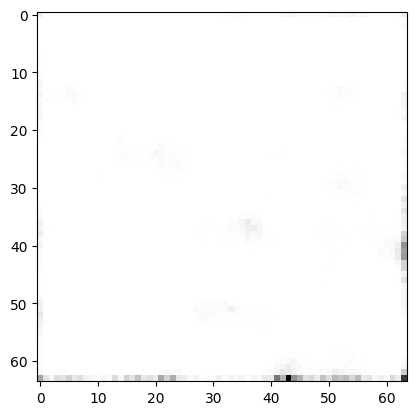

In [60]:
z = torch.randn(1, 16, 32, 32).to(device)
tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

# generate image using avg z

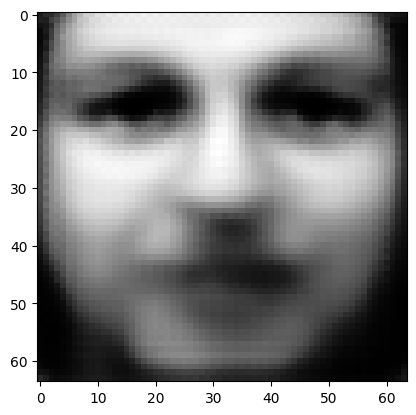

In [97]:
def init_avg_z():
    z = torch.zeros(1, 16, 32, 32).to(device)
    for i in range(200):
        z += d2c_encoder(train_data[i])
    z = z/200
    return z
avg = d2c_decoder(init_avg_z()).detach()
tensor_to_picture(avg.detach().cpu().numpy()[0][0])

In [111]:
def optimize_z(z, decoder, classifier, optimizer_z, criterion, target, reg):
    decoder.eval()
    classifier.eval()
    optimizer_z.zero_grad()
    generated = decoder(z)
    result = classifier(generated)
    print(torch.softmax(result,-1))
    loss = criterion(result,attack_targets[target])
    loss += torch.sum((generated-avg)**2) * reg
    loss.backward()
    optimizer_z.step()
    return loss.item()

In [112]:
def optimize_z_eps(z, eps, lr, reg, lr_decay, target=8):
    for epoch in range(eps): 
        optimizer_z = optim.SGD([z], lr=lr*lr_decay**epoch, momentum=0.9, nesterov=False)
        criterion = nn.CrossEntropyLoss(reduction = 'sum')
        epoch_loss = optimize_z(z, d2c_decoder, classifier, optimizer_z, criterion, target, reg)
        print("loss(generator): ", epoch_loss)
        if epoch%5 == 0:
            tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

In [136]:
for param in classifier.parameters():
    param.requires_grad = False
for param in d2c_decoder.parameters():
    param.requires_grad = False   
z = init_avg_z().detach()
z = z.requires_grad_(True)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9501e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7158e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.94345474243164


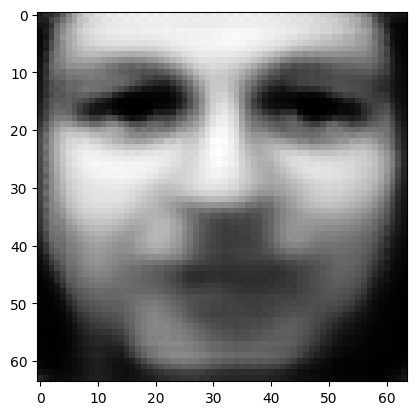

tensor([[6.4933e-04, 4.5212e-04, 1.5269e-02, 4.0393e-03, 2.5474e-03, 1.5359e-05,
         2.3070e-02, 3.5246e-04, 1.1520e-01, 1.3118e-02, 5.1018e-03, 1.8519e-02,
         2.9416e-02, 5.6429e-03, 3.5778e-03, 7.8417e-04, 3.2406e-02, 1.0565e-03,
         2.5840e-03, 9.5654e-04, 7.6443e-02, 3.1125e-02, 1.2928e-02, 1.1636e-02,
         1.2687e-01, 1.0510e-03, 4.9459e-03, 3.5352e-02, 4.0207e-02, 8.3357e-03,
         3.1807e-02, 4.4075e-04, 2.0819e-02, 4.5208e-03, 6.7450e-02, 1.0046e-03,
         2.8867e-02, 1.1231e-01, 6.6615e-02, 4.2514e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.33957576751709
tensor([[1.7038e-03, 7.3360e-04, 1.2898e-02, 3.6484e-03, 2.8328e-03, 1.7963e-05,
         1.8934e-02, 4.6182e-04, 6.9023e-02, 1.2744e-02, 4.3591e-03, 2.3050e-02,
         4.0218e-02, 7.5091e-03, 2.9459e-03, 9.3905e-04, 3.5808e-02, 1.0979e-03,
         2.4399e-03, 7.6513e-04, 8.1251e-02, 3.1404e-02, 1.0256e-02, 1.2009e-02,
         1.2337e-01, 1.1080e-03, 5.3108e-03, 

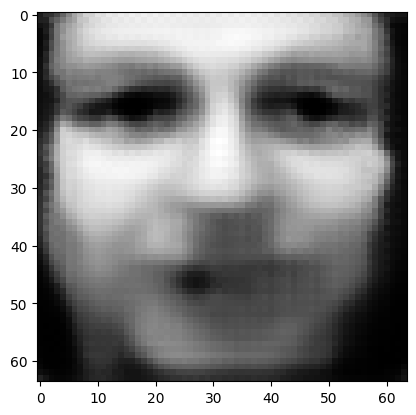

tensor([[3.5544e-02, 2.3438e-03, 5.0675e-03, 1.5478e-03, 2.7449e-03, 2.1688e-05,
         7.1806e-03, 8.3460e-04, 1.1767e-02, 1.0361e-02, 1.7898e-03, 3.7300e-02,
         8.2728e-02, 1.2444e-02, 1.2477e-03, 1.0739e-03, 3.4760e-02, 1.0088e-03,
         1.3593e-03, 2.6743e-04, 7.3926e-02, 2.2682e-02, 4.4706e-03, 9.7937e-03,
         9.5584e-02, 9.1803e-04, 4.1705e-03, 1.5532e-02, 3.9475e-02, 6.5173e-03,
         3.3556e-02, 7.8398e-04, 1.6772e-02, 5.8491e-03, 7.0977e-02, 9.2429e-04,
         6.7825e-02, 1.8089e-01, 5.3226e-02, 4.4736e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.3369839191436768
tensor([[6.6876e-02, 2.7534e-03, 3.8725e-03, 1.2141e-03, 2.5542e-03, 2.1277e-05,
         5.5387e-03, 8.8858e-04, 8.0616e-03, 1.0046e-02, 1.3632e-03, 3.8848e-02,
         9.5276e-02, 1.2329e-02, 1.0101e-03, 1.0116e-03, 3.2136e-02, 9.3489e-04,
         1.1200e-03, 2.0457e-04, 6.7430e-02, 2.0129e-02, 3.8040e-03, 8.9472e-03,
         8.5477e-02, 8.1892e-04, 3.6372e-03

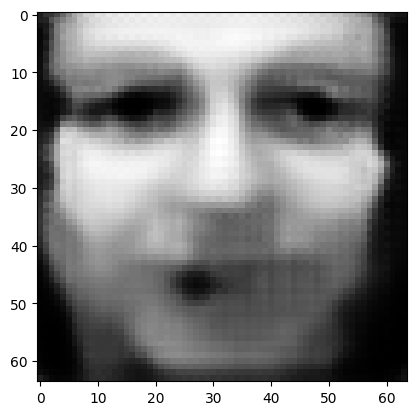

tensor([[3.4138e-01, 3.2585e-03, 1.2448e-03, 4.5908e-04, 1.6947e-03, 1.5582e-05,
         2.1673e-03, 8.5552e-04, 1.9336e-03, 7.0458e-03, 4.2425e-04, 3.7738e-02,
         9.7236e-02, 8.7359e-03, 3.6980e-04, 6.1914e-04, 2.0002e-02, 5.4484e-04,
         5.1999e-04, 6.2278e-05, 3.7366e-02, 1.0598e-02, 1.7465e-03, 5.5075e-03,
         5.2144e-02, 5.3696e-04, 1.8353e-03, 5.8564e-03, 2.3844e-02, 3.0188e-03,
         2.0352e-02, 4.9977e-04, 8.1775e-03, 3.2752e-03, 5.0431e-02, 5.2449e-04,
         6.7282e-02, 1.2659e-01, 2.5911e-02, 2.8198e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0747628211975098
tensor([[4.1837e-01, 3.1101e-03, 9.6232e-04, 3.7185e-04, 1.5081e-03, 1.3915e-05,
         1.7733e-03, 8.0046e-04, 1.4175e-03, 6.1981e-03, 3.2117e-04, 3.5834e-02,
         8.8814e-02, 7.7030e-03, 2.8613e-04, 5.2829e-04, 1.7519e-02, 4.6338e-04,
         4.3378e-04, 4.6739e-05, 3.1567e-02, 8.9417e-03, 1.4316e-03, 4.7838e-03,
         4.5569e-02, 4.8853e-04, 1.5250e-03

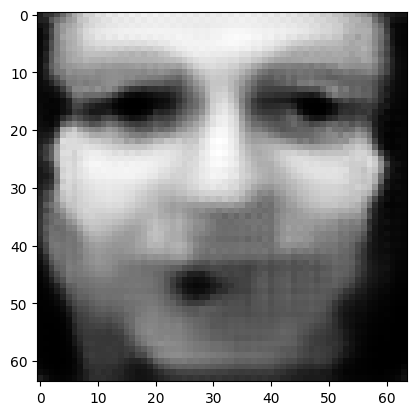

tensor([[6.3858e-01, 2.3667e-03, 4.1766e-04, 1.8442e-04, 9.6109e-04, 9.0092e-06,
         9.0778e-04, 5.9308e-04, 5.2992e-04, 3.8487e-03, 1.2959e-04, 2.7098e-02,
         6.0015e-02, 4.7089e-03, 1.2080e-04, 2.9982e-04, 1.0710e-02, 2.5801e-04,
         2.3130e-04, 1.8597e-05, 1.7112e-02, 4.9309e-03, 7.2208e-04, 2.8458e-03,
         2.7133e-02, 3.3128e-04, 7.9091e-04, 2.3774e-03, 1.0751e-02, 1.2058e-03,
         1.0501e-02, 2.9107e-04, 3.7325e-03, 1.4684e-03, 2.8283e-02, 2.4823e-04,
         4.1732e-02, 6.7733e-02, 1.1427e-02, 1.4394e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.44850441813468933
tensor([[6.7261e-01, 2.2114e-03, 3.5794e-04, 1.6112e-04, 8.7225e-04, 8.2239e-06,
         7.9987e-04, 5.5662e-04, 4.4277e-04, 3.5196e-03, 1.0942e-04, 2.5357e-02,
         5.5074e-02, 4.2244e-03, 1.0225e-04, 2.6922e-04, 9.6858e-03, 2.2865e-04,
         2.0539e-04, 1.5684e-05, 1.5105e-02, 4.3874e-03, 6.3051e-04, 2.5712e-03,
         2.4418e-02, 3.0375e-04, 6.9750e-0

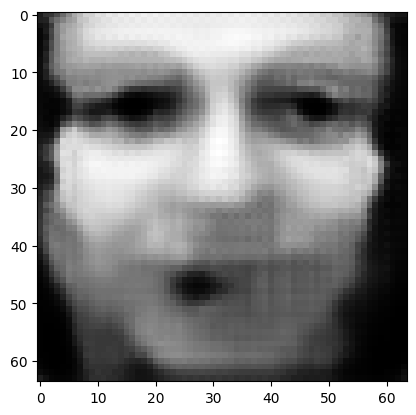

tensor([[7.6397e-01, 1.7531e-03, 2.1803e-04, 1.0433e-04, 6.3512e-04, 6.1345e-06,
         5.3467e-04, 4.4868e-04, 2.5007e-04, 2.6096e-03, 6.3945e-05, 2.0141e-02,
         4.0938e-02, 2.9422e-03, 5.9829e-05, 1.9097e-04, 6.9804e-03, 1.5519e-04,
         1.4050e-04, 9.1868e-06, 1.0061e-02, 2.9958e-03, 4.0248e-04, 1.8433e-03,
         1.7134e-02, 2.2696e-04, 4.6050e-04, 1.3449e-03, 6.4634e-03, 6.7673e-04,
         6.5142e-03, 1.9304e-04, 2.2484e-03, 8.5037e-04, 1.8778e-02, 1.5189e-04,
         2.8348e-02, 4.3267e-02, 6.6515e-03, 9.2444e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2692330777645111
tensor([[7.7947e-01, 1.6662e-03, 1.9723e-04, 9.5524e-05, 5.9562e-04, 5.7782e-06,
         4.9285e-04, 4.2908e-04, 2.2312e-04, 2.4567e-03, 5.7375e-05, 1.9171e-02,
         3.8447e-02, 2.7250e-03, 5.3683e-05, 1.7799e-04, 6.5223e-03, 1.4343e-04,
         1.3005e-04, 8.2543e-06, 9.2444e-03, 2.7715e-03, 3.6765e-04, 1.7211e-03,
         1.5915e-02, 2.1349e-04, 4.2246e-04

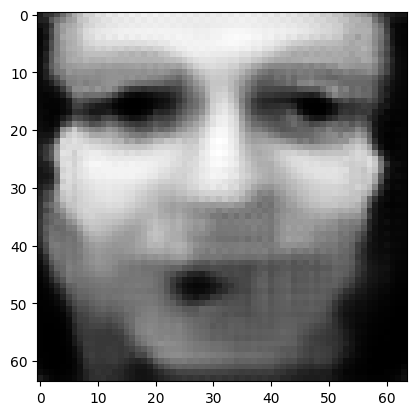

tensor([[8.2542e-01, 1.3957e-03, 1.4015e-04, 7.0573e-05, 4.7375e-04, 4.6918e-06,
         3.7412e-04, 3.6600e-04, 1.5210e-04, 1.9955e-03, 3.9803e-05, 1.6084e-02,
         3.0974e-02, 2.0906e-03, 3.7153e-05, 1.3983e-04, 5.1748e-03, 1.0944e-04,
         9.9922e-05, 5.7343e-06, 6.8924e-03, 2.1197e-03, 2.7005e-04, 1.3598e-03,
         1.2384e-02, 1.7186e-04, 3.1577e-04, 9.0924e-04, 4.5523e-03, 4.5628e-04,
         4.6337e-03, 1.4371e-04, 1.5848e-03, 5.7886e-04, 1.4085e-02, 1.0854e-04,
         2.1391e-02, 3.1547e-02, 4.5708e-03, 6.7800e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19186687469482422
tensor([[8.3385e-01, 1.3440e-03, 1.3040e-04, 6.6248e-05, 4.5122e-04, 4.4876e-06,
         3.5320e-04, 3.5369e-04, 1.4041e-04, 1.9087e-03, 3.6874e-05, 1.5492e-02,
         2.9552e-02, 1.9765e-03, 3.4375e-05, 1.3283e-04, 4.9280e-03, 1.0337e-04,
         9.4580e-05, 5.3125e-06, 6.4765e-03, 2.0031e-03, 2.5299e-04, 1.2938e-03,
         1.1747e-02, 1.6418e-04, 2.9700e-0

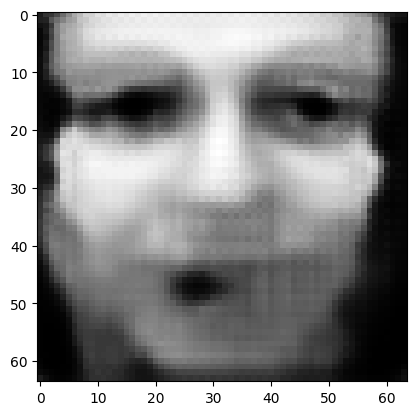

tensor([[8.6012e-01, 1.1745e-03, 1.0175e-04, 5.3235e-05, 3.8057e-04, 3.8450e-06,
         2.9015e-04, 3.1405e-04, 1.0677e-04, 1.6379e-03, 2.8281e-05, 1.3601e-02,
         2.5110e-02, 1.6228e-03, 2.6273e-05, 1.1106e-04, 4.1569e-03, 8.4867e-05,
         7.8302e-05, 4.0776e-06, 5.2135e-03, 1.6454e-03, 2.0200e-04, 1.0902e-03,
         9.7971e-03, 1.4007e-04, 2.4035e-04, 6.8549e-04, 3.5273e-03, 3.4152e-04,
         3.6040e-03, 1.1561e-04, 1.2269e-03, 4.3552e-04, 1.1385e-02, 8.4777e-05,
         1.7347e-02, 2.5025e-02, 3.4754e-03, 5.4098e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1506817787885666
tensor([[8.6537e-01, 1.1405e-03, 9.6257e-05, 5.0738e-05, 3.6637e-04, 3.7120e-06,
         2.7763e-04, 3.0574e-04, 1.0043e-04, 1.5817e-03, 2.6668e-05, 1.3208e-02,
         2.4209e-02, 1.5539e-03, 2.4753e-05, 1.0671e-04, 4.0021e-03, 8.1211e-05,
         7.5084e-05, 3.8457e-06, 4.9715e-03, 1.5752e-03, 1.9198e-04, 1.0497e-03,
         9.4098e-03, 1.3520e-04, 2.2927e-04

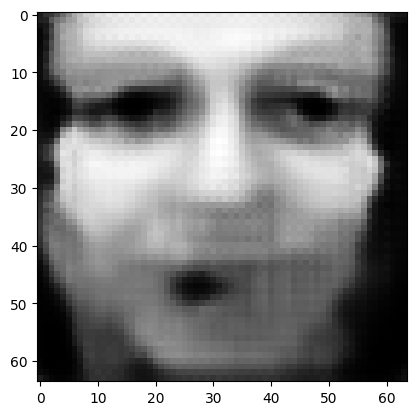

tensor([[8.8267e-01, 1.0221e-03, 7.9134e-05, 4.2609e-05, 3.1948e-04, 3.2734e-06,
         2.3716e-04, 2.7791e-04, 8.0818e-05, 1.4008e-03, 2.1593e-05, 1.1861e-02,
         2.1298e-02, 1.3260e-03, 1.9952e-05, 9.2579e-05, 3.4958e-03, 6.9130e-05,
         6.4457e-05, 3.1165e-06, 4.1843e-03, 1.3464e-03, 1.6015e-04, 9.1574e-04,
         8.1450e-03, 1.1880e-04, 1.9382e-04, 5.4909e-04, 2.8884e-03, 2.7154e-04,
         2.9547e-03, 9.7046e-05, 1.0022e-03, 3.4737e-04, 9.5956e-03, 6.9568e-05,
         1.4676e-02, 2.0771e-02, 2.7998e-03, 4.5304e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12480638921260834
tensor([[8.8622e-01, 9.9669e-04, 7.5744e-05, 4.0957e-05, 3.0977e-04, 3.1823e-06,
         2.2908e-04, 2.7203e-04, 7.7011e-05, 1.3629e-03, 2.0595e-05, 1.1583e-02,
         2.0696e-02, 1.2800e-03, 1.8999e-05, 8.9663e-05, 3.3929e-03, 6.6687e-05,
         6.2285e-05, 2.9713e-06, 4.0247e-03, 1.2995e-03, 1.5377e-04, 8.8829e-04,
         7.8929e-03, 1.1545e-04, 1.8673e-0

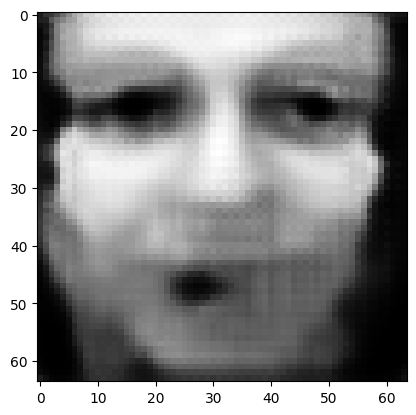

tensor([[8.9825e-01, 9.1051e-04, 6.4647e-05, 3.5559e-05, 2.7702e-04, 2.8724e-06,
         2.0199e-04, 2.5153e-04, 6.4655e-05, 1.2335e-03, 1.7354e-05, 1.0614e-02,
         1.8619e-02, 1.1249e-03, 1.5928e-05, 7.9872e-05, 3.0425e-03, 5.8512e-05,
         5.5072e-05, 2.5037e-06, 3.4967e-03, 1.1437e-03, 1.3257e-04, 7.9501e-04,
         7.0264e-03, 1.0401e-04, 1.6298e-04, 4.5916e-04, 2.4548e-03, 2.2515e-04,
         2.5153e-03, 8.4235e-05, 8.5045e-04, 2.8858e-04, 8.3486e-03, 5.9176e-05,
         1.2798e-02, 1.7858e-02, 2.3490e-03, 3.9221e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10730145871639252
tensor([[9.0081e-01, 8.9206e-04, 6.2375e-05, 3.4453e-05, 2.6994e-04, 2.8061e-06,
         1.9626e-04, 2.4711e-04, 6.2141e-05, 1.2059e-03, 1.6694e-05, 1.0406e-02,
         1.8167e-02, 1.0924e-03, 1.5308e-05, 7.7772e-05, 2.9670e-03, 5.6807e-05,
         5.3573e-05, 2.4087e-06, 3.3877e-03, 1.1109e-03, 1.2821e-04, 7.7519e-04,
         6.8417e-03, 1.0159e-04, 1.5805e-0

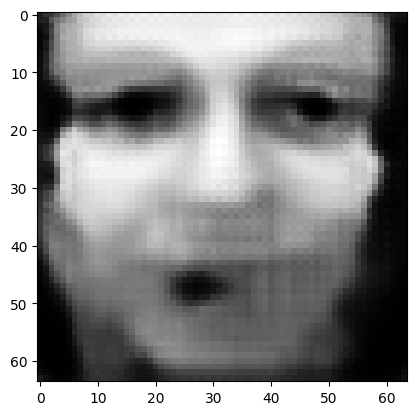

tensor([[9.0966e-01, 8.2636e-04, 5.4695e-05, 3.0613e-05, 2.4594e-04, 2.5767e-06,
         1.7680e-04, 2.3131e-04, 5.3725e-05, 1.1089e-03, 1.4471e-05, 9.6721e-03,
         1.6615e-02, 9.8086e-04, 1.3194e-05, 7.0556e-05, 2.7092e-03, 5.0885e-05,
         4.8334e-05, 2.0867e-06, 3.0099e-03, 9.9848e-04, 1.1329e-04, 7.0550e-04,
         6.2106e-03, 9.3193e-05, 1.4111e-04, 3.9566e-04, 2.1423e-03, 1.9248e-04,
         2.1986e-03, 7.4837e-05, 7.4135e-04, 2.4721e-04, 7.4296e-03, 5.1665e-05,
         1.1418e-02, 1.5758e-02, 2.0280e-03, 3.4787e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09467948973178864
tensor([[9.1160e-01, 8.1169e-04, 5.3037e-05, 2.9768e-05, 2.4059e-04, 2.5260e-06,
         1.7260e-04, 2.2773e-04, 5.1951e-05, 1.0873e-03, 1.4002e-05, 9.5082e-03,
         1.6274e-02, 9.5668e-04, 1.2741e-05, 6.8987e-05, 2.6540e-03, 4.9597e-05,
         4.7185e-05, 2.0179e-06, 2.9274e-03, 9.7382e-04, 1.1005e-04, 6.9014e-04,
         6.0742e-03, 9.1324e-05, 1.3745e-0

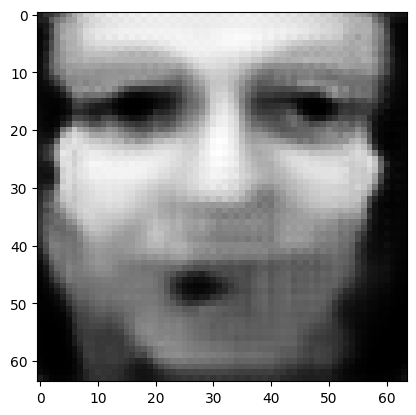

tensor([[9.1837e-01, 7.5970e-04, 4.7452e-05, 2.6922e-05, 2.2210e-04, 2.3502e-06,
         1.5797e-04, 2.1529e-04, 4.5944e-05, 1.0129e-03, 1.2402e-05, 8.9287e-03,
         1.5087e-02, 8.7217e-04, 1.1228e-05, 6.3512e-05, 2.4557e-03, 4.5163e-05,
         4.3218e-05, 1.7870e-06, 2.6456e-03, 8.8898e-04, 9.9090e-05, 6.3691e-04,
         5.5932e-03, 8.4793e-05, 1.2484e-04, 3.4876e-04, 1.9082e-03, 1.6839e-04,
         1.9596e-03, 6.7604e-05, 6.5954e-04, 2.1649e-04, 6.7247e-03, 4.6015e-05,
         1.0355e-02, 1.4166e-02, 1.7890e-03, 3.1410e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08516009896993637
tensor([[9.1986e-01, 7.4837e-04, 4.6249e-05, 2.6327e-05, 2.1808e-04, 2.3115e-06,
         1.5476e-04, 2.1249e-04, 4.4655e-05, 9.9639e-04, 1.2060e-05, 8.8007e-03,
         1.4821e-02, 8.5378e-04, 1.0909e-05, 6.2300e-05, 2.4114e-03, 4.4204e-05,
         4.2365e-05, 1.7380e-06, 2.5853e-03, 8.7060e-04, 9.6748e-05, 6.2520e-04,
         5.4850e-03, 8.3384e-05, 1.2210e-0

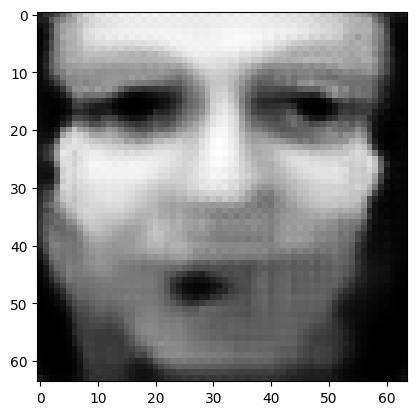

tensor([[9.2518e-01, 7.0663e-04, 4.2006e-05, 2.4145e-05, 2.0347e-04, 2.1723e-06,
         1.4347e-04, 2.0236e-04, 4.0183e-05, 9.3674e-04, 1.0864e-05, 8.3367e-03,
         1.3872e-02, 7.8834e-04, 9.7788e-06, 5.7996e-05, 2.2560e-03, 4.0790e-05,
         3.9287e-05, 1.5648e-06, 2.3684e-03, 8.0454e-04, 8.8378e-05, 5.8325e-04,
         5.1088e-03, 7.8239e-05, 1.1239e-04, 3.1289e-04, 1.7269e-03, 1.5004e-04,
         1.7739e-03, 6.1982e-05, 5.9650e-04, 1.9313e-04, 6.1700e-03, 4.1646e-05,
         9.5197e-03, 1.2933e-02, 1.6059e-03, 2.8755e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07776685059070587
tensor([[9.2637e-01, 6.9699e-04, 4.1078e-05, 2.3660e-05, 2.0023e-04, 2.1411e-06,
         1.4096e-04, 2.0006e-04, 3.9205e-05, 9.2330e-04, 1.0600e-05, 8.2316e-03,
         1.3662e-02, 7.7380e-04, 9.5311e-06, 5.7028e-05, 2.2212e-03, 4.0030e-05,
         3.8590e-05, 1.5267e-06, 2.3202e-03, 7.8981e-04, 8.6534e-05, 5.7390e-04,
         5.0254e-03, 7.7084e-05, 1.1022e-0

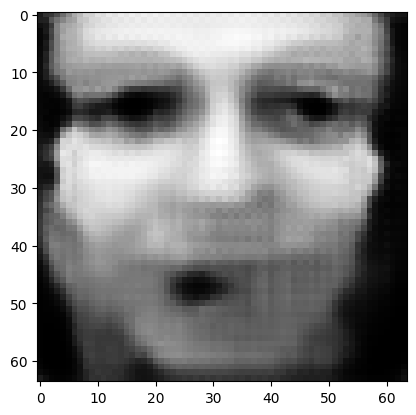

tensor([[9.3074e-01, 6.6234e-04, 3.7736e-05, 2.1932e-05, 1.8842e-04, 2.0266e-06,
         1.3180e-04, 1.9151e-04, 3.5699e-05, 8.7387e-04, 9.6589e-06, 7.8433e-03,
         1.2880e-02, 7.2086e-04, 8.6484e-06, 5.3497e-05, 2.0931e-03, 3.7261e-05,
         3.6091e-05, 1.3912e-06, 2.1468e-03, 7.3672e-04, 7.9866e-05, 5.3941e-04,
         4.7162e-03, 7.2869e-05, 1.0237e-04, 2.8418e-04, 1.5802e-03, 1.3544e-04,
         1.6246e-03, 5.7379e-05, 5.4595e-04, 1.7453e-04, 5.7178e-03, 3.8128e-05,
         8.8351e-03, 1.1928e-02, 1.4593e-03, 2.6594e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07177984714508057
tensor([[9.3172e-01, 6.5481e-04, 3.6986e-05, 2.1551e-05, 1.8570e-04, 2.0002e-06,
         1.2971e-04, 1.8953e-04, 3.4920e-05, 8.6240e-04, 9.4528e-06, 7.7544e-03,
         1.2698e-02, 7.0910e-04, 8.4555e-06, 5.2696e-05, 2.0639e-03, 3.6644e-05,
         3.5540e-05, 1.3615e-06, 2.1086e-03, 7.2486e-04, 7.8359e-05, 5.3160e-04,
         4.6454e-03, 7.1914e-05, 1.0061e-0

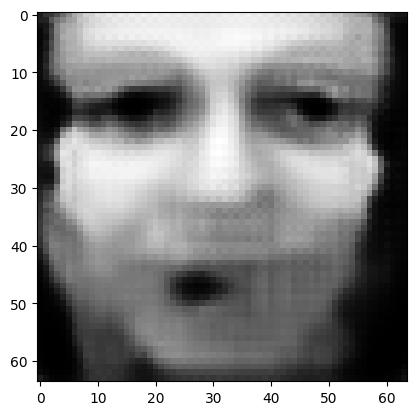

tensor([[9.3530e-01, 6.2564e-04, 3.4337e-05, 2.0158e-05, 1.7605e-04, 1.9065e-06,
         1.2233e-04, 1.8242e-04, 3.2181e-05, 8.2207e-04, 8.7113e-06, 7.4318e-03,
         1.2054e-02, 6.6594e-04, 7.7628e-06, 4.9813e-05, 1.9589e-03, 3.4412e-05,
         3.3513e-05, 1.2548e-06, 1.9683e-03, 6.8183e-04, 7.3060e-05, 5.0339e-04,
         4.3936e-03, 6.8441e-05, 9.4280e-05, 2.6109e-04, 1.4616e-03, 1.2379e-04,
         1.5031e-03, 5.3604e-05, 5.0499e-04, 1.5961e-04, 5.3467e-03, 3.5278e-05,
         8.2716e-03, 1.1114e-02, 1.3410e-03, 2.4825e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06689323484897614
tensor([[9.3611e-01, 6.1877e-04, 3.3746e-05, 1.9837e-05, 1.7386e-04, 1.8853e-06,
         1.2068e-04, 1.8081e-04, 3.1573e-05, 8.1300e-04, 8.5450e-06, 7.3588e-03,
         1.1907e-02, 6.5609e-04, 7.6066e-06, 4.9157e-05, 1.9350e-03, 3.3908e-05,
         3.3053e-05, 1.2306e-06, 1.9363e-03, 6.7201e-04, 7.1874e-05, 4.9697e-04,
         4.3377e-03, 6.7654e-05, 9.2854e-0

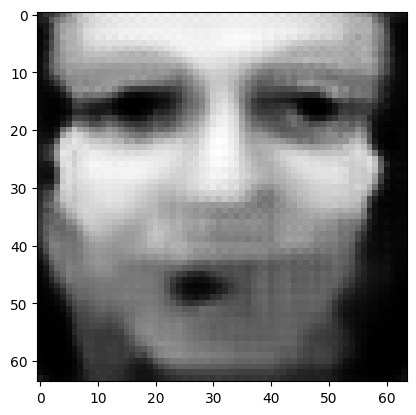

tensor([[9.3909e-01, 5.9430e-04, 3.1599e-05, 1.8705e-05, 1.6584e-04, 1.8068e-06,
         1.1461e-04, 1.7473e-04, 2.9369e-05, 7.7897e-04, 7.9466e-06, 7.0862e-03,
         1.1365e-02, 6.2058e-04, 7.0522e-06, 4.6751e-05, 1.8476e-03, 3.2069e-05,
         3.1384e-05, 1.1446e-06, 1.8218e-03, 6.3663e-04, 6.7547e-05, 4.7348e-04,
         4.1281e-03, 6.4770e-05, 8.7650e-05, 2.4220e-04, 1.3633e-03, 1.1428e-04,
         1.4034e-03, 5.0477e-05, 4.7134e-04, 1.4740e-04, 5.0385e-03, 3.2933e-05,
         7.8007e-03, 1.0436e-02, 1.2440e-03, 2.3341e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06284891813993454
tensor([[9.3977e-01, 5.8849e-04, 3.1119e-05, 1.8441e-05, 1.6403e-04, 1.7890e-06,
         1.1323e-04, 1.7334e-04, 2.8874e-05, 7.7132e-04, 7.8106e-06, 7.0233e-03,
         1.1244e-02, 6.1243e-04, 6.9256e-06, 4.6210e-05, 1.8275e-03, 3.1650e-05,
         3.0997e-05, 1.1251e-06, 1.7954e-03, 6.2853e-04, 6.6558e-05, 4.6809e-04,
         4.0807e-03, 6.4093e-05, 8.6461e-0

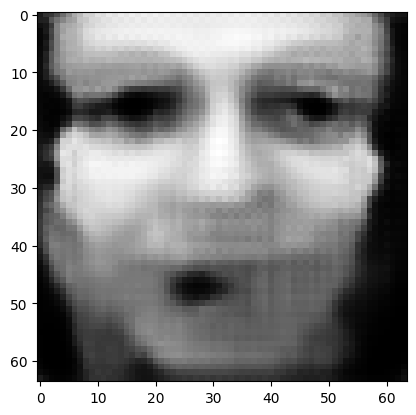

tensor([[9.4229e-01, 5.6748e-04, 2.9341e-05, 1.7497e-05, 1.5722e-04, 1.7222e-06,
         1.0810e-04, 1.6812e-04, 2.7066e-05, 7.4236e-04, 7.3189e-06, 6.7901e-03,
         1.0784e-02, 5.8261e-04, 6.4716e-06, 4.4175e-05, 1.7532e-03, 3.0112e-05,
         2.9592e-05, 1.0543e-06, 1.6998e-03, 5.9875e-04, 6.2969e-05, 4.4820e-04,
         3.9034e-03, 6.1643e-05, 8.2114e-05, 2.2644e-04, 1.2808e-03, 1.0640e-04,
         1.3196e-03, 4.7834e-05, 4.4320e-04, 1.3725e-04, 4.7771e-03, 3.0968e-05,
         7.4008e-03, 9.8649e-03, 1.1630e-03, 2.2083e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.059443049132823944
tensor([[9.4288e-01, 5.6258e-04, 2.8932e-05, 1.7279e-05, 1.5567e-04, 1.7067e-06,
         1.0691e-04, 1.6690e-04, 2.6651e-05, 7.3565e-04, 7.2062e-06, 6.7354e-03,
         1.0677e-02, 5.7567e-04, 6.3676e-06, 4.3705e-05, 1.7357e-03, 2.9756e-05,
         2.9265e-05, 1.0382e-06, 1.6777e-03, 5.9189e-04, 6.2144e-05, 4.4354e-04,
         3.8617e-03, 6.1069e-05, 8.1101e-

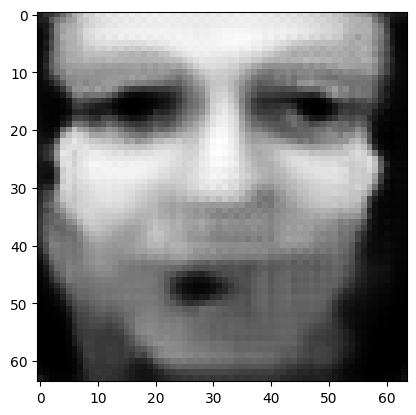

tensor([[9.4505e-01, 5.4433e-04, 2.7431e-05, 1.6476e-05, 1.4979e-04, 1.6489e-06,
         1.0252e-04, 1.6232e-04, 2.5130e-05, 7.1042e-04, 6.7933e-06, 6.5313e-03,
         1.0279e-02, 5.5022e-04, 5.9874e-06, 4.1956e-05, 1.6718e-03, 2.8438e-05,
         2.8057e-05, 9.7876e-07, 1.5967e-03, 5.6642e-04, 5.9086e-05, 4.2638e-04,
         3.7088e-03, 5.8953e-05, 7.7390e-05, 2.1303e-04, 1.2104e-03, 9.9721e-05,
         1.2479e-03, 4.5568e-05, 4.1914e-04, 1.2868e-04, 4.5513e-03, 2.9285e-05,
         7.0565e-03, 9.3753e-03, 1.0942e-03, 2.0996e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05651651695370674
tensor([[9.4556e-01, 5.3989e-04, 2.7088e-05, 1.6284e-05, 1.4844e-04, 1.6357e-06,
         1.0151e-04, 1.6126e-04, 2.4783e-05, 7.0467e-04, 6.6980e-06, 6.4837e-03,
         1.0188e-02, 5.4427e-04, 5.8987e-06, 4.1554e-05, 1.6570e-03, 2.8131e-05,
         2.7771e-05, 9.6495e-07, 1.5776e-03, 5.6047e-04, 5.8383e-05, 4.2236e-04,
         3.6739e-03, 5.8456e-05, 7.6530e-0

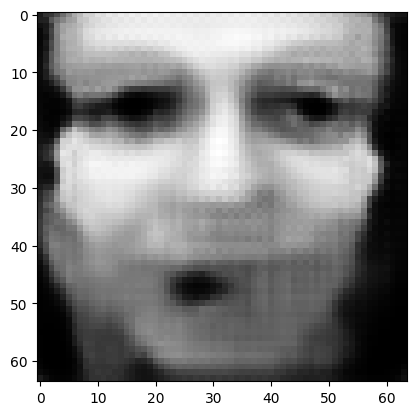

tensor([[9.4744e-01, 5.2409e-04, 2.5817e-05, 1.5607e-05, 1.4339e-04, 1.5856e-06,
         9.7721e-05, 1.5725e-04, 2.3497e-05, 6.8270e-04, 6.3489e-06, 6.3055e-03,
         9.8449e-03, 5.2248e-04, 5.5809e-06, 4.0042e-05, 1.6014e-03, 2.7005e-05,
         2.6733e-05, 9.1510e-07, 1.5090e-03, 5.3873e-04, 5.5788e-05, 4.0756e-04,
         3.5403e-03, 5.6631e-05, 7.3343e-05, 2.0155e-04, 1.1498e-03, 9.4027e-05,
         1.1864e-03, 4.3612e-05, 3.9855e-04, 1.2140e-04, 4.3563e-03, 2.7839e-05,
         6.7585e-03, 8.9518e-03, 1.0353e-03, 2.0050e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05399587005376816
tensor([[9.4787e-01, 5.2028e-04, 2.5526e-05, 1.5446e-05, 1.4221e-04, 1.5739e-06,
         9.6842e-05, 1.5632e-04, 2.3203e-05, 6.7764e-04, 6.2682e-06, 6.2640e-03,
         9.7669e-03, 5.1744e-04, 5.5073e-06, 3.9690e-05, 1.5884e-03, 2.6745e-05,
         2.6487e-05, 9.0350e-07, 1.4929e-03, 5.3362e-04, 5.5189e-05, 4.0413e-04,
         3.5099e-03, 5.6202e-05, 7.2605e-0

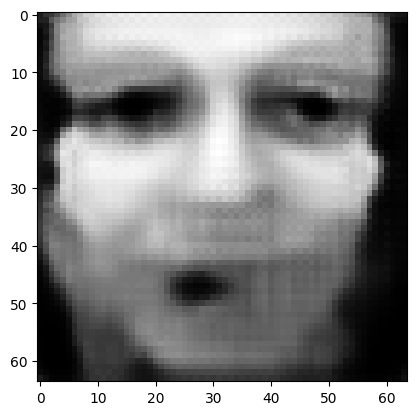

tensor([[9.4951e-01, 5.0636e-04, 2.4434e-05, 1.4859e-05, 1.3781e-04, 1.5301e-06,
         9.3554e-05, 1.5277e-04, 2.2105e-05, 6.5831e-04, 5.9702e-06, 6.1074e-03,
         9.4676e-03, 4.9862e-04, 5.2357e-06, 3.8380e-05, 1.5401e-03, 2.5771e-05,
         2.5580e-05, 8.6084e-07, 1.4337e-03, 5.1471e-04, 5.2950e-05, 3.9120e-04,
         3.3939e-03, 5.4602e-05, 6.9844e-05, 1.9165e-04, 1.0973e-03, 8.9128e-05,
         1.1333e-03, 4.1916e-05, 3.8073e-04, 1.1514e-04, 4.1864e-03, 2.6583e-05,
         6.4984e-03, 8.5840e-03, 9.8462e-04, 1.9229e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05180949717760086
tensor([[9.4989e-01, 5.0308e-04, 2.4185e-05, 1.4725e-05, 1.3681e-04, 1.5200e-06,
         9.2782e-05, 1.5195e-04, 2.1851e-05, 6.5385e-04, 5.9011e-06, 6.0707e-03,
         9.3982e-03, 4.9423e-04, 5.1738e-06, 3.8073e-05, 1.5285e-03, 2.5547e-05,
         2.5369e-05, 8.5104e-07, 1.4201e-03, 5.1033e-04, 5.2441e-05, 3.8817e-04,
         3.3665e-03, 5.4234e-05, 6.9199e-0

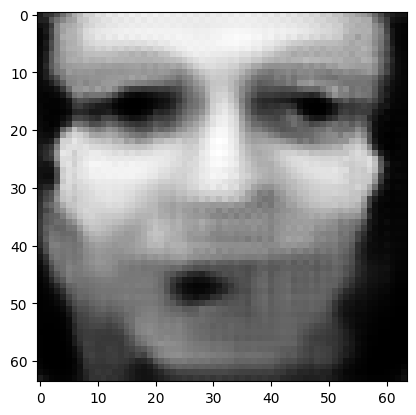

tensor([[9.5133e-01, 4.9067e-04, 2.3246e-05, 1.4216e-05, 1.3297e-04, 1.4816e-06,
         8.9910e-05, 1.4882e-04, 2.0908e-05, 6.3683e-04, 5.6440e-06, 5.9329e-03,
         9.1375e-03, 4.7787e-04, 4.9405e-06, 3.6928e-05, 1.4860e-03, 2.4704e-05,
         2.4570e-05, 8.1420e-07, 1.3687e-03, 4.9377e-04, 5.0505e-05, 3.7684e-04,
         3.2651e-03, 5.2833e-05, 6.6796e-05, 1.8303e-04, 1.0514e-03, 8.4877e-05,
         1.0868e-03, 4.0438e-05, 3.6525e-04, 1.0971e-04, 4.0369e-03, 2.5487e-05,
         6.2698e-03, 8.2617e-03, 9.4044e-04, 1.8507e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04989633709192276
tensor([[9.5167e-01, 4.8783e-04, 2.3027e-05, 1.4101e-05, 1.3206e-04, 1.4726e-06,
         8.9233e-05, 1.4808e-04, 2.0688e-05, 6.3281e-04, 5.5845e-06, 5.9003e-03,
         9.0751e-03, 4.7404e-04, 4.8872e-06, 3.6658e-05, 1.4760e-03, 2.4507e-05,
         2.4387e-05, 8.0575e-07, 1.3569e-03, 4.8993e-04, 5.0057e-05, 3.7420e-04,
         3.2410e-03, 5.2508e-05, 6.6238e-0

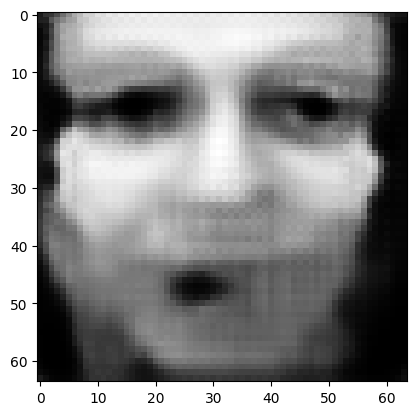

tensor([[9.5294e-01, 4.7682e-04, 2.2210e-05, 1.3656e-05, 1.2866e-04, 1.4386e-06,
         8.6694e-05, 1.4530e-04, 1.9869e-05, 6.1776e-04, 5.3619e-06, 5.7771e-03,
         8.8431e-03, 4.5962e-04, 4.6854e-06, 3.5646e-05, 1.4381e-03, 2.3765e-05,
         2.3686e-05, 7.7389e-07, 1.3118e-03, 4.7538e-04, 4.8366e-05, 3.6414e-04,
         3.1508e-03, 5.1264e-05, 6.4127e-05, 1.7548e-04, 1.0112e-03, 8.1162e-05,
         1.0458e-03, 3.9130e-05, 3.5160e-04, 1.0497e-04, 3.9043e-03, 2.4520e-05,
         6.0681e-03, 7.9784e-03, 9.0178e-04, 1.7868e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04820684343576431
tensor([[9.5324e-01, 4.7424e-04, 2.2017e-05, 1.3552e-05, 1.2783e-04, 1.4305e-06,
         8.6096e-05, 1.4463e-04, 1.9677e-05, 6.1417e-04, 5.3100e-06, 5.7478e-03,
         8.7883e-03, 4.5623e-04, 4.6384e-06, 3.5406e-05, 1.4293e-03, 2.3589e-05,
         2.3521e-05, 7.6643e-07, 1.3013e-03, 4.7194e-04, 4.7969e-05, 3.6178e-04,
         3.1296e-03, 5.0972e-05, 6.3637e-0

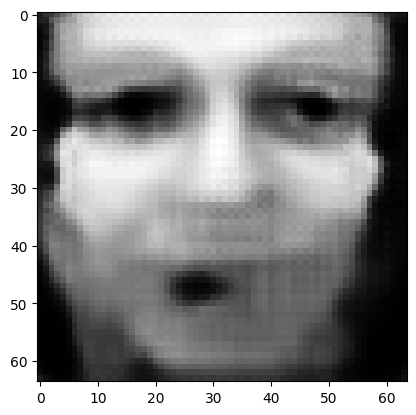

tensor([[9.5437e-01, 4.6440e-04, 2.1299e-05, 1.3158e-05, 1.2481e-04, 1.4002e-06,
         8.3852e-05, 1.4214e-04, 1.8961e-05, 6.0077e-04, 5.1156e-06, 5.6373e-03,
         8.5810e-03, 4.4345e-04, 4.4623e-06, 3.4511e-05, 1.3957e-03, 2.2932e-05,
         2.2902e-05, 7.3858e-07, 1.2616e-03, 4.5907e-04, 4.6477e-05, 3.5288e-04,
         3.0498e-03, 4.9862e-05, 6.1775e-05, 1.6884e-04, 9.7558e-04, 7.7888e-05,
         1.0094e-03, 3.7967e-05, 3.3950e-04, 1.0080e-04, 3.7865e-03, 2.3663e-05,
         5.8883e-03, 7.7261e-03, 8.6772e-04, 1.7300e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04670678451657295
tensor([[9.5463e-01, 4.6209e-04, 2.1131e-05, 1.3066e-05, 1.2409e-04, 1.3930e-06,
         8.3316e-05, 1.4156e-04, 1.8793e-05, 5.9762e-04, 5.0701e-06, 5.6112e-03,
         8.5319e-03, 4.4043e-04, 4.4214e-06, 3.4300e-05, 1.3876e-03, 2.2778e-05,
         2.2756e-05, 7.3210e-07, 1.2523e-03, 4.5605e-04, 4.6126e-05, 3.5078e-04,
         3.0308e-03, 4.9598e-05, 6.1337e-0

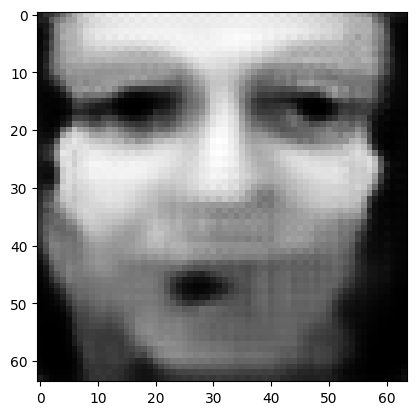

tensor([[9.5565e-01, 4.5326e-04, 2.0492e-05, 1.2714e-05, 1.2133e-04, 1.3656e-06,
         8.1308e-05, 1.3930e-04, 1.8160e-05, 5.8553e-04, 4.8989e-06, 5.5107e-03,
         8.3461e-03, 4.2900e-04, 4.2657e-06, 3.3502e-05, 1.3576e-03, 2.2188e-05,
         2.2202e-05, 7.0750e-07, 1.2168e-03, 4.4452e-04, 4.4787e-05, 3.4281e-04,
         2.9594e-03, 4.8588e-05, 5.9683e-05, 1.6293e-04, 9.4401e-04, 7.4993e-05,
         9.7695e-04, 3.6918e-05, 3.2870e-04, 9.7089e-05, 3.6807e-03, 2.2899e-05,
         5.7267e-03, 7.5002e-03, 8.3745e-04, 1.6793e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04536363109946251
tensor([[9.5589e-01, 4.5117e-04, 2.0343e-05, 1.2632e-05, 1.2069e-04, 1.3591e-06,
         8.0830e-05, 1.3878e-04, 1.8011e-05, 5.8273e-04, 4.8587e-06, 5.4868e-03,
         8.3019e-03, 4.2628e-04, 4.2296e-06, 3.3313e-05, 1.3503e-03, 2.2049e-05,
         2.2072e-05, 7.0180e-07, 1.2084e-03, 4.4183e-04, 4.4477e-05, 3.4092e-04,
         2.9422e-03, 4.8351e-05, 5.9291e-0

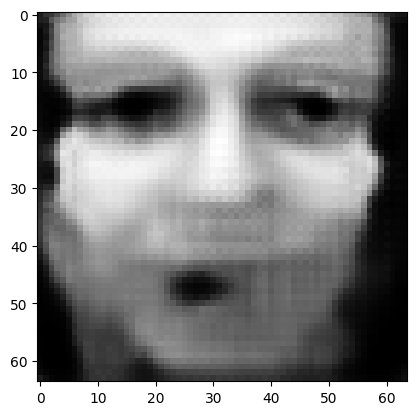

tensor([[9.5680e-01, 4.4324e-04, 1.9777e-05, 1.2320e-05, 1.1823e-04, 1.3345e-06,
         7.9028e-05, 1.3675e-04, 1.7449e-05, 5.7186e-04, 4.7071e-06, 5.3961e-03,
         8.1340e-03, 4.1605e-04, 4.0925e-06, 3.2596e-05, 1.3232e-03, 2.1522e-05,
         2.1578e-05, 6.8014e-07, 1.1769e-03, 4.3157e-04, 4.3288e-05, 3.3377e-04,
         2.8777e-03, 4.7448e-05, 5.7810e-05, 1.5766e-04, 9.1571e-04, 7.2421e-05,
         9.4783e-04, 3.5976e-05, 3.1906e-04, 9.3796e-05, 3.5856e-03, 2.2220e-05,
         5.5816e-03, 7.2974e-03, 8.1042e-04, 1.6339e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04415714740753174
tensor([[9.5702e-01, 4.4132e-04, 1.9643e-05, 1.2245e-05, 1.1764e-04, 1.3286e-06,
         7.8604e-05, 1.3626e-04, 1.7317e-05, 5.6930e-04, 4.6713e-06, 5.3744e-03,
         8.0941e-03, 4.1360e-04, 4.0597e-06, 3.2426e-05, 1.3167e-03, 2.1397e-05,
         2.1460e-05, 6.7499e-07, 1.1693e-03, 4.2913e-04, 4.3004e-05, 3.3205e-04,
         2.8625e-03, 4.7230e-05, 5.7459e-0

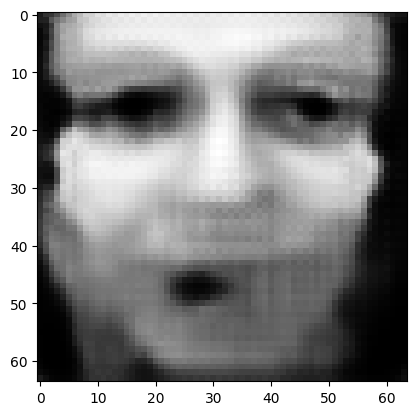

tensor([[9.5785e-01, 4.3410e-04, 1.9135e-05, 1.1964e-05, 1.1540e-04, 1.3062e-06,
         7.6980e-05, 1.3441e-04, 1.6815e-05, 5.5944e-04, 4.5359e-06, 5.2918e-03,
         7.9417e-03, 4.0436e-04, 3.9374e-06, 3.1778e-05, 1.2921e-03, 2.0922e-05,
         2.1015e-05, 6.5563e-07, 1.1409e-03, 4.1986e-04, 4.1935e-05, 3.2559e-04,
         2.8042e-03, 4.6409e-05, 5.6126e-05, 1.5291e-04, 8.9024e-04, 7.0108e-05,
         9.2155e-04, 3.5123e-05, 3.1035e-04, 9.0832e-05, 3.4997e-03, 2.1606e-05,
         5.4499e-03, 7.1143e-03, 7.8611e-04, 1.5928e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04306705296039581
tensor([[9.5804e-01, 4.3236e-04, 1.9015e-05, 1.1896e-05, 1.1487e-04, 1.3009e-06,
         7.6595e-05, 1.3397e-04, 1.6697e-05, 5.5711e-04, 4.5039e-06, 5.2719e-03,
         7.9058e-03, 4.0215e-04, 3.9082e-06, 3.1624e-05, 1.2863e-03, 2.0808e-05,
         2.0907e-05, 6.5104e-07, 1.1341e-03, 4.1765e-04, 4.1681e-05, 3.2403e-04,
         2.7904e-03, 4.6211e-05, 5.5808e-0

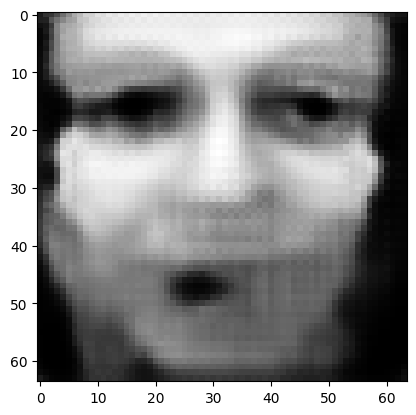

tensor([[9.5879e-01, 4.2583e-04, 1.8562e-05, 1.1644e-05, 1.1285e-04, 1.2808e-06,
         7.5130e-05, 1.3230e-04, 1.6249e-05, 5.4823e-04, 4.3834e-06, 5.1966e-03,
         7.7680e-03, 3.9384e-04, 3.7991e-06, 3.1042e-05, 1.2640e-03, 2.0380e-05,
         2.0506e-05, 6.3379e-07, 1.1085e-03, 4.0932e-04, 4.0721e-05, 3.1817e-04,
         2.7378e-03, 4.5466e-05, 5.4613e-05, 1.4866e-04, 8.6731e-04, 6.8041e-05,
         8.9786e-04, 3.4350e-05, 3.0252e-04, 8.8176e-05, 3.4219e-03, 2.1055e-05,
         5.3306e-03, 6.9491e-03, 7.6422e-04, 1.5558e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042082756757736206
tensor([[9.5897e-01, 4.2432e-04, 1.8453e-05, 1.1585e-05, 1.1236e-04, 1.2759e-06,
         7.4779e-05, 1.3189e-04, 1.6143e-05, 5.4602e-04, 4.3552e-06, 5.1786e-03,
         7.7349e-03, 3.9191e-04, 3.7733e-06, 3.0902e-05, 1.2588e-03, 2.0279e-05,
         2.0410e-05, 6.2972e-07, 1.1026e-03, 4.0734e-04, 4.0490e-05, 3.1678e-04,
         2.7253e-03, 4.5292e-05, 5.4331e-

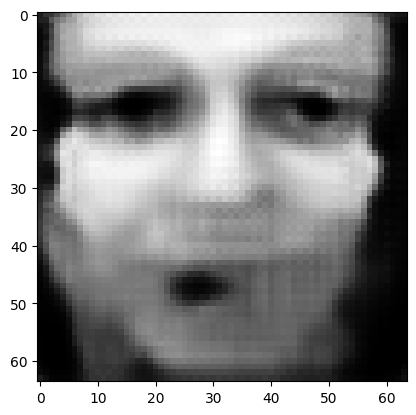

tensor([[9.5964e-01, 4.1850e-04, 1.8050e-05, 1.1362e-05, 1.1053e-04, 1.2580e-06,
         7.3448e-05, 1.3038e-04, 1.5743e-05, 5.3794e-04, 4.2483e-06, 5.1096e-03,
         7.6108e-03, 3.8448e-04, 3.6763e-06, 3.0382e-05, 1.2385e-03, 1.9893e-05,
         2.0048e-05, 6.1444e-07, 1.0798e-03, 3.9985e-04, 3.9627e-05, 3.1148e-04,
         2.6773e-03, 4.4620e-05, 5.3265e-05, 1.4485e-04, 8.4675e-04, 6.6179e-05,
         8.7640e-04, 3.3659e-05, 2.9544e-04, 8.5814e-05, 3.3508e-03, 2.0556e-05,
         5.2235e-03, 6.8018e-03, 7.4460e-04, 1.5225e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04119519144296646
tensor([[9.5980e-01, 4.1713e-04, 1.7953e-05, 1.1309e-05, 1.1010e-04, 1.2537e-06,
         7.3134e-05, 1.3001e-04, 1.5647e-05, 5.3597e-04, 4.2230e-06, 5.0933e-03,
         7.5809e-03, 3.8274e-04, 3.6533e-06, 3.0258e-05, 1.2337e-03, 1.9802e-05,
         1.9962e-05, 6.1082e-07, 1.0744e-03, 3.9808e-04, 3.9420e-05, 3.1022e-04,
         2.6660e-03, 4.4462e-05, 5.3010e-0

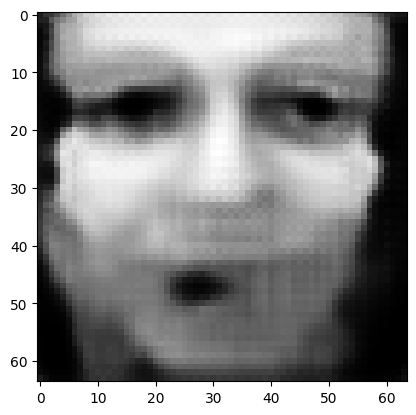

tensor([[9.6041e-01, 4.1183e-04, 1.7588e-05, 1.1107e-05, 1.0842e-04, 1.2372e-06,
         7.1925e-05, 1.2862e-04, 1.5287e-05, 5.2854e-04, 4.1268e-06, 5.0302e-03,
         7.4677e-03, 3.7602e-04, 3.5661e-06, 2.9784e-05, 1.2154e-03, 1.9453e-05,
         1.9633e-05, 5.9703e-07, 1.0538e-03, 3.9127e-04, 3.8637e-05, 3.0539e-04,
         2.6225e-03, 4.3850e-05, 5.2046e-05, 1.4140e-04, 8.2812e-04, 6.4500e-05,
         8.5699e-04, 3.3035e-05, 2.8904e-04, 8.3683e-05, 3.2862e-03, 2.0105e-05,
         5.1261e-03, 6.6683e-03, 7.2686e-04, 1.4922e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04038996249437332
tensor([[9.6056e-01, 4.1059e-04, 1.7501e-05, 1.1059e-05, 1.0803e-04, 1.2333e-06,
         7.1635e-05, 1.2829e-04, 1.5201e-05, 5.2675e-04, 4.1040e-06, 5.0154e-03,
         7.4402e-03, 3.7444e-04, 3.5454e-06, 2.9671e-05, 1.2109e-03, 1.9371e-05,
         1.9555e-05, 5.9378e-07, 1.0490e-03, 3.8965e-04, 3.8449e-05, 3.0424e-04,
         2.6120e-03, 4.3705e-05, 5.1815e-0

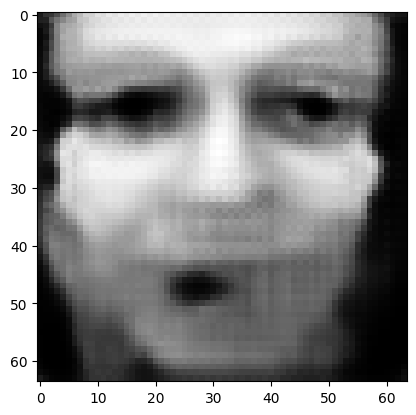

tensor([[9.6112e-01, 4.0570e-04, 1.7169e-05, 1.0874e-05, 1.0650e-04, 1.2183e-06,
         7.0532e-05, 1.2700e-04, 1.4874e-05, 5.1994e-04, 4.0167e-06, 4.9575e-03,
         7.3367e-03, 3.6831e-04, 3.4662e-06, 2.9238e-05, 1.1942e-03, 1.9052e-05,
         1.9254e-05, 5.8125e-07, 1.0302e-03, 3.8344e-04, 3.7738e-05, 2.9981e-04,
         2.5723e-03, 4.3145e-05, 5.0932e-05, 1.3825e-04, 8.1107e-04, 6.2979e-05,
         8.3930e-04, 3.2463e-05, 2.8321e-04, 8.1745e-05, 3.2272e-03, 1.9694e-05,
         5.0367e-03, 6.5466e-03, 7.1068e-04, 1.4646e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039654091000556946
tensor([[9.6126e-01, 4.0457e-04, 1.7090e-05, 1.0832e-05, 1.0613e-04, 1.2147e-06,
         7.0268e-05, 1.2669e-04, 1.4796e-05, 5.1829e-04, 3.9960e-06, 4.9437e-03,
         7.3116e-03, 3.6686e-04, 3.4477e-06, 2.9133e-05, 1.1901e-03, 1.8977e-05,
         1.9183e-05, 5.7831e-07, 1.0258e-03, 3.8196e-04, 3.7569e-05, 2.9877e-04,
         2.5627e-03, 4.3013e-05, 5.0724e-

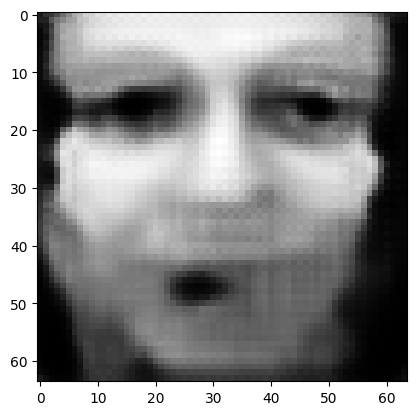

tensor([[9.6177e-01, 4.0011e-04, 1.6787e-05, 1.0663e-05, 1.0473e-04, 1.2008e-06,
         6.9250e-05, 1.2551e-04, 1.4497e-05, 5.1199e-04, 3.9165e-06, 4.8902e-03,
         7.2162e-03, 3.6126e-04, 3.3759e-06, 2.8735e-05, 1.1746e-03, 1.8686e-05,
         1.8907e-05, 5.6694e-07, 1.0087e-03, 3.7627e-04, 3.6917e-05, 2.9469e-04,
         2.5259e-03, 4.2497e-05, 4.9915e-05, 1.3537e-04, 7.9553e-04, 6.1587e-05,
         8.2307e-04, 3.1938e-05, 2.7787e-04, 7.9982e-05, 3.1727e-03, 1.9317e-05,
         4.9550e-03, 6.4350e-03, 6.9591e-04, 1.4391e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03897833079099655
tensor([[9.6190e-01, 3.9902e-04, 1.6714e-05, 1.0623e-05, 1.0439e-04, 1.1975e-06,
         6.9007e-05, 1.2522e-04, 1.4426e-05, 5.1048e-04, 3.8975e-06, 4.8772e-03,
         7.1935e-03, 3.5991e-04, 3.3587e-06, 2.8639e-05, 1.1710e-03, 1.8615e-05,
         1.8840e-05, 5.6422e-07, 1.0045e-03, 3.7491e-04, 3.6761e-05, 2.9371e-04,
         2.5171e-03, 4.2372e-05, 4.9721e-0

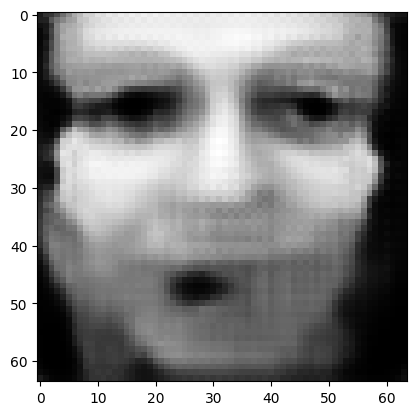

tensor([[9.6237e-01, 3.9487e-04, 1.6436e-05, 1.0467e-05, 1.0310e-04, 1.1847e-06,
         6.8074e-05, 1.2412e-04, 1.4154e-05, 5.0469e-04, 3.8250e-06, 4.8277e-03,
         7.1061e-03, 3.5476e-04, 3.2930e-06, 2.8273e-05, 1.1567e-03, 1.8347e-05,
         1.8585e-05, 5.5381e-07, 9.8877e-04, 3.6966e-04, 3.6164e-05, 2.8996e-04,
         2.4835e-03, 4.1894e-05, 4.8981e-05, 1.3274e-04, 7.8123e-04, 6.0310e-05,
         8.0814e-04, 3.1450e-05, 2.7295e-04, 7.8356e-05, 3.1225e-03, 1.8970e-05,
         4.8795e-03, 6.3316e-03, 6.8234e-04, 1.4157e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03835603594779968
tensor([[9.6248e-01, 3.9388e-04, 1.6370e-05, 1.0430e-05, 1.0279e-04, 1.1816e-06,
         6.7847e-05, 1.2386e-04, 1.4088e-05, 5.0329e-04, 3.8075e-06, 4.8157e-03,
         7.0847e-03, 3.5352e-04, 3.2773e-06, 2.8184e-05, 1.1532e-03, 1.8283e-05,
         1.8524e-05, 5.5131e-07, 9.8499e-04, 3.6841e-04, 3.6020e-05, 2.8905e-04,
         2.4753e-03, 4.1778e-05, 4.8802e-0

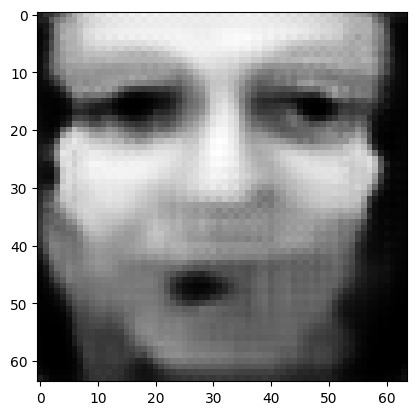

tensor([[9.6293e-01, 3.9006e-04, 1.6112e-05, 1.0286e-05, 1.0159e-04, 1.1696e-06,
         6.6977e-05, 1.2283e-04, 1.3836e-05, 4.9787e-04, 3.7406e-06, 4.7692e-03,
         7.0035e-03, 3.4875e-04, 3.2169e-06, 2.7844e-05, 1.1399e-03, 1.8034e-05,
         1.8287e-05, 5.4174e-07, 9.7037e-04, 3.6357e-04, 3.5465e-05, 2.8556e-04,
         2.4439e-03, 4.1331e-05, 4.8112e-05, 1.3029e-04, 7.6798e-04, 5.9135e-05,
         7.9434e-04, 3.0998e-05, 2.6839e-04, 7.6861e-05, 3.0759e-03, 1.8652e-05,
         4.8094e-03, 6.2357e-03, 6.6979e-04, 1.3940e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037778351455926895
tensor([[9.6303e-01, 3.8914e-04, 1.6050e-05, 1.0252e-05, 1.0129e-04, 1.1667e-06,
         6.6768e-05, 1.2258e-04, 1.3776e-05, 4.9654e-04, 3.7246e-06, 4.7580e-03,
         6.9837e-03, 3.4760e-04, 3.2024e-06, 2.7761e-05, 1.1368e-03, 1.7974e-05,
         1.8231e-05, 5.3943e-07, 9.6687e-04, 3.6239e-04, 3.5331e-05, 2.8472e-04,
         2.4363e-03, 4.1223e-05, 4.7948e-

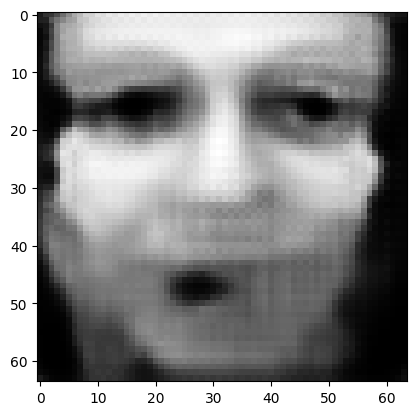

tensor([[9.6344e-01, 3.8558e-04, 1.5814e-05, 1.0120e-05, 1.0019e-04, 1.1557e-06,
         6.5969e-05, 1.2162e-04, 1.3546e-05, 4.9157e-04, 3.6633e-06, 4.7150e-03,
         6.9088e-03, 3.4320e-04, 3.1471e-06, 2.7448e-05, 1.1245e-03, 1.7745e-05,
         1.8013e-05, 5.3066e-07, 9.5342e-04, 3.5794e-04, 3.4823e-05, 2.8150e-04,
         2.4074e-03, 4.0810e-05, 4.7314e-05, 1.2805e-04, 7.5579e-04, 5.8050e-05,
         7.8159e-04, 3.0578e-05, 2.6418e-04, 7.5482e-05, 3.0328e-03, 1.8357e-05,
         4.7447e-03, 6.1470e-03, 6.5823e-04, 1.3740e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03724443539977074
tensor([[9.6354e-01, 3.8471e-04, 1.5757e-05, 1.0087e-05, 9.9924e-05, 1.1531e-06,
         6.5778e-05, 1.2140e-04, 1.3491e-05, 4.9038e-04, 3.6485e-06, 4.7047e-03,
         6.8908e-03, 3.4214e-04, 3.1337e-06, 2.7373e-05, 1.1216e-03, 1.7690e-05,
         1.7960e-05, 5.2855e-07, 9.5016e-04, 3.5686e-04, 3.4701e-05, 2.8073e-04,
         2.4005e-03, 4.0711e-05, 4.7161e-0

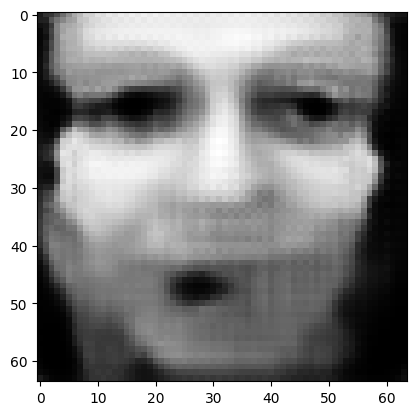

tensor([[9.6392e-01, 3.8138e-04, 1.5540e-05, 9.9635e-06, 9.8883e-05, 1.1429e-06,
         6.5033e-05, 1.2050e-04, 1.3279e-05, 4.8573e-04, 3.5923e-06, 4.6648e-03,
         6.8215e-03, 3.3808e-04, 3.0826e-06, 2.7084e-05, 1.1103e-03, 1.7479e-05,
         1.7757e-05, 5.2042e-07, 9.3768e-04, 3.5270e-04, 3.4230e-05, 2.7772e-04,
         2.3738e-03, 4.0324e-05, 4.6580e-05, 1.2598e-04, 7.4451e-04, 5.7051e-05,
         7.6981e-04, 3.0188e-05, 2.6028e-04, 7.4202e-05, 2.9927e-03, 1.8084e-05,
         4.6844e-03, 6.0647e-03, 6.4754e-04, 1.3555e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03675056993961334
tensor([[9.6401e-01, 3.8059e-04, 1.5488e-05, 9.9344e-06, 9.8631e-05, 1.1404e-06,
         6.4854e-05, 1.2028e-04, 1.3229e-05, 4.8461e-04, 3.5789e-06, 4.6551e-03,
         6.8049e-03, 3.3710e-04, 3.0705e-06, 2.7014e-05, 1.1076e-03, 1.7428e-05,
         1.7708e-05, 5.1849e-07, 9.3471e-04, 3.5171e-04, 3.4118e-05, 2.7700e-04,
         2.3673e-03, 4.0231e-05, 4.6441e-0

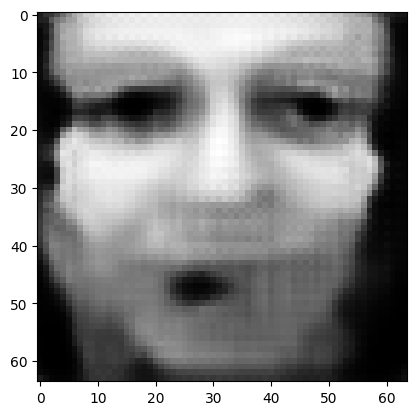

tensor([[9.6436e-01, 3.7752e-04, 1.5287e-05, 9.8204e-06, 9.7673e-05, 1.1310e-06,
         6.4165e-05, 1.1944e-04, 1.3034e-05, 4.8027e-04, 3.5271e-06, 4.6181e-03,
         6.7403e-03, 3.3336e-04, 3.0235e-06, 2.6747e-05, 1.0971e-03, 1.7233e-05,
         1.7520e-05, 5.1102e-07, 9.2322e-04, 3.4788e-04, 3.3682e-05, 2.7421e-04,
         2.3424e-03, 3.9873e-05, 4.5902e-05, 1.2407e-04, 7.3409e-04, 5.6127e-05,
         7.5892e-04, 2.9828e-05, 2.5668e-04, 7.3027e-05, 2.9555e-03, 1.7832e-05,
         4.6288e-03, 5.9885e-03, 6.3768e-04, 1.3383e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03629313036799431
tensor([[9.6444e-01, 3.7674e-04, 1.5239e-05, 9.7918e-06, 9.7437e-05, 1.1287e-06,
         6.4001e-05, 1.1924e-04, 1.2987e-05, 4.7925e-04, 3.5146e-06, 4.6091e-03,
         6.7249e-03, 3.3244e-04, 3.0120e-06, 2.6682e-05, 1.0946e-03, 1.7185e-05,
         1.7474e-05, 5.0920e-07, 9.2037e-04, 3.4694e-04, 3.3576e-05, 2.7354e-04,
         2.3366e-03, 3.9786e-05, 4.5772e-0

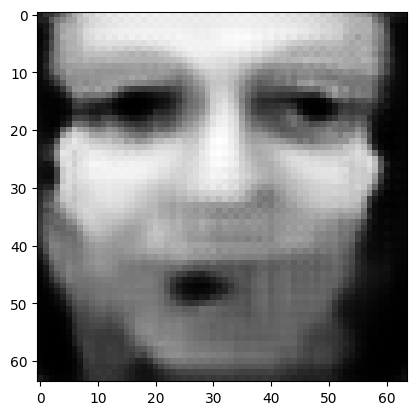

tensor([[9.6477e-01, 3.7388e-04, 1.5054e-05, 9.6857e-06, 9.6546e-05, 1.1199e-06,
         6.3363e-05, 1.1846e-04, 1.2808e-05, 4.7524e-04, 3.4669e-06, 4.5747e-03,
         6.6651e-03, 3.2897e-04, 2.9686e-06, 2.6435e-05, 1.0850e-03, 1.7004e-05,
         1.7300e-05, 5.0231e-07, 9.0973e-04, 3.4339e-04, 3.3173e-05, 2.7096e-04,
         2.3136e-03, 3.9453e-05, 4.5274e-05, 1.2231e-04, 7.2442e-04, 5.5274e-05,
         7.4883e-04, 2.9492e-05, 2.5334e-04, 7.1932e-05, 2.9210e-03, 1.7599e-05,
         4.5769e-03, 5.9178e-03, 6.2854e-04, 1.3223e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035868722945451736
tensor([[9.6485e-01, 3.7318e-04, 1.5009e-05, 9.6601e-06, 9.6329e-05, 1.1178e-06,
         6.3209e-05, 1.1828e-04, 1.2765e-05, 4.7428e-04, 3.4555e-06, 4.5664e-03,
         6.6507e-03, 3.2813e-04, 2.9582e-06, 2.6375e-05, 1.0826e-03, 1.6961e-05,
         1.7258e-05, 5.0065e-07, 9.0716e-04, 3.4253e-04, 3.3077e-05, 2.7034e-04,
         2.3081e-03, 3.9372e-05, 4.5154e-

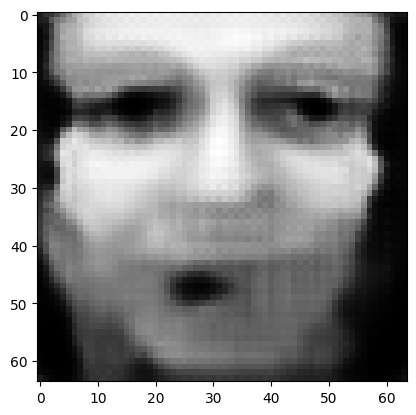

tensor([[9.6515e-01, 3.7051e-04, 1.4838e-05, 9.5624e-06, 9.5498e-05, 1.1096e-06,
         6.2618e-05, 1.1756e-04, 1.2599e-05, 4.7057e-04, 3.4115e-06, 4.5342e-03,
         6.5953e-03, 3.2489e-04, 2.9184e-06, 2.6146e-05, 1.0736e-03, 1.6793e-05,
         1.7096e-05, 4.9431e-07, 8.9729e-04, 3.3924e-04, 3.2705e-05, 2.6795e-04,
         2.2867e-03, 3.9063e-05, 4.4694e-05, 1.2068e-04, 7.1550e-04, 5.4484e-05,
         7.3945e-04, 2.9179e-05, 2.5024e-04, 7.0923e-05, 2.8890e-03, 1.7382e-05,
         4.5289e-03, 5.8519e-03, 6.2009e-04, 1.3075e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035474278032779694
tensor([[9.6522e-01, 3.6985e-04, 1.4797e-05, 9.5379e-06, 9.5297e-05, 1.1076e-06,
         6.2475e-05, 1.1738e-04, 1.2559e-05, 4.6967e-04, 3.4008e-06, 4.5265e-03,
         6.5821e-03, 3.2412e-04, 2.9086e-06, 2.6091e-05, 1.0715e-03, 1.6752e-05,
         1.7057e-05, 4.9275e-07, 8.9488e-04, 3.3844e-04, 3.2614e-05, 2.6737e-04,
         2.2817e-03, 3.8987e-05, 4.4582e-

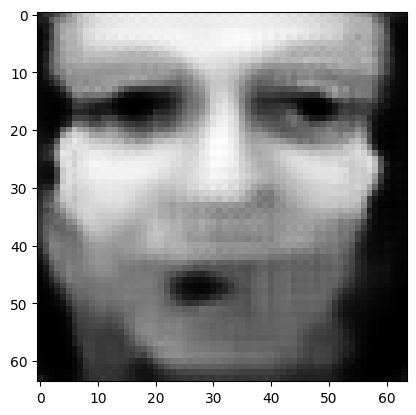

tensor([[9.6550e-01, 3.6738e-04, 1.4641e-05, 9.4498e-06, 9.4545e-05, 1.1002e-06,
         6.1938e-05, 1.1671e-04, 1.2409e-05, 4.6629e-04, 3.3606e-06, 4.4977e-03,
         6.5313e-03, 3.2116e-04, 2.8721e-06, 2.5881e-05, 1.0632e-03, 1.6602e-05,
         1.6910e-05, 4.8703e-07, 8.8596e-04, 3.3542e-04, 3.2275e-05, 2.6519e-04,
         2.2618e-03, 3.8708e-05, 4.4158e-05, 1.1918e-04, 7.0724e-04, 5.3757e-05,
         7.3081e-04, 2.8893e-05, 2.4740e-04, 6.9990e-05, 2.8594e-03, 1.7184e-05,
         4.4840e-03, 5.7914e-03, 6.1229e-04, 1.2940e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035112250596284866
tensor([[9.6556e-01, 3.6677e-04, 1.4603e-05, 9.4278e-06, 9.4365e-05, 1.0984e-06,
         6.1810e-05, 1.1654e-04, 1.2374e-05, 4.6547e-04, 3.3509e-06, 4.4909e-03,
         6.5193e-03, 3.2045e-04, 2.8632e-06, 2.5831e-05, 1.0613e-03, 1.6565e-05,
         1.6874e-05, 4.8564e-07, 8.8378e-04, 3.3468e-04, 3.2192e-05, 2.6467e-04,
         2.2571e-03, 3.8640e-05, 4.4056e-

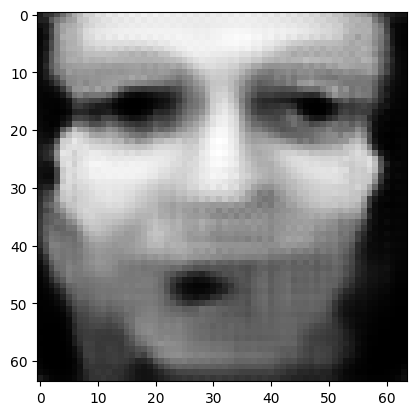

tensor([[9.6582e-01, 3.6448e-04, 1.4460e-05, 9.3468e-06, 9.3668e-05, 1.0915e-06,
         6.1315e-05, 1.1591e-04, 1.2236e-05, 4.6233e-04, 3.3137e-06, 4.4644e-03,
         6.4726e-03, 3.1771e-04, 2.8296e-06, 2.5637e-05, 1.0536e-03, 1.6427e-05,
         1.6739e-05, 4.8039e-07, 8.7557e-04, 3.3188e-04, 3.1879e-05, 2.6266e-04,
         2.2386e-03, 3.8383e-05, 4.3664e-05, 1.1781e-04, 6.9961e-04, 5.3083e-05,
         7.2283e-04, 2.8629e-05, 2.4478e-04, 6.9128e-05, 2.8320e-03, 1.7000e-05,
         4.4423e-03, 5.7357e-03, 6.0510e-04, 1.2817e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034778762608766556
tensor([[9.6588e-01, 3.6393e-04, 1.4426e-05, 9.3278e-06, 9.3507e-05, 1.0899e-06,
         6.1195e-05, 1.1576e-04, 1.2203e-05, 4.6157e-04, 3.3048e-06, 4.4580e-03,
         6.4612e-03, 3.1706e-04, 2.8216e-06, 2.5591e-05, 1.0518e-03, 1.6394e-05,
         1.6706e-05, 4.7914e-07, 8.7363e-04, 3.3122e-04, 3.1804e-05, 2.6217e-04,
         2.2341e-03, 3.8322e-05, 4.3568e-

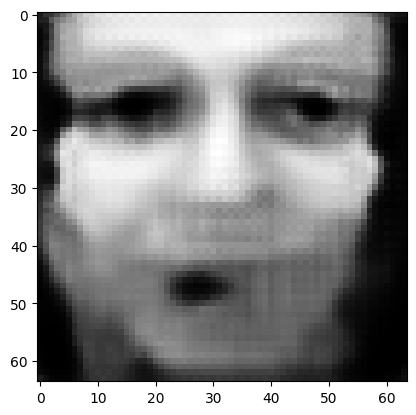

tensor([[9.6612e-01, 3.6178e-04, 1.4293e-05, 9.2518e-06, 9.2860e-05, 1.0835e-06,
         6.0735e-05, 1.1518e-04, 1.2075e-05, 4.5865e-04, 3.2703e-06, 4.4334e-03,
         6.4180e-03, 3.1452e-04, 2.7903e-06, 2.5411e-05, 1.0447e-03, 1.6266e-05,
         1.6580e-05, 4.7427e-07, 8.6599e-04, 3.2861e-04, 3.1513e-05, 2.6030e-04,
         2.2170e-03, 3.8082e-05, 4.3204e-05, 1.1653e-04, 6.9251e-04, 5.2462e-05,
         7.1543e-04, 2.8385e-05, 2.4235e-04, 6.8331e-05, 2.8065e-03, 1.6830e-05,
         4.4036e-03, 5.6840e-03, 5.9842e-04, 1.2703e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034468770027160645
tensor([[9.6618e-01, 3.6127e-04, 1.4261e-05, 9.2334e-06, 9.2704e-05, 1.0819e-06,
         6.0623e-05, 1.1503e-04, 1.2044e-05, 4.5794e-04, 3.2621e-06, 4.4274e-03,
         6.4075e-03, 3.1391e-04, 2.7827e-06, 2.5368e-05, 1.0430e-03, 1.6235e-05,
         1.6549e-05, 4.7309e-07, 8.6415e-04, 3.2798e-04, 3.1442e-05, 2.5984e-04,
         2.2128e-03, 3.8023e-05, 4.3116e-

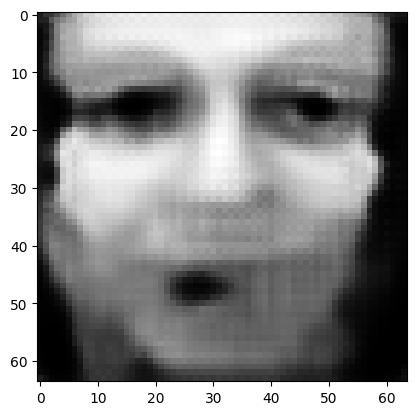

tensor([[9.6640e-01, 3.5927e-04, 1.4137e-05, 9.1636e-06, 9.2098e-05, 1.0759e-06,
         6.0193e-05, 1.1448e-04, 1.1926e-05, 4.5519e-04, 3.2300e-06, 4.4044e-03,
         6.3668e-03, 3.1155e-04, 2.7538e-06, 2.5199e-05, 1.0363e-03, 1.6115e-05,
         1.6431e-05, 4.6858e-07, 8.5709e-04, 3.2556e-04, 3.1171e-05, 2.5809e-04,
         2.1967e-03, 3.7800e-05, 4.2777e-05, 1.1534e-04, 6.8591e-04, 5.1881e-05,
         7.0852e-04, 2.8157e-05, 2.4008e-04, 6.7589e-05, 2.7827e-03, 1.6670e-05,
         4.3676e-03, 5.6358e-03, 5.9221e-04, 1.2596e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03417942300438881
tensor([[9.6645e-01, 3.5879e-04, 1.4107e-05, 9.1464e-06, 9.1954e-05, 1.0745e-06,
         6.0088e-05, 1.1435e-04, 1.1897e-05, 4.5453e-04, 3.2223e-06, 4.3988e-03,
         6.3570e-03, 3.1098e-04, 2.7468e-06, 2.5159e-05, 1.0347e-03, 1.6086e-05,
         1.6403e-05, 4.6748e-07, 8.5537e-04, 3.2497e-04, 3.1105e-05, 2.5767e-04,
         2.1928e-03, 3.7746e-05, 4.2694e-0

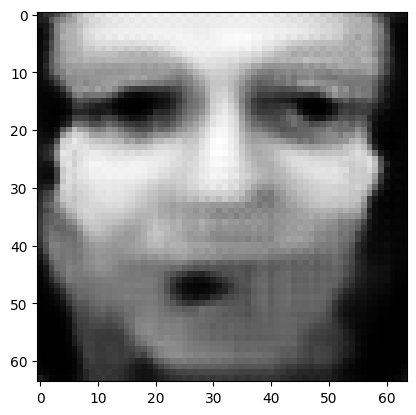

tensor([[9.6666e-01, 3.5691e-04, 1.3992e-05, 9.0810e-06, 9.1392e-05, 1.0689e-06,
         5.9687e-05, 1.1384e-04, 1.1787e-05, 4.5197e-04, 3.1925e-06, 4.3772e-03,
         6.3192e-03, 3.0878e-04, 2.7200e-06, 2.5002e-05, 1.0285e-03, 1.5975e-05,
         1.6293e-05, 4.6328e-07, 8.4877e-04, 3.2271e-04, 3.0853e-05, 2.5603e-04,
         2.1778e-03, 3.7536e-05, 4.2378e-05, 1.1423e-04, 6.7975e-04, 5.1341e-05,
         7.0207e-04, 2.7943e-05, 2.3797e-04, 6.6898e-05, 2.7605e-03, 1.6522e-05,
         4.3338e-03, 5.5907e-03, 5.8641e-04, 1.2496e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03390911594033241
tensor([[9.6671e-01, 3.5647e-04, 1.3964e-05, 9.0651e-06, 9.1254e-05, 1.0676e-06,
         5.9589e-05, 1.1371e-04, 1.1760e-05, 4.5134e-04, 3.1854e-06, 4.3720e-03,
         6.3099e-03, 3.0825e-04, 2.7135e-06, 2.4964e-05, 1.0270e-03, 1.5948e-05,
         1.6266e-05, 4.6227e-07, 8.4719e-04, 3.2216e-04, 3.0791e-05, 2.5564e-04,
         2.1742e-03, 3.7486e-05, 4.2301e-0

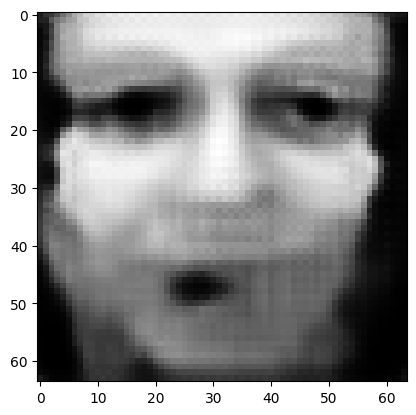

tensor([[9.6690e-01, 3.5473e-04, 1.3857e-05, 9.0043e-06, 9.0725e-05, 1.0623e-06,
         5.9215e-05, 1.1323e-04, 1.1658e-05, 4.4895e-04, 3.1578e-06, 4.3518e-03,
         6.2747e-03, 3.0621e-04, 2.6885e-06, 2.4818e-05, 1.0213e-03, 1.5844e-05,
         1.6164e-05, 4.5837e-07, 8.4106e-04, 3.2004e-04, 3.0556e-05, 2.5412e-04,
         2.1601e-03, 3.7290e-05, 4.2008e-05, 1.1319e-04, 6.7402e-04, 5.0837e-05,
         6.9606e-04, 2.7744e-05, 2.3599e-04, 6.6256e-05, 2.7396e-03, 1.6383e-05,
         4.3023e-03, 5.5487e-03, 5.8103e-04, 1.2403e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03365718200802803
tensor([[9.6695e-01, 3.5430e-04, 1.3831e-05, 8.9892e-06, 9.0601e-05, 1.0611e-06,
         5.9125e-05, 1.1312e-04, 1.1633e-05, 4.4838e-04, 3.1512e-06, 4.3470e-03,
         6.2663e-03, 3.0571e-04, 2.6824e-06, 2.4784e-05, 1.0199e-03, 1.5819e-05,
         1.6139e-05, 4.5743e-07, 8.3957e-04, 3.1954e-04, 3.0499e-05, 2.5375e-04,
         2.1568e-03, 3.7242e-05, 4.1937e-0

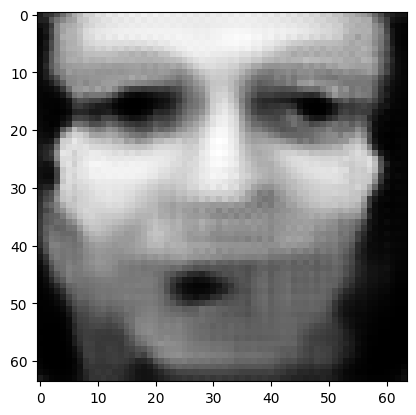

tensor([[9.6713e-01, 3.5269e-04, 1.3733e-05, 8.9328e-06, 9.0111e-05, 1.0563e-06,
         5.8778e-05, 1.1268e-04, 1.1538e-05, 4.4619e-04, 3.1259e-06, 4.3282e-03,
         6.2335e-03, 3.0381e-04, 2.6594e-06, 2.4652e-05, 1.0145e-03, 1.5722e-05,
         1.6044e-05, 4.5386e-07, 8.3388e-04, 3.1759e-04, 3.0280e-05, 2.5235e-04,
         2.1438e-03, 3.7059e-05, 4.1665e-05, 1.1224e-04, 6.6873e-04, 5.0375e-05,
         6.9049e-04, 2.7558e-05, 2.3416e-04, 6.5663e-05, 2.7204e-03, 1.6256e-05,
         4.2730e-03, 5.5094e-03, 5.7606e-04, 1.2317e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033423516899347305
tensor([[9.6717e-01, 3.5232e-04, 1.3709e-05, 8.9198e-06, 8.9993e-05, 1.0551e-06,
         5.8695e-05, 1.1258e-04, 1.1515e-05, 4.4566e-04, 3.1198e-06, 4.3237e-03,
         6.2254e-03, 3.0335e-04, 2.6539e-06, 2.4620e-05, 1.0132e-03, 1.5699e-05,
         1.6022e-05, 4.5302e-07, 8.3254e-04, 3.1713e-04, 3.0227e-05, 2.5202e-04,
         2.1405e-03, 3.7016e-05, 4.1600e-

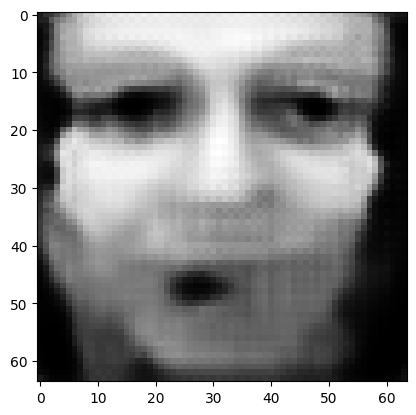

tensor([[9.6734e-01, 3.5082e-04, 1.3618e-05, 8.8672e-06, 8.9536e-05, 1.0506e-06,
         5.8370e-05, 1.1217e-04, 1.1427e-05, 4.4363e-04, 3.0963e-06, 4.3060e-03,
         6.1947e-03, 3.0157e-04, 2.6325e-06, 2.4496e-05, 1.0082e-03, 1.5609e-05,
         1.5934e-05, 4.4971e-07, 8.2724e-04, 3.1532e-04, 3.0023e-05, 2.5071e-04,
         2.1283e-03, 3.6844e-05, 4.1346e-05, 1.1136e-04, 6.6382e-04, 4.9945e-05,
         6.8527e-04, 2.7386e-05, 2.3246e-04, 6.5113e-05, 2.7024e-03, 1.6137e-05,
         4.2458e-03, 5.4728e-03, 5.7144e-04, 1.2237e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03320501372218132
tensor([[9.6738e-01, 3.5045e-04, 1.3596e-05, 8.8544e-06, 8.9426e-05, 1.0495e-06,
         5.8292e-05, 1.1207e-04, 1.1406e-05, 4.4314e-04, 3.0906e-06, 4.3018e-03,
         6.1873e-03, 3.0114e-04, 2.6274e-06, 2.4467e-05, 1.0070e-03, 1.5587e-05,
         1.5913e-05, 4.4891e-07, 8.2596e-04, 3.1488e-04, 2.9973e-05, 2.5040e-04,
         2.1254e-03, 3.6803e-05, 4.1285e-0

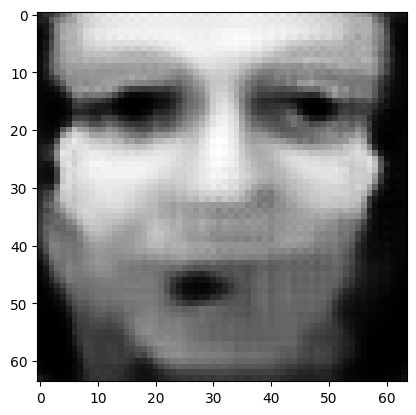

tensor([[9.6754e-01, 3.4907e-04, 1.3511e-05, 8.8058e-06, 8.8996e-05, 1.0453e-06,
         5.7989e-05, 1.1170e-04, 1.1324e-05, 4.4124e-04, 3.0688e-06, 4.2853e-03,
         6.1586e-03, 2.9947e-04, 2.6075e-06, 2.4353e-05, 1.0024e-03, 1.5502e-05,
         1.5831e-05, 4.4584e-07, 8.2104e-04, 3.1319e-04, 2.9782e-05, 2.4919e-04,
         2.1140e-03, 3.6643e-05, 4.1049e-05, 1.1053e-04, 6.5925e-04, 4.9545e-05,
         6.8040e-04, 2.7224e-05, 2.3087e-04, 6.4600e-05, 2.6857e-03, 1.6027e-05,
         4.2202e-03, 5.4385e-03, 5.6714e-04, 1.2162e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03300100192427635
tensor([[9.6758e-01, 3.4871e-04, 1.3490e-05, 8.7934e-06, 8.8890e-05, 1.0442e-06,
         5.7916e-05, 1.1161e-04, 1.1304e-05, 4.4079e-04, 3.0635e-06, 4.2813e-03,
         6.1518e-03, 2.9907e-04, 2.6026e-06, 2.4325e-05, 1.0012e-03, 1.5481e-05,
         1.5811e-05, 4.4509e-07, 8.1981e-04, 3.1278e-04, 2.9735e-05, 2.4889e-04,
         2.1112e-03, 3.6603e-05, 4.0992e-0

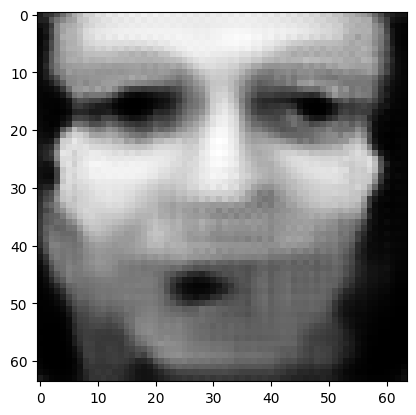

tensor([[9.6772e-01, 3.4741e-04, 1.3411e-05, 8.7478e-06, 8.8491e-05, 1.0403e-06,
         5.7631e-05, 1.1125e-04, 1.1227e-05, 4.3903e-04, 3.0432e-06, 4.2658e-03,
         6.1248e-03, 2.9750e-04, 2.5841e-06, 2.4218e-05, 9.9683e-04, 1.5402e-05,
         1.5735e-05, 4.4223e-07, 8.1520e-04, 3.1121e-04, 2.9557e-05, 2.4775e-04,
         2.1005e-03, 3.6452e-05, 4.0771e-05, 1.0976e-04, 6.5497e-04, 4.9172e-05,
         6.7584e-04, 2.7071e-05, 2.2938e-04, 6.4120e-05, 2.6700e-03, 1.5923e-05,
         4.1962e-03, 5.4063e-03, 5.6312e-04, 1.2092e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03280940279364586
tensor([[9.6776e-01, 3.4708e-04, 1.3391e-05, 8.7365e-06, 8.8390e-05, 1.0393e-06,
         5.7562e-05, 1.1117e-04, 1.1208e-05, 4.3860e-04, 3.0382e-06, 4.2619e-03,
         6.1184e-03, 2.9712e-04, 2.5795e-06, 2.4192e-05, 9.9578e-04, 1.5383e-05,
         1.5716e-05, 4.4153e-07, 8.1406e-04, 3.1082e-04, 2.9513e-05, 2.4748e-04,
         2.0979e-03, 3.6416e-05, 4.0717e-0

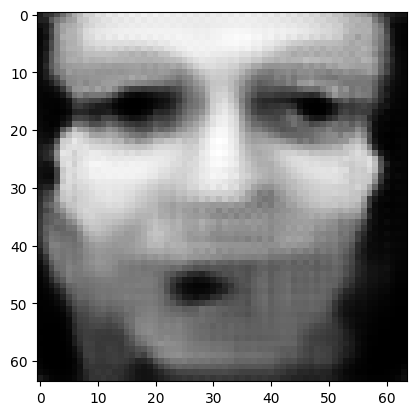

tensor([[9.6790e-01, 3.4585e-04, 1.3316e-05, 8.6935e-06, 8.8012e-05, 1.0356e-06,
         5.7296e-05, 1.1084e-04, 1.1136e-05, 4.3693e-04, 3.0191e-06, 4.2473e-03,
         6.0930e-03, 2.9565e-04, 2.5621e-06, 2.4091e-05, 9.9167e-04, 1.5308e-05,
         1.5644e-05, 4.3884e-07, 8.0972e-04, 3.0933e-04, 2.9345e-05, 2.4641e-04,
         2.0879e-03, 3.6274e-05, 4.0510e-05, 1.0904e-04, 6.5095e-04, 4.8820e-05,
         6.7154e-04, 2.6927e-05, 2.2798e-04, 6.3668e-05, 2.6552e-03, 1.5825e-05,
         4.1737e-03, 5.3759e-03, 5.5934e-04, 1.2026e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03262942284345627
tensor([[9.6793e-01, 3.4555e-04, 1.3298e-05, 8.6829e-06, 8.7920e-05, 1.0347e-06,
         5.7231e-05, 1.1076e-04, 1.1119e-05, 4.3653e-04, 3.0144e-06, 4.2438e-03,
         6.0869e-03, 2.9530e-04, 2.5579e-06, 2.4066e-05, 9.9065e-04, 1.5290e-05,
         1.5627e-05, 4.3818e-07, 8.0866e-04, 3.0897e-04, 2.9304e-05, 2.4615e-04,
         2.0854e-03, 3.6239e-05, 4.0460e-0

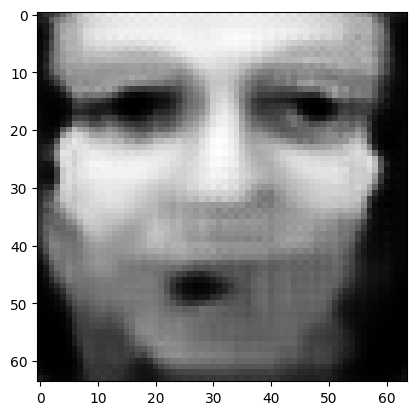

tensor([[9.6806e-01, 3.4439e-04, 1.3228e-05, 8.6425e-06, 8.7565e-05, 1.0312e-06,
         5.6980e-05, 1.1044e-04, 1.1051e-05, 4.3496e-04, 2.9965e-06, 4.2300e-03,
         6.0631e-03, 2.9392e-04, 2.5415e-06, 2.3972e-05, 9.8680e-04, 1.5220e-05,
         1.5559e-05, 4.3566e-07, 8.0458e-04, 3.0758e-04, 2.9146e-05, 2.4515e-04,
         2.0760e-03, 3.6106e-05, 4.0265e-05, 1.0836e-04, 6.4717e-04, 4.8490e-05,
         6.6751e-04, 2.6792e-05, 2.2666e-04, 6.3244e-05, 2.6413e-03, 1.5734e-05,
         4.1525e-03, 5.3475e-03, 5.5580e-04, 1.1964e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032460372895002365
tensor([[9.6809e-01, 3.4410e-04, 1.3211e-05, 8.6326e-06, 8.7478e-05, 1.0303e-06,
         5.6919e-05, 1.1037e-04, 1.1035e-05, 4.3459e-04, 2.9921e-06, 4.2267e-03,
         6.0573e-03, 2.9358e-04, 2.5376e-06, 2.3949e-05, 9.8584e-04, 1.5203e-05,
         1.5542e-05, 4.3505e-07, 8.0358e-04, 3.0724e-04, 2.9108e-05, 2.4490e-04,
         2.0737e-03, 3.6074e-05, 4.0217e-

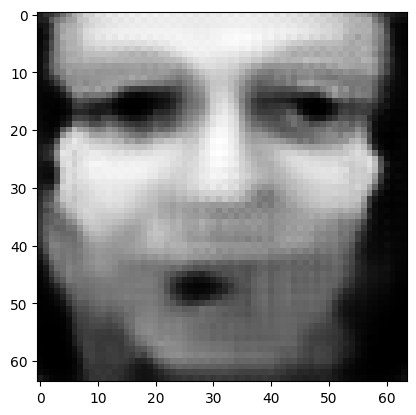

tensor([[9.6822e-01, 3.4301e-04, 1.3145e-05, 8.5945e-06, 8.7142e-05, 1.0270e-06,
         5.6683e-05, 1.1007e-04, 1.0971e-05, 4.3311e-04, 2.9753e-06, 4.2137e-03,
         6.0349e-03, 2.9228e-04, 2.5222e-06, 2.3859e-05, 9.8218e-04, 1.5137e-05,
         1.5479e-05, 4.3268e-07, 7.9974e-04, 3.0592e-04, 2.8960e-05, 2.4395e-04,
         2.0647e-03, 3.5948e-05, 4.0034e-05, 1.0772e-04, 6.4362e-04, 4.8180e-05,
         6.6371e-04, 2.6665e-05, 2.2542e-04, 6.2846e-05, 2.6282e-03, 1.5648e-05,
         4.1325e-03, 5.3206e-03, 5.5246e-04, 1.1906e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032300759106874466
tensor([[9.6824e-01, 3.4274e-04, 1.3129e-05, 8.5852e-06, 8.7061e-05, 1.0262e-06,
         5.6626e-05, 1.1000e-04, 1.0956e-05, 4.3276e-04, 2.9712e-06, 4.2106e-03,
         6.0295e-03, 2.9196e-04, 2.5185e-06, 2.3838e-05, 9.8130e-04, 1.5121e-05,
         1.5463e-05, 4.3210e-07, 7.9880e-04, 3.0561e-04, 2.8924e-05, 2.4372e-04,
         2.0626e-03, 3.5917e-05, 3.9989e-

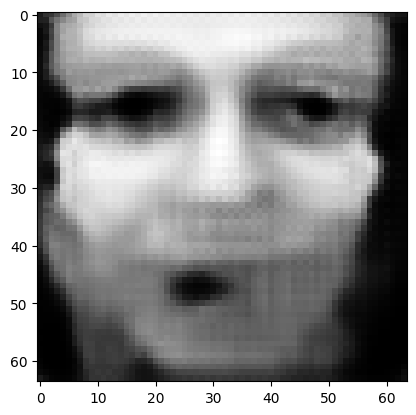

tensor([[9.6836e-01, 3.4171e-04, 1.3067e-05, 8.5495e-06, 8.6745e-05, 1.0231e-06,
         5.6403e-05, 1.0972e-04, 1.0897e-05, 4.3136e-04, 2.9554e-06, 4.1983e-03,
         6.0084e-03, 2.9074e-04, 2.5041e-06, 2.3754e-05, 9.7787e-04, 1.5059e-05,
         1.5403e-05, 4.2988e-07, 7.9520e-04, 3.0437e-04, 2.8785e-05, 2.4284e-04,
         2.0542e-03, 3.5799e-05, 3.9817e-05, 1.0712e-04, 6.4028e-04, 4.7889e-05,
         6.6014e-04, 2.6545e-05, 2.2426e-04, 6.2472e-05, 2.6159e-03, 1.5567e-05,
         4.1137e-03, 5.2954e-03, 5.4933e-04, 1.1851e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03215105086565018
tensor([[9.6839e-01, 3.4146e-04, 1.3052e-05, 8.5407e-06, 8.6668e-05, 1.0223e-06,
         5.6350e-05, 1.0966e-04, 1.0882e-05, 4.3102e-04, 2.9516e-06, 4.1954e-03,
         6.0033e-03, 2.9045e-04, 2.5006e-06, 2.3734e-05, 9.7704e-04, 1.5044e-05,
         1.5389e-05, 4.2934e-07, 7.9433e-04, 3.0407e-04, 2.8751e-05, 2.4262e-04,
         2.0522e-03, 3.5770e-05, 3.9775e-0

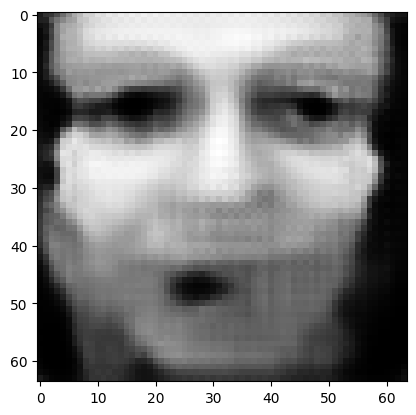

tensor([[9.6850e-01, 3.4048e-04, 1.2994e-05, 8.5070e-06, 8.6372e-05, 1.0194e-06,
         5.6140e-05, 1.0940e-04, 1.0826e-05, 4.2972e-04, 2.9367e-06, 4.1838e-03,
         5.9834e-03, 2.8930e-04, 2.4871e-06, 2.3654e-05, 9.7379e-04, 1.4985e-05,
         1.5332e-05, 4.2725e-07, 7.9092e-04, 3.0291e-04, 2.8620e-05, 2.4178e-04,
         2.0443e-03, 3.5659e-05, 3.9613e-05, 1.0655e-04, 6.3713e-04, 4.7616e-05,
         6.5679e-04, 2.6432e-05, 2.2317e-04, 6.2120e-05, 2.6044e-03, 1.5491e-05,
         4.0960e-03, 5.2716e-03, 5.4638e-04, 1.1799e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03200974315404892
tensor([[9.6852e-01, 3.4025e-04, 1.2979e-05, 8.4989e-06, 8.6298e-05, 1.0187e-06,
         5.6089e-05, 1.0933e-04, 1.0813e-05, 4.2940e-04, 2.9331e-06, 4.1810e-03,
         5.9786e-03, 2.8902e-04, 2.4838e-06, 2.3635e-05, 9.7301e-04, 1.4971e-05,
         1.5319e-05, 4.2674e-07, 7.9011e-04, 3.0263e-04, 2.8588e-05, 2.4158e-04,
         2.0424e-03, 3.5632e-05, 3.9574e-0

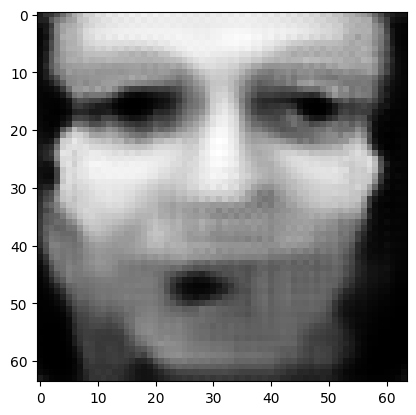

tensor([[9.6863e-01, 3.3932e-04, 1.2925e-05, 8.4671e-06, 8.6019e-05, 1.0159e-06,
         5.5892e-05, 1.0909e-04, 1.0760e-05, 4.2817e-04, 2.9191e-06, 4.1701e-03,
         5.9598e-03, 2.8793e-04, 2.4711e-06, 2.3560e-05, 9.6996e-04, 1.4916e-05,
         1.5265e-05, 4.2477e-07, 7.8690e-04, 3.0153e-04, 2.8465e-05, 2.4079e-04,
         2.0350e-03, 3.5526e-05, 3.9420e-05, 1.0602e-04, 6.3417e-04, 4.7358e-05,
         6.5362e-04, 2.6326e-05, 2.2214e-04, 6.1789e-05, 2.5934e-03, 1.5419e-05,
         4.0793e-03, 5.2492e-03, 5.4360e-04, 1.1750e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03187684714794159
tensor([[9.6865e-01, 3.3910e-04, 1.2911e-05, 8.4591e-06, 8.5949e-05, 1.0152e-06,
         5.5845e-05, 1.0903e-04, 1.0747e-05, 4.2787e-04, 2.9157e-06, 4.1675e-03,
         5.9553e-03, 2.8767e-04, 2.4680e-06, 2.3542e-05, 9.6922e-04, 1.4903e-05,
         1.5252e-05, 4.2428e-07, 7.8612e-04, 3.0126e-04, 2.8434e-05, 2.4059e-04,
         2.0332e-03, 3.5501e-05, 3.9384e-0

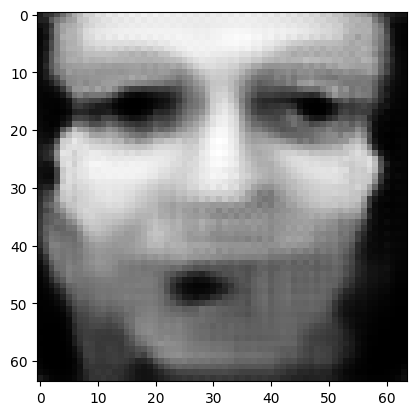

tensor([[9.6875e-01, 3.3824e-04, 1.2859e-05, 8.4293e-06, 8.5685e-05, 1.0126e-06,
         5.5659e-05, 1.0879e-04, 1.0698e-05, 4.2670e-04, 2.9025e-06, 4.1572e-03,
         5.9375e-03, 2.8665e-04, 2.4560e-06, 2.3472e-05, 9.6633e-04, 1.4851e-05,
         1.5203e-05, 4.2243e-07, 7.8310e-04, 3.0023e-04, 2.8318e-05, 2.3985e-04,
         2.0261e-03, 3.5401e-05, 3.9239e-05, 1.0552e-04, 6.3138e-04, 4.7116e-05,
         6.5064e-04, 2.6226e-05, 2.2116e-04, 6.1477e-05, 2.5831e-03, 1.5351e-05,
         4.0636e-03, 5.2281e-03, 5.4098e-04, 1.1704e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03175143897533417
tensor([[9.6877e-01, 3.3802e-04, 1.2847e-05, 8.4220e-06, 8.5619e-05, 1.0120e-06,
         5.5614e-05, 1.0874e-04, 1.0686e-05, 4.2641e-04, 2.8993e-06, 4.1547e-03,
         5.9333e-03, 2.8640e-04, 2.4531e-06, 2.3455e-05, 9.6565e-04, 1.4838e-05,
         1.5190e-05, 4.2198e-07, 7.8237e-04, 2.9998e-04, 2.8290e-05, 2.3967e-04,
         2.0245e-03, 3.5377e-05, 3.9205e-0

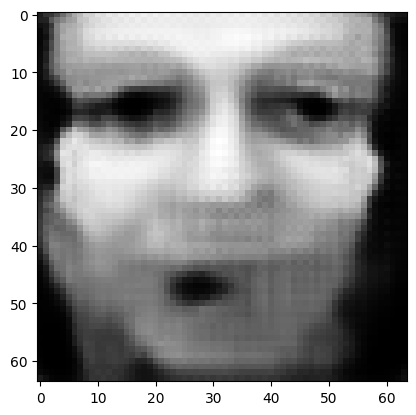

tensor([[9.6886e-01, 3.3721e-04, 1.2798e-05, 8.3939e-06, 8.5371e-05, 1.0095e-06,
         5.5438e-05, 1.0852e-04, 1.0639e-05, 4.2532e-04, 2.8869e-06, 4.1451e-03,
         5.9165e-03, 2.8544e-04, 2.4419e-06, 2.3388e-05, 9.6292e-04, 1.4789e-05,
         1.5143e-05, 4.2024e-07, 7.7953e-04, 2.9901e-04, 2.8180e-05, 2.3897e-04,
         2.0178e-03, 3.5283e-05, 3.9069e-05, 1.0504e-04, 6.2875e-04, 4.6887e-05,
         6.4783e-04, 2.6131e-05, 2.2025e-04, 6.1183e-05, 2.5734e-03, 1.5287e-05,
         4.0487e-03, 5.2082e-03, 5.3852e-04, 1.1661e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03163283318281174
tensor([[9.6888e-01, 3.3700e-04, 1.2786e-05, 8.3868e-06, 8.5310e-05, 1.0089e-06,
         5.5396e-05, 1.0846e-04, 1.0628e-05, 4.2506e-04, 2.8839e-06, 4.1427e-03,
         5.9126e-03, 2.8520e-04, 2.4391e-06, 2.3373e-05, 9.6227e-04, 1.4777e-05,
         1.5131e-05, 4.1981e-07, 7.7883e-04, 2.9877e-04, 2.8154e-05, 2.3879e-04,
         2.0163e-03, 3.5260e-05, 3.9036e-0

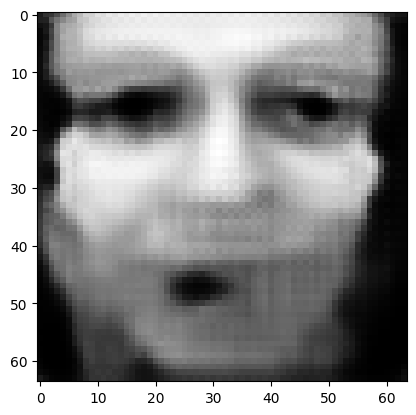

tensor([[9.6897e-01, 3.3623e-04, 1.2740e-05, 8.3603e-06, 8.5073e-05, 1.0066e-06,
         5.5230e-05, 1.0825e-04, 1.0584e-05, 4.2401e-04, 2.8722e-06, 4.1335e-03,
         5.8967e-03, 2.8429e-04, 2.4285e-06, 2.3310e-05, 9.5970e-04, 1.4731e-05,
         1.5087e-05, 4.1816e-07, 7.7615e-04, 2.9785e-04, 2.8050e-05, 2.3813e-04,
         2.0100e-03, 3.5172e-05, 3.8908e-05, 1.0460e-04, 6.2627e-04, 4.6671e-05,
         6.4517e-04, 2.6042e-05, 2.1938e-04, 6.0905e-05, 2.5642e-03, 1.5227e-05,
         4.0347e-03, 5.1894e-03, 5.3619e-04, 1.1620e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031521137803792953
tensor([[9.6899e-01, 3.3604e-04, 1.2729e-05, 8.3540e-06, 8.5018e-05, 1.0060e-06,
         5.5190e-05, 1.0820e-04, 1.0573e-05, 4.2377e-04, 2.8694e-06, 4.1313e-03,
         5.8929e-03, 2.8407e-04, 2.4260e-06, 2.3294e-05, 9.5907e-04, 1.4720e-05,
         1.5076e-05, 4.1777e-07, 7.7550e-04, 2.9763e-04, 2.8026e-05, 2.3797e-04,
         2.0085e-03, 3.5151e-05, 3.8876e-

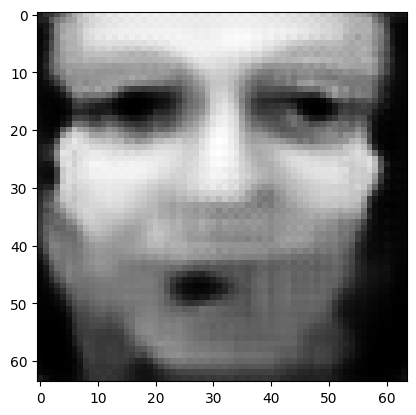

tensor([[9.6907e-01, 3.3531e-04, 1.2686e-05, 8.3286e-06, 8.4793e-05, 1.0038e-06,
         5.5034e-05, 1.0801e-04, 1.0532e-05, 4.2278e-04, 2.8584e-06, 4.1226e-03,
         5.8780e-03, 2.8321e-04, 2.4159e-06, 2.3235e-05, 9.5665e-04, 1.4676e-05,
         1.5034e-05, 4.1621e-07, 7.7296e-04, 2.9675e-04, 2.7928e-05, 2.3734e-04,
         2.0026e-03, 3.5067e-05, 3.8755e-05, 1.0418e-04, 6.2392e-04, 4.6467e-05,
         6.4266e-04, 2.5957e-05, 2.1856e-04, 6.0643e-05, 2.5556e-03, 1.5170e-05,
         4.0214e-03, 5.1717e-03, 5.3399e-04, 1.1581e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031415555626153946
tensor([[9.6909e-01, 3.3513e-04, 1.2675e-05, 8.3227e-06, 8.4741e-05, 1.0033e-06,
         5.4996e-05, 1.0796e-04, 1.0522e-05, 4.2255e-04, 2.8557e-06, 4.1205e-03,
         5.8743e-03, 2.8300e-04, 2.4135e-06, 2.3221e-05, 9.5605e-04, 1.4666e-05,
         1.5024e-05, 4.1584e-07, 7.7235e-04, 2.9655e-04, 2.7905e-05, 2.3719e-04,
         2.0012e-03, 3.5047e-05, 3.8726e-

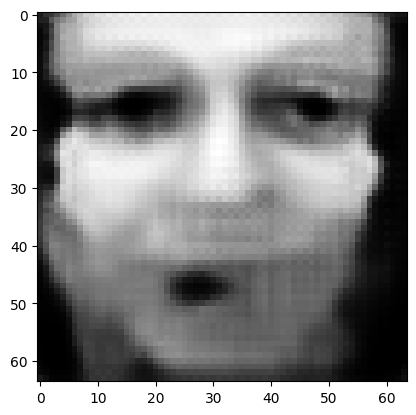

tensor([[9.6917e-01, 3.3444e-04, 1.2634e-05, 8.2988e-06, 8.4529e-05, 1.0012e-06,
         5.4849e-05, 1.0777e-04, 1.0483e-05, 4.2162e-04, 2.8453e-06, 4.1123e-03,
         5.8603e-03, 2.8219e-04, 2.4040e-06, 2.3165e-05, 9.5378e-04, 1.4625e-05,
         1.4984e-05, 4.1437e-07, 7.6996e-04, 2.9572e-04, 2.7812e-05, 2.3660e-04,
         1.9956e-03, 3.4967e-05, 3.8612e-05, 1.0378e-04, 6.2171e-04, 4.6275e-05,
         6.4030e-04, 2.5878e-05, 2.1779e-04, 6.0396e-05, 2.5474e-03, 1.5117e-05,
         4.0090e-03, 5.1549e-03, 5.3192e-04, 1.1544e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03131597116589546
tensor([[9.6919e-01, 3.3428e-04, 1.2624e-05, 8.2932e-06, 8.4479e-05, 1.0007e-06,
         5.4813e-05, 1.0773e-04, 1.0473e-05, 4.2140e-04, 2.8428e-06, 4.1103e-03,
         5.8568e-03, 2.8199e-04, 2.4018e-06, 2.3151e-05, 9.5321e-04, 1.4615e-05,
         1.4974e-05, 4.1402e-07, 7.6938e-04, 2.9553e-04, 2.7790e-05, 2.3645e-04,
         1.9942e-03, 3.4948e-05, 3.8584e-0

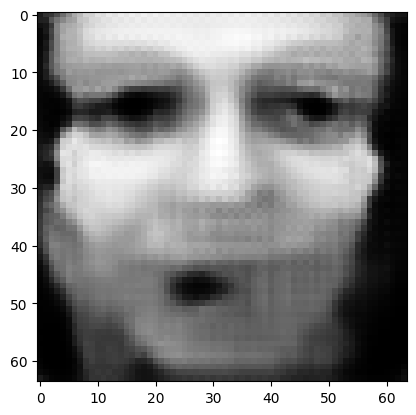

tensor([[9.6926e-01, 3.3362e-04, 1.2586e-05, 8.2705e-06, 8.4279e-05, 9.9872e-07,
         5.4673e-05, 1.0755e-04, 1.0436e-05, 4.2051e-04, 2.8330e-06, 4.1026e-03,
         5.8435e-03, 2.8123e-04, 2.3928e-06, 2.3098e-05, 9.5105e-04, 1.4576e-05,
         1.4937e-05, 4.1263e-07, 7.6711e-04, 2.9475e-04, 2.7703e-05, 2.3589e-04,
         1.9890e-03, 3.4873e-05, 3.8476e-05, 1.0340e-04, 6.1961e-04, 4.6094e-05,
         6.3806e-04, 2.5802e-05, 2.1706e-04, 6.0162e-05, 2.5396e-03, 1.5066e-05,
         3.9971e-03, 5.1391e-03, 5.2996e-04, 1.1510e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031221691519021988
tensor([[9.6928e-01, 3.3346e-04, 1.2576e-05, 8.2654e-06, 8.4231e-05, 9.9825e-07,
         5.4640e-05, 1.0751e-04, 1.0427e-05, 4.2030e-04, 2.8306e-06, 4.1007e-03,
         5.8403e-03, 2.8104e-04, 2.3907e-06, 2.3086e-05, 9.5053e-04, 1.4566e-05,
         1.4928e-05, 4.1230e-07, 7.6657e-04, 2.9457e-04, 2.7682e-05, 2.3576e-04,
         1.9877e-03, 3.4855e-05, 3.8450e-

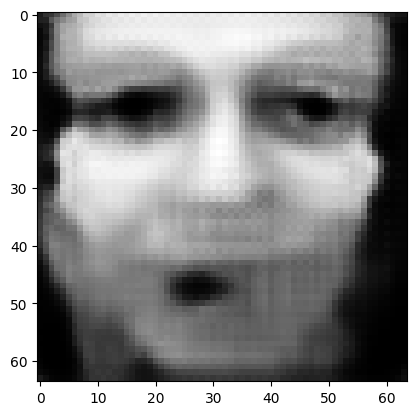

tensor([[9.6935e-01, 3.3284e-04, 1.2540e-05, 8.2441e-06, 8.4043e-05, 9.9638e-07,
         5.4508e-05, 1.0734e-04, 1.0392e-05, 4.1947e-04, 2.8213e-06, 4.0934e-03,
         5.8277e-03, 2.8032e-04, 2.3823e-06, 2.3035e-05, 9.4848e-04, 1.4529e-05,
         1.4892e-05, 4.1099e-07, 7.6444e-04, 2.9383e-04, 2.7600e-05, 2.3522e-04,
         1.9827e-03, 3.4785e-05, 3.8348e-05, 1.0305e-04, 6.1763e-04, 4.5922e-05,
         6.3595e-04, 2.5732e-05, 2.1637e-04, 5.9942e-05, 2.5323e-03, 1.5018e-05,
         3.9860e-03, 5.1241e-03, 5.2811e-04, 1.1477e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031132487580180168
tensor([[9.6936e-01, 3.3269e-04, 1.2531e-05, 8.2388e-06, 8.3996e-05, 9.9593e-07,
         5.4476e-05, 1.0730e-04, 1.0384e-05, 4.1927e-04, 2.8190e-06, 4.0916e-03,
         5.8246e-03, 2.8014e-04, 2.3802e-06, 2.3023e-05, 9.4799e-04, 1.4520e-05,
         1.4883e-05, 4.1066e-07, 7.6391e-04, 2.9365e-04, 2.7580e-05, 2.3509e-04,
         1.9815e-03, 3.4767e-05, 3.8323e-

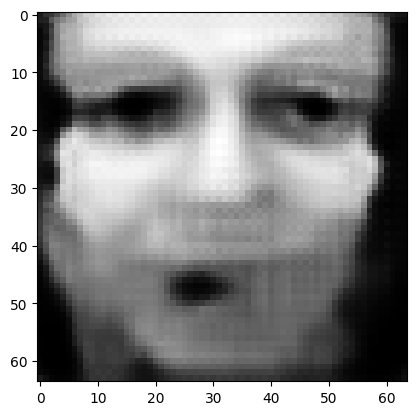

tensor([[9.6943e-01, 3.3211e-04, 1.2496e-05, 8.2191e-06, 8.3818e-05, 9.9417e-07,
         5.4352e-05, 1.0714e-04, 1.0351e-05, 4.1848e-04, 2.8103e-06, 4.0847e-03,
         5.8127e-03, 2.7946e-04, 2.3723e-06, 2.2976e-05, 9.4605e-04, 1.4486e-05,
         1.4850e-05, 4.0944e-07, 7.6190e-04, 2.9296e-04, 2.7503e-05, 2.3459e-04,
         1.9768e-03, 3.4701e-05, 3.8227e-05, 1.0272e-04, 6.1576e-04, 4.5760e-05,
         6.3395e-04, 2.5664e-05, 2.1572e-04, 5.9734e-05, 2.5254e-03, 1.4972e-05,
         3.9754e-03, 5.1100e-03, 5.2637e-04, 1.1446e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031048359349370003
tensor([[9.6944e-01, 3.3196e-04, 1.2488e-05, 8.2140e-06, 8.3775e-05, 9.9374e-07,
         5.4322e-05, 1.0711e-04, 1.0343e-05, 4.1829e-04, 2.8081e-06, 4.0830e-03,
         5.8098e-03, 2.7929e-04, 2.3703e-06, 2.2964e-05, 9.4558e-04, 1.4477e-05,
         1.4841e-05, 4.0913e-07, 7.6140e-04, 2.9279e-04, 2.7484e-05, 2.3447e-04,
         1.9757e-03, 3.4684e-05, 3.8203e-

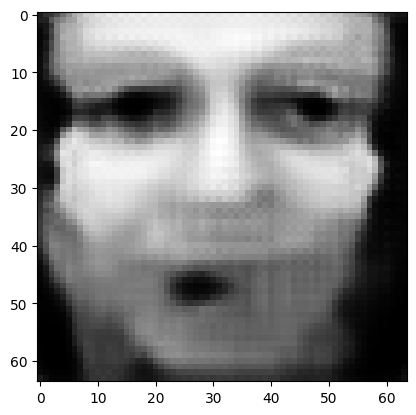

tensor([[9.6951e-01, 3.3141e-04, 1.2456e-05, 8.1953e-06, 8.3608e-05, 9.9208e-07,
         5.4204e-05, 1.0696e-04, 1.0312e-05, 4.1755e-04, 2.7999e-06, 4.0764e-03,
         5.7986e-03, 2.7864e-04, 2.3628e-06, 2.2920e-05, 9.4375e-04, 1.4444e-05,
         1.4810e-05, 4.0797e-07, 7.5950e-04, 2.9214e-04, 2.7411e-05, 2.3400e-04,
         1.9712e-03, 3.4622e-05, 3.8112e-05, 1.0240e-04, 6.1399e-04, 4.5607e-05,
         6.3207e-04, 2.5600e-05, 2.1511e-04, 5.9537e-05, 2.5188e-03, 1.4929e-05,
         3.9654e-03, 5.0966e-03, 5.2471e-04, 1.1416e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03096884675323963
tensor([[9.6952e-01, 3.3127e-04, 1.2448e-05, 8.1905e-06, 8.3567e-05, 9.9168e-07,
         5.4176e-05, 1.0692e-04, 1.0304e-05, 4.1737e-04, 2.7979e-06, 4.0748e-03,
         5.7958e-03, 2.7849e-04, 2.3610e-06, 2.2909e-05, 9.4331e-04, 1.4436e-05,
         1.4802e-05, 4.0768e-07, 7.5903e-04, 2.9198e-04, 2.7393e-05, 2.3388e-04,
         1.9702e-03, 3.4606e-05, 3.8090e-0

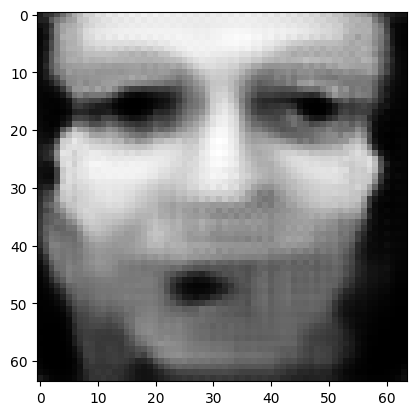

tensor([[9.6958e-01, 3.3075e-04, 1.2417e-05, 8.1728e-06, 8.3408e-05, 9.9010e-07,
         5.4064e-05, 1.0678e-04, 1.0275e-05, 4.1666e-04, 2.7900e-06, 4.0686e-03,
         5.7851e-03, 2.7787e-04, 2.3539e-06, 2.2866e-05, 9.4158e-04, 1.4405e-05,
         1.4772e-05, 4.0658e-07, 7.5724e-04, 2.9136e-04, 2.7324e-05, 2.3343e-04,
         1.9659e-03, 3.4547e-05, 3.8004e-05, 1.0210e-04, 6.1231e-04, 4.5462e-05,
         6.3028e-04, 2.5540e-05, 2.1452e-04, 5.9351e-05, 2.5126e-03, 1.4889e-05,
         3.9559e-03, 5.0839e-03, 5.2315e-04, 1.1389e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030893489718437195
tensor([[9.6959e-01, 3.3062e-04, 1.2409e-05, 8.1683e-06, 8.3369e-05, 9.8972e-07,
         5.4037e-05, 1.0674e-04, 1.0268e-05, 4.1650e-04, 2.7881e-06, 4.0671e-03,
         5.7826e-03, 2.7772e-04, 2.3522e-06, 2.2856e-05, 9.4116e-04, 1.4398e-05,
         1.4764e-05, 4.0631e-07, 7.5679e-04, 2.9121e-04, 2.7307e-05, 2.3332e-04,
         1.9649e-03, 3.4532e-05, 3.7983e-

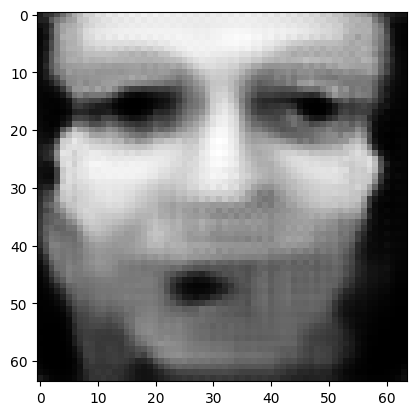

tensor([[9.6965e-01, 3.3013e-04, 1.2380e-05, 8.1515e-06, 8.3220e-05, 9.8823e-07,
         5.3932e-05, 1.0661e-04, 1.0240e-05, 4.1583e-04, 2.7807e-06, 4.0612e-03,
         5.7725e-03, 2.7715e-04, 2.3455e-06, 2.2816e-05, 9.3952e-04, 1.4368e-05,
         1.4736e-05, 4.0527e-07, 7.5509e-04, 2.9063e-04, 2.7241e-05, 2.3290e-04,
         1.9610e-03, 3.4476e-05, 3.7901e-05, 1.0182e-04, 6.1073e-04, 4.5325e-05,
         6.2860e-04, 2.5483e-05, 2.1397e-04, 5.9175e-05, 2.5068e-03, 1.4850e-05,
         3.9470e-03, 5.0719e-03, 5.2167e-04, 1.1363e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03082217276096344
tensor([[9.6966e-01, 3.3000e-04, 1.2373e-05, 8.1472e-06, 8.3182e-05, 9.8786e-07,
         5.3907e-05, 1.0658e-04, 1.0234e-05, 4.1567e-04, 2.7789e-06, 4.0598e-03,
         5.7700e-03, 2.7701e-04, 2.3438e-06, 2.2806e-05, 9.3912e-04, 1.4361e-05,
         1.4729e-05, 4.0501e-07, 7.5467e-04, 2.9048e-04, 2.7225e-05, 2.3280e-04,
         1.9600e-03, 3.4461e-05, 3.7882e-0

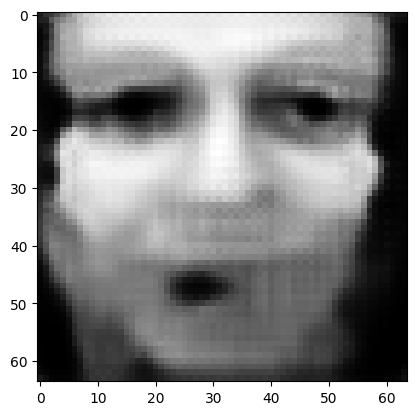

tensor([[9.6971e-01, 3.2954e-04, 1.2346e-05, 8.1315e-06, 8.3040e-05, 9.8646e-07,
         5.3807e-05, 1.0645e-04, 1.0207e-05, 4.1504e-04, 2.7720e-06, 4.0543e-03,
         5.7605e-03, 2.7646e-04, 2.3375e-06, 2.2768e-05, 9.3757e-04, 1.4333e-05,
         1.4702e-05, 4.0404e-07, 7.5307e-04, 2.8993e-04, 2.7164e-05, 2.3239e-04,
         1.9562e-03, 3.4409e-05, 3.7805e-05, 1.0155e-04, 6.0924e-04, 4.5196e-05,
         6.2700e-04, 2.5429e-05, 2.1345e-04, 5.9009e-05, 2.5012e-03, 1.4814e-05,
         3.9385e-03, 5.0606e-03, 5.2027e-04, 1.1338e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030754897743463516
tensor([[9.6973e-01, 3.2942e-04, 1.2339e-05, 8.1274e-06, 8.3005e-05, 9.8611e-07,
         5.3783e-05, 1.0642e-04, 1.0201e-05, 4.1488e-04, 2.7703e-06, 4.0529e-03,
         5.7582e-03, 2.7633e-04, 2.3359e-06, 2.2759e-05, 9.3720e-04, 1.4326e-05,
         1.4696e-05, 4.0379e-07, 7.5267e-04, 2.8979e-04, 2.7148e-05, 2.3230e-04,
         1.9553e-03, 3.4395e-05, 3.7786e-

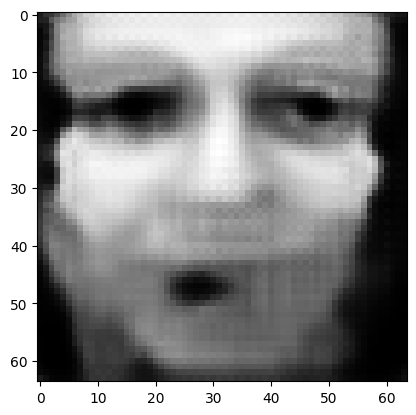

tensor([[9.6978e-01, 3.2898e-04, 1.2313e-05, 8.1123e-06, 8.2870e-05, 9.8478e-07,
         5.3689e-05, 1.0630e-04, 1.0176e-05, 4.1429e-04, 2.7637e-06, 4.0477e-03,
         5.7492e-03, 2.7581e-04, 2.3300e-06, 2.2723e-05, 9.3574e-04, 1.4300e-05,
         1.4670e-05, 4.0286e-07, 7.5115e-04, 2.8927e-04, 2.7090e-05, 2.3192e-04,
         1.9518e-03, 3.4345e-05, 3.7713e-05, 1.0129e-04, 6.0782e-04, 4.5073e-05,
         6.2550e-04, 2.5378e-05, 2.1296e-04, 5.8851e-05, 2.4960e-03, 1.4780e-05,
         3.9305e-03, 5.0499e-03, 5.1895e-04, 1.1314e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030691200867295265
tensor([[9.6979e-01, 3.2887e-04, 1.2307e-05, 8.1088e-06, 8.2838e-05, 9.8446e-07,
         5.3666e-05, 1.0627e-04, 1.0170e-05, 4.1414e-04, 2.7621e-06, 4.0464e-03,
         5.7470e-03, 2.7569e-04, 2.3285e-06, 2.2714e-05, 9.3538e-04, 1.4294e-05,
         1.4664e-05, 4.0264e-07, 7.5079e-04, 2.8914e-04, 2.7076e-05, 2.3182e-04,
         1.9509e-03, 3.4333e-05, 3.7696e-

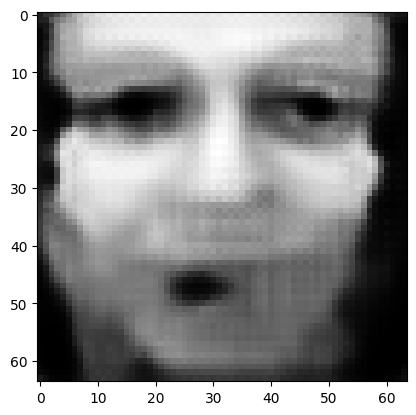

tensor([[9.6983e-01, 3.2845e-04, 1.2282e-05, 8.0943e-06, 8.2709e-05, 9.8319e-07,
         5.3578e-05, 1.0616e-04, 1.0147e-05, 4.1358e-04, 2.7558e-06, 4.0414e-03,
         5.7385e-03, 2.7520e-04, 2.3229e-06, 2.2681e-05, 9.3400e-04, 1.4269e-05,
         1.4640e-05, 4.0176e-07, 7.4934e-04, 2.8865e-04, 2.7020e-05, 2.3146e-04,
         1.9475e-03, 3.4285e-05, 3.7627e-05, 1.0106e-04, 6.0648e-04, 4.4957e-05,
         6.2407e-04, 2.5330e-05, 2.1249e-04, 5.8702e-05, 2.4910e-03, 1.4747e-05,
         3.9230e-03, 5.0398e-03, 5.1770e-04, 1.1292e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030630966648459435
tensor([[9.6984e-01, 3.2835e-04, 1.2276e-05, 8.0910e-06, 8.2680e-05, 9.8289e-07,
         5.3556e-05, 1.0613e-04, 1.0141e-05, 4.1344e-04, 2.7543e-06, 4.0402e-03,
         5.7364e-03, 2.7508e-04, 2.3215e-06, 2.2672e-05, 9.3366e-04, 1.4263e-05,
         1.4634e-05, 4.0155e-07, 7.4900e-04, 2.8853e-04, 2.7007e-05, 2.3138e-04,
         1.9467e-03, 3.4273e-05, 3.7610e-

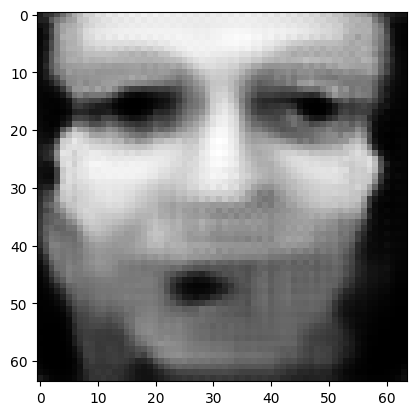

tensor([[9.6989e-01, 3.2795e-04, 1.2253e-05, 8.0774e-06, 8.2557e-05, 9.8169e-07,
         5.3472e-05, 1.0602e-04, 1.0119e-05, 4.1290e-04, 2.7484e-06, 4.0355e-03,
         5.7284e-03, 2.7462e-04, 2.3161e-06, 2.2640e-05, 9.3236e-04, 1.4239e-05,
         1.4611e-05, 4.0071e-07, 7.4763e-04, 2.8806e-04, 2.6955e-05, 2.3104e-04,
         1.9435e-03, 3.4228e-05, 3.7545e-05, 1.0083e-04, 6.0522e-04, 4.4848e-05,
         6.2272e-04, 2.5284e-05, 2.1205e-04, 5.8562e-05, 2.4863e-03, 1.4716e-05,
         3.9158e-03, 5.0302e-03, 5.1652e-04, 1.1271e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030573852360248566
tensor([[9.6990e-01, 3.2785e-04, 1.2248e-05, 8.0742e-06, 8.2529e-05, 9.8141e-07,
         5.3451e-05, 1.0600e-04, 1.0114e-05, 4.1278e-04, 2.7470e-06, 4.0343e-03,
         5.7264e-03, 2.7451e-04, 2.3149e-06, 2.2632e-05, 9.3203e-04, 1.4234e-05,
         1.4606e-05, 4.0051e-07, 7.4730e-04, 2.8795e-04, 2.6942e-05, 2.3095e-04,
         1.9427e-03, 3.4217e-05, 3.7529e-

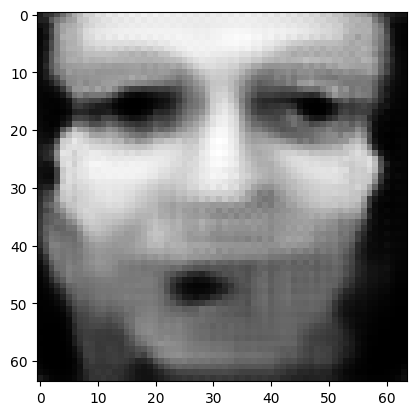

tensor([[9.6994e-01, 3.2747e-04, 1.2226e-05, 8.0613e-06, 8.2415e-05, 9.8028e-07,
         5.3371e-05, 1.0589e-04, 1.0093e-05, 4.1227e-04, 2.7414e-06, 4.0299e-03,
         5.7187e-03, 2.7407e-04, 2.3098e-06, 2.2602e-05, 9.3079e-04, 1.4211e-05,
         1.4584e-05, 3.9972e-07, 7.4602e-04, 2.8750e-04, 2.6893e-05, 2.3063e-04,
         1.9397e-03, 3.4174e-05, 3.7467e-05, 1.0061e-04, 6.0402e-04, 4.4744e-05,
         6.2144e-04, 2.5241e-05, 2.1164e-04, 5.8429e-05, 2.4818e-03, 1.4687e-05,
         3.9090e-03, 5.0211e-03, 5.1540e-04, 1.1251e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030519740656018257
tensor([[9.6995e-01, 3.2738e-04, 1.2220e-05, 8.0582e-06, 8.2386e-05, 9.8000e-07,
         5.3352e-05, 1.0587e-04, 1.0088e-05, 4.1215e-04, 2.7400e-06, 4.0288e-03,
         5.7169e-03, 2.7396e-04, 2.3085e-06, 2.2594e-05, 9.3049e-04, 1.4206e-05,
         1.4579e-05, 3.9953e-07, 7.4570e-04, 2.8739e-04, 2.6881e-05, 2.3055e-04,
         1.9390e-03, 3.4163e-05, 3.7452e-

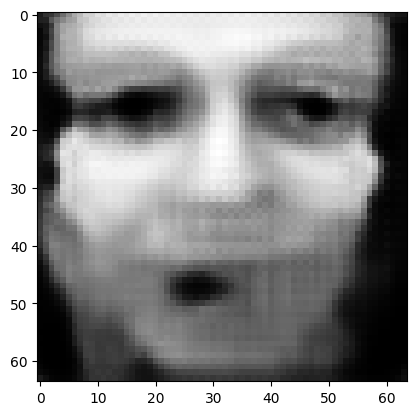

tensor([[9.6999e-01, 3.2702e-04, 1.2199e-05, 8.0461e-06, 8.2278e-05, 9.7893e-07,
         5.3276e-05, 1.0577e-04, 1.0068e-05, 4.1167e-04, 2.7347e-06, 4.0245e-03,
         5.7097e-03, 2.7355e-04, 2.3038e-06, 2.2566e-05, 9.2931e-04, 1.4185e-05,
         1.4558e-05, 3.9879e-07, 7.4448e-04, 2.8697e-04, 2.6834e-05, 2.3025e-04,
         1.9361e-03, 3.4123e-05, 3.7394e-05, 1.0041e-04, 6.0288e-04, 4.4646e-05,
         6.2023e-04, 2.5200e-05, 2.1124e-04, 5.8303e-05, 2.4776e-03, 1.4660e-05,
         3.9026e-03, 5.0125e-03, 5.1434e-04, 1.1232e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03046874888241291
tensor([[9.7000e-01, 3.2693e-04, 1.2194e-05, 8.0431e-06, 8.2251e-05, 9.7867e-07,
         5.3258e-05, 1.0575e-04, 1.0063e-05, 4.1155e-04, 2.7334e-06, 4.0235e-03,
         5.7079e-03, 2.7345e-04, 2.3026e-06, 2.2559e-05, 9.2903e-04, 1.4180e-05,
         1.4553e-05, 3.9860e-07, 7.4418e-04, 2.8687e-04, 2.6822e-05, 2.3017e-04,
         1.9354e-03, 3.4113e-05, 3.7380e-0

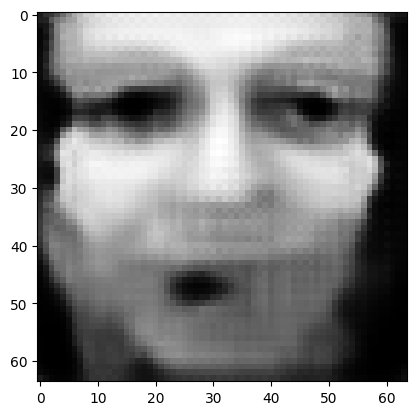

tensor([[9.7004e-01, 3.2660e-04, 1.2175e-05, 8.0317e-06, 8.2148e-05, 9.7765e-07,
         5.3186e-05, 1.0566e-04, 1.0044e-05, 4.1109e-04, 2.7284e-06, 4.0195e-03,
         5.7010e-03, 2.7305e-04, 2.2981e-06, 2.2531e-05, 9.2791e-04, 1.4160e-05,
         1.4534e-05, 3.9790e-07, 7.4302e-04, 2.8647e-04, 2.6778e-05, 2.2988e-04,
         1.9327e-03, 3.4074e-05, 3.7325e-05, 1.0022e-04, 6.0181e-04, 4.4553e-05,
         6.1908e-04, 2.5161e-05, 2.1087e-04, 5.8183e-05, 2.4736e-03, 1.4633e-05,
         3.8965e-03, 5.0044e-03, 5.1334e-04, 1.1214e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030419951304793358
tensor([[9.7005e-01, 3.2651e-04, 1.2170e-05, 8.0288e-06, 8.2124e-05, 9.7741e-07,
         5.3169e-05, 1.0564e-04, 1.0040e-05, 4.1099e-04, 2.7272e-06, 4.0185e-03,
         5.6994e-03, 2.7296e-04, 2.2969e-06, 2.2525e-05, 9.2764e-04, 1.4155e-05,
         1.4529e-05, 3.9772e-07, 7.4274e-04, 2.8637e-04, 2.6767e-05, 2.2981e-04,
         1.9321e-03, 3.4065e-05, 3.7311e-

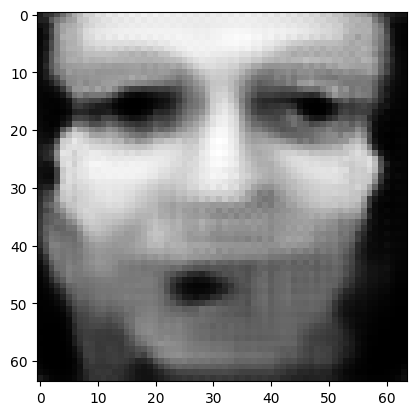

tensor([[9.7008e-01, 3.2619e-04, 1.2151e-05, 8.0179e-06, 8.2026e-05, 9.7644e-07,
         5.3101e-05, 1.0555e-04, 1.0022e-05, 4.1055e-04, 2.7225e-06, 4.0147e-03,
         5.6928e-03, 2.7259e-04, 2.2926e-06, 2.2499e-05, 9.2658e-04, 1.4136e-05,
         1.4511e-05, 3.9706e-07, 7.4164e-04, 2.8600e-04, 2.6725e-05, 2.2953e-04,
         1.9295e-03, 3.4028e-05, 3.7258e-05, 1.0004e-04, 6.0078e-04, 4.4465e-05,
         6.1799e-04, 2.5124e-05, 2.1051e-04, 5.8070e-05, 2.4698e-03, 1.4609e-05,
         3.8907e-03, 4.9966e-03, 5.1238e-04, 1.1197e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03037380985915661
tensor([[9.7009e-01, 3.2611e-04, 1.2147e-05, 8.0153e-06, 8.2002e-05, 9.7621e-07,
         5.3085e-05, 1.0553e-04, 1.0018e-05, 4.1045e-04, 2.7213e-06, 4.0138e-03,
         5.6913e-03, 2.7250e-04, 2.2916e-06, 2.2492e-05, 9.2633e-04, 1.4131e-05,
         1.4506e-05, 3.9689e-07, 7.4137e-04, 2.8590e-04, 2.6715e-05, 2.2947e-04,
         1.9289e-03, 3.4020e-05, 3.7246e-0

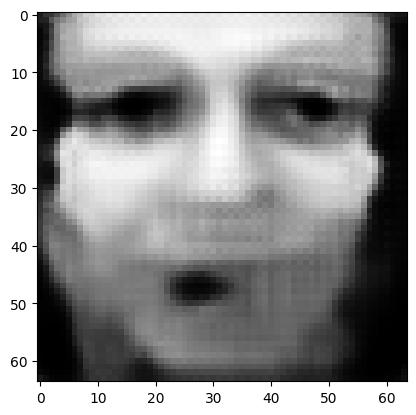

tensor([[9.7013e-01, 3.2580e-04, 1.2129e-05, 8.0050e-06, 8.1910e-05, 9.7530e-07,
         5.3020e-05, 1.0545e-04, 1.0001e-05, 4.1004e-04, 2.7168e-06, 4.0102e-03,
         5.6851e-03, 2.7214e-04, 2.2875e-06, 2.2468e-05, 9.2532e-04, 1.4113e-05,
         1.4489e-05, 3.9626e-07, 7.4033e-04, 2.8554e-04, 2.6675e-05, 2.2921e-04,
         1.9264e-03, 3.3985e-05, 3.7196e-05, 9.9863e-05, 5.9982e-04, 4.4381e-05,
         6.1696e-04, 2.5089e-05, 2.1017e-04, 5.7962e-05, 2.4662e-03, 1.4585e-05,
         3.8853e-03, 4.9893e-03, 5.1148e-04, 1.1181e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03033032827079296
tensor([[9.7013e-01, 3.2573e-04, 1.2125e-05, 8.0025e-06, 8.1888e-05, 9.7507e-07,
         5.3004e-05, 1.0543e-04, 9.9966e-06, 4.0994e-04, 2.7157e-06, 4.0093e-03,
         5.6836e-03, 2.7206e-04, 2.2865e-06, 2.2462e-05, 9.2508e-04, 1.4109e-05,
         1.4485e-05, 3.9611e-07, 7.4008e-04, 2.8546e-04, 2.6665e-05, 2.2914e-04,
         1.9258e-03, 3.3976e-05, 3.7184e-0

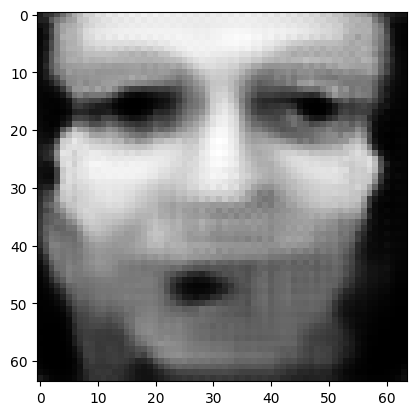

tensor([[9.7017e-01, 3.2544e-04, 1.2108e-05, 7.9926e-06, 8.1799e-05, 9.7421e-07,
         5.2943e-05, 1.0535e-04, 9.9806e-06, 4.0955e-04, 2.7115e-06, 4.0059e-03,
         5.6778e-03, 2.7172e-04, 2.2827e-06, 2.2438e-05, 9.2412e-04, 1.4092e-05,
         1.4468e-05, 3.9550e-07, 7.3909e-04, 2.8512e-04, 2.6628e-05, 2.2890e-04,
         1.9235e-03, 3.3943e-05, 3.7137e-05, 9.9699e-05, 5.9890e-04, 4.4302e-05,
         6.1598e-04, 2.5056e-05, 2.0985e-04, 5.7860e-05, 2.4628e-03, 1.4563e-05,
         3.8801e-03, 4.9823e-03, 5.1062e-04, 1.1165e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030289040878415108
tensor([[9.7017e-01, 3.2537e-04, 1.2104e-05, 7.9903e-06, 8.1778e-05, 9.7399e-07,
         5.2928e-05, 1.0533e-04, 9.9767e-06, 4.0946e-04, 2.7104e-06, 4.0050e-03,
         5.6763e-03, 2.7164e-04, 2.2817e-06, 2.2433e-05, 9.2389e-04, 1.4088e-05,
         1.4464e-05, 3.9536e-07, 7.3886e-04, 2.8504e-04, 2.6618e-05, 2.2884e-04,
         1.9229e-03, 3.3935e-05, 3.7125e-

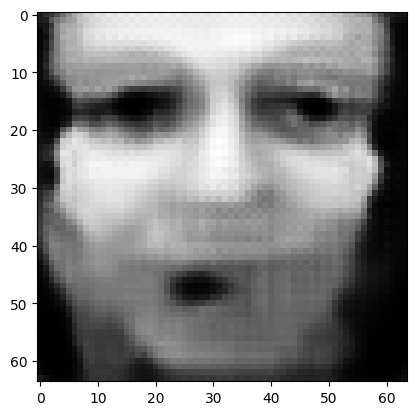

tensor([[9.7020e-01, 3.2510e-04, 1.2088e-05, 7.9810e-06, 8.1695e-05, 9.7317e-07,
         5.2870e-05, 1.0525e-04, 9.9616e-06, 4.0909e-04, 2.7064e-06, 4.0018e-03,
         5.6708e-03, 2.7132e-04, 2.2781e-06, 2.2411e-05, 9.2299e-04, 1.4072e-05,
         1.4449e-05, 3.9479e-07, 7.3792e-04, 2.8471e-04, 2.6582e-05, 2.2860e-04,
         1.9207e-03, 3.3904e-05, 3.7081e-05, 9.9543e-05, 5.9803e-04, 4.4227e-05,
         6.1505e-04, 2.5025e-05, 2.0955e-04, 5.7764e-05, 2.4595e-03, 1.4542e-05,
         3.8751e-03, 4.9757e-03, 5.0981e-04, 1.1151e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03024960309267044
tensor([[9.7021e-01, 3.2503e-04, 1.2084e-05, 7.9788e-06, 8.1675e-05, 9.7297e-07,
         5.2856e-05, 1.0524e-04, 9.9579e-06, 4.0900e-04, 2.7054e-06, 4.0010e-03,
         5.6694e-03, 2.7124e-04, 2.2772e-06, 2.2405e-05, 9.2277e-04, 1.4068e-05,
         1.4445e-05, 3.9465e-07, 7.3769e-04, 2.8463e-04, 2.6574e-05, 2.2854e-04,
         1.9202e-03, 3.3897e-05, 3.7070e-0

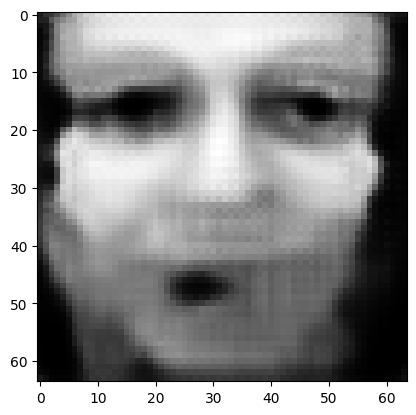

tensor([[9.7024e-01, 3.2477e-04, 1.2069e-05, 7.9700e-06, 8.1596e-05, 9.7219e-07,
         5.2801e-05, 1.0517e-04, 9.9435e-06, 4.0865e-04, 2.7016e-06, 3.9979e-03,
         5.6641e-03, 2.7094e-04, 2.2737e-06, 2.2384e-05, 9.2191e-04, 1.4052e-05,
         1.4430e-05, 3.9411e-07, 7.3681e-04, 2.8433e-04, 2.6540e-05, 2.2832e-04,
         1.9181e-03, 3.3867e-05, 3.7027e-05, 9.9396e-05, 5.9720e-04, 4.4155e-05,
         6.1417e-04, 2.4995e-05, 2.0926e-04, 5.7672e-05, 2.4565e-03, 1.4522e-05,
         3.8705e-03, 4.9695e-03, 5.0904e-04, 1.1137e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03021247498691082
tensor([[9.7025e-01, 3.2471e-04, 1.2065e-05, 7.9679e-06, 8.1577e-05, 9.7200e-07,
         5.2788e-05, 1.0515e-04, 9.9400e-06, 4.0857e-04, 2.7006e-06, 3.9971e-03,
         5.6628e-03, 2.7087e-04, 2.2729e-06, 2.2379e-05, 9.2170e-04, 1.4049e-05,
         1.4426e-05, 3.9398e-07, 7.3660e-04, 2.8426e-04, 2.6532e-05, 2.2827e-04,
         1.9176e-03, 3.3860e-05, 3.7017e-0

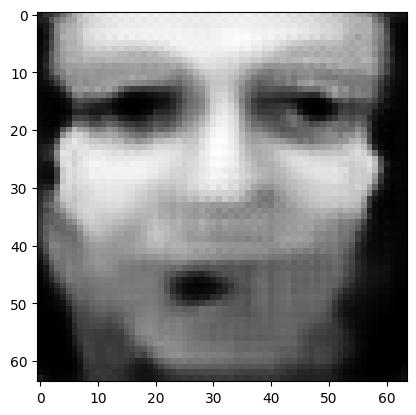

tensor([[9.7027e-01, 3.2446e-04, 1.2051e-05, 7.9595e-06, 8.1502e-05, 9.7126e-07,
         5.2736e-05, 1.0508e-04, 9.9264e-06, 4.0823e-04, 2.6970e-06, 3.9942e-03,
         5.6578e-03, 2.7059e-04, 2.2696e-06, 2.2359e-05, 9.2089e-04, 1.4034e-05,
         1.4412e-05, 3.9346e-07, 7.3575e-04, 2.8396e-04, 2.6499e-05, 2.2806e-04,
         1.9156e-03, 3.3832e-05, 3.6977e-05, 9.9256e-05, 5.9642e-04, 4.4088e-05,
         6.1333e-04, 2.4967e-05, 2.0899e-04, 5.7586e-05, 2.4536e-03, 1.4502e-05,
         3.8660e-03, 4.9635e-03, 5.0831e-04, 1.1124e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030177198350429535
tensor([[9.7028e-01, 3.2440e-04, 1.2047e-05, 7.9575e-06, 8.1484e-05, 9.7108e-07,
         5.2723e-05, 1.0506e-04, 9.9231e-06, 4.0815e-04, 2.6961e-06, 3.9935e-03,
         5.6566e-03, 2.7052e-04, 2.2688e-06, 2.2354e-05, 9.2069e-04, 1.4030e-05,
         1.4409e-05, 3.9334e-07, 7.3555e-04, 2.8389e-04, 2.6491e-05, 2.2800e-04,
         1.9151e-03, 3.3825e-05, 3.6967e-

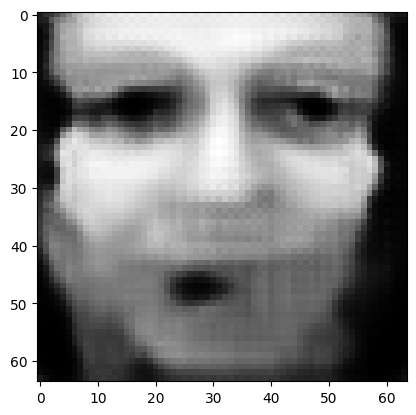

tensor([[9.7031e-01, 3.2416e-04, 1.2034e-05, 7.9496e-06, 8.1413e-05, 9.7038e-07,
         5.2674e-05, 1.0500e-04, 9.9102e-06, 4.0784e-04, 2.6927e-06, 3.9907e-03,
         5.6519e-03, 2.7024e-04, 2.2657e-06, 2.2335e-05, 9.1992e-04, 1.4017e-05,
         1.4395e-05, 3.9285e-07, 7.3475e-04, 2.8362e-04, 2.6461e-05, 2.2781e-04,
         1.9133e-03, 3.3798e-05, 3.6929e-05, 9.9123e-05, 5.9568e-04, 4.4024e-05,
         6.1254e-04, 2.4940e-05, 2.0873e-04, 5.7504e-05, 2.4508e-03, 1.4484e-05,
         3.8618e-03, 4.9579e-03, 5.0762e-04, 1.1112e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030143653973937035
tensor([[9.7031e-01, 3.2410e-04, 1.2031e-05, 7.9476e-06, 8.1395e-05, 9.7021e-07,
         5.2662e-05, 1.0499e-04, 9.9071e-06, 4.0776e-04, 2.6918e-06, 3.9900e-03,
         5.6508e-03, 2.7018e-04, 2.2649e-06, 2.2331e-05, 9.1973e-04, 1.4013e-05,
         1.4392e-05, 3.9274e-07, 7.3455e-04, 2.8355e-04, 2.6453e-05, 2.2776e-04,
         1.9128e-03, 3.3792e-05, 3.6920e-

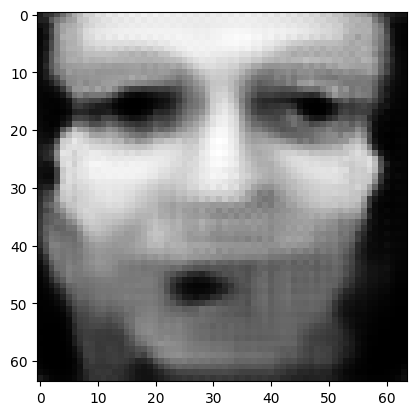

tensor([[9.7034e-01, 3.2388e-04, 1.2018e-05, 7.9401e-06, 8.1328e-05, 9.6954e-07,
         5.2614e-05, 1.0493e-04, 9.8948e-06, 4.0746e-04, 2.6886e-06, 3.9874e-03,
         5.6462e-03, 2.6992e-04, 2.2619e-06, 2.2313e-05, 9.1900e-04, 1.4000e-05,
         1.4379e-05, 3.9227e-07, 7.3380e-04, 2.8329e-04, 2.6424e-05, 2.2757e-04,
         1.9110e-03, 3.3766e-05, 3.6883e-05, 9.8997e-05, 5.9498e-04, 4.3963e-05,
         6.1179e-04, 2.4914e-05, 2.0849e-04, 5.7425e-05, 2.4482e-03, 1.4467e-05,
         3.8578e-03, 4.9526e-03, 5.0696e-04, 1.1100e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030111730098724365
tensor([[9.7034e-01, 3.2383e-04, 1.2014e-05, 7.9382e-06, 8.1311e-05, 9.6937e-07,
         5.2603e-05, 1.0491e-04, 9.8918e-06, 4.0739e-04, 2.6878e-06, 3.9867e-03,
         5.6451e-03, 2.6986e-04, 2.2612e-06, 2.2309e-05, 9.1882e-04, 1.3997e-05,
         1.4376e-05, 3.9216e-07, 7.3361e-04, 2.8323e-04, 2.6417e-05, 2.2752e-04,
         1.9106e-03, 3.3760e-05, 3.6874e-

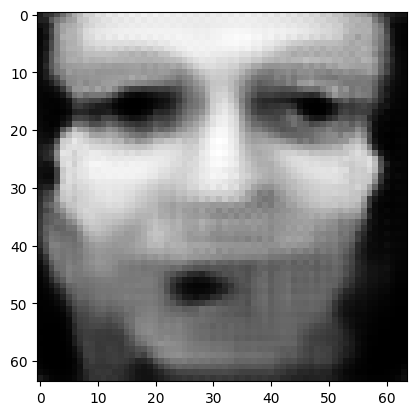

tensor([[9.7037e-01, 3.2362e-04, 1.2002e-05, 7.9311e-06, 8.1248e-05, 9.6874e-07,
         5.2559e-05, 1.0485e-04, 9.8802e-06, 4.0711e-04, 2.6847e-06, 3.9842e-03,
         5.6409e-03, 2.6961e-04, 2.2584e-06, 2.2292e-05, 9.1813e-04, 1.3985e-05,
         1.4364e-05, 3.9173e-07, 7.3290e-04, 2.8298e-04, 2.6390e-05, 2.2734e-04,
         1.9089e-03, 3.3736e-05, 3.6840e-05, 9.8878e-05, 5.9431e-04, 4.3905e-05,
         6.1107e-04, 2.4890e-05, 2.0826e-04, 5.7351e-05, 2.4457e-03, 1.4451e-05,
         3.8541e-03, 4.9475e-03, 5.0634e-04, 1.1089e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030081653967499733
tensor([[9.7037e-01, 3.2356e-04, 1.1999e-05, 7.9294e-06, 8.1232e-05, 9.6859e-07,
         5.2548e-05, 1.0484e-04, 9.8774e-06, 4.0704e-04, 2.6839e-06, 3.9836e-03,
         5.6398e-03, 2.6955e-04, 2.2577e-06, 2.2287e-05, 9.1796e-04, 1.3982e-05,
         1.4361e-05, 3.9162e-07, 7.3272e-04, 2.8292e-04, 2.6383e-05, 2.2730e-04,
         1.9085e-03, 3.3730e-05, 3.6832e-

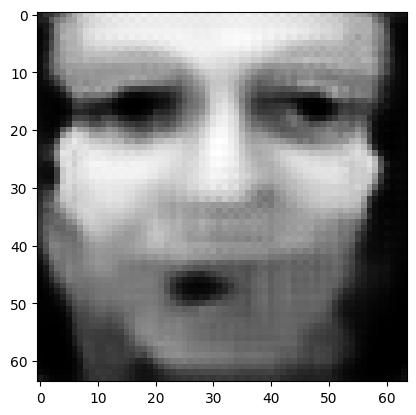

tensor([[9.7039e-01, 3.2336e-04, 1.1988e-05, 7.9226e-06, 8.1171e-05, 9.6799e-07,
         5.2505e-05, 1.0479e-04, 9.8663e-06, 4.0677e-04, 2.6810e-06, 3.9813e-03,
         5.6358e-03, 2.6932e-04, 2.2551e-06, 2.2271e-05, 9.1730e-04, 1.3970e-05,
         1.4350e-05, 3.9120e-07, 7.3204e-04, 2.8268e-04, 2.6357e-05, 2.2712e-04,
         1.9069e-03, 3.3707e-05, 3.6799e-05, 9.8764e-05, 5.9367e-04, 4.3850e-05,
         6.1040e-04, 2.4867e-05, 2.0803e-04, 5.7281e-05, 2.4433e-03, 1.4436e-05,
         3.8505e-03, 4.9427e-03, 5.0575e-04, 1.1078e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030052965506911278
tensor([[9.7040e-01, 3.2331e-04, 1.1985e-05, 7.9210e-06, 8.1157e-05, 9.6784e-07,
         5.2495e-05, 1.0477e-04, 9.8637e-06, 4.0670e-04, 2.6802e-06, 3.9807e-03,
         5.6348e-03, 2.6927e-04, 2.2544e-06, 2.2267e-05, 9.1714e-04, 1.3967e-05,
         1.4347e-05, 3.9110e-07, 7.3187e-04, 2.8263e-04, 2.6351e-05, 2.2708e-04,
         1.9065e-03, 3.3702e-05, 3.6791e-

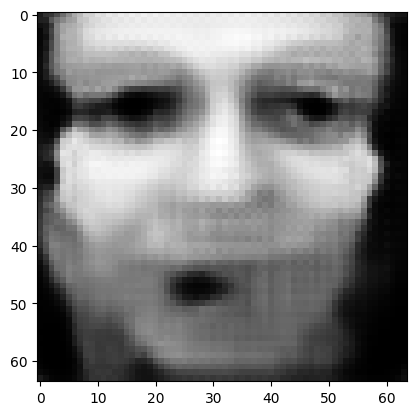

tensor([[9.7042e-01, 3.2312e-04, 1.1974e-05, 7.9146e-06, 8.1099e-05, 9.6727e-07,
         5.2455e-05, 1.0472e-04, 9.8532e-06, 4.0645e-04, 2.6775e-06, 3.9784e-03,
         5.6309e-03, 2.6905e-04, 2.2519e-06, 2.2252e-05, 9.1651e-04, 1.3956e-05,
         1.4336e-05, 3.9071e-07, 7.3123e-04, 2.8240e-04, 2.6326e-05, 2.2692e-04,
         1.9050e-03, 3.3680e-05, 3.6760e-05, 9.8657e-05, 5.9307e-04, 4.3799e-05,
         6.0976e-04, 2.4845e-05, 2.0783e-04, 5.7214e-05, 2.4411e-03, 1.4421e-05,
         3.8470e-03, 4.9381e-03, 5.0519e-04, 1.1068e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030025895684957504
tensor([[9.7043e-01, 3.2308e-04, 1.1971e-05, 7.9130e-06, 8.1085e-05, 9.6713e-07,
         5.2445e-05, 1.0471e-04, 9.8507e-06, 4.0639e-04, 2.6768e-06, 3.9779e-03,
         5.6300e-03, 2.6899e-04, 2.2513e-06, 2.2248e-05, 9.1636e-04, 1.3953e-05,
         1.4333e-05, 3.9061e-07, 7.3107e-04, 2.8235e-04, 2.6320e-05, 2.2688e-04,
         1.9046e-03, 3.3675e-05, 3.6753e-

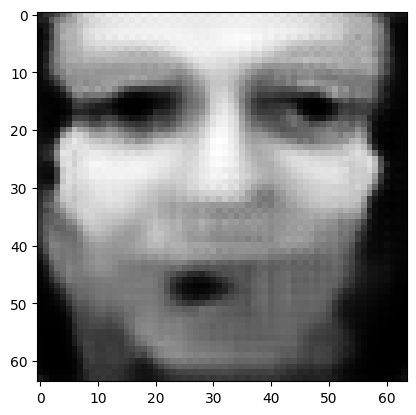

tensor([[9.7045e-01, 3.2290e-04, 1.1961e-05, 7.9069e-06, 8.1031e-05, 9.6659e-07,
         5.2407e-05, 1.0466e-04, 9.8407e-06, 4.0614e-04, 2.6741e-06, 3.9757e-03,
         5.6263e-03, 2.6878e-04, 2.2489e-06, 2.2234e-05, 9.1576e-04, 1.3942e-05,
         1.4323e-05, 3.9024e-07, 7.3046e-04, 2.8214e-04, 2.6296e-05, 2.2673e-04,
         1.9032e-03, 3.3654e-05, 3.6723e-05, 9.8554e-05, 5.9250e-04, 4.3749e-05,
         6.0915e-04, 2.4825e-05, 2.0763e-04, 5.7151e-05, 2.4389e-03, 1.4407e-05,
         3.8438e-03, 4.9338e-03, 5.0466e-04, 1.1059e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029999982565641403
tensor([[9.7045e-01, 3.2285e-04, 1.1958e-05, 7.9054e-06, 8.1017e-05, 9.6646e-07,
         5.2398e-05, 1.0465e-04, 9.8383e-06, 4.0609e-04, 2.6735e-06, 3.9752e-03,
         5.6255e-03, 2.6873e-04, 2.2483e-06, 2.2230e-05, 9.1562e-04, 1.3940e-05,
         1.4321e-05, 3.9015e-07, 7.3031e-04, 2.8209e-04, 2.6291e-05, 2.2669e-04,
         1.9028e-03, 3.3649e-05, 3.6716e-

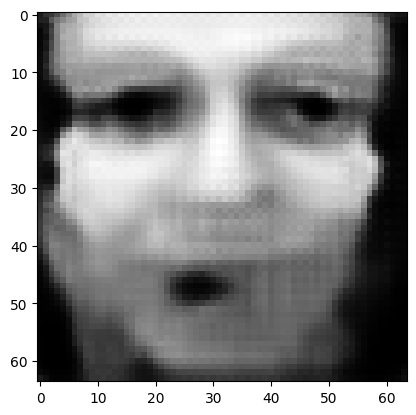

tensor([[9.7047e-01, 3.2268e-04, 1.1948e-05, 7.8996e-06, 8.0965e-05, 9.6594e-07,
         5.2362e-05, 1.0460e-04, 9.8289e-06, 4.0585e-04, 2.6710e-06, 3.9732e-03,
         5.6220e-03, 2.6854e-04, 2.2460e-06, 2.2216e-05, 9.1506e-04, 1.3930e-05,
         1.4311e-05, 3.8980e-07, 7.2972e-04, 2.8188e-04, 2.6268e-05, 2.2654e-04,
         1.9015e-03, 3.3630e-05, 3.6688e-05, 9.8458e-05, 5.9196e-04, 4.3702e-05,
         6.0857e-04, 2.4805e-05, 2.0744e-04, 5.7091e-05, 2.4369e-03, 1.4394e-05,
         3.8407e-03, 4.9296e-03, 5.0415e-04, 1.1050e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02997557260096073
tensor([[9.7047e-01, 3.2264e-04, 1.1946e-05, 7.8982e-06, 8.0952e-05, 9.6582e-07,
         5.2353e-05, 1.0459e-04, 9.8266e-06, 4.0580e-04, 2.6704e-06, 3.9727e-03,
         5.6211e-03, 2.6849e-04, 2.2455e-06, 2.2213e-05, 9.1492e-04, 1.3927e-05,
         1.4308e-05, 3.8971e-07, 7.2958e-04, 2.8184e-04, 2.6263e-05, 2.2651e-04,
         1.9011e-03, 3.3625e-05, 3.6681e-0

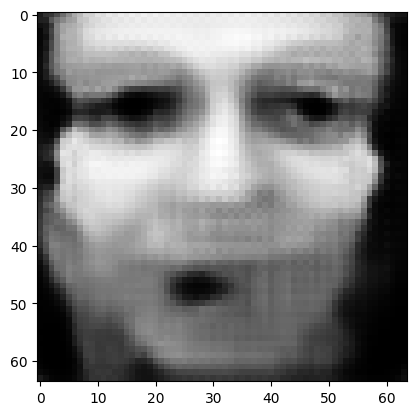

tensor([[9.7049e-01, 3.2247e-04, 1.1936e-05, 7.8927e-06, 8.0903e-05, 9.6533e-07,
         5.2319e-05, 1.0455e-04, 9.8177e-06, 4.0558e-04, 2.6680e-06, 3.9707e-03,
         5.6178e-03, 2.6830e-04, 2.2433e-06, 2.2200e-05, 9.1438e-04, 1.3918e-05,
         1.4299e-05, 3.8937e-07, 7.2903e-04, 2.8164e-04, 2.6242e-05, 2.2637e-04,
         1.8998e-03, 3.3607e-05, 3.6655e-05, 9.8365e-05, 5.9144e-04, 4.3658e-05,
         6.0802e-04, 2.4786e-05, 2.0726e-04, 5.7034e-05, 2.4350e-03, 1.4381e-05,
         3.8378e-03, 4.9257e-03, 5.0367e-04, 1.1041e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029951972886919975
tensor([[9.7050e-01, 3.2244e-04, 1.1934e-05, 7.8914e-06, 8.0891e-05, 9.6521e-07,
         5.2310e-05, 1.0454e-04, 9.8155e-06, 4.0553e-04, 2.6674e-06, 3.9703e-03,
         5.6170e-03, 2.6825e-04, 2.2428e-06, 2.2197e-05, 9.1425e-04, 1.3915e-05,
         1.4297e-05, 3.8929e-07, 7.2890e-04, 2.8160e-04, 2.6237e-05, 2.2633e-04,
         1.8995e-03, 3.3602e-05, 3.6649e-

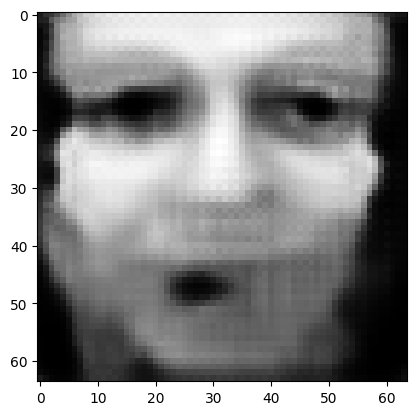

tensor([[9.7051e-01, 3.2228e-04, 1.1925e-05, 7.8862e-06, 8.0844e-05, 9.6475e-07,
         5.2278e-05, 1.0449e-04, 9.8070e-06, 4.0532e-04, 2.6651e-06, 3.9684e-03,
         5.6139e-03, 2.6807e-04, 2.2408e-06, 2.2184e-05, 9.1374e-04, 1.3906e-05,
         1.4288e-05, 3.8897e-07, 7.2837e-04, 2.8142e-04, 2.6216e-05, 2.2620e-04,
         1.8983e-03, 3.3584e-05, 3.6623e-05, 9.8278e-05, 5.9096e-04, 4.3616e-05,
         6.0749e-04, 2.4768e-05, 2.0709e-04, 5.6980e-05, 2.4332e-03, 1.4370e-05,
         3.8350e-03, 4.9220e-03, 5.0321e-04, 1.1033e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029930105432868004
tensor([[9.7052e-01, 3.2224e-04, 1.1923e-05, 7.8849e-06, 8.0833e-05, 9.6463e-07,
         5.2270e-05, 1.0448e-04, 9.8050e-06, 4.0527e-04, 2.6646e-06, 3.9680e-03,
         5.6131e-03, 2.6803e-04, 2.2403e-06, 2.2181e-05, 9.1362e-04, 1.3904e-05,
         1.4286e-05, 3.8889e-07, 7.2824e-04, 2.8137e-04, 2.6211e-05, 2.2617e-04,
         1.8980e-03, 3.3580e-05, 3.6617e-

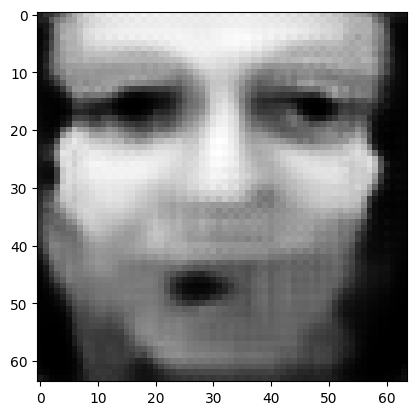

tensor([[9.7053e-01, 3.2209e-04, 1.1915e-05, 7.8800e-06, 8.0788e-05, 9.6419e-07,
         5.2239e-05, 1.0444e-04, 9.7969e-06, 4.0507e-04, 2.6624e-06, 3.9662e-03,
         5.6102e-03, 2.6786e-04, 2.2383e-06, 2.2169e-05, 9.1313e-04, 1.3895e-05,
         1.4278e-05, 3.8859e-07, 7.2774e-04, 2.8120e-04, 2.6192e-05, 2.2604e-04,
         1.8968e-03, 3.3563e-05, 3.6593e-05, 9.8195e-05, 5.9049e-04, 4.3576e-05,
         6.0700e-04, 2.4752e-05, 2.0693e-04, 5.6928e-05, 2.4314e-03, 1.4358e-05,
         3.8324e-03, 4.9185e-03, 5.0278e-04, 1.1025e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029909050092101097
tensor([[9.7054e-01, 3.2206e-04, 1.1913e-05, 7.8788e-06, 8.0778e-05, 9.6409e-07,
         5.2231e-05, 1.0443e-04, 9.7950e-06, 4.0502e-04, 2.6619e-06, 3.9658e-03,
         5.6094e-03, 2.6782e-04, 2.2379e-06, 2.2167e-05, 9.1302e-04, 1.3893e-05,
         1.4276e-05, 3.8852e-07, 7.2762e-04, 2.8116e-04, 2.6188e-05, 2.2601e-04,
         1.8965e-03, 3.3559e-05, 3.6588e-

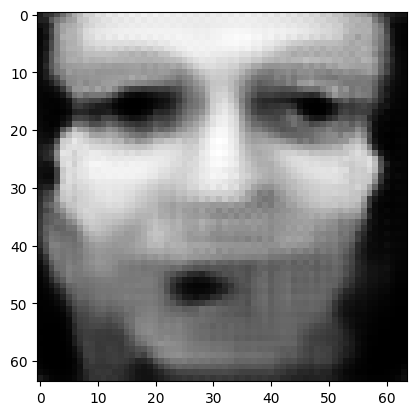

tensor([[9.7055e-01, 3.2192e-04, 1.1904e-05, 7.8740e-06, 8.0736e-05, 9.6367e-07,
         5.2202e-05, 1.0440e-04, 9.7873e-06, 4.0484e-04, 2.6599e-06, 3.9642e-03,
         5.6066e-03, 2.6766e-04, 2.2360e-06, 2.2155e-05, 9.1256e-04, 1.3885e-05,
         1.4268e-05, 3.8823e-07, 7.2715e-04, 2.8100e-04, 2.6170e-05, 2.2590e-04,
         1.8954e-03, 3.3543e-05, 3.6565e-05, 9.8116e-05, 5.9005e-04, 4.3538e-05,
         6.0653e-04, 2.4736e-05, 2.0677e-04, 5.6880e-05, 2.4298e-03, 1.4348e-05,
         3.8299e-03, 4.9152e-03, 5.0237e-04, 1.1018e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02988903410732746
tensor([[9.7056e-01, 3.2189e-04, 1.1902e-05, 7.8729e-06, 8.0725e-05, 9.6357e-07,
         5.2195e-05, 1.0439e-04, 9.7854e-06, 4.0479e-04, 2.6594e-06, 3.9638e-03,
         5.6059e-03, 2.6762e-04, 2.2356e-06, 2.2153e-05, 9.1245e-04, 1.3883e-05,
         1.4266e-05, 3.8816e-07, 7.2703e-04, 2.8096e-04, 2.6165e-05, 2.2587e-04,
         1.8951e-03, 3.3539e-05, 3.6560e-0

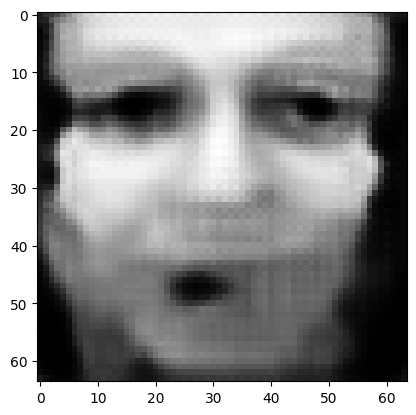

tensor([[9.7057e-01, 3.2175e-04, 1.1895e-05, 7.8684e-06, 8.0685e-05, 9.6317e-07,
         5.2167e-05, 1.0435e-04, 9.7782e-06, 4.0461e-04, 2.6574e-06, 3.9622e-03,
         5.6033e-03, 2.6747e-04, 2.2338e-06, 2.2142e-05, 9.1201e-04, 1.3875e-05,
         1.4258e-05, 3.8789e-07, 7.2658e-04, 2.8080e-04, 2.6148e-05, 2.2575e-04,
         1.8941e-03, 3.3524e-05, 3.6538e-05, 9.8042e-05, 5.8963e-04, 4.3502e-05,
         6.0608e-04, 2.4721e-05, 2.0663e-04, 5.6833e-05, 2.4282e-03, 1.4337e-05,
         3.8275e-03, 4.9120e-03, 5.0198e-04, 1.1011e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029870174825191498
tensor([[9.7057e-01, 3.2172e-04, 1.1893e-05, 7.8674e-06, 8.0675e-05, 9.6307e-07,
         5.2160e-05, 1.0434e-04, 9.7764e-06, 4.0457e-04, 2.6570e-06, 3.9618e-03,
         5.6026e-03, 2.6743e-04, 2.2334e-06, 2.2139e-05, 9.1191e-04, 1.3873e-05,
         1.4256e-05, 3.8782e-07, 7.2647e-04, 2.8076e-04, 2.6144e-05, 2.2573e-04,
         1.8938e-03, 3.3521e-05, 3.6533e-

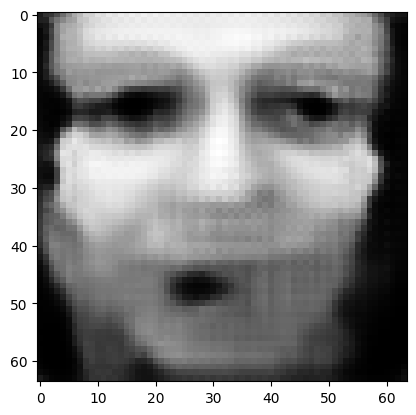

tensor([[9.7059e-01, 3.2159e-04, 1.1886e-05, 7.8631e-06, 8.0637e-05, 9.6269e-07,
         5.2134e-05, 1.0431e-04, 9.7696e-06, 4.0440e-04, 2.6551e-06, 3.9603e-03,
         5.6001e-03, 2.6729e-04, 2.2317e-06, 2.2129e-05, 9.1149e-04, 1.3866e-05,
         1.4249e-05, 3.8756e-07, 7.2605e-04, 2.8062e-04, 2.6127e-05, 2.2562e-04,
         1.8928e-03, 3.3507e-05, 3.6512e-05, 9.7971e-05, 5.8924e-04, 4.3468e-05,
         6.0566e-04, 2.4706e-05, 2.0649e-04, 5.6789e-05, 2.4267e-03, 1.4328e-05,
         3.8253e-03, 4.9090e-03, 5.0161e-04, 1.1004e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029852356761693954
tensor([[9.7059e-01, 3.2156e-04, 1.1884e-05, 7.8621e-06, 8.0628e-05, 9.6260e-07,
         5.2127e-05, 1.0430e-04, 9.7679e-06, 4.0436e-04, 2.6547e-06, 3.9599e-03,
         5.5994e-03, 2.6725e-04, 2.2313e-06, 2.2127e-05, 9.1139e-04, 1.3864e-05,
         1.4247e-05, 3.8750e-07, 7.2594e-04, 2.8058e-04, 2.6124e-05, 2.2559e-04,
         1.8926e-03, 3.3503e-05, 3.6507e-

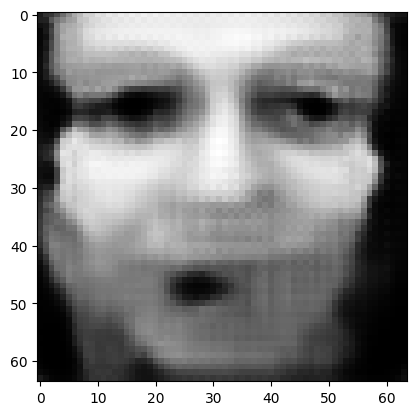

tensor([[9.7061e-01, 3.2144e-04, 1.1877e-05, 7.8581e-06, 8.0592e-05, 9.6225e-07,
         5.2102e-05, 1.0427e-04, 9.7614e-06, 4.0420e-04, 2.6529e-06, 3.9585e-03,
         5.5970e-03, 2.6711e-04, 2.2297e-06, 2.2117e-05, 9.1100e-04, 1.3857e-05,
         1.4241e-05, 3.8725e-07, 7.2554e-04, 2.8044e-04, 2.6108e-05, 2.2549e-04,
         1.8916e-03, 3.3490e-05, 3.6488e-05, 9.7903e-05, 5.8886e-04, 4.3435e-05,
         6.0526e-04, 2.4693e-05, 2.0636e-04, 5.6748e-05, 2.4253e-03, 1.4319e-05,
         3.8231e-03, 4.9061e-03, 5.0126e-04, 1.0998e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029835231602191925
tensor([[9.7061e-01, 3.2141e-04, 1.1875e-05, 7.8571e-06, 8.0583e-05, 9.6216e-07,
         5.2096e-05, 1.0426e-04, 9.7597e-06, 4.0416e-04, 2.6525e-06, 3.9582e-03,
         5.5964e-03, 2.6708e-04, 2.2293e-06, 2.2115e-05, 9.1090e-04, 1.3856e-05,
         1.4239e-05, 3.8719e-07, 7.2544e-04, 2.8041e-04, 2.6104e-05, 2.2547e-04,
         1.8914e-03, 3.3486e-05, 3.6483e-

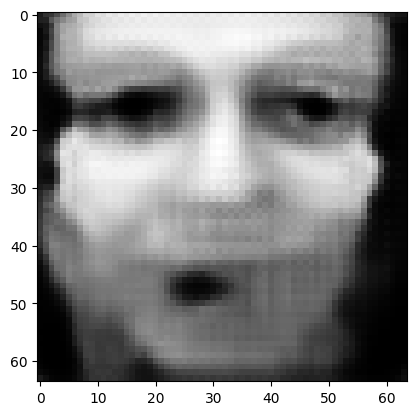

tensor([[9.7062e-01, 3.2130e-04, 1.1869e-05, 7.8533e-06, 8.0549e-05, 9.6182e-07,
         5.2072e-05, 1.0423e-04, 9.7535e-06, 4.0401e-04, 2.6508e-06, 3.9568e-03,
         5.5941e-03, 2.6695e-04, 2.2279e-06, 2.2106e-05, 9.1053e-04, 1.3849e-05,
         1.4232e-05, 3.8696e-07, 7.2506e-04, 2.8027e-04, 2.6090e-05, 2.2537e-04,
         1.8905e-03, 3.3473e-05, 3.6465e-05, 9.7839e-05, 5.8850e-04, 4.3404e-05,
         6.0487e-04, 2.4680e-05, 2.0623e-04, 5.6708e-05, 2.4240e-03, 1.4310e-05,
         3.8211e-03, 4.9034e-03, 5.0093e-04, 1.0992e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029819034039974213
tensor([[9.7062e-01, 3.2127e-04, 1.1867e-05, 7.8523e-06, 8.0540e-05, 9.6173e-07,
         5.2066e-05, 1.0422e-04, 9.7520e-06, 4.0397e-04, 2.6504e-06, 3.9565e-03,
         5.5936e-03, 2.6691e-04, 2.2275e-06, 2.2103e-05, 9.1044e-04, 1.3847e-05,
         1.4231e-05, 3.8690e-07, 7.2496e-04, 2.8024e-04, 2.6086e-05, 2.2534e-04,
         1.8903e-03, 3.3470e-05, 3.6460e-

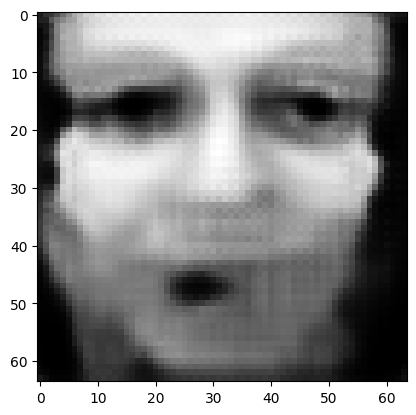

tensor([[9.7064e-01, 3.2116e-04, 1.1861e-05, 7.8487e-06, 8.0508e-05, 9.6141e-07,
         5.2043e-05, 1.0419e-04, 9.7461e-06, 4.0383e-04, 2.6489e-06, 3.9552e-03,
         5.5914e-03, 2.6679e-04, 2.2261e-06, 2.2095e-05, 9.1008e-04, 1.3841e-05,
         1.4225e-05, 3.8668e-07, 7.2459e-04, 2.8011e-04, 2.6072e-05, 2.2525e-04,
         1.8894e-03, 3.3458e-05, 3.6443e-05, 9.7778e-05, 5.8816e-04, 4.3375e-05,
         6.0451e-04, 2.4667e-05, 2.0611e-04, 5.6670e-05, 2.4227e-03, 1.4301e-05,
         3.8191e-03, 4.9008e-03, 5.0061e-04, 1.0986e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029803412035107613
tensor([[9.7064e-01, 3.2114e-04, 1.1860e-05, 7.8478e-06, 8.0500e-05, 9.6133e-07,
         5.2038e-05, 1.0418e-04, 9.7447e-06, 4.0379e-04, 2.6485e-06, 3.9549e-03,
         5.5909e-03, 2.6676e-04, 2.2257e-06, 2.2093e-05, 9.1000e-04, 1.3839e-05,
         1.4223e-05, 3.8662e-07, 7.2450e-04, 2.8008e-04, 2.6068e-05, 2.2523e-04,
         1.8892e-03, 3.3455e-05, 3.6438e-

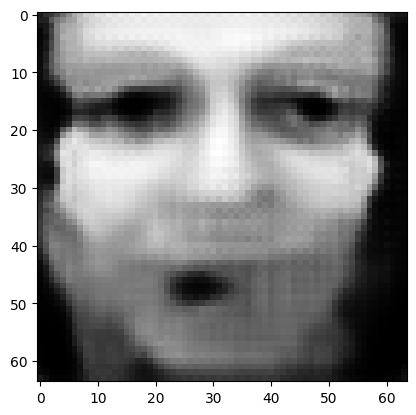

tensor([[9.7065e-01, 3.2103e-04, 1.1854e-05, 7.8443e-06, 8.0469e-05, 9.6102e-07,
         5.2016e-05, 1.0416e-04, 9.7391e-06, 4.0365e-04, 2.6470e-06, 3.9537e-03,
         5.5888e-03, 2.6664e-04, 2.2244e-06, 2.2084e-05, 9.0966e-04, 1.3833e-05,
         1.4217e-05, 3.8641e-07, 7.2415e-04, 2.7996e-04, 2.6055e-05, 2.2514e-04,
         1.8884e-03, 3.3443e-05, 3.6422e-05, 9.7720e-05, 5.8783e-04, 4.3347e-05,
         6.0416e-04, 2.4655e-05, 2.0600e-04, 5.6634e-05, 2.4215e-03, 1.4294e-05,
         3.8173e-03, 4.8983e-03, 5.0030e-04, 1.0981e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029788948595523834
tensor([[9.7065e-01, 3.2101e-04, 1.1852e-05, 7.8435e-06, 8.0461e-05, 9.6095e-07,
         5.2011e-05, 1.0415e-04, 9.7377e-06, 4.0362e-04, 2.6466e-06, 3.9534e-03,
         5.5883e-03, 2.6661e-04, 2.2240e-06, 2.2082e-05, 9.0958e-04, 1.3832e-05,
         1.4216e-05, 3.8636e-07, 7.2407e-04, 2.7993e-04, 2.6052e-05, 2.2512e-04,
         1.8882e-03, 3.3440e-05, 3.6418e-

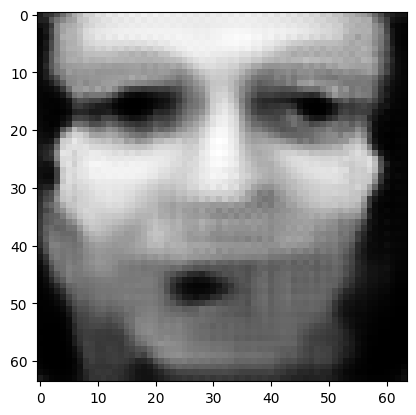

tensor([[9.7066e-01, 3.2091e-04, 1.1847e-05, 7.8402e-06, 8.0432e-05, 9.6066e-07,
         5.1991e-05, 1.0412e-04, 9.7324e-06, 4.0349e-04, 2.6452e-06, 3.9522e-03,
         5.5863e-03, 2.6650e-04, 2.2227e-06, 2.2075e-05, 9.0926e-04, 1.3826e-05,
         1.4210e-05, 3.8616e-07, 7.2374e-04, 2.7982e-04, 2.6039e-05, 2.2504e-04,
         1.8874e-03, 3.3429e-05, 3.6402e-05, 9.7665e-05, 5.8753e-04, 4.3321e-05,
         6.0383e-04, 2.4644e-05, 2.0590e-04, 5.6600e-05, 2.4204e-03, 1.4286e-05,
         3.8156e-03, 4.8960e-03, 5.0002e-04, 1.0975e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029774948954582214
tensor([[9.7067e-01, 3.2089e-04, 1.1845e-05, 7.8394e-06, 8.0425e-05, 9.6059e-07,
         5.1986e-05, 1.0412e-04, 9.7311e-06, 4.0346e-04, 2.6448e-06, 3.9520e-03,
         5.5858e-03, 2.6647e-04, 2.2224e-06, 2.2073e-05, 9.0918e-04, 1.3825e-05,
         1.4209e-05, 3.8611e-07, 7.2366e-04, 2.7979e-04, 2.6036e-05, 2.2502e-04,
         1.8872e-03, 3.3426e-05, 3.6398e-

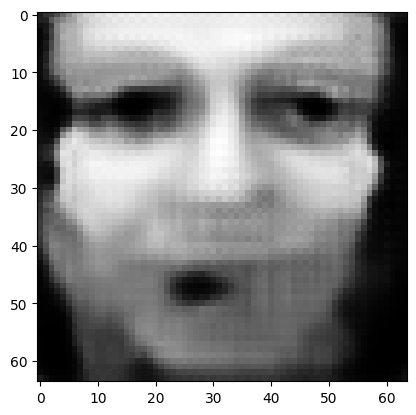

tensor([[9.7068e-01, 3.2079e-04, 1.1840e-05, 7.8363e-06, 8.0396e-05, 9.6031e-07,
         5.1966e-05, 1.0409e-04, 9.7260e-06, 4.0333e-04, 2.6435e-06, 3.9509e-03,
         5.5840e-03, 2.6637e-04, 2.2212e-06, 2.2065e-05, 9.0888e-04, 1.3819e-05,
         1.4204e-05, 3.8592e-07, 7.2335e-04, 2.7968e-04, 2.6024e-05, 2.2494e-04,
         1.8865e-03, 3.3416e-05, 3.6383e-05, 9.7613e-05, 5.8723e-04, 4.3295e-05,
         6.0352e-04, 2.4634e-05, 2.0579e-04, 5.6568e-05, 2.4193e-03, 1.4279e-05,
         3.8139e-03, 4.8937e-03, 4.9975e-04, 1.0971e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029761988669633865
tensor([[9.7068e-01, 3.2077e-04, 1.1839e-05, 7.8355e-06, 8.0390e-05, 9.6024e-07,
         5.1961e-05, 1.0409e-04, 9.7248e-06, 4.0330e-04, 2.6432e-06, 3.9506e-03,
         5.5835e-03, 2.6634e-04, 2.2209e-06, 2.2063e-05, 9.0880e-04, 1.3818e-05,
         1.4202e-05, 3.8587e-07, 7.2327e-04, 2.7966e-04, 2.6021e-05, 2.2492e-04,
         1.8863e-03, 3.3413e-05, 3.6380e-

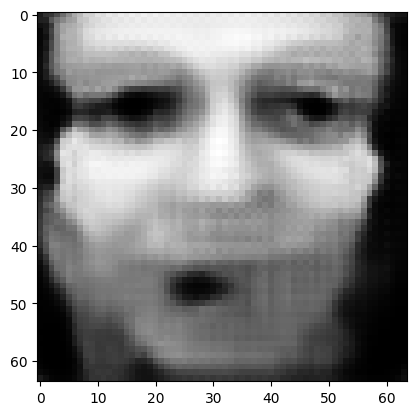

tensor([[9.7069e-01, 3.2068e-04, 1.1833e-05, 7.8326e-06, 8.0363e-05, 9.5998e-07,
         5.1943e-05, 1.0406e-04, 9.7200e-06, 4.0319e-04, 2.6419e-06, 3.9495e-03,
         5.5817e-03, 2.6624e-04, 2.2197e-06, 2.2056e-05, 9.0851e-04, 1.3813e-05,
         1.4197e-05, 3.8569e-07, 7.2297e-04, 2.7955e-04, 2.6010e-05, 2.2485e-04,
         1.8856e-03, 3.3403e-05, 3.6365e-05, 9.7563e-05, 5.8696e-04, 4.3272e-05,
         6.0322e-04, 2.4624e-05, 2.0570e-04, 5.6537e-05, 2.4183e-03, 1.4272e-05,
         3.8123e-03, 4.8916e-03, 4.9949e-04, 1.0966e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02974925935268402
tensor([[9.7069e-01, 3.2066e-04, 1.1832e-05, 7.8318e-06, 8.0357e-05, 9.5991e-07,
         5.1938e-05, 1.0406e-04, 9.7188e-06, 4.0316e-04, 2.6416e-06, 3.9493e-03,
         5.5813e-03, 2.6621e-04, 2.2195e-06, 2.2055e-05, 9.0844e-04, 1.3812e-05,
         1.4196e-05, 3.8565e-07, 7.2290e-04, 2.7953e-04, 2.6007e-05, 2.2483e-04,
         1.8854e-03, 3.3401e-05, 3.6362e-0

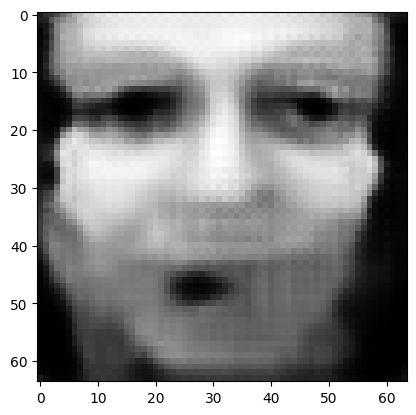

tensor([[9.7070e-01, 3.2058e-04, 1.1827e-05, 7.8290e-06, 8.0331e-05, 9.5966e-07,
         5.1921e-05, 1.0403e-04, 9.7143e-06, 4.0304e-04, 2.6403e-06, 3.9483e-03,
         5.5796e-03, 2.6612e-04, 2.2184e-06, 2.2048e-05, 9.0817e-04, 1.3807e-05,
         1.4191e-05, 3.8548e-07, 7.2261e-04, 2.7943e-04, 2.5996e-05, 2.2476e-04,
         1.8847e-03, 3.3391e-05, 3.6348e-05, 9.7516e-05, 5.8669e-04, 4.3249e-05,
         6.0294e-04, 2.4614e-05, 2.0560e-04, 5.6508e-05, 2.4173e-03, 1.4266e-05,
         3.8108e-03, 4.8896e-03, 4.9924e-04, 1.0962e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029737340286374092
tensor([[9.7070e-01, 3.2056e-04, 1.1826e-05, 7.8284e-06, 8.0325e-05, 9.5960e-07,
         5.1916e-05, 1.0403e-04, 9.7132e-06, 4.0302e-04, 2.6401e-06, 3.9481e-03,
         5.5792e-03, 2.6609e-04, 2.2181e-06, 2.2046e-05, 9.0810e-04, 1.3806e-05,
         1.4190e-05, 3.8543e-07, 7.2255e-04, 2.7941e-04, 2.5994e-05, 2.2474e-04,
         1.8846e-03, 3.3389e-05, 3.6345e-

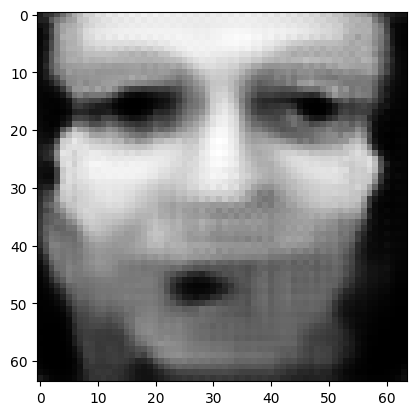

tensor([[9.7071e-01, 3.2048e-04, 1.1822e-05, 7.8257e-06, 8.0301e-05, 9.5936e-07,
         5.1900e-05, 1.0401e-04, 9.7088e-06, 4.0291e-04, 2.6389e-06, 3.9471e-03,
         5.5776e-03, 2.6600e-04, 2.2171e-06, 2.2040e-05, 9.0784e-04, 1.3801e-05,
         1.4186e-05, 3.8527e-07, 7.2228e-04, 2.7932e-04, 2.5983e-05, 2.2467e-04,
         1.8840e-03, 3.3380e-05, 3.6332e-05, 9.7472e-05, 5.8644e-04, 4.3227e-05,
         6.0268e-04, 2.4605e-05, 2.0552e-04, 5.6480e-05, 2.4163e-03, 1.4260e-05,
         3.8094e-03, 4.8877e-03, 4.9901e-04, 1.0957e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02972576953470707
tensor([[9.7071e-01, 3.2046e-04, 1.1821e-05, 7.8250e-06, 8.0295e-05, 9.5930e-07,
         5.1896e-05, 1.0400e-04, 9.7078e-06, 4.0288e-04, 2.6386e-06, 3.9469e-03,
         5.5772e-03, 2.6598e-04, 2.2168e-06, 2.2038e-05, 9.0778e-04, 1.3800e-05,
         1.4185e-05, 3.8523e-07, 7.2221e-04, 2.7929e-04, 2.5981e-05, 2.2465e-04,
         1.8838e-03, 3.3378e-05, 3.6329e-0

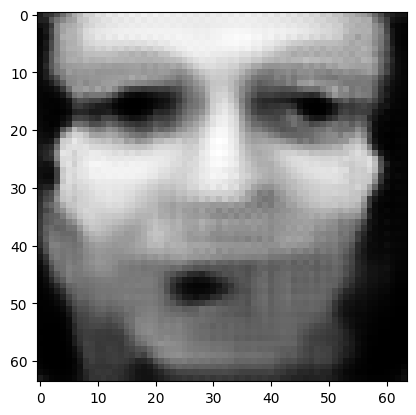

tensor([[9.7072e-01, 3.2038e-04, 1.1816e-05, 7.8225e-06, 8.0272e-05, 9.5908e-07,
         5.1880e-05, 1.0398e-04, 9.7037e-06, 4.0278e-04, 2.6375e-06, 3.9460e-03,
         5.5757e-03, 2.6589e-04, 2.2158e-06, 2.2032e-05, 9.0753e-04, 1.3795e-05,
         1.4180e-05, 3.8508e-07, 7.2196e-04, 2.7920e-04, 2.5971e-05, 2.2459e-04,
         1.8832e-03, 3.3369e-05, 3.6317e-05, 9.7429e-05, 5.8621e-04, 4.3207e-05,
         6.0242e-04, 2.4596e-05, 2.0543e-04, 5.6454e-05, 2.4154e-03, 1.4254e-05,
         3.8080e-03, 4.8859e-03, 4.9879e-04, 1.0953e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02971535548567772
tensor([[9.7072e-01, 3.2036e-04, 1.1815e-05, 7.8218e-06, 8.0267e-05, 9.5902e-07,
         5.1876e-05, 1.0398e-04, 9.7026e-06, 4.0276e-04, 2.6372e-06, 3.9458e-03,
         5.5753e-03, 2.6587e-04, 2.2156e-06, 2.2031e-05, 9.0747e-04, 1.3794e-05,
         1.4179e-05, 3.8504e-07, 7.2189e-04, 2.7918e-04, 2.5969e-05, 2.2457e-04,
         1.8831e-03, 3.3367e-05, 3.6314e-0

In [137]:
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=0)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7365e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.029402732849121


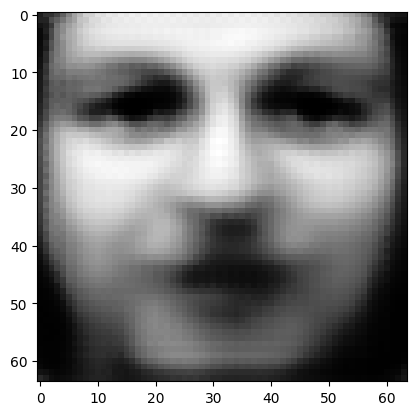

tensor([[1.5834e-04, 1.1868e-03, 1.1632e-02, 3.1652e-03, 1.2655e-03, 8.5609e-06,
         1.4545e-02, 1.8292e-04, 6.0063e-02, 3.1997e-03, 1.3229e-02, 1.0742e-02,
         1.7996e-02, 1.2728e-02, 6.3468e-03, 1.0262e-03, 2.0037e-02, 1.1444e-03,
         3.6347e-03, 1.2682e-03, 1.0853e-01, 2.4036e-02, 3.2861e-03, 1.0033e-02,
         1.5220e-01, 7.4949e-04, 8.7870e-03, 3.0763e-02, 3.8568e-02, 1.3054e-02,
         4.5531e-02, 8.0731e-04, 1.4204e-02, 1.0947e-02, 3.1800e-02, 1.0257e-03,
         2.0578e-02, 1.5386e-01, 8.0653e-02, 6.7032e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.736476898193359
tensor([[1.8280e-04, 3.1449e-03, 8.0629e-03, 4.3637e-03, 8.9905e-04, 6.9392e-06,
         1.0143e-02, 1.6364e-04, 3.0372e-02, 1.7122e-03, 1.7013e-02, 1.0212e-02,
         1.5484e-02, 1.8623e-02, 8.1271e-03, 1.4347e-03, 1.6807e-02, 1.2142e-03,
         5.2950e-03, 1.6121e-03, 1.4976e-01, 2.4104e-02, 1.4694e-03, 1.1993e-02,
         1.1012e-01, 6.3327e-04, 1.1943e-02,

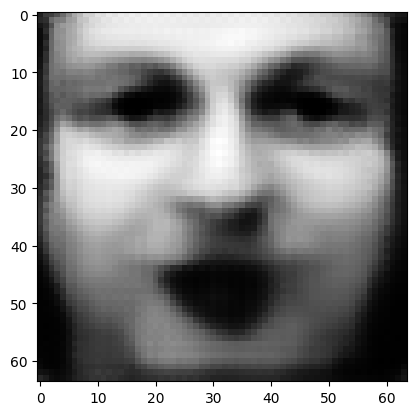

tensor([[3.0865e-04, 2.6269e-02, 2.7757e-03, 9.6531e-03, 5.2920e-04, 4.4689e-06,
         4.3741e-03, 1.1995e-04, 6.0250e-03, 5.1707e-04, 2.2334e-02, 7.4622e-03,
         1.2784e-02, 3.1723e-02, 1.2405e-02, 2.5096e-03, 1.0257e-02, 9.3994e-04,
         9.8642e-03, 2.8590e-03, 2.0521e-01, 2.9444e-02, 3.2424e-04, 1.5502e-02,
         4.0930e-02, 3.9901e-04, 1.6867e-02, 1.8566e-02, 4.5635e-02, 1.1364e-02,
         4.0538e-02, 2.4169e-03, 7.4901e-03, 4.9905e-02, 6.9746e-03, 1.2672e-03,
         2.9606e-02, 1.4062e-01, 9.7159e-02, 7.6072e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.6393837928771973
tensor([[3.5319e-04, 3.8113e-02, 2.1961e-03, 1.0295e-02, 4.7455e-04, 4.1564e-06,
         3.6434e-03, 1.1789e-04, 4.3891e-03, 4.3697e-04, 2.3362e-02, 6.7544e-03,
         1.2354e-02, 3.3151e-02, 1.3421e-02, 2.7138e-03, 8.8670e-03, 8.6521e-04,
         1.0762e-02, 3.1491e-03, 2.0003e-01, 3.0311e-02, 2.5028e-04, 1.6069e-02,
         3.4549e-02, 3.4833e-04, 1.7312e-02

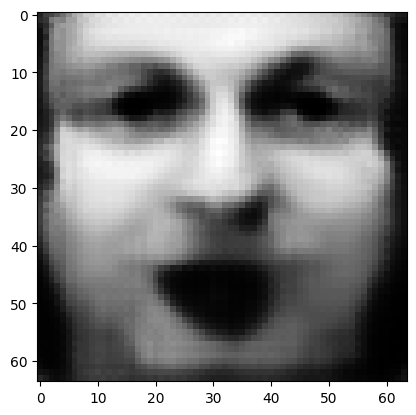

tensor([[4.8177e-04, 1.2498e-01, 9.9069e-04, 1.2112e-02, 3.2385e-04, 3.0995e-06,
         1.9081e-03, 1.0021e-04, 1.3616e-03, 2.2938e-04, 2.5341e-02, 4.2696e-03,
         1.0817e-02, 3.7217e-02, 1.5103e-02, 3.2903e-03, 5.0476e-03, 5.4685e-04,
         1.3380e-02, 3.8815e-03, 1.5641e-01, 3.3144e-02, 9.5906e-05, 1.5587e-02,
         1.8092e-02, 2.0554e-04, 1.8842e-02, 1.2538e-02, 4.0971e-02, 1.0431e-02,
         3.2079e-02, 2.9178e-03, 4.9150e-03, 1.0012e-01, 2.7066e-03, 1.8676e-03,
         3.2872e-02, 9.6862e-02, 8.7520e-02, 7.0441e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.0795769691467285
tensor([[4.9971e-04, 1.5552e-01, 8.2777e-04, 1.2298e-02, 2.9575e-04, 2.8757e-06,
         1.6436e-03, 9.3751e-05, 1.0477e-03, 1.9566e-04, 2.5157e-02, 3.8305e-03,
         1.0439e-02, 3.7597e-02, 1.4956e-02, 3.3528e-03, 4.4714e-03, 4.8524e-04,
         1.3617e-02, 3.9168e-03, 1.4455e-01, 3.3242e-02, 7.7778e-05, 1.5018e-02,
         1.5328e-02, 1.8178e-04, 1.9025e-02

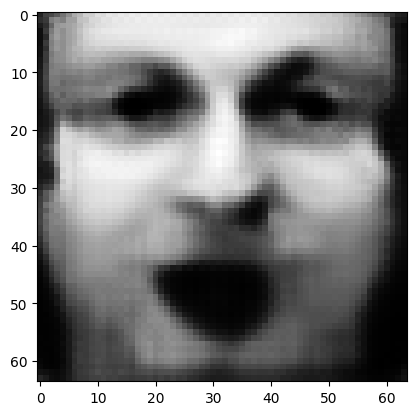

tensor([[5.5215e-04, 2.8761e-01, 4.2086e-04, 1.1549e-02, 2.1262e-04, 2.1698e-06,
         9.6047e-04, 7.3077e-05, 4.2750e-04, 1.1293e-04, 2.2291e-02, 2.6965e-03,
         8.7581e-03, 3.5673e-02, 1.3257e-02, 3.3723e-03, 2.8987e-03, 3.2158e-04,
         1.3550e-02, 3.5789e-03, 1.0435e-01, 3.0617e-02, 3.7366e-05, 1.2824e-02,
         8.7556e-03, 1.1958e-04, 1.8231e-02, 8.0197e-03, 2.9892e-02, 7.9053e-03,
         2.4174e-02, 3.1144e-03, 3.1189e-03, 1.2795e-01, 1.1294e-03, 2.0568e-03,
         2.9282e-02, 6.2608e-02, 6.5339e-02, 5.2165e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2461603879928589
tensor([[5.5987e-04, 3.1998e-01, 3.6045e-04, 1.1143e-02, 1.9778e-04, 2.0323e-06,
         8.4950e-04, 6.8816e-05, 3.5302e-04, 1.0031e-04, 2.1301e-02, 2.4971e-03,
         8.4035e-03, 3.4705e-02, 1.2701e-02, 3.3560e-03, 2.6144e-03, 2.9376e-04,
         1.3287e-02, 3.4419e-03, 9.6260e-02, 2.9482e-02, 3.1681e-05, 1.2296e-02,
         7.7820e-03, 1.0841e-04, 1.7830e-02

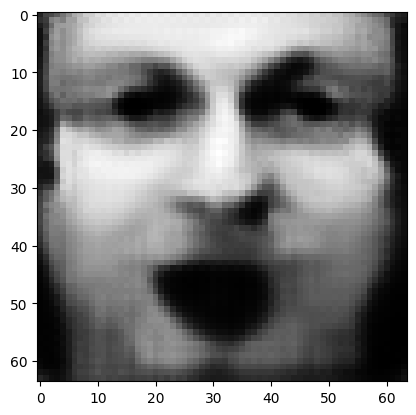

tensor([[5.8635e-04, 4.4305e-01, 2.0229e-04, 9.1709e-03, 1.4891e-04, 1.5688e-06,
         5.3278e-04, 5.4172e-05, 1.7336e-04, 6.5223e-05, 1.7058e-02, 1.8567e-03,
         7.0828e-03, 2.9899e-02, 1.0310e-02, 3.1903e-03, 1.7441e-03, 2.0684e-04,
         1.1825e-02, 2.8442e-03, 6.9284e-02, 2.4700e-02, 1.6999e-05, 1.0152e-02,
         4.9120e-03, 7.2816e-05, 1.5645e-02, 5.0421e-03, 2.0968e-02, 6.0130e-03,
         1.8053e-02, 2.8684e-03, 2.0495e-03, 1.2834e-01, 5.6616e-04, 1.9740e-03,
         2.2625e-02, 4.1268e-02, 4.6189e-02, 3.9259e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.814075767993927
tensor([[5.8907e-04, 4.6928e-01, 1.7817e-04, 8.7162e-03, 1.3922e-04, 1.4768e-06,
         4.8080e-04, 5.1207e-05, 1.4869e-04, 5.9206e-05, 1.6131e-02, 1.7371e-03,
         6.7946e-03, 2.8773e-02, 9.7667e-03, 3.1341e-03, 1.5959e-03, 1.9139e-04,
         1.1441e-02, 2.7029e-03, 6.4200e-02, 2.3595e-02, 1.4808e-05, 9.6849e-03,
         4.4317e-03, 6.6509e-05, 1.5122e-02,

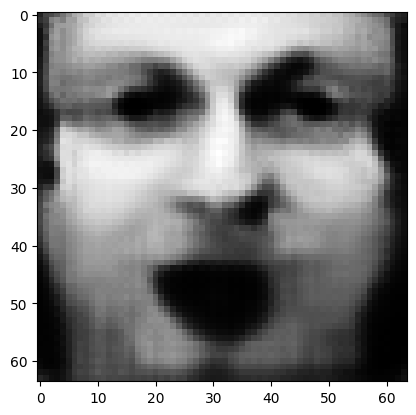

tensor([[5.8835e-04, 5.6021e-01, 1.1187e-04, 7.1438e-03, 1.0787e-04, 1.1636e-06,
         3.2671e-04, 4.1097e-05, 8.4708e-05, 4.1473e-05, 1.2804e-02, 1.3373e-03,
         5.7657e-03, 2.4237e-02, 7.9327e-03, 2.8855e-03, 1.1232e-03, 1.4343e-04,
         1.0032e-02, 2.2287e-03, 4.8301e-02, 1.9611e-02, 8.8248e-06, 8.0686e-03,
         2.9943e-03, 4.6598e-05, 1.3036e-02, 3.2871e-03, 1.5285e-02, 4.7023e-03,
         1.3667e-02, 2.5103e-03, 1.4356e-03, 1.1871e-01, 3.2260e-04, 1.8024e-03,
         1.7276e-02, 2.8724e-02, 3.3400e-02, 2.9670e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5794464945793152
tensor([[5.8493e-04, 5.7907e-01, 1.0103e-04, 6.8417e-03, 1.0173e-04, 1.1013e-06,
         3.0013e-04, 3.9025e-05, 7.4856e-05, 3.8267e-05, 1.2124e-02, 1.2591e-03,
         5.5349e-03, 2.3212e-02, 7.5573e-03, 2.8260e-03, 1.0366e-03, 1.3445e-04,
         9.7449e-03, 2.1344e-03, 4.5292e-02, 1.8780e-02, 7.8498e-06, 7.7356e-03,
         2.7342e-03, 4.2994e-05, 1.2576e-02

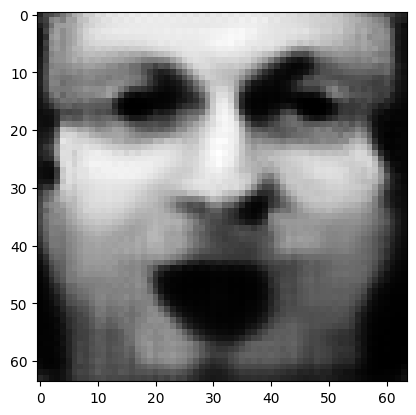

tensor([[5.7177e-04, 6.4182e-01, 7.0315e-05, 5.8237e-03, 8.1709e-05, 9.0003e-07,
         2.2332e-04, 3.2553e-05, 4.8247e-05, 2.8701e-05, 9.9096e-03, 1.0105e-03,
         4.7403e-03, 1.9711e-02, 6.3021e-03, 2.5965e-03, 7.7713e-04, 1.0694e-04,
         8.7588e-03, 1.8147e-03, 3.5722e-02, 1.5985e-02, 5.1539e-06, 6.6573e-03,
         1.9821e-03, 3.2142e-05, 1.0956e-02, 2.2892e-03, 1.1731e-02, 3.8034e-03,
         1.0650e-02, 2.1863e-03, 1.0723e-03, 1.0740e-01, 2.0591e-04, 1.6374e-03,
         1.3532e-02, 2.1219e-02, 2.5319e-02, 2.3178e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.44344088435173035
tensor([[5.6799e-04, 6.5452e-01, 6.5139e-05, 5.6272e-03, 7.7858e-05, 8.6256e-07,
         2.1006e-04, 3.1300e-05, 4.3846e-05, 2.6928e-05, 9.4745e-03, 9.6313e-04,
         4.5792e-03, 1.9044e-02, 6.0394e-03, 2.5449e-03, 7.3095e-04, 1.0172e-04,
         8.5509e-03, 1.7454e-03, 3.3865e-02, 1.5418e-02, 4.7052e-06, 6.4363e-03,
         1.8525e-03, 3.0280e-05, 1.0635e-0

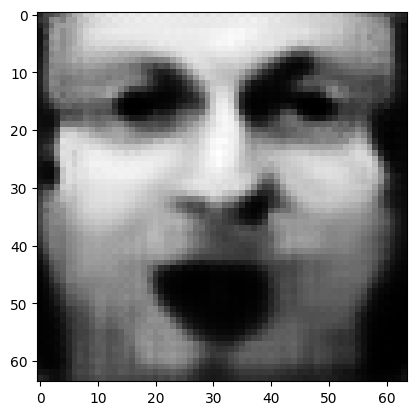

tensor([[5.5334e-04, 6.9784e-01, 4.9269e-05, 4.9378e-03, 6.5124e-05, 7.3737e-07,
         1.6816e-04, 2.7063e-05, 3.0975e-05, 2.1336e-05, 8.0122e-03, 8.0502e-04,
         4.0492e-03, 1.6737e-02, 5.1519e-03, 2.3673e-03, 5.8201e-04, 8.5003e-05,
         7.7893e-03, 1.5111e-03, 2.7725e-02, 1.3432e-02, 3.3641e-06, 5.6818e-03,
         1.4453e-03, 2.4120e-05, 9.4960e-03, 1.7198e-03, 9.4074e-03, 3.1604e-03,
         8.6911e-03, 1.9545e-03, 8.4588e-04, 9.7351e-02, 1.4401e-04, 1.4964e-03,
         1.1044e-02, 1.6632e-02, 2.0086e-02, 1.8879e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.35976746678352356
tensor([[5.5028e-04, 7.0696e-01, 4.6299e-05, 4.7910e-03, 6.2590e-05, 7.1306e-07,
         1.5979e-04, 2.6186e-05, 2.8686e-05, 2.0261e-05, 7.7047e-03, 7.7335e-04,
         3.9437e-03, 1.6245e-02, 4.9685e-03, 2.3268e-03, 5.5272e-04, 8.1690e-05,
         7.6168e-03, 1.4615e-03, 2.6507e-02, 1.3001e-02, 3.1244e-06, 5.5190e-03,
         1.3680e-03, 2.2925e-05, 9.2466e-0

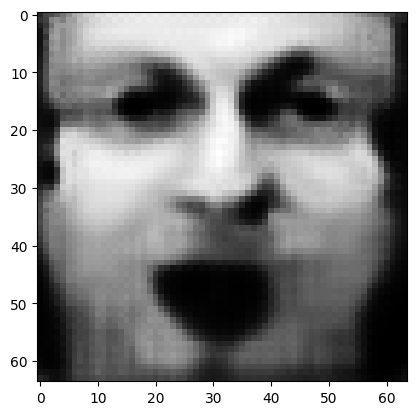

tensor([[5.3834e-04, 7.3762e-01, 3.7138e-05, 4.3030e-03, 5.4242e-05, 6.3298e-07,
         1.3383e-04, 2.3294e-05, 2.1907e-05, 1.6875e-05, 6.6961e-03, 6.7158e-04,
         3.5830e-03, 1.4563e-02, 4.3495e-03, 2.1912e-03, 4.6014e-04, 7.0885e-05,
         7.0471e-03, 1.2970e-03, 2.2551e-02, 1.1550e-02, 2.3962e-06, 4.9875e-03,
         1.1270e-03, 1.9141e-05, 8.4202e-03, 1.3626e-03, 7.8410e-03, 2.7114e-03,
         7.3598e-03, 1.7655e-03, 6.9928e-04, 8.8867e-02, 1.0822e-04, 1.3790e-03,
         9.2849e-03, 1.3666e-02, 1.6604e-02, 1.6017e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3043292760848999
tensor([[5.3502e-04, 7.4413e-01, 3.5327e-05, 4.2017e-03, 5.2526e-05, 6.1611e-07,
         1.2858e-04, 2.2675e-05, 2.0620e-05, 1.6190e-05, 6.4857e-03, 6.5043e-04,
         3.5031e-03, 1.4196e-02, 4.2230e-03, 2.1606e-03, 4.4117e-04, 6.8683e-05,
         6.9268e-03, 1.2629e-03, 2.1744e-02, 1.1241e-02, 2.2574e-06, 4.8755e-03,
         1.0783e-03, 1.8376e-05, 8.2413e-03

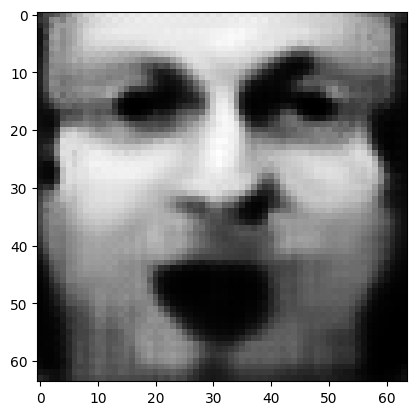

tensor([[5.2374e-04, 7.6688e-01, 2.9417e-05, 3.8374e-03, 4.6603e-05, 5.5775e-07,
         1.1120e-04, 2.0577e-05, 1.6536e-05, 1.3923e-05, 5.7659e-03, 5.7933e-04,
         3.2233e-03, 1.2925e-02, 3.7766e-03, 2.0529e-03, 3.7877e-04, 6.1199e-05,
         6.5039e-03, 1.1418e-03, 1.8987e-02, 1.0158e-02, 1.8118e-06, 4.4898e-03,
         9.2021e-04, 1.5818e-05, 7.6189e-03, 1.1221e-03, 6.7328e-03, 2.3862e-03,
         6.3999e-03, 1.6207e-03, 5.9718e-04, 8.1925e-02, 8.5586e-05, 1.2862e-03,
         7.9963e-03, 1.1608e-02, 1.4166e-02, 1.3997e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2654292583465576
tensor([[5.2036e-04, 7.7186e-01, 2.8203e-05, 3.7624e-03, 4.5355e-05, 5.4498e-07,
         1.0746e-04, 2.0100e-05, 1.5704e-05, 1.3432e-05, 5.6087e-03, 5.6368e-04,
         3.1586e-03, 1.2647e-02, 3.6824e-03, 2.0261e-03, 3.6530e-04, 5.9580e-05,
         6.4090e-03, 1.1156e-03, 1.8411e-02, 9.9215e-03, 1.7228e-06, 4.4007e-03,
         8.8585e-04, 1.5289e-05, 7.4770e-03

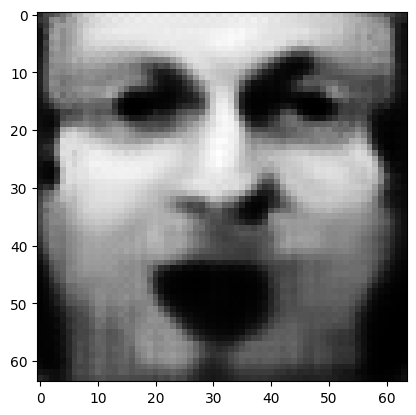

tensor([[5.0718e-04, 7.8954e-01, 2.4135e-05, 3.4815e-03, 4.0880e-05, 4.9839e-07,
         9.4801e-05, 1.8398e-05, 1.2954e-05, 1.1732e-05, 5.0506e-03, 5.0899e-04,
         2.9188e-03, 1.1668e-02, 3.3429e-03, 1.9239e-03, 3.1907e-04, 5.3782e-05,
         6.0740e-03, 1.0199e-03, 1.6380e-02, 9.0877e-03, 1.4235e-06, 4.0830e-03,
         7.7013e-04, 1.3457e-05, 6.9727e-03, 9.4561e-04, 5.8670e-03, 2.1315e-03,
         5.6724e-03, 1.5075e-03, 5.2047e-04, 7.6366e-02, 6.9713e-05, 1.2093e-03,
         7.0162e-03, 1.0077e-02, 1.2320e-02, 1.2375e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.23630142211914062
tensor([[5.0440e-04, 7.9337e-01, 2.3305e-05, 3.4201e-03, 3.9927e-05, 4.8856e-07,
         9.2224e-05, 1.8039e-05, 1.2407e-05, 1.1381e-05, 4.9317e-03, 4.9763e-04,
         2.8674e-03, 1.1457e-02, 3.2684e-03, 1.9024e-03, 3.0957e-04, 5.2568e-05,
         6.0022e-03, 9.9898e-04, 1.5948e-02, 8.9069e-03, 1.3628e-06, 4.0156e-03,
         7.4657e-04, 1.3076e-05, 6.8658e-0

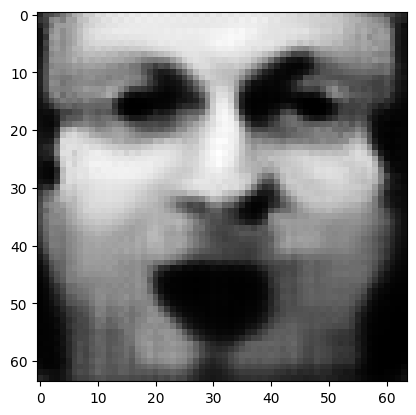

tensor([[4.9379e-04, 8.0710e-01, 2.0452e-05, 3.2023e-03, 3.6568e-05, 4.5369e-07,
         8.3130e-05, 1.6748e-05, 1.0566e-05, 1.0154e-05, 4.5091e-03, 4.5752e-04,
         2.6832e-03, 1.0699e-02, 3.0046e-03, 1.8242e-03, 2.7635e-04, 4.8342e-05,
         5.7351e-03, 9.2539e-04, 1.4452e-02, 8.2540e-03, 1.1585e-06, 3.7717e-03,
         6.6364e-04, 1.1745e-05, 6.4739e-03, 8.1772e-04, 5.2202e-03, 1.9360e-03,
         5.1214e-03, 1.4196e-03, 4.6352e-04, 7.1737e-02, 5.8617e-05, 1.1446e-03,
         6.2653e-03, 8.9530e-03, 1.0934e-02, 1.1162e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21430544555187225
tensor([[4.9120e-04, 8.1020e-01, 1.9832e-05, 3.1551e-03, 3.5832e-05, 4.4598e-07,
         8.1082e-05, 1.6453e-05, 1.0171e-05, 9.8810e-06, 4.4134e-03, 4.4847e-04,
         2.6410e-03, 1.0528e-02, 2.9463e-03, 1.8053e-03, 2.6895e-04, 4.7403e-05,
         5.6712e-03, 9.0904e-04, 1.4127e-02, 8.1065e-03, 1.1155e-06, 3.7146e-03,
         6.4492e-04, 1.1458e-05, 6.3813e-0

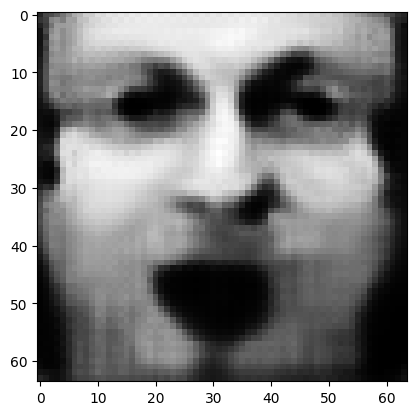

tensor([[4.8245e-04, 8.2136e-01, 1.7688e-05, 2.9777e-03, 3.3169e-05, 4.1838e-07,
         7.4028e-05, 1.5435e-05, 8.8391e-06, 8.9439e-06, 4.0780e-03, 4.1696e-04,
         2.4915e-03, 9.9153e-03, 2.7341e-03, 1.7396e-03, 2.4355e-04, 4.4094e-05,
         5.4430e-03, 8.4945e-04, 1.2966e-02, 7.5723e-03, 9.6810e-07, 3.5163e-03,
         5.8192e-04, 1.0444e-05, 6.0559e-03, 7.1946e-04, 4.7073e-03, 1.7771e-03,
         4.6763e-03, 1.3465e-03, 4.1864e-04, 6.7797e-02, 5.0348e-05, 1.0878e-03,
         5.6682e-03, 8.0764e-03, 9.8412e-03, 1.0199e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19679701328277588
tensor([[4.8063e-04, 8.2386e-01, 1.7221e-05, 2.9362e-03, 3.2575e-05, 4.1223e-07,
         7.2488e-05, 1.5210e-05, 8.5577e-06, 8.7433e-06, 4.0041e-03, 4.1001e-04,
         2.4591e-03, 9.7760e-03, 2.6869e-03, 1.7251e-03, 2.3805e-04, 4.3371e-05,
         5.3906e-03, 8.3610e-04, 1.2707e-02, 7.4523e-03, 9.3698e-07, 3.4725e-03,
         5.6836e-04, 1.0218e-05, 5.9830e-0

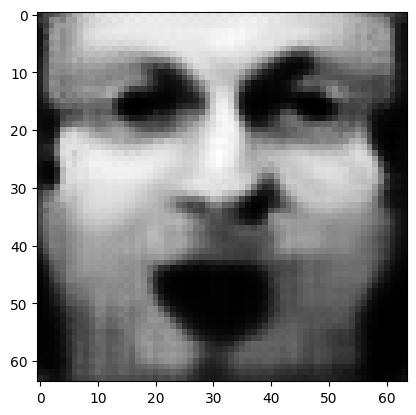

tensor([[4.7336e-04, 8.3300e-01, 1.5572e-05, 2.7888e-03, 3.0424e-05, 3.8978e-07,
         6.6920e-05, 1.4381e-05, 7.5731e-06, 8.0230e-06, 3.7359e-03, 3.8473e-04,
         2.3380e-03, 9.2606e-03, 2.5168e-03, 1.6704e-03, 2.1815e-04, 4.0755e-05,
         5.1986e-03, 7.8851e-04, 1.1788e-02, 7.0146e-03, 8.2818e-07, 3.3103e-03,
         5.1914e-04, 9.4129e-06, 5.7123e-03, 6.4357e-04, 4.3086e-03, 1.6499e-03,
         4.3156e-03, 1.2833e-03, 3.8295e-04, 6.4422e-02, 4.4140e-05, 1.0402e-03,
         5.1888e-03, 7.3777e-03, 8.9782e-03, 9.4489e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18271669745445251
tensor([[4.7149e-04, 8.3510e-01, 1.5208e-05, 2.7572e-03, 2.9942e-05, 3.8474e-07,
         6.5662e-05, 1.4189e-05, 7.3577e-06, 7.8601e-06, 3.6748e-03, 3.7890e-04,
         2.3098e-03, 9.1409e-03, 2.4791e-03, 1.6574e-03, 2.1362e-04, 4.0171e-05,
         5.1542e-03, 7.7804e-04, 1.1584e-02, 6.9151e-03, 8.0455e-07, 3.2726e-03,
         5.0784e-04, 9.2336e-06, 5.6485e-0

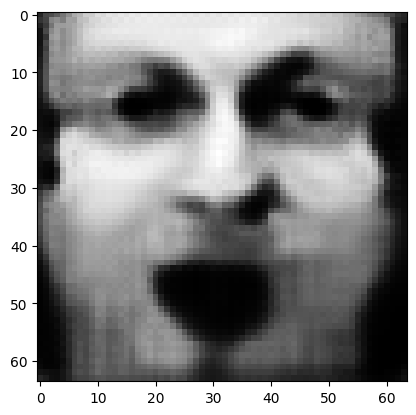

tensor([[4.6492e-04, 8.4275e-01, 1.3909e-05, 2.6360e-03, 2.8155e-05, 3.6605e-07,
         6.1225e-05, 1.3505e-05, 6.6077e-06, 7.2838e-06, 3.4548e-03, 3.5802e-04,
         2.2087e-03, 8.7012e-03, 2.3386e-03, 1.6108e-03, 1.9757e-04, 3.8047e-05,
         4.9937e-03, 7.3948e-04, 1.0839e-02, 6.5504e-03, 7.2057e-07, 3.1390e-03,
         4.6851e-04, 8.5824e-06, 5.4193e-03, 5.8270e-04, 3.9842e-03, 1.5446e-03,
         4.0134e-03, 1.2282e-03, 3.5396e-04, 6.1495e-02, 3.9258e-05, 9.9884e-04,
         4.7916e-03, 6.8111e-03, 8.2744e-03, 8.8330e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.171083003282547
tensor([[4.6340e-04, 8.4450e-01, 1.3619e-05, 2.6080e-03, 2.7743e-05, 3.6178e-07,
         6.0241e-05, 1.3350e-05, 6.4441e-06, 7.1552e-06, 3.4052e-03, 3.5326e-04,
         2.1859e-03, 8.5993e-03, 2.3065e-03, 1.6003e-03, 1.9398e-04, 3.7567e-05,
         4.9571e-03, 7.3076e-04, 1.0669e-02, 6.4669e-03, 7.0198e-07, 3.1091e-03,
         4.5977e-04, 8.4341e-06, 5.3675e-03,

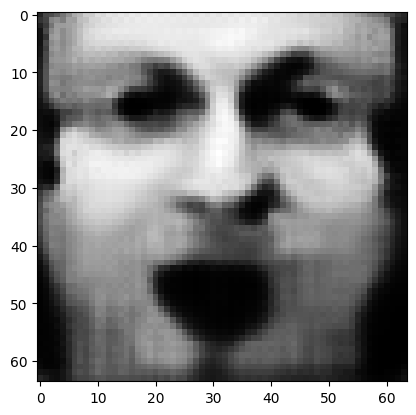

tensor([[4.5726e-04, 8.5096e-01, 1.2585e-05, 2.5088e-03, 2.6253e-05, 3.4629e-07,
         5.6648e-05, 1.2782e-05, 5.8614e-06, 6.6862e-06, 3.2229e-03, 3.3567e-04,
         2.0997e-03, 8.2226e-03, 2.1896e-03, 1.5607e-03, 1.8092e-04, 3.5819e-05,
         4.8203e-03, 6.9933e-04, 1.0058e-02, 6.1626e-03, 6.3594e-07, 2.9974e-03,
         4.2768e-04, 7.8991e-06, 5.1705e-03, 5.3347e-04, 3.7205e-03, 1.4570e-03,
         3.7594e-03, 1.1800e-03, 3.3035e-04, 5.8952e-02, 3.5390e-05, 9.6317e-04,
         4.4601e-03, 6.3481e-03, 7.6989e-03, 8.3203e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1613883227109909
tensor([[4.5590e-04, 8.5246e-01, 1.2352e-05, 2.4850e-03, 2.5907e-05, 3.4276e-07,
         5.5842e-05, 1.2656e-05, 5.7321e-06, 6.5805e-06, 3.1812e-03, 3.3162e-04,
         2.0800e-03, 8.1360e-03, 2.1620e-03, 1.5518e-03, 1.7801e-04, 3.5417e-05,
         4.7878e-03, 6.9187e-04, 9.9160e-03, 6.0922e-03, 6.2106e-07, 2.9719e-03,
         4.2064e-04, 7.7761e-06, 5.1251e-03

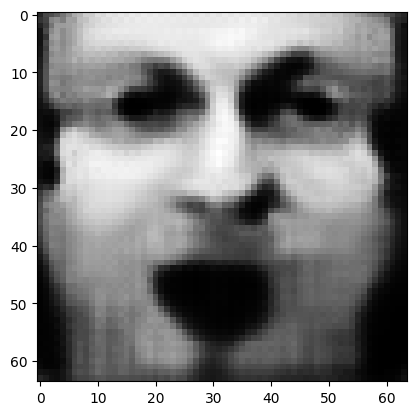

tensor([[4.5039e-04, 8.5800e-01, 1.1512e-05, 2.3991e-03, 2.4643e-05, 3.2971e-07,
         5.2861e-05, 1.2179e-05, 5.2668e-06, 6.1924e-06, 3.0277e-03, 3.1666e-04,
         2.0061e-03, 7.8141e-03, 2.0613e-03, 1.5180e-03, 1.6728e-04, 3.3931e-05,
         4.6676e-03, 6.6485e-04, 9.4015e-03, 5.8323e-03, 5.6783e-07, 2.8761e-03,
         3.9450e-04, 7.3287e-06, 4.9561e-03, 4.9278e-04, 3.5008e-03, 1.3826e-03,
         3.5428e-03, 1.1383e-03, 3.1069e-04, 5.6714e-02, 3.2257e-05, 9.3165e-04,
         4.1795e-03, 5.9642e-03, 7.2151e-03, 7.8867e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15315145254135132
tensor([[4.4895e-04, 8.5929e-01, 1.1319e-05, 2.3799e-03, 2.4352e-05, 3.2668e-07,
         5.2163e-05, 1.2065e-05, 5.1608e-06, 6.1022e-06, 2.9919e-03, 3.1313e-04,
         1.9884e-03, 7.7379e-03, 2.0384e-03, 1.5098e-03, 1.6476e-04, 3.3588e-05,
         4.6390e-03, 6.5874e-04, 9.2838e-03, 5.7720e-03, 5.5584e-07, 2.8532e-03,
         3.8830e-04, 7.2255e-06, 4.9153e-0

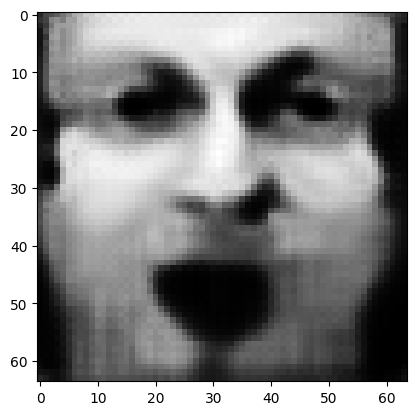

tensor([[4.4402e-04, 8.6414e-01, 1.0610e-05, 2.3040e-03, 2.3256e-05, 3.1519e-07,
         4.9626e-05, 1.1647e-05, 4.7782e-06, 5.7720e-06, 2.8586e-03, 3.0023e-04,
         1.9245e-03, 7.4556e-03, 1.9511e-03, 1.4794e-03, 1.5562e-04, 3.2312e-05,
         4.5306e-03, 6.3514e-04, 8.8414e-03, 5.5451e-03, 5.1205e-07, 2.7696e-03,
         3.6614e-04, 6.8436e-06, 4.7653e-03, 4.5827e-04, 3.3114e-03, 1.3180e-03,
         3.3558e-03, 1.1010e-03, 2.9383e-04, 5.4737e-02, 2.9632e-05, 9.0364e-04,
         3.9371e-03, 5.6343e-03, 6.7998e-03, 7.5082e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14602027833461761
tensor([[4.4291e-04, 8.6528e-01, 1.0447e-05, 2.2856e-03, 2.3000e-05, 3.1243e-07,
         4.9031e-05, 1.1549e-05, 4.6905e-06, 5.6958e-06, 2.8272e-03, 2.9723e-04,
         1.9096e-03, 7.3894e-03, 1.9305e-03, 1.4720e-03, 1.5348e-04, 3.2013e-05,
         4.5043e-03, 6.2952e-04, 8.7384e-03, 5.4914e-03, 5.0204e-07, 2.7498e-03,
         3.6102e-04, 6.7546e-06, 4.7295e-0

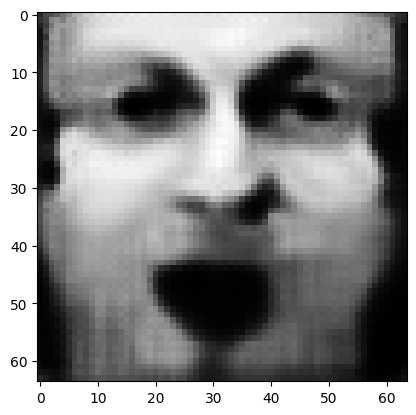

tensor([[4.3858e-04, 8.6955e-01, 9.8438e-06, 2.2182e-03, 2.2050e-05, 3.0231e-07,
         4.6841e-05, 1.1181e-05, 4.3712e-06, 5.4124e-06, 2.7106e-03, 2.8605e-04,
         1.8539e-03, 7.1422e-03, 1.8540e-03, 1.4448e-03, 1.4563e-04, 3.0915e-05,
         4.4043e-03, 6.0863e-04, 8.3567e-03, 5.2914e-03, 4.6569e-07, 2.6755e-03,
         3.4199e-04, 6.4270e-06, 4.5949e-03, 4.2874e-04, 3.1477e-03, 1.2615e-03,
         3.1941e-03, 1.0675e-03, 2.7926e-04, 5.2965e-02, 2.7420e-05, 8.7821e-04,
         3.7260e-03, 5.3501e-03, 6.4397e-03, 7.1782e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13977757096290588
tensor([[4.3760e-04, 8.7054e-01, 9.7062e-06, 2.2023e-03, 2.1829e-05, 2.9997e-07,
         4.6345e-05, 1.1097e-05, 4.2992e-06, 5.3479e-06, 2.6839e-03, 2.8348e-04,
         1.8411e-03, 7.0844e-03, 1.8360e-03, 1.4387e-03, 1.4385e-04, 3.0662e-05,
         4.3813e-03, 6.0375e-04, 8.2677e-03, 5.2450e-03, 4.5742e-07, 2.6586e-03,
         3.3770e-04, 6.3512e-06, 4.5642e-0

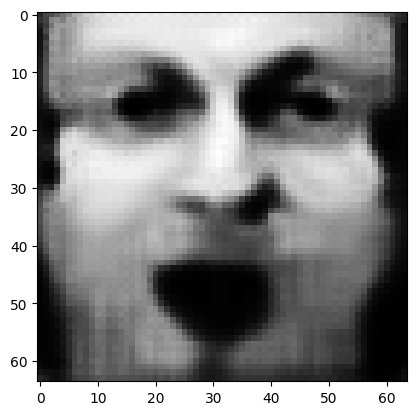

tensor([[4.3375e-04, 8.7428e-01, 9.1995e-06, 2.1435e-03, 2.1012e-05, 2.9122e-07,
         4.4487e-05, 1.0779e-05, 4.0347e-06, 5.1078e-06, 2.5839e-03, 2.7384e-04,
         1.7924e-03, 6.8675e-03, 1.7694e-03, 1.4154e-03, 1.3720e-04, 2.9714e-05,
         4.2945e-03, 5.8561e-04, 7.9383e-03, 5.0714e-03, 4.2721e-07, 2.5938e-03,
         3.2163e-04, 6.0713e-06, 4.4475e-03, 4.0373e-04, 3.0074e-03, 1.2125e-03,
         3.0538e-03, 1.0384e-03, 2.6676e-04, 5.1386e-02, 2.5561e-05, 8.5572e-04,
         3.5437e-03, 5.1068e-03, 6.1295e-03, 6.8944e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13435982167720795
tensor([[4.3275e-04, 8.7515e-01, 9.0825e-06, 2.1304e-03, 2.0825e-05, 2.8921e-07,
         4.4051e-05, 1.0703e-05, 3.9739e-06, 5.0516e-06, 2.5605e-03, 2.7157e-04,
         1.7807e-03, 6.8164e-03, 1.7541e-03, 1.4097e-03, 1.3565e-04, 2.9493e-05,
         4.2739e-03, 5.8145e-04, 7.8627e-03, 5.0312e-03, 4.2037e-07, 2.5783e-03,
         3.1781e-04, 6.0072e-06, 4.4196e-0

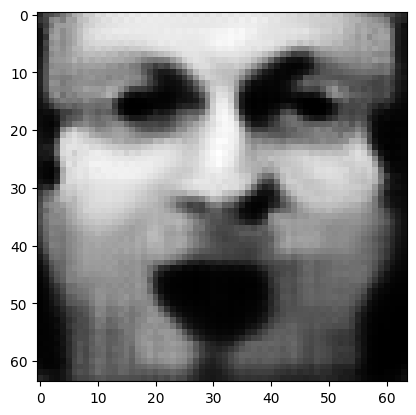

tensor([[4.2924e-04, 8.7844e-01, 8.6489e-06, 2.0786e-03, 2.0112e-05, 2.8154e-07,
         4.2443e-05, 1.0424e-05, 3.7502e-06, 4.8438e-06, 2.4733e-03, 2.6314e-04,
         1.7374e-03, 6.6259e-03, 1.6957e-03, 1.3887e-03, 1.2994e-04, 2.8663e-05,
         4.1965e-03, 5.6533e-04, 7.5753e-03, 4.8786e-03, 3.9500e-07, 2.5207e-03,
         3.0401e-04, 5.7661e-06, 4.3163e-03, 3.8211e-04, 2.8837e-03, 1.1691e-03,
         2.9306e-03, 1.0129e-03, 2.5585e-04, 4.9979e-02, 2.3969e-05, 8.3558e-04,
         3.3848e-03, 4.8949e-03, 5.8581e-03, 6.6425e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12960435450077057
tensor([[4.2837e-04, 8.7925e-01, 8.5445e-06, 2.0660e-03, 1.9941e-05, 2.7964e-07,
         4.2063e-05, 1.0357e-05, 3.6971e-06, 4.7946e-06, 2.4520e-03, 2.6108e-04,
         1.7261e-03, 6.5781e-03, 1.6816e-03, 1.3833e-03, 1.2856e-04, 2.8456e-05,
         4.1789e-03, 5.6140e-04, 7.5045e-03, 4.8426e-03, 3.8897e-07, 2.5069e-03,
         3.0075e-04, 5.7084e-06, 4.2906e-0

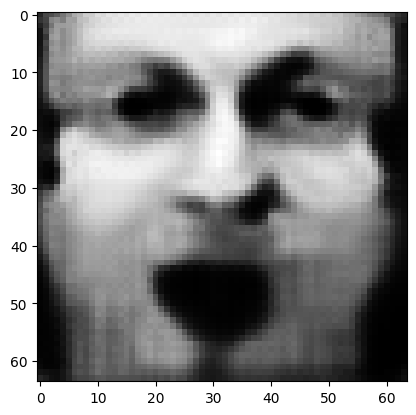

tensor([[4.2504e-04, 8.8227e-01, 8.1564e-06, 2.0188e-03, 1.9296e-05, 2.7249e-07,
         4.0626e-05, 1.0103e-05, 3.5009e-06, 4.6109e-06, 2.3726e-03, 2.5331e-04,
         1.6833e-03, 6.3970e-03, 1.6292e-03, 1.3626e-03, 1.2338e-04, 2.7678e-05,
         4.1116e-03, 5.4675e-04, 7.2403e-03, 4.7069e-03, 3.6676e-07, 2.4542e-03,
         2.8849e-04, 5.4913e-06, 4.1929e-03, 3.6272e-04, 2.7716e-03, 1.1302e-03,
         2.8183e-03, 9.8901e-04, 2.4601e-04, 4.8677e-02, 2.2583e-05, 8.1745e-04,
         3.2415e-03, 4.7034e-03, 5.6128e-03, 6.4106e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12525674700737
tensor([[4.2430e-04, 8.8298e-01, 8.0666e-06, 2.0075e-03, 1.9145e-05, 2.7080e-07,
         4.0292e-05, 1.0044e-05, 3.4558e-06, 4.5683e-06, 2.3540e-03, 2.5150e-04,
         1.6733e-03, 6.3545e-03, 1.6169e-03, 1.3578e-03, 1.2219e-04, 2.7496e-05,
         4.0959e-03, 5.4327e-04, 7.1784e-03, 4.6749e-03, 3.6163e-07, 2.4419e-03,
         2.8568e-04, 5.4407e-06, 4.1702e-03, 

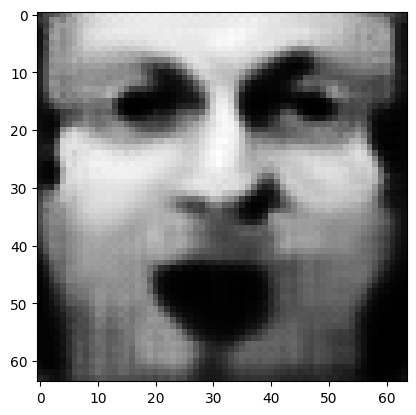

tensor([[4.2140e-04, 8.8567e-01, 7.7301e-06, 1.9653e-03, 1.8574e-05, 2.6447e-07,
         3.9038e-05, 9.8199e-06, 3.2874e-06, 4.4077e-06, 2.2839e-03, 2.4466e-04,
         1.6354e-03, 6.1943e-03, 1.5705e-03, 1.3390e-03, 1.1769e-04, 2.6812e-05,
         4.0358e-03, 5.3016e-04, 6.9457e-03, 4.5543e-03, 3.4271e-07, 2.3951e-03,
         2.7503e-04, 5.2514e-06, 4.0835e-03, 3.4585e-04, 2.6732e-03, 1.0955e-03,
         2.7189e-03, 9.6758e-04, 2.3733e-04, 4.7503e-02, 2.1386e-05, 8.0116e-04,
         3.1159e-03, 4.5351e-03, 5.3973e-03, 6.2057e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12140583246946335
tensor([[4.2067e-04, 8.8631e-01, 7.6519e-06, 1.9559e-03, 1.8442e-05, 2.6300e-07,
         3.8742e-05, 9.7663e-06, 3.2481e-06, 4.3699e-06, 2.2673e-03, 2.4305e-04,
         1.6264e-03, 6.1563e-03, 1.5597e-03, 1.3345e-03, 1.1663e-04, 2.6651e-05,
         4.0216e-03, 5.2714e-04, 6.8919e-03, 4.5259e-03, 3.3835e-07, 2.3840e-03,
         2.7247e-04, 5.2076e-06, 4.0628e-0

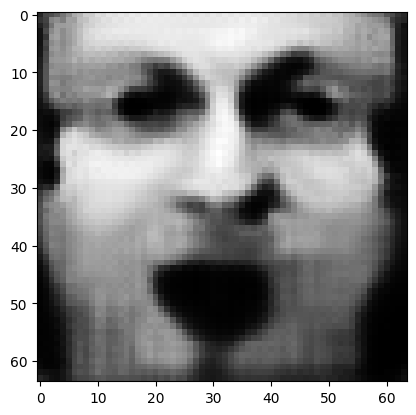

tensor([[4.1808e-04, 8.8873e-01, 7.3581e-06, 1.9181e-03, 1.7935e-05, 2.5735e-07,
         3.7636e-05, 9.5664e-06, 3.1021e-06, 4.2288e-06, 2.2051e-03, 2.3699e-04,
         1.5924e-03, 6.0132e-03, 1.5182e-03, 1.3177e-03, 1.1268e-04, 2.6039e-05,
         3.9677e-03, 5.1535e-04, 6.6854e-03, 4.4179e-03, 3.2203e-07, 2.3420e-03,
         2.6314e-04, 5.0416e-06, 3.9854e-03, 3.3103e-04, 2.5852e-03, 1.0641e-03,
         2.6299e-03, 9.4842e-04, 2.2958e-04, 4.6440e-02, 2.0337e-05, 7.8636e-04,
         3.0045e-03, 4.3851e-03, 5.2053e-03, 6.0228e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11796559393405914
tensor([[4.1749e-04, 8.8930e-01, 7.2895e-06, 1.9091e-03, 1.7815e-05, 2.5602e-07,
         3.7381e-05, 9.5200e-06, 3.0684e-06, 4.1959e-06, 2.1906e-03, 2.3558e-04,
         1.5844e-03, 5.9795e-03, 1.5083e-03, 1.3137e-03, 1.1177e-04, 2.5895e-05,
         3.9551e-03, 5.1253e-04, 6.6364e-03, 4.3924e-03, 3.1823e-07, 2.3323e-03,
         2.6099e-04, 5.0027e-06, 3.9674e-0

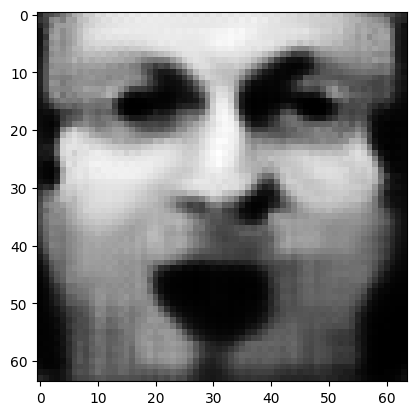

tensor([[4.1515e-04, 8.9148e-01, 7.0308e-06, 1.8749e-03, 1.7361e-05, 2.5097e-07,
         3.6402e-05, 9.3420e-06, 2.9410e-06, 4.0708e-06, 2.1351e-03, 2.3017e-04,
         1.5539e-03, 5.8510e-03, 1.4710e-03, 1.2987e-03, 1.0829e-04, 2.5348e-05,
         3.9062e-03, 5.0188e-04, 6.4523e-03, 4.2952e-03, 3.0400e-07, 2.2947e-03,
         2.5278e-04, 4.8553e-06, 3.8978e-03, 3.1796e-04, 2.5070e-03, 1.0359e-03,
         2.5503e-03, 9.3119e-04, 2.2266e-04, 4.5469e-02, 1.9419e-05, 7.7286e-04,
         2.9051e-03, 4.2520e-03, 5.0347e-03, 5.8592e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11487742513418198
tensor([[4.1463e-04, 8.9199e-01, 6.9701e-06, 1.8667e-03, 1.7253e-05, 2.4977e-07,
         3.6172e-05, 9.3001e-06, 2.9113e-06, 4.0415e-06, 2.1220e-03, 2.2889e-04,
         1.5468e-03, 5.8208e-03, 1.4621e-03, 1.2951e-03, 1.0748e-04, 2.5218e-05,
         3.8945e-03, 4.9933e-04, 6.4086e-03, 4.2721e-03, 3.0069e-07, 2.2858e-03,
         2.5087e-04, 4.8205e-06, 3.8814e-0

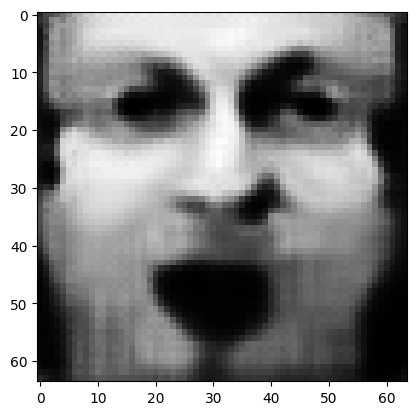

tensor([[4.1243e-04, 8.9396e-01, 6.7411e-06, 1.8361e-03, 1.6847e-05, 2.4523e-07,
         3.5290e-05, 9.1381e-06, 2.7990e-06, 3.9295e-06, 2.0720e-03, 2.2401e-04,
         1.5188e-03, 5.7042e-03, 1.4287e-03, 1.2812e-03, 1.0436e-04, 2.4723e-05,
         3.8500e-03, 4.8977e-04, 6.2440e-03, 4.1844e-03, 2.8822e-07, 2.2513e-03,
         2.4349e-04, 4.6890e-06, 3.8178e-03, 3.0627e-04, 2.4363e-03, 1.0104e-03,
         2.4785e-03, 9.1549e-04, 2.1644e-04, 4.4587e-02, 1.8604e-05, 7.6053e-04,
         2.8158e-03, 4.1324e-03, 4.8810e-03, 5.7114e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11209123581647873
tensor([[4.1193e-04, 8.9444e-01, 6.6865e-06, 1.8284e-03, 1.6749e-05, 2.4413e-07,
         3.5081e-05, 9.0996e-06, 2.7725e-06, 3.9030e-06, 2.0601e-03, 2.2284e-04,
         1.5121e-03, 5.6764e-03, 1.4206e-03, 1.2779e-03, 1.0362e-04, 2.4604e-05,
         3.8392e-03, 4.8743e-04, 6.2042e-03, 4.1634e-03, 2.8526e-07, 2.2431e-03,
         2.4177e-04, 4.6574e-06, 3.8027e-0

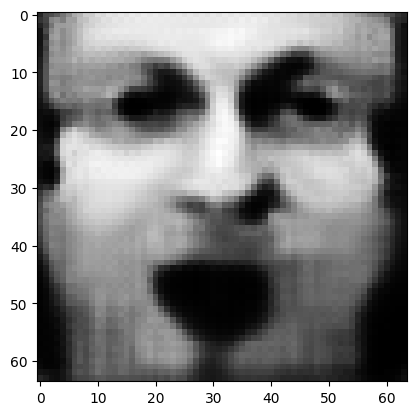

tensor([[4.0996e-04, 8.9623e-01, 6.4821e-06, 1.8000e-03, 1.6380e-05, 2.3999e-07,
         3.4290e-05, 8.9528e-06, 2.6732e-06, 3.8025e-06, 2.0151e-03, 2.1842e-04,
         1.4869e-03, 5.5715e-03, 1.3902e-03, 1.2651e-03, 1.0085e-04, 2.4155e-05,
         3.7983e-03, 4.7860e-04, 6.0546e-03, 4.0837e-03, 2.7426e-07, 2.2116e-03,
         2.3523e-04, 4.5390e-06, 3.7452e-03, 2.9578e-04, 2.3724e-03, 9.8722e-04,
         2.4136e-03, 9.0121e-04, 2.1080e-04, 4.3780e-02, 1.7878e-05, 7.4926e-04,
         2.7352e-03, 4.0243e-03, 4.7424e-03, 5.5763e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10956161469221115
tensor([[4.0940e-04, 8.9665e-01, 6.4343e-06, 1.7937e-03, 1.6295e-05, 2.3901e-07,
         3.4095e-05, 8.9163e-06, 2.6496e-06, 3.7780e-06, 2.0043e-03, 2.1735e-04,
         1.4809e-03, 5.5471e-03, 1.3831e-03, 1.2619e-03, 1.0018e-04, 2.4049e-05,
         3.7879e-03, 4.7655e-04, 6.0204e-03, 4.0648e-03, 2.7170e-07, 2.2037e-03,
         2.3361e-04, 4.5112e-06, 3.7311e-0

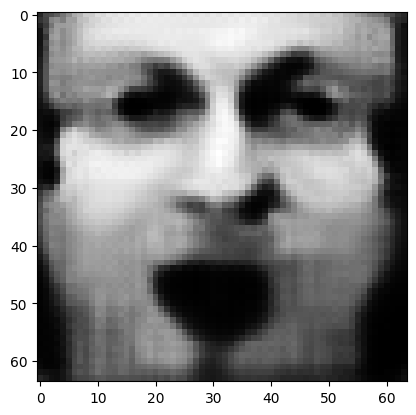

tensor([[4.0739e-04, 8.9827e-01, 6.2529e-06, 1.7681e-03, 1.5963e-05, 2.3525e-07,
         3.3366e-05, 8.7797e-06, 2.5609e-06, 3.6858e-06, 1.9635e-03, 2.1332e-04,
         1.4583e-03, 5.4548e-03, 1.3559e-03, 1.2501e-03, 9.7673e-05, 2.3646e-05,
         3.7485e-03, 4.6849e-04, 5.8875e-03, 3.9921e-03, 2.6201e-07, 2.1742e-03,
         2.2766e-04, 4.4048e-06, 3.6786e-03, 2.8631e-04, 2.3138e-03, 9.6603e-04,
         2.3551e-03, 8.8853e-04, 2.0569e-04, 4.3057e-02, 1.7220e-05, 7.3877e-04,
         2.6626e-03, 3.9264e-03, 4.6166e-03, 5.4512e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10728539526462555
tensor([[4.0687e-04, 8.9865e-01, 6.2101e-06, 1.7624e-03, 1.5886e-05, 2.3437e-07,
         3.3191e-05, 8.7464e-06, 2.5399e-06, 3.6636e-06, 1.9538e-03, 2.1235e-04,
         1.4529e-03, 5.4326e-03, 1.3496e-03, 1.2473e-03, 9.7070e-05, 2.3552e-05,
         3.7390e-03, 4.6662e-04, 5.8564e-03, 3.9748e-03, 2.5974e-07, 2.1671e-03,
         2.2620e-04, 4.3796e-06, 3.6659e-0

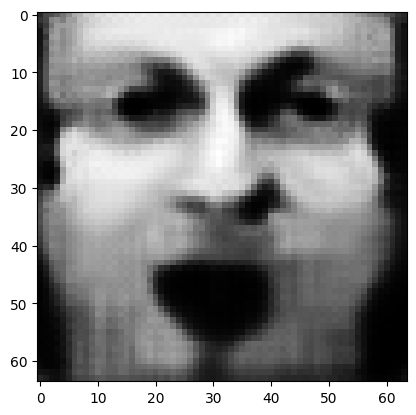

tensor([[4.0508e-04, 9.0012e-01, 6.0501e-06, 1.7387e-03, 1.5590e-05, 2.3105e-07,
         3.2532e-05, 8.6238e-06, 2.4610e-06, 3.5821e-06, 1.9172e-03, 2.0874e-04,
         1.4324e-03, 5.3506e-03, 1.3247e-03, 1.2367e-03, 9.4823e-05, 2.3182e-05,
         3.7033e-03, 4.5919e-04, 5.7358e-03, 3.9084e-03, 2.5121e-07, 2.1397e-03,
         2.2093e-04, 4.2848e-06, 3.6193e-03, 2.7782e-04, 2.2604e-03, 9.4678e-04,
         2.3022e-03, 8.7710e-04, 2.0104e-04, 4.2395e-02, 1.6631e-05, 7.2927e-04,
         2.5967e-03, 3.8379e-03, 4.5022e-03, 5.3400e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10522215068340302
tensor([[4.0467e-04, 9.0047e-01, 6.0126e-06, 1.7329e-03, 1.5519e-05, 2.3026e-07,
         3.2378e-05, 8.5950e-06, 2.4425e-06, 3.5630e-06, 1.9086e-03, 2.0790e-04,
         1.4276e-03, 5.3313e-03, 1.3187e-03, 1.2343e-03, 9.4298e-05, 2.3094e-05,
         3.6949e-03, 4.5740e-04, 5.7070e-03, 3.8926e-03, 2.4920e-07, 2.1332e-03,
         2.1970e-04, 4.2625e-06, 3.6084e-0

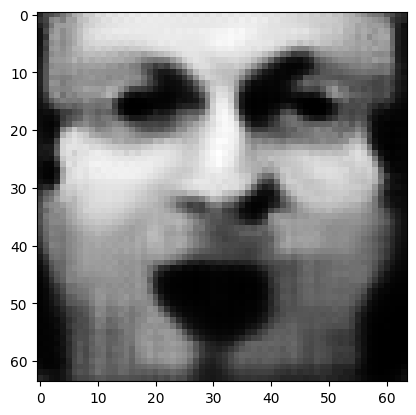

tensor([[4.0297e-04, 9.0182e-01, 5.8689e-06, 1.7115e-03, 1.5252e-05, 2.2726e-07,
         3.1777e-05, 8.4821e-06, 2.3716e-06, 3.4890e-06, 1.8753e-03, 2.0460e-04,
         1.4086e-03, 5.2565e-03, 1.2960e-03, 1.2244e-03, 9.2253e-05, 2.2756e-05,
         3.6622e-03, 4.5060e-04, 5.5975e-03, 3.8321e-03, 2.4161e-07, 2.1076e-03,
         2.1490e-04, 4.1771e-06, 3.5657e-03, 2.7017e-04, 2.2116e-03, 9.2918e-04,
         2.2542e-03, 8.6672e-04, 1.9678e-04, 4.1786e-02, 1.6100e-05, 7.2057e-04,
         2.5369e-03, 3.7576e-03, 4.3976e-03, 5.2399e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10334053635597229
tensor([[4.0258e-04, 9.0214e-01, 5.8344e-06, 1.7061e-03, 1.5187e-05, 2.2652e-07,
         3.1634e-05, 8.4552e-06, 2.3548e-06, 3.4714e-06, 1.8673e-03, 2.0382e-04,
         1.4041e-03, 5.2386e-03, 1.2905e-03, 1.2221e-03, 9.1768e-05, 2.2674e-05,
         3.6543e-03, 4.4893e-04, 5.5708e-03, 3.8175e-03, 2.3979e-07, 2.1015e-03,
         2.1378e-04, 4.1564e-06, 3.5555e-0

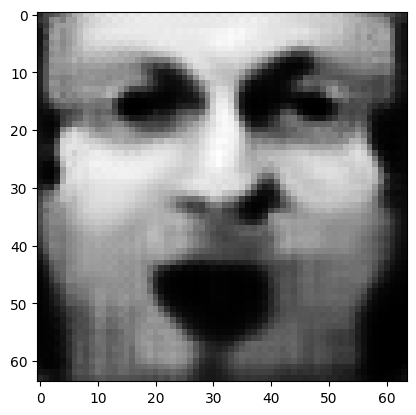

tensor([[4.0093e-04, 9.0339e-01, 5.7035e-06, 1.6862e-03, 1.4941e-05, 2.2372e-07,
         3.1082e-05, 8.3498e-06, 2.2904e-06, 3.4034e-06, 1.8366e-03, 2.0076e-04,
         1.3863e-03, 5.1695e-03, 1.2698e-03, 1.2127e-03, 8.9888e-05, 2.2359e-05,
         3.6240e-03, 4.4265e-04, 5.4700e-03, 3.7619e-03, 2.3292e-07, 2.0776e-03,
         2.0937e-04, 4.0781e-06, 3.5158e-03, 2.6314e-04, 2.1665e-03, 9.1296e-04,
         2.2100e-03, 8.5707e-04, 1.9287e-04, 4.1224e-02, 1.5616e-05, 7.1253e-04,
         2.4819e-03, 3.6835e-03, 4.3013e-03, 5.1462e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10160604864358902
tensor([[4.0056e-04, 9.0368e-01, 5.6723e-06, 1.6813e-03, 1.4881e-05, 2.2304e-07,
         3.0951e-05, 8.3249e-06, 2.2751e-06, 3.3873e-06, 1.8292e-03, 2.0003e-04,
         1.3821e-03, 5.1529e-03, 1.2647e-03, 1.2105e-03, 8.9443e-05, 2.2283e-05,
         3.6168e-03, 4.4112e-04, 5.4457e-03, 3.7485e-03, 2.3127e-07, 2.0720e-03,
         2.0834e-04, 4.0592e-06, 3.5064e-0

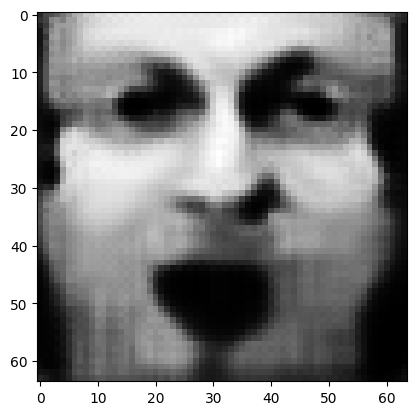

tensor([[3.9902e-04, 9.0483e-01, 5.5527e-06, 1.6628e-03, 1.4654e-05, 2.2043e-07,
         3.0439e-05, 8.2277e-06, 2.2166e-06, 3.3253e-06, 1.8009e-03, 1.9720e-04,
         1.3657e-03, 5.0888e-03, 1.2455e-03, 1.2018e-03, 8.7720e-05, 2.1989e-05,
         3.5882e-03, 4.3532e-04, 5.3535e-03, 3.6971e-03, 2.2503e-07, 2.0498e-03,
         2.0431e-04, 3.9870e-06, 3.4694e-03, 2.5672e-04, 2.1251e-03, 8.9801e-04,
         2.1694e-03, 8.4796e-04, 1.8925e-04, 4.0702e-02, 1.5175e-05, 7.0498e-04,
         2.4314e-03, 3.6149e-03, 4.2127e-03, 5.0608e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10000436007976532
tensor([[3.9868e-04, 9.0511e-01, 5.5240e-06, 1.6581e-03, 1.4599e-05, 2.1979e-07,
         3.0318e-05, 8.2049e-06, 2.2026e-06, 3.3105e-06, 1.7941e-03, 1.9652e-04,
         1.3618e-03, 5.0734e-03, 1.2408e-03, 1.1997e-03, 8.7312e-05, 2.1918e-05,
         3.5813e-03, 4.3389e-04, 5.3311e-03, 3.6847e-03, 2.2353e-07, 2.0446e-03,
         2.0336e-04, 3.9696e-06, 3.4607e-0

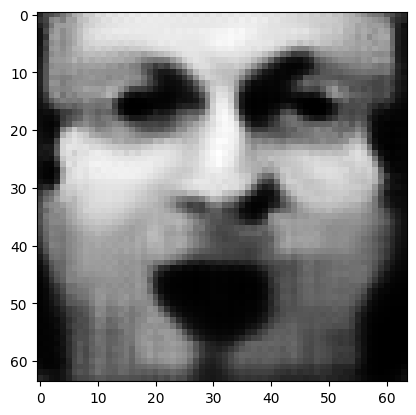

tensor([[3.9731e-04, 9.0617e-01, 5.4146e-06, 1.6406e-03, 1.4389e-05, 2.1736e-07,
         2.9850e-05, 8.1161e-06, 2.1495e-06, 3.2539e-06, 1.7680e-03, 1.9393e-04,
         1.3468e-03, 5.0144e-03, 1.2229e-03, 1.1917e-03, 8.5743e-05, 2.1646e-05,
         3.5546e-03, 4.2848e-04, 5.2461e-03, 3.6371e-03, 2.1785e-07, 2.0243e-03,
         1.9972e-04, 3.9031e-06, 3.4267e-03, 2.5086e-04, 2.0873e-03, 8.8419e-04,
         2.1319e-03, 8.3945e-04, 1.8592e-04, 4.0215e-02, 1.4773e-05, 6.9790e-04,
         2.3850e-03, 3.5517e-03, 4.1315e-03, 4.9825e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09852303564548492
tensor([[3.9697e-04, 9.0643e-01, 5.3887e-06, 1.6367e-03, 1.4339e-05, 2.1679e-07,
         2.9737e-05, 8.0947e-06, 2.1368e-06, 3.2403e-06, 1.7617e-03, 1.9330e-04,
         1.3431e-03, 5.0001e-03, 1.2187e-03, 1.1897e-03, 8.5365e-05, 2.1582e-05,
         3.5483e-03, 4.2723e-04, 5.2261e-03, 3.6258e-03, 2.1651e-07, 2.0193e-03,
         1.9882e-04, 3.8874e-06, 3.4184e-0

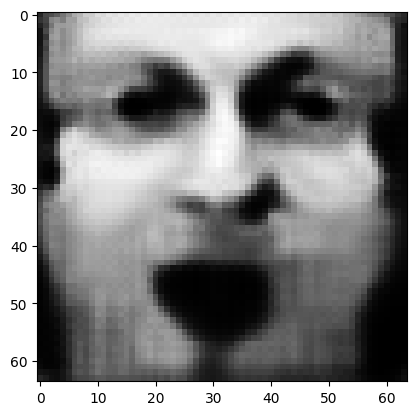

tensor([[3.9571e-04, 9.0741e-01, 5.2889e-06, 1.6205e-03, 1.4145e-05, 2.1455e-07,
         2.9312e-05, 8.0137e-06, 2.0887e-06, 3.1885e-06, 1.7379e-03, 1.9091e-04,
         1.3292e-03, 4.9455e-03, 1.2022e-03, 1.1823e-03, 8.3935e-05, 2.1333e-05,
         3.5237e-03, 4.2225e-04, 5.1479e-03, 3.5820e-03, 2.1136e-07, 2.0007e-03,
         1.9549e-04, 3.8264e-06, 3.3869e-03, 2.4549e-04, 2.0526e-03, 8.7146e-04,
         2.0973e-03, 8.3156e-04, 1.8288e-04, 3.9764e-02, 1.4408e-05, 6.9133e-04,
         2.3424e-03, 3.4939e-03, 4.0571e-03, 4.9103e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09716002643108368
tensor([[3.9539e-04, 9.0765e-01, 5.2650e-06, 1.6168e-03, 1.4099e-05, 2.1402e-07,
         2.9209e-05, 7.9938e-06, 2.0771e-06, 3.1759e-06, 1.7321e-03, 1.9033e-04,
         1.3258e-03, 4.9323e-03, 1.1983e-03, 1.1805e-03, 8.3586e-05, 2.1274e-05,
         3.5178e-03, 4.2109e-04, 5.1294e-03, 3.5715e-03, 2.1014e-07, 1.9961e-03,
         1.9467e-04, 3.8118e-06, 3.3792e-0

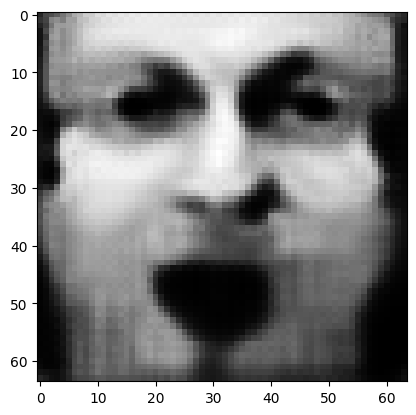

tensor([[3.9420e-04, 9.0855e-01, 5.1740e-06, 1.6021e-03, 1.3922e-05, 2.1200e-07,
         2.8820e-05, 7.9190e-06, 2.0338e-06, 3.1289e-06, 1.7103e-03, 1.8813e-04,
         1.3132e-03, 4.8823e-03, 1.1832e-03, 1.1738e-03, 8.2285e-05, 2.1048e-05,
         3.4948e-03, 4.1657e-04, 5.0580e-03, 3.5311e-03, 2.0550e-07, 1.9789e-03,
         1.9162e-04, 3.7562e-06, 3.3502e-03, 2.4061e-04, 2.0208e-03, 8.5970e-04,
         2.0654e-03, 8.2424e-04, 1.8007e-04, 3.9346e-02, 1.4074e-05, 6.8520e-04,
         2.3032e-03, 3.4409e-03, 3.9887e-03, 4.8447e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09590531140565872
tensor([[3.9387e-04, 9.0876e-01, 5.1524e-06, 1.5987e-03, 1.3881e-05, 2.1153e-07,
         2.8725e-05, 7.9004e-06, 2.0235e-06, 3.1174e-06, 1.7050e-03, 1.8760e-04,
         1.3102e-03, 4.8705e-03, 1.1797e-03, 1.1721e-03, 8.1969e-05, 2.0995e-05,
         3.4890e-03, 4.1554e-04, 5.0414e-03, 3.5215e-03, 2.0441e-07, 1.9747e-03,
         1.9086e-04, 3.7430e-06, 3.3430e-0

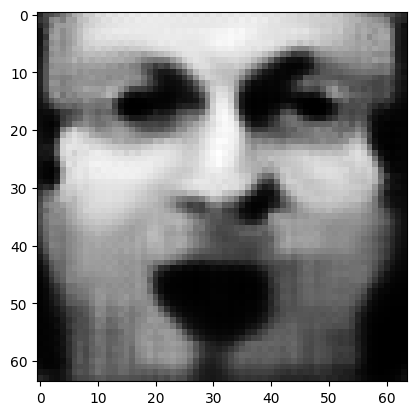

tensor([[3.9273e-04, 9.0959e-01, 5.0691e-06, 1.5854e-03, 1.3721e-05, 2.0971e-07,
         2.8369e-05, 7.8296e-06, 1.9846e-06, 3.0742e-06, 1.6850e-03, 1.8560e-04,
         1.2990e-03, 4.8254e-03, 1.1659e-03, 1.1659e-03, 8.0793e-05, 2.0794e-05,
         3.4669e-03, 4.1140e-04, 4.9765e-03, 3.4844e-03, 2.0028e-07, 1.9588e-03,
         1.8806e-04, 3.6923e-06, 3.3161e-03, 2.3619e-04, 1.9914e-03, 8.4884e-04,
         2.0362e-03, 8.1766e-04, 1.7750e-04, 3.8964e-02, 1.3768e-05, 6.7945e-04,
         2.2671e-03, 3.3925e-03, 3.9259e-03, 4.7848e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09475865215063095
tensor([[3.9246e-04, 9.0979e-01, 5.0492e-06, 1.5821e-03, 1.3682e-05, 2.0928e-07,
         2.8284e-05, 7.8128e-06, 1.9754e-06, 3.0638e-06, 1.6802e-03, 1.8512e-04,
         1.2964e-03, 4.8146e-03, 1.1625e-03, 1.1644e-03, 8.0515e-05, 2.0746e-05,
         3.4616e-03, 4.1040e-04, 4.9608e-03, 3.4754e-03, 1.9929e-07, 1.9551e-03,
         1.8740e-04, 3.6801e-06, 3.3098e-0

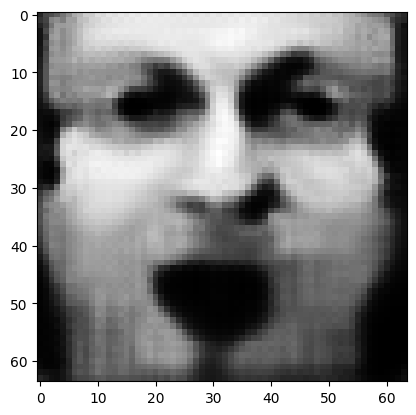

tensor([[3.9137e-04, 9.1056e-01, 4.9726e-06, 1.5699e-03, 1.3534e-05, 2.0760e-07,
         2.7955e-05, 7.7471e-06, 1.9398e-06, 3.0238e-06, 1.6616e-03, 1.8326e-04,
         1.2859e-03, 4.7726e-03, 1.1498e-03, 1.1585e-03, 7.9428e-05, 2.0560e-05,
         3.4410e-03, 4.0660e-04, 4.9011e-03, 3.4411e-03, 1.9550e-07, 1.9403e-03,
         1.8480e-04, 3.6334e-06, 3.2846e-03, 2.3212e-04, 1.9644e-03, 8.3875e-04,
         2.0091e-03, 8.1158e-04, 1.7513e-04, 3.8608e-02, 1.3487e-05, 6.7410e-04,
         2.2339e-03, 3.3479e-03, 3.8681e-03, 4.7290e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09369654208421707
tensor([[3.9112e-04, 9.1074e-01, 4.9543e-06, 1.5669e-03, 1.3499e-05, 2.0719e-07,
         2.7877e-05, 7.7314e-06, 1.9313e-06, 3.0142e-06, 1.6572e-03, 1.8282e-04,
         1.2834e-03, 4.7626e-03, 1.1467e-03, 1.1571e-03, 7.9171e-05, 2.0515e-05,
         3.4361e-03, 4.0567e-04, 4.8866e-03, 3.4328e-03, 1.9460e-07, 1.9368e-03,
         1.8419e-04, 3.6222e-06, 3.2787e-0

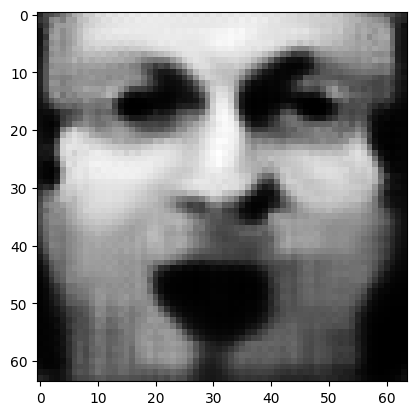

tensor([[3.9010e-04, 9.1146e-01, 4.8837e-06, 1.5556e-03, 1.3362e-05, 2.0563e-07,
         2.7573e-05, 7.6703e-06, 1.8985e-06, 2.9773e-06, 1.6399e-03, 1.8109e-04,
         1.2737e-03, 4.7235e-03, 1.1349e-03, 1.1517e-03, 7.8166e-05, 2.0343e-05,
         3.4170e-03, 4.0214e-04, 4.8313e-03, 3.4009e-03, 1.9112e-07, 1.9231e-03,
         1.8179e-04, 3.5790e-06, 3.2553e-03, 2.2837e-04, 1.9393e-03, 8.2937e-04,
         1.9840e-03, 8.0591e-04, 1.7293e-04, 3.8276e-02, 1.3229e-05, 6.6909e-04,
         2.2030e-03, 3.3067e-03, 3.8145e-03, 4.6774e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09271001070737839
tensor([[3.8987e-04, 9.1163e-01, 4.8666e-06, 1.5527e-03, 1.3328e-05, 2.0525e-07,
         2.7499e-05, 7.6558e-06, 1.8906e-06, 2.9684e-06, 1.6358e-03, 1.8068e-04,
         1.2714e-03, 4.7140e-03, 1.1320e-03, 1.1504e-03, 7.7926e-05, 2.0300e-05,
         3.4122e-03, 4.0127e-04, 4.8178e-03, 3.3931e-03, 1.9028e-07, 1.9198e-03,
         1.8122e-04, 3.5684e-06, 3.2496e-0

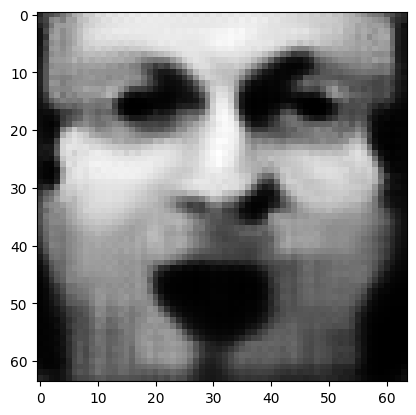

tensor([[3.8890e-04, 9.1232e-01, 4.7995e-06, 1.5418e-03, 1.3199e-05, 2.0372e-07,
         2.7204e-05, 7.5982e-06, 1.8596e-06, 2.9333e-06, 1.6193e-03, 1.7901e-04,
         1.2623e-03, 4.6767e-03, 1.1206e-03, 1.1451e-03, 7.6976e-05, 2.0131e-05,
         3.3930e-03, 3.9787e-04, 4.7659e-03, 3.3628e-03, 1.8700e-07, 1.9066e-03,
         1.7894e-04, 3.5271e-06, 3.2268e-03, 2.2482e-04, 1.9157e-03, 8.2043e-04,
         1.9601e-03, 8.0028e-04, 1.7085e-04, 3.7958e-02, 1.2987e-05, 6.6420e-04,
         2.1740e-03, 3.2671e-03, 3.7639e-03, 4.6290e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09176982194185257
tensor([[3.8869e-04, 9.1248e-01, 4.7834e-06, 1.5390e-03, 1.3167e-05, 2.0335e-07,
         2.7134e-05, 7.5847e-06, 1.8522e-06, 2.9250e-06, 1.6153e-03, 1.7862e-04,
         1.2601e-03, 4.6676e-03, 1.1178e-03, 1.1439e-03, 7.6751e-05, 2.0091e-05,
         3.3884e-03, 3.9704e-04, 4.7533e-03, 3.3554e-03, 1.8622e-07, 1.9036e-03,
         1.7841e-04, 3.5171e-06, 3.2214e-0

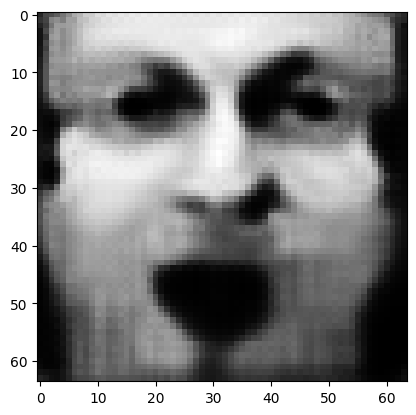

tensor([[3.8777e-04, 9.1312e-01, 4.7214e-06, 1.5288e-03, 1.3047e-05, 2.0193e-07,
         2.6860e-05, 7.5314e-06, 1.8236e-06, 2.8925e-06, 1.5999e-03, 1.7708e-04,
         1.2516e-03, 4.6326e-03, 1.1072e-03, 1.1390e-03, 7.5869e-05, 1.9935e-05,
         3.3703e-03, 3.9388e-04, 4.7053e-03, 3.3272e-03, 1.8320e-07, 1.8914e-03,
         1.7630e-04, 3.4786e-06, 3.2000e-03, 2.2152e-04, 1.8939e-03, 8.1205e-04,
         1.9378e-03, 7.9492e-04, 1.6892e-04, 3.7658e-02, 1.2763e-05, 6.5960e-04,
         2.1470e-03, 3.2300e-03, 3.7168e-03, 4.5837e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09089013934135437
tensor([[3.8756e-04, 9.1327e-01, 4.7065e-06, 1.5263e-03, 1.3018e-05, 2.0158e-07,
         2.6795e-05, 7.5187e-06, 1.8168e-06, 2.8848e-06, 1.5962e-03, 1.7672e-04,
         1.2496e-03, 4.6242e-03, 1.1047e-03, 1.1378e-03, 7.5659e-05, 1.9897e-05,
         3.3659e-03, 3.9311e-04, 4.6936e-03, 3.3204e-03, 1.8247e-07, 1.8886e-03,
         1.7580e-04, 3.4693e-06, 3.1950e-0

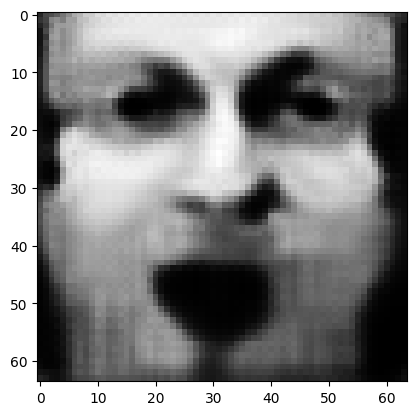

tensor([[3.8671e-04, 9.1387e-01, 4.6491e-06, 1.5168e-03, 1.2906e-05, 2.0025e-07,
         2.6541e-05, 7.4690e-06, 1.7904e-06, 2.8546e-06, 1.5820e-03, 1.7529e-04,
         1.2417e-03, 4.5915e-03, 1.0948e-03, 1.1333e-03, 7.4841e-05, 1.9752e-05,
         3.3490e-03, 3.9017e-04, 4.6489e-03, 3.2941e-03, 1.7969e-07, 1.8773e-03,
         1.7384e-04, 3.4336e-06, 3.1751e-03, 2.1845e-04, 1.8735e-03, 8.0424e-04,
         1.9169e-03, 7.8989e-04, 1.6712e-04, 3.7377e-02, 1.2555e-05, 6.5528e-04,
         2.1219e-03, 3.1955e-03, 3.6731e-03, 4.5415e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09006905555725098
tensor([[3.8652e-04, 9.1401e-01, 4.6353e-06, 1.5144e-03, 1.2879e-05, 1.9993e-07,
         2.6481e-05, 7.4573e-06, 1.7841e-06, 2.8474e-06, 1.5785e-03, 1.7494e-04,
         1.2399e-03, 4.5836e-03, 1.0924e-03, 1.1322e-03, 7.4648e-05, 1.9717e-05,
         3.3450e-03, 3.8945e-04, 4.6380e-03, 3.2877e-03, 1.7901e-07, 1.8746e-03,
         1.7338e-04, 3.4249e-06, 3.1704e-0

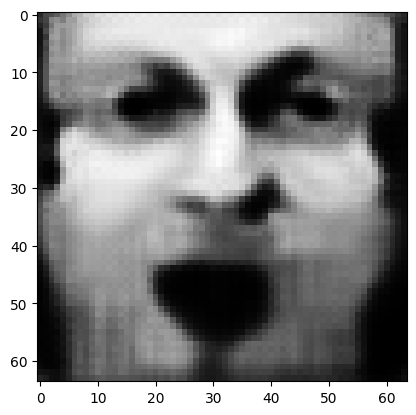

tensor([[3.8572e-04, 9.1457e-01, 4.5820e-06, 1.5055e-03, 1.2775e-05, 1.9869e-07,
         2.6245e-05, 7.4109e-06, 1.7597e-06, 2.8194e-06, 1.5652e-03, 1.7361e-04,
         1.2325e-03, 4.5531e-03, 1.0832e-03, 1.1279e-03, 7.3889e-05, 1.9581e-05,
         3.3292e-03, 3.8671e-04, 4.5964e-03, 3.2631e-03, 1.7644e-07, 1.8641e-03,
         1.7156e-04, 3.3917e-06, 3.1518e-03, 2.1560e-04, 1.8546e-03, 7.9694e-04,
         1.8975e-03, 7.8521e-04, 1.6545e-04, 3.7113e-02, 1.2363e-05, 6.5124e-04,
         2.0984e-03, 3.1633e-03, 3.6323e-03, 4.5021e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08930224925279617
tensor([[3.8553e-04, 9.1470e-01, 4.5692e-06, 1.5033e-03, 1.2749e-05, 1.9838e-07,
         2.6188e-05, 7.3999e-06, 1.7539e-06, 2.8127e-06, 1.5620e-03, 1.7329e-04,
         1.2307e-03, 4.5458e-03, 1.0810e-03, 1.1269e-03, 7.3707e-05, 1.9549e-05,
         3.3254e-03, 3.8604e-04, 4.5863e-03, 3.2572e-03, 1.7582e-07, 1.8615e-03,
         1.7113e-04, 3.3837e-06, 3.1474e-0

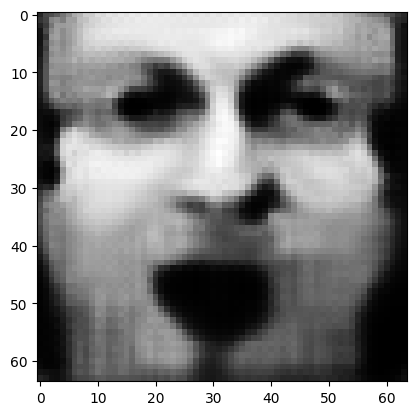

tensor([[3.8479e-04, 9.1522e-01, 4.5198e-06, 1.4948e-03, 1.2651e-05, 1.9722e-07,
         2.5969e-05, 7.3568e-06, 1.7313e-06, 2.7866e-06, 1.5496e-03, 1.7205e-04,
         1.2239e-03, 4.5174e-03, 1.0723e-03, 1.1229e-03, 7.3004e-05, 1.9422e-05,
         3.3106e-03, 3.8345e-04, 4.5473e-03, 3.2342e-03, 1.7343e-07, 1.8517e-03,
         1.6946e-04, 3.3527e-06, 3.1301e-03, 2.1295e-04, 1.8370e-03, 7.9013e-04,
         1.8794e-03, 7.8080e-04, 1.6389e-04, 3.6867e-02, 1.2185e-05, 6.4745e-04,
         2.0766e-03, 3.1334e-03, 3.5945e-03, 4.4655e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08858700841665268
tensor([[3.8460e-04, 9.1535e-01, 4.5078e-06, 1.4929e-03, 1.2628e-05, 1.9694e-07,
         2.5916e-05, 7.3462e-06, 1.7259e-06, 2.7803e-06, 1.5466e-03, 1.7175e-04,
         1.2222e-03, 4.5104e-03, 1.0703e-03, 1.1219e-03, 7.2832e-05, 1.9391e-05,
         3.3070e-03, 3.8284e-04, 4.5380e-03, 3.2286e-03, 1.7285e-07, 1.8493e-03,
         1.6904e-04, 3.3453e-06, 3.1259e-0

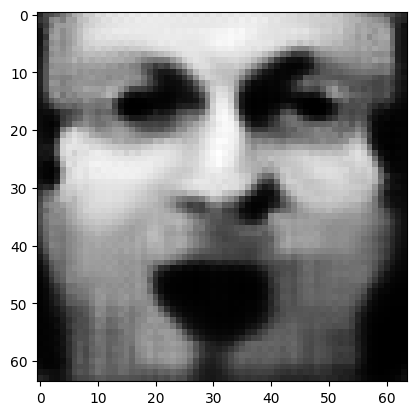

tensor([[3.8391e-04, 9.1584e-01, 4.4620e-06, 1.4849e-03, 1.2537e-05, 1.9586e-07,
         2.5712e-05, 7.3059e-06, 1.7050e-06, 2.7560e-06, 1.5351e-03, 1.7060e-04,
         1.2157e-03, 4.4839e-03, 1.0622e-03, 1.1182e-03, 7.2178e-05, 1.9274e-05,
         3.2933e-03, 3.8043e-04, 4.5017e-03, 3.2072e-03, 1.7064e-07, 1.8401e-03,
         1.6748e-04, 3.3164e-06, 3.1098e-03, 2.1048e-04, 1.8204e-03, 7.8378e-04,
         1.8625e-03, 7.7670e-04, 1.6243e-04, 3.6636e-02, 1.2019e-05, 6.4391e-04,
         2.0562e-03, 3.1054e-03, 3.5590e-03, 4.4312e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08791852742433548
tensor([[3.8373e-04, 9.1595e-01, 4.4508e-06, 1.4831e-03, 1.2515e-05, 1.9560e-07,
         2.5662e-05, 7.2958e-06, 1.6999e-06, 2.7501e-06, 1.5322e-03, 1.7031e-04,
         1.2141e-03, 4.4774e-03, 1.0603e-03, 1.1173e-03, 7.2016e-05, 1.9245e-05,
         3.2899e-03, 3.7985e-04, 4.4930e-03, 3.2020e-03, 1.7011e-07, 1.8378e-03,
         1.6709e-04, 3.3095e-06, 3.1058e-0

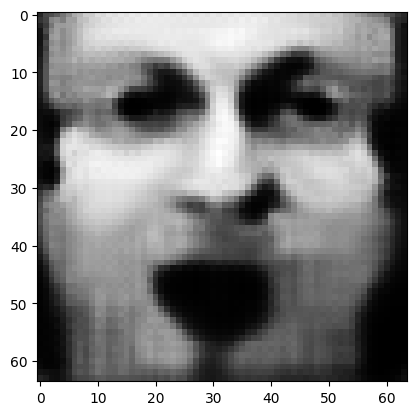

tensor([[3.8308e-04, 9.1641e-01, 4.4080e-06, 1.4757e-03, 1.2430e-05, 1.9458e-07,
         2.5472e-05, 7.2581e-06, 1.6805e-06, 2.7275e-06, 1.5214e-03, 1.6923e-04,
         1.2081e-03, 4.4525e-03, 1.0527e-03, 1.1138e-03, 7.1408e-05, 1.9134e-05,
         3.2769e-03, 3.7759e-04, 4.4590e-03, 3.1819e-03, 1.6805e-07, 1.8292e-03,
         1.6564e-04, 3.2826e-06, 3.0908e-03, 2.0817e-04, 1.8049e-03, 7.7780e-04,
         1.8467e-03, 7.7286e-04, 1.6107e-04, 3.6420e-02, 1.1864e-05, 6.4057e-04,
         2.0371e-03, 3.0793e-03, 3.5258e-03, 4.3989e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08729176968336105
tensor([[3.8293e-04, 9.1652e-01, 4.3978e-06, 1.4739e-03, 1.2409e-05, 1.9434e-07,
         2.5426e-05, 7.2492e-06, 1.6758e-06, 2.7221e-06, 1.5188e-03, 1.6898e-04,
         1.2067e-03, 4.4466e-03, 1.0509e-03, 1.1130e-03, 7.1263e-05, 1.9108e-05,
         3.2738e-03, 3.7704e-04, 4.4508e-03, 3.1770e-03, 1.6756e-07, 1.8272e-03,
         1.6529e-04, 3.2761e-06, 3.0872e-0

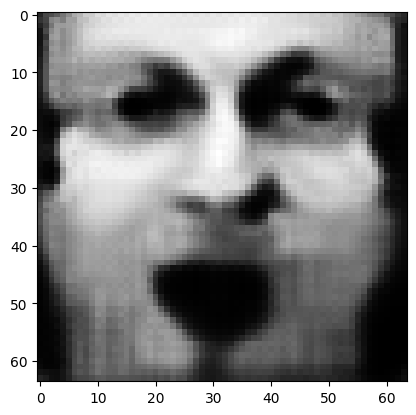

tensor([[3.8231e-04, 9.1695e-01, 4.3579e-06, 1.4670e-03, 1.2330e-05, 1.9339e-07,
         2.5248e-05, 7.2136e-06, 1.6577e-06, 2.7009e-06, 1.5087e-03, 1.6797e-04,
         1.2010e-03, 4.4232e-03, 1.0439e-03, 1.1097e-03, 7.0691e-05, 1.9005e-05,
         3.2617e-03, 3.7493e-04, 4.4192e-03, 3.1582e-03, 1.6565e-07, 1.8191e-03,
         1.6392e-04, 3.2510e-06, 3.0729e-03, 2.0602e-04, 1.7905e-03, 7.7222e-04,
         1.8319e-03, 7.6926e-04, 1.5979e-04, 3.6216e-02, 1.1720e-05, 6.3744e-04,
         2.0193e-03, 3.0549e-03, 3.4948e-03, 4.3689e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08670538663864136
tensor([[3.8216e-04, 9.1705e-01, 4.3483e-06, 1.4653e-03, 1.2310e-05, 1.9316e-07,
         2.5205e-05, 7.2051e-06, 1.6534e-06, 2.6958e-06, 1.5063e-03, 1.6772e-04,
         1.1997e-03, 4.4176e-03, 1.0422e-03, 1.1089e-03, 7.0554e-05, 1.8980e-05,
         3.2587e-03, 3.7441e-04, 4.4114e-03, 3.1536e-03, 1.6519e-07, 1.8171e-03,
         1.6360e-04, 3.2449e-06, 3.0696e-0

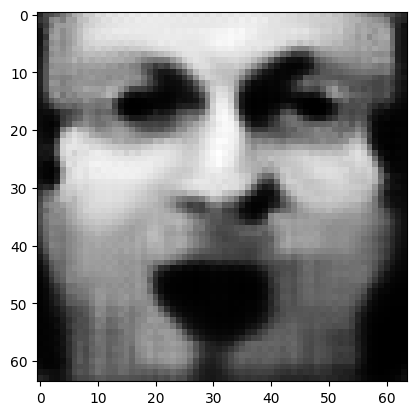

tensor([[3.8158e-04, 9.1745e-01, 4.3110e-06, 1.4588e-03, 1.2236e-05, 1.9227e-07,
         2.5039e-05, 7.1716e-06, 1.6365e-06, 2.6759e-06, 1.4968e-03, 1.6677e-04,
         1.1943e-03, 4.3957e-03, 1.0356e-03, 1.1058e-03, 7.0020e-05, 1.8883e-05,
         3.2473e-03, 3.7243e-04, 4.3818e-03, 3.1359e-03, 1.6341e-07, 1.8095e-03,
         1.6232e-04, 3.2214e-06, 3.0562e-03, 2.0401e-04, 1.7769e-03, 7.6697e-04,
         1.8181e-03, 7.6588e-04, 1.5860e-04, 3.6024e-02, 1.1586e-05, 6.3449e-04,
         2.0026e-03, 3.0320e-03, 3.4658e-03, 4.3407e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08615519851446152
tensor([[3.8144e-04, 9.1755e-01, 4.3021e-06, 1.4572e-03, 1.2218e-05, 1.9205e-07,
         2.4999e-05, 7.1637e-06, 1.6325e-06, 2.6712e-06, 1.4945e-03, 1.6655e-04,
         1.1931e-03, 4.3904e-03, 1.0339e-03, 1.1051e-03, 6.9892e-05, 1.8860e-05,
         3.2445e-03, 3.7195e-04, 4.3745e-03, 3.1316e-03, 1.6298e-07, 1.8077e-03,
         1.6202e-04, 3.2158e-06, 3.0531e-0

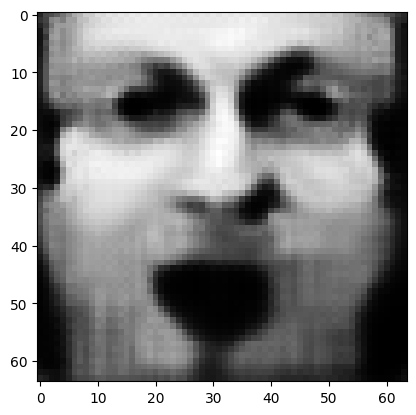

tensor([[3.8088e-04, 9.1793e-01, 4.2673e-06, 1.4511e-03, 1.2148e-05, 1.9122e-07,
         2.4842e-05, 7.1323e-06, 1.6168e-06, 2.6526e-06, 1.4856e-03, 1.6566e-04,
         1.1881e-03, 4.3700e-03, 1.0277e-03, 1.1021e-03, 6.9393e-05, 1.8769e-05,
         3.2337e-03, 3.7008e-04, 4.3467e-03, 3.1150e-03, 1.6132e-07, 1.8005e-03,
         1.6083e-04, 3.1938e-06, 3.0406e-03, 2.0214e-04, 1.7642e-03, 7.6205e-04,
         1.8051e-03, 7.6270e-04, 1.5747e-04, 3.5844e-02, 1.1460e-05, 6.3171e-04,
         1.9869e-03, 3.0106e-03, 3.4386e-03, 4.3143e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08563895523548126
tensor([[3.8075e-04, 9.1802e-01, 4.2588e-06, 1.4496e-03, 1.2131e-05, 1.9101e-07,
         2.4805e-05, 7.1248e-06, 1.6130e-06, 2.6481e-06, 1.4835e-03, 1.6544e-04,
         1.1869e-03, 4.3650e-03, 1.0262e-03, 1.1014e-03, 6.9274e-05, 1.8747e-05,
         3.2311e-03, 3.6962e-04, 4.3399e-03, 3.1110e-03, 1.6091e-07, 1.7987e-03,
         1.6055e-04, 3.1885e-06, 3.0376e-0

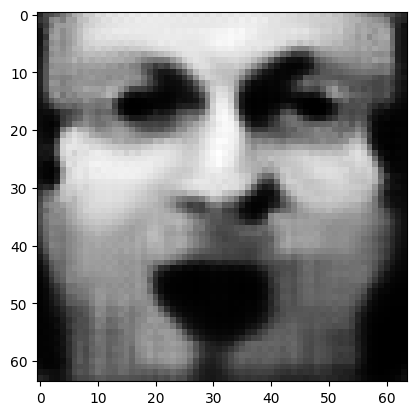

tensor([[3.8024e-04, 9.1837e-01, 4.2263e-06, 1.4437e-03, 1.2065e-05, 1.9023e-07,
         2.4659e-05, 7.0956e-06, 1.5983e-06, 2.6307e-06, 1.4752e-03, 1.6461e-04,
         1.1822e-03, 4.3459e-03, 1.0204e-03, 1.0987e-03, 6.8809e-05, 1.8661e-05,
         3.2210e-03, 3.6786e-04, 4.3137e-03, 3.0954e-03, 1.5936e-07, 1.7920e-03,
         1.5944e-04, 3.1679e-06, 3.0259e-03, 2.0038e-04, 1.7523e-03, 7.5742e-04,
         1.7930e-03, 7.5972e-04, 1.5642e-04, 3.5674e-02, 1.1343e-05, 6.2909e-04,
         1.9723e-03, 2.9905e-03, 3.4132e-03, 4.2896e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08515375107526779
tensor([[3.8011e-04, 9.1846e-01, 4.2184e-06, 1.4424e-03, 1.2049e-05, 1.9004e-07,
         2.4624e-05, 7.0883e-06, 1.5948e-06, 2.6265e-06, 1.4732e-03, 1.6441e-04,
         1.1810e-03, 4.3412e-03, 1.0190e-03, 1.0980e-03, 6.8695e-05, 1.8641e-05,
         3.2185e-03, 3.6744e-04, 4.3075e-03, 3.0916e-03, 1.5899e-07, 1.7904e-03,
         1.5917e-04, 3.1629e-06, 3.0230e-0

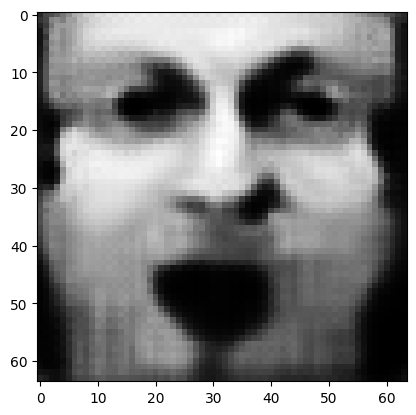

tensor([[3.7963e-04, 9.1879e-01, 4.1879e-06, 1.4369e-03, 1.1987e-05, 1.8930e-07,
         2.4487e-05, 7.0609e-06, 1.5811e-06, 2.6102e-06, 1.4654e-03, 1.6363e-04,
         1.1767e-03, 4.3232e-03, 1.0135e-03, 1.0955e-03, 6.8260e-05, 1.8560e-05,
         3.2090e-03, 3.6577e-04, 4.2828e-03, 3.0769e-03, 1.5754e-07, 1.7841e-03,
         1.5814e-04, 3.1436e-06, 3.0121e-03, 1.9873e-04, 1.7411e-03, 7.5307e-04,
         1.7816e-03, 7.5691e-04, 1.5543e-04, 3.5514e-02, 1.1234e-05, 6.2663e-04,
         1.9585e-03, 2.9717e-03, 3.3892e-03, 4.2662e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0846976712346077
tensor([[3.7950e-04, 9.1887e-01, 4.1806e-06, 1.4356e-03, 1.1972e-05, 1.8912e-07,
         2.4454e-05, 7.0540e-06, 1.5777e-06, 2.6062e-06, 1.4634e-03, 1.6344e-04,
         1.1756e-03, 4.3187e-03, 1.0122e-03, 1.0948e-03, 6.8153e-05, 1.8541e-05,
         3.2067e-03, 3.6538e-04, 4.2770e-03, 3.0734e-03, 1.5719e-07, 1.7825e-03,
         1.5788e-04, 3.1390e-06, 3.0094e-03

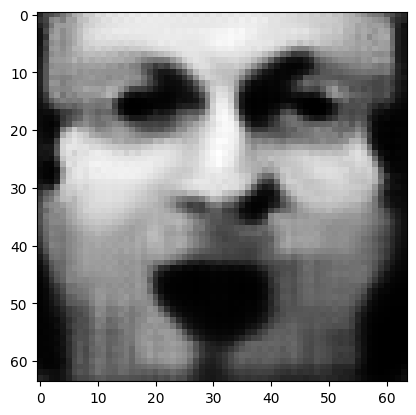

tensor([[3.7905e-04, 9.1918e-01, 4.1520e-06, 1.4304e-03, 1.1914e-05, 1.8842e-07,
         2.4325e-05, 7.0282e-06, 1.5649e-06, 2.5910e-06, 1.4561e-03, 1.6270e-04,
         1.1714e-03, 4.3018e-03, 1.0070e-03, 1.0924e-03, 6.7744e-05, 1.8465e-05,
         3.1977e-03, 3.6381e-04, 4.2538e-03, 3.0595e-03, 1.5583e-07, 1.7766e-03,
         1.5691e-04, 3.1208e-06, 2.9991e-03, 1.9719e-04, 1.7306e-03, 7.4898e-04,
         1.7708e-03, 7.5426e-04, 1.5450e-04, 3.5364e-02, 1.1131e-05, 6.2430e-04,
         1.9455e-03, 2.9539e-03, 3.3667e-03, 4.2443e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0842682272195816
tensor([[3.7894e-04, 9.1926e-01, 4.1450e-06, 1.4292e-03, 1.1900e-05, 1.8825e-07,
         2.4294e-05, 7.0218e-06, 1.5618e-06, 2.5872e-06, 1.4543e-03, 1.6252e-04,
         1.1704e-03, 4.2976e-03, 1.0057e-03, 1.0918e-03, 6.7644e-05, 1.8447e-05,
         3.1954e-03, 3.6344e-04, 4.2482e-03, 3.0562e-03, 1.5550e-07, 1.7751e-03,
         1.5667e-04, 3.1164e-06, 2.9965e-03

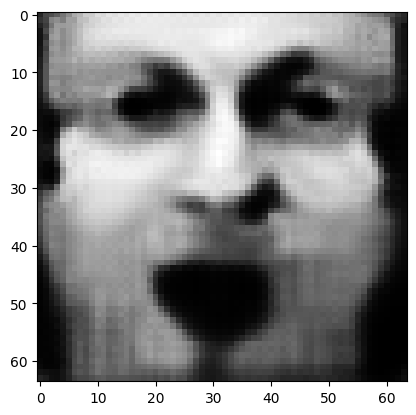

tensor([[3.7851e-04, 9.1956e-01, 4.1181e-06, 1.4243e-03, 1.1845e-05, 1.8759e-07,
         2.4172e-05, 6.9973e-06, 1.5497e-06, 2.5728e-06, 1.4474e-03, 1.6183e-04,
         1.1665e-03, 4.2815e-03, 1.0009e-03, 1.0895e-03, 6.7257e-05, 1.8376e-05,
         3.1869e-03, 3.6196e-04, 4.2264e-03, 3.0431e-03, 1.5423e-07, 1.7694e-03,
         1.5575e-04, 3.0993e-06, 2.9866e-03, 1.9573e-04, 1.7206e-03, 7.4511e-04,
         1.7607e-03, 7.5174e-04, 1.5362e-04, 3.5221e-02, 1.1034e-05, 6.2210e-04,
         1.9333e-03, 2.9371e-03, 3.3455e-03, 4.2237e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08386271446943283
tensor([[3.7841e-04, 9.1963e-01, 4.1115e-06, 1.4231e-03, 1.1831e-05, 1.8743e-07,
         2.4142e-05, 6.9914e-06, 1.5468e-06, 2.5693e-06, 1.4457e-03, 1.6166e-04,
         1.1656e-03, 4.2776e-03, 9.9965e-04, 1.0890e-03, 6.7164e-05, 1.8358e-05,
         3.1848e-03, 3.6160e-04, 4.2211e-03, 3.0399e-03, 1.5392e-07, 1.7681e-03,
         1.5553e-04, 3.0951e-06, 2.9843e-0

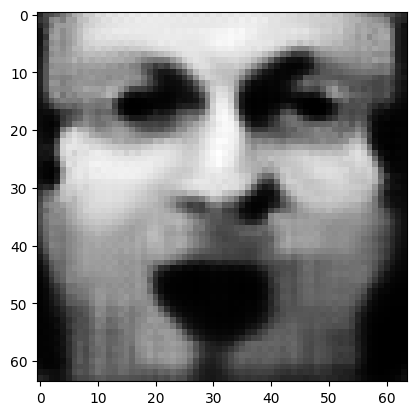

tensor([[3.7800e-04, 9.1991e-01, 4.0862e-06, 1.4185e-03, 1.1780e-05, 1.8681e-07,
         2.4028e-05, 6.9683e-06, 1.5354e-06, 2.5557e-06, 1.4392e-03, 1.6100e-04,
         1.1619e-03, 4.2625e-03, 9.9507e-04, 1.0868e-03, 6.6801e-05, 1.8291e-05,
         3.1767e-03, 3.6020e-04, 4.2006e-03, 3.0276e-03, 1.5272e-07, 1.7627e-03,
         1.5467e-04, 3.0791e-06, 2.9750e-03, 1.9436e-04, 1.7113e-03, 7.4146e-04,
         1.7511e-03, 7.4936e-04, 1.5279e-04, 3.5086e-02, 1.0943e-05, 6.2002e-04,
         1.9219e-03, 2.9214e-03, 3.3255e-03, 4.2042e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08348017930984497
tensor([[3.7790e-04, 9.1998e-01, 4.0801e-06, 1.4174e-03, 1.1767e-05, 1.8666e-07,
         2.4000e-05, 6.9627e-06, 1.5327e-06, 2.5524e-06, 1.4376e-03, 1.6085e-04,
         1.1610e-03, 4.2588e-03, 9.9396e-04, 1.0862e-03, 6.6712e-05, 1.8275e-05,
         3.1748e-03, 3.5987e-04, 4.1957e-03, 3.0247e-03, 1.5243e-07, 1.7614e-03,
         1.5446e-04, 3.0752e-06, 2.9727e-0

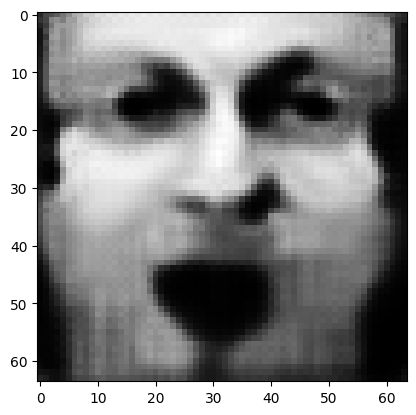

tensor([[3.7752e-04, 9.2024e-01, 4.0563e-06, 1.4130e-03, 1.1719e-05, 1.8608e-07,
         2.3892e-05, 6.9409e-06, 1.5221e-06, 2.5397e-06, 1.4315e-03, 1.6023e-04,
         1.1575e-03, 4.2445e-03, 9.8964e-04, 1.0842e-03, 6.6371e-05, 1.8211e-05,
         3.1671e-03, 3.5856e-04, 4.1764e-03, 3.0131e-03, 1.5132e-07, 1.7564e-03,
         1.5365e-04, 3.0601e-06, 2.9640e-03, 1.9307e-04, 1.7025e-03, 7.3803e-04,
         1.7421e-03, 7.4712e-04, 1.5201e-04, 3.4960e-02, 1.0858e-05, 6.1805e-04,
         1.9111e-03, 2.9065e-03, 3.3067e-03, 4.1860e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08312031626701355
tensor([[3.7743e-04, 9.2030e-01, 4.0506e-06, 1.4119e-03, 1.1707e-05, 1.8593e-07,
         2.3866e-05, 6.9357e-06, 1.5195e-06, 2.5366e-06, 1.4300e-03, 1.6008e-04,
         1.1566e-03, 4.2411e-03, 9.8857e-04, 1.0837e-03, 6.6289e-05, 1.8196e-05,
         3.1653e-03, 3.5824e-04, 4.1717e-03, 3.0102e-03, 1.5104e-07, 1.7552e-03,
         1.5345e-04, 3.0564e-06, 2.9619e-0

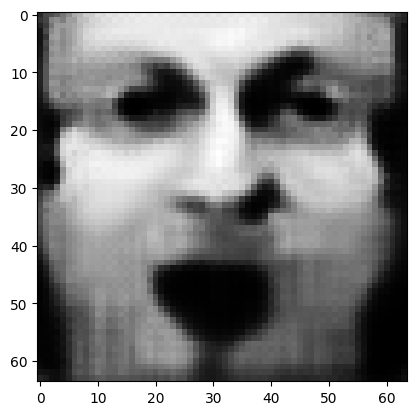

tensor([[3.7707e-04, 9.2055e-01, 4.0282e-06, 1.4078e-03, 1.1661e-05, 1.8538e-07,
         2.3765e-05, 6.9152e-06, 1.5095e-06, 2.5246e-06, 1.4242e-03, 1.5950e-04,
         1.1534e-03, 4.2276e-03, 9.8450e-04, 1.0818e-03, 6.5968e-05, 1.8136e-05,
         3.1581e-03, 3.5700e-04, 4.1536e-03, 2.9993e-03, 1.4999e-07, 1.7505e-03,
         1.5269e-04, 3.0422e-06, 2.9537e-03, 1.9186e-04, 1.6942e-03, 7.3479e-04,
         1.7337e-03, 7.4500e-04, 1.5128e-04, 3.4839e-02, 1.0778e-05, 6.1619e-04,
         1.9009e-03, 2.8925e-03, 3.2891e-03, 4.1688e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.082780621945858
tensor([[3.7698e-04, 9.2061e-01, 4.0228e-06, 1.4069e-03, 1.1650e-05, 1.8525e-07,
         2.3740e-05, 6.9102e-06, 1.5071e-06, 2.5217e-06, 1.4228e-03, 1.5936e-04,
         1.1526e-03, 4.2244e-03, 9.8352e-04, 1.0813e-03, 6.5890e-05, 1.8121e-05,
         3.1563e-03, 3.5671e-04, 4.1492e-03, 2.9967e-03, 1.4974e-07, 1.7493e-03,
         1.5250e-04, 3.0388e-06, 2.9516e-03,

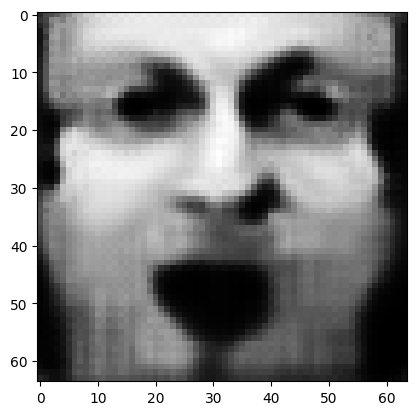

tensor([[3.7663e-04, 9.2085e-01, 4.0018e-06, 1.4030e-03, 1.1607e-05, 1.8473e-07,
         2.3645e-05, 6.8909e-06, 1.4977e-06, 2.5104e-06, 1.4173e-03, 1.5881e-04,
         1.1495e-03, 4.2117e-03, 9.7968e-04, 1.0795e-03, 6.5588e-05, 1.8065e-05,
         3.1495e-03, 3.5555e-04, 4.1322e-03, 2.9864e-03, 1.4875e-07, 1.7448e-03,
         1.5178e-04, 3.0254e-06, 2.9439e-03, 1.9072e-04, 1.6864e-03, 7.3175e-04,
         1.7257e-03, 7.4300e-04, 1.5058e-04, 3.4726e-02, 1.0703e-05, 6.1444e-04,
         1.8913e-03, 2.8794e-03, 3.2724e-03, 4.1525e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08246079087257385
tensor([[3.7656e-04, 9.2090e-01, 3.9967e-06, 1.4021e-03, 1.1596e-05, 1.8460e-07,
         2.3622e-05, 6.8863e-06, 1.4955e-06, 2.5077e-06, 1.4160e-03, 1.5868e-04,
         1.1487e-03, 4.2086e-03, 9.7874e-04, 1.0790e-03, 6.5515e-05, 1.8051e-05,
         3.1479e-03, 3.5526e-04, 4.1280e-03, 2.9839e-03, 1.4851e-07, 1.7438e-03,
         1.5161e-04, 3.0221e-06, 2.9420e-0

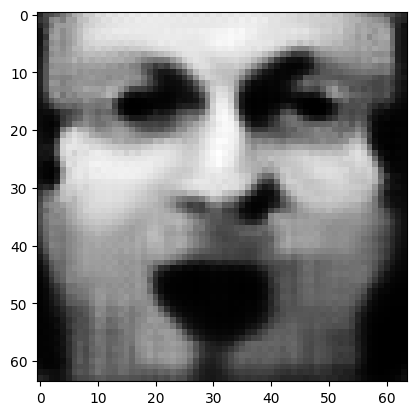

tensor([[3.7623e-04, 9.2113e-01, 3.9769e-06, 1.3984e-03, 1.1555e-05, 1.8411e-07,
         2.3532e-05, 6.8680e-06, 1.4867e-06, 2.4971e-06, 1.4109e-03, 1.5817e-04,
         1.1458e-03, 4.1966e-03, 9.7513e-04, 1.0773e-03, 6.5231e-05, 1.7998e-05,
         3.1415e-03, 3.5417e-04, 4.1119e-03, 2.9742e-03, 1.4759e-07, 1.7396e-03,
         1.5094e-04, 3.0095e-06, 2.9347e-03, 1.8965e-04, 1.6791e-03, 7.2888e-04,
         1.7182e-03, 7.4110e-04, 1.4993e-04, 3.4619e-02, 1.0632e-05, 6.1279e-04,
         1.8823e-03, 2.8669e-03, 3.2568e-03, 4.1373e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08215919882059097
tensor([[3.7615e-04, 9.2118e-01, 3.9722e-06, 1.3976e-03, 1.1546e-05, 1.8399e-07,
         2.3510e-05, 6.8635e-06, 1.4845e-06, 2.4945e-06, 1.4096e-03, 1.5804e-04,
         1.1451e-03, 4.1936e-03, 9.7426e-04, 1.0769e-03, 6.5161e-05, 1.7985e-05,
         3.1399e-03, 3.5391e-04, 4.1080e-03, 2.9718e-03, 1.4736e-07, 1.7385e-03,
         1.5077e-04, 3.0065e-06, 2.9329e-0

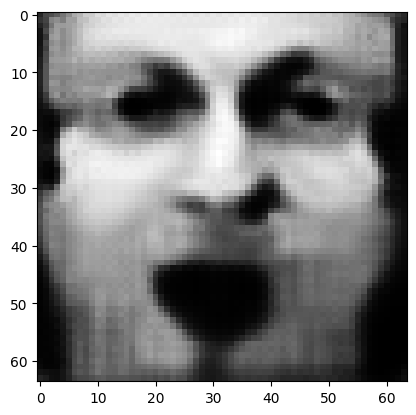

tensor([[3.7584e-04, 9.2139e-01, 3.9535e-06, 1.3941e-03, 1.1507e-05, 1.8352e-07,
         2.3425e-05, 6.8463e-06, 1.4763e-06, 2.4845e-06, 1.4048e-03, 1.5755e-04,
         1.1423e-03, 4.1823e-03, 9.7086e-04, 1.0752e-03, 6.4893e-05, 1.7935e-05,
         3.1339e-03, 3.5287e-04, 4.0929e-03, 2.9627e-03, 1.4649e-07, 1.7346e-03,
         1.5014e-04, 2.9945e-06, 2.9259e-03, 1.8864e-04, 1.6721e-03, 7.2617e-04,
         1.7111e-03, 7.3931e-04, 1.4932e-04, 3.4518e-02, 1.0565e-05, 6.1123e-04,
         1.8737e-03, 2.8552e-03, 3.2420e-03, 4.1229e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08187443017959595
tensor([[3.7577e-04, 9.2144e-01, 3.9490e-06, 1.3932e-03, 1.1498e-05, 1.8341e-07,
         2.3405e-05, 6.8421e-06, 1.4743e-06, 2.4821e-06, 1.4036e-03, 1.5743e-04,
         1.1416e-03, 4.1795e-03, 9.7002e-04, 1.0748e-03, 6.4828e-05, 1.7923e-05,
         3.1325e-03, 3.5262e-04, 4.0891e-03, 2.9604e-03, 1.4628e-07, 1.7336e-03,
         1.4998e-04, 2.9916e-06, 2.9243e-0

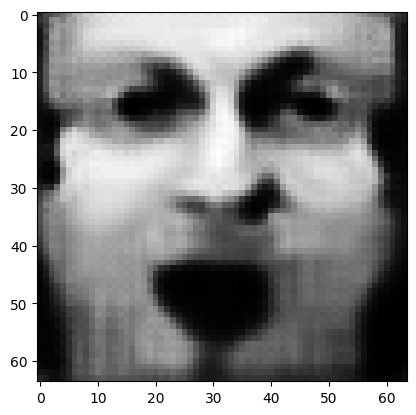

tensor([[3.7548e-04, 9.2164e-01, 3.9315e-06, 1.3900e-03, 1.1462e-05, 1.8297e-07,
         2.3325e-05, 6.8258e-06, 1.4665e-06, 2.4727e-06, 1.3991e-03, 1.5697e-04,
         1.1390e-03, 4.1688e-03, 9.6681e-04, 1.0733e-03, 6.4575e-05, 1.7875e-05,
         3.1268e-03, 3.5164e-04, 4.0748e-03, 2.9518e-03, 1.4546e-07, 1.7298e-03,
         1.4938e-04, 2.9804e-06, 2.9177e-03, 1.8769e-04, 1.6656e-03, 7.2362e-04,
         1.7044e-03, 7.3761e-04, 1.4874e-04, 3.4423e-02, 1.0503e-05, 6.0976e-04,
         1.8657e-03, 2.8441e-03, 3.2280e-03, 4.1093e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08160540461540222
tensor([[3.7540e-04, 9.2168e-01, 3.9272e-06, 1.3892e-03, 1.1453e-05, 1.8286e-07,
         2.3305e-05, 6.8218e-06, 1.4646e-06, 2.4704e-06, 1.3979e-03, 1.5686e-04,
         1.1384e-03, 4.1661e-03, 9.6604e-04, 1.0729e-03, 6.4513e-05, 1.7864e-05,
         3.1254e-03, 3.5141e-04, 4.0714e-03, 2.9497e-03, 1.4526e-07, 1.7289e-03,
         1.4924e-04, 2.9777e-06, 2.9161e-0

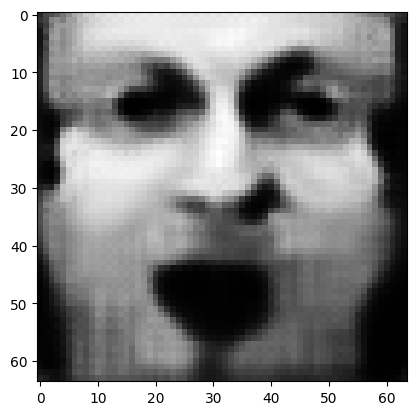

tensor([[3.7513e-04, 9.2187e-01, 3.9107e-06, 1.3861e-03, 1.1419e-05, 1.8245e-07,
         2.3230e-05, 6.8065e-06, 1.4573e-06, 2.4615e-06, 1.3936e-03, 1.5643e-04,
         1.1359e-03, 4.1560e-03, 9.6300e-04, 1.0714e-03, 6.4275e-05, 1.7819e-05,
         3.1200e-03, 3.5049e-04, 4.0578e-03, 2.9415e-03, 1.4449e-07, 1.7254e-03,
         1.4867e-04, 2.9671e-06, 2.9099e-03, 1.8679e-04, 1.6594e-03, 7.2120e-04,
         1.6981e-03, 7.3602e-04, 1.4819e-04, 3.4333e-02, 1.0444e-05, 6.0837e-04,
         1.8581e-03, 2.8337e-03, 3.2148e-03, 4.0964e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.081351138651371
tensor([[3.7506e-04, 9.2191e-01, 3.9067e-06, 1.3854e-03, 1.1410e-05, 1.8235e-07,
         2.3212e-05, 6.8028e-06, 1.4555e-06, 2.4594e-06, 1.3926e-03, 1.5632e-04,
         1.1353e-03, 4.1536e-03, 9.6226e-04, 1.0711e-03, 6.4218e-05, 1.7808e-05,
         3.1187e-03, 3.5026e-04, 4.0545e-03, 2.9396e-03, 1.4431e-07, 1.7245e-03,
         1.4854e-04, 2.9645e-06, 2.9084e-03,

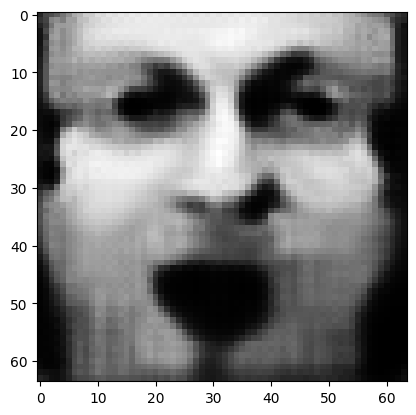

tensor([[3.7480e-04, 9.2209e-01, 3.8911e-06, 1.3824e-03, 1.1378e-05, 1.8196e-07,
         2.3140e-05, 6.7883e-06, 1.4486e-06, 2.4510e-06, 1.3885e-03, 1.5591e-04,
         1.1330e-03, 4.1440e-03, 9.5940e-04, 1.0697e-03, 6.3993e-05, 1.7766e-05,
         3.1136e-03, 3.4939e-04, 4.0418e-03, 2.9318e-03, 1.4358e-07, 1.7212e-03,
         1.4800e-04, 2.9545e-06, 2.9026e-03, 1.8595e-04, 1.6536e-03, 7.1892e-04,
         1.6921e-03, 7.3450e-04, 1.4767e-04, 3.4247e-02, 1.0388e-05, 6.0706e-04,
         1.8509e-03, 2.8238e-03, 3.2024e-03, 4.0843e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08111142367124557
tensor([[3.7473e-04, 9.2213e-01, 3.8873e-06, 1.3818e-03, 1.1370e-05, 1.8186e-07,
         2.3123e-05, 6.7847e-06, 1.4469e-06, 2.4489e-06, 1.3875e-03, 1.5581e-04,
         1.1324e-03, 4.1416e-03, 9.5871e-04, 1.0694e-03, 6.3938e-05, 1.7756e-05,
         3.1124e-03, 3.4918e-04, 4.0387e-03, 2.9300e-03, 1.4340e-07, 1.7203e-03,
         1.4787e-04, 2.9521e-06, 2.9011e-0

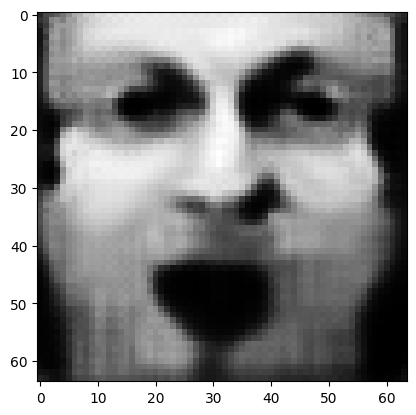

tensor([[3.7449e-04, 9.2230e-01, 3.8726e-06, 1.3790e-03, 1.1340e-05, 1.8149e-07,
         2.3055e-05, 6.7710e-06, 1.4404e-06, 2.4410e-06, 1.3837e-03, 1.5543e-04,
         1.1302e-03, 4.1326e-03, 9.5600e-04, 1.0680e-03, 6.3725e-05, 1.7716e-05,
         3.1075e-03, 3.4836e-04, 4.0267e-03, 2.9227e-03, 1.4272e-07, 1.7172e-03,
         1.4737e-04, 2.9427e-06, 2.8956e-03, 1.8515e-04, 1.6480e-03, 7.1676e-04,
         1.6864e-03, 7.3307e-04, 1.4718e-04, 3.4166e-02, 1.0336e-05, 6.0581e-04,
         1.8442e-03, 2.8145e-03, 3.1907e-03, 4.0728e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0808844119310379
tensor([[3.7443e-04, 9.2234e-01, 3.8690e-06, 1.3783e-03, 1.1332e-05, 1.8140e-07,
         2.3039e-05, 6.7677e-06, 1.4388e-06, 2.4391e-06, 1.3828e-03, 1.5533e-04,
         1.1296e-03, 4.1304e-03, 9.5534e-04, 1.0677e-03, 6.3674e-05, 1.7706e-05,
         3.1064e-03, 3.4815e-04, 4.0237e-03, 2.9209e-03, 1.4256e-07, 1.7164e-03,
         1.4725e-04, 2.9404e-06, 2.8943e-03

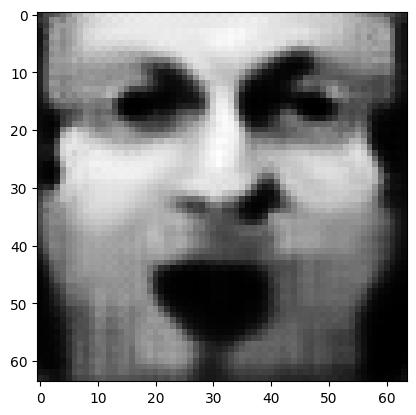

tensor([[3.7420e-04, 9.2250e-01, 3.8551e-06, 1.3757e-03, 1.1303e-05, 1.8105e-07,
         2.2976e-05, 6.7547e-06, 1.4327e-06, 2.4317e-06, 1.3791e-03, 1.5497e-04,
         1.1275e-03, 4.1218e-03, 9.5278e-04, 1.0665e-03, 6.3474e-05, 1.7668e-05,
         3.1018e-03, 3.4738e-04, 4.0123e-03, 2.9140e-03, 1.4191e-07, 1.7134e-03,
         1.4677e-04, 2.9315e-06, 2.8890e-03, 1.8439e-04, 1.6429e-03, 7.1472e-04,
         1.6811e-03, 7.3172e-04, 1.4672e-04, 3.4090e-02, 1.0286e-05, 6.0464e-04,
         1.8378e-03, 2.8057e-03, 3.1796e-03, 4.0620e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08066976815462112
tensor([[3.7414e-04, 9.2254e-01, 3.8517e-06, 1.3751e-03, 1.1296e-05, 1.8096e-07,
         2.2960e-05, 6.7515e-06, 1.4312e-06, 2.4298e-06, 1.3783e-03, 1.5488e-04,
         1.1270e-03, 4.1197e-03, 9.5217e-04, 1.0662e-03, 6.3425e-05, 1.7659e-05,
         3.1007e-03, 3.4719e-04, 4.0096e-03, 2.9123e-03, 1.4175e-07, 1.7127e-03,
         1.4666e-04, 2.9293e-06, 2.8877e-0

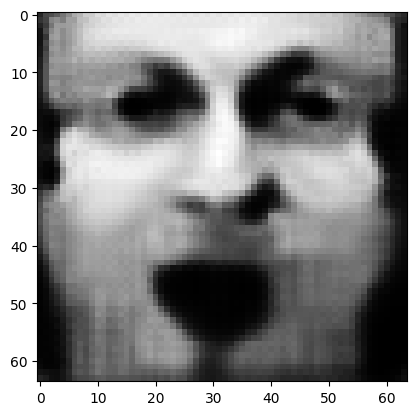

tensor([[3.7392e-04, 9.2269e-01, 3.8386e-06, 1.3726e-03, 1.1269e-05, 1.8063e-07,
         2.2900e-05, 6.7392e-06, 1.4254e-06, 2.4228e-06, 1.3748e-03, 1.5453e-04,
         1.1250e-03, 4.1116e-03, 9.4975e-04, 1.0650e-03, 6.3235e-05, 1.7623e-05,
         3.0964e-03, 3.4645e-04, 3.9988e-03, 2.9058e-03, 1.4115e-07, 1.7098e-03,
         1.4621e-04, 2.9209e-06, 2.8828e-03, 1.8368e-04, 1.6379e-03, 7.1280e-04,
         1.6760e-03, 7.3043e-04, 1.4628e-04, 3.4017e-02, 1.0239e-05, 6.0352e-04,
         1.8317e-03, 2.7973e-03, 3.1691e-03, 4.0517e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08046663552522659
tensor([[3.7387e-04, 9.2272e-01, 3.8354e-06, 1.3720e-03, 1.1262e-05, 1.8055e-07,
         2.2885e-05, 6.7363e-06, 1.4240e-06, 2.4211e-06, 1.3740e-03, 1.5445e-04,
         1.1246e-03, 4.1097e-03, 9.4915e-04, 1.0647e-03, 6.3190e-05, 1.7615e-05,
         3.0953e-03, 3.4627e-04, 3.9962e-03, 2.9042e-03, 1.4100e-07, 1.7091e-03,
         1.4610e-04, 2.9188e-06, 2.8816e-0

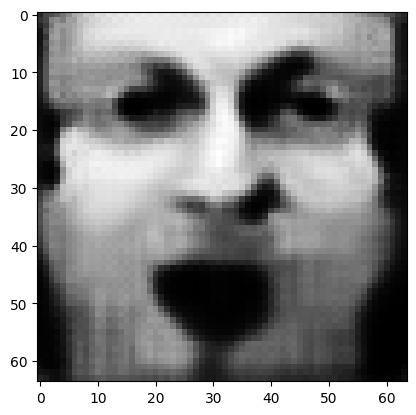

tensor([[3.7366e-04, 9.2286e-01, 3.8230e-06, 1.3697e-03, 1.1236e-05, 1.8024e-07,
         2.2828e-05, 6.7246e-06, 1.4186e-06, 2.4144e-06, 1.3707e-03, 1.5412e-04,
         1.1227e-03, 4.1020e-03, 9.4686e-04, 1.0636e-03, 6.3011e-05, 1.7581e-05,
         3.0912e-03, 3.4557e-04, 3.9860e-03, 2.8980e-03, 1.4042e-07, 1.7064e-03,
         1.4568e-04, 2.9109e-06, 2.8769e-03, 1.8301e-04, 1.6333e-03, 7.1097e-04,
         1.6713e-03, 7.2922e-04, 1.4587e-04, 3.3949e-02, 1.0195e-05, 6.0246e-04,
         1.8260e-03, 2.7895e-03, 3.1592e-03, 4.0421e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0802745670080185
tensor([[3.7360e-04, 9.2290e-01, 3.8200e-06, 1.3691e-03, 1.1230e-05, 1.8016e-07,
         2.2814e-05, 6.7217e-06, 1.4172e-06, 2.4128e-06, 1.3700e-03, 1.5404e-04,
         1.1222e-03, 4.1001e-03, 9.4631e-04, 1.0633e-03, 6.2967e-05, 1.7572e-05,
         3.0902e-03, 3.4540e-04, 3.9835e-03, 2.8965e-03, 1.4029e-07, 1.7058e-03,
         1.4557e-04, 2.9090e-06, 2.8757e-03

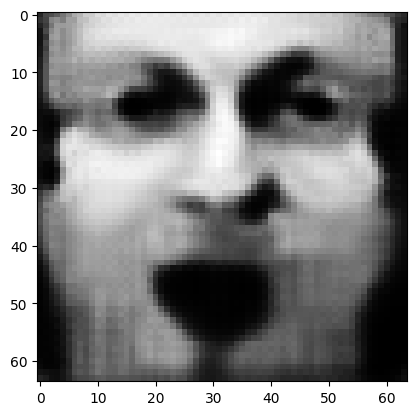

tensor([[3.7341e-04, 9.2303e-01, 3.8083e-06, 1.3669e-03, 1.1206e-05, 1.7986e-07,
         2.2761e-05, 6.7107e-06, 1.4121e-06, 2.4064e-06, 1.3669e-03, 1.5373e-04,
         1.1204e-03, 4.0929e-03, 9.4414e-04, 1.0623e-03, 6.2798e-05, 1.7540e-05,
         3.0863e-03, 3.4474e-04, 3.9739e-03, 2.8907e-03, 1.3974e-07, 1.7032e-03,
         1.4517e-04, 2.9014e-06, 2.8713e-03, 1.8237e-04, 1.6289e-03, 7.0923e-04,
         1.6668e-03, 7.2807e-04, 1.4547e-04, 3.3884e-02, 1.0154e-05, 6.0146e-04,
         1.8206e-03, 2.7820e-03, 3.1498e-03, 4.0329e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08009237051010132
tensor([[3.7335e-04, 9.2306e-01, 3.8054e-06, 1.3664e-03, 1.1200e-05, 1.7979e-07,
         2.2747e-05, 6.7080e-06, 1.4108e-06, 2.4049e-06, 1.3661e-03, 1.5365e-04,
         1.1200e-03, 4.0911e-03, 9.4362e-04, 1.0620e-03, 6.2756e-05, 1.7532e-05,
         3.0854e-03, 3.4458e-04, 3.9716e-03, 2.8893e-03, 1.3961e-07, 1.7026e-03,
         1.4507e-04, 2.8996e-06, 2.8702e-0

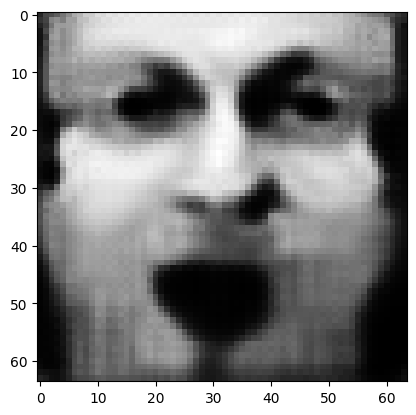

tensor([[3.7317e-04, 9.2319e-01, 3.7944e-06, 1.3643e-03, 1.1177e-05, 1.7951e-07,
         2.2697e-05, 6.6976e-06, 1.4059e-06, 2.3989e-06, 1.3632e-03, 1.5336e-04,
         1.1183e-03, 4.0842e-03, 9.4157e-04, 1.0610e-03, 6.2596e-05, 1.7502e-05,
         3.0817e-03, 3.4396e-04, 3.9625e-03, 2.8837e-03, 1.3910e-07, 1.7002e-03,
         1.4470e-04, 2.8925e-06, 2.8660e-03, 1.8177e-04, 1.6247e-03, 7.0759e-04,
         1.6625e-03, 7.2698e-04, 1.4510e-04, 3.3822e-02, 1.0114e-05, 6.0051e-04,
         1.8155e-03, 2.7749e-03, 3.1409e-03, 4.0242e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07992037385702133
tensor([[3.7312e-04, 9.2322e-01, 3.7917e-06, 1.3637e-03, 1.1171e-05, 1.7944e-07,
         2.2684e-05, 6.6951e-06, 1.4047e-06, 2.3975e-06, 1.3625e-03, 1.5329e-04,
         1.1179e-03, 4.0826e-03, 9.4107e-04, 1.0608e-03, 6.2558e-05, 1.7495e-05,
         3.0808e-03, 3.4380e-04, 3.9602e-03, 2.8824e-03, 1.3898e-07, 1.6996e-03,
         1.4461e-04, 2.8908e-06, 2.8650e-0

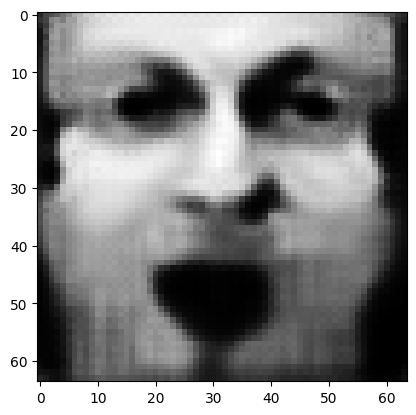

tensor([[3.7295e-04, 9.2334e-01, 3.7812e-06, 1.3618e-03, 1.1149e-05, 1.7917e-07,
         2.2636e-05, 6.6852e-06, 1.4001e-06, 2.3918e-06, 1.3598e-03, 1.5301e-04,
         1.1163e-03, 4.0761e-03, 9.3913e-04, 1.0598e-03, 6.2407e-05, 1.7466e-05,
         3.0773e-03, 3.4321e-04, 3.9516e-03, 2.8771e-03, 1.3850e-07, 1.6973e-03,
         1.4425e-04, 2.8841e-06, 2.8610e-03, 1.8120e-04, 1.6207e-03, 7.0604e-04,
         1.6584e-03, 7.2595e-04, 1.4475e-04, 3.3764e-02, 1.0077e-05, 5.9961e-04,
         1.8106e-03, 2.7682e-03, 3.1325e-03, 4.0160e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07975737005472183
tensor([[3.7290e-04, 9.2337e-01, 3.7787e-06, 1.3613e-03, 1.1144e-05, 1.7911e-07,
         2.2624e-05, 6.6827e-06, 1.3990e-06, 2.3905e-06, 1.3591e-03, 1.5295e-04,
         1.1159e-03, 4.0745e-03, 9.3866e-04, 1.0596e-03, 6.2369e-05, 1.7459e-05,
         3.0765e-03, 3.4307e-04, 3.9495e-03, 2.8759e-03, 1.3838e-07, 1.6967e-03,
         1.4416e-04, 2.8824e-06, 2.8600e-0

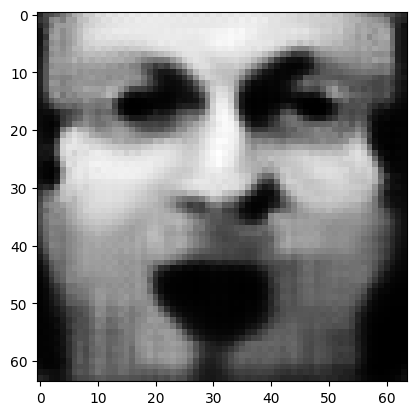

tensor([[3.7273e-04, 9.2348e-01, 3.7688e-06, 1.3594e-03, 1.1123e-05, 1.7886e-07,
         2.2579e-05, 6.6734e-06, 1.3947e-06, 2.3851e-06, 1.3565e-03, 1.5269e-04,
         1.1144e-03, 4.0684e-03, 9.3683e-04, 1.0587e-03, 6.2227e-05, 1.7432e-05,
         3.0732e-03, 3.4251e-04, 3.9414e-03, 2.8709e-03, 1.3792e-07, 1.6946e-03,
         1.4382e-04, 2.8761e-06, 2.8563e-03, 1.8066e-04, 1.6170e-03, 7.0457e-04,
         1.6546e-03, 7.2498e-04, 1.4442e-04, 3.3708e-02, 1.0042e-05, 5.9875e-04,
         1.8060e-03, 2.7619e-03, 3.1245e-03, 4.0082e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0796031504869461
tensor([[3.7269e-04, 9.2351e-01, 3.7663e-06, 1.3590e-03, 1.1118e-05, 1.7880e-07,
         2.2568e-05, 6.6712e-06, 1.3936e-06, 2.3838e-06, 1.3559e-03, 1.5262e-04,
         1.1141e-03, 4.0669e-03, 9.3637e-04, 1.0585e-03, 6.2192e-05, 1.7425e-05,
         3.0724e-03, 3.4237e-04, 3.9394e-03, 2.8697e-03, 1.3781e-07, 1.6940e-03,
         1.4374e-04, 2.8746e-06, 2.8554e-03

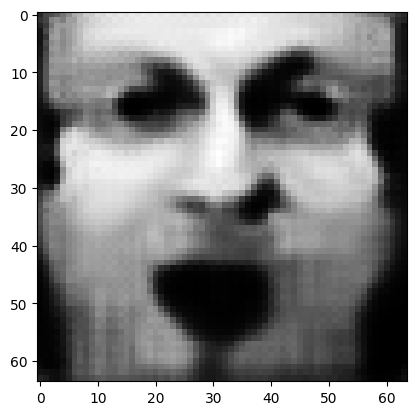

tensor([[3.7253e-04, 9.2362e-01, 3.7570e-06, 1.3572e-03, 1.1099e-05, 1.7856e-07,
         2.2525e-05, 6.6623e-06, 1.3895e-06, 2.3788e-06, 1.3534e-03, 1.5237e-04,
         1.1127e-03, 4.0611e-03, 9.3464e-04, 1.0576e-03, 6.2057e-05, 1.7399e-05,
         3.0692e-03, 3.4183e-04, 3.9316e-03, 2.8650e-03, 1.3738e-07, 1.6920e-03,
         1.4342e-04, 2.8686e-06, 2.8518e-03, 1.8016e-04, 1.6134e-03, 7.0317e-04,
         1.6510e-03, 7.2405e-04, 1.4410e-04, 3.3656e-02, 1.0008e-05, 5.9795e-04,
         1.8017e-03, 2.7559e-03, 3.1170e-03, 4.0008e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07945705205202103
tensor([[3.7249e-04, 9.2364e-01, 3.7547e-06, 1.3568e-03, 1.1094e-05, 1.7850e-07,
         2.2514e-05, 6.6601e-06, 1.3885e-06, 2.3776e-06, 1.3528e-03, 1.5231e-04,
         1.1123e-03, 4.0596e-03, 9.3422e-04, 1.0574e-03, 6.2024e-05, 1.7393e-05,
         3.0685e-03, 3.4171e-04, 3.9298e-03, 2.8639e-03, 1.3728e-07, 1.6915e-03,
         1.4334e-04, 2.8671e-06, 2.8509e-0

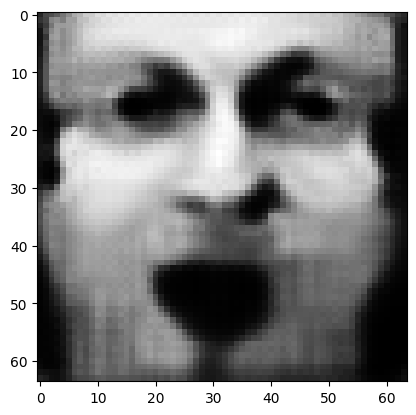

tensor([[3.7234e-04, 9.2375e-01, 3.7459e-06, 1.3551e-03, 1.1076e-05, 1.7828e-07,
         2.2474e-05, 6.6517e-06, 1.3846e-06, 2.3728e-06, 1.3505e-03, 1.5208e-04,
         1.1110e-03, 4.0541e-03, 9.3257e-04, 1.0566e-03, 6.1896e-05, 1.7369e-05,
         3.0655e-03, 3.4120e-04, 3.9225e-03, 2.8594e-03, 1.3687e-07, 1.6895e-03,
         1.4304e-04, 2.8614e-06, 2.8476e-03, 1.7968e-04, 1.6101e-03, 7.0185e-04,
         1.6476e-03, 7.2318e-04, 1.4381e-04, 3.3607e-02, 9.9769e-06, 5.9718e-04,
         1.7976e-03, 2.7503e-03, 3.1099e-03, 3.9938e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07931897044181824
tensor([[3.7231e-04, 9.2377e-01, 3.7437e-06, 1.3547e-03, 1.1071e-05, 1.7822e-07,
         2.2464e-05, 6.6497e-06, 1.3837e-06, 2.3716e-06, 1.3499e-03, 1.5202e-04,
         1.1106e-03, 4.0528e-03, 9.3217e-04, 1.0564e-03, 6.1865e-05, 1.7363e-05,
         3.0648e-03, 3.4108e-04, 3.9207e-03, 2.8583e-03, 1.3677e-07, 1.6891e-03,
         1.4297e-04, 2.8601e-06, 2.8468e-0

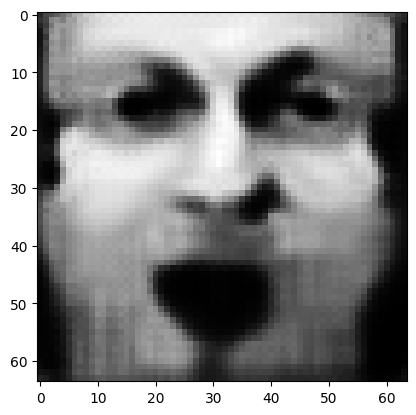

tensor([[3.7216e-04, 9.2387e-01, 3.7354e-06, 1.3531e-03, 1.1054e-05, 1.7801e-07,
         2.2425e-05, 6.6418e-06, 1.3800e-06, 2.3671e-06, 1.3477e-03, 1.5180e-04,
         1.1094e-03, 4.0475e-03, 9.3061e-04, 1.0557e-03, 6.1744e-05, 1.7340e-05,
         3.0620e-03, 3.4060e-04, 3.9138e-03, 2.8541e-03, 1.3639e-07, 1.6872e-03,
         1.4268e-04, 2.8547e-06, 2.8436e-03, 1.7922e-04, 1.6069e-03, 7.0060e-04,
         1.6443e-03, 7.2235e-04, 1.4352e-04, 3.3559e-02, 9.9471e-06, 5.9645e-04,
         1.7937e-03, 2.7449e-03, 3.1032e-03, 3.9873e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07918770611286163
tensor([[3.7213e-04, 9.2389e-01, 3.7333e-06, 1.3527e-03, 1.1049e-05, 1.7795e-07,
         2.2416e-05, 6.6398e-06, 1.3791e-06, 2.3660e-06, 1.3472e-03, 1.5174e-04,
         1.1090e-03, 4.0463e-03, 9.3023e-04, 1.0555e-03, 6.1714e-05, 1.7334e-05,
         3.0613e-03, 3.4049e-04, 3.9121e-03, 2.8531e-03, 1.3630e-07, 1.6868e-03,
         1.4261e-04, 2.8534e-06, 2.8428e-0

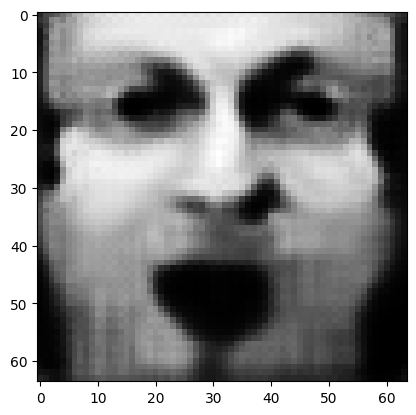

tensor([[3.7199e-04, 9.2398e-01, 3.7254e-06, 1.3512e-03, 1.1033e-05, 1.7775e-07,
         2.2379e-05, 6.6322e-06, 1.3757e-06, 2.3617e-06, 1.3451e-03, 1.5153e-04,
         1.1078e-03, 4.0413e-03, 9.2876e-04, 1.0547e-03, 6.1600e-05, 1.7312e-05,
         3.0586e-03, 3.4004e-04, 3.9056e-03, 2.8491e-03, 1.3593e-07, 1.6850e-03,
         1.4234e-04, 2.8483e-06, 2.8398e-03, 1.7879e-04, 1.6039e-03, 6.9942e-04,
         1.6412e-03, 7.2156e-04, 1.4326e-04, 3.3515e-02, 9.9189e-06, 5.9576e-04,
         1.7901e-03, 2.7398e-03, 3.0968e-03, 3.9810e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07906357198953629
tensor([[3.7196e-04, 9.2400e-01, 3.7235e-06, 1.3508e-03, 1.1029e-05, 1.7770e-07,
         2.2370e-05, 6.6304e-06, 1.3748e-06, 2.3607e-06, 1.3446e-03, 1.5148e-04,
         1.1075e-03, 4.0401e-03, 9.2839e-04, 1.0546e-03, 6.1572e-05, 1.7307e-05,
         3.0580e-03, 3.3992e-04, 3.9040e-03, 2.8481e-03, 1.3584e-07, 1.6846e-03,
         1.4227e-04, 2.8471e-06, 2.8390e-0

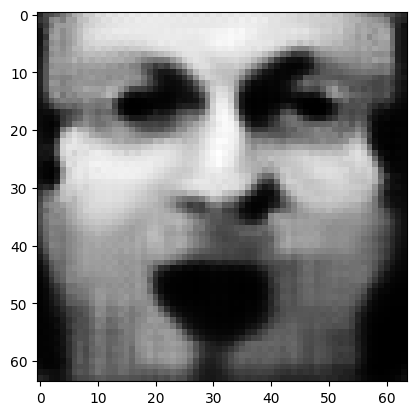

tensor([[3.7183e-04, 9.2409e-01, 3.7160e-06, 1.3494e-03, 1.1013e-05, 1.7751e-07,
         2.2336e-05, 6.6233e-06, 1.3715e-06, 2.3566e-06, 1.3426e-03, 1.5128e-04,
         1.1064e-03, 4.0354e-03, 9.2699e-04, 1.0539e-03, 6.1464e-05, 1.7286e-05,
         3.0554e-03, 3.3950e-04, 3.8978e-03, 2.8444e-03, 1.3550e-07, 1.6829e-03,
         1.4202e-04, 2.8422e-06, 2.8362e-03, 1.7838e-04, 1.6011e-03, 6.9829e-04,
         1.6383e-03, 7.2082e-04, 1.4300e-04, 3.3473e-02, 9.8922e-06, 5.9511e-04,
         1.7866e-03, 2.7350e-03, 3.0907e-03, 3.9751e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07894592732191086
tensor([[3.7180e-04, 9.2411e-01, 3.7141e-06, 1.3490e-03, 1.1009e-05, 1.7746e-07,
         2.2327e-05, 6.6215e-06, 1.3707e-06, 2.3556e-06, 1.3421e-03, 1.5123e-04,
         1.1061e-03, 4.0343e-03, 9.2665e-04, 1.0537e-03, 6.1437e-05, 1.7281e-05,
         3.0548e-03, 3.3939e-04, 3.8962e-03, 2.8435e-03, 1.3542e-07, 1.6825e-03,
         1.4195e-04, 2.8411e-06, 2.8355e-0

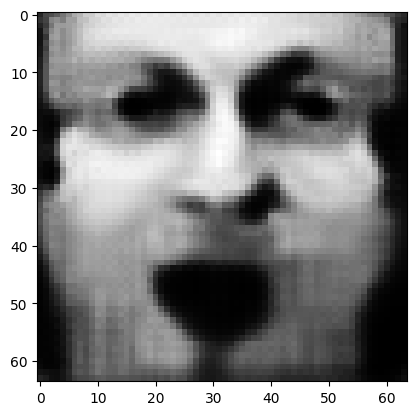

tensor([[3.7167e-04, 9.2419e-01, 3.7070e-06, 1.3477e-03, 1.0994e-05, 1.7728e-07,
         2.2295e-05, 6.6147e-06, 1.3676e-06, 2.3518e-06, 1.3402e-03, 1.5104e-04,
         1.1050e-03, 4.0298e-03, 9.2533e-04, 1.0531e-03, 6.1334e-05, 1.7261e-05,
         3.0524e-03, 3.3899e-04, 3.8904e-03, 2.8399e-03, 1.3509e-07, 1.6810e-03,
         1.4171e-04, 2.8365e-06, 2.8327e-03, 1.7800e-04, 1.5984e-03, 6.9723e-04,
         1.6356e-03, 7.2011e-04, 1.4276e-04, 3.3432e-02, 9.8668e-06, 5.9449e-04,
         1.7833e-03, 2.7304e-03, 3.0850e-03, 3.9694e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07883410900831223
tensor([[3.7165e-04, 9.2421e-01, 3.7053e-06, 1.3473e-03, 1.0991e-05, 1.7724e-07,
         2.2287e-05, 6.6131e-06, 1.3669e-06, 2.3509e-06, 1.3398e-03, 1.5100e-04,
         1.1048e-03, 4.0287e-03, 9.2500e-04, 1.0529e-03, 6.1309e-05, 1.7256e-05,
         3.0518e-03, 3.3889e-04, 3.8889e-03, 2.8390e-03, 1.3501e-07, 1.6806e-03,
         1.4165e-04, 2.8354e-06, 2.8321e-0

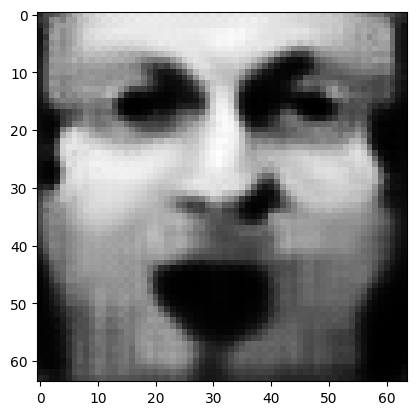

tensor([[3.7153e-04, 9.2429e-01, 3.6986e-06, 1.3460e-03, 1.0976e-05, 1.7706e-07,
         2.2256e-05, 6.6067e-06, 1.3639e-06, 2.3472e-06, 1.3380e-03, 1.5082e-04,
         1.1037e-03, 4.0245e-03, 9.2374e-04, 1.0523e-03, 6.1212e-05, 1.7238e-05,
         3.0496e-03, 3.3850e-04, 3.8833e-03, 2.8356e-03, 1.3470e-07, 1.6791e-03,
         1.4142e-04, 2.8310e-06, 2.8295e-03, 1.7763e-04, 1.5958e-03, 6.9622e-04,
         1.6330e-03, 7.1944e-04, 1.4253e-04, 3.3394e-02, 9.8430e-06, 5.9390e-04,
         1.7802e-03, 2.7261e-03, 3.0795e-03, 3.9641e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0787283405661583
tensor([[3.7150e-04, 9.2431e-01, 3.6969e-06, 1.3457e-03, 1.0973e-05, 1.7702e-07,
         2.2248e-05, 6.6051e-06, 1.3632e-06, 2.3463e-06, 1.3376e-03, 1.5078e-04,
         1.1035e-03, 4.0235e-03, 9.2344e-04, 1.0521e-03, 6.1188e-05, 1.7233e-05,
         3.0490e-03, 3.3841e-04, 3.8820e-03, 2.8348e-03, 1.3463e-07, 1.6787e-03,
         1.4137e-04, 2.8300e-06, 2.8289e-03

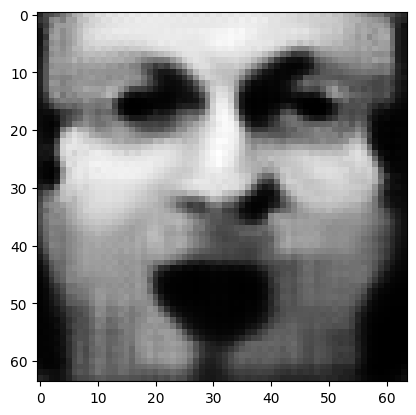

tensor([[3.7139e-04, 9.2438e-01, 3.6905e-06, 1.3445e-03, 1.0959e-05, 1.7686e-07,
         2.2219e-05, 6.5990e-06, 1.3604e-06, 2.3429e-06, 1.3359e-03, 1.5061e-04,
         1.1025e-03, 4.0195e-03, 9.2224e-04, 1.0515e-03, 6.1096e-05, 1.7216e-05,
         3.0468e-03, 3.3804e-04, 3.8767e-03, 2.8315e-03, 1.3433e-07, 1.6773e-03,
         1.4115e-04, 2.8259e-06, 2.8264e-03, 1.7728e-04, 1.5934e-03, 6.9526e-04,
         1.6305e-03, 7.1880e-04, 1.4232e-04, 3.3358e-02, 9.8202e-06, 5.9334e-04,
         1.7772e-03, 2.7220e-03, 3.0744e-03, 3.9590e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07862773537635803
tensor([[3.7137e-04, 9.2440e-01, 3.6890e-06, 1.3442e-03, 1.0956e-05, 1.7682e-07,
         2.2211e-05, 6.5975e-06, 1.3597e-06, 2.3420e-06, 1.3354e-03, 1.5056e-04,
         1.1023e-03, 4.0185e-03, 9.2194e-04, 1.0514e-03, 6.1073e-05, 1.7211e-05,
         3.0463e-03, 3.3795e-04, 3.8754e-03, 2.8307e-03, 1.3426e-07, 1.6770e-03,
         1.4109e-04, 2.8249e-06, 2.8258e-0

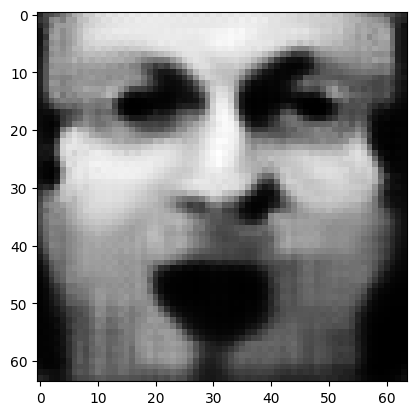

tensor([[3.7126e-04, 9.2447e-01, 3.6829e-06, 1.3430e-03, 1.0943e-05, 1.7666e-07,
         2.2183e-05, 6.5917e-06, 1.3571e-06, 2.3388e-06, 1.3338e-03, 1.5040e-04,
         1.1013e-03, 4.0147e-03, 9.2081e-04, 1.0508e-03, 6.0986e-05, 1.7194e-05,
         3.0443e-03, 3.3760e-04, 3.8704e-03, 2.8277e-03, 1.3398e-07, 1.6756e-03,
         1.4089e-04, 2.8210e-06, 2.8235e-03, 1.7696e-04, 1.5911e-03, 6.9435e-04,
         1.6281e-03, 7.1819e-04, 1.4211e-04, 3.3324e-02, 9.7986e-06, 5.9281e-04,
         1.7744e-03, 2.7181e-03, 3.0695e-03, 3.9542e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07853241264820099
tensor([[3.7124e-04, 9.2449e-01, 3.6814e-06, 1.3428e-03, 1.0940e-05, 1.7662e-07,
         2.2177e-05, 6.5903e-06, 1.3564e-06, 2.3380e-06, 1.3335e-03, 1.5036e-04,
         1.1011e-03, 4.0138e-03, 9.2054e-04, 1.0507e-03, 6.0964e-05, 1.7190e-05,
         3.0438e-03, 3.3752e-04, 3.8691e-03, 2.8269e-03, 1.3392e-07, 1.6753e-03,
         1.4084e-04, 2.8200e-06, 2.8229e-0

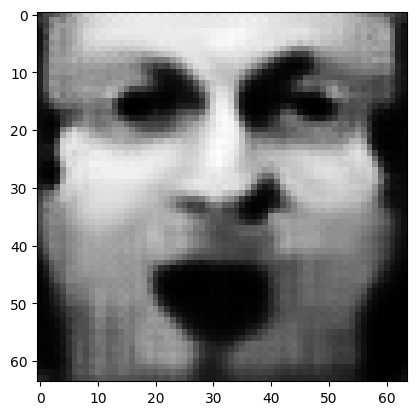

tensor([[3.7114e-04, 9.2456e-01, 3.6757e-06, 1.3417e-03, 1.0928e-05, 1.7648e-07,
         2.2150e-05, 6.5848e-06, 1.3539e-06, 2.3349e-06, 1.3319e-03, 1.5021e-04,
         1.1002e-03, 4.0102e-03, 9.1946e-04, 1.0502e-03, 6.0881e-05, 1.7174e-05,
         3.0418e-03, 3.3719e-04, 3.8644e-03, 2.8240e-03, 1.3365e-07, 1.6740e-03,
         1.4064e-04, 2.8163e-06, 2.8207e-03, 1.7664e-04, 1.5889e-03, 6.9348e-04,
         1.6259e-03, 7.1762e-04, 1.4192e-04, 3.3291e-02, 9.7782e-06, 5.9231e-04,
         1.7717e-03, 2.7144e-03, 3.0648e-03, 3.9497e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0784420445561409
tensor([[3.7111e-04, 9.2457e-01, 3.6743e-06, 1.3414e-03, 1.0925e-05, 1.7644e-07,
         2.2144e-05, 6.5835e-06, 1.3533e-06, 2.3341e-06, 1.3316e-03, 1.5017e-04,
         1.1000e-03, 4.0093e-03, 9.1919e-04, 1.0501e-03, 6.0861e-05, 1.7170e-05,
         3.0414e-03, 3.3711e-04, 3.8632e-03, 2.8233e-03, 1.3359e-07, 1.6737e-03,
         1.4059e-04, 2.8154e-06, 2.8202e-03

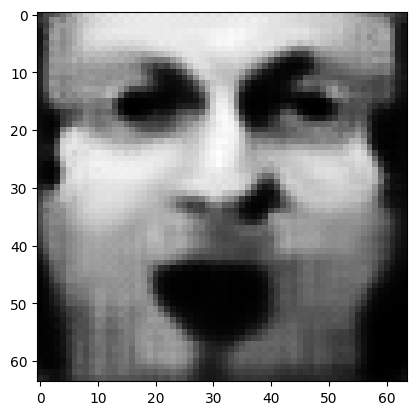

tensor([[3.7102e-04, 9.2463e-01, 3.6689e-06, 1.3404e-03, 1.0914e-05, 1.7630e-07,
         2.2119e-05, 6.5782e-06, 1.3509e-06, 2.3312e-06, 1.3301e-03, 1.5003e-04,
         1.0992e-03, 4.0059e-03, 9.1818e-04, 1.0495e-03, 6.0782e-05, 1.7155e-05,
         3.0395e-03, 3.3680e-04, 3.8587e-03, 2.8206e-03, 1.3334e-07, 1.6725e-03,
         1.4041e-04, 2.8119e-06, 2.8181e-03, 1.7635e-04, 1.5868e-03, 6.9267e-04,
         1.6238e-03, 7.1707e-04, 1.4173e-04, 3.3260e-02, 9.7588e-06, 5.9183e-04,
         1.7692e-03, 2.7109e-03, 3.0604e-03, 3.9454e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07835640013217926
tensor([[3.7099e-04, 9.2465e-01, 3.6676e-06, 1.3401e-03, 1.0911e-05, 1.7627e-07,
         2.2113e-05, 6.5770e-06, 1.3504e-06, 2.3304e-06, 1.3298e-03, 1.4999e-04,
         1.0990e-03, 4.0050e-03, 9.1793e-04, 1.0494e-03, 6.0763e-05, 1.7152e-05,
         3.0391e-03, 3.3672e-04, 3.8576e-03, 2.8199e-03, 1.3328e-07, 1.6722e-03,
         1.4036e-04, 2.8111e-06, 2.8176e-0

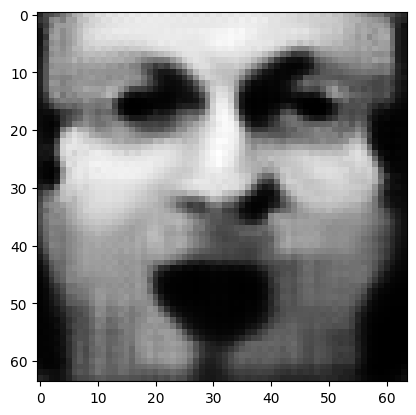

tensor([[3.7091e-04, 9.2471e-01, 3.6624e-06, 1.3391e-03, 1.0900e-05, 1.7613e-07,
         2.2089e-05, 6.5720e-06, 1.3481e-06, 2.3277e-06, 1.3284e-03, 1.4985e-04,
         1.0982e-03, 4.0018e-03, 9.1696e-04, 1.0490e-03, 6.0689e-05, 1.7137e-05,
         3.0373e-03, 3.3643e-04, 3.8533e-03, 2.8173e-03, 1.3305e-07, 1.6711e-03,
         1.4018e-04, 2.8078e-06, 2.8156e-03, 1.7607e-04, 1.5849e-03, 6.9189e-04,
         1.6217e-03, 7.1656e-04, 1.4156e-04, 3.3231e-02, 9.7406e-06, 5.9138e-04,
         1.7667e-03, 2.7076e-03, 3.0562e-03, 3.9413e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07827483117580414
tensor([[3.7088e-04, 9.2472e-01, 3.6611e-06, 1.3389e-03, 1.0898e-05, 1.7610e-07,
         2.2083e-05, 6.5708e-06, 1.3476e-06, 2.3270e-06, 1.3281e-03, 1.4982e-04,
         1.0980e-03, 4.0010e-03, 9.1673e-04, 1.0488e-03, 6.0670e-05, 1.7134e-05,
         3.0369e-03, 3.3635e-04, 3.8523e-03, 2.8166e-03, 1.3299e-07, 1.6708e-03,
         1.4014e-04, 2.8069e-06, 2.8151e-0

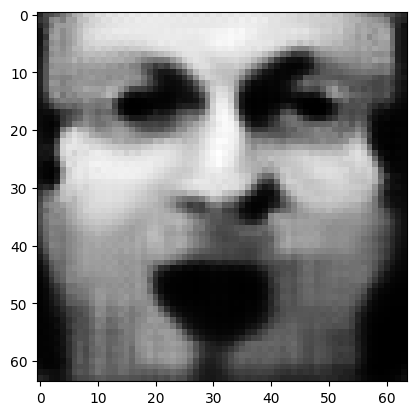

tensor([[3.7080e-04, 9.2478e-01, 3.6563e-06, 1.3379e-03, 1.0887e-05, 1.7598e-07,
         2.2060e-05, 6.5661e-06, 1.3454e-06, 2.3243e-06, 1.3268e-03, 1.4969e-04,
         1.0972e-03, 3.9979e-03, 9.1581e-04, 1.0484e-03, 6.0599e-05, 1.7120e-05,
         3.0352e-03, 3.3607e-04, 3.8482e-03, 2.8142e-03, 1.3277e-07, 1.6697e-03,
         1.3997e-04, 2.8038e-06, 2.8132e-03, 1.7580e-04, 1.5830e-03, 6.9115e-04,
         1.6198e-03, 7.1607e-04, 1.4139e-04, 3.3203e-02, 9.7231e-06, 5.9095e-04,
         1.7645e-03, 2.7044e-03, 3.0523e-03, 3.9374e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07819755375385284
tensor([[3.7078e-04, 9.2480e-01, 3.6551e-06, 1.3377e-03, 1.0885e-05, 1.7594e-07,
         2.2055e-05, 6.5650e-06, 1.3449e-06, 2.3237e-06, 1.3265e-03, 1.4966e-04,
         1.0970e-03, 3.9972e-03, 9.1558e-04, 1.0483e-03, 6.0582e-05, 1.7117e-05,
         3.0348e-03, 3.3600e-04, 3.8472e-03, 2.8136e-03, 1.3271e-07, 1.6694e-03,
         1.3993e-04, 2.8030e-06, 2.8128e-0

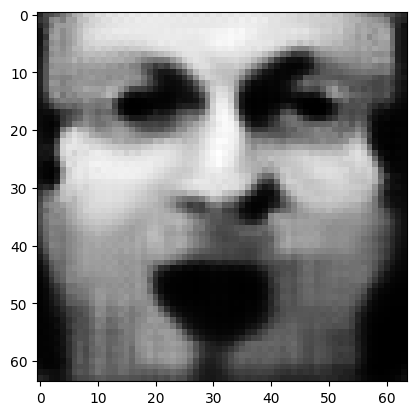

tensor([[3.7070e-04, 9.2485e-01, 3.6504e-06, 1.3368e-03, 1.0875e-05, 1.7582e-07,
         2.2033e-05, 6.5605e-06, 1.3429e-06, 2.3212e-06, 1.3252e-03, 1.4953e-04,
         1.0963e-03, 3.9943e-03, 9.1471e-04, 1.0478e-03, 6.0515e-05, 1.7104e-05,
         3.0332e-03, 3.3574e-04, 3.8434e-03, 2.8112e-03, 1.3250e-07, 1.6684e-03,
         1.3978e-04, 2.8000e-06, 2.8110e-03, 1.7555e-04, 1.5812e-03, 6.9045e-04,
         1.6180e-03, 7.1560e-04, 1.4124e-04, 3.3177e-02, 9.7067e-06, 5.9054e-04,
         1.7623e-03, 2.7014e-03, 3.0485e-03, 3.9337e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07812424004077911
tensor([[3.7068e-04, 9.2486e-01, 3.6493e-06, 1.3366e-03, 1.0873e-05, 1.7580e-07,
         2.2028e-05, 6.5594e-06, 1.3424e-06, 2.3205e-06, 1.3249e-03, 1.4950e-04,
         1.0962e-03, 3.9935e-03, 9.1450e-04, 1.0477e-03, 6.0499e-05, 1.7101e-05,
         3.0328e-03, 3.3567e-04, 3.8424e-03, 2.8106e-03, 1.3245e-07, 1.6681e-03,
         1.3974e-04, 2.7993e-06, 2.8105e-0

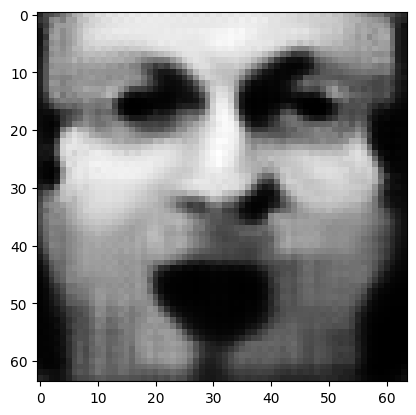

tensor([[3.7060e-04, 9.2491e-01, 3.6449e-06, 1.3357e-03, 1.0863e-05, 1.7568e-07,
         2.2008e-05, 6.5552e-06, 1.3405e-06, 2.3182e-06, 1.3238e-03, 1.4939e-04,
         1.0955e-03, 3.9908e-03, 9.1367e-04, 1.0473e-03, 6.0435e-05, 1.7089e-05,
         3.0313e-03, 3.3542e-04, 3.8388e-03, 2.8084e-03, 1.3225e-07, 1.6672e-03,
         1.3959e-04, 2.7965e-06, 2.8089e-03, 1.7531e-04, 1.5795e-03, 6.8979e-04,
         1.6163e-03, 7.1516e-04, 1.4109e-04, 3.3152e-02, 9.6910e-06, 5.9015e-04,
         1.7602e-03, 2.6986e-03, 3.0450e-03, 3.9302e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07805466651916504
tensor([[3.7058e-04, 9.2493e-01, 3.6438e-06, 1.3355e-03, 1.0861e-05, 1.7565e-07,
         2.2003e-05, 6.5542e-06, 1.3400e-06, 2.3176e-06, 1.3235e-03, 1.4936e-04,
         1.0953e-03, 3.9901e-03, 9.1347e-04, 1.0472e-03, 6.0420e-05, 1.7086e-05,
         3.0310e-03, 3.3536e-04, 3.8379e-03, 2.8079e-03, 1.3220e-07, 1.6669e-03,
         1.3955e-04, 2.7958e-06, 2.8085e-0

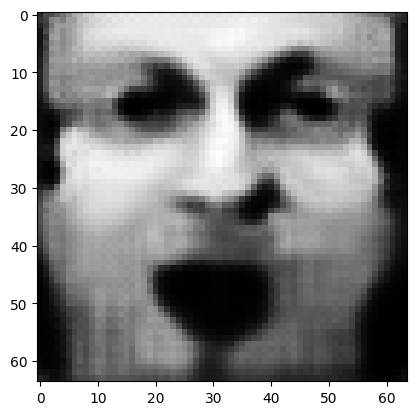

tensor([[3.7051e-04, 9.2497e-01, 3.6397e-06, 1.3347e-03, 1.0852e-05, 1.7555e-07,
         2.1984e-05, 6.5502e-06, 1.3382e-06, 2.3153e-06, 1.3224e-03, 1.4925e-04,
         1.0947e-03, 3.9875e-03, 9.1268e-04, 1.0469e-03, 6.0359e-05, 1.7074e-05,
         3.0295e-03, 3.3511e-04, 3.8344e-03, 2.8057e-03, 1.3201e-07, 1.6660e-03,
         1.3941e-04, 2.7931e-06, 2.8068e-03, 1.7508e-04, 1.5779e-03, 6.8916e-04,
         1.6147e-03, 7.1474e-04, 1.4095e-04, 3.3128e-02, 9.6762e-06, 5.8978e-04,
         1.7583e-03, 2.6959e-03, 3.0416e-03, 3.9269e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07798884063959122
tensor([[3.7049e-04, 9.2499e-01, 3.6386e-06, 1.3345e-03, 1.0850e-05, 1.7552e-07,
         2.1979e-05, 6.5492e-06, 1.3377e-06, 2.3148e-06, 1.3221e-03, 1.4922e-04,
         1.0945e-03, 3.9868e-03, 9.1250e-04, 1.0468e-03, 6.0344e-05, 1.7071e-05,
         3.0292e-03, 3.3506e-04, 3.8336e-03, 2.8052e-03, 1.3196e-07, 1.6658e-03,
         1.3937e-04, 2.7924e-06, 2.8064e-0

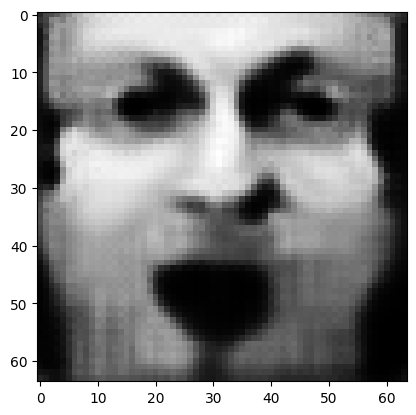

tensor([[3.7042e-04, 9.2503e-01, 3.6347e-06, 1.3337e-03, 1.0842e-05, 1.7542e-07,
         2.1961e-05, 6.5454e-06, 1.3360e-06, 2.3126e-06, 1.3210e-03, 1.4911e-04,
         1.0939e-03, 3.9844e-03, 9.1175e-04, 1.0464e-03, 6.0287e-05, 1.7060e-05,
         3.0278e-03, 3.3483e-04, 3.8303e-03, 2.8032e-03, 1.3178e-07, 1.6649e-03,
         1.3924e-04, 2.7899e-06, 2.8049e-03, 1.7487e-04, 1.5764e-03, 6.8856e-04,
         1.6131e-03, 7.1435e-04, 1.4081e-04, 3.3105e-02, 9.6621e-06, 5.8943e-04,
         1.7565e-03, 2.6933e-03, 3.0384e-03, 3.9237e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07792609930038452
tensor([[3.7041e-04, 9.2504e-01, 3.6337e-06, 1.3336e-03, 1.0840e-05, 1.7539e-07,
         2.1956e-05, 6.5445e-06, 1.3356e-06, 2.3121e-06, 1.3208e-03, 1.4909e-04,
         1.0938e-03, 3.9838e-03, 9.1157e-04, 1.0463e-03, 6.0273e-05, 1.7057e-05,
         3.0275e-03, 3.3477e-04, 3.8295e-03, 2.8027e-03, 1.3174e-07, 1.6647e-03,
         1.3920e-04, 2.7893e-06, 2.8045e-0

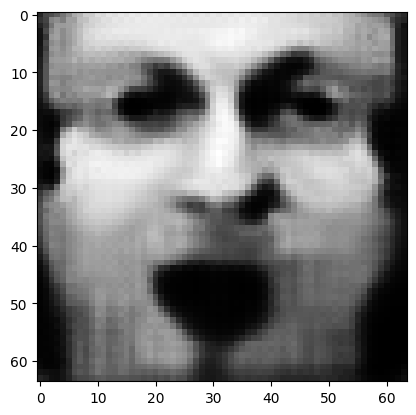

tensor([[3.7034e-04, 9.2509e-01, 3.6300e-06, 1.3328e-03, 1.0832e-05, 1.7530e-07,
         2.1939e-05, 6.5408e-06, 1.3340e-06, 2.3101e-06, 1.3198e-03, 1.4899e-04,
         1.0932e-03, 3.9814e-03, 9.1086e-04, 1.0460e-03, 6.0219e-05, 1.7047e-05,
         3.0262e-03, 3.3455e-04, 3.8263e-03, 2.8008e-03, 1.3156e-07, 1.6638e-03,
         1.3908e-04, 2.7869e-06, 2.8031e-03, 1.7466e-04, 1.5750e-03, 6.8799e-04,
         1.6117e-03, 7.1397e-04, 1.4068e-04, 3.3084e-02, 9.6488e-06, 5.8910e-04,
         1.7547e-03, 2.6909e-03, 3.0353e-03, 3.9208e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07786665856838226
tensor([[3.7033e-04, 9.2510e-01, 3.6290e-06, 1.3327e-03, 1.0830e-05, 1.7527e-07,
         2.1935e-05, 6.5399e-06, 1.3336e-06, 2.3096e-06, 1.3195e-03, 1.4896e-04,
         1.0930e-03, 3.9808e-03, 9.1069e-04, 1.0459e-03, 6.0206e-05, 1.7044e-05,
         3.0259e-03, 3.3450e-04, 3.8256e-03, 2.8003e-03, 1.3152e-07, 1.6636e-03,
         1.3904e-04, 2.7863e-06, 2.8027e-0

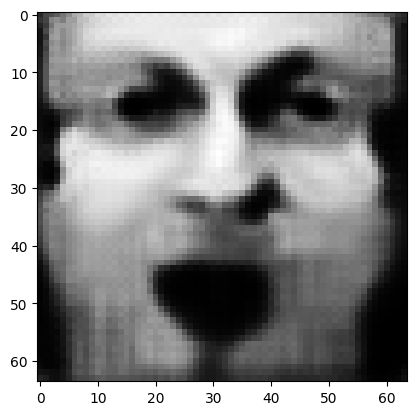

tensor([[3.7026e-04, 9.2514e-01, 3.6255e-06, 1.3320e-03, 1.0822e-05, 1.7518e-07,
         2.1918e-05, 6.5365e-06, 1.3320e-06, 2.3076e-06, 1.3186e-03, 1.4887e-04,
         1.0925e-03, 3.9786e-03, 9.1002e-04, 1.0455e-03, 6.0154e-05, 1.7035e-05,
         3.0247e-03, 3.3430e-04, 3.8226e-03, 2.7985e-03, 1.3136e-07, 1.6628e-03,
         1.3892e-04, 2.7840e-06, 2.8013e-03, 1.7447e-04, 1.5736e-03, 6.8745e-04,
         1.6103e-03, 7.1361e-04, 1.4056e-04, 3.3063e-02, 9.6361e-06, 5.8878e-04,
         1.7530e-03, 2.6886e-03, 3.0324e-03, 3.9179e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07781008630990982
tensor([[3.7025e-04, 9.2515e-01, 3.6246e-06, 1.3318e-03, 1.0820e-05, 1.7516e-07,
         2.1914e-05, 6.5357e-06, 1.3316e-06, 2.3072e-06, 1.3184e-03, 1.4884e-04,
         1.0924e-03, 3.9780e-03, 9.0985e-04, 1.0455e-03, 6.0142e-05, 1.7032e-05,
         3.0244e-03, 3.3424e-04, 3.8219e-03, 2.7981e-03, 1.3132e-07, 1.6626e-03,
         1.3889e-04, 2.7834e-06, 2.8010e-0

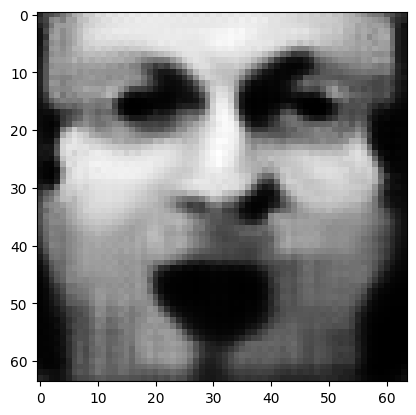

tensor([[3.7019e-04, 9.2519e-01, 3.6212e-06, 1.3311e-03, 1.0813e-05, 1.7507e-07,
         2.1899e-05, 6.5324e-06, 1.3302e-06, 2.3053e-06, 1.3175e-03, 1.4875e-04,
         1.0918e-03, 3.9759e-03, 9.0922e-04, 1.0451e-03, 6.0093e-05, 1.7023e-05,
         3.0232e-03, 3.3405e-04, 3.8191e-03, 2.7964e-03, 1.3117e-07, 1.6619e-03,
         1.3878e-04, 2.7812e-06, 2.7997e-03, 1.7429e-04, 1.5723e-03, 6.8694e-04,
         1.6090e-03, 7.1327e-04, 1.4045e-04, 3.3044e-02, 9.6241e-06, 5.8848e-04,
         1.7515e-03, 2.6864e-03, 3.0297e-03, 3.9152e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07775648683309555
tensor([[3.7018e-04, 9.2520e-01, 3.6204e-06, 1.3310e-03, 1.0812e-05, 1.7505e-07,
         2.1895e-05, 6.5316e-06, 1.3298e-06, 2.3049e-06, 1.3172e-03, 1.4873e-04,
         1.0917e-03, 3.9754e-03, 9.0906e-04, 1.0451e-03, 6.0080e-05, 1.7020e-05,
         3.0229e-03, 3.3400e-04, 3.8184e-03, 2.7959e-03, 1.3113e-07, 1.6617e-03,
         1.3875e-04, 2.7807e-06, 2.7994e-0

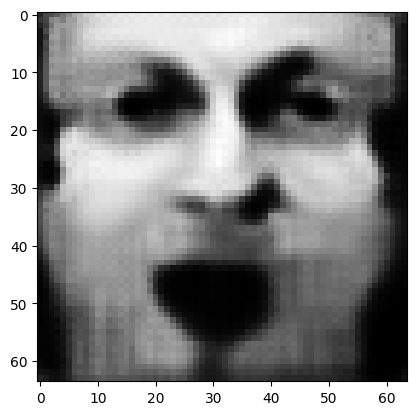

tensor([[3.7012e-04, 9.2524e-01, 3.6172e-06, 1.3304e-03, 1.0805e-05, 1.7497e-07,
         2.1880e-05, 6.5285e-06, 1.3284e-06, 2.3031e-06, 1.3164e-03, 1.4864e-04,
         1.0912e-03, 3.9733e-03, 9.0846e-04, 1.0448e-03, 6.0034e-05, 1.7011e-05,
         3.0218e-03, 3.3382e-04, 3.8157e-03, 2.7943e-03, 1.3098e-07, 1.6610e-03,
         1.3864e-04, 2.7786e-06, 2.7981e-03, 1.7411e-04, 1.5711e-03, 6.8645e-04,
         1.6077e-03, 7.1295e-04, 1.4034e-04, 3.3026e-02, 9.6127e-06, 5.8820e-04,
         1.7499e-03, 2.6843e-03, 3.0271e-03, 3.9126e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07770564407110214
tensor([[3.7011e-04, 9.2525e-01, 3.6164e-06, 1.3302e-03, 1.0803e-05, 1.7495e-07,
         2.1876e-05, 6.5278e-06, 1.3281e-06, 2.3027e-06, 1.3162e-03, 1.4862e-04,
         1.0911e-03, 3.9728e-03, 9.0831e-04, 1.0447e-03, 6.0023e-05, 1.7009e-05,
         3.0216e-03, 3.3377e-04, 3.8150e-03, 2.7939e-03, 1.3095e-07, 1.6608e-03,
         1.3861e-04, 2.7781e-06, 2.7978e-0

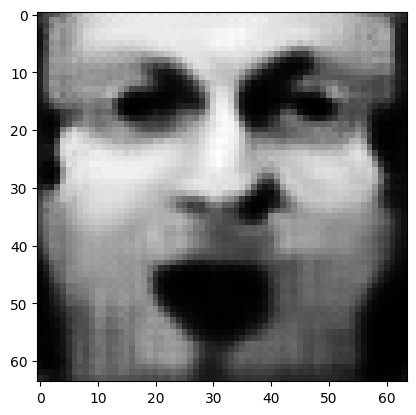

tensor([[3.7005e-04, 9.2528e-01, 3.6134e-06, 1.3296e-03, 1.0797e-05, 1.7487e-07,
         2.1862e-05, 6.5248e-06, 1.3267e-06, 2.3010e-06, 1.3154e-03, 1.4854e-04,
         1.0906e-03, 3.9709e-03, 9.0774e-04, 1.0444e-03, 5.9978e-05, 1.7001e-05,
         3.0205e-03, 3.3360e-04, 3.8125e-03, 2.7924e-03, 1.3081e-07, 1.6601e-03,
         1.3851e-04, 2.7762e-06, 2.7967e-03, 1.7394e-04, 1.5699e-03, 6.8599e-04,
         1.6065e-03, 7.1264e-04, 1.4023e-04, 3.3008e-02, 9.6018e-06, 5.8793e-04,
         1.7485e-03, 2.6824e-03, 3.0246e-03, 3.9102e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07765722274780273
tensor([[3.7004e-04, 9.2529e-01, 3.6126e-06, 1.3295e-03, 1.0795e-05, 1.7485e-07,
         2.1859e-05, 6.5241e-06, 1.3264e-06, 2.3006e-06, 1.3152e-03, 1.4852e-04,
         1.0905e-03, 3.9704e-03, 9.0759e-04, 1.0443e-03, 5.9968e-05, 1.6999e-05,
         3.0203e-03, 3.3355e-04, 3.8119e-03, 2.7920e-03, 1.3077e-07, 1.6600e-03,
         1.3848e-04, 2.7757e-06, 2.7964e-0

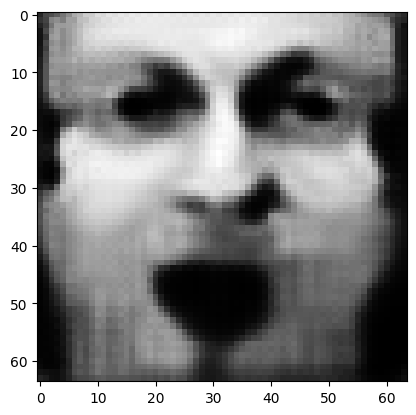

tensor([[3.6999e-04, 9.2532e-01, 3.6097e-06, 1.3289e-03, 1.0789e-05, 1.7477e-07,
         2.1845e-05, 6.5213e-06, 1.3252e-06, 2.2991e-06, 1.3144e-03, 1.4844e-04,
         1.0901e-03, 3.9686e-03, 9.0705e-04, 1.0441e-03, 5.9926e-05, 1.6991e-05,
         3.0193e-03, 3.3338e-04, 3.8095e-03, 2.7905e-03, 1.3064e-07, 1.6593e-03,
         1.3838e-04, 2.7738e-06, 2.7952e-03, 1.7379e-04, 1.5688e-03, 6.8555e-04,
         1.6054e-03, 7.1235e-04, 1.4014e-04, 3.2991e-02, 9.5916e-06, 5.8767e-04,
         1.7472e-03, 2.6805e-03, 3.0222e-03, 3.9079e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07761133462190628
tensor([[3.6998e-04, 9.2533e-01, 3.6090e-06, 1.3288e-03, 1.0788e-05, 1.7475e-07,
         2.1842e-05, 6.5206e-06, 1.3248e-06, 2.2987e-06, 1.3142e-03, 1.4842e-04,
         1.0899e-03, 3.9682e-03, 9.0692e-04, 1.0440e-03, 5.9915e-05, 1.6989e-05,
         3.0190e-03, 3.3334e-04, 3.8089e-03, 2.7901e-03, 1.3061e-07, 1.6592e-03,
         1.3836e-04, 2.7734e-06, 2.7950e-0

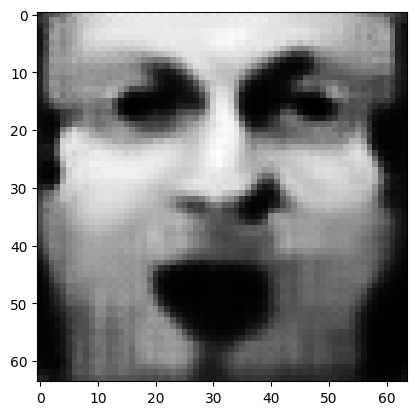

tensor([[3.6993e-04, 9.2536e-01, 3.6063e-06, 1.3282e-03, 1.0782e-05, 1.7468e-07,
         2.1829e-05, 6.5179e-06, 1.3236e-06, 2.2972e-06, 1.3135e-03, 1.4835e-04,
         1.0895e-03, 3.9664e-03, 9.0640e-04, 1.0437e-03, 5.9876e-05, 1.6981e-05,
         3.0181e-03, 3.3318e-04, 3.8066e-03, 2.7887e-03, 1.3049e-07, 1.6585e-03,
         1.3826e-04, 2.7716e-06, 2.7939e-03, 1.7364e-04, 1.5678e-03, 6.8513e-04,
         1.6043e-03, 7.1208e-04, 1.4004e-04, 3.2976e-02, 9.5818e-06, 5.8743e-04,
         1.7459e-03, 2.6787e-03, 3.0200e-03, 3.9057e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07756765186786652
tensor([[3.6992e-04, 9.2537e-01, 3.6056e-06, 1.3281e-03, 1.0780e-05, 1.7467e-07,
         2.1826e-05, 6.5173e-06, 1.3234e-06, 2.2968e-06, 1.3133e-03, 1.4833e-04,
         1.0894e-03, 3.9660e-03, 9.0627e-04, 1.0437e-03, 5.9866e-05, 1.6979e-05,
         3.0178e-03, 3.3314e-04, 3.8060e-03, 2.7884e-03, 1.3046e-07, 1.6584e-03,
         1.3824e-04, 2.7712e-06, 2.7936e-0

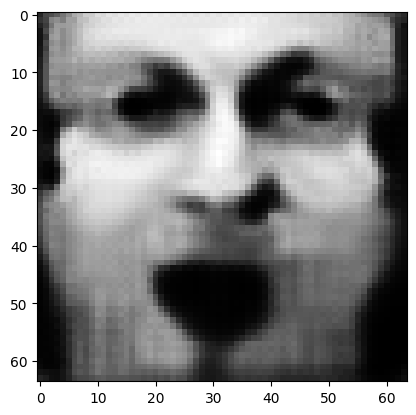

tensor([[3.6987e-04, 9.2540e-01, 3.6030e-06, 1.3276e-03, 1.0775e-05, 1.7460e-07,
         2.1814e-05, 6.5148e-06, 1.3222e-06, 2.2954e-06, 1.3126e-03, 1.4826e-04,
         1.0890e-03, 3.9644e-03, 9.0578e-04, 1.0434e-03, 5.9828e-05, 1.6972e-05,
         3.0170e-03, 3.3299e-04, 3.8038e-03, 2.7871e-03, 1.3034e-07, 1.6578e-03,
         1.3815e-04, 2.7695e-06, 2.7926e-03, 1.7350e-04, 1.5668e-03, 6.8473e-04,
         1.6033e-03, 7.1181e-04, 1.3995e-04, 3.2961e-02, 9.5725e-06, 5.8720e-04,
         1.7447e-03, 2.6770e-03, 3.0179e-03, 3.9036e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07752639055252075
tensor([[3.6986e-04, 9.2541e-01, 3.6024e-06, 1.3275e-03, 1.0773e-05, 1.7458e-07,
         2.1811e-05, 6.5142e-06, 1.3219e-06, 2.2951e-06, 1.3124e-03, 1.4825e-04,
         1.0889e-03, 3.9640e-03, 9.0566e-04, 1.0434e-03, 5.9819e-05, 1.6970e-05,
         3.0167e-03, 3.3296e-04, 3.8033e-03, 2.7868e-03, 1.3031e-07, 1.6577e-03,
         1.3813e-04, 2.7691e-06, 2.7924e-0

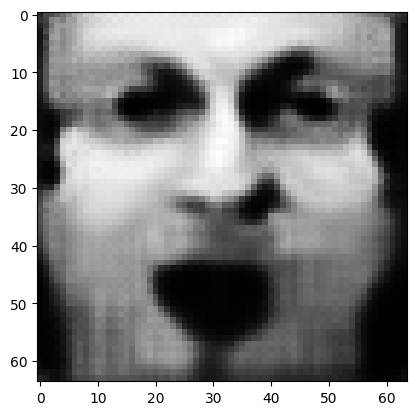

tensor([[3.6982e-04, 9.2544e-01, 3.5999e-06, 1.3270e-03, 1.0768e-05, 1.7452e-07,
         2.1800e-05, 6.5118e-06, 1.3209e-06, 2.2937e-06, 1.3118e-03, 1.4818e-04,
         1.0885e-03, 3.9624e-03, 9.0519e-04, 1.0432e-03, 5.9783e-05, 1.6963e-05,
         3.0159e-03, 3.3281e-04, 3.8012e-03, 2.7855e-03, 1.3019e-07, 1.6571e-03,
         1.3804e-04, 2.7675e-06, 2.7914e-03, 1.7336e-04, 1.5658e-03, 6.8435e-04,
         1.6023e-03, 7.1156e-04, 1.3987e-04, 3.2946e-02, 9.5637e-06, 5.8698e-04,
         1.7435e-03, 2.6754e-03, 3.0159e-03, 3.9016e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07748689502477646
tensor([[3.6981e-04, 9.2545e-01, 3.5993e-06, 1.3269e-03, 1.0767e-05, 1.7450e-07,
         2.1797e-05, 6.5112e-06, 1.3206e-06, 2.2934e-06, 1.3116e-03, 1.4816e-04,
         1.0884e-03, 3.9620e-03, 9.0508e-04, 1.0431e-03, 5.9775e-05, 1.6961e-05,
         3.0157e-03, 3.3278e-04, 3.8007e-03, 2.7852e-03, 1.3017e-07, 1.6570e-03,
         1.3802e-04, 2.7671e-06, 2.7912e-0

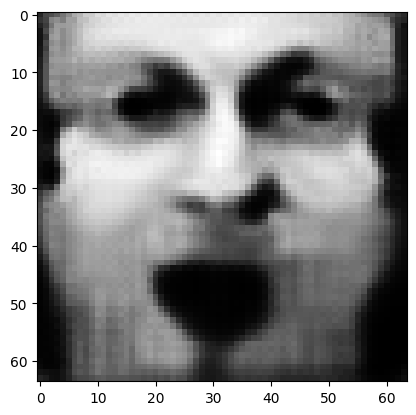

tensor([[3.6976e-04, 9.2547e-01, 3.5969e-06, 1.3264e-03, 1.0762e-05, 1.7444e-07,
         2.1786e-05, 6.5089e-06, 1.3196e-06, 2.2921e-06, 1.3110e-03, 1.4810e-04,
         1.0881e-03, 3.9605e-03, 9.0463e-04, 1.0429e-03, 5.9740e-05, 1.6955e-05,
         3.0149e-03, 3.3264e-04, 3.7988e-03, 2.7840e-03, 1.3006e-07, 1.6564e-03,
         1.3794e-04, 2.7655e-06, 2.7903e-03, 1.7323e-04, 1.5649e-03, 6.8400e-04,
         1.6014e-03, 7.1133e-04, 1.3979e-04, 3.2933e-02, 9.5554e-06, 5.8677e-04,
         1.7424e-03, 2.6739e-03, 3.0140e-03, 3.8997e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0774495005607605
tensor([[3.6975e-04, 9.2548e-01, 3.5963e-06, 1.3263e-03, 1.0761e-05, 1.7443e-07,
         2.1783e-05, 6.5084e-06, 1.3193e-06, 2.2918e-06, 1.3108e-03, 1.4809e-04,
         1.0880e-03, 3.9602e-03, 9.0453e-04, 1.0428e-03, 5.9732e-05, 1.6953e-05,
         3.0147e-03, 3.3261e-04, 3.7983e-03, 2.7837e-03, 1.3003e-07, 1.6563e-03,
         1.3792e-04, 2.7652e-06, 2.7901e-03

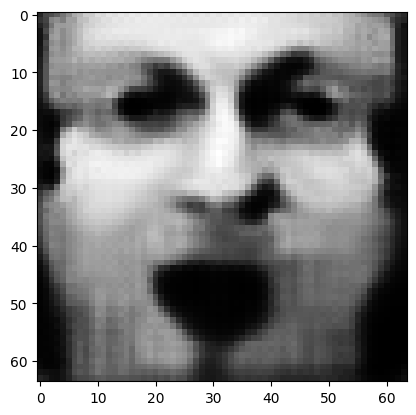

tensor([[3.6972e-04, 9.2551e-01, 3.5941e-06, 1.3259e-03, 1.0756e-05, 1.7437e-07,
         2.1773e-05, 6.5062e-06, 1.3184e-06, 2.2906e-06, 1.3102e-03, 1.4803e-04,
         1.0876e-03, 3.9587e-03, 9.0410e-04, 1.0426e-03, 5.9700e-05, 1.6947e-05,
         3.0139e-03, 3.3248e-04, 3.7964e-03, 2.7825e-03, 1.2993e-07, 1.6558e-03,
         1.3785e-04, 2.7637e-06, 2.7892e-03, 1.7311e-04, 1.5641e-03, 6.8366e-04,
         1.6005e-03, 7.1110e-04, 1.3971e-04, 3.2920e-02, 9.5475e-06, 5.8657e-04,
         1.7414e-03, 2.6724e-03, 3.0121e-03, 3.8979e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07741397619247437
tensor([[3.6971e-04, 9.2551e-01, 3.5936e-06, 1.3258e-03, 1.0755e-05, 1.7435e-07,
         2.1771e-05, 6.5057e-06, 1.3181e-06, 2.2903e-06, 1.3101e-03, 1.4801e-04,
         1.0876e-03, 3.9584e-03, 9.0400e-04, 1.0426e-03, 5.9692e-05, 1.6945e-05,
         3.0137e-03, 3.3245e-04, 3.7960e-03, 2.7823e-03, 1.2991e-07, 1.6557e-03,
         1.3783e-04, 2.7634e-06, 2.7890e-0

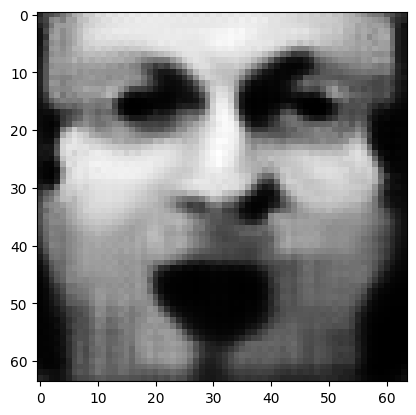

tensor([[3.6967e-04, 9.2554e-01, 3.5914e-06, 1.3254e-03, 1.0750e-05, 1.7430e-07,
         2.1761e-05, 6.5036e-06, 1.3172e-06, 2.2891e-06, 1.3095e-03, 1.4795e-04,
         1.0872e-03, 3.9571e-03, 9.0360e-04, 1.0424e-03, 5.9661e-05, 1.6939e-05,
         3.0130e-03, 3.3232e-04, 3.7942e-03, 2.7812e-03, 1.2981e-07, 1.6552e-03,
         1.3776e-04, 2.7620e-06, 2.7882e-03, 1.7300e-04, 1.5632e-03, 6.8333e-04,
         1.5997e-03, 7.1089e-04, 1.3964e-04, 3.2908e-02, 9.5399e-06, 5.8638e-04,
         1.7404e-03, 2.6711e-03, 3.0104e-03, 3.8962e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07738032191991806
tensor([[3.6966e-04, 9.2554e-01, 3.5909e-06, 1.3253e-03, 1.0749e-05, 1.7429e-07,
         2.1758e-05, 6.5031e-06, 1.3170e-06, 2.2888e-06, 1.3094e-03, 1.4794e-04,
         1.0871e-03, 3.9567e-03, 9.0350e-04, 1.0423e-03, 5.9653e-05, 1.6938e-05,
         3.0128e-03, 3.3229e-04, 3.7938e-03, 2.7809e-03, 1.2979e-07, 1.6551e-03,
         1.3774e-04, 2.7617e-06, 2.7879e-0

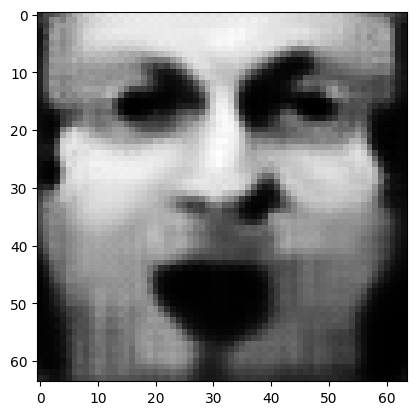

tensor([[3.6962e-04, 9.2557e-01, 3.5889e-06, 1.3249e-03, 1.0745e-05, 1.7423e-07,
         2.1749e-05, 6.5012e-06, 1.3161e-06, 2.2878e-06, 1.3088e-03, 1.4789e-04,
         1.0868e-03, 3.9555e-03, 9.0312e-04, 1.0421e-03, 5.9624e-05, 1.6932e-05,
         3.0121e-03, 3.3218e-04, 3.7921e-03, 2.7799e-03, 1.2970e-07, 1.6547e-03,
         1.3767e-04, 2.7604e-06, 2.7872e-03, 1.7289e-04, 1.5625e-03, 6.8303e-04,
         1.5989e-03, 7.1068e-04, 1.3957e-04, 3.2896e-02, 9.5328e-06, 5.8620e-04,
         1.7394e-03, 2.6697e-03, 3.0088e-03, 3.8946e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07734821736812592
tensor([[3.6962e-04, 9.2557e-01, 3.5884e-06, 1.3248e-03, 1.0744e-05, 1.7422e-07,
         2.1747e-05, 6.5007e-06, 1.3159e-06, 2.2875e-06, 1.3087e-03, 1.4787e-04,
         1.0868e-03, 3.9552e-03, 9.0303e-04, 1.0421e-03, 5.9617e-05, 1.6931e-05,
         3.0119e-03, 3.3215e-04, 3.7917e-03, 2.7796e-03, 1.2967e-07, 1.6545e-03,
         1.3765e-04, 2.7601e-06, 2.7870e-0

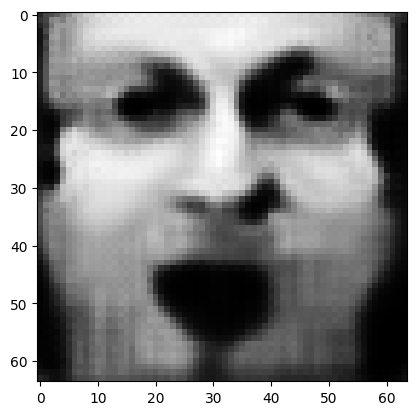

tensor([[3.6958e-04, 9.2560e-01, 3.5865e-06, 1.3244e-03, 1.0740e-05, 1.7417e-07,
         2.1738e-05, 6.4988e-06, 1.3151e-06, 2.2865e-06, 1.3082e-03, 1.4782e-04,
         1.0865e-03, 3.9539e-03, 9.0267e-04, 1.0419e-03, 5.9590e-05, 1.6926e-05,
         3.0113e-03, 3.3204e-04, 3.7901e-03, 2.7787e-03, 1.2959e-07, 1.6541e-03,
         1.3759e-04, 2.7588e-06, 2.7862e-03, 1.7278e-04, 1.5617e-03, 6.8274e-04,
         1.5982e-03, 7.1049e-04, 1.3951e-04, 3.2885e-02, 9.5260e-06, 5.8603e-04,
         1.7385e-03, 2.6685e-03, 3.0072e-03, 3.8931e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07731775939464569
tensor([[3.6957e-04, 9.2560e-01, 3.5860e-06, 1.3243e-03, 1.0739e-05, 1.7416e-07,
         2.1736e-05, 6.4984e-06, 1.3149e-06, 2.2862e-06, 1.3081e-03, 1.4781e-04,
         1.0864e-03, 3.9536e-03, 9.0258e-04, 1.0419e-03, 5.9583e-05, 1.6924e-05,
         3.0111e-03, 3.3201e-04, 3.7897e-03, 2.7784e-03, 1.2957e-07, 1.6540e-03,
         1.3757e-04, 2.7585e-06, 2.7860e-0

In [138]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=1)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.1448211669921875


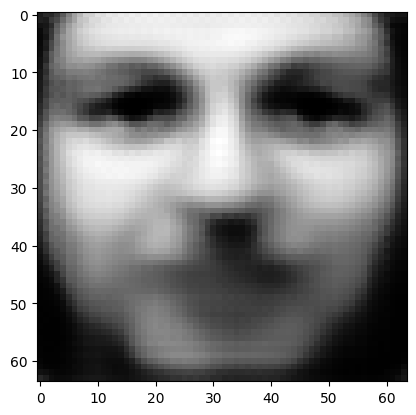

tensor([[9.6094e-05, 2.8939e-04, 5.5266e-02, 5.1584e-03, 1.5966e-03, 1.3449e-05,
         2.0413e-02, 2.6604e-04, 1.4694e-01, 8.3366e-03, 9.3792e-03, 9.6974e-03,
         2.1848e-02, 8.3842e-03, 4.4215e-03, 8.3842e-04, 2.5029e-02, 7.3414e-04,
         2.4008e-03, 1.6410e-03, 1.0860e-01, 3.1560e-02, 1.0906e-02, 6.3569e-03,
         9.1706e-02, 9.2929e-04, 6.5646e-03, 3.9593e-02, 4.0518e-02, 9.6215e-03,
         2.7536e-02, 3.2349e-04, 1.8767e-02, 6.2846e-03, 3.8219e-02, 6.9062e-04,
         2.4252e-02, 1.1585e-01, 6.0961e-02, 3.8005e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.895596504211426
tensor([[7.8136e-05, 2.5663e-04, 1.1859e-01, 6.9035e-03, 1.2700e-03, 1.4589e-05,
         1.7906e-02, 3.2581e-04, 1.2925e-01, 8.8010e-03, 9.7641e-03, 8.3037e-03,
         1.9750e-02, 9.4134e-03, 3.5378e-03, 1.0072e-03, 2.3681e-02, 5.3547e-04,
         2.5203e-03, 2.0238e-03, 1.2863e-01, 3.4146e-02, 9.2806e-03, 4.9308e-03,
         5.8701e-02, 8.7351e-04, 7.2543e-03,

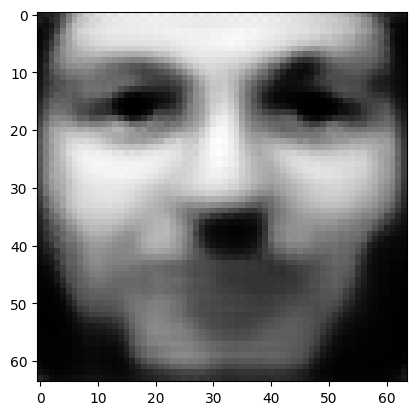

tensor([[2.2383e-05, 1.1510e-04, 4.9029e-01, 7.2042e-03, 4.0840e-04, 1.1299e-05,
         1.0252e-02, 3.4758e-04, 6.2200e-02, 6.1750e-03, 7.9537e-03, 2.6790e-03,
         8.7569e-03, 7.1358e-03, 1.3456e-03, 9.1357e-04, 1.2422e-02, 1.2070e-04,
         1.7579e-03, 2.1128e-03, 9.5788e-02, 2.7070e-02, 3.5460e-03, 1.5660e-03,
         1.8291e-02, 4.8718e-04, 5.4590e-03, 2.2916e-02, 3.1919e-02, 4.7364e-03,
         6.2437e-03, 9.5396e-05, 1.0368e-02, 4.7408e-03, 1.0324e-02, 1.8402e-04,
         1.8366e-02, 7.5967e-02, 2.2917e-02, 1.6794e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7127658128738403
tensor([[1.7627e-05, 9.4326e-05, 5.6032e-01, 6.6017e-03, 3.1472e-04, 1.0212e-05,
         9.0015e-03, 3.3312e-04, 5.2696e-02, 5.5563e-03, 7.1759e-03, 2.0965e-03,
         7.1847e-03, 6.2292e-03, 1.0565e-03, 8.4413e-04, 1.0549e-02, 8.8642e-05,
         1.5613e-03, 1.9555e-03, 8.2505e-02, 2.4247e-02, 2.8309e-03, 1.2356e-03,
         1.4788e-02, 4.1085e-04, 4.8594e-03

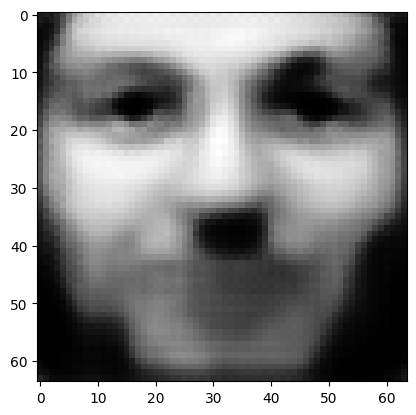

tensor([[8.5327e-06, 4.8884e-05, 7.3164e-01, 4.6529e-03, 1.4207e-04, 6.9508e-06,
         5.7113e-03, 2.7357e-04, 3.0278e-02, 3.9102e-03, 4.7593e-03, 9.8086e-04,
         3.8195e-03, 3.7367e-03, 4.9176e-04, 6.0873e-04, 6.0590e-03, 3.3549e-05,
         1.0381e-03, 1.4338e-03, 5.0464e-02, 1.6361e-02, 1.3882e-03, 5.9663e-04,
         7.6876e-03, 2.3581e-04, 3.1560e-03, 1.2523e-02, 1.9927e-02, 2.3562e-03,
         2.2305e-03, 3.4960e-05, 5.3358e-03, 2.4792e-03, 4.2006e-03, 7.0992e-05,
         1.0374e-02, 4.1888e-02, 1.0024e-02, 9.0297e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3124629557132721
tensor([[7.4528e-06, 4.2947e-05, 7.5669e-01, 4.3153e-03, 1.2290e-04, 6.4170e-06,
         5.2086e-03, 2.6178e-04, 2.7102e-02, 3.6447e-03, 4.3508e-03, 8.5101e-04,
         3.3823e-03, 3.3611e-03, 4.2440e-04, 5.6837e-04, 5.4394e-03, 2.7900e-05,
         9.5533e-04, 1.3403e-03, 4.5901e-02, 1.5096e-02, 1.2085e-03, 5.2081e-04,
         6.7865e-03, 2.1177e-04, 2.8825e-03

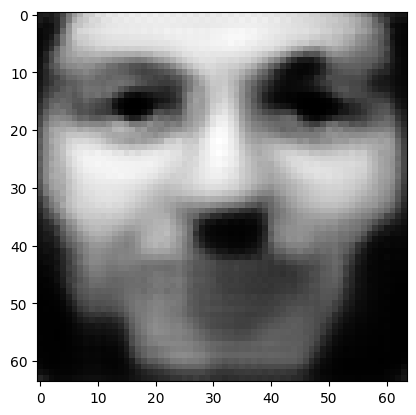

tensor([[4.9187e-06, 2.8566e-05, 8.2187e-01, 3.3423e-03, 7.8437e-05, 4.9547e-06,
         3.8952e-03, 2.2505e-04, 1.9008e-02, 2.8945e-03, 3.2458e-03, 5.4828e-04,
         2.3168e-03, 2.4122e-03, 2.6588e-04, 4.5098e-04, 3.8793e-03, 1.5708e-05,
         7.2944e-04, 1.0622e-03, 3.3761e-02, 1.1654e-02, 7.8035e-04, 3.3931e-04,
         4.6412e-03, 1.5188e-04, 2.1580e-03, 8.3507e-03, 1.4216e-02, 1.5236e-03,
         1.2360e-03, 1.9202e-05, 3.4961e-03, 1.6059e-03, 2.4704e-03, 4.0323e-05,
         7.1244e-03, 2.7957e-02, 6.0492e-03, 6.1503e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19617673754692078
tensor([[4.5326e-06, 2.6324e-05, 8.3254e-01, 3.1702e-03, 7.1772e-05, 4.7070e-06,
         3.6764e-03, 2.1781e-04, 1.7768e-02, 2.7682e-03, 3.0647e-03, 5.0208e-04,
         2.1522e-03, 2.2565e-03, 2.4282e-04, 4.2986e-04, 3.6290e-03, 1.4044e-05,
         6.8988e-04, 1.0129e-03, 3.1677e-02, 1.1065e-02, 7.1877e-04, 3.1137e-04,
         4.3100e-03, 1.4199e-04, 2.0370e-0

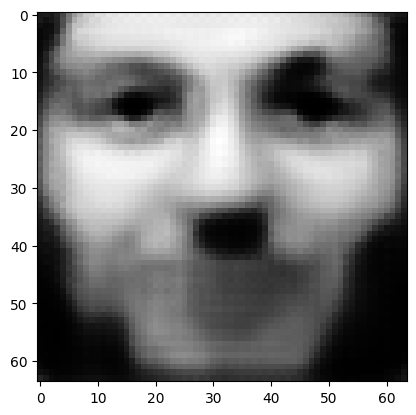

tensor([[3.4372e-06, 1.9856e-05, 8.6441e-01, 2.6459e-03, 5.3389e-05, 3.9435e-06,
         3.0099e-03, 1.9428e-04, 1.4112e-02, 2.3817e-03, 2.5072e-03, 3.7344e-04,
         1.6750e-03, 1.7933e-03, 1.7832e-04, 3.6222e-04, 2.8902e-03, 9.5753e-06,
         5.6870e-04, 8.5730e-04, 2.5537e-02, 9.2656e-03, 5.4700e-04, 2.3231e-04,
         3.3564e-03, 1.1367e-04, 1.6684e-03, 6.4384e-03, 1.1333e-02, 1.1388e-03,
         8.4300e-04, 1.2903e-05, 2.6351e-03, 1.1985e-03, 1.7558e-03, 2.7885e-05,
         5.5553e-03, 2.1252e-02, 4.3239e-03, 4.7134e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1457052081823349
tensor([[3.2385e-06, 1.8683e-05, 8.7049e-01, 2.5441e-03, 5.0085e-05, 3.7934e-06,
         2.8799e-03, 1.8947e-04, 1.3419e-02, 2.3053e-03, 2.3995e-03, 3.5033e-04,
         1.5869e-03, 1.7055e-03, 1.6688e-04, 3.4889e-04, 2.7512e-03, 8.8149e-06,
         5.4535e-04, 8.2678e-04, 2.4384e-02, 8.9132e-03, 5.1562e-04, 2.1815e-04,
         3.1785e-03, 1.0835e-04, 1.5977e-03

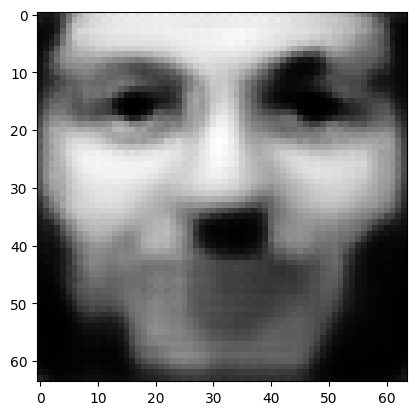

tensor([[2.6314e-06, 1.5125e-05, 8.8965e-01, 2.2134e-03, 4.0121e-05, 3.3131e-06,
         2.4682e-03, 1.7341e-04, 1.1251e-02, 2.0548e-03, 2.0625e-03, 2.8016e-04,
         1.3121e-03, 1.4329e-03, 1.3246e-04, 3.0567e-04, 2.3143e-03, 6.6128e-06,
         4.7074e-04, 7.2849e-04, 2.0712e-02, 7.7834e-03, 4.1966e-04, 1.7493e-04,
         2.6301e-03, 9.1638e-05, 1.3725e-03, 5.2946e-03, 9.5225e-03, 9.1444e-04,
         6.3387e-04, 9.5869e-06, 2.1253e-03, 9.6100e-04, 1.3602e-03, 2.1158e-05,
         4.6028e-03, 1.7234e-02, 3.3628e-03, 3.8551e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11692637205123901
tensor([[2.5151e-06, 1.4444e-05, 8.9347e-01, 2.1469e-03, 3.8205e-05, 3.2166e-06,
         2.3865e-03, 1.7002e-04, 1.0825e-02, 2.0032e-03, 1.9953e-03, 2.6677e-04,
         1.2585e-03, 1.3795e-03, 1.2590e-04, 2.9691e-04, 2.2284e-03, 6.2111e-06,
         4.5577e-04, 7.0823e-04, 1.9974e-02, 7.5537e-03, 4.0119e-04, 1.6665e-04,
         2.5232e-03, 8.8333e-05, 1.3279e-0

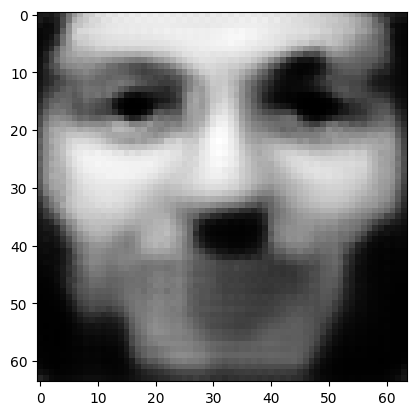

tensor([[2.1450e-06, 1.2266e-05, 9.0592e-01, 1.9270e-03, 3.2109e-05, 2.8988e-06,
         2.1202e-03, 1.5849e-04, 9.4585e-03, 1.8323e-03, 1.7759e-03, 2.2395e-04,
         1.0882e-03, 1.2048e-03, 1.0534e-04, 2.6780e-04, 1.9491e-03, 4.9908e-06,
         4.0617e-04, 6.4123e-04, 1.7527e-02, 6.7919e-03, 3.4275e-04, 1.4035e-04,
         2.1791e-03, 7.7409e-05, 1.1809e-03, 4.5563e-03, 8.3340e-03, 7.7124e-04,
         5.0791e-04, 7.6327e-06, 1.7997e-03, 8.0944e-04, 1.1157e-03, 1.7122e-05,
         3.9766e-03, 1.4682e-02, 2.7665e-03, 3.2877e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09880893677473068
tensor([[2.0696e-06, 1.1819e-05, 9.0852e-01, 1.8794e-03, 3.0856e-05, 2.8312e-06,
         2.0648e-03, 1.5601e-04, 9.1777e-03, 1.7961e-03, 1.7303e-03, 2.1513e-04,
         1.0532e-03, 1.1682e-03, 1.0123e-04, 2.6149e-04, 1.8908e-03, 4.7517e-06,
         3.9565e-04, 6.2693e-04, 1.7004e-02, 6.6309e-03, 3.3088e-04, 1.3500e-04,
         2.1092e-03, 7.5097e-05, 1.1498e-0

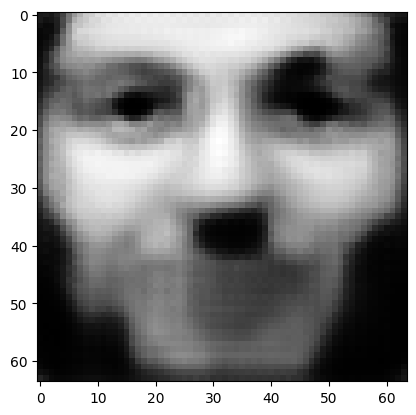

tensor([[1.8189e-06, 1.0334e-05, 9.1736e-01, 1.7178e-03, 2.6739e-05, 2.5996e-06,
         1.8764e-03, 1.4734e-04, 8.2255e-03, 1.6707e-03, 1.5736e-03, 1.8624e-04,
         9.3578e-04, 1.0452e-03, 8.7668e-05, 2.3965e-04, 1.6951e-03, 3.9782e-06,
         3.5979e-04, 5.7712e-04, 1.5244e-02, 6.0794e-03, 2.9162e-04, 1.1731e-04,
         1.8757e-03, 6.7422e-05, 1.0442e-03, 4.0383e-03, 7.4920e-03, 6.7164e-04,
         4.2417e-04, 6.3372e-06, 1.5729e-03, 7.0411e-04, 9.5267e-04, 1.4438e-05,
         3.5356e-03, 1.2889e-02, 2.3638e-03, 2.8758e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08625898510217667
tensor([[1.7665e-06, 1.0022e-05, 9.1924e-01, 1.6834e-03, 2.5894e-05, 2.5502e-06,
         1.8364e-03, 1.4544e-04, 8.0239e-03, 1.6438e-03, 1.5399e-03, 1.8028e-04,
         9.1086e-04, 1.0190e-03, 8.4853e-05, 2.3491e-04, 1.6537e-03, 3.8211e-06,
         3.5216e-04, 5.6627e-04, 1.4868e-02, 5.9611e-03, 2.8350e-04, 1.1363e-04,
         1.8267e-03, 6.5824e-05, 1.0215e-0

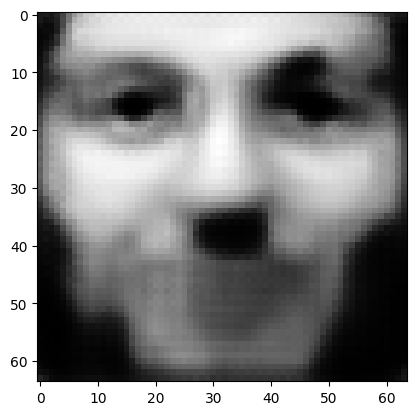

tensor([[1.5852e-06, 8.9585e-06, 9.2582e-01, 1.5604e-03, 2.2998e-05, 2.3752e-06,
         1.6966e-03, 1.3860e-04, 7.3253e-03, 1.5474e-03, 1.4233e-03, 1.5997e-04,
         8.2422e-04, 9.2904e-04, 7.5265e-05, 2.1823e-04, 1.5103e-03, 3.2963e-06,
         3.2545e-04, 5.2788e-04, 1.3557e-02, 5.5440e-03, 2.5541e-04, 1.0104e-04,
         1.6586e-03, 6.0241e-05, 9.4280e-04, 3.6559e-03, 6.8460e-03, 5.9793e-04,
         3.6543e-04, 5.4381e-06, 1.4050e-03, 6.2686e-04, 8.3609e-04, 1.2537e-05,
         3.2067e-03, 1.1554e-02, 2.0727e-03, 2.5721e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07707145065069199
tensor([[1.5456e-06, 8.7270e-06, 9.2727e-01, 1.5321e-03, 2.2355e-05, 2.3360e-06,
         1.6653e-03, 1.3702e-04, 7.1740e-03, 1.5257e-03, 1.3980e-03, 1.5548e-04,
         8.0539e-04, 9.0918e-04, 7.3195e-05, 2.1454e-04, 1.4786e-03, 3.1847e-06,
         3.1939e-04, 5.1930e-04, 1.3262e-02, 5.4503e-03, 2.4925e-04, 9.8277e-05,
         1.6220e-03, 5.8956e-05, 9.2540e-0

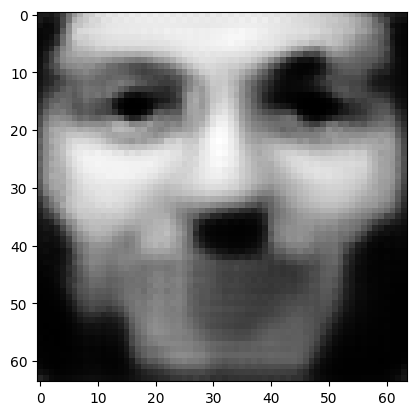

tensor([[1.4098e-06, 7.9281e-06, 9.3234e-01, 1.4353e-03, 2.0160e-05, 2.1996e-06,
         1.5558e-03, 1.3139e-04, 6.6486e-03, 1.4494e-03, 1.3082e-03, 1.4006e-04,
         7.4049e-04, 8.3962e-04, 6.6121e-05, 2.0157e-04, 1.3684e-03, 2.8082e-06,
         2.9807e-04, 4.8919e-04, 1.2236e-02, 5.1212e-03, 2.2827e-04, 8.8793e-05,
         1.4926e-03, 5.4501e-05, 8.6398e-04, 3.3611e-03, 6.3563e-03, 5.4193e-04,
         3.2133e-04, 4.7644e-06, 1.2763e-03, 5.6779e-04, 7.4773e-04, 1.1115e-05,
         2.9510e-03, 1.0540e-02, 1.8525e-03, 2.3326e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07005349546670914
tensor([[1.3800e-06, 7.7550e-06, 9.3346e-01, 1.4134e-03, 1.9679e-05, 2.1691e-06,
         1.5313e-03, 1.3009e-04, 6.5325e-03, 1.4319e-03, 1.2884e-03, 1.3672e-04,
         7.2640e-04, 8.2458e-04, 6.4585e-05, 1.9869e-04, 1.3441e-03, 2.7280e-06,
         2.9330e-04, 4.8238e-04, 1.2010e-02, 5.0471e-03, 2.2363e-04, 8.6728e-05,
         1.4643e-03, 5.3517e-05, 8.5058e-0

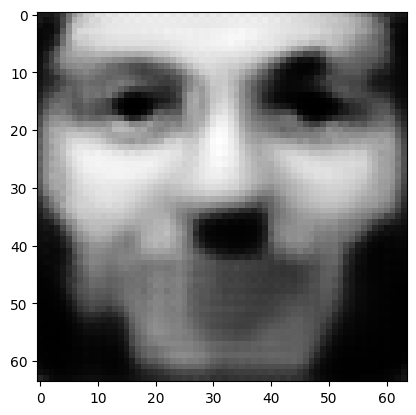

tensor([[1.2755e-06, 7.1412e-06, 9.3748e-01, 1.3355e-03, 1.7989e-05, 2.0596e-06,
         1.4441e-03, 1.2543e-04, 6.1205e-03, 1.3699e-03, 1.2171e-03, 1.2492e-04,
         6.7612e-04, 7.7007e-04, 5.9197e-05, 1.8834e-04, 1.2571e-03, 2.4498e-06,
         2.7621e-04, 4.5811e-04, 1.1199e-02, 4.7816e-03, 2.0732e-04, 7.9463e-05,
         1.3629e-03, 4.9976e-05, 8.0187e-04, 3.1282e-03, 5.9670e-03, 4.9807e-04,
         2.8774e-04, 4.2538e-06, 1.1750e-03, 5.2167e-04, 6.7909e-04, 1.0023e-05,
         2.7475e-03, 9.7422e-03, 1.6821e-03, 2.1422e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06456092745065689
tensor([[1.2520e-06, 7.0059e-06, 9.3838e-01, 1.3171e-03, 1.7618e-05, 2.0347e-06,
         1.4243e-03, 1.2433e-04, 6.0266e-03, 1.3551e-03, 1.2011e-03, 1.2233e-04,
         6.6492e-04, 7.5829e-04, 5.7983e-05, 1.8599e-04, 1.2377e-03, 2.3893e-06,
         2.7231e-04, 4.5245e-04, 1.1017e-02, 4.7210e-03, 2.0358e-04, 7.7835e-05,
         1.3406e-03, 4.9188e-05, 7.9095e-0

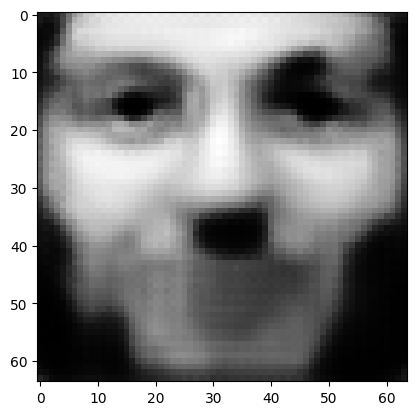

tensor([[1.1681e-06, 6.5157e-06, 9.4168e-01, 1.2522e-03, 1.6284e-05, 1.9440e-06,
         1.3529e-03, 1.2037e-04, 5.6876e-03, 1.3026e-03, 1.1421e-03, 1.1304e-04,
         6.2405e-04, 7.1437e-04, 5.3683e-05, 1.7735e-04, 1.1671e-03, 2.1734e-06,
         2.5829e-04, 4.3194e-04, 1.0357e-02, 4.5009e-03, 1.9039e-04, 7.2052e-05,
         1.2595e-03, 4.6350e-05, 7.5101e-04, 2.9360e-03, 5.6397e-03, 4.6240e-04,
         2.6139e-04, 3.8543e-06, 1.0923e-03, 4.8433e-04, 6.2408e-04, 9.1518e-06,
         2.5800e-03, 9.0921e-03, 1.5452e-03, 1.9882e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060091208666563034
tensor([[1.1494e-06, 6.4050e-06, 9.4243e-01, 1.2375e-03, 1.5987e-05, 1.9232e-06,
         1.3366e-03, 1.1946e-04, 5.6094e-03, 1.2905e-03, 1.1283e-03, 1.1098e-04,
         6.1471e-04, 7.0429e-04, 5.2709e-05, 1.7536e-04, 1.1511e-03, 2.1253e-06,
         2.5510e-04, 4.2723e-04, 1.0208e-02, 4.4507e-03, 1.8740e-04, 7.0758e-05,
         1.2408e-03, 4.5716e-05, 7.4176e-

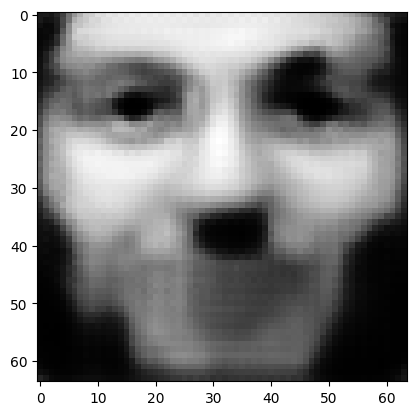

tensor([[1.0805e-06, 6.0037e-06, 9.4520e-01, 1.1821e-03, 1.4912e-05, 1.8459e-06,
         1.2763e-03, 1.1605e-04, 5.3222e-03, 1.2451e-03, 1.0781e-03, 1.0347e-04,
         5.8059e-04, 6.6797e-04, 4.9173e-05, 1.6799e-04, 1.0923e-03, 1.9525e-06,
         2.4333e-04, 4.0972e-04, 9.6646e-03, 4.2648e-03, 1.7637e-04, 6.6042e-05,
         1.1735e-03, 4.3383e-05, 7.0799e-04, 2.7728e-03, 5.3580e-03, 4.3256e-04,
         2.4002e-04, 3.5308e-06, 1.0233e-03, 4.5316e-04, 5.7894e-04, 8.4374e-06,
         2.4390e-03, 8.5438e-03, 1.4323e-03, 1.8609e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056362614035606384
tensor([[1.0647e-06, 5.9114e-06, 9.4583e-01, 1.1699e-03, 1.4674e-05, 1.8281e-06,
         1.2624e-03, 1.1526e-04, 5.2565e-03, 1.2347e-03, 1.0661e-03, 1.0181e-04,
         5.7269e-04, 6.5951e-04, 4.8369e-05, 1.6630e-04, 1.0789e-03, 1.9138e-06,
         2.4066e-04, 4.0568e-04, 9.5432e-03, 4.2218e-03, 1.7387e-04, 6.4989e-05,
         1.1578e-03, 4.2864e-05, 7.0010e-

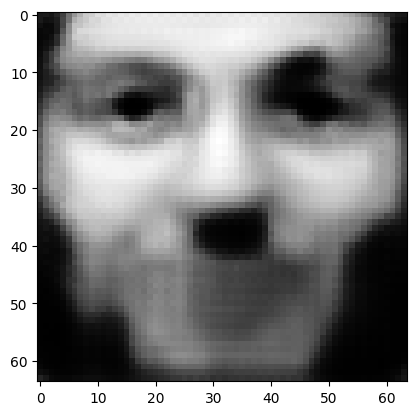

tensor([[1.0065e-06, 5.5759e-06, 9.4819e-01, 1.1223e-03, 1.3794e-05, 1.7607e-06,
         1.2100e-03, 1.1230e-04, 5.0090e-03, 1.1949e-03, 1.0226e-03, 9.5657e-05,
         5.4360e-04, 6.2885e-04, 4.5412e-05, 1.5995e-04, 1.0291e-03, 1.7721e-06,
         2.3062e-04, 3.9058e-04, 9.0945e-03, 4.0615e-03, 1.6448e-04, 6.1086e-05,
         1.1007e-03, 4.0913e-05, 6.7106e-04, 2.6313e-03, 5.1105e-03, 4.0726e-04,
         2.2239e-04, 3.2640e-06, 9.6458e-04, 4.2663e-04, 5.4097e-04, 7.8376e-06,
         2.3175e-03, 8.0722e-03, 1.3377e-03, 1.7546e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05320020765066147
tensor([[9.9320e-07, 5.4991e-06, 9.4873e-01, 1.1116e-03, 1.3594e-05, 1.7452e-06,
         1.1980e-03, 1.1161e-04, 4.9525e-03, 1.1858e-03, 1.0125e-03, 9.4263e-05,
         5.3691e-04, 6.2176e-04, 4.4740e-05, 1.5849e-04, 1.0177e-03, 1.7403e-06,
         2.2833e-04, 3.8706e-04, 8.9916e-03, 4.0244e-03, 1.6235e-04, 6.0204e-05,
         1.0876e-03, 4.0469e-05, 6.6437e-0

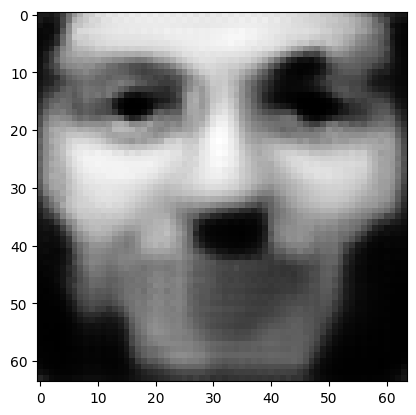

tensor([[9.4367e-07, 5.2183e-06, 9.5074e-01, 1.0714e-03, 1.2859e-05, 1.6869e-06,
         1.1532e-03, 1.0902e-04, 4.7438e-03, 1.1515e-03, 9.7562e-04, 8.9137e-05,
         5.1222e-04, 5.9566e-04, 4.2289e-05, 1.5309e-04, 9.7536e-04, 1.6240e-06,
         2.1982e-04, 3.7429e-04, 8.6131e-03, 3.8872e-03, 1.5445e-04, 5.6967e-05,
         1.0390e-03, 3.8820e-05, 6.3969e-04, 2.5112e-03, 4.8972e-03, 3.8578e-04,
         2.0769e-04, 3.0418e-06, 9.1451e-04, 4.0417e-04, 5.0884e-04, 7.3350e-06,
         2.2129e-03, 7.6678e-03, 1.2582e-03, 1.6648e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05051625519990921
tensor([[9.3220e-07, 5.1536e-06, 9.5120e-01, 1.0625e-03, 1.2691e-05, 1.6734e-06,
         1.1429e-03, 1.0843e-04, 4.6960e-03, 1.1439e-03, 9.6711e-04, 8.7951e-05,
         5.0643e-04, 5.8938e-04, 4.1736e-05, 1.5186e-04, 9.6547e-04, 1.5974e-06,
         2.1788e-04, 3.7144e-04, 8.5252e-03, 3.8558e-03, 1.5266e-04, 5.6237e-05,
         1.0275e-03, 3.8435e-05, 6.3390e-0

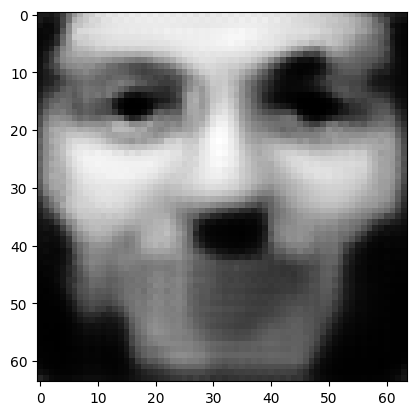

tensor([[8.8875e-07, 4.9132e-06, 9.5298e-01, 1.0267e-03, 1.2058e-05, 1.6204e-06,
         1.1022e-03, 1.0611e-04, 4.5059e-03, 1.1130e-03, 9.3451e-04, 8.3451e-05,
         4.8470e-04, 5.6635e-04, 3.9616e-05, 1.4710e-04, 9.2782e-04, 1.4964e-06,
         2.1038e-04, 3.6035e-04, 8.1964e-03, 3.7356e-03, 1.4554e-04, 5.3439e-05,
         9.8415e-04, 3.6960e-05, 6.1192e-04, 2.4050e-03, 4.7075e-03, 3.6726e-04,
         1.9504e-04, 2.8497e-06, 8.7065e-04, 3.8482e-04, 4.8072e-04, 6.9051e-06,
         2.1203e-03, 7.3058e-03, 1.1896e-03, 1.5862e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04815663397312164
tensor([[8.7866e-07, 4.8568e-06, 9.5340e-01, 1.0184e-03, 1.1911e-05, 1.6079e-06,
         1.0928e-03, 1.0558e-04, 4.4614e-03, 1.1058e-03, 9.2675e-04, 8.2413e-05,
         4.7959e-04, 5.6087e-04, 3.9125e-05, 1.4599e-04, 9.1904e-04, 1.4732e-06,
         2.0863e-04, 3.5772e-04, 8.1194e-03, 3.7074e-03, 1.4390e-04, 5.2797e-05,
         9.7404e-04, 3.6620e-05, 6.0674e-0

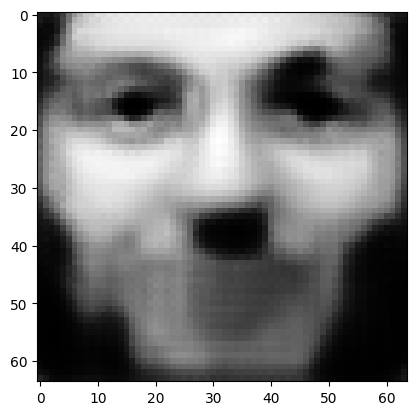

tensor([[8.4136e-07, 4.6502e-06, 9.5496e-01, 9.8727e-04, 1.1373e-05, 1.5616e-06,
         1.0575e-03, 1.0353e-04, 4.2956e-03, 1.0785e-03, 8.9802e-04, 7.8590e-05,
         4.6077e-04, 5.4091e-04, 3.7303e-05, 1.4183e-04, 8.8653e-04, 1.3881e-06,
         2.0209e-04, 3.4791e-04, 7.8346e-03, 3.6022e-03, 1.3776e-04, 5.0410e-05,
         9.3653e-04, 3.5356e-05, 5.8751e-04, 2.3111e-03, 4.5378e-03, 3.5099e-04,
         1.8422e-04, 2.6863e-06, 8.3226e-04, 3.6792e-04, 4.5624e-04, 6.5332e-06,
         2.0386e-03, 6.9869e-03, 1.1301e-03, 1.5173e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0460890531539917
tensor([[8.3286e-07, 4.6023e-06, 9.5532e-01, 9.8014e-04, 1.1247e-05, 1.5507e-06,
         1.0492e-03, 1.0305e-04, 4.2570e-03, 1.0722e-03, 8.9126e-04, 7.7699e-05,
         4.5637e-04, 5.3614e-04, 3.6886e-05, 1.4085e-04, 8.7883e-04, 1.3686e-06,
         2.0057e-04, 3.4568e-04, 7.7682e-03, 3.5777e-03, 1.3635e-04, 4.9860e-05,
         9.2761e-04, 3.5056e-05, 5.8297e-04

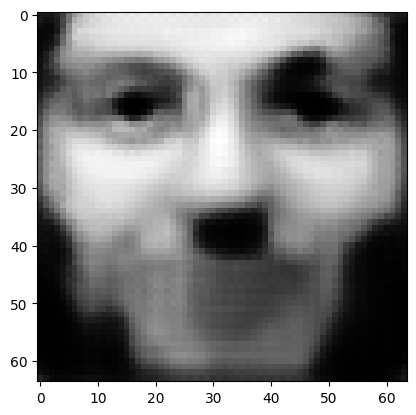

tensor([[8.0100e-07, 4.4258e-06, 9.5666e-01, 9.5303e-04, 1.0789e-05, 1.5103e-06,
         1.0189e-03, 1.0125e-04, 4.1147e-03, 1.0482e-03, 8.6628e-04, 7.4476e-05,
         4.4025e-04, 5.1901e-04, 3.5334e-05, 1.3724e-04, 8.5102e-04, 1.2977e-06,
         1.9493e-04, 3.3708e-04, 7.5232e-03, 3.4856e-03, 1.3109e-04, 4.7840e-05,
         8.9553e-04, 3.3970e-05, 5.6635e-04, 2.2299e-03, 4.3900e-03, 3.3690e-04,
         1.7503e-04, 2.5475e-06, 7.9917e-04, 3.5330e-04, 4.3528e-04, 6.2151e-06,
         1.9679e-03, 6.7109e-03, 1.0791e-03, 1.4579e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04430541396141052
tensor([[7.9372e-07, 4.3850e-06, 9.5697e-01, 9.4698e-04, 1.0686e-05, 1.5011e-06,
         1.0122e-03, 1.0084e-04, 4.0827e-03, 1.0427e-03, 8.6044e-04, 7.3753e-05,
         4.3657e-04, 5.1502e-04, 3.4979e-05, 1.3642e-04, 8.4472e-04, 1.2818e-06,
         1.9364e-04, 3.3509e-04, 7.4672e-03, 3.4644e-03, 1.2991e-04, 4.7387e-05,
         8.8816e-04, 3.3724e-05, 5.6253e-0

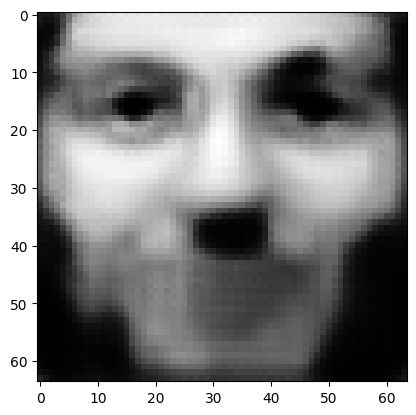

tensor([[7.6666e-07, 4.2348e-06, 9.5812e-01, 9.2395e-04, 1.0300e-05, 1.4663e-06,
         9.8665e-04, 9.9253e-05, 3.9627e-03, 1.0218e-03, 8.3874e-04, 7.1064e-05,
         4.2306e-04, 5.0037e-04, 3.3660e-05, 1.3335e-04, 8.2122e-04, 1.2231e-06,
         1.8880e-04, 3.2770e-04, 7.2594e-03, 3.3850e-03, 1.2545e-04, 4.5700e-05,
         8.6057e-04, 3.2794e-05, 5.4831e-04, 2.1610e-03, 4.2620e-03, 3.2474e-04,
         1.6733e-04, 2.4317e-06, 7.7108e-04, 3.4078e-04, 4.1745e-04, 5.9447e-06,
         1.9069e-03, 6.4728e-03, 1.0358e-03, 1.4069e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042784977704286575
tensor([[7.6044e-07, 4.1998e-06, 9.5838e-01, 9.1862e-04, 1.0213e-05, 1.4582e-06,
         9.8071e-04, 9.8891e-05, 3.9350e-03, 1.0171e-03, 8.3369e-04, 7.0446e-05,
         4.1989e-04, 4.9689e-04, 3.3359e-05, 1.3263e-04, 8.1574e-04, 1.2096e-06,
         1.8768e-04, 3.2601e-04, 7.2112e-03, 3.3667e-03, 1.2444e-04, 4.5312e-05,
         8.5420e-04, 3.2579e-05, 5.4497e-

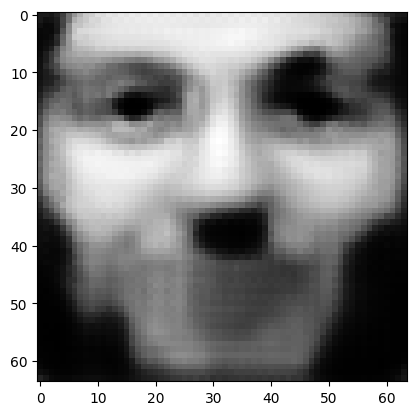

tensor([[7.3671e-07, 4.0687e-06, 9.5939e-01, 8.9806e-04, 9.8820e-06, 1.4275e-06,
         9.5820e-04, 9.7475e-05, 3.8300e-03, 9.9868e-04, 8.1464e-04, 6.8136e-05,
         4.0794e-04, 4.8408e-04, 3.2216e-05, 1.2990e-04, 7.9517e-04, 1.1594e-06,
         1.8342e-04, 3.1946e-04, 7.0298e-03, 3.2965e-03, 1.2058e-04, 4.3845e-05,
         8.3034e-04, 3.1773e-05, 5.3244e-04, 2.1004e-03, 4.1484e-03, 3.1418e-04,
         1.6069e-04, 2.3314e-06, 7.4652e-04, 3.2983e-04, 4.0211e-04, 5.7108e-06,
         1.8532e-03, 6.2641e-03, 9.9806e-04, 1.3631e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04145621508359909
tensor([[7.3119e-07, 4.0374e-06, 9.5963e-01, 8.9341e-04, 9.8053e-06, 1.4203e-06,
         9.5295e-04, 9.7148e-05, 3.8056e-03, 9.9452e-04, 8.1003e-04, 6.7598e-05,
         4.0511e-04, 4.8096e-04, 3.1950e-05, 1.2926e-04, 7.9029e-04, 1.1476e-06,
         1.8243e-04, 3.1793e-04, 6.9870e-03, 3.2800e-03, 1.1969e-04, 4.3506e-05,
         8.2464e-04, 3.1584e-05, 5.2944e-0

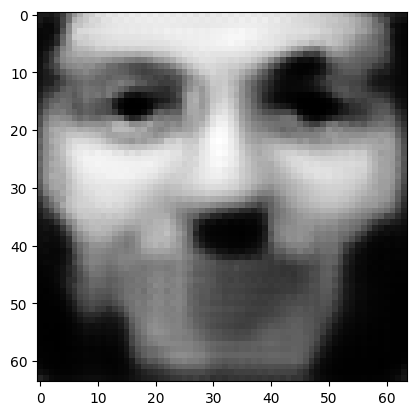

tensor([[7.1018e-07, 3.9210e-06, 9.6053e-01, 8.7503e-04, 9.5126e-06, 1.3928e-06,
         9.3293e-04, 9.5872e-05, 3.7121e-03, 9.7784e-04, 7.9296e-04, 6.5558e-05,
         3.9444e-04, 4.6954e-04, 3.0939e-05, 1.2679e-04, 7.7197e-04, 1.1038e-06,
         1.7862e-04, 3.1203e-04, 6.8249e-03, 3.2171e-03, 1.1627e-04, 4.2208e-05,
         8.0341e-04, 3.0867e-05, 5.1819e-04, 2.0460e-03, 4.0461e-03, 3.0470e-04,
         1.5480e-04, 2.2429e-06, 7.2461e-04, 3.2002e-04, 3.8850e-04, 5.5032e-06,
         1.8050e-03, 6.0777e-03, 9.6455e-04, 1.3239e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04027008265256882
tensor([[7.0528e-07, 3.8936e-06, 9.6074e-01, 8.7074e-04, 9.4432e-06, 1.3863e-06,
         9.2822e-04, 9.5575e-05, 3.6901e-03, 9.7397e-04, 7.8891e-04, 6.5074e-05,
         3.9192e-04, 4.6680e-04, 3.0704e-05, 1.2620e-04, 7.6761e-04, 1.0935e-06,
         1.7772e-04, 3.1065e-04, 6.7864e-03, 3.2022e-03, 1.1547e-04, 4.1905e-05,
         7.9836e-04, 3.0695e-05, 5.1550e-0

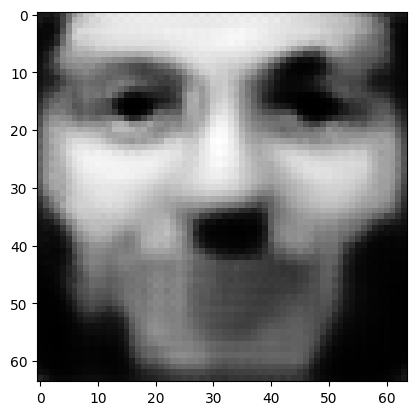

tensor([[6.8671e-07, 3.7902e-06, 9.6155e-01, 8.5435e-04, 9.1827e-06, 1.3615e-06,
         9.1030e-04, 9.4429e-05, 3.6065e-03, 9.5895e-04, 7.7354e-04, 6.3263e-05,
         3.8242e-04, 4.5656e-04, 2.9808e-05, 1.2398e-04, 7.5120e-04, 1.0550e-06,
         1.7431e-04, 3.0537e-04, 6.6413e-03, 3.1456e-03, 1.1243e-04, 4.0757e-05,
         7.7931e-04, 3.0052e-05, 5.0539e-04, 1.9972e-03, 3.9547e-03, 2.9622e-04,
         1.4956e-04, 2.1642e-06, 7.0504e-04, 3.1126e-04, 3.7641e-04, 5.3184e-06,
         1.7620e-03, 5.9114e-03, 9.3480e-04, 1.2887e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03920932859182358
tensor([[6.8231e-07, 3.7658e-06, 9.6174e-01, 8.5051e-04, 9.1212e-06, 1.3556e-06,
         9.0608e-04, 9.4153e-05, 3.5868e-03, 9.5533e-04, 7.6989e-04, 6.2839e-05,
         3.8018e-04, 4.5416e-04, 2.9598e-05, 1.2346e-04, 7.4735e-04, 1.0461e-06,
         1.7350e-04, 3.0411e-04, 6.6072e-03, 3.1322e-03, 1.1172e-04, 4.0488e-05,
         7.7481e-04, 2.9901e-05, 5.0301e-0

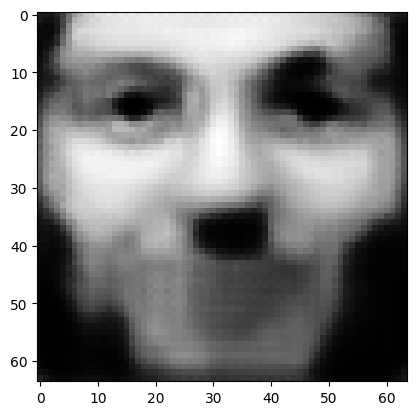

tensor([[6.6573e-07, 3.6735e-06, 9.6246e-01, 8.3581e-04, 8.8899e-06, 1.3333e-06,
         8.8998e-04, 9.3110e-05, 3.5120e-03, 9.4175e-04, 7.5602e-04, 6.1232e-05,
         3.7169e-04, 4.4498e-04, 2.8802e-05, 1.2145e-04, 7.3263e-04, 1.0122e-06,
         1.7042e-04, 2.9933e-04, 6.4773e-03, 3.0811e-03, 1.0901e-04, 3.9467e-05,
         7.5772e-04, 2.9324e-05, 4.9391e-04, 1.9532e-03, 3.8719e-03, 2.8858e-04,
         1.4490e-04, 2.0945e-06, 6.8748e-04, 3.0339e-04, 3.6557e-04, 5.1535e-06,
         1.7232e-03, 5.7620e-03, 9.0822e-04, 1.2571e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.038257941603660583
tensor([[6.6183e-07, 3.6517e-06, 9.6264e-01, 8.3229e-04, 8.8346e-06, 1.3279e-06,
         8.8610e-04, 9.2863e-05, 3.4940e-03, 9.3852e-04, 7.5272e-04, 6.0847e-05,
         3.6968e-04, 4.4278e-04, 2.8613e-05, 1.2097e-04, 7.2910e-04, 1.0041e-06,
         1.6969e-04, 2.9821e-04, 6.4463e-03, 3.0689e-03, 1.0837e-04, 3.9225e-05,
         7.5363e-04, 2.9185e-05, 4.9175e-

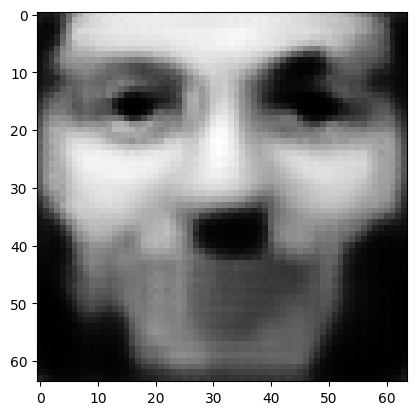

tensor([[6.4686e-07, 3.5684e-06, 9.6330e-01, 8.1884e-04, 8.6261e-06, 1.3075e-06,
         8.7135e-04, 9.1906e-05, 3.4258e-03, 9.2604e-04, 7.4005e-04, 5.9400e-05,
         3.6199e-04, 4.3447e-04, 2.7894e-05, 1.1914e-04, 7.1573e-04, 9.7381e-07,
         1.6688e-04, 2.9383e-04, 6.3290e-03, 3.0221e-03, 1.0591e-04, 3.8304e-05,
         7.3814e-04, 2.8662e-05, 4.8347e-04, 1.9131e-03, 3.7966e-03, 2.8168e-04,
         1.4070e-04, 2.0316e-06, 6.7154e-04, 2.9625e-04, 3.5576e-04, 5.0045e-06,
         1.6879e-03, 5.6264e-03, 8.8418e-04, 1.2284e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03739418834447861
tensor([[6.4333e-07, 3.5485e-06, 9.6345e-01, 8.1558e-04, 8.5757e-06, 1.3025e-06,
         8.6773e-04, 9.1677e-05, 3.4093e-03, 9.2305e-04, 7.3700e-04, 5.9051e-05,
         3.6016e-04, 4.3247e-04, 2.7723e-05, 1.1870e-04, 7.1250e-04, 9.6653e-07,
         1.6621e-04, 2.9280e-04, 6.3009e-03, 3.0109e-03, 1.0531e-04, 3.8083e-05,
         7.3439e-04, 2.8534e-05, 4.8148e-0

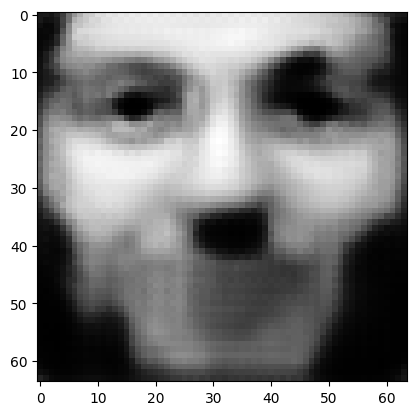

tensor([[6.2977e-07, 3.4729e-06, 9.6406e-01, 8.0329e-04, 8.3873e-06, 1.2837e-06,
         8.5416e-04, 9.0797e-05, 3.3467e-03, 9.1159e-04, 7.2533e-04, 5.7741e-05,
         3.5318e-04, 4.2487e-04, 2.7070e-05, 1.1702e-04, 7.0030e-04, 9.3915e-07,
         1.6363e-04, 2.8878e-04, 6.1946e-03, 2.9680e-03, 1.0308e-04, 3.7249e-05,
         7.2022e-04, 2.8057e-05, 4.7390e-04, 1.8763e-03, 3.7273e-03, 2.7537e-04,
         1.3690e-04, 1.9744e-06, 6.5697e-04, 2.8972e-04, 3.4680e-04, 4.8688e-06,
         1.6556e-03, 5.5021e-03, 8.6233e-04, 1.2022e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0366046242415905
tensor([[6.2657e-07, 3.4550e-06, 9.6420e-01, 8.0029e-04, 8.3416e-06, 1.2792e-06,
         8.5090e-04, 9.0585e-05, 3.3317e-03, 9.0880e-04, 7.2256e-04, 5.7426e-05,
         3.5152e-04, 4.2307e-04, 2.6915e-05, 1.1662e-04, 6.9736e-04, 9.3266e-07,
         1.6302e-04, 2.8783e-04, 6.1690e-03, 2.9577e-03, 1.0253e-04, 3.7050e-05,
         7.1686e-04, 2.7941e-05, 4.7209e-04

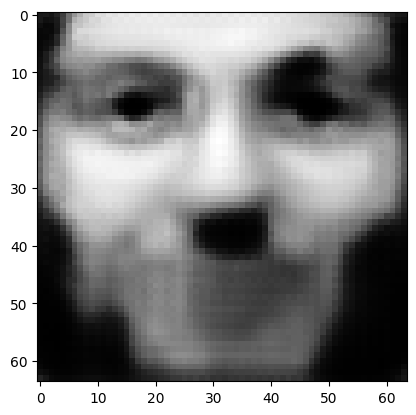

tensor([[6.1428e-07, 3.3865e-06, 9.6475e-01, 7.8897e-04, 8.1714e-06, 1.2620e-06,
         8.3857e-04, 8.9773e-05, 3.2747e-03, 8.9823e-04, 7.1193e-04, 5.6242e-05,
         3.4518e-04, 4.1620e-04, 2.6323e-05, 1.1508e-04, 6.8630e-04, 9.0811e-07,
         1.6067e-04, 2.8413e-04, 6.0717e-03, 2.9186e-03, 1.0050e-04, 3.6292e-05,
         7.0408e-04, 2.7507e-05, 4.6518e-04, 1.8426e-03, 3.6639e-03, 2.6964e-04,
         1.3347e-04, 1.9231e-06, 6.4373e-04, 2.8379e-04, 3.3867e-04, 4.7462e-06,
         1.6262e-03, 5.3898e-03, 8.4248e-04, 1.1784e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035885974764823914
tensor([[6.1140e-07, 3.3703e-06, 9.6488e-01, 7.8627e-04, 8.1301e-06, 1.2579e-06,
         8.3560e-04, 8.9580e-05, 3.2611e-03, 8.9572e-04, 7.0938e-04, 5.5958e-05,
         3.4367e-04, 4.1455e-04, 2.6182e-05, 1.1471e-04, 6.8362e-04, 9.0228e-07,
         1.6010e-04, 2.8325e-04, 6.0483e-03, 2.9092e-03, 1.0002e-04, 3.6112e-05,
         7.0100e-04, 2.7402e-05, 4.6353e-

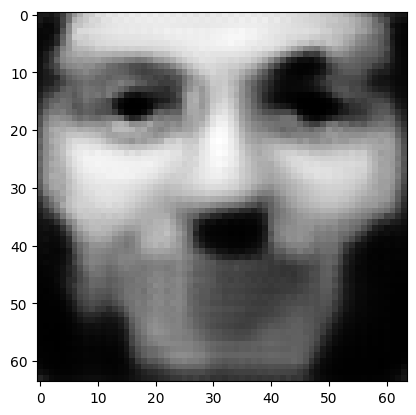

tensor([[6.0026e-07, 3.3078e-06, 9.6538e-01, 7.7603e-04, 7.9743e-06, 1.2423e-06,
         8.2442e-04, 8.8833e-05, 3.2094e-03, 8.8603e-04, 6.9962e-04, 5.4878e-05,
         3.3789e-04, 4.0823e-04, 2.5645e-05, 1.1330e-04, 6.7350e-04, 8.8019e-07,
         1.5795e-04, 2.7985e-04, 5.9587e-03, 2.8732e-03, 9.8179e-05, 3.5424e-05,
         6.8933e-04, 2.7004e-05, 4.5718e-04, 1.8118e-03, 3.6062e-03, 2.6437e-04,
         1.3032e-04, 1.8763e-06, 6.3167e-04, 2.7833e-04, 3.3128e-04, 4.6343e-06,
         1.5992e-03, 5.2872e-03, 8.2435e-04, 1.1565e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03522975742816925
tensor([[5.9758e-07, 3.2929e-06, 9.6550e-01, 7.7355e-04, 7.9369e-06, 1.2385e-06,
         8.2174e-04, 8.8651e-05, 3.1970e-03, 8.8367e-04, 6.9729e-04, 5.4621e-05,
         3.3650e-04, 4.0673e-04, 2.5516e-05, 1.1296e-04, 6.7109e-04, 8.7494e-07,
         1.5743e-04, 2.7902e-04, 5.9372e-03, 2.8646e-03, 9.7736e-05, 3.5259e-05,
         6.8655e-04, 2.6909e-05, 4.5567e-0

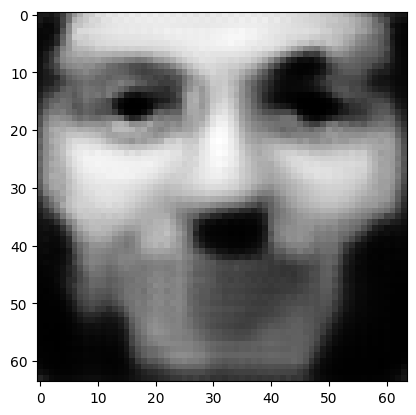

tensor([[5.8742e-07, 3.2360e-06, 9.6596e-01, 7.6404e-04, 7.7945e-06, 1.2241e-06,
         8.1149e-04, 8.7963e-05, 3.1495e-03, 8.7469e-04, 6.8836e-04, 5.3635e-05,
         3.3121e-04, 4.0099e-04, 2.5026e-05, 1.1165e-04, 6.6182e-04, 8.5491e-07,
         1.5545e-04, 2.7588e-04, 5.8547e-03, 2.8315e-03, 9.6054e-05, 3.4630e-05,
         6.7596e-04, 2.6544e-05, 4.4986e-04, 1.7836e-03, 3.5530e-03, 2.5953e-04,
         1.2747e-04, 1.8338e-06, 6.2061e-04, 2.7335e-04, 3.2454e-04, 4.5323e-06,
         1.5744e-03, 5.1937e-03, 8.0779e-04, 1.1365e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03462815284729004
tensor([[5.8501e-07, 3.2224e-06, 9.6607e-01, 7.6180e-04, 7.7606e-06, 1.2206e-06,
         8.0904e-04, 8.7797e-05, 3.1382e-03, 8.7254e-04, 6.8621e-04, 5.3402e-05,
         3.2995e-04, 3.9960e-04, 2.4908e-05, 1.1134e-04, 6.5961e-04, 8.5016e-07,
         1.5498e-04, 2.7512e-04, 5.8351e-03, 2.8236e-03, 9.5654e-05, 3.4481e-05,
         6.7340e-04, 2.6458e-05, 4.4847e-0

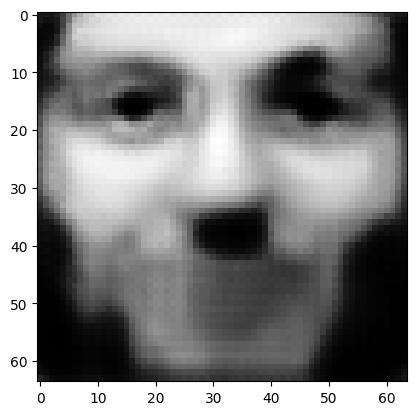

tensor([[5.7574e-07, 3.1704e-06, 9.6650e-01, 7.5313e-04, 7.6308e-06, 1.2074e-06,
         7.9966e-04, 8.7164e-05, 3.0948e-03, 8.6432e-04, 6.7798e-04, 5.2504e-05,
         3.2509e-04, 3.9431e-04, 2.4462e-05, 1.1014e-04, 6.5113e-04, 8.3198e-07,
         1.5317e-04, 2.7222e-04, 5.7594e-03, 2.7933e-03, 9.4127e-05, 3.3907e-05,
         6.6369e-04, 2.6126e-05, 4.4312e-04, 1.7577e-03, 3.5040e-03, 2.5508e-04,
         1.2485e-04, 1.7951e-06, 6.1048e-04, 2.6876e-04, 3.1838e-04, 4.4391e-06,
         1.5517e-03, 5.1076e-03, 7.9261e-04, 1.1181e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034076422452926636
tensor([[5.7353e-07, 3.1580e-06, 9.6660e-01, 7.5100e-04, 7.5993e-06, 1.2042e-06,
         7.9738e-04, 8.7009e-05, 3.0843e-03, 8.6230e-04, 6.7603e-04, 5.2286e-05,
         3.2394e-04, 3.9306e-04, 2.4355e-05, 1.0985e-04, 6.4909e-04, 8.2763e-07,
         1.5272e-04, 2.7152e-04, 5.7410e-03, 2.7860e-03, 9.3758e-05, 3.3768e-05,
         6.6137e-04, 2.6045e-05, 4.4184e-

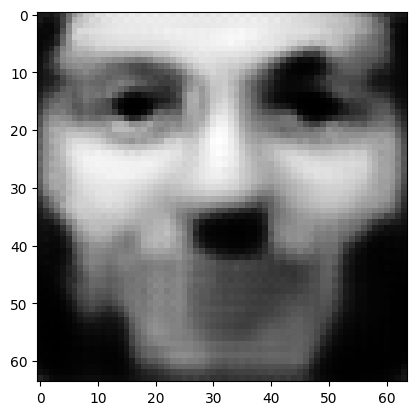

tensor([[5.6503e-07, 3.1103e-06, 9.6699e-01, 7.4298e-04, 7.4801e-06, 1.1921e-06,
         7.8869e-04, 8.6416e-05, 3.0444e-03, 8.5464e-04, 6.6846e-04, 5.1463e-05,
         3.1949e-04, 3.8821e-04, 2.3945e-05, 1.0874e-04, 6.4128e-04, 8.1111e-07,
         1.5104e-04, 2.6884e-04, 5.6714e-03, 2.7579e-03, 9.2355e-05, 3.3241e-05,
         6.5241e-04, 2.5737e-05, 4.3692e-04, 1.7338e-03, 3.4590e-03, 2.5098e-04,
         1.2246e-04, 1.7596e-06, 6.0113e-04, 2.6455e-04, 3.1272e-04, 4.3535e-06,
         1.5308e-03, 5.0288e-03, 7.7868e-04, 1.1011e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033568885177373886
tensor([[5.6297e-07, 3.0989e-06, 9.6708e-01, 7.4105e-04, 7.4515e-06, 1.1891e-06,
         7.8662e-04, 8.6273e-05, 3.0348e-03, 8.5280e-04, 6.6664e-04, 5.1266e-05,
         3.1842e-04, 3.8705e-04, 2.3848e-05, 1.0847e-04, 6.3941e-04, 8.0716e-07,
         1.5064e-04, 2.6819e-04, 5.6547e-03, 2.7511e-03, 9.2020e-05, 3.3115e-05,
         6.5029e-04, 2.5664e-05, 4.3574e-

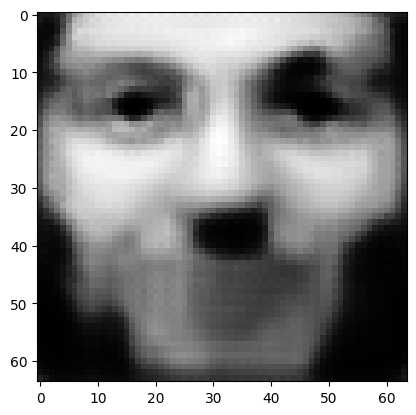

tensor([[5.5516e-07, 3.0551e-06, 9.6744e-01, 7.3360e-04, 7.3420e-06, 1.1778e-06,
         7.7858e-04, 8.5723e-05, 2.9980e-03, 8.4571e-04, 6.5967e-04, 5.0508e-05,
         3.1433e-04, 3.8257e-04, 2.3474e-05, 1.0744e-04, 6.3221e-04, 7.9208e-07,
         1.4909e-04, 2.6571e-04, 5.5904e-03, 2.7251e-03, 9.0729e-05, 3.2630e-05,
         6.4208e-04, 2.5379e-05, 4.3120e-04, 1.7118e-03, 3.4174e-03, 2.4723e-04,
         1.2026e-04, 1.7271e-06, 5.9253e-04, 2.6067e-04, 3.0753e-04, 4.2751e-06,
         1.5114e-03, 4.9562e-03, 7.6588e-04, 1.0855e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033101458102464676
tensor([[5.5328e-07, 3.0447e-06, 9.6753e-01, 7.3183e-04, 7.3160e-06, 1.1751e-06,
         7.7666e-04, 8.5590e-05, 2.9893e-03, 8.4401e-04, 6.5800e-04, 5.0329e-05,
         3.1335e-04, 3.8151e-04, 2.3385e-05, 1.0720e-04, 6.3049e-04, 7.8850e-07,
         1.4871e-04, 2.6512e-04, 5.5752e-03, 2.7189e-03, 9.0421e-05, 3.2515e-05,
         6.4012e-04, 2.5312e-05, 4.3012e-

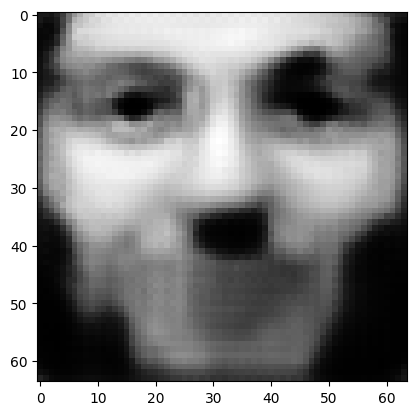

tensor([[5.4614e-07, 3.0046e-06, 9.6786e-01, 7.2501e-04, 7.2161e-06, 1.1647e-06,
         7.6925e-04, 8.5082e-05, 2.9557e-03, 8.3753e-04, 6.5157e-04, 4.9636e-05,
         3.0961e-04, 3.7737e-04, 2.3045e-05, 1.0625e-04, 6.2383e-04, 7.7478e-07,
         1.4729e-04, 2.6287e-04, 5.5164e-03, 2.6950e-03, 8.9241e-05, 3.2074e-05,
         6.3255e-04, 2.5049e-05, 4.2592e-04, 1.6916e-03, 3.3792e-03, 2.4380e-04,
         1.1825e-04, 1.6971e-06, 5.8465e-04, 2.5711e-04, 3.0278e-04, 4.2035e-06,
         1.4936e-03, 4.8893e-03, 7.5416e-04, 1.0712e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0326724611222744
tensor([[5.4440e-07, 2.9950e-06, 9.6793e-01, 7.2332e-04, 7.1926e-06, 1.1622e-06,
         7.6747e-04, 8.4958e-05, 2.9476e-03, 8.3593e-04, 6.5004e-04, 4.9471e-05,
         3.0872e-04, 3.7640e-04, 2.2962e-05, 1.0603e-04, 6.2225e-04, 7.7151e-07,
         1.4694e-04, 2.6231e-04, 5.5023e-03, 2.6892e-03, 8.8955e-05, 3.1967e-05,
         6.3075e-04, 2.4987e-05, 4.2492e-04

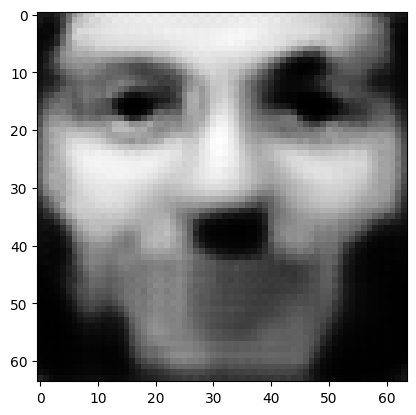

tensor([[5.3783e-07, 2.9579e-06, 9.6824e-01, 7.1704e-04, 7.1010e-06, 1.1527e-06,
         7.6065e-04, 8.4488e-05, 2.9166e-03, 8.2997e-04, 6.4408e-04, 4.8836e-05,
         3.0526e-04, 3.7257e-04, 2.2650e-05, 1.0516e-04, 6.1610e-04, 7.5896e-07,
         1.4562e-04, 2.6022e-04, 5.4481e-03, 2.6671e-03, 8.7875e-05, 3.1562e-05,
         6.2378e-04, 2.4746e-05, 4.2104e-04, 1.6728e-03, 3.3436e-03, 2.4064e-04,
         1.1640e-04, 1.6697e-06, 5.7738e-04, 2.5382e-04, 2.9841e-04, 4.1378e-06,
         1.4770e-03, 4.8275e-03, 7.4335e-04, 1.0580e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03227594494819641
tensor([[5.3623e-07, 2.9491e-06, 9.6831e-01, 7.1544e-04, 7.0787e-06, 1.1503e-06,
         7.5897e-04, 8.4372e-05, 2.9090e-03, 8.2846e-04, 6.4266e-04, 4.8681e-05,
         3.0443e-04, 3.7167e-04, 2.2573e-05, 1.0494e-04, 6.1461e-04, 7.5595e-07,
         1.4530e-04, 2.5971e-04, 5.4349e-03, 2.6617e-03, 8.7605e-05, 3.1462e-05,
         6.2211e-04, 2.4686e-05, 4.2011e-0

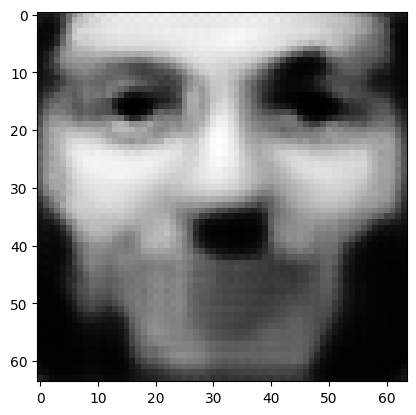

tensor([[5.3012e-07, 2.9148e-06, 9.6860e-01, 7.0957e-04, 6.9938e-06, 1.1414e-06,
         7.5260e-04, 8.3929e-05, 2.8802e-03, 8.2283e-04, 6.3713e-04, 4.8094e-05,
         3.0123e-04, 3.6814e-04, 2.2284e-05, 1.0413e-04, 6.0889e-04, 7.4440e-07,
         1.4407e-04, 2.5776e-04, 5.3845e-03, 2.6409e-03, 8.6599e-05, 3.1086e-05,
         6.1563e-04, 2.4462e-05, 4.1651e-04, 1.6554e-03, 3.3105e-03, 2.3770e-04,
         1.1469e-04, 1.6443e-06, 5.7061e-04, 2.5077e-04, 2.9435e-04, 4.0768e-06,
         1.4616e-03, 4.7704e-03, 7.3332e-04, 1.0458e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031907446682453156
tensor([[5.2862e-07, 2.9066e-06, 9.6866e-01, 7.0811e-04, 6.9736e-06, 1.1392e-06,
         7.5107e-04, 8.3821e-05, 2.8733e-03, 8.2145e-04, 6.3581e-04, 4.7953e-05,
         3.0045e-04, 3.6730e-04, 2.2214e-05, 1.0394e-04, 6.0753e-04, 7.4164e-07,
         1.4377e-04, 2.5728e-04, 5.3723e-03, 2.6359e-03, 8.6354e-05, 3.0995e-05,
         6.1410e-04, 2.4409e-05, 4.1565e-

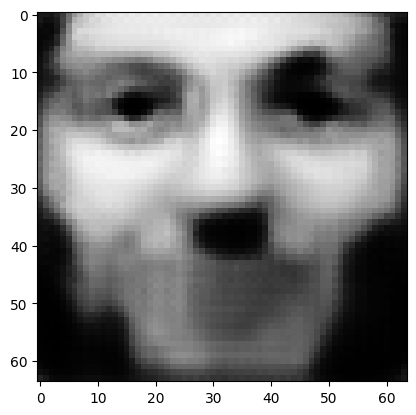

tensor([[5.2290e-07, 2.8744e-06, 9.6893e-01, 7.0251e-04, 6.8942e-06, 1.1307e-06,
         7.4504e-04, 8.3405e-05, 2.8460e-03, 8.1614e-04, 6.3058e-04, 4.7402e-05,
         2.9741e-04, 3.6396e-04, 2.1942e-05, 1.0317e-04, 6.0215e-04, 7.3080e-07,
         1.4261e-04, 2.5544e-04, 5.3250e-03, 2.6164e-03, 8.5401e-05, 3.0642e-05,
         6.0802e-04, 2.4197e-05, 4.1223e-04, 1.6389e-03, 3.2793e-03, 2.3496e-04,
         1.1309e-04, 1.6205e-06, 5.6425e-04, 2.4790e-04, 2.9058e-04, 4.0198e-06,
         1.4471e-03, 4.7165e-03, 7.2393e-04, 1.0344e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031561221927404404
tensor([[5.2149e-07, 2.8667e-06, 9.6900e-01, 7.0110e-04, 6.8752e-06, 1.1286e-06,
         7.4356e-04, 8.3301e-05, 2.8392e-03, 8.1480e-04, 6.2931e-04, 4.7269e-05,
         2.9667e-04, 3.6317e-04, 2.1874e-05, 1.0298e-04, 6.0085e-04, 7.2818e-07,
         1.4233e-04, 2.5498e-04, 5.3137e-03, 2.6117e-03, 8.5163e-05, 3.0555e-05,
         6.0655e-04, 2.4146e-05, 4.1139e-

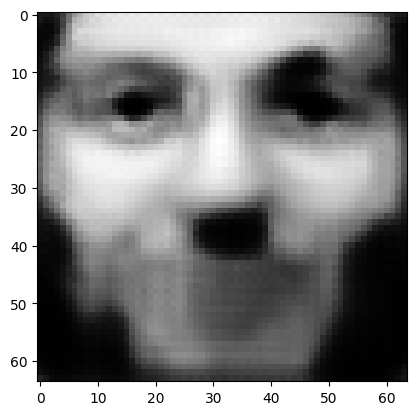

tensor([[5.1612e-07, 2.8366e-06, 9.6925e-01, 6.9581e-04, 6.8009e-06, 1.1206e-06,
         7.3783e-04, 8.2909e-05, 2.8135e-03, 8.0978e-04, 6.2438e-04, 4.6754e-05,
         2.9380e-04, 3.6003e-04, 2.1619e-05, 1.0226e-04, 5.9578e-04, 7.1806e-07,
         1.4124e-04, 2.5326e-04, 5.2696e-03, 2.5933e-03, 8.4262e-05, 3.0225e-05,
         6.0082e-04, 2.3946e-05, 4.0817e-04, 1.6232e-03, 3.2497e-03, 2.3238e-04,
         1.1159e-04, 1.5980e-06, 5.5824e-04, 2.4521e-04, 2.8704e-04, 3.9661e-06,
         1.4334e-03, 4.6657e-03, 7.1513e-04, 1.0239e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03123486414551735
tensor([[5.1483e-07, 2.8294e-06, 9.6931e-01, 6.9454e-04, 6.7831e-06, 1.1187e-06,
         7.3647e-04, 8.2813e-05, 2.8073e-03, 8.0856e-04, 6.2319e-04, 4.6631e-05,
         2.9311e-04, 3.5929e-04, 2.1558e-05, 1.0209e-04, 5.9457e-04, 7.1564e-07,
         1.4098e-04, 2.5284e-04, 5.2590e-03, 2.5888e-03, 8.4045e-05, 3.0146e-05,
         5.9945e-04, 2.3898e-05, 4.0739e-0

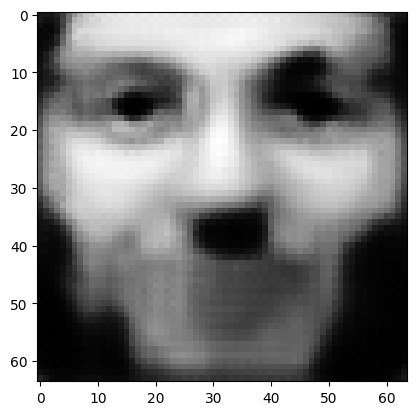

tensor([[5.0984e-07, 2.8015e-06, 9.6954e-01, 6.8961e-04, 6.7143e-06, 1.1112e-06,
         7.3116e-04, 8.2449e-05, 2.7835e-03, 8.0386e-04, 6.1863e-04, 4.6154e-05,
         2.9044e-04, 3.5638e-04, 2.1322e-05, 1.0141e-04, 5.8987e-04, 7.0633e-07,
         1.3997e-04, 2.5124e-04, 5.2180e-03, 2.5717e-03, 8.3209e-05, 2.9840e-05,
         5.9413e-04, 2.3712e-05, 4.0438e-04, 1.6086e-03, 3.2222e-03, 2.2998e-04,
         1.1020e-04, 1.5772e-06, 5.5267e-04, 2.4269e-04, 2.8376e-04, 3.9163e-06,
         1.4207e-03, 4.6186e-03, 7.0698e-04, 1.0141e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03093232586979866
tensor([[5.0863e-07, 2.7948e-06, 9.6960e-01, 6.8842e-04, 6.6977e-06, 1.1094e-06,
         7.2990e-04, 8.2359e-05, 2.7777e-03, 8.0271e-04, 6.1752e-04, 4.6039e-05,
         2.8980e-04, 3.5569e-04, 2.1264e-05, 1.0125e-04, 5.8875e-04, 7.0409e-07,
         1.3973e-04, 2.5085e-04, 5.2081e-03, 2.5675e-03, 8.3006e-05, 2.9766e-05,
         5.9286e-04, 2.3668e-05, 4.0367e-0

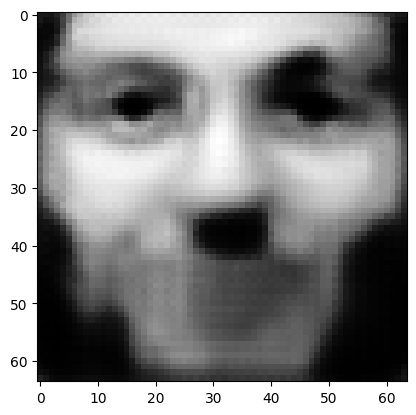

tensor([[5.0399e-07, 2.7688e-06, 9.6981e-01, 6.8385e-04, 6.6341e-06, 1.1024e-06,
         7.2498e-04, 8.2017e-05, 2.7555e-03, 7.9832e-04, 6.1326e-04, 4.5598e-05,
         2.8732e-04, 3.5299e-04, 2.1045e-05, 1.0063e-04, 5.8439e-04, 6.9549e-07,
         1.3879e-04, 2.4934e-04, 5.1700e-03, 2.5516e-03, 8.2231e-05, 2.9482e-05,
         5.8791e-04, 2.3496e-05, 4.0087e-04, 1.5950e-03, 3.1965e-03, 2.2775e-04,
         1.0890e-04, 1.5580e-06, 5.4749e-04, 2.4035e-04, 2.8071e-04, 3.8701e-06,
         1.4088e-03, 4.5747e-03, 6.9939e-04, 1.0050e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030650505796074867
tensor([[5.0288e-07, 2.7626e-06, 9.6987e-01, 6.8274e-04, 6.6185e-06, 1.1007e-06,
         7.2378e-04, 8.1935e-05, 2.7501e-03, 7.9725e-04, 6.1224e-04, 4.5490e-05,
         2.8672e-04, 3.5234e-04, 2.0992e-05, 1.0047e-04, 5.8332e-04, 6.9341e-07,
         1.3856e-04, 2.4899e-04, 5.1607e-03, 2.5477e-03, 8.2043e-05, 2.9414e-05,
         5.8672e-04, 2.3454e-05, 4.0020e-

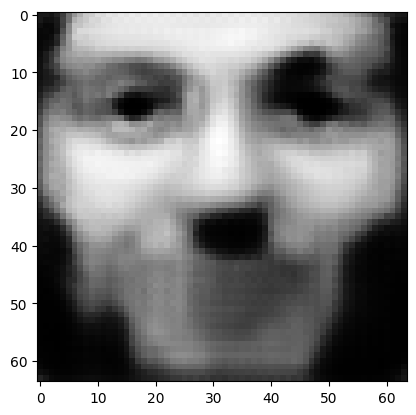

tensor([[4.9856e-07, 2.7386e-06, 9.7007e-01, 6.7847e-04, 6.5594e-06, 1.0943e-06,
         7.1920e-04, 8.1614e-05, 2.7295e-03, 7.9313e-04, 6.0827e-04, 4.5079e-05,
         2.8441e-04, 3.4983e-04, 2.0788e-05, 9.9891e-05, 5.7927e-04, 6.8545e-07,
         1.3769e-04, 2.4758e-04, 5.1251e-03, 2.5328e-03, 8.1321e-05, 2.9150e-05,
         5.8213e-04, 2.3294e-05, 3.9759e-04, 1.5823e-03, 3.1726e-03, 2.2567e-04,
         1.0770e-04, 1.5401e-06, 5.4265e-04, 2.3818e-04, 2.7787e-04, 3.8271e-06,
         1.3978e-03, 4.5339e-03, 6.9234e-04, 9.9650e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030387572944164276
tensor([[4.9752e-07, 2.7327e-06, 9.7012e-01, 6.7744e-04, 6.5450e-06, 1.0927e-06,
         7.1808e-04, 8.1537e-05, 2.7245e-03, 7.9214e-04, 6.0731e-04, 4.4980e-05,
         2.8385e-04, 3.4922e-04, 2.0739e-05, 9.9750e-05, 5.7828e-04, 6.8353e-07,
         1.3748e-04, 2.4724e-04, 5.1165e-03, 2.5292e-03, 8.1147e-05, 2.9086e-05,
         5.8101e-04, 2.3255e-05, 3.9697e-

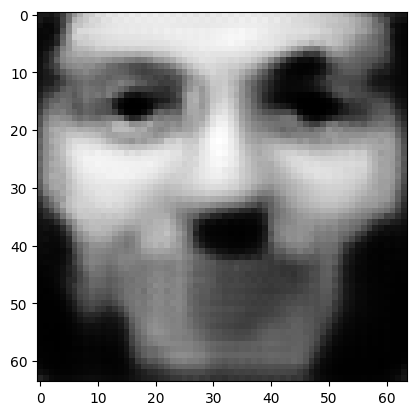

tensor([[4.9348e-07, 2.7103e-06, 9.7031e-01, 6.7341e-04, 6.4894e-06, 1.0866e-06,
         7.1374e-04, 8.1236e-05, 2.7050e-03, 7.8826e-04, 6.0358e-04, 4.4594e-05,
         2.8169e-04, 3.4686e-04, 2.0548e-05, 9.9202e-05, 5.7445e-04, 6.7608e-07,
         1.3665e-04, 2.4593e-04, 5.0831e-03, 2.5151e-03, 8.0466e-05, 2.8839e-05,
         5.7669e-04, 2.3103e-05, 3.9451e-04, 1.5704e-03, 3.1502e-03, 2.2372e-04,
         1.0657e-04, 1.5233e-06, 5.3811e-04, 2.3614e-04, 2.7521e-04, 3.7868e-06,
         1.3874e-03, 4.4955e-03, 6.8573e-04, 9.8855e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030140763148665428
tensor([[4.9249e-07, 2.7048e-06, 9.7036e-01, 6.7244e-04, 6.4760e-06, 1.0851e-06,
         7.1269e-04, 8.1162e-05, 2.7003e-03, 7.8732e-04, 6.0267e-04, 4.4502e-05,
         2.8116e-04, 3.4629e-04, 2.0502e-05, 9.9069e-05, 5.7353e-04, 6.7428e-07,
         1.3645e-04, 2.4561e-04, 5.0750e-03, 2.5117e-03, 8.0303e-05, 2.8779e-05,
         5.7564e-04, 2.3066e-05, 3.9392e-

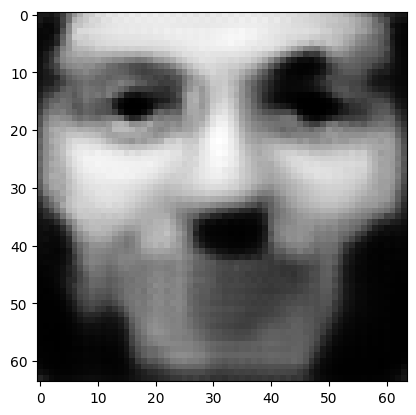

tensor([[4.8873e-07, 2.6837e-06, 9.7053e-01, 6.6869e-04, 6.4240e-06, 1.0794e-06,
         7.0863e-04, 8.0880e-05, 2.6821e-03, 7.8371e-04, 5.9918e-04, 4.4142e-05,
         2.7913e-04, 3.4407e-04, 2.0325e-05, 9.8555e-05, 5.6994e-04, 6.6735e-07,
         1.3568e-04, 2.4438e-04, 5.0437e-03, 2.4985e-03, 7.9670e-05, 2.8549e-05,
         5.7159e-04, 2.2924e-05, 3.9162e-04, 1.5592e-03, 3.1291e-03, 2.2189e-04,
         1.0551e-04, 1.5076e-06, 5.3385e-04, 2.3422e-04, 2.7272e-04, 3.7492e-06,
         1.3776e-03, 4.4594e-03, 6.7955e-04, 9.8109e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02990974299609661
tensor([[4.8781e-07, 2.6787e-06, 9.7058e-01, 6.6775e-04, 6.4117e-06, 1.0780e-06,
         7.0765e-04, 8.0811e-05, 2.6777e-03, 7.8280e-04, 5.9834e-04, 4.4055e-05,
         2.7865e-04, 3.4355e-04, 2.0281e-05, 9.8431e-05, 5.6909e-04, 6.6568e-07,
         1.3549e-04, 2.4408e-04, 5.0361e-03, 2.4953e-03, 7.9515e-05, 2.8493e-05,
         5.7063e-04, 2.2890e-05, 3.9107e-0

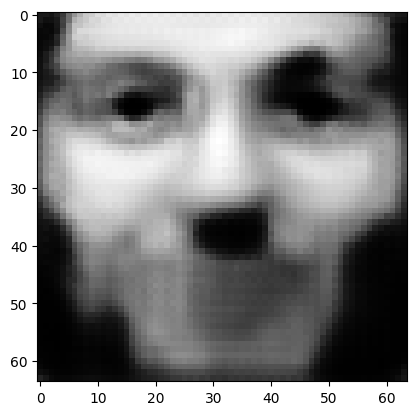

tensor([[4.8427e-07, 2.6590e-06, 9.7074e-01, 6.6424e-04, 6.3632e-06, 1.0726e-06,
         7.0388e-04, 8.0544e-05, 2.6607e-03, 7.7939e-04, 5.9507e-04, 4.3720e-05,
         2.7675e-04, 3.4148e-04, 2.0116e-05, 9.7949e-05, 5.6575e-04, 6.5924e-07,
         1.3478e-04, 2.4292e-04, 5.0068e-03, 2.4830e-03, 7.8925e-05, 2.8277e-05,
         5.6686e-04, 2.2759e-05, 3.8893e-04, 1.5488e-03, 3.1093e-03, 2.2018e-04,
         1.0453e-04, 1.4931e-06, 5.2987e-04, 2.3243e-04, 2.7039e-04, 3.7141e-06,
         1.3685e-03, 4.4259e-03, 6.7377e-04, 9.7413e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029693715274333954
tensor([[4.8344e-07, 2.6542e-06, 9.7078e-01, 6.6342e-04, 6.3516e-06, 1.0713e-06,
         7.0297e-04, 8.0482e-05, 2.6567e-03, 7.7860e-04, 5.9428e-04, 4.3639e-05,
         2.7629e-04, 3.4097e-04, 2.0076e-05, 9.7833e-05, 5.6493e-04, 6.5769e-07,
         1.3460e-04, 2.4265e-04, 4.9997e-03, 2.4801e-03, 7.8786e-05, 2.8226e-05,
         5.6594e-04, 2.2726e-05, 3.8840e-

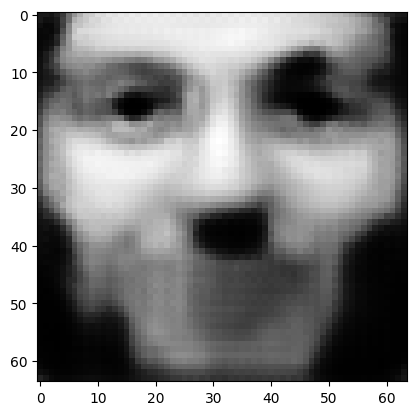

tensor([[4.8012e-07, 2.6359e-06, 9.7094e-01, 6.6009e-04, 6.3064e-06, 1.0663e-06,
         6.9943e-04, 8.0231e-05, 2.6408e-03, 7.7537e-04, 5.9123e-04, 4.3326e-05,
         2.7452e-04, 3.3905e-04, 1.9921e-05, 9.7380e-05, 5.6182e-04, 6.5169e-07,
         1.3393e-04, 2.4156e-04, 4.9722e-03, 2.4685e-03, 7.8233e-05, 2.8024e-05,
         5.6243e-04, 2.2603e-05, 3.8640e-04, 1.5390e-03, 3.0907e-03, 2.1857e-04,
         1.0361e-04, 1.4795e-06, 5.2615e-04, 2.3076e-04, 2.6823e-04, 3.6814e-06,
         1.3600e-03, 4.3944e-03, 6.6836e-04, 9.6760e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029491182416677475
tensor([[4.7932e-07, 2.6314e-06, 9.7098e-01, 6.5930e-04, 6.2955e-06, 1.0651e-06,
         6.9858e-04, 8.0170e-05, 2.6370e-03, 7.7461e-04, 5.9048e-04, 4.3251e-05,
         2.7409e-04, 3.3858e-04, 1.9884e-05, 9.7271e-05, 5.6106e-04, 6.5025e-07,
         1.3376e-04, 2.4129e-04, 4.9656e-03, 2.4657e-03, 7.8100e-05, 2.7976e-05,
         5.6158e-04, 2.2573e-05, 3.8591e-

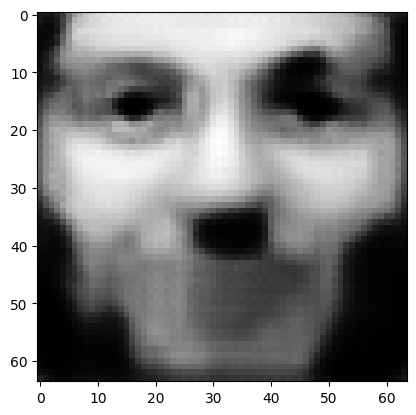

tensor([[4.7624e-07, 2.6142e-06, 9.7112e-01, 6.5619e-04, 6.2532e-06, 1.0604e-06,
         6.9526e-04, 7.9936e-05, 2.6221e-03, 7.7160e-04, 5.8762e-04, 4.2958e-05,
         2.7243e-04, 3.3678e-04, 1.9739e-05, 9.6847e-05, 5.5813e-04, 6.4465e-07,
         1.3313e-04, 2.4028e-04, 4.9398e-03, 2.4548e-03, 7.7584e-05, 2.7787e-05,
         5.5828e-04, 2.2457e-05, 3.8403e-04, 1.5298e-03, 3.0734e-03, 2.1707e-04,
         1.0275e-04, 1.4667e-06, 5.2266e-04, 2.2919e-04, 2.6620e-04, 3.6507e-06,
         1.3520e-03, 4.3650e-03, 6.6330e-04, 9.6147e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029301805421710014
tensor([[4.7549e-07, 2.6101e-06, 9.7116e-01, 6.5545e-04, 6.2430e-06, 1.0593e-06,
         6.9446e-04, 7.9878e-05, 2.6185e-03, 7.7087e-04, 5.8693e-04, 4.2887e-05,
         2.7202e-04, 3.3634e-04, 1.9704e-05, 9.6745e-05, 5.5742e-04, 6.4330e-07,
         1.3298e-04, 2.4003e-04, 4.9336e-03, 2.4522e-03, 7.7459e-05, 2.7741e-05,
         5.5749e-04, 2.2429e-05, 3.8358e-

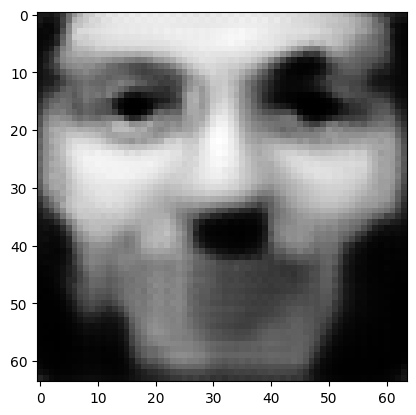

tensor([[4.7260e-07, 2.5940e-06, 9.7130e-01, 6.5252e-04, 6.2034e-06, 1.0549e-06,
         6.9134e-04, 7.9657e-05, 2.6044e-03, 7.6803e-04, 5.8422e-04, 4.2613e-05,
         2.7046e-04, 3.3464e-04, 1.9567e-05, 9.6343e-05, 5.5467e-04, 6.3805e-07,
         1.3238e-04, 2.3906e-04, 4.9094e-03, 2.4420e-03, 7.6974e-05, 2.7564e-05,
         5.5439e-04, 2.2322e-05, 3.8180e-04, 1.5211e-03, 3.0569e-03, 2.1566e-04,
         1.0194e-04, 1.4548e-06, 5.1938e-04, 2.2771e-04, 2.6430e-04, 3.6219e-06,
         1.3444e-03, 4.3373e-03, 6.5854e-04, 9.5573e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029123276472091675
tensor([[4.7191e-07, 2.5900e-06, 9.7133e-01, 6.5183e-04, 6.1938e-06, 1.0538e-06,
         6.9059e-04, 7.9606e-05, 2.6010e-03, 7.6737e-04, 5.8355e-04, 4.2546e-05,
         2.7008e-04, 3.3422e-04, 1.9535e-05, 9.6246e-05, 5.5400e-04, 6.3678e-07,
         1.3224e-04, 2.3883e-04, 4.9035e-03, 2.4395e-03, 7.6859e-05, 2.7522e-05,
         5.5363e-04, 2.2295e-05, 3.8136e-

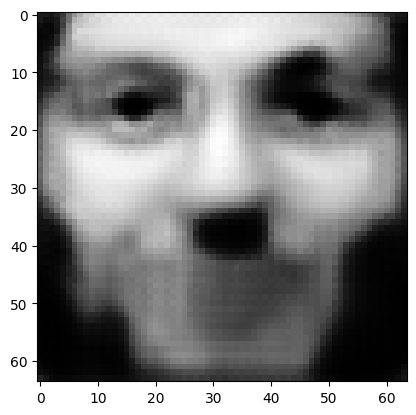

tensor([[4.6920e-07, 2.5749e-06, 9.7146e-01, 6.4906e-04, 6.1567e-06, 1.0496e-06,
         6.8765e-04, 7.9396e-05, 2.5878e-03, 7.6468e-04, 5.8100e-04, 4.2289e-05,
         2.6862e-04, 3.3263e-04, 1.9407e-05, 9.5867e-05, 5.5142e-04, 6.3187e-07,
         1.3167e-04, 2.3791e-04, 4.8808e-03, 2.4299e-03, 7.6402e-05, 2.7355e-05,
         5.5073e-04, 2.2194e-05, 3.7969e-04, 1.5130e-03, 3.0414e-03, 2.1433e-04,
         1.0119e-04, 1.4436e-06, 5.1629e-04, 2.2633e-04, 2.6251e-04, 3.5949e-06,
         1.3373e-03, 4.3113e-03, 6.5406e-04, 9.5029e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028955601155757904
tensor([[4.6855e-07, 2.5712e-06, 9.7149e-01, 6.4840e-04, 6.1476e-06, 1.0486e-06,
         6.8693e-04, 7.9346e-05, 2.5846e-03, 7.6404e-04, 5.8038e-04, 4.2226e-05,
         2.6826e-04, 3.3224e-04, 1.9376e-05, 9.5776e-05, 5.5078e-04, 6.3067e-07,
         1.3154e-04, 2.3770e-04, 4.8752e-03, 2.4276e-03, 7.6292e-05, 2.7315e-05,
         5.5002e-04, 2.2169e-05, 3.7928e-

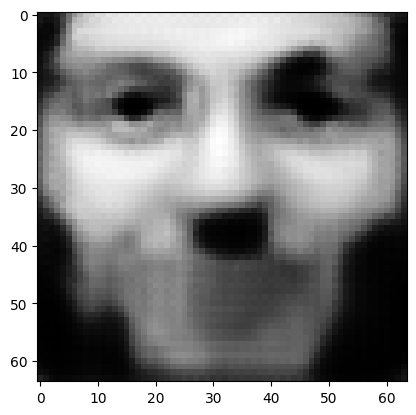

tensor([[4.6601e-07, 2.5570e-06, 9.7161e-01, 6.4583e-04, 6.1126e-06, 1.0447e-06,
         6.8418e-04, 7.9150e-05, 2.5721e-03, 7.6153e-04, 5.7797e-04, 4.1985e-05,
         2.6689e-04, 3.3073e-04, 1.9256e-05, 9.5420e-05, 5.4835e-04, 6.2608e-07,
         1.3101e-04, 2.3684e-04, 4.8539e-03, 2.4186e-03, 7.5866e-05, 2.7159e-05,
         5.4727e-04, 2.2074e-05, 3.7771e-04, 1.5053e-03, 3.0269e-03, 2.1308e-04,
         1.0048e-04, 1.4331e-06, 5.1339e-04, 2.2502e-04, 2.6084e-04, 3.5694e-06,
         1.3307e-03, 4.2868e-03, 6.4986e-04, 9.4516e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02879774384200573
tensor([[4.6540e-07, 2.5536e-06, 9.7164e-01, 6.4520e-04, 6.1044e-06, 1.0438e-06,
         6.8352e-04, 7.9104e-05, 2.5691e-03, 7.6092e-04, 5.7739e-04, 4.1927e-05,
         2.6655e-04, 3.3038e-04, 1.9227e-05, 9.5334e-05, 5.4778e-04, 6.2497e-07,
         1.3088e-04, 2.3663e-04, 4.8488e-03, 2.4164e-03, 7.5764e-05, 2.7122e-05,
         5.4662e-04, 2.2052e-05, 3.7733e-0

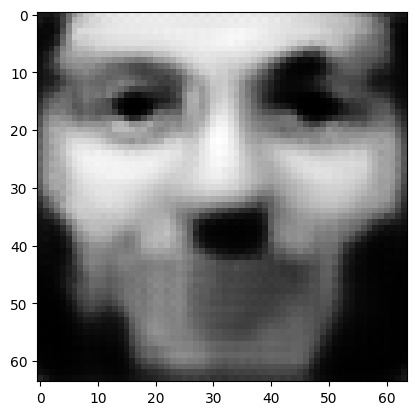

tensor([[4.6301e-07, 2.5402e-06, 9.7176e-01, 6.4276e-04, 6.0715e-06, 1.0401e-06,
         6.8091e-04, 7.8919e-05, 2.5574e-03, 7.5856e-04, 5.7514e-04, 4.1700e-05,
         2.6526e-04, 3.2896e-04, 1.9115e-05, 9.4999e-05, 5.4548e-04, 6.2065e-07,
         1.3039e-04, 2.3583e-04, 4.8286e-03, 2.4079e-03, 7.5363e-05, 2.6975e-05,
         5.4405e-04, 2.1962e-05, 3.7585e-04, 1.4981e-03, 3.0132e-03, 2.1191e-04,
         9.9810e-05, 1.4233e-06, 5.1066e-04, 2.2380e-04, 2.5927e-04, 3.5456e-06,
         1.3244e-03, 4.2638e-03, 6.4591e-04, 9.4036e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028649592772126198
tensor([[4.6243e-07, 2.5369e-06, 9.7178e-01, 6.4218e-04, 6.0635e-06, 1.0392e-06,
         6.8028e-04, 7.8874e-05, 2.5546e-03, 7.5799e-04, 5.7459e-04, 4.1645e-05,
         2.6494e-04, 3.2861e-04, 1.9088e-05, 9.4918e-05, 5.4492e-04, 6.1961e-07,
         1.3027e-04, 2.3563e-04, 4.8237e-03, 2.4058e-03, 7.5266e-05, 2.6940e-05,
         5.4342e-04, 2.1940e-05, 3.7549e-

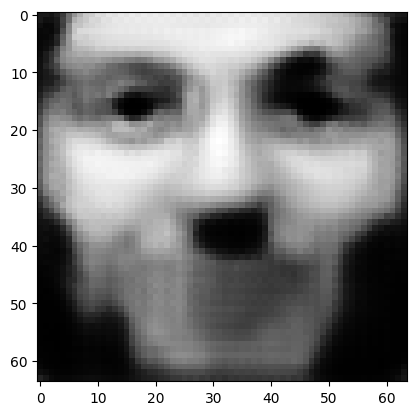

tensor([[4.6018e-07, 2.5244e-06, 9.7189e-01, 6.3988e-04, 6.0327e-06, 1.0357e-06,
         6.7783e-04, 7.8701e-05, 2.5436e-03, 7.5578e-04, 5.7248e-04, 4.1431e-05,
         2.6372e-04, 3.2728e-04, 1.8982e-05, 9.4604e-05, 5.4277e-04, 6.1557e-07,
         1.2980e-04, 2.3488e-04, 4.8048e-03, 2.3978e-03, 7.4889e-05, 2.6803e-05,
         5.4100e-04, 2.1855e-05, 3.7410e-04, 1.4913e-03, 3.0003e-03, 2.1081e-04,
         9.9182e-05, 1.4140e-06, 5.0810e-04, 2.2265e-04, 2.5780e-04, 3.5233e-06,
         1.3185e-03, 4.2422e-03, 6.4220e-04, 9.3585e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028510108590126038
tensor([[4.5963e-07, 2.5213e-06, 9.7192e-01, 6.3932e-04, 6.0253e-06, 1.0349e-06,
         6.7724e-04, 7.8658e-05, 2.5410e-03, 7.5524e-04, 5.7197e-04, 4.1380e-05,
         2.6342e-04, 3.2696e-04, 1.8957e-05, 9.4528e-05, 5.4225e-04, 6.1459e-07,
         1.2969e-04, 2.3470e-04, 4.8002e-03, 2.3959e-03, 7.4798e-05, 2.6769e-05,
         5.4041e-04, 2.1835e-05, 3.7376e-

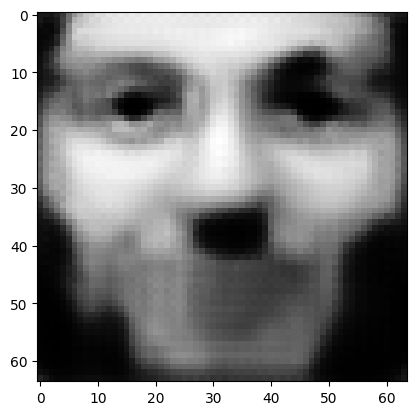

tensor([[4.5751e-07, 2.5096e-06, 9.7202e-01, 6.3717e-04, 5.9964e-06, 1.0316e-06,
         6.7494e-04, 7.8495e-05, 2.5307e-03, 7.5315e-04, 5.6998e-04, 4.1180e-05,
         2.6228e-04, 3.2570e-04, 1.8858e-05, 9.4232e-05, 5.4022e-04, 6.1080e-07,
         1.2925e-04, 2.3398e-04, 4.7824e-03, 2.3884e-03, 7.4445e-05, 2.6640e-05,
         5.3814e-04, 2.1755e-05, 3.7245e-04, 1.4849e-03, 2.9881e-03, 2.0977e-04,
         9.8594e-05, 1.4053e-06, 5.0568e-04, 2.2157e-04, 2.5641e-04, 3.5023e-06,
         1.3129e-03, 4.2218e-03, 6.3871e-04, 9.3161e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028378600254654884
tensor([[4.5700e-07, 2.5067e-06, 9.7204e-01, 6.3663e-04, 5.9893e-06, 1.0308e-06,
         6.7438e-04, 7.8455e-05, 2.5282e-03, 7.5264e-04, 5.6950e-04, 4.1130e-05,
         2.6200e-04, 3.2540e-04, 1.8834e-05, 9.4160e-05, 5.3973e-04, 6.0988e-07,
         1.2914e-04, 2.3381e-04, 4.7780e-03, 2.3865e-03, 7.4358e-05, 2.6609e-05,
         5.3759e-04, 2.1736e-05, 3.7213e-

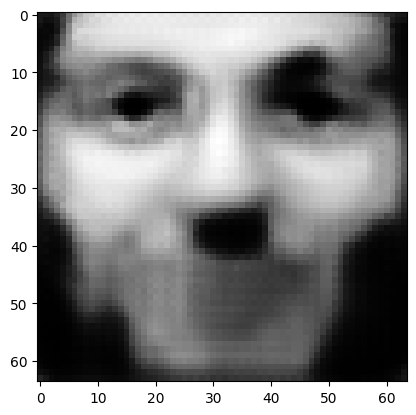

tensor([[4.5501e-07, 2.4956e-06, 9.7214e-01, 6.3460e-04, 5.9621e-06, 1.0278e-06,
         6.7221e-04, 7.8300e-05, 2.5185e-03, 7.5067e-04, 5.6763e-04, 4.0942e-05,
         2.6092e-04, 3.2422e-04, 1.8741e-05, 9.3881e-05, 5.3782e-04, 6.0633e-07,
         1.2873e-04, 2.3314e-04, 4.7612e-03, 2.3794e-03, 7.4026e-05, 2.6487e-05,
         5.3545e-04, 2.1661e-05, 3.7090e-04, 1.4788e-03, 2.9767e-03, 2.0880e-04,
         9.8039e-05, 1.3971e-06, 5.0341e-04, 2.2055e-04, 2.5510e-04, 3.4825e-06,
         1.3076e-03, 4.2026e-03, 6.3543e-04, 9.2760e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02825518697500229
tensor([[4.5452e-07, 2.4929e-06, 9.7216e-01, 6.3410e-04, 5.9554e-06, 1.0270e-06,
         6.7168e-04, 7.8263e-05, 2.5161e-03, 7.5019e-04, 5.6717e-04, 4.0896e-05,
         2.6065e-04, 3.2393e-04, 1.8719e-05, 9.3813e-05, 5.3735e-04, 6.0546e-07,
         1.2863e-04, 2.3298e-04, 4.7571e-03, 2.3777e-03, 7.3945e-05, 2.6458e-05,
         5.3493e-04, 2.1642e-05, 3.7060e-0

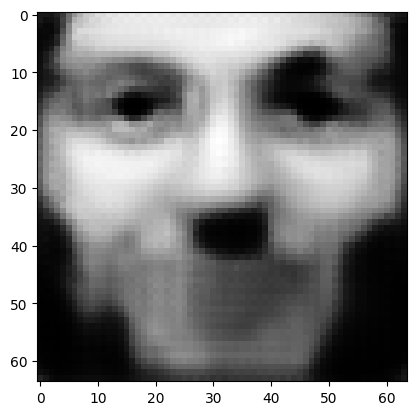

tensor([[4.5263e-07, 2.4824e-06, 9.7225e-01, 6.3216e-04, 5.9298e-06, 1.0241e-06,
         6.6962e-04, 7.8116e-05, 2.5069e-03, 7.4830e-04, 5.6540e-04, 4.0718e-05,
         2.5963e-04, 3.2282e-04, 1.8631e-05, 9.3549e-05, 5.3555e-04, 6.0210e-07,
         1.2823e-04, 2.3234e-04, 4.7413e-03, 2.3710e-03, 7.3628e-05, 2.6343e-05,
         5.3291e-04, 2.1572e-05, 3.6943e-04, 1.4731e-03, 2.9659e-03, 2.0788e-04,
         9.7517e-05, 1.3894e-06, 5.0125e-04, 2.1959e-04, 2.5387e-04, 3.4638e-06,
         1.3027e-03, 4.1845e-03, 6.3232e-04, 9.2385e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028138017281889915
tensor([[4.5218e-07, 2.4799e-06, 9.7228e-01, 6.3170e-04, 5.9235e-06, 1.0234e-06,
         6.6912e-04, 7.8081e-05, 2.5047e-03, 7.4787e-04, 5.6496e-04, 4.0675e-05,
         2.5938e-04, 3.2254e-04, 1.8610e-05, 9.3485e-05, 5.3510e-04, 6.0129e-07,
         1.2814e-04, 2.3219e-04, 4.7374e-03, 2.3693e-03, 7.3554e-05, 2.6315e-05,
         5.3241e-04, 2.1554e-05, 3.6914e-

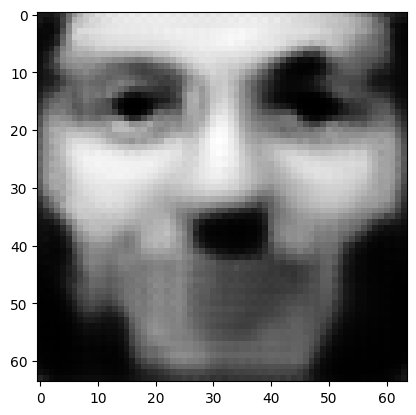

tensor([[4.5040e-07, 2.4700e-06, 9.7236e-01, 6.2987e-04, 5.8992e-06, 1.0206e-06,
         6.6717e-04, 7.7942e-05, 2.4960e-03, 7.4609e-04, 5.6329e-04, 4.0507e-05,
         2.5841e-04, 3.2149e-04, 1.8527e-05, 9.3235e-05, 5.3340e-04, 5.9812e-07,
         1.2777e-04, 2.3159e-04, 4.7225e-03, 2.3630e-03, 7.3255e-05, 2.6207e-05,
         5.3050e-04, 2.1487e-05, 3.6804e-04, 1.4677e-03, 2.9556e-03, 2.0701e-04,
         9.7021e-05, 1.3821e-06, 4.9922e-04, 2.1867e-04, 2.5270e-04, 3.4462e-06,
         1.2980e-03, 4.1673e-03, 6.2939e-04, 9.2028e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02802744135260582
tensor([[4.4997e-07, 2.4676e-06, 9.7238e-01, 6.2943e-04, 5.8934e-06, 1.0200e-06,
         6.6670e-04, 7.7908e-05, 2.4939e-03, 7.4566e-04, 5.6288e-04, 4.0467e-05,
         2.5817e-04, 3.2123e-04, 1.8507e-05, 9.3175e-05, 5.3298e-04, 5.9736e-07,
         1.2768e-04, 2.3144e-04, 4.7189e-03, 2.3614e-03, 7.3183e-05, 2.6181e-05,
         5.3003e-04, 2.1471e-05, 3.6777e-0

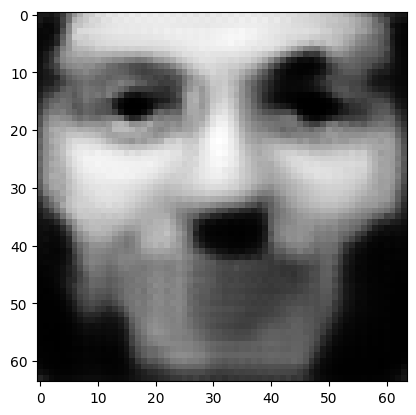

tensor([[4.4829e-07, 2.4582e-06, 9.7246e-01, 6.2771e-04, 5.8705e-06, 1.0174e-06,
         6.6486e-04, 7.7777e-05, 2.4857e-03, 7.4400e-04, 5.6130e-04, 4.0309e-05,
         2.5726e-04, 3.2024e-04, 1.8429e-05, 9.2940e-05, 5.3137e-04, 5.9438e-07,
         1.2733e-04, 2.3088e-04, 4.7047e-03, 2.3554e-03, 7.2903e-05, 2.6079e-05,
         5.2823e-04, 2.1408e-05, 3.6673e-04, 1.4626e-03, 2.9460e-03, 2.0619e-04,
         9.6555e-05, 1.3752e-06, 4.9730e-04, 2.1782e-04, 2.5161e-04, 3.4296e-06,
         1.2935e-03, 4.1511e-03, 6.2663e-04, 9.1694e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027923112735152245
tensor([[4.4789e-07, 2.4560e-06, 9.7248e-01, 6.2730e-04, 5.8650e-06, 1.0167e-06,
         6.6441e-04, 7.7745e-05, 2.4838e-03, 7.4359e-04, 5.6092e-04, 4.0271e-05,
         2.5704e-04, 3.2000e-04, 1.8410e-05, 9.2883e-05, 5.3098e-04, 5.9366e-07,
         1.2725e-04, 2.3074e-04, 4.7013e-03, 2.3540e-03, 7.2835e-05, 2.6054e-05,
         5.2779e-04, 2.1392e-05, 3.6647e-

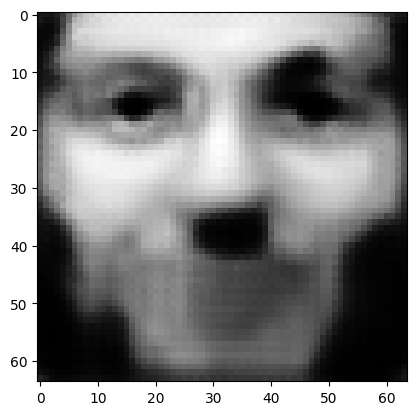

tensor([[4.4630e-07, 2.4472e-06, 9.7256e-01, 6.2566e-04, 5.8434e-06, 1.0143e-06,
         6.6267e-04, 7.7621e-05, 2.4760e-03, 7.4201e-04, 5.5943e-04, 4.0121e-05,
         2.5618e-04, 3.1906e-04, 1.8336e-05, 9.2660e-05, 5.2946e-04, 5.9086e-07,
         1.2692e-04, 2.3021e-04, 4.6880e-03, 2.3483e-03, 7.2570e-05, 2.5958e-05,
         5.2610e-04, 2.1333e-05, 3.6549e-04, 1.4578e-03, 2.9368e-03, 2.0542e-04,
         9.6117e-05, 1.3687e-06, 4.9549e-04, 2.1701e-04, 2.5057e-04, 3.4139e-06,
         1.2893e-03, 4.1359e-03, 6.2402e-04, 9.1379e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02782503329217434
tensor([[4.4592e-07, 2.4450e-06, 9.7258e-01, 6.2528e-04, 5.8383e-06, 1.0137e-06,
         6.6226e-04, 7.7592e-05, 2.4742e-03, 7.4164e-04, 5.5906e-04, 4.0086e-05,
         2.5597e-04, 3.1883e-04, 1.8319e-05, 9.2606e-05, 5.2909e-04, 5.9018e-07,
         1.2684e-04, 2.3008e-04, 4.6848e-03, 2.3469e-03, 7.2508e-05, 2.5935e-05,
         5.2568e-04, 2.1318e-05, 3.6525e-0

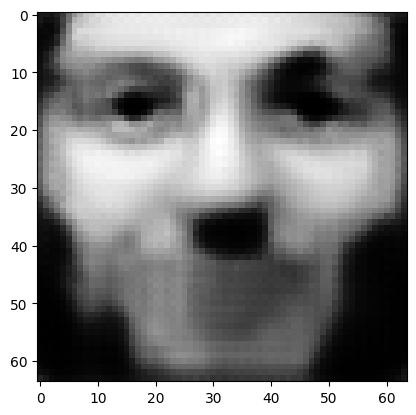

tensor([[4.4442e-07, 2.4367e-06, 9.7265e-01, 6.2373e-04, 5.8180e-06, 1.0113e-06,
         6.6061e-04, 7.7474e-05, 2.4668e-03, 7.4014e-04, 5.5765e-04, 3.9945e-05,
         2.5515e-04, 3.1794e-04, 1.8249e-05, 9.2396e-05, 5.2766e-04, 5.8753e-07,
         1.2653e-04, 2.2957e-04, 4.6722e-03, 2.3415e-03, 7.2256e-05, 2.5844e-05,
         5.2407e-04, 2.1262e-05, 3.6432e-04, 1.4532e-03, 2.9281e-03, 2.0468e-04,
         9.5703e-05, 1.3626e-06, 4.9377e-04, 2.1624e-04, 2.4959e-04, 3.3991e-06,
         1.2854e-03, 4.1214e-03, 6.2156e-04, 9.1081e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02773193083703518
tensor([[4.4407e-07, 2.4347e-06, 9.7267e-01, 6.2335e-04, 5.8130e-06, 1.0108e-06,
         6.6020e-04, 7.7446e-05, 2.4651e-03, 7.3977e-04, 5.5730e-04, 3.9910e-05,
         2.5495e-04, 3.1773e-04, 1.8232e-05, 9.2344e-05, 5.2731e-04, 5.8689e-07,
         1.2645e-04, 2.2945e-04, 4.6691e-03, 2.3402e-03, 7.2195e-05, 2.5822e-05,
         5.2368e-04, 2.1248e-05, 3.6409e-0

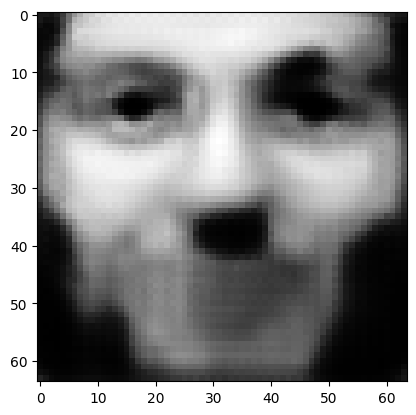

tensor([[4.4265e-07, 2.4269e-06, 9.7273e-01, 6.2189e-04, 5.7939e-06, 1.0086e-06,
         6.5865e-04, 7.7334e-05, 2.4582e-03, 7.3836e-04, 5.5597e-04, 3.9778e-05,
         2.5418e-04, 3.1689e-04, 1.8166e-05, 9.2146e-05, 5.2595e-04, 5.8440e-07,
         1.2616e-04, 2.2897e-04, 4.6572e-03, 2.3351e-03, 7.1958e-05, 2.5736e-05,
         5.2216e-04, 2.1195e-05, 3.6321e-04, 1.4489e-03, 2.9200e-03, 2.0399e-04,
         9.5312e-05, 1.3568e-06, 4.9215e-04, 2.1551e-04, 2.4867e-04, 3.3851e-06,
         1.2816e-03, 4.1077e-03, 6.1924e-04, 9.0800e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027643922716379166
tensor([[4.4231e-07, 2.4250e-06, 9.7275e-01, 6.2153e-04, 5.7891e-06, 1.0080e-06,
         6.5827e-04, 7.7307e-05, 2.4565e-03, 7.3801e-04, 5.5564e-04, 3.9745e-05,
         2.5400e-04, 3.1668e-04, 1.8150e-05, 9.2097e-05, 5.2561e-04, 5.8379e-07,
         1.2608e-04, 2.2885e-04, 4.6543e-03, 2.3339e-03, 7.1900e-05, 2.5715e-05,
         5.2179e-04, 2.1181e-05, 3.6299e-

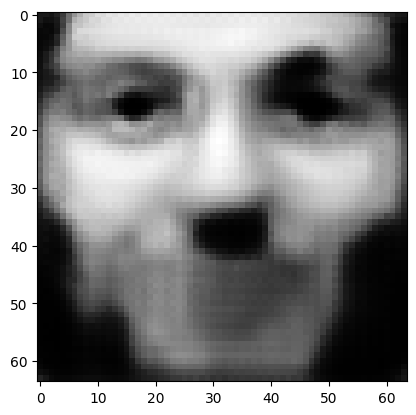

tensor([[4.4098e-07, 2.4176e-06, 9.7282e-01, 6.2017e-04, 5.7710e-06, 1.0060e-06,
         6.5680e-04, 7.7202e-05, 2.4500e-03, 7.3668e-04, 5.5438e-04, 3.9620e-05,
         2.5327e-04, 3.1589e-04, 1.8089e-05, 9.1909e-05, 5.2433e-04, 5.8144e-07,
         1.2581e-04, 2.2840e-04, 4.6431e-03, 2.3291e-03, 7.1678e-05, 2.5634e-05,
         5.2035e-04, 2.1131e-05, 3.6216e-04, 1.4449e-03, 2.9122e-03, 2.0334e-04,
         9.4941e-05, 1.3513e-06, 4.9062e-04, 2.1483e-04, 2.4779e-04, 3.3719e-06,
         1.2781e-03, 4.0948e-03, 6.1704e-04, 9.0533e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027560776099562645
tensor([[4.4066e-07, 2.4158e-06, 9.7283e-01, 6.1983e-04, 5.7667e-06, 1.0055e-06,
         6.5645e-04, 7.7177e-05, 2.4484e-03, 7.3636e-04, 5.5407e-04, 3.9590e-05,
         2.5309e-04, 3.1570e-04, 1.8074e-05, 9.1864e-05, 5.2402e-04, 5.8088e-07,
         1.2574e-04, 2.2829e-04, 4.6404e-03, 2.3279e-03, 7.1624e-05, 2.5615e-05,
         5.2001e-04, 2.1119e-05, 3.6196e-

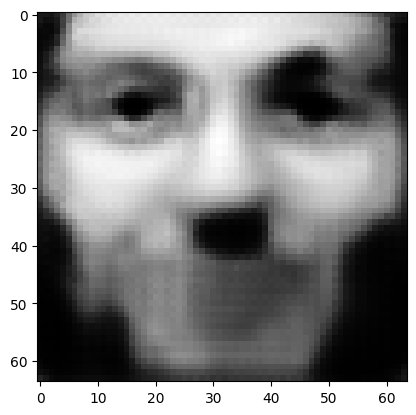

tensor([[4.3940e-07, 2.4088e-06, 9.7289e-01, 6.1853e-04, 5.7495e-06, 1.0035e-06,
         6.5505e-04, 7.7077e-05, 2.4422e-03, 7.3509e-04, 5.5288e-04, 3.9471e-05,
         2.5241e-04, 3.1495e-04, 1.8015e-05, 9.1686e-05, 5.2280e-04, 5.7865e-07,
         1.2547e-04, 2.2786e-04, 4.6298e-03, 2.3234e-03, 7.1412e-05, 2.5538e-05,
         5.1864e-04, 2.1071e-05, 3.6117e-04, 1.4410e-03, 2.9049e-03, 2.0272e-04,
         9.4592e-05, 1.3461e-06, 4.8917e-04, 2.1418e-04, 2.4697e-04, 3.3594e-06,
         1.2747e-03, 4.0826e-03, 6.1497e-04, 9.0284e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02748226188123226
tensor([[4.3910e-07, 2.4071e-06, 9.7291e-01, 6.1822e-04, 5.7454e-06, 1.0030e-06,
         6.5471e-04, 7.7053e-05, 2.4407e-03, 7.3479e-04, 5.5258e-04, 3.9443e-05,
         2.5224e-04, 3.1476e-04, 1.8001e-05, 9.1643e-05, 5.2250e-04, 5.7811e-07,
         1.2541e-04, 2.2776e-04, 4.6272e-03, 2.3223e-03, 7.1361e-05, 2.5520e-05,
         5.1831e-04, 2.1059e-05, 3.6098e-0

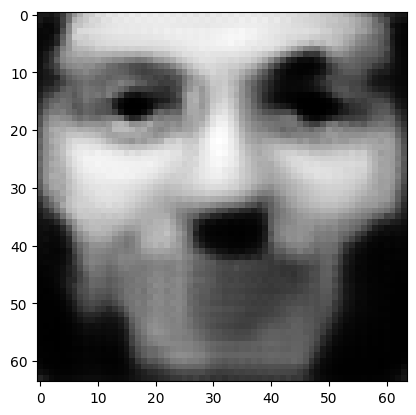

tensor([[4.3790e-07, 2.4005e-06, 9.7296e-01, 6.1697e-04, 5.7292e-06, 1.0011e-06,
         6.5337e-04, 7.6958e-05, 2.4348e-03, 7.3358e-04, 5.5145e-04, 3.9331e-05,
         2.5158e-04, 3.1405e-04, 1.7945e-05, 9.1476e-05, 5.2134e-04, 5.7600e-07,
         1.2516e-04, 2.2736e-04, 4.6172e-03, 2.3179e-03, 7.1158e-05, 2.5447e-05,
         5.1702e-04, 2.1014e-05, 3.6023e-04, 1.4373e-03, 2.8980e-03, 2.0214e-04,
         9.4261e-05, 1.3412e-06, 4.8780e-04, 2.1357e-04, 2.4619e-04, 3.3476e-06,
         1.2715e-03, 4.0711e-03, 6.1300e-04, 9.0051e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027407802641391754
tensor([[4.3761e-07, 2.3988e-06, 9.7298e-01, 6.1668e-04, 5.7254e-06, 1.0007e-06,
         6.5305e-04, 7.6936e-05, 2.4334e-03, 7.3330e-04, 5.5117e-04, 3.9304e-05,
         2.5142e-04, 3.1387e-04, 1.7932e-05, 9.1436e-05, 5.2106e-04, 5.7549e-07,
         1.2510e-04, 2.2726e-04, 4.6148e-03, 2.3169e-03, 7.1110e-05, 2.5430e-05,
         5.1670e-04, 2.1003e-05, 3.6005e-

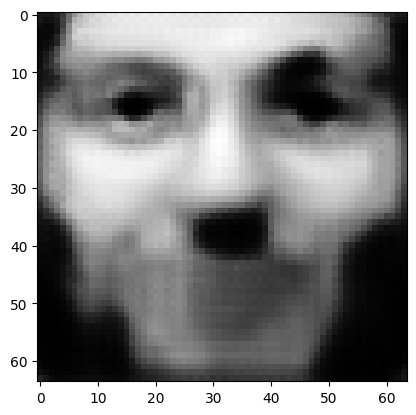

tensor([[4.3648e-07, 2.3926e-06, 9.7303e-01, 6.1550e-04, 5.7102e-06, 9.9888e-07,
         6.5179e-04, 7.6846e-05, 2.4279e-03, 7.3215e-04, 5.5009e-04, 3.9198e-05,
         2.5081e-04, 3.1320e-04, 1.7879e-05, 9.1277e-05, 5.1997e-04, 5.7351e-07,
         1.2486e-04, 2.2688e-04, 4.6054e-03, 2.3128e-03, 7.0918e-05, 2.5361e-05,
         5.1548e-04, 2.0959e-05, 3.5934e-04, 1.4338e-03, 2.8914e-03, 2.0159e-04,
         9.3948e-05, 1.3365e-06, 4.8650e-04, 2.1298e-04, 2.4545e-04, 3.3364e-06,
         1.2685e-03, 4.0601e-03, 6.1113e-04, 8.9830e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02733716368675232
tensor([[4.3621e-07, 2.3911e-06, 9.7305e-01, 6.1521e-04, 5.7064e-06, 9.9845e-07,
         6.5148e-04, 7.6824e-05, 2.4265e-03, 7.3187e-04, 5.4983e-04, 3.9172e-05,
         2.5066e-04, 3.1304e-04, 1.7867e-05, 9.1239e-05, 5.1970e-04, 5.7302e-07,
         1.2481e-04, 2.2678e-04, 4.6031e-03, 2.3118e-03, 7.0871e-05, 2.5344e-05,
         5.1519e-04, 2.0949e-05, 3.5917e-0

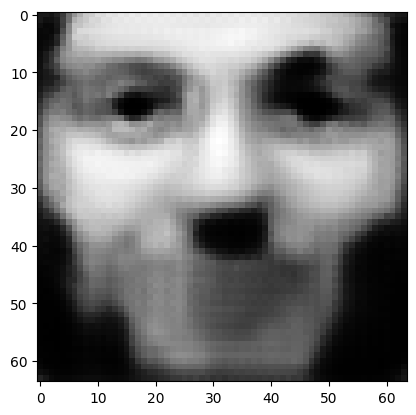

tensor([[4.3514e-07, 2.3851e-06, 9.7310e-01, 6.1410e-04, 5.6920e-06, 9.9677e-07,
         6.5028e-04, 7.6739e-05, 2.4213e-03, 7.3080e-04, 5.4881e-04, 3.9072e-05,
         2.5007e-04, 3.1240e-04, 1.7817e-05, 9.1089e-05, 5.1866e-04, 5.7114e-07,
         1.2458e-04, 2.2642e-04, 4.5941e-03, 2.3079e-03, 7.0691e-05, 2.5280e-05,
         5.1403e-04, 2.0908e-05, 3.5850e-04, 1.4305e-03, 2.8852e-03, 2.0107e-04,
         9.3652e-05, 1.3321e-06, 4.8527e-04, 2.1243e-04, 2.4475e-04, 3.3259e-06,
         1.2656e-03, 4.0497e-03, 6.0937e-04, 8.9622e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02727058157324791
tensor([[4.3488e-07, 2.3837e-06, 9.7311e-01, 6.1383e-04, 5.6885e-06, 9.9636e-07,
         6.4999e-04, 7.6719e-05, 2.4200e-03, 7.3054e-04, 5.4857e-04, 3.9048e-05,
         2.4993e-04, 3.1225e-04, 1.7805e-05, 9.1053e-05, 5.1841e-04, 5.7069e-07,
         1.2453e-04, 2.2634e-04, 4.5919e-03, 2.3070e-03, 7.0647e-05, 2.5264e-05,
         5.1375e-04, 2.0898e-05, 3.5833e-0

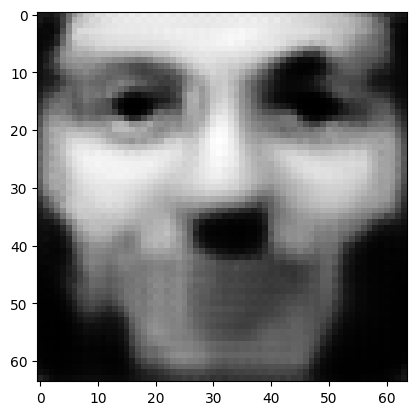

tensor([[4.3387e-07, 2.3781e-06, 9.7316e-01, 6.1278e-04, 5.6749e-06, 9.9476e-07,
         6.4886e-04, 7.6638e-05, 2.4151e-03, 7.2951e-04, 5.4760e-04, 3.8953e-05,
         2.4937e-04, 3.1165e-04, 1.7758e-05, 9.0911e-05, 5.1743e-04, 5.6892e-07,
         1.2432e-04, 2.2599e-04, 4.5835e-03, 2.3033e-03, 7.0476e-05, 2.5203e-05,
         5.1266e-04, 2.0859e-05, 3.5770e-04, 1.4274e-03, 2.8793e-03, 2.0058e-04,
         9.3373e-05, 1.3280e-06, 4.8411e-04, 2.1191e-04, 2.4409e-04, 3.3159e-06,
         1.2629e-03, 4.0399e-03, 6.0771e-04, 8.9425e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027207588776946068
tensor([[4.3363e-07, 2.3768e-06, 9.7317e-01, 6.1253e-04, 5.6716e-06, 9.9438e-07,
         6.4859e-04, 7.6619e-05, 2.4139e-03, 7.2927e-04, 5.4737e-04, 3.8930e-05,
         2.4924e-04, 3.1150e-04, 1.7747e-05, 9.0877e-05, 5.1719e-04, 5.6849e-07,
         1.2427e-04, 2.2591e-04, 4.5814e-03, 2.3024e-03, 7.0435e-05, 2.5188e-05,
         5.1239e-04, 2.0850e-05, 3.5754e-

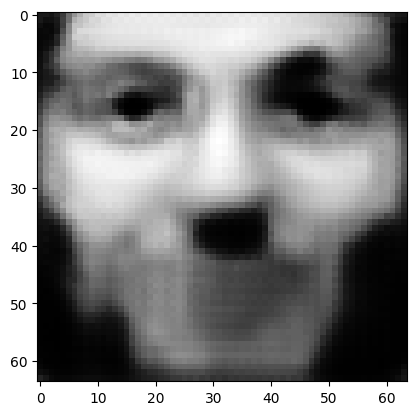

tensor([[4.3267e-07, 2.3715e-06, 9.7322e-01, 6.1154e-04, 5.6586e-06, 9.9287e-07,
         6.4752e-04, 7.6542e-05, 2.4092e-03, 7.2830e-04, 5.4645e-04, 3.8841e-05,
         2.4871e-04, 3.1093e-04, 1.7703e-05, 9.0742e-05, 5.1626e-04, 5.6681e-07,
         1.2407e-04, 2.2559e-04, 4.5734e-03, 2.2990e-03, 7.0274e-05, 2.5130e-05,
         5.1136e-04, 2.0813e-05, 3.5694e-04, 1.4244e-03, 2.8737e-03, 2.0011e-04,
         9.3107e-05, 1.3240e-06, 4.8301e-04, 2.1142e-04, 2.4346e-04, 3.3064e-06,
         1.2604e-03, 4.0306e-03, 6.0613e-04, 8.9237e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027147727087140083
tensor([[4.3244e-07, 2.3702e-06, 9.7323e-01, 6.1129e-04, 5.6556e-06, 9.9251e-07,
         6.4726e-04, 7.6524e-05, 2.4080e-03, 7.2807e-04, 5.4623e-04, 3.8819e-05,
         2.4859e-04, 3.1079e-04, 1.7692e-05, 9.0710e-05, 5.1603e-04, 5.6641e-07,
         1.2402e-04, 2.2551e-04, 4.5715e-03, 2.2981e-03, 7.0235e-05, 2.5116e-05,
         5.1111e-04, 2.0805e-05, 3.5680e-

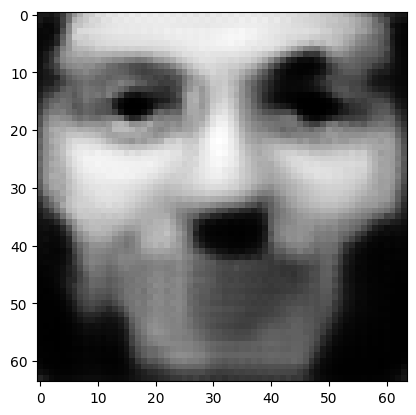

tensor([[4.3154e-07, 2.3651e-06, 9.7327e-01, 6.1035e-04, 5.6433e-06, 9.9108e-07,
         6.4625e-04, 7.6452e-05, 2.4036e-03, 7.2716e-04, 5.4537e-04, 3.8735e-05,
         2.4809e-04, 3.1025e-04, 1.7650e-05, 9.0582e-05, 5.1515e-04, 5.6482e-07,
         1.2383e-04, 2.2520e-04, 4.5639e-03, 2.2948e-03, 7.0082e-05, 2.5061e-05,
         5.1013e-04, 2.0770e-05, 3.5623e-04, 1.4216e-03, 2.8684e-03, 1.9967e-04,
         9.2857e-05, 1.3203e-06, 4.8197e-04, 2.1095e-04, 2.4287e-04, 3.2975e-06,
         1.2579e-03, 4.0219e-03, 6.0464e-04, 8.9060e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027091341093182564
tensor([[4.3132e-07, 2.3639e-06, 9.7328e-01, 6.1013e-04, 5.6404e-06, 9.9073e-07,
         6.4600e-04, 7.6434e-05, 2.4025e-03, 7.2694e-04, 5.4516e-04, 3.8714e-05,
         2.4797e-04, 3.1012e-04, 1.7640e-05, 9.0551e-05, 5.1494e-04, 5.6444e-07,
         1.2378e-04, 2.2513e-04, 4.5620e-03, 2.2940e-03, 7.0045e-05, 2.5048e-05,
         5.0989e-04, 2.0762e-05, 3.5609e-

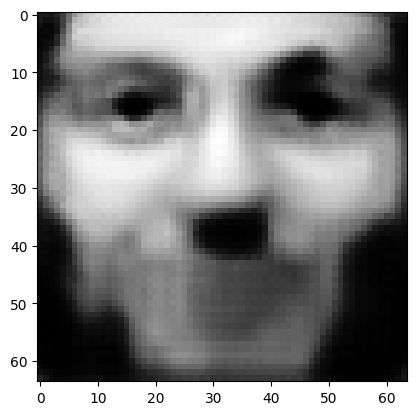

tensor([[4.3047e-07, 2.3592e-06, 9.7332e-01, 6.0923e-04, 5.6288e-06, 9.8938e-07,
         6.4504e-04, 7.6366e-05, 2.3983e-03, 7.2606e-04, 5.4434e-04, 3.8634e-05,
         2.4750e-04, 3.0961e-04, 1.7600e-05, 9.0431e-05, 5.1411e-04, 5.6294e-07,
         1.2360e-04, 2.2484e-04, 4.5548e-03, 2.2909e-03, 6.9900e-05, 2.4996e-05,
         5.0896e-04, 2.0729e-05, 3.5555e-04, 1.4190e-03, 2.8634e-03, 1.9926e-04,
         9.2620e-05, 1.3168e-06, 4.8098e-04, 2.1051e-04, 2.4231e-04, 3.2890e-06,
         1.2556e-03, 4.0135e-03, 6.0323e-04, 8.8893e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027037853375077248
tensor([[4.3026e-07, 2.3580e-06, 9.7333e-01, 6.0902e-04, 5.6261e-06, 9.8905e-07,
         6.4481e-04, 7.6349e-05, 2.3973e-03, 7.2586e-04, 5.4414e-04, 3.8615e-05,
         2.4739e-04, 3.0948e-04, 1.7590e-05, 9.0401e-05, 5.1391e-04, 5.6257e-07,
         1.2356e-04, 2.2477e-04, 4.5531e-03, 2.2902e-03, 6.9866e-05, 2.4984e-05,
         5.0874e-04, 2.0721e-05, 3.5542e-

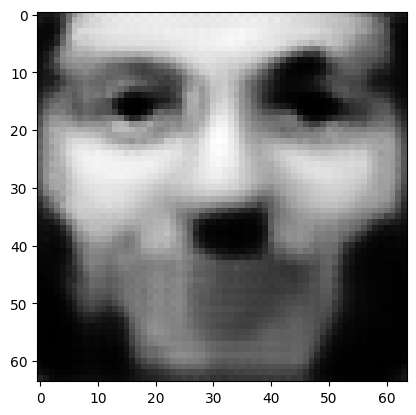

tensor([[4.2945e-07, 2.3535e-06, 9.7337e-01, 6.0816e-04, 5.6151e-06, 9.8777e-07,
         6.4390e-04, 7.6284e-05, 2.3933e-03, 7.2503e-04, 5.4336e-04, 3.8539e-05,
         2.4694e-04, 3.0900e-04, 1.7553e-05, 9.0287e-05, 5.1312e-04, 5.6116e-07,
         1.2339e-04, 2.2449e-04, 4.5463e-03, 2.2872e-03, 6.9728e-05, 2.4934e-05,
         5.0786e-04, 2.0690e-05, 3.5491e-04, 1.4165e-03, 2.8586e-03, 1.9886e-04,
         9.2397e-05, 1.3135e-06, 4.8005e-04, 2.1009e-04, 2.4178e-04, 3.2810e-06,
         1.2535e-03, 4.0057e-03, 6.0189e-04, 8.8734e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026987146586179733
tensor([[4.2925e-07, 2.3524e-06, 9.7338e-01, 6.0796e-04, 5.6125e-06, 9.8746e-07,
         6.4368e-04, 7.6269e-05, 2.3923e-03, 7.2483e-04, 5.4317e-04, 3.8520e-05,
         2.4684e-04, 3.0888e-04, 1.7544e-05, 9.0259e-05, 5.1293e-04, 5.6081e-07,
         1.2335e-04, 2.2442e-04, 4.5446e-03, 2.2865e-03, 6.9695e-05, 2.4922e-05,
         5.0765e-04, 2.0682e-05, 3.5479e-

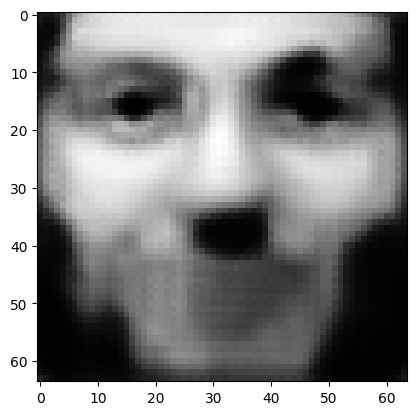

tensor([[4.2849e-07, 2.3482e-06, 9.7342e-01, 6.0716e-04, 5.6021e-06, 9.8625e-07,
         6.4282e-04, 7.6207e-05, 2.3886e-03, 7.2405e-04, 5.4244e-04, 3.8449e-05,
         2.4642e-04, 3.0842e-04, 1.7508e-05, 9.0151e-05, 5.1218e-04, 5.5947e-07,
         1.2319e-04, 2.2416e-04, 4.5382e-03, 2.2837e-03, 6.9566e-05, 2.4876e-05,
         5.0682e-04, 2.0653e-05, 3.5430e-04, 1.4141e-03, 2.8542e-03, 1.9849e-04,
         9.2184e-05, 1.3103e-06, 4.7916e-04, 2.0970e-04, 2.4127e-04, 3.2734e-06,
         1.2514e-03, 3.9982e-03, 6.0063e-04, 8.8583e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026939107105135918
tensor([[4.2830e-07, 2.3472e-06, 9.7343e-01, 6.0696e-04, 5.5996e-06, 9.8595e-07,
         6.4261e-04, 7.6192e-05, 2.3877e-03, 7.2387e-04, 5.4226e-04, 3.8431e-05,
         2.4632e-04, 3.0831e-04, 1.7499e-05, 9.0125e-05, 5.1200e-04, 5.5914e-07,
         1.2315e-04, 2.2410e-04, 4.5366e-03, 2.2830e-03, 6.9534e-05, 2.4865e-05,
         5.0661e-04, 2.0646e-05, 3.5418e-

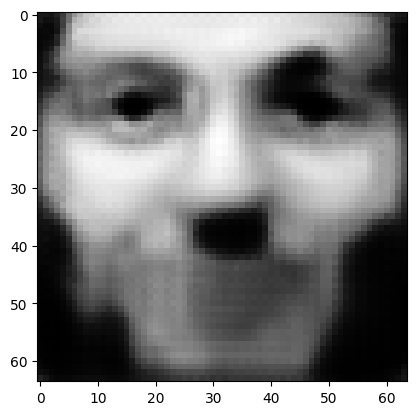

tensor([[4.2758e-07, 2.3431e-06, 9.7346e-01, 6.0621e-04, 5.5898e-06, 9.8481e-07,
         6.4180e-04, 7.6134e-05, 2.3841e-03, 7.2314e-04, 5.4156e-04, 3.8363e-05,
         2.4592e-04, 3.0787e-04, 1.7466e-05, 9.0022e-05, 5.1129e-04, 5.5788e-07,
         1.2299e-04, 2.2385e-04, 4.5304e-03, 2.2804e-03, 6.9413e-05, 2.4821e-05,
         5.0582e-04, 2.0618e-05, 3.5373e-04, 1.4118e-03, 2.8499e-03, 1.9813e-04,
         9.1982e-05, 1.3073e-06, 4.7833e-04, 2.0932e-04, 2.4080e-04, 3.2662e-06,
         1.2494e-03, 3.9911e-03, 5.9942e-04, 8.8439e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026893502101302147
tensor([[4.2740e-07, 2.3421e-06, 9.7347e-01, 6.0602e-04, 5.5874e-06, 9.8453e-07,
         6.4160e-04, 7.6119e-05, 2.3832e-03, 7.2295e-04, 5.4139e-04, 3.8346e-05,
         2.4582e-04, 3.0777e-04, 1.7457e-05, 8.9997e-05, 5.1112e-04, 5.5757e-07,
         1.2296e-04, 2.2379e-04, 4.5289e-03, 2.2797e-03, 6.9382e-05, 2.4810e-05,
         5.0563e-04, 2.0611e-05, 3.5361e-

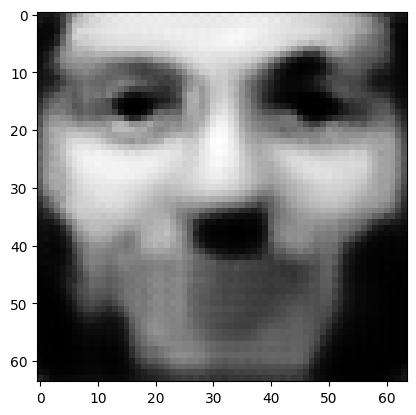

tensor([[4.2671e-07, 2.3383e-06, 9.7351e-01, 6.0530e-04, 5.5780e-06, 9.8344e-07,
         6.4082e-04, 7.6064e-05, 2.3798e-03, 7.2225e-04, 5.4073e-04, 3.8282e-05,
         2.4544e-04, 3.0735e-04, 1.7426e-05, 8.9900e-05, 5.1045e-04, 5.5636e-07,
         1.2281e-04, 2.2355e-04, 4.5231e-03, 2.2772e-03, 6.9266e-05, 2.4768e-05,
         5.0489e-04, 2.0585e-05, 3.5318e-04, 1.4097e-03, 2.8459e-03, 1.9779e-04,
         9.1792e-05, 1.3045e-06, 4.7753e-04, 2.0896e-04, 2.4034e-04, 3.2594e-06,
         1.2476e-03, 3.9845e-03, 5.9829e-04, 8.8303e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02685033157467842
tensor([[4.2655e-07, 2.3374e-06, 9.7352e-01, 6.0513e-04, 5.5758e-06, 9.8318e-07,
         6.4064e-04, 7.6051e-05, 2.3790e-03, 7.2209e-04, 5.4057e-04, 3.8266e-05,
         2.4535e-04, 3.0725e-04, 1.7418e-05, 8.9876e-05, 5.1028e-04, 5.5607e-07,
         1.2277e-04, 2.2350e-04, 4.5217e-03, 2.2766e-03, 6.9238e-05, 2.4758e-05,
         5.0471e-04, 2.0578e-05, 3.5307e-0

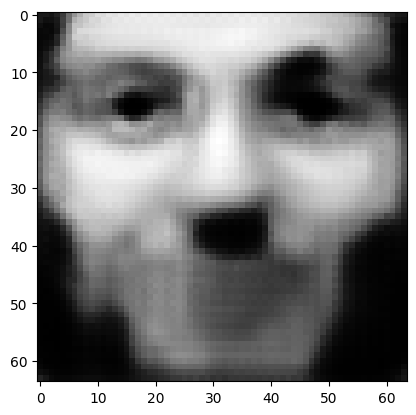

tensor([[4.2590e-07, 2.3338e-06, 9.7355e-01, 6.0444e-04, 5.5670e-06, 9.8214e-07,
         6.3990e-04, 7.5998e-05, 2.3758e-03, 7.2142e-04, 5.3994e-04, 3.8205e-05,
         2.4500e-04, 3.0686e-04, 1.7388e-05, 8.9784e-05, 5.0965e-04, 5.5494e-07,
         1.2264e-04, 2.2327e-04, 4.5162e-03, 2.2742e-03, 6.9128e-05, 2.4718e-05,
         5.0400e-04, 2.0553e-05, 3.5266e-04, 1.4077e-03, 2.8421e-03, 1.9748e-04,
         9.1611e-05, 1.3018e-06, 4.7678e-04, 2.0863e-04, 2.3992e-04, 3.2530e-06,
         1.2458e-03, 3.9781e-03, 5.9721e-04, 8.8174e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026809364557266235
tensor([[4.2574e-07, 2.3329e-06, 9.7355e-01, 6.0427e-04, 5.5648e-06, 9.8189e-07,
         6.3973e-04, 7.5985e-05, 2.3750e-03, 7.2126e-04, 5.3979e-04, 3.8190e-05,
         2.4491e-04, 3.0677e-04, 1.7380e-05, 8.9762e-05, 5.0949e-04, 5.5466e-07,
         1.2260e-04, 2.2322e-04, 4.5149e-03, 2.2736e-03, 6.9101e-05, 2.4709e-05,
         5.0383e-04, 2.0547e-05, 3.5256e-

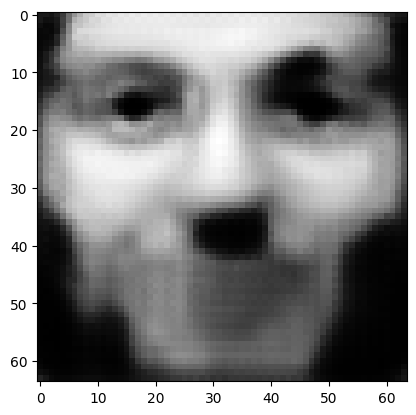

tensor([[4.2512e-07, 2.3295e-06, 9.7358e-01, 6.0362e-04, 5.5565e-06, 9.8091e-07,
         6.3903e-04, 7.5935e-05, 2.3720e-03, 7.2063e-04, 5.3920e-04, 3.8132e-05,
         2.4457e-04, 3.0640e-04, 1.7352e-05, 8.9674e-05, 5.0889e-04, 5.5358e-07,
         1.2247e-04, 2.2301e-04, 4.5096e-03, 2.2714e-03, 6.8997e-05, 2.4671e-05,
         5.0316e-04, 2.0523e-05, 3.5217e-04, 1.4057e-03, 2.8384e-03, 1.9717e-04,
         9.1439e-05, 1.2993e-06, 4.7607e-04, 2.0831e-04, 2.3951e-04, 3.2469e-06,
         1.2442e-03, 3.9721e-03, 5.9619e-04, 8.8052e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02677071839570999
tensor([[4.2497e-07, 2.3286e-06, 9.7359e-01, 6.0347e-04, 5.5544e-06, 9.8067e-07,
         6.3886e-04, 7.5923e-05, 2.3713e-03, 7.2047e-04, 5.3905e-04, 3.8118e-05,
         2.4449e-04, 3.0631e-04, 1.7345e-05, 8.9653e-05, 5.0874e-04, 5.5332e-07,
         1.2244e-04, 2.2296e-04, 4.5084e-03, 2.2708e-03, 6.8971e-05, 2.4662e-05,
         5.0299e-04, 2.0517e-05, 3.5208e-0

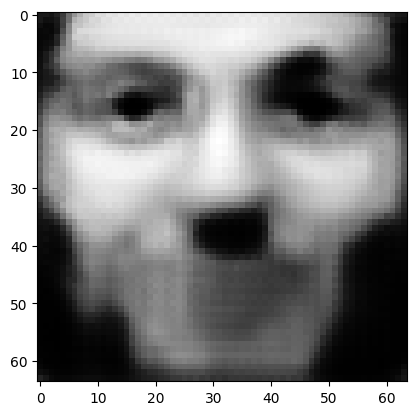

tensor([[4.2438e-07, 2.3254e-06, 9.7362e-01, 6.0285e-04, 5.5465e-06, 9.7975e-07,
         6.3820e-04, 7.5876e-05, 2.3684e-03, 7.1988e-04, 5.3849e-04, 3.8063e-05,
         2.4417e-04, 3.0596e-04, 1.7318e-05, 8.9570e-05, 5.0817e-04, 5.5230e-07,
         1.2232e-04, 2.2276e-04, 4.5034e-03, 2.2687e-03, 6.8873e-05, 2.4627e-05,
         5.0236e-04, 2.0495e-05, 3.5171e-04, 1.4039e-03, 2.8350e-03, 1.9689e-04,
         9.1277e-05, 1.2968e-06, 4.7539e-04, 2.0800e-04, 2.3913e-04, 3.2410e-06,
         1.2426e-03, 3.9664e-03, 5.9522e-04, 8.7936e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02673381008207798
tensor([[4.2424e-07, 2.3246e-06, 9.7363e-01, 6.0271e-04, 5.5446e-06, 9.7952e-07,
         6.3804e-04, 7.5865e-05, 2.3677e-03, 7.1973e-04, 5.3835e-04, 3.8050e-05,
         2.4409e-04, 3.0587e-04, 1.7311e-05, 8.9550e-05, 5.0803e-04, 5.5205e-07,
         1.2229e-04, 2.2271e-04, 4.5022e-03, 2.2682e-03, 6.8849e-05, 2.4618e-05,
         5.0220e-04, 2.0489e-05, 3.5161e-0

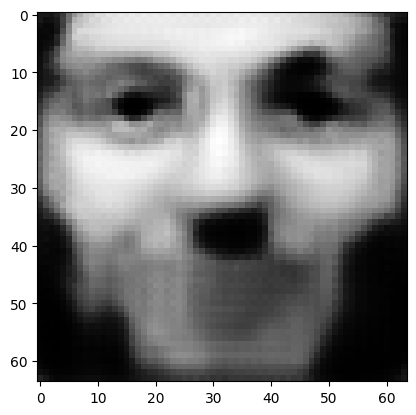

tensor([[4.2369e-07, 2.3215e-06, 9.7365e-01, 6.0212e-04, 5.5371e-06, 9.7864e-07,
         6.3742e-04, 7.5820e-05, 2.3650e-03, 7.1917e-04, 5.3782e-04, 3.7998e-05,
         2.4379e-04, 3.0554e-04, 1.7285e-05, 8.9471e-05, 5.0749e-04, 5.5108e-07,
         1.2217e-04, 2.2252e-04, 4.4975e-03, 2.2661e-03, 6.8755e-05, 2.4584e-05,
         5.0160e-04, 2.0468e-05, 3.5126e-04, 1.4022e-03, 2.8317e-03, 1.9661e-04,
         9.1123e-05, 1.2946e-06, 4.7475e-04, 2.0771e-04, 2.3876e-04, 3.2356e-06,
         1.2411e-03, 3.9610e-03, 5.9430e-04, 8.7826e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02669910527765751
tensor([[4.2355e-07, 2.3207e-06, 9.7366e-01, 6.0198e-04, 5.5352e-06, 9.7842e-07,
         6.3727e-04, 7.5809e-05, 2.3643e-03, 7.1903e-04, 5.3769e-04, 3.7985e-05,
         2.4371e-04, 3.0546e-04, 1.7279e-05, 8.9452e-05, 5.0736e-04, 5.5085e-07,
         1.2214e-04, 2.2247e-04, 4.4963e-03, 2.2656e-03, 6.8732e-05, 2.4576e-05,
         5.0145e-04, 2.0463e-05, 3.5118e-0

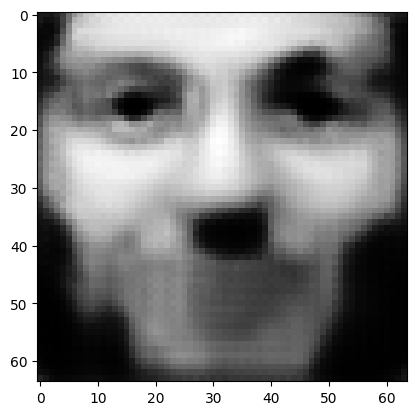

tensor([[4.2303e-07, 2.3178e-06, 9.7369e-01, 6.0143e-04, 5.5282e-06, 9.7760e-07,
         6.3668e-04, 7.5766e-05, 2.3617e-03, 7.1850e-04, 5.3718e-04, 3.7936e-05,
         2.4342e-04, 3.0514e-04, 1.7255e-05, 8.9377e-05, 5.0685e-04, 5.4994e-07,
         1.2203e-04, 2.2229e-04, 4.4919e-03, 2.2637e-03, 6.8644e-05, 2.4544e-05,
         5.0088e-04, 2.0442e-05, 3.5085e-04, 1.4006e-03, 2.8287e-03, 1.9636e-04,
         9.0977e-05, 1.2924e-06, 4.7414e-04, 2.0744e-04, 2.3842e-04, 3.2304e-06,
         1.2397e-03, 3.9559e-03, 5.9343e-04, 8.7722e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026666026562452316
tensor([[4.2290e-07, 2.3171e-06, 9.7369e-01, 6.0129e-04, 5.5264e-06, 9.7739e-07,
         6.3653e-04, 7.5756e-05, 2.3611e-03, 7.1836e-04, 5.3706e-04, 3.7924e-05,
         2.4335e-04, 3.0506e-04, 1.7249e-05, 8.9359e-05, 5.0672e-04, 5.4971e-07,
         1.2200e-04, 2.2225e-04, 4.4908e-03, 2.2632e-03, 6.8622e-05, 2.4536e-05,
         5.0075e-04, 2.0437e-05, 3.5077e-

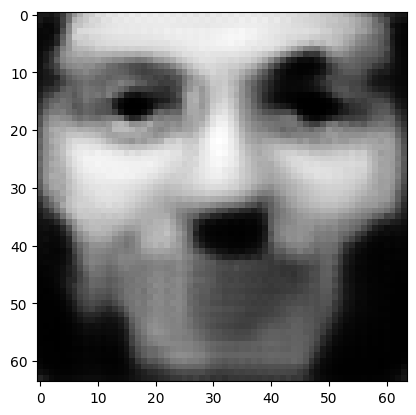

tensor([[4.2240e-07, 2.3143e-06, 9.7372e-01, 6.0077e-04, 5.5197e-06, 9.7660e-07,
         6.3597e-04, 7.5715e-05, 2.3586e-03, 7.1785e-04, 5.3658e-04, 3.7877e-05,
         2.4308e-04, 3.0476e-04, 1.7226e-05, 8.9288e-05, 5.0623e-04, 5.4884e-07,
         1.2190e-04, 2.2207e-04, 4.4866e-03, 2.2614e-03, 6.8538e-05, 2.4506e-05,
         5.0020e-04, 2.0418e-05, 3.5045e-04, 1.3990e-03, 2.8257e-03, 1.9611e-04,
         9.0839e-05, 1.2904e-06, 4.7356e-04, 2.0718e-04, 2.3809e-04, 3.2254e-06,
         1.2383e-03, 3.9510e-03, 5.9260e-04, 8.7623e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026634685695171356
tensor([[4.2228e-07, 2.3137e-06, 9.7372e-01, 6.0064e-04, 5.5181e-06, 9.7641e-07,
         6.3583e-04, 7.5706e-05, 2.3580e-03, 7.1773e-04, 5.3646e-04, 3.7866e-05,
         2.4301e-04, 3.0469e-04, 1.7220e-05, 8.9271e-05, 5.0612e-04, 5.4863e-07,
         1.2187e-04, 2.2203e-04, 4.4856e-03, 2.2610e-03, 6.8518e-05, 2.4499e-05,
         5.0007e-04, 2.0414e-05, 3.5037e-

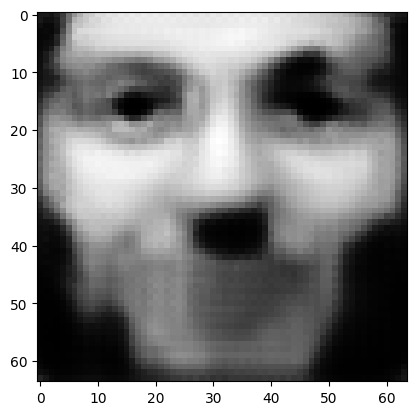

tensor([[4.2181e-07, 2.3110e-06, 9.7375e-01, 6.0015e-04, 5.5117e-06, 9.7566e-07,
         6.3530e-04, 7.5667e-05, 2.3557e-03, 7.1725e-04, 5.3601e-04, 3.7821e-05,
         2.4275e-04, 3.0441e-04, 1.7198e-05, 8.9204e-05, 5.0565e-04, 5.4781e-07,
         1.2177e-04, 2.2187e-04, 4.4816e-03, 2.2592e-03, 6.8438e-05, 2.4470e-05,
         4.9956e-04, 2.0395e-05, 3.5007e-04, 1.3975e-03, 2.8229e-03, 1.9588e-04,
         9.0708e-05, 1.2884e-06, 4.7302e-04, 2.0694e-04, 2.3778e-04, 3.2207e-06,
         1.2370e-03, 3.9464e-03, 5.9182e-04, 8.7529e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026604970917105675
tensor([[4.2169e-07, 2.3104e-06, 9.7375e-01, 6.0003e-04, 5.5101e-06, 9.7547e-07,
         6.3517e-04, 7.5658e-05, 2.3551e-03, 7.1713e-04, 5.3590e-04, 3.7811e-05,
         2.4269e-04, 3.0434e-04, 1.7193e-05, 8.9187e-05, 5.0554e-04, 5.4761e-07,
         1.2175e-04, 2.2183e-04, 4.4806e-03, 2.2588e-03, 6.8419e-05, 2.4463e-05,
         4.9943e-04, 2.0391e-05, 3.5000e-

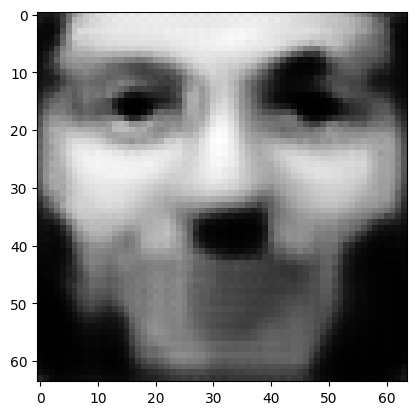

tensor([[4.2124e-07, 2.3079e-06, 9.7377e-01, 5.9955e-04, 5.5040e-06, 9.7476e-07,
         6.3466e-04, 7.5621e-05, 2.3529e-03, 7.1667e-04, 5.3547e-04, 3.7769e-05,
         2.4245e-04, 3.0407e-04, 1.7172e-05, 8.9123e-05, 5.0510e-04, 5.4683e-07,
         1.2165e-04, 2.2168e-04, 4.4768e-03, 2.2572e-03, 6.8343e-05, 2.4436e-05,
         4.9895e-04, 2.0374e-05, 3.4972e-04, 1.3961e-03, 2.8203e-03, 1.9566e-04,
         9.0584e-05, 1.2866e-06, 4.7250e-04, 2.0671e-04, 2.3748e-04, 3.2163e-06,
         1.2358e-03, 3.9421e-03, 5.9108e-04, 8.7440e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02657664567232132
tensor([[4.2114e-07, 2.3073e-06, 9.7378e-01, 5.9944e-04, 5.5026e-06, 9.7459e-07,
         6.3454e-04, 7.5613e-05, 2.3524e-03, 7.1656e-04, 5.3536e-04, 3.7758e-05,
         2.4239e-04, 3.0400e-04, 1.7167e-05, 8.9108e-05, 5.0500e-04, 5.4664e-07,
         1.2163e-04, 2.2164e-04, 4.4759e-03, 2.2568e-03, 6.8325e-05, 2.4429e-05,
         4.9883e-04, 2.0370e-05, 3.4965e-0

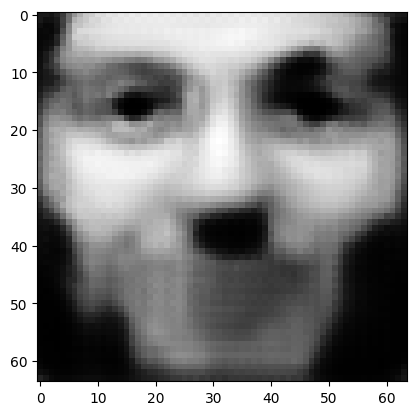

tensor([[4.2071e-07, 2.3049e-06, 9.7380e-01, 5.9899e-04, 5.4968e-06, 9.7391e-07,
         6.3406e-04, 7.5578e-05, 2.3503e-03, 7.1612e-04, 5.3495e-04, 3.7718e-05,
         2.4215e-04, 3.0375e-04, 1.7147e-05, 8.9047e-05, 5.0458e-04, 5.4590e-07,
         1.2154e-04, 2.2149e-04, 4.4723e-03, 2.2552e-03, 6.8253e-05, 2.4403e-05,
         4.9837e-04, 2.0353e-05, 3.4938e-04, 1.3948e-03, 2.8178e-03, 1.9545e-04,
         9.0466e-05, 1.2848e-06, 4.7200e-04, 2.0648e-04, 2.3720e-04, 3.2121e-06,
         1.2347e-03, 3.9379e-03, 5.9037e-04, 8.7356e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026550062000751495
tensor([[4.2061e-07, 2.3044e-06, 9.7380e-01, 5.9888e-04, 5.4954e-06, 9.7375e-07,
         6.3395e-04, 7.5570e-05, 2.3498e-03, 7.1602e-04, 5.3485e-04, 3.7709e-05,
         2.4209e-04, 3.0369e-04, 1.7143e-05, 8.9033e-05, 5.0448e-04, 5.4572e-07,
         1.2152e-04, 2.2146e-04, 4.4714e-03, 2.2548e-03, 6.8236e-05, 2.4397e-05,
         4.9826e-04, 2.0349e-05, 3.4931e-

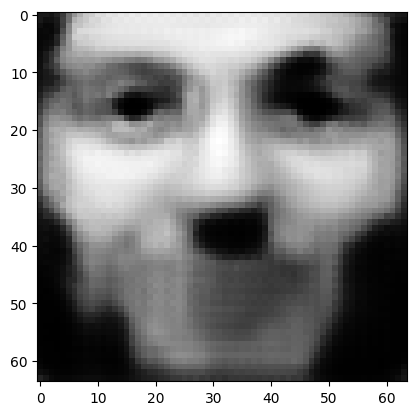

tensor([[4.2020e-07, 2.3021e-06, 9.7382e-01, 5.9846e-04, 5.4899e-06, 9.7310e-07,
         6.3349e-04, 7.5537e-05, 2.3478e-03, 7.1560e-04, 5.3446e-04, 3.7671e-05,
         2.4187e-04, 3.0344e-04, 1.7124e-05, 8.8975e-05, 5.0409e-04, 5.4502e-07,
         1.2143e-04, 2.2132e-04, 4.4679e-03, 2.2533e-03, 6.8168e-05, 2.4373e-05,
         4.9782e-04, 2.0334e-05, 3.4906e-04, 1.3935e-03, 2.8154e-03, 1.9525e-04,
         9.0354e-05, 1.2832e-06, 4.7154e-04, 2.0627e-04, 2.3694e-04, 3.2081e-06,
         1.2336e-03, 3.9340e-03, 5.8970e-04, 8.7276e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02652464061975479
tensor([[4.2011e-07, 2.3016e-06, 9.7383e-01, 5.9835e-04, 5.4886e-06, 9.7295e-07,
         6.3338e-04, 7.5529e-05, 2.3473e-03, 7.1550e-04, 5.3437e-04, 3.7662e-05,
         2.4182e-04, 3.0338e-04, 1.7119e-05, 8.8961e-05, 5.0399e-04, 5.4485e-07,
         1.2141e-04, 2.2128e-04, 4.4671e-03, 2.2530e-03, 6.8151e-05, 2.4367e-05,
         4.9771e-04, 2.0330e-05, 3.4899e-0

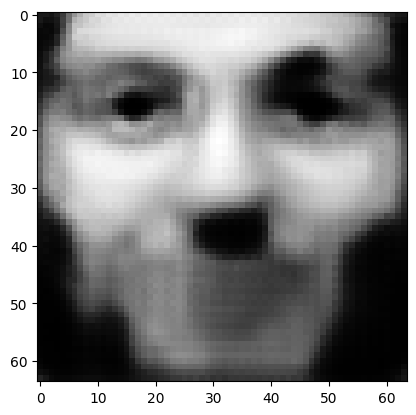

tensor([[4.1972e-07, 2.2994e-06, 9.7385e-01, 5.9795e-04, 5.4834e-06, 9.7234e-07,
         6.3295e-04, 7.5498e-05, 2.3454e-03, 7.1511e-04, 5.3400e-04, 3.7626e-05,
         2.4161e-04, 3.0315e-04, 1.7102e-05, 8.8906e-05, 5.0362e-04, 5.4418e-07,
         1.2133e-04, 2.2115e-04, 4.4639e-03, 2.2516e-03, 6.8087e-05, 2.4343e-05,
         4.9729e-04, 2.0315e-05, 3.4875e-04, 1.3924e-03, 2.8132e-03, 1.9507e-04,
         9.0248e-05, 1.2816e-06, 4.7109e-04, 2.0608e-04, 2.3669e-04, 3.2043e-06,
         1.2325e-03, 3.9302e-03, 5.8907e-04, 8.7199e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02650049328804016
tensor([[4.1963e-07, 2.2989e-06, 9.7385e-01, 5.9785e-04, 5.4822e-06, 9.7219e-07,
         6.3284e-04, 7.5490e-05, 2.3450e-03, 7.1501e-04, 5.3391e-04, 3.7617e-05,
         2.4156e-04, 3.0310e-04, 1.7097e-05, 8.8893e-05, 5.0352e-04, 5.4402e-07,
         1.2131e-04, 2.2112e-04, 4.4631e-03, 2.2512e-03, 6.8071e-05, 2.4338e-05,
         4.9719e-04, 2.0311e-05, 3.4869e-0

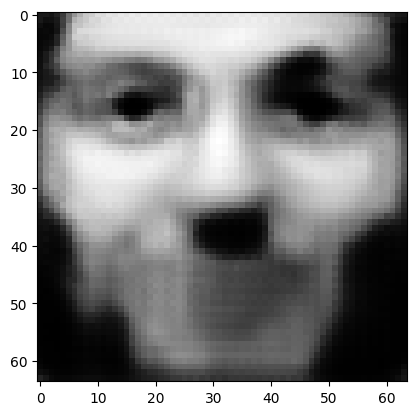

tensor([[4.1927e-07, 2.2969e-06, 9.7387e-01, 5.9747e-04, 5.4773e-06, 9.7161e-07,
         6.3244e-04, 7.5461e-05, 2.3432e-03, 7.1464e-04, 5.3356e-04, 3.7583e-05,
         2.4136e-04, 3.0288e-04, 1.7080e-05, 8.8841e-05, 5.0317e-04, 5.4339e-07,
         1.2123e-04, 2.2099e-04, 4.4600e-03, 2.2499e-03, 6.8011e-05, 2.4316e-05,
         4.9680e-04, 2.0298e-05, 3.4846e-04, 1.3912e-03, 2.8110e-03, 1.9489e-04,
         9.0148e-05, 1.2801e-06, 4.7067e-04, 2.0589e-04, 2.3645e-04, 3.2007e-06,
         1.2316e-03, 3.9267e-03, 5.8847e-04, 8.7127e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026477506384253502
tensor([[4.1918e-07, 2.2964e-06, 9.7387e-01, 5.9738e-04, 5.4761e-06, 9.7147e-07,
         6.3234e-04, 7.5453e-05, 2.3428e-03, 7.1455e-04, 5.3347e-04, 3.7575e-05,
         2.4131e-04, 3.0283e-04, 1.7076e-05, 8.8829e-05, 5.0308e-04, 5.4324e-07,
         1.2121e-04, 2.2096e-04, 4.4592e-03, 2.2496e-03, 6.7995e-05, 2.4310e-05,
         4.9671e-04, 2.0294e-05, 3.4841e-

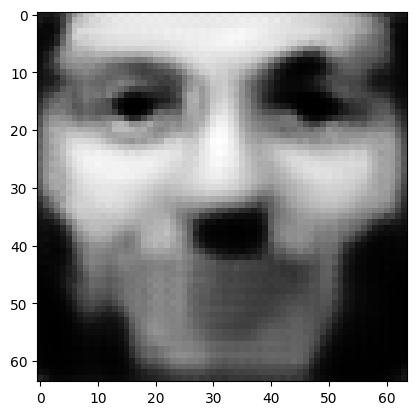

tensor([[4.1884e-07, 2.2945e-06, 9.7389e-01, 5.9702e-04, 5.4714e-06, 9.7092e-07,
         6.3195e-04, 7.5425e-05, 2.3411e-03, 7.1420e-04, 5.3314e-04, 3.7543e-05,
         2.4112e-04, 3.0262e-04, 1.7060e-05, 8.8780e-05, 5.0275e-04, 5.4264e-07,
         1.2114e-04, 2.2084e-04, 4.4563e-03, 2.2483e-03, 6.7937e-05, 2.4289e-05,
         4.9633e-04, 2.0281e-05, 3.4819e-04, 1.3901e-03, 2.8090e-03, 1.9472e-04,
         9.0052e-05, 1.2787e-06, 4.7027e-04, 2.0571e-04, 2.3622e-04, 3.1973e-06,
         1.2306e-03, 3.9233e-03, 5.8790e-04, 8.7059e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026455797255039215
tensor([[4.1875e-07, 2.2940e-06, 9.7390e-01, 5.9693e-04, 5.4703e-06, 9.7079e-07,
         6.3185e-04, 7.5418e-05, 2.3406e-03, 7.1412e-04, 5.3306e-04, 3.7535e-05,
         2.4108e-04, 3.0257e-04, 1.7057e-05, 8.8768e-05, 5.0266e-04, 5.4249e-07,
         1.2112e-04, 2.2081e-04, 4.4556e-03, 2.2480e-03, 6.7923e-05, 2.4284e-05,
         4.9624e-04, 2.0278e-05, 3.4813e-

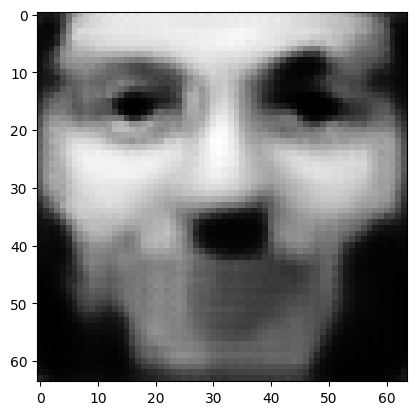

tensor([[4.1842e-07, 2.2922e-06, 9.7391e-01, 5.9658e-04, 5.4659e-06, 9.7027e-07,
         6.3148e-04, 7.5392e-05, 2.3390e-03, 7.1378e-04, 5.3274e-04, 3.7504e-05,
         2.4090e-04, 3.0237e-04, 1.7041e-05, 8.8721e-05, 5.0234e-04, 5.4193e-07,
         1.2105e-04, 2.2070e-04, 4.4528e-03, 2.2468e-03, 6.7868e-05, 2.4264e-05,
         4.9588e-04, 2.0265e-05, 3.4793e-04, 1.3891e-03, 2.8071e-03, 1.9456e-04,
         8.9961e-05, 1.2773e-06, 4.6989e-04, 2.0554e-04, 2.3601e-04, 3.1940e-06,
         1.2297e-03, 3.9201e-03, 5.8735e-04, 8.6993e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02643524669110775
tensor([[4.1834e-07, 2.2918e-06, 9.7392e-01, 5.9650e-04, 5.4648e-06, 9.7014e-07,
         6.3139e-04, 7.5385e-05, 2.3386e-03, 7.1370e-04, 5.3267e-04, 3.7496e-05,
         2.4085e-04, 3.0232e-04, 1.7038e-05, 8.8709e-05, 5.0227e-04, 5.4179e-07,
         1.2103e-04, 2.2067e-04, 4.4521e-03, 2.2465e-03, 6.7855e-05, 2.4260e-05,
         4.9580e-04, 2.0262e-05, 3.4788e-0

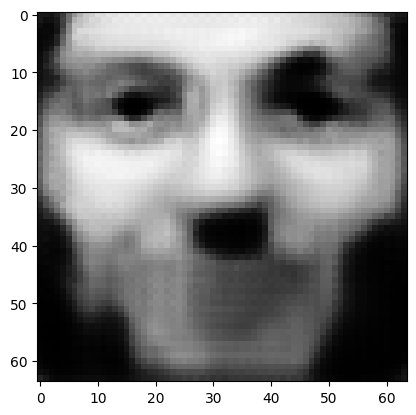

tensor([[4.1803e-07, 2.2900e-06, 9.7393e-01, 5.9617e-04, 5.4606e-06, 9.6965e-07,
         6.3104e-04, 7.5360e-05, 2.3371e-03, 7.1338e-04, 5.3237e-04, 3.7467e-05,
         2.4068e-04, 3.0214e-04, 1.7023e-05, 8.8665e-05, 5.0196e-04, 5.4125e-07,
         1.2097e-04, 2.2057e-04, 4.4495e-03, 2.2453e-03, 6.7802e-05, 2.4241e-05,
         4.9546e-04, 2.0250e-05, 3.4768e-04, 1.3882e-03, 2.8052e-03, 1.9440e-04,
         8.9875e-05, 1.2761e-06, 4.6953e-04, 2.0538e-04, 2.3580e-04, 3.1910e-06,
         1.2289e-03, 3.9171e-03, 5.8684e-04, 8.6931e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026415742933750153
tensor([[4.1796e-07, 2.2896e-06, 9.7393e-01, 5.9609e-04, 5.4596e-06, 9.6953e-07,
         6.3096e-04, 7.5354e-05, 2.3367e-03, 7.1330e-04, 5.3229e-04, 3.7460e-05,
         2.4064e-04, 3.0209e-04, 1.7020e-05, 8.8654e-05, 5.0189e-04, 5.4112e-07,
         1.2095e-04, 2.2054e-04, 4.4489e-03, 2.2451e-03, 6.7790e-05, 2.4236e-05,
         4.9538e-04, 2.0247e-05, 3.4763e-

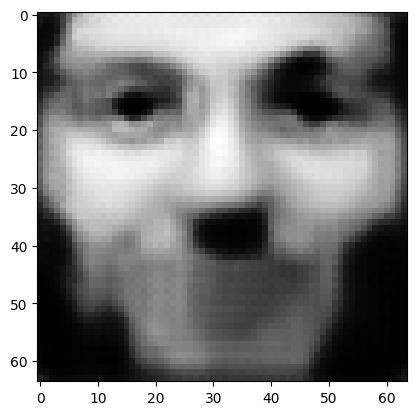

tensor([[4.1766e-07, 2.2880e-06, 9.7395e-01, 5.9578e-04, 5.4556e-06, 9.6906e-07,
         6.3062e-04, 7.5330e-05, 2.3353e-03, 7.1300e-04, 5.3201e-04, 3.7433e-05,
         2.4048e-04, 3.0191e-04, 1.7006e-05, 8.8612e-05, 5.0160e-04, 5.4061e-07,
         1.2089e-04, 2.2044e-04, 4.4464e-03, 2.2440e-03, 6.7740e-05, 2.4218e-05,
         4.9506e-04, 2.0236e-05, 3.4744e-04, 1.3872e-03, 2.8035e-03, 1.9426e-04,
         8.9793e-05, 1.2748e-06, 4.6919e-04, 2.0522e-04, 2.3561e-04, 3.1880e-06,
         1.2281e-03, 3.9142e-03, 5.8635e-04, 8.6873e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02639704942703247
tensor([[4.1759e-07, 2.2876e-06, 9.7395e-01, 5.9571e-04, 5.4546e-06, 9.6894e-07,
         6.3054e-04, 7.5324e-05, 2.3349e-03, 7.1292e-04, 5.3194e-04, 3.7426e-05,
         2.4044e-04, 3.0187e-04, 1.7003e-05, 8.8602e-05, 5.0153e-04, 5.4048e-07,
         1.2087e-04, 2.2041e-04, 4.4457e-03, 2.2437e-03, 6.7728e-05, 2.4214e-05,
         4.9498e-04, 2.0233e-05, 3.4740e-0

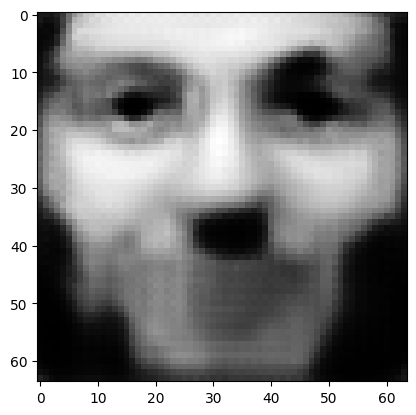

tensor([[4.1731e-07, 2.2860e-06, 9.7397e-01, 5.9541e-04, 5.4508e-06, 9.6850e-07,
         6.3023e-04, 7.5301e-05, 2.3336e-03, 7.1264e-04, 5.3167e-04, 3.7400e-05,
         2.4029e-04, 3.0170e-04, 1.6990e-05, 8.8562e-05, 5.0126e-04, 5.4000e-07,
         1.2081e-04, 2.2032e-04, 4.4434e-03, 2.2427e-03, 6.7681e-05, 2.4197e-05,
         4.9468e-04, 2.0222e-05, 3.4722e-04, 1.3864e-03, 2.8018e-03, 1.9412e-04,
         8.9716e-05, 1.2737e-06, 4.6887e-04, 2.0508e-04, 2.3542e-04, 3.1853e-06,
         1.2273e-03, 3.9115e-03, 5.8589e-04, 8.6817e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02637951821088791
tensor([[4.1725e-07, 2.2856e-06, 9.7397e-01, 5.9534e-04, 5.4499e-06, 9.6839e-07,
         6.3015e-04, 7.5295e-05, 2.3332e-03, 7.1256e-04, 5.3160e-04, 3.7393e-05,
         2.4025e-04, 3.0166e-04, 1.6987e-05, 8.8552e-05, 5.0119e-04, 5.3988e-07,
         1.2080e-04, 2.2029e-04, 4.4428e-03, 2.2424e-03, 6.7669e-05, 2.4193e-05,
         4.9460e-04, 2.0219e-05, 3.4718e-0

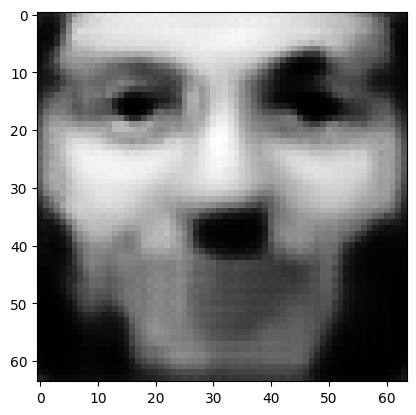

tensor([[4.1698e-07, 2.2842e-06, 9.7398e-01, 5.9506e-04, 5.4463e-06, 9.6797e-07,
         6.2985e-04, 7.5274e-05, 2.3319e-03, 7.1229e-04, 5.3135e-04, 3.7368e-05,
         2.4010e-04, 3.0150e-04, 1.6974e-05, 8.8514e-05, 5.0093e-04, 5.3942e-07,
         1.2074e-04, 2.2020e-04, 4.4405e-03, 2.2414e-03, 6.7625e-05, 2.4177e-05,
         4.9431e-04, 2.0209e-05, 3.4701e-04, 1.3855e-03, 2.8003e-03, 1.9399e-04,
         8.9642e-05, 1.2726e-06, 4.6856e-04, 2.0494e-04, 2.3525e-04, 3.1826e-06,
         1.2266e-03, 3.9089e-03, 5.8545e-04, 8.6764e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026362799108028412
tensor([[4.1691e-07, 2.2838e-06, 9.7398e-01, 5.9499e-04, 5.4454e-06, 9.6786e-07,
         6.2978e-04, 7.5268e-05, 2.3316e-03, 7.1223e-04, 5.3128e-04, 3.7362e-05,
         2.4007e-04, 3.0146e-04, 1.6972e-05, 8.8505e-05, 5.0086e-04, 5.3931e-07,
         1.2073e-04, 2.2018e-04, 4.4400e-03, 2.2412e-03, 6.7614e-05, 2.4173e-05,
         4.9424e-04, 2.0207e-05, 3.4697e-

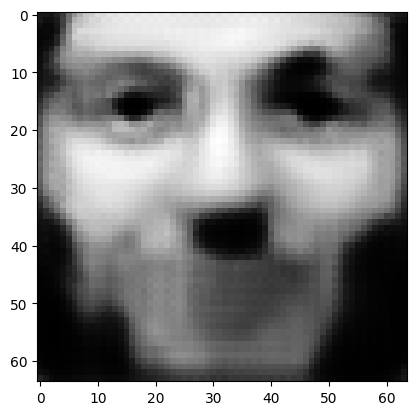

tensor([[4.1666e-07, 2.2824e-06, 9.7400e-01, 5.9473e-04, 5.4420e-06, 9.6746e-07,
         6.2949e-04, 7.5248e-05, 2.3303e-03, 7.1197e-04, 5.3104e-04, 3.7339e-05,
         2.3993e-04, 3.0131e-04, 1.6960e-05, 8.8469e-05, 5.0062e-04, 5.3887e-07,
         1.2068e-04, 2.2009e-04, 4.4378e-03, 2.2403e-03, 6.7572e-05, 2.4157e-05,
         4.9397e-04, 2.0197e-05, 3.4681e-04, 1.3847e-03, 2.7988e-03, 1.9387e-04,
         8.9572e-05, 1.2716e-06, 4.6826e-04, 2.0481e-04, 2.3508e-04, 3.1801e-06,
         1.2259e-03, 3.9064e-03, 5.8503e-04, 8.6713e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02634689211845398
tensor([[4.1660e-07, 2.2821e-06, 9.7400e-01, 5.9466e-04, 5.4412e-06, 9.6736e-07,
         6.2942e-04, 7.5243e-05, 2.3300e-03, 7.1190e-04, 5.3098e-04, 3.7333e-05,
         2.3990e-04, 3.0128e-04, 1.6957e-05, 8.8460e-05, 5.0056e-04, 5.3876e-07,
         1.2066e-04, 2.2007e-04, 4.4373e-03, 2.2401e-03, 6.7561e-05, 2.4154e-05,
         4.9390e-04, 2.0195e-05, 3.4677e-0

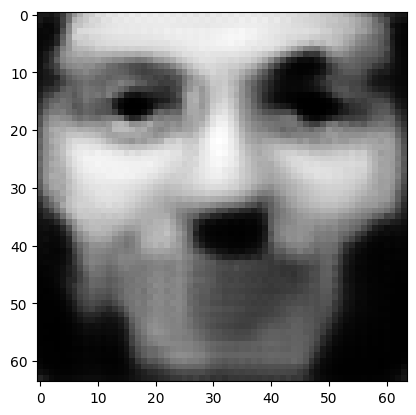

tensor([[4.1636e-07, 2.2807e-06, 9.7401e-01, 5.9441e-04, 5.4380e-06, 9.6698e-07,
         6.2915e-04, 7.5223e-05, 2.3289e-03, 7.1166e-04, 5.3075e-04, 3.7311e-05,
         2.3976e-04, 3.0113e-04, 1.6946e-05, 8.8426e-05, 5.0032e-04, 5.3835e-07,
         1.2061e-04, 2.1999e-04, 4.4353e-03, 2.2392e-03, 6.7521e-05, 2.4139e-05,
         4.9364e-04, 2.0185e-05, 3.4662e-04, 1.3840e-03, 2.7973e-03, 1.9375e-04,
         8.9506e-05, 1.2706e-06, 4.6798e-04, 2.0468e-04, 2.3492e-04, 3.1778e-06,
         1.2253e-03, 3.9041e-03, 5.8463e-04, 8.6665e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02633168175816536
tensor([[4.1630e-07, 2.2804e-06, 9.7401e-01, 5.9435e-04, 5.4372e-06, 9.6689e-07,
         6.2908e-04, 7.5218e-05, 2.3286e-03, 7.1160e-04, 5.3069e-04, 3.7305e-05,
         2.3973e-04, 3.0109e-04, 1.6943e-05, 8.8417e-05, 5.0026e-04, 5.3825e-07,
         1.2060e-04, 2.1997e-04, 4.4348e-03, 2.2390e-03, 6.7511e-05, 2.4136e-05,
         4.9358e-04, 2.0183e-05, 3.4658e-0

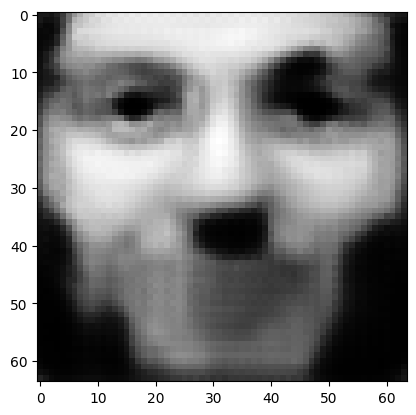

tensor([[4.1608e-07, 2.2791e-06, 9.7403e-01, 5.9411e-04, 5.4341e-06, 9.6652e-07,
         6.2883e-04, 7.5200e-05, 2.3275e-03, 7.1136e-04, 5.3047e-04, 3.7284e-05,
         2.3961e-04, 3.0096e-04, 1.6933e-05, 8.8385e-05, 5.0004e-04, 5.3785e-07,
         1.2055e-04, 2.1989e-04, 4.4328e-03, 2.2381e-03, 6.7473e-05, 2.4122e-05,
         4.9333e-04, 2.0174e-05, 3.4644e-04, 1.3833e-03, 2.7960e-03, 1.9364e-04,
         8.9443e-05, 1.2696e-06, 4.6772e-04, 2.0457e-04, 2.3477e-04, 3.1755e-06,
         1.2247e-03, 3.9019e-03, 5.8425e-04, 8.6620e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026317283511161804
tensor([[4.1602e-07, 2.2788e-06, 9.7403e-01, 5.9405e-04, 5.4333e-06, 9.6643e-07,
         6.2876e-04, 7.5195e-05, 2.3272e-03, 7.1131e-04, 5.3042e-04, 3.7279e-05,
         2.3958e-04, 3.0092e-04, 1.6930e-05, 8.8377e-05, 4.9999e-04, 5.3776e-07,
         1.2054e-04, 2.1987e-04, 4.4324e-03, 2.2379e-03, 6.7464e-05, 2.4118e-05,
         4.9327e-04, 2.0172e-05, 3.4640e-

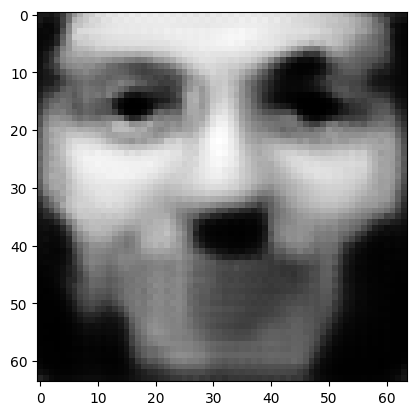

tensor([[4.1581e-07, 2.2776e-06, 9.7404e-01, 5.9382e-04, 5.4304e-06, 9.6609e-07,
         6.2852e-04, 7.5178e-05, 2.3261e-03, 7.1108e-04, 5.3021e-04, 3.7258e-05,
         2.3946e-04, 3.0079e-04, 1.6920e-05, 8.8346e-05, 4.9978e-04, 5.3738e-07,
         1.2049e-04, 2.1980e-04, 4.4305e-03, 2.2371e-03, 6.7427e-05, 2.4105e-05,
         4.9303e-04, 2.0164e-05, 3.4626e-04, 1.3826e-03, 2.7947e-03, 1.9353e-04,
         8.9383e-05, 1.2688e-06, 4.6747e-04, 2.0445e-04, 2.3463e-04, 3.1734e-06,
         1.2241e-03, 3.8998e-03, 5.8389e-04, 8.6577e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026303814724087715
tensor([[4.1575e-07, 2.2773e-06, 9.7404e-01, 5.9377e-04, 5.4297e-06, 9.6601e-07,
         6.2846e-04, 7.5173e-05, 2.3259e-03, 7.1103e-04, 5.3016e-04, 3.7253e-05,
         2.3943e-04, 3.0076e-04, 1.6918e-05, 8.8338e-05, 4.9973e-04, 5.3729e-07,
         1.2048e-04, 2.1978e-04, 4.4301e-03, 2.2369e-03, 6.7418e-05, 2.4102e-05,
         4.9298e-04, 2.0162e-05, 3.4623e-

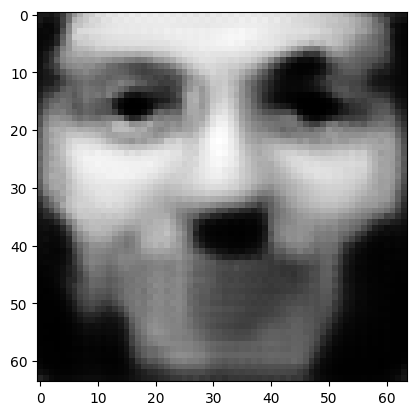

tensor([[4.1555e-07, 2.2762e-06, 9.7405e-01, 5.9355e-04, 5.4269e-06, 9.6568e-07,
         6.2823e-04, 7.5156e-05, 2.3248e-03, 7.1082e-04, 5.2996e-04, 3.7234e-05,
         2.3932e-04, 3.0064e-04, 1.6908e-05, 8.8309e-05, 4.9952e-04, 5.3694e-07,
         1.2044e-04, 2.1971e-04, 4.4283e-03, 2.2362e-03, 6.7384e-05, 2.4090e-05,
         4.9275e-04, 2.0154e-05, 3.4610e-04, 1.3820e-03, 2.7935e-03, 1.9343e-04,
         8.9326e-05, 1.2679e-06, 4.6723e-04, 2.0435e-04, 2.3450e-04, 3.1713e-06,
         1.2235e-03, 3.8977e-03, 5.8355e-04, 8.6536e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026290692389011383
tensor([[4.1550e-07, 2.2759e-06, 9.7405e-01, 5.9350e-04, 5.4262e-06, 9.6560e-07,
         6.2817e-04, 7.5152e-05, 2.3246e-03, 7.1077e-04, 5.2991e-04, 3.7229e-05,
         2.3929e-04, 3.0061e-04, 1.6906e-05, 8.8302e-05, 4.9947e-04, 5.3685e-07,
         1.2043e-04, 2.1969e-04, 4.4279e-03, 2.2360e-03, 6.7375e-05, 2.4087e-05,
         4.9270e-04, 2.0152e-05, 3.4607e-

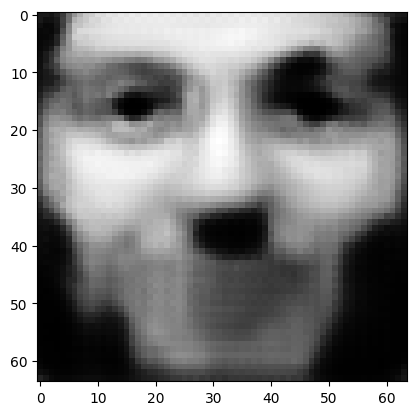

tensor([[4.1530e-07, 2.2748e-06, 9.7406e-01, 5.9329e-04, 5.4236e-06, 9.6529e-07,
         6.2795e-04, 7.5136e-05, 2.3236e-03, 7.1057e-04, 5.2972e-04, 3.7211e-05,
         2.3918e-04, 3.0049e-04, 1.6897e-05, 8.8274e-05, 4.9928e-04, 5.3651e-07,
         1.2039e-04, 2.1962e-04, 4.4262e-03, 2.2353e-03, 6.7342e-05, 2.4075e-05,
         4.9249e-04, 2.0144e-05, 3.4594e-04, 1.3814e-03, 2.7924e-03, 1.9333e-04,
         8.9272e-05, 1.2671e-06, 4.6701e-04, 2.0424e-04, 2.3437e-04, 3.1694e-06,
         1.2230e-03, 3.8958e-03, 5.8323e-04, 8.6497e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026278384029865265
tensor([[4.1526e-07, 2.2746e-06, 9.7407e-01, 5.9324e-04, 5.4230e-06, 9.6522e-07,
         6.2790e-04, 7.5133e-05, 2.3234e-03, 7.1052e-04, 5.2968e-04, 3.7207e-05,
         2.3916e-04, 3.0046e-04, 1.6895e-05, 8.8267e-05, 4.9924e-04, 5.3643e-07,
         1.2038e-04, 2.1960e-04, 4.4258e-03, 2.2351e-03, 6.7335e-05, 2.4072e-05,
         4.9244e-04, 2.0143e-05, 3.4591e-

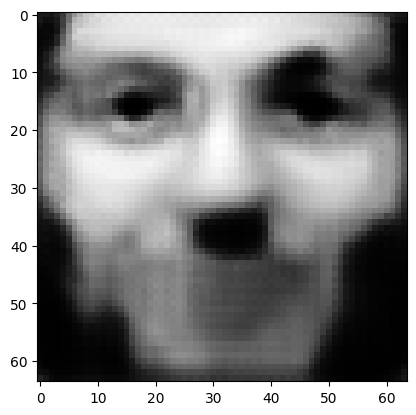

tensor([[4.1507e-07, 2.2735e-06, 9.7408e-01, 5.9305e-04, 5.4205e-06, 9.6492e-07,
         6.2769e-04, 7.5117e-05, 2.3225e-03, 7.1033e-04, 5.2950e-04, 3.7189e-05,
         2.3905e-04, 3.0035e-04, 1.6886e-05, 8.8241e-05, 4.9906e-04, 5.3611e-07,
         1.2034e-04, 2.1954e-04, 4.4243e-03, 2.2344e-03, 6.7303e-05, 2.4061e-05,
         4.9223e-04, 2.0135e-05, 3.4580e-04, 1.3808e-03, 2.7913e-03, 1.9324e-04,
         8.9221e-05, 1.2664e-06, 4.6679e-04, 2.0415e-04, 2.3425e-04, 3.1676e-06,
         1.2225e-03, 3.8940e-03, 5.8292e-04, 8.6460e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02626677230000496
tensor([[4.1503e-07, 2.2733e-06, 9.7408e-01, 5.9300e-04, 5.4199e-06, 9.6485e-07,
         6.2764e-04, 7.5114e-05, 2.3223e-03, 7.1028e-04, 5.2946e-04, 3.7185e-05,
         2.3903e-04, 3.0032e-04, 1.6884e-05, 8.8234e-05, 4.9901e-04, 5.3603e-07,
         1.2033e-04, 2.1952e-04, 4.4239e-03, 2.2342e-03, 6.7296e-05, 2.4058e-05,
         4.9219e-04, 2.0134e-05, 3.4577e-0

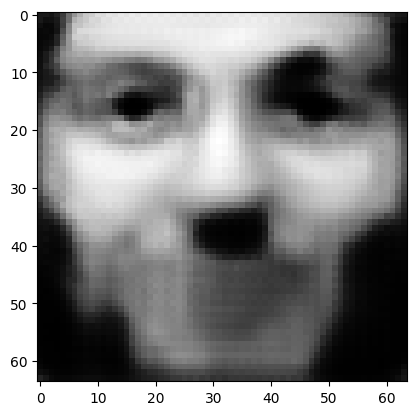

tensor([[4.1485e-07, 2.2723e-06, 9.7409e-01, 5.9281e-04, 5.4175e-06, 9.6457e-07,
         6.2744e-04, 7.5099e-05, 2.3214e-03, 7.1010e-04, 5.2929e-04, 3.7169e-05,
         2.3893e-04, 3.0022e-04, 1.6876e-05, 8.8209e-05, 4.9884e-04, 5.3573e-07,
         1.2029e-04, 2.1946e-04, 4.4224e-03, 2.2336e-03, 6.7266e-05, 2.4047e-05,
         4.9200e-04, 2.0127e-05, 3.4566e-04, 1.3802e-03, 2.7902e-03, 1.9315e-04,
         8.9172e-05, 1.2656e-06, 4.6659e-04, 2.0406e-04, 2.3413e-04, 3.1658e-06,
         1.2220e-03, 3.8923e-03, 5.8263e-04, 8.6425e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02625562623143196
tensor([[4.1481e-07, 2.2721e-06, 9.7409e-01, 5.9277e-04, 5.4169e-06, 9.6450e-07,
         6.2739e-04, 7.5096e-05, 2.3212e-03, 7.1006e-04, 5.2924e-04, 3.7165e-05,
         2.3891e-04, 3.0019e-04, 1.6874e-05, 8.8203e-05, 4.9880e-04, 5.3566e-07,
         1.2028e-04, 2.1945e-04, 4.4220e-03, 2.2334e-03, 6.7259e-05, 2.4045e-05,
         4.9195e-04, 2.0125e-05, 3.4563e-0

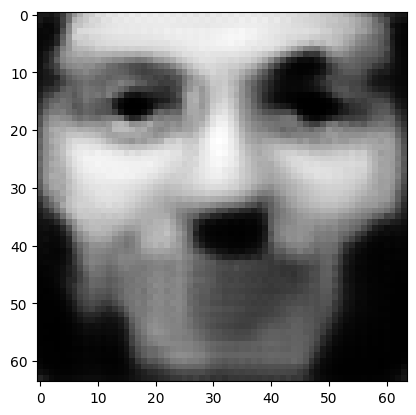

tensor([[4.1464e-07, 2.2711e-06, 9.7410e-01, 5.9259e-04, 5.4146e-06, 9.6423e-07,
         6.2720e-04, 7.5082e-05, 2.3204e-03, 7.0988e-04, 5.2908e-04, 3.7149e-05,
         2.3882e-04, 3.0009e-04, 1.6866e-05, 8.8179e-05, 4.9863e-04, 5.3537e-07,
         1.2024e-04, 2.1939e-04, 4.4206e-03, 2.2328e-03, 6.7231e-05, 2.4034e-05,
         4.9177e-04, 2.0119e-05, 3.4552e-04, 1.3797e-03, 2.7892e-03, 1.9307e-04,
         8.9125e-05, 1.2649e-06, 4.6639e-04, 2.0397e-04, 2.3402e-04, 3.1642e-06,
         1.2216e-03, 3.8907e-03, 5.8235e-04, 8.6392e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026245174929499626
tensor([[4.1460e-07, 2.2709e-06, 9.7410e-01, 5.9255e-04, 5.4141e-06, 9.6417e-07,
         6.2716e-04, 7.5079e-05, 2.3202e-03, 7.0984e-04, 5.2904e-04, 3.7145e-05,
         2.3879e-04, 3.0007e-04, 1.6864e-05, 8.8173e-05, 4.9860e-04, 5.3530e-07,
         1.2024e-04, 2.1938e-04, 4.4202e-03, 2.2327e-03, 6.7224e-05, 2.4032e-05,
         4.9172e-04, 2.0117e-05, 3.4550e-

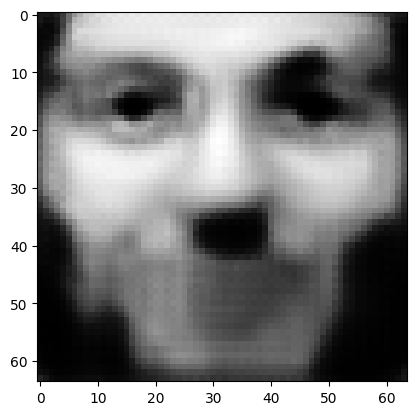

tensor([[4.1444e-07, 2.2700e-06, 9.7411e-01, 5.9238e-04, 5.4120e-06, 9.6391e-07,
         6.2698e-04, 7.5066e-05, 2.3194e-03, 7.0968e-04, 5.2889e-04, 3.7130e-05,
         2.3871e-04, 2.9997e-04, 1.6857e-05, 8.8150e-05, 4.9844e-04, 5.3502e-07,
         1.2020e-04, 2.1932e-04, 4.4189e-03, 2.2321e-03, 6.7198e-05, 2.4022e-05,
         4.9155e-04, 2.0111e-05, 3.4540e-04, 1.3792e-03, 2.7883e-03, 1.9299e-04,
         8.9081e-05, 1.2643e-06, 4.6621e-04, 2.0389e-04, 2.3392e-04, 3.1626e-06,
         1.2211e-03, 3.8891e-03, 5.8209e-04, 8.6360e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026235071942210197
tensor([[4.1440e-07, 2.2698e-06, 9.7411e-01, 5.9234e-04, 5.4114e-06, 9.6385e-07,
         6.2693e-04, 7.5063e-05, 2.3192e-03, 7.0964e-04, 5.2885e-04, 3.7127e-05,
         2.3869e-04, 2.9995e-04, 1.6855e-05, 8.8145e-05, 4.9840e-04, 5.3495e-07,
         1.2019e-04, 2.1931e-04, 4.4186e-03, 2.2319e-03, 6.7191e-05, 2.4020e-05,
         4.9151e-04, 2.0110e-05, 3.4537e-

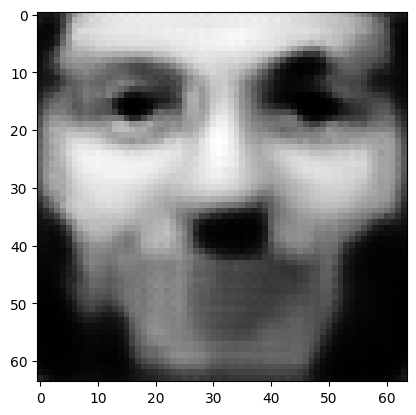

tensor([[4.1425e-07, 2.2690e-06, 9.7412e-01, 5.9218e-04, 5.4094e-06, 9.6361e-07,
         6.2676e-04, 7.5050e-05, 2.3185e-03, 7.0948e-04, 5.2871e-04, 3.7113e-05,
         2.3860e-04, 2.9986e-04, 1.6848e-05, 8.8123e-05, 4.9825e-04, 5.3469e-07,
         1.2016e-04, 2.1926e-04, 4.4173e-03, 2.2314e-03, 6.7166e-05, 2.4011e-05,
         4.9134e-04, 2.0104e-05, 3.4527e-04, 1.3787e-03, 2.7874e-03, 1.9292e-04,
         8.9040e-05, 1.2637e-06, 4.6603e-04, 2.0381e-04, 2.3382e-04, 3.1611e-06,
         1.2207e-03, 3.8876e-03, 5.8184e-04, 8.6330e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02622566558420658
tensor([[4.1422e-07, 2.2688e-06, 9.7412e-01, 5.9214e-04, 5.4089e-06, 9.6355e-07,
         6.2672e-04, 7.5047e-05, 2.3183e-03, 7.0945e-04, 5.2867e-04, 3.7109e-05,
         2.3858e-04, 2.9984e-04, 1.6847e-05, 8.8118e-05, 4.9822e-04, 5.3463e-07,
         1.2015e-04, 2.1924e-04, 4.4170e-03, 2.2312e-03, 6.7159e-05, 2.4009e-05,
         4.9130e-04, 2.0102e-05, 3.4525e-0

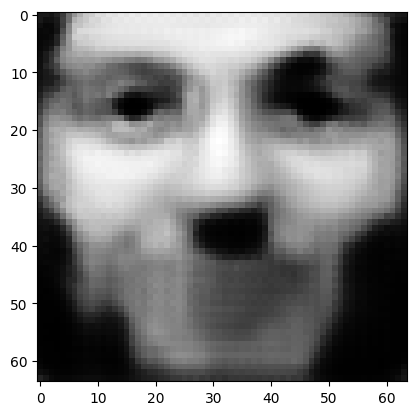

tensor([[4.1407e-07, 2.2680e-06, 9.7412e-01, 5.9199e-04, 5.4069e-06, 9.6332e-07,
         6.2656e-04, 7.5035e-05, 2.3176e-03, 7.0930e-04, 5.2853e-04, 3.7096e-05,
         2.3850e-04, 2.9975e-04, 1.6840e-05, 8.8097e-05, 4.9808e-04, 5.3438e-07,
         1.2012e-04, 2.1919e-04, 4.4157e-03, 2.2307e-03, 6.7135e-05, 2.4000e-05,
         4.9115e-04, 2.0097e-05, 3.4516e-04, 1.3783e-03, 2.7865e-03, 1.9285e-04,
         8.9000e-05, 1.2631e-06, 4.6586e-04, 2.0373e-04, 2.3372e-04, 3.1597e-06,
         1.2203e-03, 3.8862e-03, 5.8160e-04, 8.6301e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02621660940349102
tensor([[4.1404e-07, 2.2678e-06, 9.7413e-01, 5.9195e-04, 5.4065e-06, 9.6327e-07,
         6.2652e-04, 7.5032e-05, 2.3174e-03, 7.0926e-04, 5.2850e-04, 3.7093e-05,
         2.3849e-04, 2.9973e-04, 1.6838e-05, 8.8092e-05, 4.9804e-04, 5.3432e-07,
         1.2012e-04, 2.1918e-04, 4.4154e-03, 2.2306e-03, 6.7129e-05, 2.3998e-05,
         4.9111e-04, 2.0095e-05, 3.4514e-0

In [139]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=2)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.964919567108154


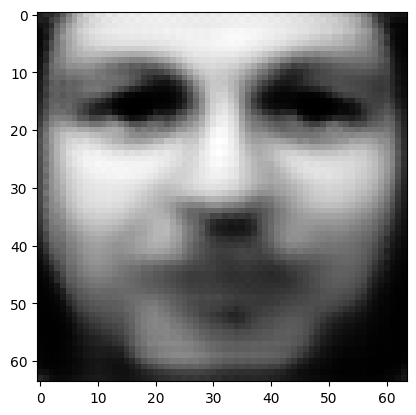

tensor([[1.3871e-04, 4.2232e-04, 2.9444e-02, 1.8133e-02, 2.0426e-03, 1.4587e-05,
         2.8301e-02, 2.5216e-04, 1.6127e-01, 9.5268e-03, 7.4591e-03, 1.1718e-02,
         2.3959e-02, 5.2646e-03, 7.0815e-03, 7.9140e-04, 2.1272e-02, 9.9799e-04,
         4.2993e-03, 2.4701e-03, 1.2635e-01, 4.0232e-02, 1.5636e-02, 1.1965e-02,
         6.3414e-02, 1.3608e-03, 6.6355e-03, 4.3643e-02, 4.2319e-02, 7.2400e-03,
         2.3575e-02, 4.3847e-04, 2.1819e-02, 6.1231e-03, 3.2810e-02, 9.2660e-04,
         2.5769e-02, 9.4529e-02, 6.8178e-02, 3.2178e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.010024547576904
tensor([[8.7890e-05, 6.0989e-04, 3.4582e-02, 6.0628e-02, 1.1713e-03, 1.2597e-05,
         2.6438e-02, 1.9940e-04, 1.2229e-01, 5.5691e-03, 8.1452e-03, 8.6020e-03,
         2.0876e-02, 6.0711e-03, 1.0030e-02, 6.8949e-04, 1.6568e-02, 8.9070e-04,
         6.1200e-03, 3.3332e-03, 1.8474e-01, 4.4561e-02, 1.4212e-02, 1.1951e-02,
         3.6253e-02, 1.7081e-03, 8.8698e-03,

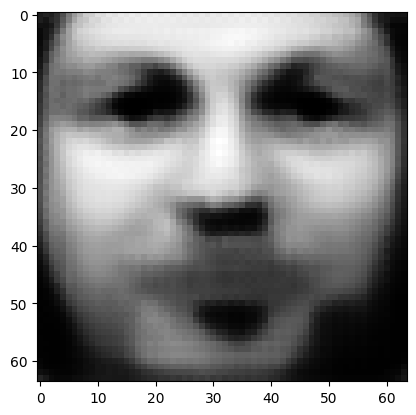

tensor([[1.3986e-05, 5.1371e-04, 2.2455e-02, 5.3027e-01, 2.1237e-04, 5.7533e-06,
         1.3095e-02, 5.6049e-05, 3.5653e-02, 8.8295e-04, 4.1379e-03, 1.5832e-03,
         7.7845e-03, 3.0040e-03, 8.9646e-03, 1.9381e-04, 4.3117e-03, 2.8515e-04,
         5.0941e-03, 3.7159e-03, 1.4634e-01, 3.1198e-02, 6.9043e-03, 4.6552e-03,
         3.8439e-03, 1.5035e-03, 5.9039e-03, 2.6542e-02, 2.3568e-02, 5.6534e-04,
         3.1978e-03, 3.9610e-04, 7.1427e-03, 5.8760e-03, 1.5560e-03, 1.6480e-04,
         2.1383e-02, 3.6994e-02, 2.7523e-02, 2.5094e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6343727707862854
tensor([[1.0335e-05, 4.4399e-04, 1.8922e-02, 6.1123e-01, 1.5811e-04, 4.8148e-06,
         1.1215e-02, 4.4342e-05, 2.8253e-02, 6.6079e-04, 3.4109e-03, 1.1557e-03,
         6.2988e-03, 2.4164e-03, 7.7745e-03, 1.4996e-04, 3.3103e-03, 2.2080e-04,
         4.4595e-03, 3.3593e-03, 1.2159e-01, 2.7064e-02, 5.7921e-03, 3.7668e-03,
         2.7109e-03, 1.3286e-03, 4.9793e-03

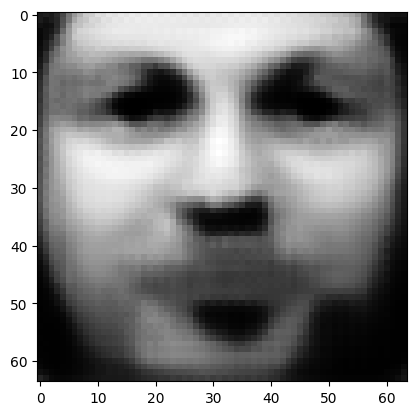

tensor([[4.3026e-06, 2.7203e-04, 1.0872e-02, 7.8544e-01, 6.5501e-05, 2.7554e-06,
         6.7856e-03, 2.1705e-05, 1.3975e-02, 2.7809e-04, 1.8408e-03, 4.5531e-04,
         3.2561e-03, 1.2342e-03, 4.7301e-03, 6.8352e-05, 1.5099e-03, 1.0244e-04,
         2.7992e-03, 2.3043e-03, 6.6756e-02, 1.6764e-02, 3.3089e-03, 1.9253e-03,
         9.9192e-04, 8.6353e-04, 2.8271e-03, 1.3512e-02, 1.0605e-02, 1.4219e-04,
         9.4021e-04, 1.9046e-04, 3.1196e-03, 2.8410e-03, 3.8087e-04, 6.1744e-05,
         1.0918e-02, 1.5591e-02, 1.1568e-02, 6.7903e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2415170520544052
tensor([[3.6711e-06, 2.4743e-04, 9.7749e-03, 8.0826e-01, 5.5868e-05, 2.4794e-06,
         6.1571e-03, 1.8989e-05, 1.2248e-02, 2.3698e-04, 1.6346e-03, 3.8384e-04,
         2.8816e-03, 1.0894e-03, 4.2907e-03, 5.9120e-05, 1.3060e-03, 8.8904e-05,
         2.5517e-03, 2.1342e-03, 5.9549e-02, 1.5264e-02, 2.9685e-03, 1.6963e-03,
         8.2691e-04, 7.9220e-04, 2.5318e-03

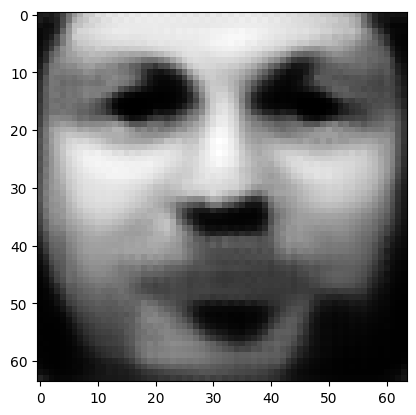

tensor([[2.2423e-06, 1.8339e-04, 6.9344e-03, 8.6528e-01, 3.3983e-05, 1.7664e-06,
         4.4904e-03, 1.2428e-05, 8.0630e-03, 1.4280e-04, 1.1177e-03, 2.2687e-04,
         1.9707e-03, 7.3815e-04, 3.1404e-03, 3.7613e-05, 8.3160e-04, 5.7142e-05,
         1.8888e-03, 1.6688e-03, 4.1958e-02, 1.1245e-02, 2.0848e-03, 1.1456e-03,
         4.6737e-04, 6.0155e-04, 1.7860e-03, 8.8293e-03, 6.5381e-03, 6.6385e-05,
         4.7785e-04, 1.2138e-04, 1.9136e-03, 1.8280e-03, 1.7646e-04, 3.5063e-05,
         7.1936e-03, 9.3914e-03, 6.9884e-03, 3.2772e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14469990134239197
tensor([[2.0389e-06, 1.7268e-04, 6.4734e-03, 8.7442e-01, 3.0819e-05, 1.6513e-06,
         4.2244e-03, 1.1444e-05, 7.4283e-03, 1.2947e-04, 1.0360e-03, 2.0477e-04,
         1.8296e-03, 6.8262e-04, 2.9464e-03, 3.4461e-05, 7.6163e-04, 5.2338e-05,
         1.7798e-03, 1.5874e-03, 3.9090e-02, 1.0578e-02, 1.9421e-03, 1.0619e-03,
         4.1842e-04, 5.6922e-04, 1.6673e-0

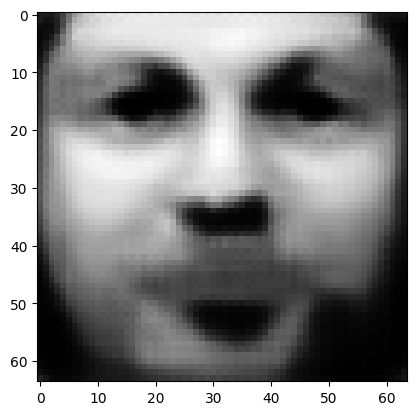

tensor([[1.4856e-06, 1.4083e-04, 5.1673e-03, 9.0053e-01, 2.2390e-05, 1.3251e-06,
         3.4438e-03, 8.6886e-06, 5.6616e-03, 9.3397e-05, 8.0401e-04, 1.4604e-04,
         1.4363e-03, 5.2897e-04, 2.3786e-03, 2.5777e-05, 5.6977e-04, 3.9229e-05,
         1.4509e-03, 1.3408e-03, 3.0948e-02, 8.6076e-03, 1.5386e-03, 8.2238e-04,
         2.9002e-04, 4.7475e-04, 1.3260e-03, 6.7070e-03, 4.7562e-03, 4.0602e-05,
         3.1053e-04, 9.0440e-05, 1.3891e-03, 1.3622e-03, 1.0802e-04, 2.4255e-05,
         5.4584e-03, 6.7147e-03, 5.0375e-03, 2.0580e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1047755628824234
tensor([[1.3908e-06, 1.3482e-04, 4.9257e-03, 9.0530e-01, 2.0944e-05, 1.2654e-06,
         3.3002e-03, 8.2034e-06, 5.3494e-03, 8.7272e-05, 7.6198e-04, 1.3613e-04,
         1.3655e-03, 5.0107e-04, 2.2730e-03, 2.4251e-05, 5.3605e-04, 3.6925e-05,
         1.3894e-03, 1.2932e-03, 2.9452e-02, 8.2378e-03, 1.4660e-03, 7.7963e-04,
         2.6876e-04, 4.5722e-04, 1.2636e-03

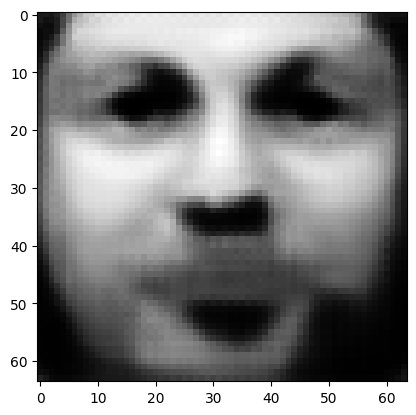

tensor([[1.1070e-06, 1.1589e-04, 4.1893e-03, 9.1998e-01, 1.6689e-05, 1.0819e-06,
         2.8573e-03, 6.7338e-06, 4.4100e-03, 6.9250e-05, 6.3455e-04, 1.0690e-04,
         1.1517e-03, 4.1589e-04, 1.9443e-03, 1.9725e-05, 4.3525e-04, 3.0019e-05,
         1.1973e-03, 1.1440e-03, 2.4825e-02, 7.0879e-03, 1.2417e-03, 6.4925e-04,
         2.0727e-04, 4.0129e-04, 1.0722e-03, 5.5203e-03, 3.7809e-03, 2.8594e-05,
         2.2862e-04, 7.3179e-05, 1.1046e-03, 1.0998e-03, 7.6204e-05, 1.8655e-05,
         4.4675e-03, 5.2648e-03, 3.9797e-03, 1.4813e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08340593427419662
tensor([[1.0545e-06, 1.1213e-04, 4.0429e-03, 9.2286e-01, 1.5889e-05, 1.0455e-06,
         2.7714e-03, 6.4548e-06, 4.2299e-03, 6.5927e-05, 6.0962e-04, 1.0148e-04,
         1.1098e-03, 3.9902e-04, 1.8785e-03, 1.8870e-05, 4.1614e-04, 2.8695e-05,
         1.1600e-03, 1.1137e-03, 2.3910e-02, 6.8613e-03, 1.1974e-03, 6.2445e-04,
         1.9606e-04, 3.9001e-04, 1.0343e-0

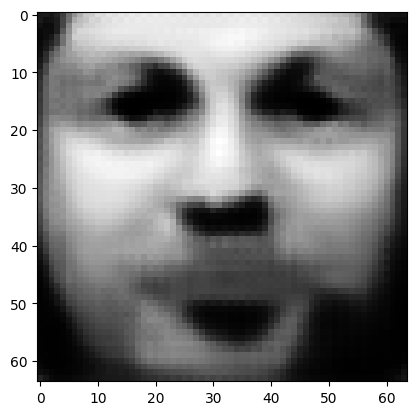

tensor([[8.8136e-07, 9.9401e-05, 3.5575e-03, 9.3245e-01, 1.3346e-05, 9.2368e-07,
         2.4725e-03, 5.5185e-06, 3.6334e-03, 5.5039e-05, 5.2661e-04, 8.4102e-05,
         9.7024e-04, 3.4383e-04, 1.6589e-03, 1.6043e-05, 3.5278e-04, 2.4383e-05,
         1.0322e-03, 1.0123e-03, 2.0918e-02, 6.0940e-03, 1.0496e-03, 5.4060e-04,
         1.5959e-04, 3.5202e-04, 9.0735e-04, 4.7414e-03, 3.1562e-03, 2.1831e-05,
         1.8049e-04, 6.1975e-05, 9.2462e-04, 9.2943e-04, 5.8177e-05, 1.5248e-05,
         3.8126e-03, 4.3478e-03, 3.3077e-03, 1.1522e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0699441209435463
tensor([[8.4692e-07, 9.6772e-05, 3.4563e-03, 9.3442e-01, 1.2839e-05, 8.9837e-07,
         2.4100e-03, 5.3292e-06, 3.5113e-03, 5.2865e-05, 5.0960e-04, 8.0652e-05,
         9.4155e-04, 3.3259e-04, 1.6136e-03, 1.5470e-05, 3.3993e-04, 2.3515e-05,
         1.0057e-03, 9.9067e-04, 2.0302e-02, 5.9341e-03, 1.0191e-03, 5.2349e-04,
         1.5248e-04, 3.4405e-04, 8.8099e-04

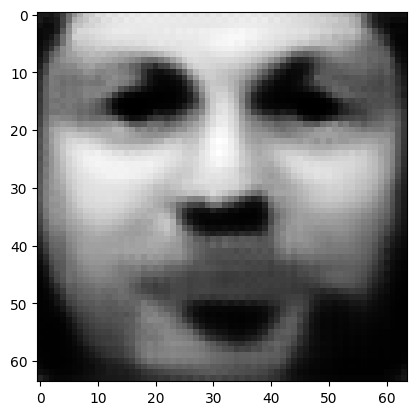

tensor([[7.3364e-07, 8.7796e-05, 3.1161e-03, 9.4107e-01, 1.1177e-05, 8.1313e-07,
         2.1974e-03, 4.6984e-06, 3.1062e-03, 4.5724e-05, 4.5252e-04, 6.9453e-05,
         8.4509e-04, 2.9508e-04, 1.4597e-03, 1.3583e-05, 2.9742e-04, 2.0656e-05,
         9.1529e-04, 9.1672e-04, 1.8241e-02, 5.3883e-03, 9.1635e-04, 4.6639e-04,
         1.2924e-04, 3.1686e-04, 7.9256e-04, 4.1874e-03, 2.7228e-03, 1.7581e-05,
         1.4931e-04, 5.4231e-05, 8.0092e-04, 8.1125e-04, 4.6810e-05, 1.2969e-05,
         3.3508e-03, 3.7242e-03, 2.8478e-03, 9.4224e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060734570026397705
tensor([[7.1033e-07, 8.5881e-05, 3.0442e-03, 9.4248e-01, 1.0831e-05, 7.9502e-07,
         2.1523e-03, 4.5667e-06, 3.0216e-03, 4.4252e-05, 4.4052e-04, 6.7150e-05,
         8.2467e-04, 2.8718e-04, 1.4266e-03, 1.3193e-05, 2.8860e-04, 2.0064e-05,
         8.9609e-04, 9.0082e-04, 1.7804e-02, 5.2717e-03, 8.9434e-04, 4.5442e-04,
         1.2448e-04, 3.1093e-04, 7.7389e-

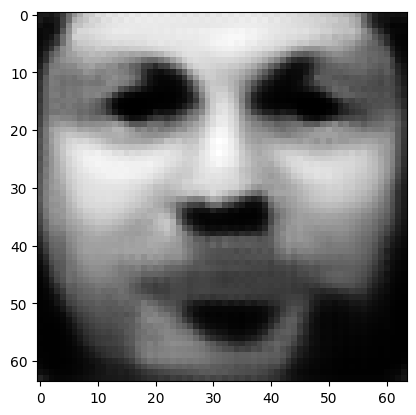

tensor([[6.3184e-07, 7.9244e-05, 2.7947e-03, 9.4734e-01, 9.6641e-06, 7.3246e-07,
         1.9964e-03, 4.1209e-06, 2.7318e-03, 3.9294e-05, 3.9930e-04, 5.9403e-05,
         7.5482e-04, 2.6013e-04, 1.3123e-03, 1.1865e-05, 2.5866e-04, 1.8044e-05,
         8.2936e-04, 8.4459e-04, 1.6291e-02, 4.8676e-03, 8.1878e-04, 4.1357e-04,
         1.0868e-04, 2.9039e-04, 7.0938e-04, 3.7791e-03, 2.4117e-03, 1.4720e-05,
         1.2774e-04, 4.8603e-05, 7.1195e-04, 7.2478e-04, 3.9171e-05, 1.1355e-05,
         3.0110e-03, 3.2787e-03, 2.5179e-03, 7.9875e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05409886687994003
tensor([[6.1507e-07, 7.7789e-05, 2.7405e-03, 9.4839e-01, 9.4150e-06, 7.1884e-07,
         1.9622e-03, 4.0249e-06, 2.6695e-03, 3.8240e-05, 3.9040e-04, 5.7770e-05,
         7.3967e-04, 2.5430e-04, 1.2872e-03, 1.1582e-05, 2.5225e-04, 1.7612e-05,
         8.1477e-04, 8.3221e-04, 1.5964e-02, 4.7788e-03, 8.0234e-04, 4.0475e-04,
         1.0533e-04, 2.8588e-04, 6.9545e-0

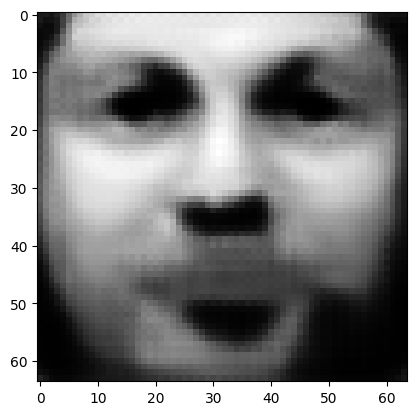

tensor([[5.5778e-07, 7.2675e-05, 2.5483e-03, 9.5211e-01, 8.5518e-06, 6.7074e-07,
         1.8423e-03, 3.6924e-06, 2.4515e-03, 3.4607e-05, 3.5914e-04, 5.2117e-05,
         6.8661e-04, 2.3381e-04, 1.1985e-03, 1.0597e-05, 2.3005e-04, 1.6105e-05,
         7.6337e-04, 7.8767e-04, 1.4803e-02, 4.4663e-03, 7.4426e-04, 3.7405e-04,
         9.3940e-05, 2.6976e-04, 6.4622e-04, 3.4657e-03, 2.1767e-03, 1.2669e-05,
         1.1198e-04, 4.4327e-05, 6.4460e-04, 6.5849e-04, 3.3711e-05, 1.0152e-05,
         2.7499e-03, 2.9432e-03, 2.2692e-03, 6.9509e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04907277598977089
tensor([[5.4507e-07, 7.1535e-05, 2.5056e-03, 9.5293e-01, 8.3636e-06, 6.6003e-07,
         1.8152e-03, 3.6189e-06, 2.4035e-03, 3.3807e-05, 3.5228e-04, 5.0893e-05,
         6.7480e-04, 2.2934e-04, 1.1789e-03, 1.0380e-05, 2.2517e-04, 1.5776e-05,
         7.5182e-04, 7.7773e-04, 1.4549e-02, 4.3962e-03, 7.3144e-04, 3.6723e-04,
         9.1470e-05, 2.6621e-04, 6.3530e-0

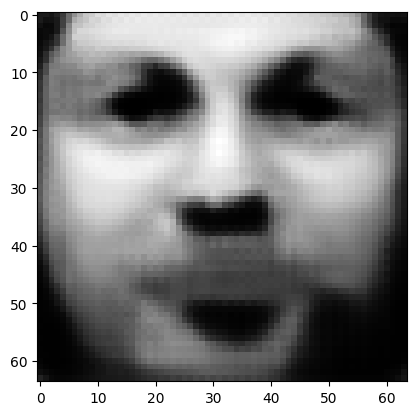

tensor([[5.0067e-07, 6.7451e-05, 2.3498e-03, 9.5590e-01, 7.6865e-06, 6.2085e-07,
         1.7172e-03, 3.3552e-06, 2.2309e-03, 3.0973e-05, 3.2748e-04, 4.6548e-05,
         6.3240e-04, 2.1314e-04, 1.1073e-03, 9.6070e-06, 2.0791e-04, 1.4594e-05,
         7.1040e-04, 7.4151e-04, 1.3630e-02, 4.1437e-03, 6.8439e-04, 3.4302e-04,
         8.2703e-05, 2.5298e-04, 5.9608e-04, 3.2139e-03, 1.9915e-03, 1.1119e-05,
         9.9903e-05, 4.0921e-05, 5.9108e-04, 6.0581e-04, 2.9583e-05, 9.2056e-06,
         2.5415e-03, 2.6789e-03, 2.0742e-03, 6.1609e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0451032817363739
tensor([[4.9081e-07, 6.6533e-05, 2.3145e-03, 9.5656e-01, 7.5359e-06, 6.1195e-07,
         1.6951e-03, 3.2964e-06, 2.1924e-03, 3.0343e-05, 3.2194e-04, 4.5585e-05,
         6.2293e-04, 2.0951e-04, 1.0914e-03, 9.4336e-06, 2.0406e-04, 1.4331e-05,
         7.0108e-04, 7.3327e-04, 1.3424e-02, 4.0867e-03, 6.7382e-04, 3.3764e-04,
         8.0798e-05, 2.4999e-04, 5.8728e-04

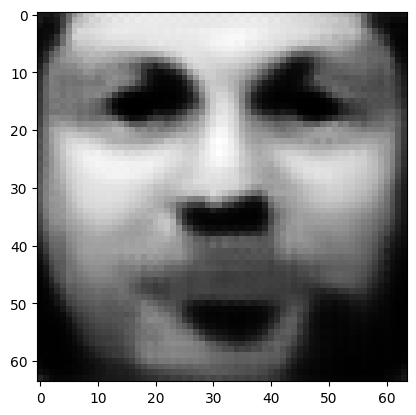

tensor([[4.5545e-07, 6.3184e-05, 2.1859e-03, 9.5898e-01, 6.9962e-06, 5.7961e-07,
         1.6142e-03, 3.0839e-06, 2.0536e-03, 2.8096e-05, 3.0189e-04, 4.2166e-05,
         5.8831e-04, 1.9637e-04, 1.0330e-03, 8.8131e-06, 1.9030e-04, 1.3383e-05,
         6.6718e-04, 7.0326e-04, 1.2678e-02, 3.8794e-03, 6.3550e-04, 3.1820e-04,
         7.3935e-05, 2.3904e-04, 5.5528e-04, 3.0078e-03, 1.8421e-03, 9.9112e-06,
         9.0384e-05, 3.8140e-05, 5.4758e-04, 5.6283e-04, 2.6376e-05, 8.4462e-06,
         2.3714e-03, 2.4646e-03, 1.9174e-03, 5.5402e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041887976229190826
tensor([[4.4757e-07, 6.2427e-05, 2.1568e-03, 9.5952e-01, 6.8744e-06, 5.7223e-07,
         1.5959e-03, 3.0361e-06, 2.0222e-03, 2.7589e-05, 2.9738e-04, 4.1399e-05,
         5.8046e-04, 1.9343e-04, 1.0197e-03, 8.6730e-06, 1.8722e-04, 1.3170e-05,
         6.5947e-04, 6.9631e-04, 1.2509e-02, 3.8323e-03, 6.2674e-04, 3.1380e-04,
         7.2418e-05, 2.3653e-04, 5.4804e-

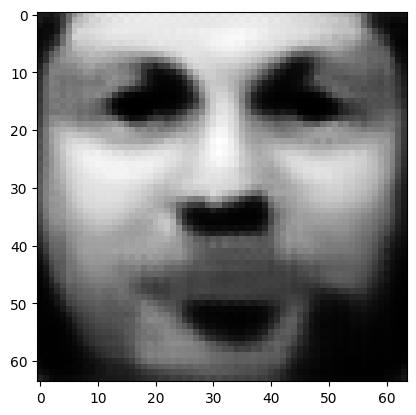

tensor([[4.1916e-07, 5.9646e-05, 2.0507e-03, 9.6152e-01, 6.4365e-06, 5.4551e-07,
         1.5289e-03, 2.8637e-06, 1.9091e-03, 2.5788e-05, 2.8102e-04, 3.8646e-05,
         5.5199e-04, 1.8264e-04, 9.7110e-04, 8.1707e-06, 1.7612e-04, 1.2396e-05,
         6.3132e-04, 6.7102e-04, 1.1889e-02, 3.6608e-03, 5.9514e-04, 2.9785e-04,
         6.6965e-05, 2.2731e-04, 5.2173e-04, 2.8373e-03, 1.7203e-03, 8.9543e-06,
         8.2724e-05, 3.5848e-05, 5.1186e-04, 5.2731e-04, 2.3835e-05, 7.8271e-06,
         2.2309e-03, 2.2900e-03, 1.7889e-03, 5.0433e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03924451768398285
tensor([[4.1268e-07, 5.9012e-05, 2.0266e-03, 9.6197e-01, 6.3378e-06, 5.3941e-07,
         1.5136e-03, 2.8246e-06, 1.8835e-03, 2.5381e-05, 2.7733e-04, 3.8024e-05,
         5.4554e-04, 1.8021e-04, 9.6008e-04, 8.0571e-06, 1.7362e-04, 1.2220e-05,
         6.2484e-04, 6.6516e-04, 1.1748e-02, 3.6216e-03, 5.8798e-04, 2.9421e-04,
         6.5754e-05, 2.2521e-04, 5.1576e-0

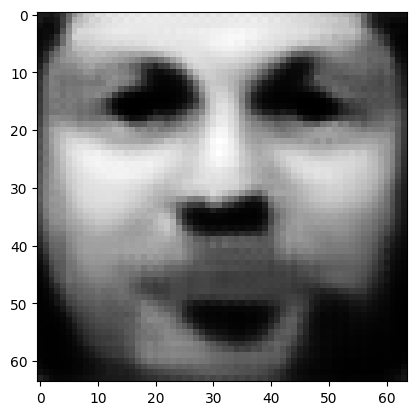

tensor([[3.8931e-07, 5.6654e-05, 1.9384e-03, 9.6364e-01, 5.9736e-06, 5.1707e-07,
         1.4574e-03, 2.6823e-06, 1.7901e-03, 2.3907e-05, 2.6376e-04, 3.5746e-05,
         5.2185e-04, 1.7120e-04, 9.1874e-04, 7.6435e-06, 1.6447e-04, 1.1578e-05,
         6.0091e-04, 6.4365e-04, 1.1223e-02, 3.4771e-03, 5.6139e-04, 2.8081e-04,
         6.1325e-05, 2.1724e-04, 4.9370e-04, 2.6946e-03, 1.6199e-03, 8.1822e-06,
         7.6432e-05, 3.3915e-05, 4.8220e-04, 4.9748e-04, 2.1779e-05, 7.3141e-06,
         2.1130e-03, 2.1457e-03, 1.6817e-03, 4.6392e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037035614252090454
tensor([[3.8403e-07, 5.6109e-05, 1.9181e-03, 9.6403e-01, 5.8914e-06, 5.1200e-07,
         1.4448e-03, 2.6504e-06, 1.7689e-03, 2.3576e-05, 2.6066e-04, 3.5231e-05,
         5.1644e-04, 1.6913e-04, 9.0927e-04, 7.5493e-06, 1.6239e-04, 1.1431e-05,
         5.9543e-04, 6.3857e-04, 1.1100e-02, 3.4440e-03, 5.5544e-04, 2.7777e-04,
         6.0351e-05, 2.1544e-04, 4.8862e-

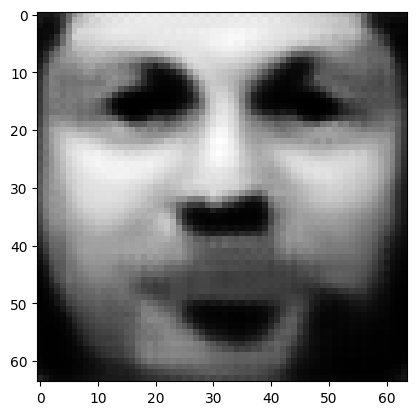

tensor([[3.6446e-07, 5.4083e-05, 1.8433e-03, 9.6545e-01, 5.5867e-06, 4.9301e-07,
         1.3968e-03, 2.5305e-06, 1.6901e-03, 2.2343e-05, 2.4917e-04, 3.3331e-05,
         4.9634e-04, 1.6153e-04, 8.7382e-04, 7.2011e-06, 1.5469e-04, 1.0892e-05,
         5.7484e-04, 6.1982e-04, 1.0652e-02, 3.3199e-03, 5.3288e-04, 2.6636e-04,
         5.6707e-05, 2.0858e-04, 4.6982e-04, 2.5729e-03, 1.5350e-03, 7.5456e-06,
         7.1181e-05, 3.2270e-05, 4.5719e-04, 4.7198e-04, 2.0091e-05, 6.8824e-06,
         2.0123e-03, 2.0245e-03, 1.5907e-03, 4.3058e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035159554332494736
tensor([[3.6004e-07, 5.3613e-05, 1.8262e-03, 9.6578e-01, 5.5165e-06, 4.8864e-07,
         1.3858e-03, 2.5031e-06, 1.6721e-03, 2.2063e-05, 2.4652e-04, 3.2897e-05,
         4.9171e-04, 1.5977e-04, 8.6555e-04, 7.1215e-06, 1.5292e-04, 1.0769e-05,
         5.7009e-04, 6.1550e-04, 1.0548e-02, 3.2912e-03, 5.2767e-04, 2.6374e-04,
         5.5876e-05, 2.0698e-04, 4.6550e-

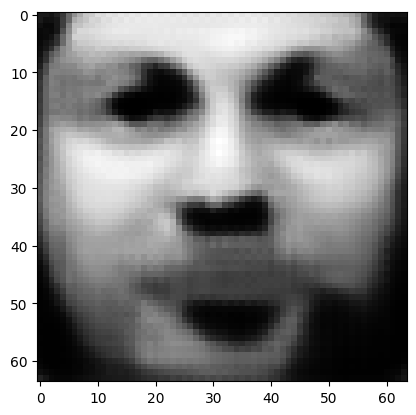

tensor([[3.4361e-07, 5.1857e-05, 1.7620e-03, 9.6701e-01, 5.2571e-06, 4.7237e-07,
         1.3451e-03, 2.4015e-06, 1.6052e-03, 2.1024e-05, 2.3667e-04, 3.1291e-05,
         4.7448e-04, 1.5326e-04, 8.3463e-04, 6.8261e-06, 1.4639e-04, 1.0311e-05,
         5.5229e-04, 5.9898e-04, 1.0158e-02, 3.1839e-03, 5.0829e-04, 2.5396e-04,
         5.2852e-05, 2.0099e-04, 4.4929e-04, 2.4679e-03, 1.4630e-03, 7.0137e-06,
         6.6732e-05, 3.0848e-05, 4.3587e-04, 4.4992e-04, 1.8683e-05, 6.5136e-06,
         1.9253e-03, 1.9220e-03, 1.5126e-03, 4.0269e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033549290150403976
tensor([[3.3978e-07, 5.1448e-05, 1.7471e-03, 9.6729e-01, 5.1975e-06, 4.6860e-07,
         1.3355e-03, 2.3779e-06, 1.5898e-03, 2.0783e-05, 2.3440e-04, 3.0922e-05,
         4.7049e-04, 1.5177e-04, 8.2751e-04, 6.7575e-06, 1.4487e-04, 1.0206e-05,
         5.4811e-04, 5.9512e-04, 1.0068e-02, 3.1588e-03, 5.0385e-04, 2.5167e-04,
         5.2160e-05, 1.9961e-04, 4.4554e-

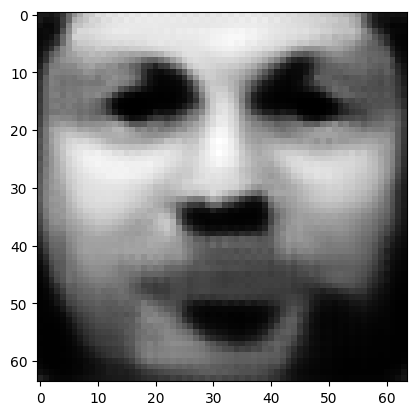

tensor([[3.2573e-07, 4.9911e-05, 1.6913e-03, 9.6836e-01, 4.9758e-06, 4.5443e-07,
         1.2999e-03, 2.2904e-06, 1.5320e-03, 1.9896e-05, 2.2586e-04, 2.9554e-05,
         4.5550e-04, 1.4615e-04, 8.0056e-04, 6.5027e-06, 1.3926e-04, 9.8124e-06,
         5.3257e-04, 5.8054e-04, 9.7298e-03, 3.0651e-03, 4.8707e-04, 2.4321e-04,
         4.9594e-05, 1.9436e-04, 4.3144e-04, 2.3762e-03, 1.4004e-03, 6.5629e-06,
         6.2941e-05, 2.9616e-05, 4.1740e-04, 4.3075e-04, 1.7493e-05, 6.1958e-06,
         1.8496e-03, 1.8334e-03, 1.4450e-03, 3.7897e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03215301036834717
tensor([[3.2243e-07, 4.9551e-05, 1.6783e-03, 9.6861e-01, 4.9236e-06, 4.5111e-07,
         1.2915e-03, 2.2698e-06, 1.5186e-03, 1.9688e-05, 2.2388e-04, 2.9234e-05,
         4.5201e-04, 1.4484e-04, 7.9425e-04, 6.4432e-06, 1.3796e-04, 9.7203e-06,
         5.2889e-04, 5.7713e-04, 9.6507e-03, 3.0430e-03, 4.8312e-04, 2.4122e-04,
         4.8998e-05, 1.9312e-04, 4.2816e-0

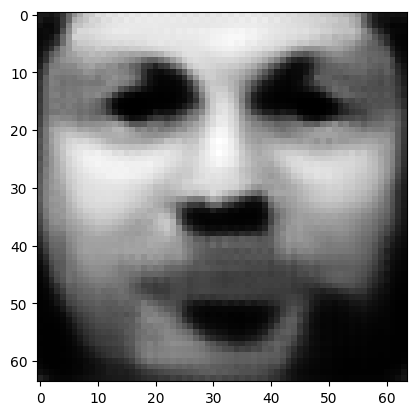

tensor([[3.1003e-07, 4.8190e-05, 1.6288e-03, 9.6955e-01, 4.7316e-06, 4.3853e-07,
         1.2591e-03, 2.1921e-06, 1.4675e-03, 1.8909e-05, 2.1636e-04, 2.8038e-05,
         4.3869e-04, 1.3989e-04, 7.7065e-04, 6.2186e-06, 1.3298e-04, 9.3748e-06,
         5.1503e-04, 5.6424e-04, 9.3538e-03, 2.9598e-03, 4.6823e-04, 2.3369e-04,
         4.6760e-05, 1.8845e-04, 4.1562e-04, 2.2945e-03, 1.3450e-03, 6.1765e-06,
         5.9656e-05, 2.8525e-05, 4.0112e-04, 4.1393e-04, 1.6463e-05, 5.9185e-06,
         1.7824e-03, 1.7557e-03, 1.3854e-03, 3.5840e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030922038480639458
tensor([[3.0714e-07, 4.7872e-05, 1.6171e-03, 9.6977e-01, 4.6867e-06, 4.3554e-07,
         1.2514e-03, 2.1737e-06, 1.4554e-03, 1.8726e-05, 2.1459e-04, 2.7758e-05,
         4.3550e-04, 1.3873e-04, 7.6506e-04, 6.1657e-06, 1.3180e-04, 9.2938e-06,
         5.1177e-04, 5.6122e-04, 9.2842e-03, 2.9402e-03, 4.6466e-04, 2.3190e-04,
         4.6231e-05, 1.8733e-04, 4.1266e-

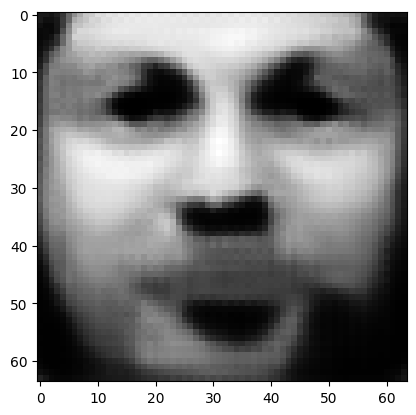

tensor([[2.9625e-07, 4.6663e-05, 1.5732e-03, 9.7061e-01, 4.5200e-06, 4.2439e-07,
         1.2223e-03, 2.1050e-06, 1.4103e-03, 1.8044e-05, 2.0793e-04, 2.6713e-05,
         4.2367e-04, 1.3436e-04, 7.4419e-04, 5.9675e-06, 1.2740e-04, 8.9901e-06,
         4.9941e-04, 5.4972e-04, 9.0222e-03, 2.8663e-03, 4.5148e-04, 2.2521e-04,
         4.4284e-05, 1.8318e-04, 4.0148e-04, 2.2210e-03, 1.2954e-03, 5.8431e-06,
         5.6794e-05, 2.7557e-05, 3.8672e-04, 3.9907e-04, 1.5568e-05, 5.6760e-06,
         1.7224e-03, 1.6872e-03, 1.3325e-03, 3.4052e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029830604791641235
tensor([[2.9370e-07, 4.6379e-05, 1.5627e-03, 9.7081e-01, 4.4808e-06, 4.2175e-07,
         1.2154e-03, 2.0888e-06, 1.3997e-03, 1.7884e-05, 2.0637e-04, 2.6471e-05,
         4.2082e-04, 1.3333e-04, 7.3927e-04, 5.9211e-06, 1.2636e-04, 8.9191e-06,
         4.9653e-04, 5.4702e-04, 8.9607e-03, 2.8488e-03, 4.4834e-04, 2.2365e-04,
         4.3827e-05, 1.8219e-04, 3.9885e-

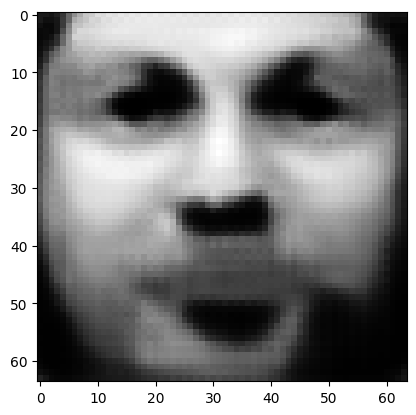

tensor([[2.8411e-07, 4.5303e-05, 1.5237e-03, 9.7155e-01, 4.3338e-06, 4.1175e-07,
         1.1895e-03, 2.0281e-06, 1.3598e-03, 1.7287e-05, 2.0049e-04, 2.5554e-05,
         4.1025e-04, 1.2945e-04, 7.2072e-04, 5.7469e-06, 1.2247e-04, 8.6507e-06,
         4.8563e-04, 5.3685e-04, 8.7280e-03, 2.7830e-03, 4.3653e-04, 2.1775e-04,
         4.2121e-05, 1.7843e-04, 3.8891e-04, 2.1555e-03, 1.2516e-03, 5.5537e-06,
         5.4281e-05, 2.6692e-05, 3.7394e-04, 3.8587e-04, 1.4790e-05, 5.4628e-06,
         1.6687e-03, 1.6263e-03, 1.2857e-03, 3.2498e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02886260487139225
tensor([[2.8189e-07, 4.5054e-05, 1.5144e-03, 9.7172e-01, 4.2995e-06, 4.0940e-07,
         1.1834e-03, 2.0140e-06, 1.3504e-03, 1.7148e-05, 1.9913e-04, 2.5341e-05,
         4.0777e-04, 1.2854e-04, 7.1637e-04, 5.7063e-06, 1.2156e-04, 8.5878e-06,
         4.8309e-04, 5.3444e-04, 8.6732e-03, 2.7676e-03, 4.3376e-04, 2.1637e-04,
         4.1730e-05, 1.7756e-04, 3.8659e-0

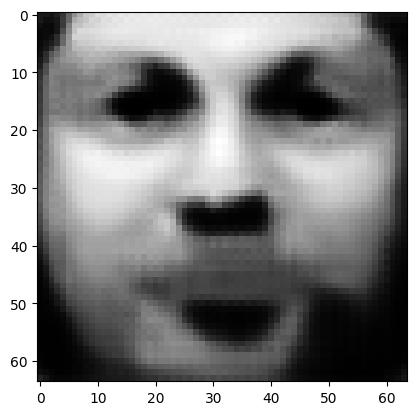

tensor([[2.7361e-07, 4.4114e-05, 1.4795e-03, 9.7238e-01, 4.1712e-06, 4.0052e-07,
         1.1608e-03, 1.9611e-06, 1.3154e-03, 1.6629e-05, 1.9398e-04, 2.4548e-05,
         3.9837e-04, 1.2512e-04, 6.9993e-04, 5.5545e-06, 1.1817e-04, 8.3530e-06,
         4.7363e-04, 5.2532e-04, 8.4668e-03, 2.7096e-03, 4.2329e-04, 2.1125e-04,
         4.0265e-05, 1.7423e-04, 3.7785e-04, 2.0980e-03, 1.2132e-03, 5.3026e-06,
         5.2096e-05, 2.5936e-05, 3.6271e-04, 3.7422e-04, 1.4118e-05, 5.2766e-06,
         1.6214e-03, 1.5730e-03, 1.2447e-03, 3.1157e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028009474277496338
tensor([[2.7168e-07, 4.3893e-05, 1.4713e-03, 9.7253e-01, 4.1410e-06, 3.9843e-07,
         1.1555e-03, 1.9486e-06, 1.3072e-03, 1.6507e-05, 1.9276e-04, 2.4362e-05,
         3.9616e-04, 1.2431e-04, 6.9603e-04, 5.5190e-06, 1.1738e-04, 8.2977e-06,
         4.7139e-04, 5.2314e-04, 8.4179e-03, 2.6960e-03, 4.2081e-04, 2.1004e-04,
         3.9923e-05, 1.7344e-04, 3.7579e-

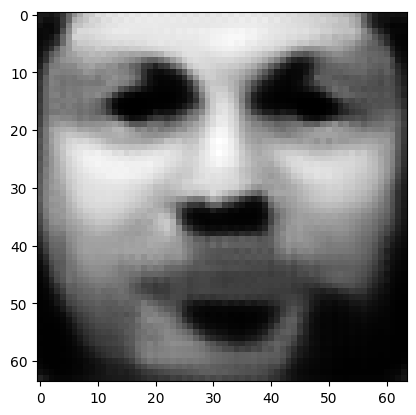

tensor([[2.6430e-07, 4.3054e-05, 1.4399e-03, 9.7312e-01, 4.0270e-06, 3.9040e-07,
         1.1350e-03, 1.9012e-06, 1.2757e-03, 1.6043e-05, 1.8816e-04, 2.3659e-05,
         3.8756e-04, 1.2127e-04, 6.8131e-04, 5.3828e-06, 1.1435e-04, 8.0895e-06,
         4.6296e-04, 5.1487e-04, 8.2339e-03, 2.6439e-03, 4.1135e-04, 2.0544e-04,
         3.8622e-05, 1.7043e-04, 3.6790e-04, 2.0459e-03, 1.1788e-03, 5.0821e-06,
         5.0159e-05, 2.5263e-05, 3.5266e-04, 3.6379e-04, 1.3528e-05, 5.1111e-06,
         1.5789e-03, 1.5257e-03, 1.2079e-03, 2.9970e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027245987206697464
tensor([[2.6258e-07, 4.2858e-05, 1.4324e-03, 9.7326e-01, 4.0000e-06, 3.8849e-07,
         1.1301e-03, 1.8901e-06, 1.2683e-03, 1.5934e-05, 1.8708e-04, 2.3496e-05,
         3.8549e-04, 1.2055e-04, 6.7783e-04, 5.3505e-06, 1.1363e-04, 8.0409e-06,
         4.6099e-04, 5.1292e-04, 8.1909e-03, 2.6315e-03, 4.0911e-04, 2.0435e-04,
         3.8316e-05, 1.6973e-04, 3.6605e-

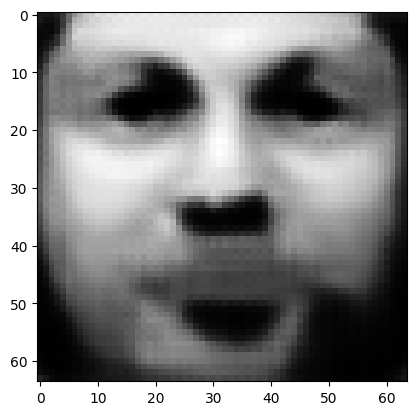

tensor([[2.5604e-07, 4.2108e-05, 1.4043e-03, 9.7379e-01, 3.8979e-06, 3.8127e-07,
         1.1116e-03, 1.8478e-06, 1.2401e-03, 1.5521e-05, 1.8297e-04, 2.2873e-05,
         3.7774e-04, 1.1784e-04, 6.6453e-04, 5.2296e-06, 1.1093e-04, 7.8560e-06,
         4.5343e-04, 5.0547e-04, 8.0263e-03, 2.5846e-03, 4.0055e-04, 2.0023e-04,
         3.7159e-05, 1.6699e-04, 3.5899e-04, 1.9987e-03, 1.1480e-03, 4.8874e-06,
         4.8434e-05, 2.4658e-05, 3.4364e-04, 3.5445e-04, 1.3006e-05, 4.9625e-06,
         1.5405e-03, 1.4837e-03, 1.1751e-03, 2.8922e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026562251150608063
tensor([[2.5451e-07, 4.1932e-05, 1.3976e-03, 9.7391e-01, 3.8734e-06, 3.7955e-07,
         1.1072e-03, 1.8378e-06, 1.2334e-03, 1.5422e-05, 1.8199e-04, 2.2725e-05,
         3.7592e-04, 1.1720e-04, 6.6138e-04, 5.2008e-06, 1.1028e-04, 7.8123e-06,
         4.5162e-04, 5.0369e-04, 7.9873e-03, 2.5734e-03, 3.9849e-04, 1.9925e-04,
         3.6887e-05, 1.6633e-04, 3.5732e-

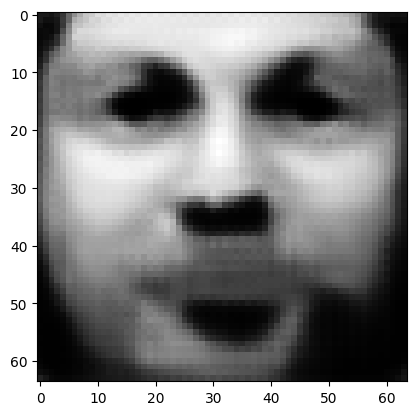

tensor([[2.4866e-07, 4.1250e-05, 1.3723e-03, 9.7439e-01, 3.7823e-06, 3.7305e-07,
         1.0905e-03, 1.7999e-06, 1.2082e-03, 1.5054e-05, 1.7829e-04, 2.2167e-05,
         3.6899e-04, 1.1475e-04, 6.4941e-04, 5.0922e-06, 1.0786e-04, 7.6459e-06,
         4.4475e-04, 4.9692e-04, 7.8384e-03, 2.5310e-03, 3.9084e-04, 1.9554e-04,
         3.5860e-05, 1.6386e-04, 3.5095e-04, 1.9562e-03, 1.1204e-03, 4.7143e-06,
         4.6893e-05, 2.4113e-05, 3.3554e-04, 3.4603e-04, 1.2542e-05, 4.8295e-06,
         1.5060e-03, 1.4458e-03, 1.1455e-03, 2.7983e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02594611793756485
tensor([[2.4727e-07, 4.1089e-05, 1.3662e-03, 9.7450e-01, 3.7604e-06, 3.7149e-07,
         1.0865e-03, 1.7908e-06, 1.2022e-03, 1.4966e-05, 1.7741e-04, 2.2035e-05,
         3.6732e-04, 1.1417e-04, 6.4654e-04, 5.0665e-06, 1.0728e-04, 7.6067e-06,
         4.4311e-04, 4.9530e-04, 7.8031e-03, 2.5208e-03, 3.8899e-04, 1.9465e-04,
         3.5615e-05, 1.6327e-04, 3.4943e-0

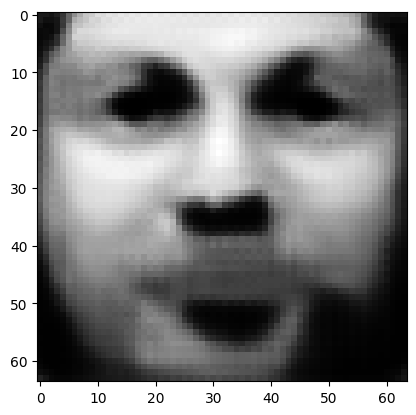

tensor([[2.4202e-07, 4.0472e-05, 1.3431e-03, 9.7493e-01, 3.6778e-06, 3.6556e-07,
         1.0713e-03, 1.7566e-06, 1.1792e-03, 1.4633e-05, 1.7406e-04, 2.1534e-05,
         3.6102e-04, 1.1196e-04, 6.3561e-04, 4.9681e-06, 1.0509e-04, 7.4568e-06,
         4.3687e-04, 4.8911e-04, 7.6683e-03, 2.4821e-03, 3.8199e-04, 1.9129e-04,
         3.4691e-05, 1.6101e-04, 3.4365e-04, 1.9174e-03, 1.0954e-03, 4.5589e-06,
         4.5505e-05, 2.3617e-05, 3.2817e-04, 3.3837e-04, 1.2126e-05, 4.7088e-06,
         1.4746e-03, 1.4117e-03, 1.1187e-03, 2.7141e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025386901572346687
tensor([[2.4077e-07, 4.0326e-05, 1.3376e-03, 9.7504e-01, 3.6583e-06, 3.6415e-07,
         1.0676e-03, 1.7484e-06, 1.1738e-03, 1.4554e-05, 1.7326e-04, 2.1415e-05,
         3.5950e-04, 1.1143e-04, 6.3302e-04, 4.9447e-06, 1.0456e-04, 7.4215e-06,
         4.3539e-04, 4.8763e-04, 7.6365e-03, 2.4728e-03, 3.8033e-04, 1.9049e-04,
         3.4474e-05, 1.6047e-04, 3.4226e-

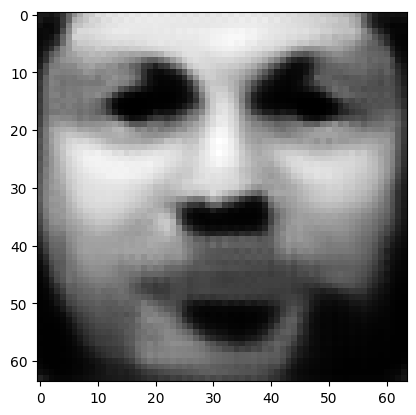

tensor([[2.3601e-07, 3.9761e-05, 1.3167e-03, 9.7543e-01, 3.5836e-06, 3.5876e-07,
         1.0537e-03, 1.7173e-06, 1.1530e-03, 1.4254e-05, 1.7021e-04, 2.0962e-05,
         3.5378e-04, 1.0943e-04, 6.2305e-04, 4.8557e-06, 1.0258e-04, 7.2855e-06,
         4.2966e-04, 4.8195e-04, 7.5136e-03, 2.4375e-03, 3.7398e-04, 1.8743e-04,
         3.3642e-05, 1.5840e-04, 3.3700e-04, 1.8821e-03, 1.0726e-03, 4.4194e-06,
         4.4253e-05, 2.3166e-05, 3.2148e-04, 3.3141e-04, 1.1752e-05, 4.5996e-06,
         1.4459e-03, 1.3806e-03, 1.0943e-03, 2.6383e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02487853914499283
tensor([[2.3488e-07, 3.9626e-05, 1.3116e-03, 9.7552e-01, 3.5657e-06, 3.5747e-07,
         1.0504e-03, 1.7099e-06, 1.1481e-03, 1.4182e-05, 1.6948e-04, 2.0854e-05,
         3.5240e-04, 1.0895e-04, 6.2067e-04, 4.8343e-06, 1.0210e-04, 7.2532e-06,
         4.2829e-04, 4.8058e-04, 7.4842e-03, 2.4290e-03, 3.7246e-04, 1.8669e-04,
         3.3444e-05, 1.5791e-04, 3.3574e-0

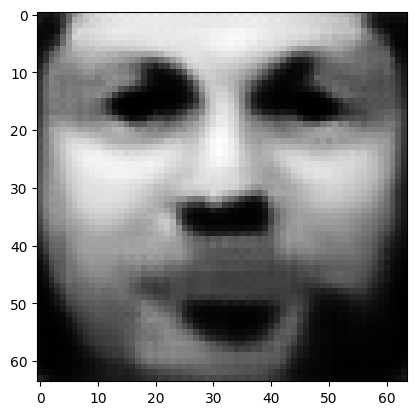

tensor([[2.3056e-07, 3.9110e-05, 1.2925e-03, 9.7588e-01, 3.4980e-06, 3.5255e-07,
         1.0377e-03, 1.6816e-06, 1.1291e-03, 1.3910e-05, 1.6672e-04, 2.0444e-05,
         3.4716e-04, 1.0713e-04, 6.1159e-04, 4.7530e-06, 1.0030e-04, 7.1296e-06,
         4.2306e-04, 4.7536e-04, 7.3721e-03, 2.3968e-03, 3.6670e-04, 1.8390e-04,
         3.2696e-05, 1.5603e-04, 3.3094e-04, 1.8499e-03, 1.0519e-03, 4.2930e-06,
         4.3119e-05, 2.2754e-05, 3.1537e-04, 3.2506e-04, 1.1414e-05, 4.5000e-06,
         1.4198e-03, 1.3524e-03, 1.0722e-03, 2.5696e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024414822459220886
tensor([[2.2955e-07, 3.8987e-05, 1.2879e-03, 9.7597e-01, 3.4818e-06, 3.5137e-07,
         1.0347e-03, 1.6749e-06, 1.1246e-03, 1.3845e-05, 1.6605e-04, 2.0346e-05,
         3.4592e-04, 1.0669e-04, 6.0939e-04, 4.7337e-06, 9.9871e-05, 7.1002e-06,
         4.2181e-04, 4.7411e-04, 7.3452e-03, 2.3891e-03, 3.6530e-04, 1.8323e-04,
         3.2517e-05, 1.5558e-04, 3.2979e-

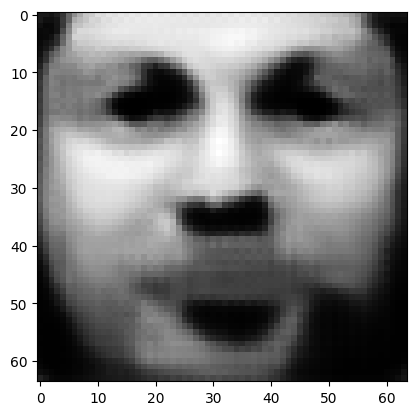

tensor([[2.2562e-07, 3.8514e-05, 1.2703e-03, 9.7630e-01, 3.4202e-06, 3.4686e-07,
         1.0229e-03, 1.6491e-06, 1.1073e-03, 1.3596e-05, 1.6352e-04, 1.9972e-05,
         3.4113e-04, 1.0503e-04, 6.0108e-04, 4.6592e-06, 9.8220e-05, 6.9872e-06,
         4.1699e-04, 4.6929e-04, 7.2424e-03, 2.3594e-03, 3.6003e-04, 1.8066e-04,
         3.1838e-05, 1.5385e-04, 3.2538e-04, 1.8203e-03, 1.0329e-03, 4.1786e-06,
         4.2089e-05, 2.2378e-05, 3.0978e-04, 3.1925e-04, 1.1109e-05, 4.4094e-06,
         1.3959e-03, 1.3266e-03, 1.0519e-03, 2.5070e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02399022877216339
tensor([[2.2468e-07, 3.8401e-05, 1.2661e-03, 9.7637e-01, 3.4055e-06, 3.4577e-07,
         1.0201e-03, 1.6429e-06, 1.1031e-03, 1.3536e-05, 1.6291e-04, 1.9882e-05,
         3.3997e-04, 1.0463e-04, 5.9908e-04, 4.6413e-06, 9.7823e-05, 6.9601e-06,
         4.1584e-04, 4.6813e-04, 7.2177e-03, 2.3523e-03, 3.5876e-04, 1.8004e-04,
         3.1673e-05, 1.5343e-04, 3.2432e-0

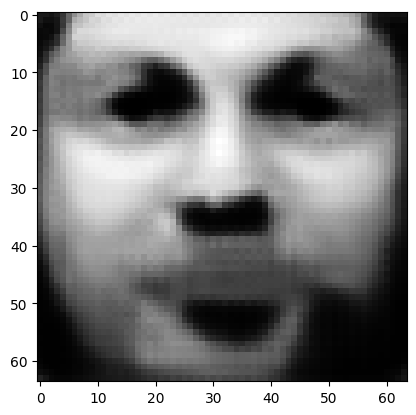

tensor([[2.2109e-07, 3.7966e-05, 1.2499e-03, 9.7668e-01, 3.3491e-06, 3.4161e-07,
         1.0093e-03, 1.6191e-06, 1.0871e-03, 1.3309e-05, 1.6058e-04, 1.9540e-05,
         3.3554e-04, 1.0310e-04, 5.9142e-04, 4.5729e-06, 9.6310e-05, 6.8564e-06,
         4.1142e-04, 4.6368e-04, 7.1231e-03, 2.3251e-03, 3.5390e-04, 1.7768e-04,
         3.1052e-05, 1.5184e-04, 3.2025e-04, 1.7930e-03, 1.0153e-03, 4.0744e-06,
         4.1146e-05, 2.2032e-05, 3.0464e-04, 3.1391e-04, 1.0830e-05, 4.3265e-06,
         1.3740e-03, 1.3030e-03, 1.0333e-03, 2.4498e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023599453270435333
tensor([[2.2022e-07, 3.7861e-05, 1.2461e-03, 9.7675e-01, 3.3356e-06, 3.4062e-07,
         1.0067e-03, 1.6135e-06, 1.0833e-03, 1.3254e-05, 1.6002e-04, 1.9458e-05,
         3.3449e-04, 1.0273e-04, 5.8959e-04, 4.5564e-06, 9.5945e-05, 6.8315e-06,
         4.1035e-04, 4.6261e-04, 7.1005e-03, 2.3185e-03, 3.5274e-04, 1.7711e-04,
         3.0905e-05, 1.5146e-04, 3.1928e-

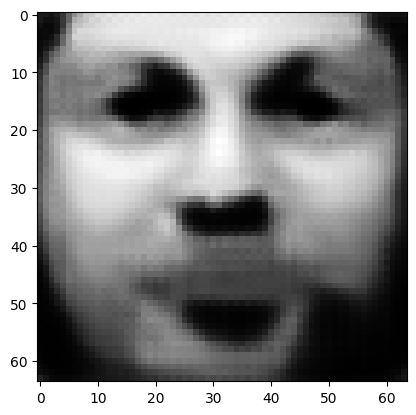

tensor([[2.1693e-07, 3.7459e-05, 1.2312e-03, 9.7703e-01, 3.2839e-06, 3.3679e-07,
         9.9674e-04, 1.5917e-06, 1.0686e-03, 1.3046e-05, 1.5788e-04, 1.9144e-05,
         3.3042e-04, 1.0133e-04, 5.8253e-04, 4.4937e-06, 9.4556e-05, 6.7364e-06,
         4.0626e-04, 4.5849e-04, 7.0132e-03, 2.2934e-03, 3.4826e-04, 1.7494e-04,
         3.0339e-05, 1.4998e-04, 3.1554e-04, 1.7679e-03, 9.9924e-04, 3.9794e-06,
         4.0284e-05, 2.1714e-05, 2.9992e-04, 3.0901e-04, 1.0575e-05, 4.2503e-06,
         1.3537e-03, 1.2813e-03, 1.0162e-03, 2.3976e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023240089416503906
tensor([[2.1614e-07, 3.7362e-05, 1.2276e-03, 9.7709e-01, 3.2718e-06, 3.3587e-07,
         9.9438e-04, 1.5865e-06, 1.0651e-03, 1.2997e-05, 1.5737e-04, 1.9070e-05,
         3.2946e-04, 1.0099e-04, 5.8084e-04, 4.4786e-06, 9.4227e-05, 6.7134e-06,
         4.0527e-04, 4.5750e-04, 6.9922e-03, 2.2874e-03, 3.4721e-04, 1.7442e-04,
         3.0204e-05, 1.4963e-04, 3.1464e-

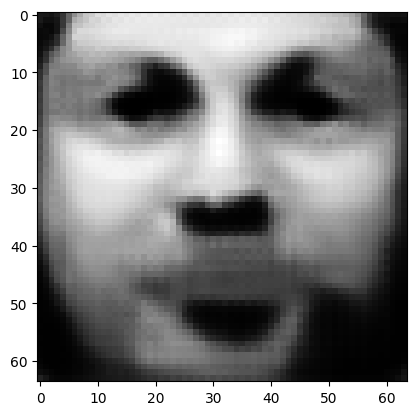

tensor([[2.1311e-07, 3.6989e-05, 1.2140e-03, 9.7735e-01, 3.2243e-06, 3.3235e-07,
         9.8518e-04, 1.5665e-06, 1.0517e-03, 1.2806e-05, 1.5540e-04, 1.8782e-05,
         3.2572e-04, 9.9697e-05, 5.7432e-04, 4.4208e-06, 9.2949e-05, 6.6257e-06,
         4.0148e-04, 4.5368e-04, 6.9117e-03, 2.2641e-03, 3.4310e-04, 1.7241e-04,
         2.9686e-05, 1.4827e-04, 3.1119e-04, 1.7448e-03, 9.8440e-04, 3.8924e-06,
         3.9495e-05, 2.1420e-05, 2.9557e-04, 3.0447e-04, 1.0343e-05, 4.1804e-06,
         1.3351e-03, 1.2613e-03, 1.0004e-03, 2.3496e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02290879189968109
tensor([[2.1239e-07, 3.6901e-05, 1.2107e-03, 9.7741e-01, 3.2128e-06, 3.3149e-07,
         9.8297e-04, 1.5617e-06, 1.0484e-03, 1.2760e-05, 1.5492e-04, 1.8712e-05,
         3.2481e-04, 9.9388e-05, 5.7275e-04, 4.4070e-06, 9.2642e-05, 6.6047e-06,
         4.0058e-04, 4.5275e-04, 6.8923e-03, 2.2585e-03, 3.4209e-04, 1.7193e-04,
         2.9562e-05, 1.4794e-04, 3.1036e-0

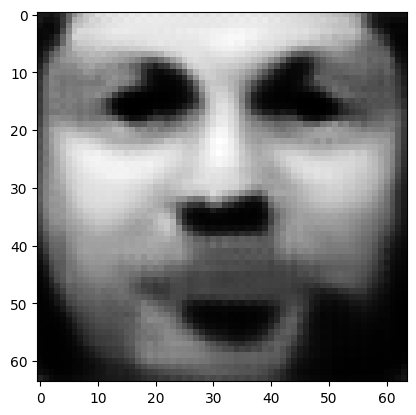

tensor([[2.0961e-07, 3.6557e-05, 1.1980e-03, 9.7765e-01, 3.1693e-06, 3.2823e-07,
         9.7445e-04, 1.5432e-06, 1.0360e-03, 1.2584e-05, 1.5310e-04, 1.8449e-05,
         3.2137e-04, 9.8199e-05, 5.6671e-04, 4.3537e-06, 9.1466e-05, 6.5242e-06,
         3.9707e-04, 4.4920e-04, 6.8182e-03, 2.2370e-03, 3.3830e-04, 1.7008e-04,
         2.9087e-05, 1.4668e-04, 3.0717e-04, 1.7233e-03, 9.7070e-04, 3.8127e-06,
         3.8769e-05, 2.1149e-05, 2.9155e-04, 3.0029e-04, 1.0130e-05, 4.1157e-06,
         1.3178e-03, 1.2429e-03, 9.8591e-04, 2.3057e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022602790966629982
tensor([[2.0894e-07, 3.6473e-05, 1.1949e-03, 9.7771e-01, 3.1588e-06, 3.2744e-07,
         9.7238e-04, 1.5388e-06, 1.0330e-03, 1.2542e-05, 1.5266e-04, 1.8386e-05,
         3.2052e-04, 9.7911e-05, 5.6526e-04, 4.3408e-06, 9.1182e-05, 6.5049e-06,
         3.9623e-04, 4.4835e-04, 6.8004e-03, 2.2318e-03, 3.3739e-04, 1.6963e-04,
         2.8973e-05, 1.4638e-04, 3.0640e-

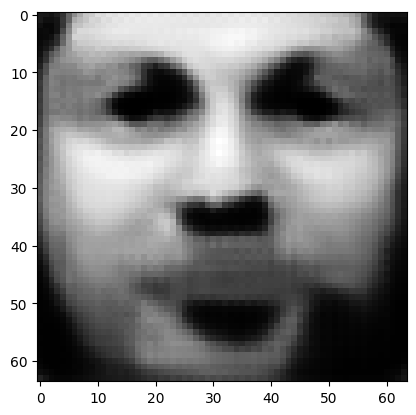

tensor([[2.0638e-07, 3.6154e-05, 1.1833e-03, 9.7793e-01, 3.1185e-06, 3.2443e-07,
         9.6450e-04, 1.5218e-06, 1.0215e-03, 1.2380e-05, 1.5098e-04, 1.8142e-05,
         3.1734e-04, 9.6809e-05, 5.5967e-04, 4.2917e-06, 9.0097e-05, 6.4303e-06,
         3.9298e-04, 4.4506e-04, 6.7315e-03, 2.2119e-03, 3.3387e-04, 1.6792e-04,
         2.8537e-05, 1.4521e-04, 3.0346e-04, 1.7034e-03, 9.5805e-04, 3.7394e-06,
         3.8099e-05, 2.0897e-05, 2.8783e-04, 2.9641e-04, 9.9339e-06, 4.0560e-06,
         1.3018e-03, 1.2258e-03, 9.7245e-04, 2.2652e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02231966331601143
tensor([[2.0576e-07, 3.6078e-05, 1.1804e-03, 9.7798e-01, 3.1088e-06, 3.2369e-07,
         9.6259e-04, 1.5177e-06, 1.0187e-03, 1.2341e-05, 1.5058e-04, 1.8084e-05,
         3.1656e-04, 9.6546e-05, 5.5833e-04, 4.2799e-06, 8.9835e-05, 6.4124e-06,
         3.9220e-04, 4.4426e-04, 6.7151e-03, 2.2071e-03, 3.3302e-04, 1.6751e-04,
         2.8432e-05, 1.4493e-04, 3.0275e-0

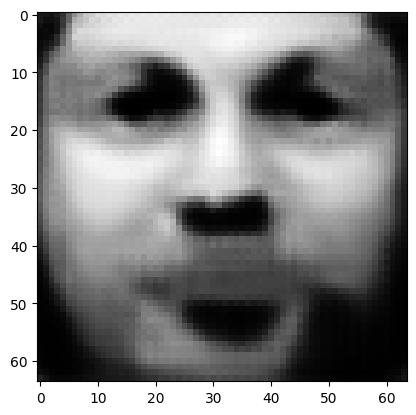

tensor([[2.0339e-07, 3.5781e-05, 1.1696e-03, 9.7818e-01, 3.0715e-06, 3.2088e-07,
         9.5525e-04, 1.5019e-06, 1.0081e-03, 1.2192e-05, 1.4902e-04, 1.7858e-05,
         3.1359e-04, 9.5523e-05, 5.5314e-04, 4.2345e-06, 8.8828e-05, 6.3430e-06,
         3.8919e-04, 4.4121e-04, 6.6510e-03, 2.1886e-03, 3.2974e-04, 1.6592e-04,
         2.8029e-05, 1.4383e-04, 3.0001e-04, 1.6850e-03, 9.4630e-04, 3.6718e-06,
         3.7481e-05, 2.0663e-05, 2.8437e-04, 2.9282e-04, 9.7532e-06, 4.0008e-06,
         1.2870e-03, 1.2100e-03, 9.5997e-04, 2.2279e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02205662801861763
tensor([[2.0281e-07, 3.5710e-05, 1.1670e-03, 9.7823e-01, 3.0625e-06, 3.2020e-07,
         9.5347e-04, 1.4981e-06, 1.0055e-03, 1.2156e-05, 1.4864e-04, 1.7804e-05,
         3.1286e-04, 9.5273e-05, 5.5188e-04, 4.2236e-06, 8.8583e-05, 6.3263e-06,
         3.8846e-04, 4.4048e-04, 6.6356e-03, 2.1841e-03, 3.2894e-04, 1.6554e-04,
         2.7931e-05, 1.4356e-04, 2.9935e-0

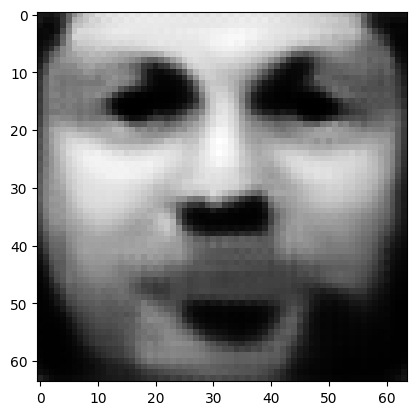

tensor([[2.0059e-07, 3.5433e-05, 1.1569e-03, 9.7842e-01, 3.0278e-06, 3.1757e-07,
         9.4662e-04, 1.4834e-06, 9.9563e-04, 1.2018e-05, 1.4720e-04, 1.7595e-05,
         3.1009e-04, 9.4318e-05, 5.4705e-04, 4.1816e-06, 8.7643e-05, 6.2619e-06,
         3.8566e-04, 4.3765e-04, 6.5761e-03, 2.1668e-03, 3.2589e-04, 1.6406e-04,
         2.7558e-05, 1.4254e-04, 2.9680e-04, 1.6678e-03, 9.3540e-04, 3.6095e-06,
         3.6906e-05, 2.0443e-05, 2.8115e-04, 2.8947e-04, 9.5860e-06, 3.9495e-06,
         1.2730e-03, 1.1952e-03, 9.4834e-04, 2.1936e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021812070161104202
tensor([[2.0007e-07, 3.5367e-05, 1.1544e-03, 9.7847e-01, 3.0195e-06, 3.1694e-07,
         9.4497e-04, 1.4799e-06, 9.9324e-04, 1.1984e-05, 1.4685e-04, 1.7545e-05,
         3.0942e-04, 9.4089e-05, 5.4588e-04, 4.1715e-06, 8.7419e-05, 6.2464e-06,
         3.8499e-04, 4.3697e-04, 6.5618e-03, 2.1626e-03, 3.2514e-04, 1.6371e-04,
         2.7467e-05, 1.4229e-04, 2.9619e-

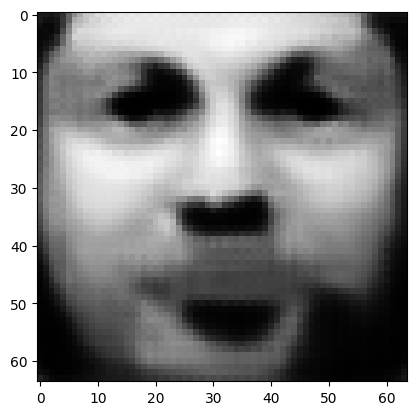

tensor([[1.9796e-07, 3.5105e-05, 1.1449e-03, 9.7865e-01, 2.9873e-06, 3.1446e-07,
         9.3838e-04, 1.4659e-06, 9.8383e-04, 1.1853e-05, 1.4548e-04, 1.7347e-05,
         3.0678e-04, 9.3187e-05, 5.4133e-04, 4.1316e-06, 8.6525e-05, 6.1856e-06,
         3.8232e-04, 4.3431e-04, 6.5059e-03, 2.1463e-03, 3.2224e-04, 1.6230e-04,
         2.7113e-05, 1.4132e-04, 2.9374e-04, 1.6514e-03, 9.2503e-04, 3.5515e-06,
         3.6370e-05, 2.0236e-05, 2.7813e-04, 2.8633e-04, 9.4295e-06, 3.9016e-06,
         1.2599e-03, 1.1813e-03, 9.3738e-04, 2.1613e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021581334993243217
tensor([[1.9745e-07, 3.5041e-05, 1.1425e-03, 9.7869e-01, 2.9796e-06, 3.1386e-07,
         9.3678e-04, 1.4625e-06, 9.8156e-04, 1.1822e-05, 1.4514e-04, 1.7299e-05,
         3.0615e-04, 9.2969e-05, 5.4024e-04, 4.1218e-06, 8.6308e-05, 6.1708e-06,
         3.8167e-04, 4.3367e-04, 6.4924e-03, 2.1424e-03, 3.2155e-04, 1.6196e-04,
         2.7029e-05, 1.4109e-04, 2.9315e-

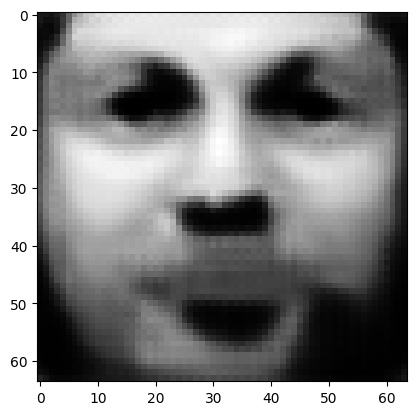

tensor([[1.9549e-07, 3.4796e-05, 1.1336e-03, 9.7886e-01, 2.9497e-06, 3.1154e-07,
         9.3059e-04, 1.4494e-06, 9.7278e-04, 1.1700e-05, 1.4386e-04, 1.7115e-05,
         3.0366e-04, 9.2125e-05, 5.3599e-04, 4.0845e-06, 8.5474e-05, 6.1140e-06,
         3.7917e-04, 4.3119e-04, 6.4402e-03, 2.1272e-03, 3.1885e-04, 1.6064e-04,
         2.6698e-05, 1.4018e-04, 2.9086e-04, 1.6360e-03, 9.1524e-04, 3.4975e-06,
         3.5870e-05, 2.0041e-05, 2.7530e-04, 2.8340e-04, 9.2834e-06, 3.8570e-06,
         1.2475e-03, 1.1683e-03, 9.2709e-04, 2.1311e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02136489935219288
tensor([[1.9501e-07, 3.4737e-05, 1.1314e-03, 9.7890e-01, 2.9424e-06, 3.1098e-07,
         9.2908e-04, 1.4462e-06, 9.7065e-04, 1.1670e-05, 1.4355e-04, 1.7071e-05,
         3.0306e-04, 9.1924e-05, 5.3496e-04, 4.0754e-06, 8.5272e-05, 6.1003e-06,
         3.7856e-04, 4.3059e-04, 6.4277e-03, 2.1235e-03, 3.1819e-04, 1.6032e-04,
         2.6619e-05, 1.3996e-04, 2.9031e-0

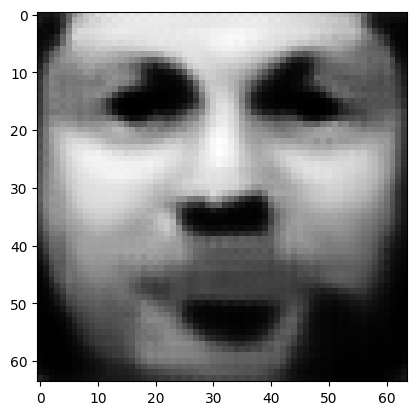

tensor([[1.9319e-07, 3.4509e-05, 1.1230e-03, 9.7906e-01, 2.9147e-06, 3.0881e-07,
         9.2330e-04, 1.4341e-06, 9.6244e-04, 1.1556e-05, 1.4235e-04, 1.6901e-05,
         3.0075e-04, 9.1139e-05, 5.3100e-04, 4.0406e-06, 8.4497e-05, 6.0476e-06,
         3.7623e-04, 4.2826e-04, 6.3791e-03, 2.1093e-03, 3.1567e-04, 1.5909e-04,
         2.6312e-05, 1.3912e-04, 2.8816e-04, 1.6216e-03, 9.0611e-04, 3.4473e-06,
         3.5405e-05, 1.9860e-05, 2.7267e-04, 2.8066e-04, 9.1481e-06, 3.8154e-06,
         1.2360e-03, 1.1562e-03, 9.1752e-04, 2.1032e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02116335555911064
tensor([[1.9275e-07, 3.4453e-05, 1.1210e-03, 9.7910e-01, 2.9079e-06, 3.0829e-07,
         9.2190e-04, 1.4311e-06, 9.6048e-04, 1.1529e-05, 1.4206e-04, 1.6859e-05,
         3.0019e-04, 9.0950e-05, 5.3003e-04, 4.0322e-06, 8.4309e-05, 6.0348e-06,
         3.7566e-04, 4.2770e-04, 6.3673e-03, 2.1059e-03, 3.1506e-04, 1.5879e-04,
         2.6238e-05, 1.3891e-04, 2.8765e-0

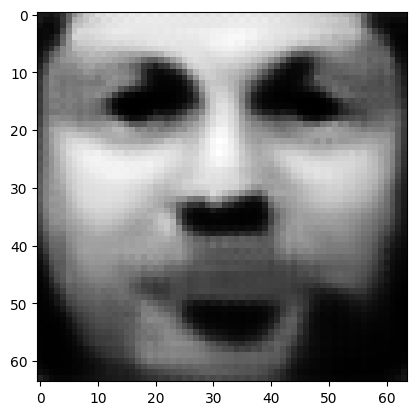

tensor([[1.9104e-07, 3.4239e-05, 1.1132e-03, 9.7924e-01, 2.8820e-06, 3.0626e-07,
         9.1649e-04, 1.4198e-06, 9.5282e-04, 1.1423e-05, 1.4095e-04, 1.6700e-05,
         2.9803e-04, 9.0218e-05, 5.2632e-04, 3.9997e-06, 8.3586e-05, 5.9856e-06,
         3.7347e-04, 4.2552e-04, 6.3219e-03, 2.0926e-03, 3.1270e-04, 1.5765e-04,
         2.5953e-05, 1.3812e-04, 2.8565e-04, 1.6081e-03, 8.9761e-04, 3.4007e-06,
         3.4972e-05, 1.9691e-05, 2.7020e-04, 2.7810e-04, 9.0223e-06, 3.7765e-06,
         1.2252e-03, 1.1449e-03, 9.0859e-04, 2.0770e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020975081250071526
tensor([[1.9063e-07, 3.4186e-05, 1.1113e-03, 9.7928e-01, 2.8757e-06, 3.0577e-07,
         9.1521e-04, 1.4171e-06, 9.5098e-04, 1.1397e-05, 1.4068e-04, 1.6661e-05,
         2.9751e-04, 9.0040e-05, 5.2544e-04, 3.9918e-06, 8.3413e-05, 5.9736e-06,
         3.7293e-04, 4.2498e-04, 6.3108e-03, 2.0894e-03, 3.1214e-04, 1.5737e-04,
         2.5886e-05, 1.3793e-04, 2.8516e-

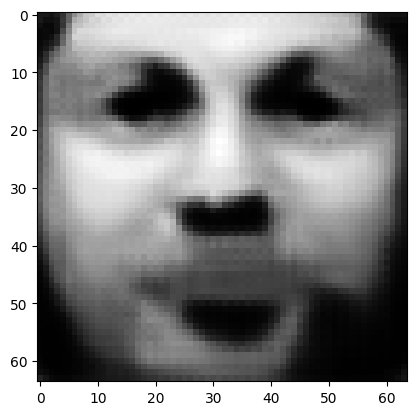

tensor([[1.8904e-07, 3.3986e-05, 1.1040e-03, 9.7942e-01, 2.8515e-06, 3.0388e-07,
         9.1016e-04, 1.4065e-06, 9.4385e-04, 1.1299e-05, 1.3964e-04, 1.6513e-05,
         2.9550e-04, 8.9356e-05, 5.2197e-04, 3.9616e-06, 8.2738e-05, 5.9275e-06,
         3.7088e-04, 4.2295e-04, 6.2682e-03, 2.0770e-03, 3.0993e-04, 1.5630e-04,
         2.5620e-05, 1.3718e-04, 2.8330e-04, 1.5956e-03, 8.8967e-04, 3.3573e-06,
         3.4569e-05, 1.9532e-05, 2.6791e-04, 2.7571e-04, 8.9054e-06, 3.7403e-06,
         1.2151e-03, 1.1343e-03, 9.0027e-04, 2.0527e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02079891227185726
tensor([[1.8866e-07, 3.3937e-05, 1.1023e-03, 9.7945e-01, 2.8456e-06, 3.0342e-07,
         9.0892e-04, 1.4039e-06, 9.4212e-04, 1.1275e-05, 1.3938e-04, 1.6477e-05,
         2.9501e-04, 8.9189e-05, 5.2112e-04, 3.9542e-06, 8.2574e-05, 5.9164e-06,
         3.7039e-04, 4.2246e-04, 6.2580e-03, 2.0740e-03, 3.0939e-04, 1.5604e-04,
         2.5556e-05, 1.3700e-04, 2.8284e-0

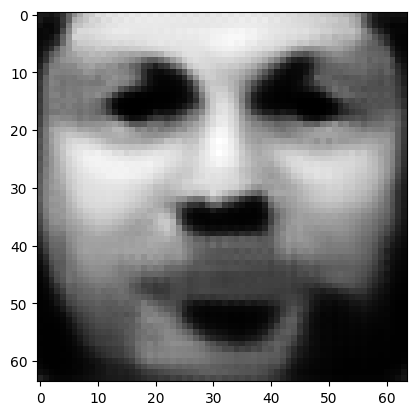

tensor([[1.8716e-07, 3.3749e-05, 1.0954e-03, 9.7958e-01, 2.8229e-06, 3.0163e-07,
         9.0416e-04, 1.3940e-06, 9.3543e-04, 1.1183e-05, 1.3841e-04, 1.6338e-05,
         2.9310e-04, 8.8545e-05, 5.1787e-04, 3.9260e-06, 8.1940e-05, 5.8732e-06,
         3.6847e-04, 4.2055e-04, 6.2181e-03, 2.0623e-03, 3.0731e-04, 1.5504e-04,
         2.5307e-05, 1.3630e-04, 2.8108e-04, 1.5837e-03, 8.8224e-04, 3.3169e-06,
         3.4190e-05, 1.9382e-05, 2.6575e-04, 2.7346e-04, 8.7961e-06, 3.7063e-06,
         1.2056e-03, 1.1243e-03, 8.9244e-04, 2.0300e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020633690059185028
tensor([[1.8680e-07, 3.3703e-05, 1.0938e-03, 9.7961e-01, 2.8174e-06, 3.0120e-07,
         9.0301e-04, 1.3916e-06, 9.3381e-04, 1.1160e-05, 1.3817e-04, 1.6304e-05,
         2.9264e-04, 8.8389e-05, 5.1708e-04, 3.9192e-06, 8.1787e-05, 5.8628e-06,
         3.6801e-04, 4.2009e-04, 6.2085e-03, 2.0595e-03, 3.0681e-04, 1.5479e-04,
         2.5247e-05, 1.3612e-04, 2.8066e-

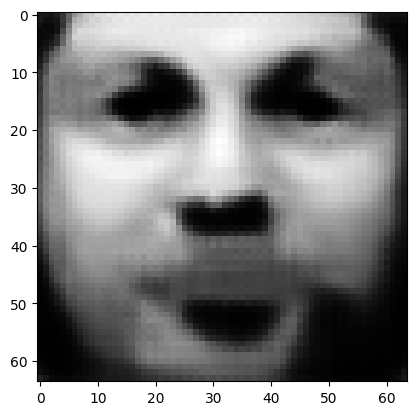

tensor([[1.8541e-07, 3.3527e-05, 1.0873e-03, 9.7973e-01, 2.7962e-06, 2.9953e-07,
         8.9855e-04, 1.3823e-06, 9.2754e-04, 1.1074e-05, 1.3726e-04, 1.6175e-05,
         2.9087e-04, 8.7790e-05, 5.1404e-04, 3.8926e-06, 8.1195e-05, 5.8225e-06,
         3.6621e-04, 4.1830e-04, 6.1712e-03, 2.0485e-03, 3.0487e-04, 1.5386e-04,
         2.5016e-05, 1.3547e-04, 2.7902e-04, 1.5726e-03, 8.7526e-04, 3.2792e-06,
         3.3838e-05, 1.9243e-05, 2.6373e-04, 2.7137e-04, 8.6943e-06, 3.6747e-06,
         1.1967e-03, 1.1150e-03, 8.8512e-04, 2.0089e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02047918364405632
tensor([[1.8507e-07, 3.3484e-05, 1.0858e-03, 9.7976e-01, 2.7912e-06, 2.9912e-07,
         8.9749e-04, 1.3801e-06, 9.2603e-04, 1.1054e-05, 1.3704e-04, 1.6143e-05,
         2.9044e-04, 8.7643e-05, 5.1331e-04, 3.8862e-06, 8.1053e-05, 5.8126e-06,
         3.6578e-04, 4.1786e-04, 6.1621e-03, 2.0459e-03, 3.0441e-04, 1.5363e-04,
         2.4961e-05, 1.3531e-04, 2.7862e-0

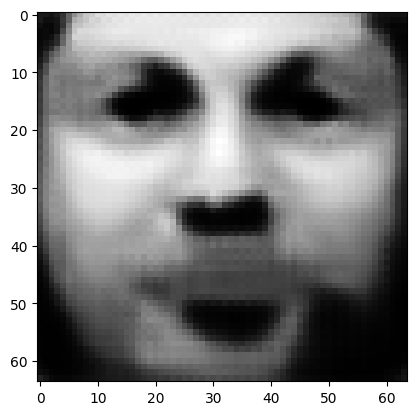

tensor([[1.8375e-07, 3.3316e-05, 1.0797e-03, 9.7987e-01, 2.7713e-06, 2.9754e-07,
         8.9323e-04, 1.3713e-06, 9.2008e-04, 1.0972e-05, 1.3617e-04, 1.6020e-05,
         2.8874e-04, 8.7073e-05, 5.1043e-04, 3.8611e-06, 8.0490e-05, 5.7744e-06,
         3.6407e-04, 4.1617e-04, 6.1268e-03, 2.0356e-03, 3.0257e-04, 1.5273e-04,
         2.4742e-05, 1.3469e-04, 2.7705e-04, 1.5621e-03, 8.6863e-04, 3.2438e-06,
         3.3506e-05, 1.9111e-05, 2.6183e-04, 2.6939e-04, 8.5984e-06, 3.6449e-06,
         1.1883e-03, 1.1062e-03, 8.7820e-04, 1.9889e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020332949236035347
tensor([[1.8343e-07, 3.3276e-05, 1.0782e-03, 9.7990e-01, 2.7665e-06, 2.9715e-07,
         8.9218e-04, 1.3691e-06, 9.1862e-04, 1.0952e-05, 1.3596e-04, 1.5991e-05,
         2.8833e-04, 8.6936e-05, 5.0974e-04, 3.8550e-06, 8.0352e-05, 5.7652e-06,
         3.6366e-04, 4.1576e-04, 6.1183e-03, 2.0331e-03, 3.0212e-04, 1.5252e-04,
         2.4688e-05, 1.3454e-04, 2.7667e-

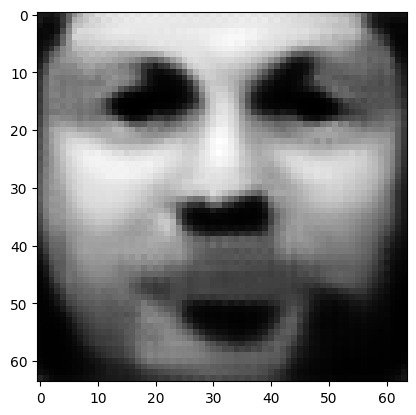

tensor([[1.8219e-07, 3.3118e-05, 1.0725e-03, 9.8001e-01, 2.7479e-06, 2.9566e-07,
         8.8816e-04, 1.3608e-06, 9.1302e-04, 1.0875e-05, 1.3515e-04, 1.5875e-05,
         2.8673e-04, 8.6400e-05, 5.0703e-04, 3.8313e-06, 7.9823e-05, 5.7293e-06,
         3.6206e-04, 4.1417e-04, 6.0852e-03, 2.0234e-03, 3.0039e-04, 1.5167e-04,
         2.4482e-05, 1.3395e-04, 2.7519e-04, 1.5521e-03, 8.6236e-04, 3.2107e-06,
         3.3194e-05, 1.8987e-05, 2.6004e-04, 2.6752e-04, 8.5083e-06, 3.6170e-06,
         1.1804e-03, 1.0980e-03, 8.7166e-04, 1.9702e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02019510418176651
tensor([[1.8189e-07, 3.3081e-05, 1.0711e-03, 9.8003e-01, 2.7434e-06, 2.9530e-07,
         8.8718e-04, 1.3588e-06, 9.1167e-04, 1.0857e-05, 1.3495e-04, 1.5848e-05,
         2.8634e-04, 8.6272e-05, 5.0638e-04, 3.8256e-06, 7.9695e-05, 5.7207e-06,
         3.6167e-04, 4.1378e-04, 6.0772e-03, 2.0210e-03, 2.9997e-04, 1.5147e-04,
         2.4433e-05, 1.3381e-04, 2.7483e-0

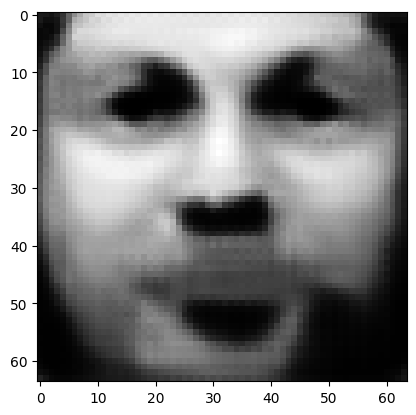

tensor([[1.8072e-07, 3.2933e-05, 1.0658e-03, 9.8013e-01, 2.7260e-06, 2.9390e-07,
         8.8340e-04, 1.3510e-06, 9.0643e-04, 1.0785e-05, 1.3419e-04, 1.5740e-05,
         2.8484e-04, 8.5770e-05, 5.0385e-04, 3.8035e-06, 7.9199e-05, 5.6871e-06,
         3.6016e-04, 4.1229e-04, 6.0461e-03, 2.0119e-03, 2.9834e-04, 1.5068e-04,
         2.4240e-05, 1.3325e-04, 2.7345e-04, 1.5427e-03, 8.5650e-04, 3.1797e-06,
         3.2902e-05, 1.8870e-05, 2.5835e-04, 2.6578e-04, 8.4242e-06, 3.5907e-06,
         1.1729e-03, 1.0903e-03, 8.6554e-04, 1.9527e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02006588689982891
tensor([[1.8044e-07, 3.2897e-05, 1.0645e-03, 9.8016e-01, 2.7219e-06, 2.9357e-07,
         8.8252e-04, 1.3492e-06, 9.0517e-04, 1.0768e-05, 1.3401e-04, 1.5714e-05,
         2.8449e-04, 8.5649e-05, 5.0325e-04, 3.7982e-06, 7.9082e-05, 5.6790e-06,
         3.5980e-04, 4.1193e-04, 6.0386e-03, 2.0097e-03, 2.9796e-04, 1.5049e-04,
         2.4195e-05, 1.3312e-04, 2.7311e-0

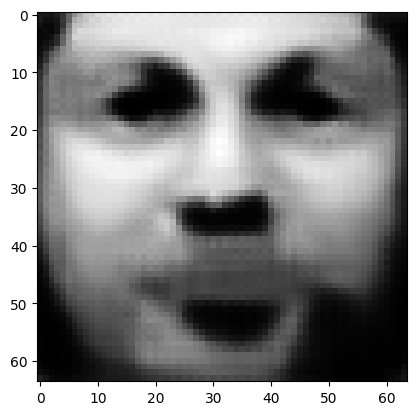

tensor([[1.7935e-07, 3.2758e-05, 1.0595e-03, 9.8025e-01, 2.7056e-06, 2.9225e-07,
         8.7897e-04, 1.3419e-06, 9.0025e-04, 1.0701e-05, 1.3329e-04, 1.5613e-05,
         2.8308e-04, 8.5179e-05, 5.0087e-04, 3.7774e-06, 7.8616e-05, 5.6475e-06,
         3.5838e-04, 4.1052e-04, 6.0095e-03, 2.0011e-03, 2.9644e-04, 1.4975e-04,
         2.4015e-05, 1.3261e-04, 2.7181e-04, 1.5340e-03, 8.5098e-04, 3.1508e-06,
         3.2630e-05, 1.8762e-05, 2.5678e-04, 2.6414e-04, 8.3457e-06, 3.5663e-06,
         1.1659e-03, 1.0830e-03, 8.5981e-04, 1.9363e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019945064559578896
tensor([[1.7908e-07, 3.2724e-05, 1.0582e-03, 9.8028e-01, 2.7017e-06, 2.9193e-07,
         8.7810e-04, 1.3401e-06, 8.9906e-04, 1.0684e-05, 1.3312e-04, 1.5588e-05,
         2.8273e-04, 8.5066e-05, 5.0029e-04, 3.7723e-06, 7.8503e-05, 5.6399e-06,
         3.5804e-04, 4.1018e-04, 6.0025e-03, 1.9991e-03, 2.9607e-04, 1.4957e-04,
         2.3971e-05, 1.3248e-04, 2.7150e-

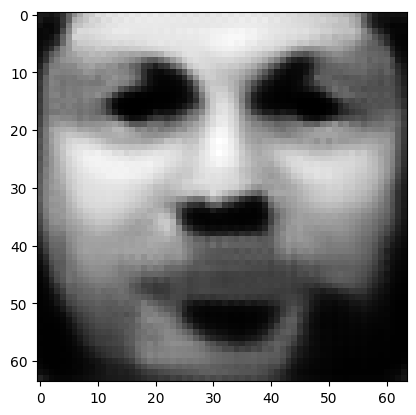

tensor([[1.7807e-07, 3.2594e-05, 1.0535e-03, 9.8036e-01, 2.6864e-06, 2.9070e-07,
         8.7478e-04, 1.3333e-06, 8.9446e-04, 1.0622e-05, 1.3245e-04, 1.5494e-05,
         2.8142e-04, 8.4624e-05, 4.9806e-04, 3.7529e-06, 7.8069e-05, 5.6104e-06,
         3.5672e-04, 4.0886e-04, 5.9751e-03, 1.9910e-03, 2.9464e-04, 1.4887e-04,
         2.3803e-05, 1.3199e-04, 2.7028e-04, 1.5257e-03, 8.4582e-04, 3.1237e-06,
         3.2375e-05, 1.8659e-05, 2.5530e-04, 2.6260e-04, 8.2722e-06, 3.5433e-06,
         1.1593e-03, 1.0762e-03, 8.5442e-04, 1.9210e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019831007346510887
tensor([[1.7782e-07, 3.2562e-05, 1.0524e-03, 9.8039e-01, 2.6827e-06, 2.9040e-07,
         8.7397e-04, 1.3316e-06, 8.9335e-04, 1.0606e-05, 1.3229e-04, 1.5471e-05,
         2.8110e-04, 8.4518e-05, 4.9752e-04, 3.7482e-06, 7.7964e-05, 5.6033e-06,
         3.5639e-04, 4.0854e-04, 5.9685e-03, 1.9891e-03, 2.9429e-04, 1.4870e-04,
         2.3762e-05, 1.3188e-04, 2.6998e-

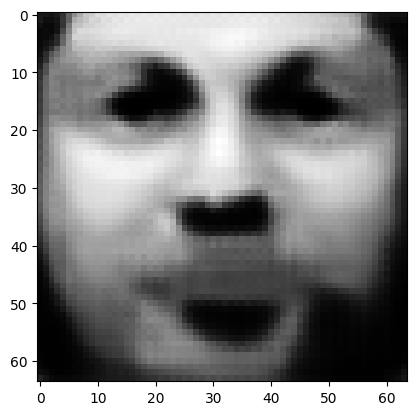

tensor([[1.7685e-07, 3.2438e-05, 1.0479e-03, 9.8047e-01, 2.6683e-06, 2.8923e-07,
         8.7083e-04, 1.3251e-06, 8.8899e-04, 1.0547e-05, 1.3165e-04, 1.5382e-05,
         2.7985e-04, 8.4096e-05, 4.9542e-04, 3.7299e-06, 7.7551e-05, 5.5752e-06,
         3.5515e-04, 4.0731e-04, 5.9426e-03, 1.9815e-03, 2.9294e-04, 1.4805e-04,
         2.3604e-05, 1.3141e-04, 2.6882e-04, 1.5179e-03, 8.4095e-04, 3.0983e-06,
         3.2134e-05, 1.8561e-05, 2.5390e-04, 2.6115e-04, 8.2029e-06, 3.5216e-06,
         1.1531e-03, 1.0698e-03, 8.4934e-04, 1.9066e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019723834469914436
tensor([[1.7661e-07, 3.2408e-05, 1.0468e-03, 9.8049e-01, 2.6647e-06, 2.8894e-07,
         8.7006e-04, 1.3236e-06, 8.8793e-04, 1.0533e-05, 1.3150e-04, 1.5360e-05,
         2.7954e-04, 8.3994e-05, 4.9491e-04, 3.7254e-06, 7.7449e-05, 5.5685e-06,
         3.5484e-04, 4.0701e-04, 5.9363e-03, 1.9796e-03, 2.9260e-04, 1.4789e-04,
         2.3565e-05, 1.3130e-04, 2.6854e-

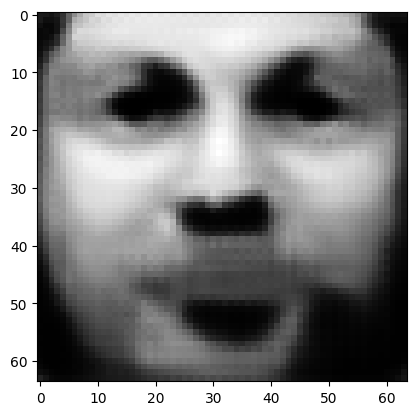

tensor([[1.7570e-07, 3.2292e-05, 1.0426e-03, 9.8057e-01, 2.6511e-06, 2.8783e-07,
         8.6708e-04, 1.3175e-06, 8.8383e-04, 1.0477e-05, 1.3090e-04, 1.5276e-05,
         2.7836e-04, 8.3598e-05, 4.9293e-04, 3.7082e-06, 7.7060e-05, 5.5422e-06,
         3.5367e-04, 4.0585e-04, 5.9120e-03, 1.9725e-03, 2.9132e-04, 1.4728e-04,
         2.3415e-05, 1.3086e-04, 2.6745e-04, 1.5106e-03, 8.3637e-04, 3.0744e-06,
         3.1906e-05, 1.8469e-05, 2.5258e-04, 2.5978e-04, 8.1376e-06, 3.5012e-06,
         1.1472e-03, 1.0637e-03, 8.4454e-04, 1.8931e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019622493535280228
tensor([[1.7548e-07, 3.2264e-05, 1.0416e-03, 9.8059e-01, 2.6478e-06, 2.8756e-07,
         8.6635e-04, 1.3160e-06, 8.8284e-04, 1.0463e-05, 1.3076e-04, 1.5255e-05,
         2.7807e-04, 8.3502e-05, 4.9244e-04, 3.7040e-06, 7.6965e-05, 5.5358e-06,
         3.5339e-04, 4.0557e-04, 5.9061e-03, 1.9707e-03, 2.9100e-04, 1.4713e-04,
         2.3379e-05, 1.3075e-04, 2.6719e-

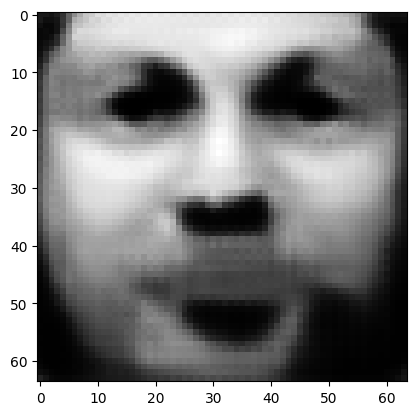

tensor([[1.7462e-07, 3.2154e-05, 1.0377e-03, 9.8066e-01, 2.6350e-06, 2.8652e-07,
         8.6355e-04, 1.3102e-06, 8.7898e-04, 1.0411e-05, 1.3020e-04, 1.5177e-05,
         2.7696e-04, 8.3130e-05, 4.9058e-04, 3.6878e-06, 7.6598e-05, 5.5110e-06,
         3.5228e-04, 4.0447e-04, 5.8832e-03, 1.9640e-03, 2.8980e-04, 1.4655e-04,
         2.3239e-05, 1.3034e-04, 2.6616e-04, 1.5036e-03, 8.3206e-04, 3.0519e-06,
         3.1692e-05, 1.8382e-05, 2.5134e-04, 2.5849e-04, 8.0764e-06, 3.4820e-06,
         1.1416e-03, 1.0579e-03, 8.4003e-04, 1.8804e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01952698640525341
tensor([[1.7441e-07, 3.2128e-05, 1.0367e-03, 9.8068e-01, 2.6319e-06, 2.8627e-07,
         8.6287e-04, 1.3089e-06, 8.7804e-04, 1.0398e-05, 1.3006e-04, 1.5157e-05,
         2.7669e-04, 8.3040e-05, 4.9012e-04, 3.6839e-06, 7.6510e-05, 5.5051e-06,
         3.5201e-04, 4.0421e-04, 5.8777e-03, 1.9623e-03, 2.8950e-04, 1.4641e-04,
         2.3204e-05, 1.3023e-04, 2.6592e-0

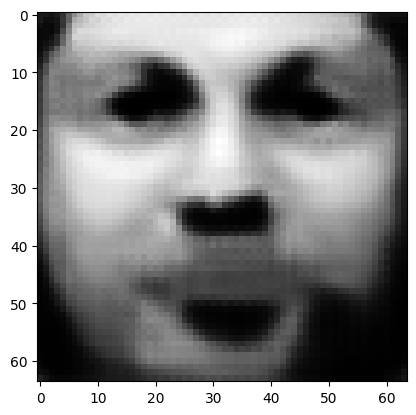

tensor([[1.7361e-07, 3.2025e-05, 1.0330e-03, 9.8075e-01, 2.6198e-06, 2.8528e-07,
         8.6024e-04, 1.3035e-06, 8.7442e-04, 1.0349e-05, 1.2954e-04, 1.5083e-05,
         2.7565e-04, 8.2690e-05, 4.8837e-04, 3.6687e-06, 7.6166e-05, 5.4818e-06,
         3.5098e-04, 4.0318e-04, 5.8561e-03, 1.9560e-03, 2.8836e-04, 1.4586e-04,
         2.3073e-05, 1.2984e-04, 2.6495e-04, 1.4971e-03, 8.2801e-04, 3.0309e-06,
         3.1492e-05, 1.8300e-05, 2.5017e-04, 2.5728e-04, 8.0189e-06, 3.4639e-06,
         1.1364e-03, 1.0526e-03, 8.3578e-04, 1.8685e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019437316805124283
tensor([[1.7341e-07, 3.2000e-05, 1.0321e-03, 9.8077e-01, 2.6169e-06, 2.8505e-07,
         8.5960e-04, 1.3022e-06, 8.7354e-04, 1.0337e-05, 1.2941e-04, 1.5065e-05,
         2.7540e-04, 8.2604e-05, 4.8795e-04, 3.6649e-06, 7.6083e-05, 5.4761e-06,
         3.5072e-04, 4.0293e-04, 5.8508e-03, 1.9545e-03, 2.8809e-04, 1.4573e-04,
         2.3041e-05, 1.2975e-04, 2.6472e-

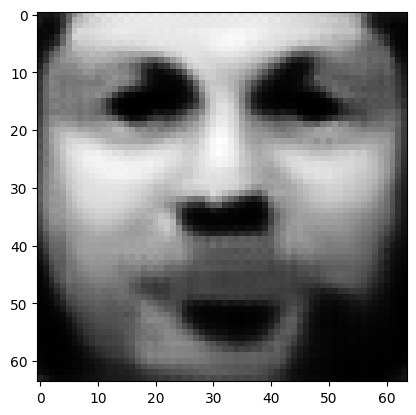

tensor([[1.7265e-07, 3.1902e-05, 1.0285e-03, 9.8083e-01, 2.6056e-06, 2.8412e-07,
         8.5712e-04, 1.2971e-06, 8.7013e-04, 1.0291e-05, 1.2891e-04, 1.4995e-05,
         2.7441e-04, 8.2274e-05, 4.8629e-04, 3.6506e-06, 7.5758e-05, 5.4542e-06,
         3.4974e-04, 4.0196e-04, 5.8306e-03, 1.9485e-03, 2.8702e-04, 1.4522e-04,
         2.2917e-05, 1.2938e-04, 2.6381e-04, 1.4909e-03, 8.2419e-04, 3.0111e-06,
         3.1303e-05, 1.8223e-05, 2.4907e-04, 2.5613e-04, 7.9650e-06, 3.4469e-06,
         1.1315e-03, 1.0475e-03, 8.3179e-04, 1.8572e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019352784380316734
tensor([[1.7247e-07, 3.1879e-05, 1.0277e-03, 9.8085e-01, 2.6028e-06, 2.8389e-07,
         8.5651e-04, 1.2959e-06, 8.6931e-04, 1.0280e-05, 1.2879e-04, 1.4978e-05,
         2.7417e-04, 8.2194e-05, 4.8589e-04, 3.6471e-06, 7.5680e-05, 5.4489e-06,
         3.4950e-04, 4.0172e-04, 5.8256e-03, 1.9470e-03, 2.8676e-04, 1.4509e-04,
         2.2887e-05, 1.2929e-04, 2.6359e-

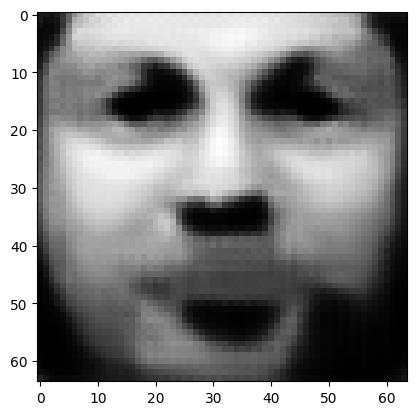

tensor([[1.7175e-07, 3.1787e-05, 1.0244e-03, 9.8091e-01, 2.5921e-06, 2.8302e-07,
         8.5417e-04, 1.2911e-06, 8.6608e-04, 1.0236e-05, 1.2832e-04, 1.4913e-05,
         2.7325e-04, 8.1884e-05, 4.8433e-04, 3.6336e-06, 7.5375e-05, 5.4283e-06,
         3.4858e-04, 4.0080e-04, 5.8065e-03, 1.9414e-03, 2.8575e-04, 1.4461e-04,
         2.2771e-05, 1.2894e-04, 2.6273e-04, 1.4852e-03, 8.2059e-04, 2.9924e-06,
         3.1126e-05, 1.8150e-05, 2.4803e-04, 2.5505e-04, 7.9142e-06, 3.4309e-06,
         1.1269e-03, 1.0427e-03, 8.2802e-04, 1.8467e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01927315630018711
tensor([[1.7158e-07, 3.1765e-05, 1.0236e-03, 9.8093e-01, 2.5895e-06, 2.8281e-07,
         8.5360e-04, 1.2899e-06, 8.6531e-04, 1.0226e-05, 1.2821e-04, 1.4897e-05,
         2.7302e-04, 8.1809e-05, 4.8395e-04, 3.6303e-06, 7.5301e-05, 5.4233e-06,
         3.4835e-04, 4.0058e-04, 5.8019e-03, 1.9400e-03, 2.8551e-04, 1.4449e-04,
         2.2743e-05, 1.2886e-04, 2.6253e-0

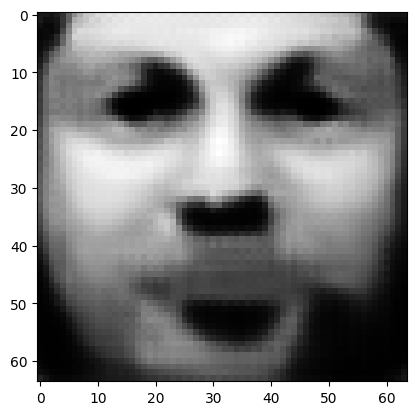

tensor([[1.7091e-07, 3.1678e-05, 1.0205e-03, 9.8099e-01, 2.5795e-06, 2.8199e-07,
         8.5140e-04, 1.2854e-06, 8.6228e-04, 1.0185e-05, 1.2777e-04, 1.4835e-05,
         2.7215e-04, 8.1515e-05, 4.8248e-04, 3.6176e-06, 7.5014e-05, 5.4038e-06,
         3.4748e-04, 3.9971e-04, 5.7838e-03, 1.9347e-03, 2.8456e-04, 1.4404e-04,
         2.2634e-05, 1.2853e-04, 2.6172e-04, 1.4797e-03, 8.1721e-04, 2.9749e-06,
         3.0959e-05, 1.8081e-05, 2.4706e-04, 2.5404e-04, 7.8665e-06, 3.4159e-06,
         1.1225e-03, 1.0382e-03, 8.2448e-04, 1.8367e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019198082387447357
tensor([[1.7075e-07, 3.1657e-05, 1.0197e-03, 9.8100e-01, 2.5771e-06, 2.8179e-07,
         8.5086e-04, 1.2843e-06, 8.6155e-04, 1.0175e-05, 1.2766e-04, 1.4820e-05,
         2.7194e-04, 8.1445e-05, 4.8212e-04, 3.6145e-06, 7.4945e-05, 5.3991e-06,
         3.4727e-04, 3.9950e-04, 5.7794e-03, 1.9334e-03, 2.8433e-04, 1.4393e-04,
         2.2607e-05, 1.2845e-04, 2.6152e-

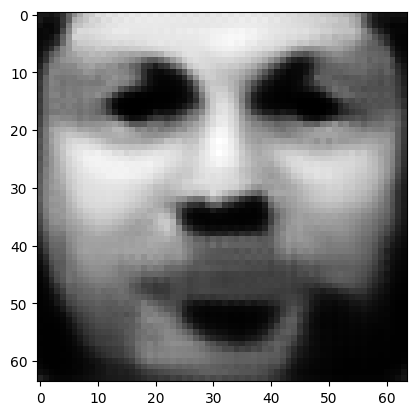

tensor([[1.7011e-07, 3.1575e-05, 1.0168e-03, 9.8105e-01, 2.5676e-06, 2.8101e-07,
         8.4877e-04, 1.2801e-06, 8.5869e-04, 1.0136e-05, 1.2725e-04, 1.4762e-05,
         2.7112e-04, 8.1169e-05, 4.8073e-04, 3.6025e-06, 7.4674e-05, 5.3808e-06,
         3.4644e-04, 3.9868e-04, 5.7624e-03, 1.9283e-03, 2.8343e-04, 1.4350e-04,
         2.2504e-05, 1.2814e-04, 2.6076e-04, 1.4745e-03, 8.1401e-04, 2.9584e-06,
         3.0801e-05, 1.8017e-05, 2.4614e-04, 2.5308e-04, 7.8215e-06, 3.4016e-06,
         1.1184e-03, 1.0339e-03, 8.2113e-04, 1.8274e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01912732794880867
tensor([[1.6996e-07, 3.1555e-05, 1.0161e-03, 9.8107e-01, 2.5653e-06, 2.8082e-07,
         8.4827e-04, 1.2791e-06, 8.5799e-04, 1.0127e-05, 1.2714e-04, 1.4747e-05,
         2.7092e-04, 8.1102e-05, 4.8039e-04, 3.5996e-06, 7.4608e-05, 5.3763e-06,
         3.4624e-04, 3.9848e-04, 5.7582e-03, 1.9271e-03, 2.8321e-04, 1.4339e-04,
         2.2479e-05, 1.2807e-04, 2.6058e-0

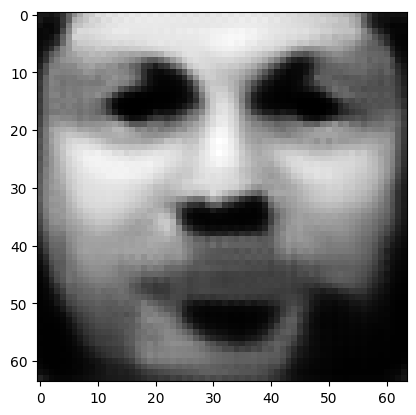

tensor([[1.6936e-07, 3.1478e-05, 1.0133e-03, 9.8112e-01, 2.5564e-06, 2.8009e-07,
         8.4630e-04, 1.2751e-06, 8.5530e-04, 1.0090e-05, 1.2675e-04, 1.4693e-05,
         2.7014e-04, 8.0842e-05, 4.7908e-04, 3.5883e-06, 7.4353e-05, 5.3591e-06,
         3.4547e-04, 3.9771e-04, 5.7422e-03, 1.9224e-03, 2.8237e-04, 1.4299e-04,
         2.2382e-05, 1.2778e-04, 2.5986e-04, 1.4697e-03, 8.1100e-04, 2.9429e-06,
         3.0653e-05, 1.7956e-05, 2.4527e-04, 2.5217e-04, 7.7792e-06, 3.3882e-06,
         1.1145e-03, 1.0299e-03, 8.1797e-04, 1.8186e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01906043104827404
tensor([[1.6922e-07, 3.1460e-05, 1.0126e-03, 9.8113e-01, 2.5542e-06, 2.7991e-07,
         8.4582e-04, 1.2741e-06, 8.5465e-04, 1.0082e-05, 1.2666e-04, 1.4679e-05,
         2.6995e-04, 8.0779e-05, 4.7876e-04, 3.5856e-06, 7.4291e-05, 5.3549e-06,
         3.4528e-04, 3.9752e-04, 5.7383e-03, 1.9212e-03, 2.8216e-04, 1.4289e-04,
         2.2359e-05, 1.2771e-04, 2.5969e-0

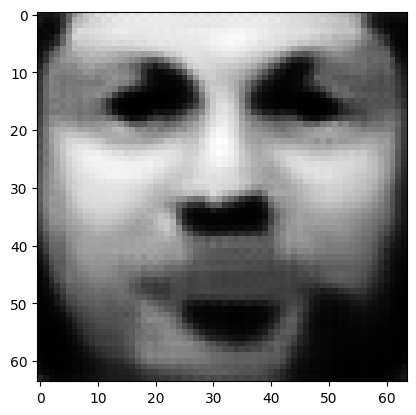

tensor([[1.6866e-07, 3.1387e-05, 1.0100e-03, 9.8118e-01, 2.5458e-06, 2.7923e-07,
         8.4398e-04, 1.2703e-06, 8.5212e-04, 1.0048e-05, 1.2629e-04, 1.4628e-05,
         2.6922e-04, 8.0533e-05, 4.7753e-04, 3.5749e-06, 7.4051e-05, 5.3386e-06,
         3.4454e-04, 3.9679e-04, 5.7231e-03, 1.9168e-03, 2.8137e-04, 1.4251e-04,
         2.2268e-05, 1.2743e-04, 2.5901e-04, 1.4651e-03, 8.0816e-04, 2.9283e-06,
         3.0513e-05, 1.7898e-05, 2.4445e-04, 2.5132e-04, 7.7394e-06, 3.3756e-06,
         1.1108e-03, 1.0261e-03, 8.1500e-04, 1.8102e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018997622653841972
tensor([[1.6852e-07, 3.1369e-05, 1.0094e-03, 9.8119e-01, 2.5437e-06, 2.7906e-07,
         8.4352e-04, 1.2694e-06, 8.5150e-04, 1.0039e-05, 1.2620e-04, 1.4615e-05,
         2.6904e-04, 8.0474e-05, 4.7723e-04, 3.5723e-06, 7.3993e-05, 5.3346e-06,
         3.4436e-04, 3.9661e-04, 5.7194e-03, 1.9157e-03, 2.8117e-04, 1.4242e-04,
         2.2245e-05, 1.2736e-04, 2.5884e-

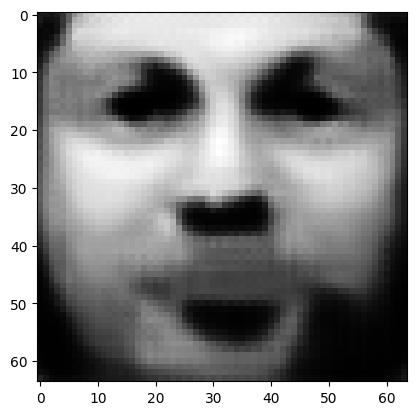

tensor([[1.6799e-07, 3.1300e-05, 1.0069e-03, 9.8124e-01, 2.5358e-06, 2.7840e-07,
         8.4177e-04, 1.2658e-06, 8.4910e-04, 1.0007e-05, 1.2585e-04, 1.4567e-05,
         2.6835e-04, 8.0243e-05, 4.7606e-04, 3.5623e-06, 7.3765e-05, 5.3193e-06,
         3.4367e-04, 3.9592e-04, 5.7051e-03, 1.9114e-03, 2.8042e-04, 1.4206e-04,
         2.2159e-05, 1.2711e-04, 2.5821e-04, 1.4608e-03, 8.0547e-04, 2.9145e-06,
         3.0382e-05, 1.7844e-05, 2.4367e-04, 2.5051e-04, 7.7019e-06, 3.3637e-06,
         1.1073e-03, 1.0226e-03, 8.1219e-04, 1.8024e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018938085064291954
tensor([[1.6786e-07, 3.1284e-05, 1.0063e-03, 9.8125e-01, 2.5339e-06, 2.7824e-07,
         8.4134e-04, 1.2650e-06, 8.4852e-04, 9.9989e-06, 1.2576e-04, 1.4555e-05,
         2.6818e-04, 8.0187e-05, 4.7578e-04, 3.5598e-06, 7.3710e-05, 5.3156e-06,
         3.4350e-04, 3.9575e-04, 5.7017e-03, 1.9104e-03, 2.8024e-04, 1.4197e-04,
         2.2138e-05, 1.2704e-04, 2.5805e-

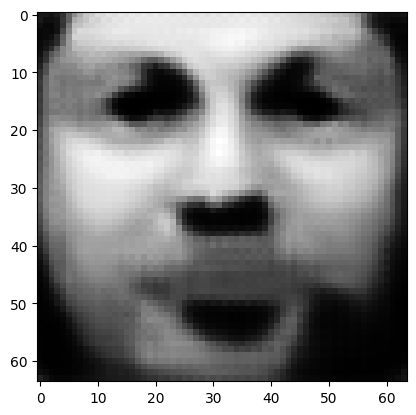

tensor([[1.6736e-07, 3.1219e-05, 1.0039e-03, 9.8130e-01, 2.5264e-06, 2.7763e-07,
         8.3969e-04, 1.2616e-06, 8.4626e-04, 9.9685e-06, 1.2543e-04, 1.4509e-05,
         2.6753e-04, 7.9968e-05, 4.7467e-04, 3.5504e-06, 7.3496e-05, 5.3011e-06,
         3.4285e-04, 3.9510e-04, 5.6881e-03, 1.9064e-03, 2.7953e-04, 1.4163e-04,
         2.2057e-05, 1.2680e-04, 2.5745e-04, 1.4567e-03, 8.0293e-04, 2.9015e-06,
         3.0257e-05, 1.7792e-05, 2.4294e-04, 2.4975e-04, 7.6665e-06, 3.3524e-06,
         1.1040e-03, 1.0192e-03, 8.0953e-04, 1.7951e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018881935626268387
tensor([[1.6724e-07, 3.1203e-05, 1.0034e-03, 9.8131e-01, 2.5246e-06, 2.7748e-07,
         8.3928e-04, 1.2608e-06, 8.4571e-04, 9.9610e-06, 1.2535e-04, 1.4498e-05,
         2.6737e-04, 7.9915e-05, 4.7440e-04, 3.5480e-06, 7.3444e-05, 5.2976e-06,
         3.4269e-04, 3.9494e-04, 5.6849e-03, 1.9054e-03, 2.7935e-04, 1.4154e-04,
         2.2037e-05, 1.2674e-04, 2.5730e-

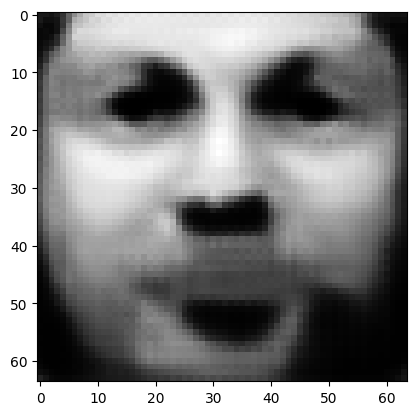

tensor([[1.6677e-07, 3.1141e-05, 1.0012e-03, 9.8135e-01, 2.5175e-06, 2.7690e-07,
         8.3772e-04, 1.2576e-06, 8.4358e-04, 9.9323e-06, 1.2504e-04, 1.4454e-05,
         2.6676e-04, 7.9708e-05, 4.7336e-04, 3.5391e-06, 7.3242e-05, 5.2838e-06,
         3.4207e-04, 3.9432e-04, 5.6721e-03, 1.9016e-03, 2.7868e-04, 1.4122e-04,
         2.1961e-05, 1.2650e-04, 2.5673e-04, 1.4528e-03, 8.0054e-04, 2.8892e-06,
         3.0140e-05, 1.7744e-05, 2.4225e-04, 2.4903e-04, 7.6331e-06, 3.3418e-06,
         1.1009e-03, 1.0160e-03, 8.0703e-04, 1.7881e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018828826025128365
tensor([[1.6665e-07, 3.1126e-05, 1.0006e-03, 9.8136e-01, 2.5158e-06, 2.7675e-07,
         8.3734e-04, 1.2569e-06, 8.4305e-04, 9.9252e-06, 1.2497e-04, 1.4443e-05,
         2.6661e-04, 7.9657e-05, 4.7311e-04, 3.5369e-06, 7.3192e-05, 5.2805e-06,
         3.4191e-04, 3.9417e-04, 5.6689e-03, 1.9007e-03, 2.7852e-04, 1.4114e-04,
         2.1943e-05, 1.2645e-04, 2.5659e-

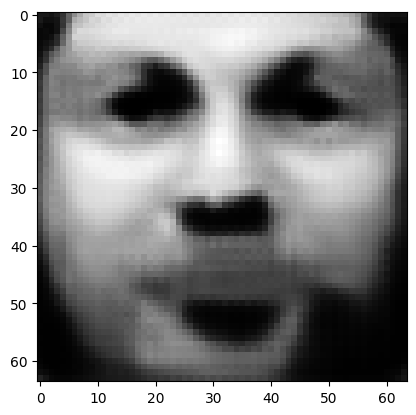

tensor([[1.6620e-07, 3.1068e-05, 9.9855e-04, 9.8140e-01, 2.5091e-06, 2.7620e-07,
         8.3586e-04, 1.2539e-06, 8.4104e-04, 9.8981e-06, 1.2467e-04, 1.4402e-05,
         2.6602e-04, 7.9462e-05, 4.7212e-04, 3.5284e-06, 7.3001e-05, 5.2675e-06,
         3.4133e-04, 3.9359e-04, 5.6568e-03, 1.8971e-03, 2.7788e-04, 1.4084e-04,
         2.1870e-05, 1.2623e-04, 2.5605e-04, 1.4492e-03, 7.9828e-04, 2.8777e-06,
         3.0029e-05, 1.7698e-05, 2.4160e-04, 2.4835e-04, 7.6016e-06, 3.3317e-06,
         1.0980e-03, 1.0130e-03, 8.0466e-04, 1.7815e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018778404220938683
tensor([[1.6610e-07, 3.1054e-05, 9.9804e-04, 9.8141e-01, 2.5075e-06, 2.7607e-07,
         8.3549e-04, 1.2531e-06, 8.4055e-04, 9.8914e-06, 1.2460e-04, 1.4392e-05,
         2.6588e-04, 7.9415e-05, 4.7188e-04, 3.5263e-06, 7.2954e-05, 5.2644e-06,
         3.4119e-04, 3.9345e-04, 5.6539e-03, 1.8963e-03, 2.7773e-04, 1.4077e-04,
         2.1853e-05, 1.2617e-04, 2.5592e-

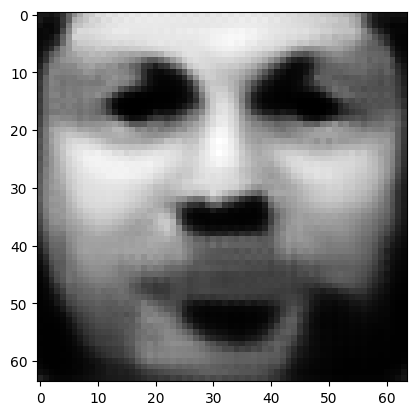

tensor([[1.6567e-07, 3.0999e-05, 9.9607e-04, 9.8144e-01, 2.5011e-06, 2.7555e-07,
         8.3410e-04, 1.2503e-06, 8.3864e-04, 9.8658e-06, 1.2432e-04, 1.4354e-05,
         2.6533e-04, 7.9230e-05, 4.7095e-04, 3.5183e-06, 7.2774e-05, 5.2522e-06,
         3.4063e-04, 3.9289e-04, 5.6425e-03, 1.8929e-03, 2.7713e-04, 1.4048e-04,
         2.1785e-05, 1.2596e-04, 2.5541e-04, 1.4457e-03, 7.9614e-04, 2.8667e-06,
         2.9924e-05, 1.7655e-05, 2.4098e-04, 2.4771e-04, 7.5718e-06, 3.3222e-06,
         1.0952e-03, 1.0102e-03, 8.0242e-04, 1.7752e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018730903044342995
tensor([[1.6557e-07, 3.0986e-05, 9.9559e-04, 9.8145e-01, 2.4996e-06, 2.7542e-07,
         8.3375e-04, 1.2496e-06, 8.3818e-04, 9.8595e-06, 1.2425e-04, 1.4344e-05,
         2.6519e-04, 7.9186e-05, 4.7072e-04, 3.5164e-06, 7.2730e-05, 5.2492e-06,
         3.4050e-04, 3.9276e-04, 5.6397e-03, 1.8921e-03, 2.7698e-04, 1.4041e-04,
         2.1768e-05, 1.2591e-04, 2.5528e-

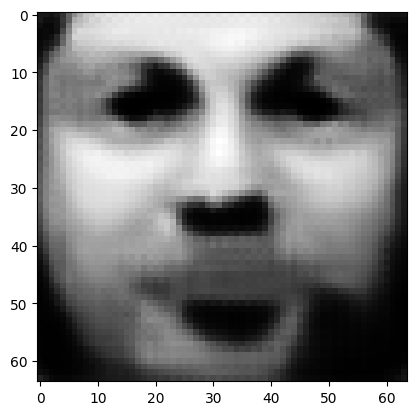

tensor([[1.6517e-07, 3.0933e-05, 9.9372e-04, 9.8149e-01, 2.4937e-06, 2.7493e-07,
         8.3243e-04, 1.2469e-06, 8.3638e-04, 9.8353e-06, 1.2399e-04, 1.4308e-05,
         2.6467e-04, 7.9010e-05, 4.6984e-04, 3.5088e-06, 7.2559e-05, 5.2376e-06,
         3.3997e-04, 3.9223e-04, 5.6289e-03, 1.8889e-03, 2.7642e-04, 1.4014e-04,
         2.1704e-05, 1.2572e-04, 2.5480e-04, 1.4424e-03, 7.9411e-04, 2.8564e-06,
         2.9825e-05, 1.7613e-05, 2.4040e-04, 2.4710e-04, 7.5437e-06, 3.3132e-06,
         1.0926e-03, 1.0075e-03, 8.0030e-04, 1.7694e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018685976043343544
tensor([[1.6507e-07, 3.0920e-05, 9.9327e-04, 9.8150e-01, 2.4922e-06, 2.7481e-07,
         8.3211e-04, 1.2463e-06, 8.3594e-04, 9.8294e-06, 1.2393e-04, 1.4299e-05,
         2.6455e-04, 7.8967e-05, 4.6963e-04, 3.5070e-06, 7.2518e-05, 5.2348e-06,
         3.3984e-04, 3.9211e-04, 5.6262e-03, 1.8881e-03, 2.7628e-04, 1.4007e-04,
         2.1688e-05, 1.2567e-04, 2.5468e-

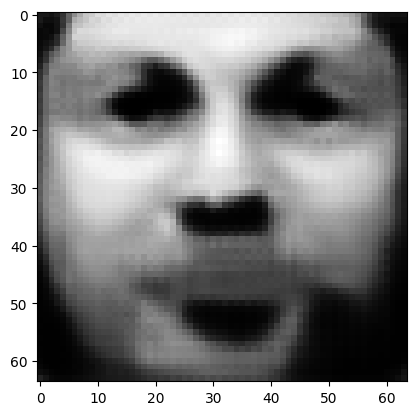

tensor([[1.6470e-07, 3.0871e-05, 9.9151e-04, 9.8153e-01, 2.4865e-06, 2.7434e-07,
         8.3085e-04, 1.2438e-06, 8.3423e-04, 9.8064e-06, 1.2368e-04, 1.4264e-05,
         2.6405e-04, 7.8803e-05, 4.6879e-04, 3.4998e-06, 7.2356e-05, 5.2238e-06,
         3.3934e-04, 3.9161e-04, 5.6160e-03, 1.8850e-03, 2.7574e-04, 1.3981e-04,
         2.1627e-05, 1.2548e-04, 2.5423e-04, 1.4393e-03, 7.9220e-04, 2.8466e-06,
         2.9731e-05, 1.7574e-05, 2.3984e-04, 2.4652e-04, 7.5171e-06, 3.3047e-06,
         1.0901e-03, 1.0049e-03, 7.9830e-04, 1.7638e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01864350400865078
tensor([[1.6461e-07, 3.0859e-05, 9.9107e-04, 9.8154e-01, 2.4852e-06, 2.7423e-07,
         8.3055e-04, 1.2431e-06, 8.3382e-04, 9.8008e-06, 1.2362e-04, 1.4256e-05,
         2.6393e-04, 7.8762e-05, 4.6859e-04, 3.4980e-06, 7.2317e-05, 5.2212e-06,
         3.3922e-04, 3.9149e-04, 5.6135e-03, 1.8843e-03, 2.7561e-04, 1.3975e-04,
         2.1612e-05, 1.2544e-04, 2.5412e-0

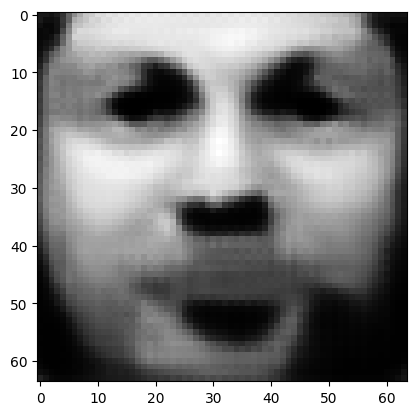

tensor([[1.6425e-07, 3.0813e-05, 9.8941e-04, 9.8157e-01, 2.4798e-06, 2.7379e-07,
         8.2936e-04, 1.2407e-06, 8.3221e-04, 9.7791e-06, 1.2338e-04, 1.4223e-05,
         2.6347e-04, 7.8606e-05, 4.6780e-04, 3.4913e-06, 7.2164e-05, 5.2108e-06,
         3.3875e-04, 3.9102e-04, 5.6038e-03, 1.8814e-03, 2.7510e-04, 1.3951e-04,
         2.1555e-05, 1.2526e-04, 2.5368e-04, 1.4364e-03, 7.9039e-04, 2.8374e-06,
         2.9643e-05, 1.7538e-05, 2.3932e-04, 2.4598e-04, 7.4920e-06, 3.2966e-06,
         1.0878e-03, 1.0025e-03, 7.9640e-04, 1.7585e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0186033695936203
tensor([[1.6416e-07, 3.0801e-05, 9.8900e-04, 9.8158e-01, 2.4785e-06, 2.7368e-07,
         8.2908e-04, 1.2402e-06, 8.3182e-04, 9.7738e-06, 1.2332e-04, 1.4215e-05,
         2.6335e-04, 7.8568e-05, 4.6761e-04, 3.4896e-06, 7.2127e-05, 5.2083e-06,
         3.3864e-04, 3.9090e-04, 5.6015e-03, 1.8807e-03, 2.7498e-04, 1.3945e-04,
         2.1541e-05, 1.2522e-04, 2.5358e-04

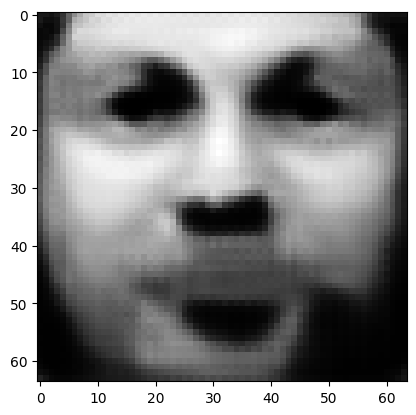

tensor([[1.6382e-07, 3.0757e-05, 9.8742e-04, 9.8161e-01, 2.4735e-06, 2.7326e-07,
         8.2795e-04, 1.2379e-06, 8.3029e-04, 9.7533e-06, 1.2310e-04, 1.4184e-05,
         2.6291e-04, 7.8420e-05, 4.6686e-04, 3.4832e-06, 7.1983e-05, 5.1985e-06,
         3.3819e-04, 3.9046e-04, 5.5923e-03, 1.8780e-03, 2.7450e-04, 1.3922e-04,
         2.1486e-05, 1.2505e-04, 2.5317e-04, 1.4336e-03, 7.8867e-04, 2.8287e-06,
         2.9559e-05, 1.7503e-05, 2.3883e-04, 2.4546e-04, 7.4683e-06, 3.2890e-06,
         1.0855e-03, 1.0002e-03, 7.9461e-04, 1.7535e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018565339967608452
tensor([[1.6374e-07, 3.0746e-05, 9.8703e-04, 9.8161e-01, 2.4722e-06, 2.7316e-07,
         8.2768e-04, 1.2373e-06, 8.2992e-04, 9.7484e-06, 1.2305e-04, 1.4176e-05,
         2.6280e-04, 7.8384e-05, 4.6667e-04, 3.4816e-06, 7.1948e-05, 5.1961e-06,
         3.3808e-04, 3.9035e-04, 5.5900e-03, 1.8774e-03, 2.7438e-04, 1.3916e-04,
         2.1473e-05, 1.2501e-04, 2.5307e-

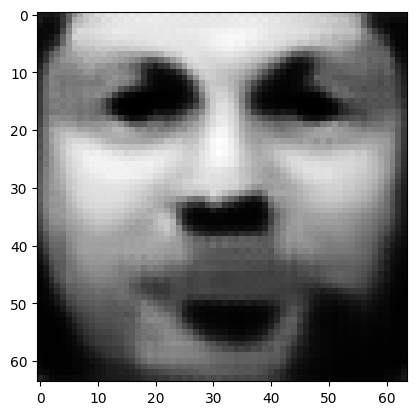

tensor([[1.6342e-07, 3.0704e-05, 9.8553e-04, 9.8164e-01, 2.4674e-06, 2.7277e-07,
         8.2662e-04, 1.2352e-06, 8.2847e-04, 9.7289e-06, 1.2284e-04, 1.4147e-05,
         2.6238e-04, 7.8244e-05, 4.6597e-04, 3.4756e-06, 7.1811e-05, 5.1869e-06,
         3.3766e-04, 3.8993e-04, 5.5814e-03, 1.8748e-03, 2.7393e-04, 1.3894e-04,
         2.1422e-05, 1.2485e-04, 2.5268e-04, 1.4310e-03, 7.8705e-04, 2.8204e-06,
         2.9480e-05, 1.7470e-05, 2.3836e-04, 2.4497e-04, 7.4459e-06, 3.2818e-06,
         1.0834e-03, 9.9809e-04, 7.9291e-04, 1.7488e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018529297783970833
tensor([[1.6334e-07, 3.0694e-05, 9.8517e-04, 9.8165e-01, 2.4663e-06, 2.7267e-07,
         8.2635e-04, 1.2347e-06, 8.2812e-04, 9.7241e-06, 1.2279e-04, 1.4140e-05,
         2.6228e-04, 7.8210e-05, 4.6579e-04, 3.4741e-06, 7.1778e-05, 5.1846e-06,
         3.3756e-04, 3.8982e-04, 5.5793e-03, 1.8742e-03, 2.7382e-04, 1.3889e-04,
         2.1409e-05, 1.2481e-04, 2.5259e-

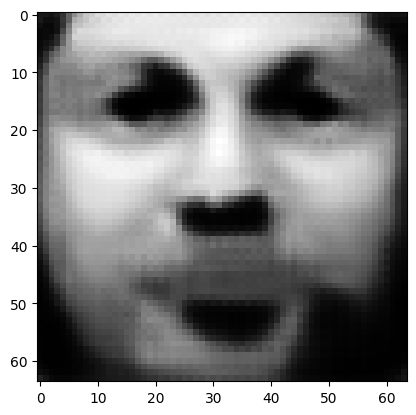

tensor([[1.6304e-07, 3.0655e-05, 9.8375e-04, 9.8167e-01, 2.4617e-06, 2.7229e-07,
         8.2535e-04, 1.2326e-06, 8.2675e-04, 9.7058e-06, 1.2259e-04, 1.4112e-05,
         2.6189e-04, 7.8078e-05, 4.6512e-04, 3.4683e-06, 7.1649e-05, 5.1758e-06,
         3.3716e-04, 3.8942e-04, 5.5710e-03, 1.8717e-03, 2.7338e-04, 1.3868e-04,
         2.1360e-05, 1.2466e-04, 2.5222e-04, 1.4285e-03, 7.8551e-04, 2.8126e-06,
         2.9405e-05, 1.7439e-05, 2.3791e-04, 2.4451e-04, 7.4246e-06, 3.2749e-06,
         1.0814e-03, 9.9605e-04, 7.9131e-04, 1.7444e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01849512755870819
tensor([[1.6297e-07, 3.0645e-05, 9.8341e-04, 9.8168e-01, 2.4607e-06, 2.7220e-07,
         8.2511e-04, 1.2322e-06, 8.2642e-04, 9.7013e-06, 1.2254e-04, 1.4105e-05,
         2.6179e-04, 7.8046e-05, 4.6496e-04, 3.4670e-06, 7.1617e-05, 5.1737e-06,
         3.3706e-04, 3.8933e-04, 5.5690e-03, 1.8711e-03, 2.7328e-04, 1.3863e-04,
         2.1349e-05, 1.2463e-04, 2.5213e-0

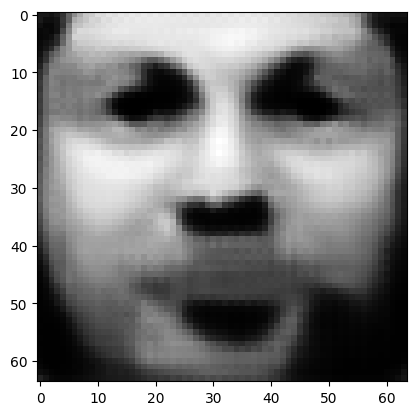

tensor([[1.6268e-07, 3.0607e-05, 9.8206e-04, 9.8171e-01, 2.4564e-06, 2.7185e-07,
         8.2415e-04, 1.2302e-06, 8.2513e-04, 9.6839e-06, 1.2235e-04, 1.4079e-05,
         2.6141e-04, 7.7920e-05, 4.6432e-04, 3.4615e-06, 7.1495e-05, 5.1654e-06,
         3.3668e-04, 3.8895e-04, 5.5612e-03, 1.8688e-03, 2.7287e-04, 1.3844e-04,
         2.1303e-05, 1.2448e-04, 2.5178e-04, 1.4262e-03, 7.8406e-04, 2.8052e-06,
         2.9334e-05, 1.7409e-05, 2.3749e-04, 2.4407e-04, 7.4045e-06, 3.2685e-06,
         1.0796e-03, 9.9412e-04, 7.8978e-04, 1.7402e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018462827429175377
tensor([[1.6261e-07, 3.0598e-05, 9.8174e-04, 9.8171e-01, 2.4553e-06, 2.7176e-07,
         8.2392e-04, 1.2298e-06, 8.2481e-04, 9.6797e-06, 1.2230e-04, 1.4073e-05,
         2.6132e-04, 7.7890e-05, 4.6417e-04, 3.4602e-06, 7.1465e-05, 5.1634e-06,
         3.3659e-04, 3.8885e-04, 5.5593e-03, 1.8683e-03, 2.7277e-04, 1.3839e-04,
         2.1291e-05, 1.2445e-04, 2.5170e-

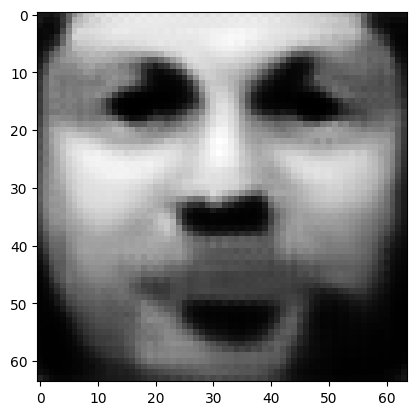

tensor([[1.6234e-07, 3.0563e-05, 9.8046e-04, 9.8174e-01, 2.4513e-06, 2.7143e-07,
         8.2301e-04, 1.2279e-06, 8.2358e-04, 9.6632e-06, 1.2212e-04, 1.4048e-05,
         2.6097e-04, 7.7771e-05, 4.6357e-04, 3.4550e-06, 7.1349e-05, 5.1555e-06,
         3.3623e-04, 3.8850e-04, 5.5519e-03, 1.8661e-03, 2.7239e-04, 1.3820e-04,
         2.1248e-05, 1.2431e-04, 2.5137e-04, 1.4239e-03, 7.8268e-04, 2.7982e-06,
         2.9267e-05, 1.7381e-05, 2.3709e-04, 2.4365e-04, 7.3855e-06, 3.2624e-06,
         1.0778e-03, 9.9229e-04, 7.8834e-04, 1.7362e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01843228191137314
tensor([[1.6228e-07, 3.0554e-05, 9.8015e-04, 9.8174e-01, 2.4503e-06, 2.7134e-07,
         8.2279e-04, 1.2275e-06, 8.2329e-04, 9.6592e-06, 1.2208e-04, 1.4042e-05,
         2.6088e-04, 7.7742e-05, 4.6342e-04, 3.4538e-06, 7.1321e-05, 5.1536e-06,
         3.3614e-04, 3.8841e-04, 5.5502e-03, 1.8656e-03, 2.7229e-04, 1.3816e-04,
         2.1237e-05, 1.2428e-04, 2.5129e-0

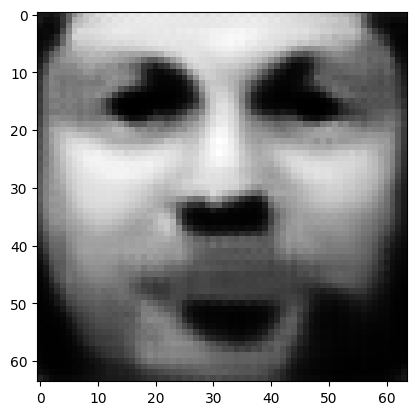

tensor([[1.6202e-07, 3.0520e-05, 9.7895e-04, 9.8177e-01, 2.4464e-06, 2.7103e-07,
         8.2194e-04, 1.2258e-06, 8.2212e-04, 9.6436e-06, 1.2191e-04, 1.4018e-05,
         2.6054e-04, 7.7629e-05, 4.6285e-04, 3.4489e-06, 7.1211e-05, 5.1461e-06,
         3.3580e-04, 3.8807e-04, 5.5432e-03, 1.8635e-03, 2.7193e-04, 1.3798e-04,
         2.1196e-05, 1.2415e-04, 2.5098e-04, 1.4218e-03, 7.8137e-04, 2.7916e-06,
         2.9203e-05, 1.7355e-05, 2.3672e-04, 2.4326e-04, 7.3675e-06, 3.2566e-06,
         1.0761e-03, 9.9055e-04, 7.8697e-04, 1.7324e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01840314082801342
tensor([[1.6196e-07, 3.0512e-05, 9.7865e-04, 9.8177e-01, 2.4455e-06, 2.7095e-07,
         8.2173e-04, 1.2254e-06, 8.2184e-04, 9.6398e-06, 1.2187e-04, 1.4012e-05,
         2.6046e-04, 7.7602e-05, 4.6271e-04, 3.4477e-06, 7.1185e-05, 5.1443e-06,
         3.3572e-04, 3.8798e-04, 5.5414e-03, 1.8630e-03, 2.7184e-04, 1.3794e-04,
         2.1186e-05, 1.2412e-04, 2.5090e-0

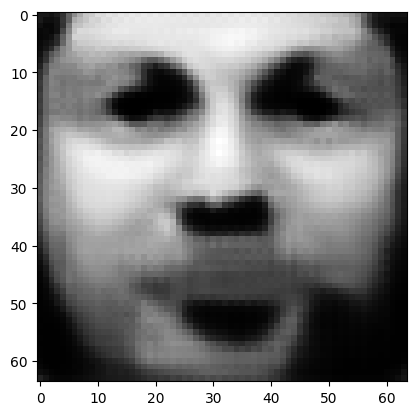

tensor([[1.6171e-07, 3.0480e-05, 9.7751e-04, 9.8179e-01, 2.4419e-06, 2.7065e-07,
         8.2092e-04, 1.2237e-06, 8.2074e-04, 9.6250e-06, 1.2171e-04, 1.3990e-05,
         2.6014e-04, 7.7495e-05, 4.6217e-04, 3.4431e-06, 7.1081e-05, 5.1372e-06,
         3.3540e-04, 3.8766e-04, 5.5348e-03, 1.8610e-03, 2.7149e-04, 1.3777e-04,
         2.1147e-05, 1.2400e-04, 2.5061e-04, 1.4198e-03, 7.8013e-04, 2.7853e-06,
         2.9143e-05, 1.7330e-05, 2.3636e-04, 2.4289e-04, 7.3505e-06, 3.2511e-06,
         1.0745e-03, 9.8890e-04, 7.8568e-04, 1.7288e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018375754356384277
tensor([[1.6166e-07, 3.0472e-05, 9.7723e-04, 9.8180e-01, 2.4410e-06, 2.7057e-07,
         8.2072e-04, 1.2233e-06, 8.2047e-04, 9.6214e-06, 1.2167e-04, 1.3985e-05,
         2.6006e-04, 7.7469e-05, 4.6204e-04, 3.4419e-06, 7.1055e-05, 5.1355e-06,
         3.3532e-04, 3.8758e-04, 5.5332e-03, 1.8605e-03, 2.7141e-04, 1.3773e-04,
         2.1137e-05, 1.2397e-04, 2.5054e-

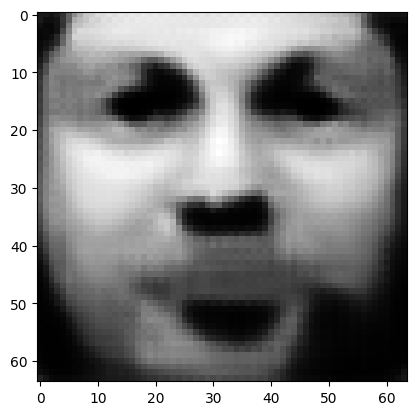

tensor([[1.6143e-07, 3.0442e-05, 9.7614e-04, 9.8182e-01, 2.4375e-06, 2.7029e-07,
         8.1995e-04, 1.2218e-06, 8.1943e-04, 9.6074e-06, 1.2152e-04, 1.3964e-05,
         2.5976e-04, 7.7368e-05, 4.6153e-04, 3.4376e-06, 7.0957e-05, 5.1288e-06,
         3.3501e-04, 3.8727e-04, 5.5269e-03, 1.8587e-03, 2.7108e-04, 1.3758e-04,
         2.1100e-05, 1.2386e-04, 2.5026e-04, 1.4179e-03, 7.7896e-04, 2.7793e-06,
         2.9086e-05, 1.7306e-05, 2.3602e-04, 2.4253e-04, 7.3344e-06, 3.2459e-06,
         1.0729e-03, 9.8735e-04, 7.8446e-04, 1.7254e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018349772319197655
tensor([[1.6137e-07, 3.0435e-05, 9.7588e-04, 9.8182e-01, 2.4367e-06, 2.7022e-07,
         8.1976e-04, 1.2214e-06, 8.1918e-04, 9.6040e-06, 1.2148e-04, 1.3959e-05,
         2.5969e-04, 7.7343e-05, 4.6140e-04, 3.4365e-06, 7.0933e-05, 5.1272e-06,
         3.3494e-04, 3.8720e-04, 5.5254e-03, 1.8582e-03, 2.7100e-04, 1.3754e-04,
         2.1091e-05, 1.2383e-04, 2.5019e-

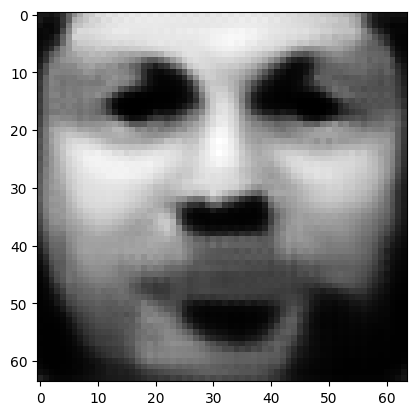

tensor([[1.6115e-07, 3.0406e-05, 9.7485e-04, 9.8184e-01, 2.4334e-06, 2.6995e-07,
         8.1903e-04, 1.2199e-06, 8.1819e-04, 9.5907e-06, 1.2133e-04, 1.3939e-05,
         2.5940e-04, 7.7248e-05, 4.6092e-04, 3.4323e-06, 7.0840e-05, 5.1209e-06,
         3.3465e-04, 3.8691e-04, 5.5195e-03, 1.8565e-03, 2.7069e-04, 1.3739e-04,
         2.1056e-05, 1.2372e-04, 2.4992e-04, 1.4161e-03, 7.7785e-04, 2.7737e-06,
         2.9032e-05, 1.7283e-05, 2.3570e-04, 2.4220e-04, 7.3191e-06, 3.2409e-06,
         1.0715e-03, 9.8587e-04, 7.8330e-04, 1.7222e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0183249581605196
tensor([[1.6110e-07, 3.0399e-05, 9.7460e-04, 9.8185e-01, 2.4326e-06, 2.6988e-07,
         8.1886e-04, 1.2196e-06, 8.1795e-04, 9.5875e-06, 1.2130e-04, 1.3934e-05,
         2.5933e-04, 7.7224e-05, 4.6080e-04, 3.4313e-06, 7.0817e-05, 5.1193e-06,
         3.3458e-04, 3.8684e-04, 5.5180e-03, 1.8560e-03, 2.7061e-04, 1.3735e-04,
         2.1048e-05, 1.2370e-04, 2.4986e-04

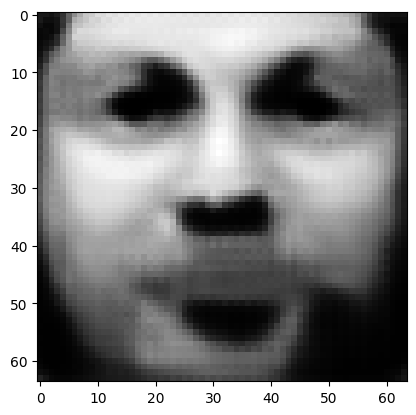

tensor([[1.6089e-07, 3.0371e-05, 9.7363e-04, 9.8186e-01, 2.4296e-06, 2.6962e-07,
         8.1816e-04, 1.2182e-06, 8.1701e-04, 9.5749e-06, 1.2116e-04, 1.3915e-05,
         2.5906e-04, 7.7134e-05, 4.6034e-04, 3.4274e-06, 7.0729e-05, 5.1133e-06,
         3.3430e-04, 3.8656e-04, 5.5124e-03, 1.8544e-03, 2.7032e-04, 1.3721e-04,
         2.1015e-05, 1.2359e-04, 2.4961e-04, 1.4144e-03, 7.7679e-04, 2.7684e-06,
         2.8981e-05, 1.7262e-05, 2.3539e-04, 2.4188e-04, 7.3046e-06, 3.2363e-06,
         1.0701e-03, 9.8447e-04, 7.8220e-04, 1.7191e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018301548436284065
tensor([[1.6084e-07, 3.0365e-05, 9.7339e-04, 9.8187e-01, 2.4288e-06, 2.6956e-07,
         8.1799e-04, 1.2178e-06, 8.1678e-04, 9.5719e-06, 1.2113e-04, 1.3910e-05,
         2.5899e-04, 7.7112e-05, 4.6023e-04, 3.4264e-06, 7.0707e-05, 5.1119e-06,
         3.3424e-04, 3.8650e-04, 5.5110e-03, 1.8540e-03, 2.7025e-04, 1.3718e-04,
         2.1007e-05, 1.2357e-04, 2.4955e-

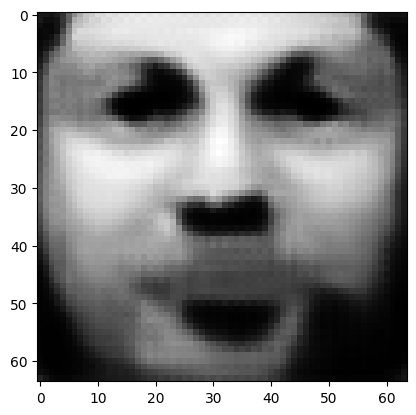

tensor([[1.6065e-07, 3.0339e-05, 9.7246e-04, 9.8189e-01, 2.4259e-06, 2.6931e-07,
         8.1734e-04, 1.2165e-06, 8.1590e-04, 9.5600e-06, 1.2100e-04, 1.3892e-05,
         2.5874e-04, 7.7025e-05, 4.5979e-04, 3.4227e-06, 7.0623e-05, 5.1062e-06,
         3.3398e-04, 3.8623e-04, 5.5057e-03, 1.8524e-03, 2.6996e-04, 1.3704e-04,
         2.0975e-05, 1.2347e-04, 2.4931e-04, 1.4128e-03, 7.7579e-04, 2.7633e-06,
         2.8933e-05, 1.7242e-05, 2.3511e-04, 2.4158e-04, 7.2909e-06, 3.2318e-06,
         1.0688e-03, 9.8314e-04, 7.8115e-04, 1.7163e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0182794276624918
tensor([[1.6060e-07, 3.0333e-05, 9.7224e-04, 9.8189e-01, 2.4252e-06, 2.6926e-07,
         8.1718e-04, 1.2162e-06, 8.1568e-04, 9.5571e-06, 1.2097e-04, 1.3888e-05,
         2.5867e-04, 7.7005e-05, 4.5969e-04, 3.4218e-06, 7.0603e-05, 5.1048e-06,
         3.3391e-04, 3.8617e-04, 5.5044e-03, 1.8520e-03, 2.6990e-04, 1.3701e-04,
         2.0968e-05, 1.2345e-04, 2.4925e-04

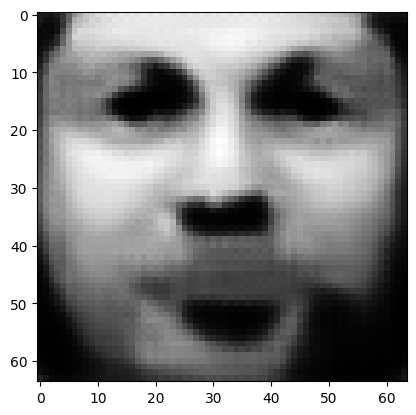

tensor([[1.6041e-07, 3.0308e-05, 9.7136e-04, 9.8191e-01, 2.4224e-06, 2.6902e-07,
         8.1656e-04, 1.2149e-06, 8.1484e-04, 9.5458e-06, 1.2084e-04, 1.3871e-05,
         2.5843e-04, 7.6923e-05, 4.5927e-04, 3.4182e-06, 7.0524e-05, 5.0994e-06,
         3.3367e-04, 3.8592e-04, 5.4993e-03, 1.8505e-03, 2.6963e-04, 1.3688e-04,
         2.0938e-05, 1.2335e-04, 2.4902e-04, 1.4113e-03, 7.7484e-04, 2.7585e-06,
         2.8887e-05, 1.7223e-05, 2.3483e-04, 2.4129e-04, 7.2779e-06, 3.2276e-06,
         1.0676e-03, 9.8189e-04, 7.8016e-04, 1.7135e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0182584747672081
tensor([[1.6037e-07, 3.0302e-05, 9.7115e-04, 9.8191e-01, 2.4217e-06, 2.6897e-07,
         8.1641e-04, 1.2146e-06, 8.1463e-04, 9.5430e-06, 1.2081e-04, 1.3867e-05,
         2.5837e-04, 7.6903e-05, 4.5917e-04, 3.4174e-06, 7.0504e-05, 5.0981e-06,
         3.3360e-04, 3.8586e-04, 5.4981e-03, 1.8501e-03, 2.6957e-04, 1.3685e-04,
         2.0930e-05, 1.2333e-04, 2.4897e-04

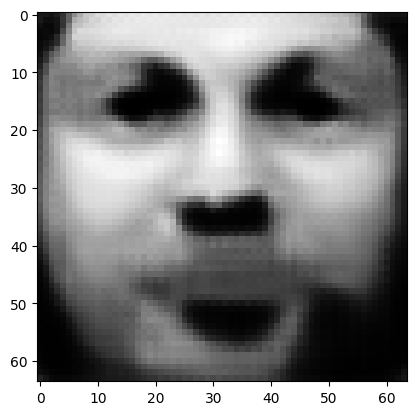

tensor([[1.6019e-07, 3.0279e-05, 9.7032e-04, 9.8193e-01, 2.4191e-06, 2.6875e-07,
         8.1581e-04, 1.2135e-06, 8.1383e-04, 9.5323e-06, 1.2070e-04, 1.3851e-05,
         2.5814e-04, 7.6826e-05, 4.5878e-04, 3.4140e-06, 7.0429e-05, 5.0930e-06,
         3.3337e-04, 3.8563e-04, 5.4933e-03, 1.8487e-03, 2.6932e-04, 1.3673e-04,
         2.0902e-05, 1.2324e-04, 2.4875e-04, 1.4098e-03, 7.7395e-04, 2.7540e-06,
         2.8843e-05, 1.7204e-05, 2.3457e-04, 2.4102e-04, 7.2656e-06, 3.2236e-06,
         1.0664e-03, 9.8069e-04, 7.7922e-04, 1.7109e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018238341435790062
tensor([[1.6015e-07, 3.0273e-05, 9.7012e-04, 9.8193e-01, 2.4184e-06, 2.6869e-07,
         8.1567e-04, 1.2132e-06, 8.1364e-04, 9.5297e-06, 1.2067e-04, 1.3847e-05,
         2.5808e-04, 7.6807e-05, 4.5868e-04, 3.4132e-06, 7.0411e-05, 5.0917e-06,
         3.3331e-04, 3.8557e-04, 5.4921e-03, 1.8483e-03, 2.6925e-04, 1.3670e-04,
         2.0895e-05, 1.2322e-04, 2.4870e-

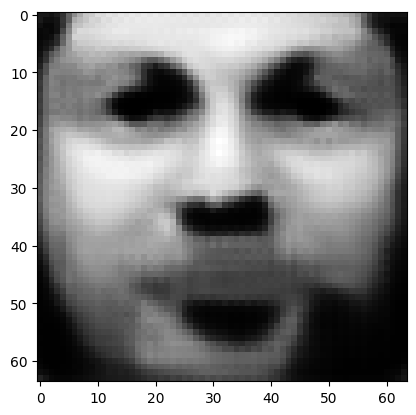

tensor([[1.5998e-07, 3.0251e-05, 9.6933e-04, 9.8195e-01, 2.4159e-06, 2.6849e-07,
         8.1511e-04, 1.2120e-06, 8.1288e-04, 9.5195e-06, 1.2056e-04, 1.3831e-05,
         2.5786e-04, 7.6733e-05, 4.5831e-04, 3.4100e-06, 7.0339e-05, 5.0869e-06,
         3.3309e-04, 3.8535e-04, 5.4875e-03, 1.8470e-03, 2.6902e-04, 1.3659e-04,
         2.0868e-05, 1.2314e-04, 2.4850e-04, 1.4084e-03, 7.7309e-04, 2.7497e-06,
         2.8802e-05, 1.7187e-05, 2.3433e-04, 2.4077e-04, 7.2540e-06, 3.2199e-06,
         1.0653e-03, 9.7956e-04, 7.7833e-04, 1.7085e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018219495192170143
tensor([[1.5994e-07, 3.0246e-05, 9.6914e-04, 9.8195e-01, 2.4153e-06, 2.6844e-07,
         8.1497e-04, 1.2118e-06, 8.1270e-04, 9.5170e-06, 1.2053e-04, 1.3828e-05,
         2.5781e-04, 7.6716e-05, 4.5822e-04, 3.4092e-06, 7.0322e-05, 5.0857e-06,
         3.3304e-04, 3.8529e-04, 5.4864e-03, 1.8466e-03, 2.6896e-04, 1.3656e-04,
         2.0862e-05, 1.2312e-04, 2.4845e-

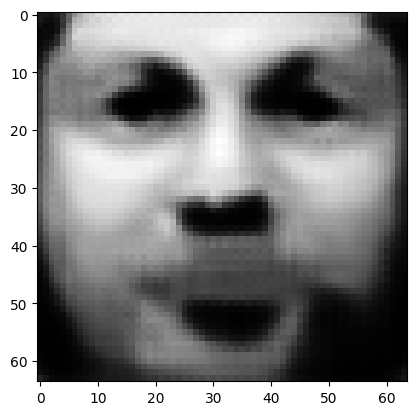

tensor([[1.5978e-07, 3.0225e-05, 9.6839e-04, 9.8196e-01, 2.4129e-06, 2.6824e-07,
         8.1444e-04, 1.2107e-06, 8.1198e-04, 9.5074e-06, 1.2043e-04, 1.3813e-05,
         2.5760e-04, 7.6646e-05, 4.5786e-04, 3.4062e-06, 7.0254e-05, 5.0811e-06,
         3.3283e-04, 3.8508e-04, 5.4821e-03, 1.8454e-03, 2.6873e-04, 1.3645e-04,
         2.0837e-05, 1.2304e-04, 2.4825e-04, 1.4071e-03, 7.7228e-04, 2.7456e-06,
         2.8763e-05, 1.7171e-05, 2.3409e-04, 2.4052e-04, 7.2429e-06, 3.2163e-06,
         1.0643e-03, 9.7848e-04, 7.7749e-04, 1.7061e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018201468512415886
tensor([[1.5974e-07, 3.0220e-05, 9.6821e-04, 9.8197e-01, 2.4124e-06, 2.6819e-07,
         8.1431e-04, 1.2104e-06, 8.1180e-04, 9.5051e-06, 1.2040e-04, 1.3810e-05,
         2.5755e-04, 7.6629e-05, 4.5778e-04, 3.4055e-06, 7.0237e-05, 5.0800e-06,
         3.3277e-04, 3.8503e-04, 5.4810e-03, 1.8451e-03, 2.6868e-04, 1.3642e-04,
         2.0830e-05, 1.2302e-04, 2.4821e-

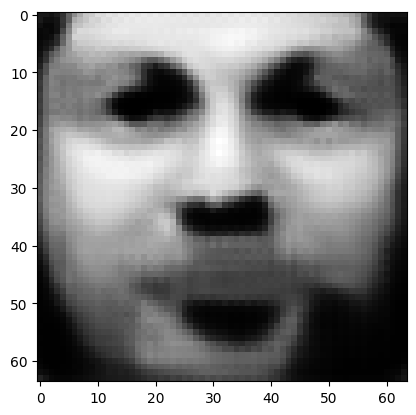

tensor([[1.5959e-07, 3.0200e-05, 9.6750e-04, 9.8198e-01, 2.4101e-06, 2.6800e-07,
         8.1381e-04, 1.2094e-06, 8.1112e-04, 9.4959e-06, 1.2030e-04, 1.3796e-05,
         2.5735e-04, 7.6563e-05, 4.5744e-04, 3.4026e-06, 7.0173e-05, 5.0756e-06,
         3.3257e-04, 3.8483e-04, 5.4770e-03, 1.8438e-03, 2.6846e-04, 1.3632e-04,
         2.0806e-05, 1.2295e-04, 2.4802e-04, 1.4059e-03, 7.7152e-04, 2.7417e-06,
         2.8726e-05, 1.7155e-05, 2.3387e-04, 2.4029e-04, 7.2324e-06, 3.2129e-06,
         1.0633e-03, 9.7746e-04, 7.7669e-04, 1.7039e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018184378743171692
tensor([[1.5956e-07, 3.0195e-05, 9.6732e-04, 9.8198e-01, 2.4096e-06, 2.6796e-07,
         8.1368e-04, 1.2092e-06, 8.1095e-04, 9.4937e-06, 1.2028e-04, 1.3793e-05,
         2.5730e-04, 7.6546e-05, 4.5736e-04, 3.4019e-06, 7.0157e-05, 5.0745e-06,
         3.3253e-04, 3.8478e-04, 5.4759e-03, 1.8435e-03, 2.6841e-04, 1.3630e-04,
         2.0800e-05, 1.2293e-04, 2.4798e-

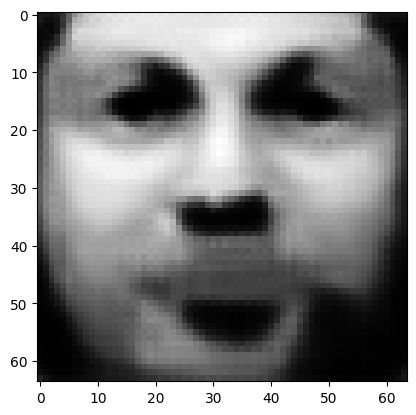

tensor([[1.5942e-07, 3.0176e-05, 9.6665e-04, 9.8200e-01, 2.4074e-06, 2.6778e-07,
         8.1321e-04, 1.2082e-06, 8.1031e-04, 9.4850e-06, 1.2018e-04, 1.3780e-05,
         2.5711e-04, 7.6484e-05, 4.5704e-04, 3.3992e-06, 7.0096e-05, 5.0704e-06,
         3.3233e-04, 3.8459e-04, 5.4720e-03, 1.8424e-03, 2.6820e-04, 1.3620e-04,
         2.0778e-05, 1.2286e-04, 2.4780e-04, 1.4047e-03, 7.7079e-04, 2.7381e-06,
         2.8690e-05, 1.7140e-05, 2.3366e-04, 2.4007e-04, 7.2224e-06, 3.2096e-06,
         1.0623e-03, 9.7650e-04, 7.7593e-04, 1.7018e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01816810667514801
tensor([[1.5938e-07, 3.0172e-05, 9.6649e-04, 9.8200e-01, 2.4069e-06, 2.6773e-07,
         8.1309e-04, 1.2080e-06, 8.1015e-04, 9.4829e-06, 1.2016e-04, 1.3776e-05,
         2.5707e-04, 7.6469e-05, 4.5696e-04, 3.3985e-06, 7.0081e-05, 5.0694e-06,
         3.3229e-04, 3.8454e-04, 5.4711e-03, 1.8421e-03, 2.6815e-04, 1.3618e-04,
         2.0772e-05, 1.2284e-04, 2.4776e-0

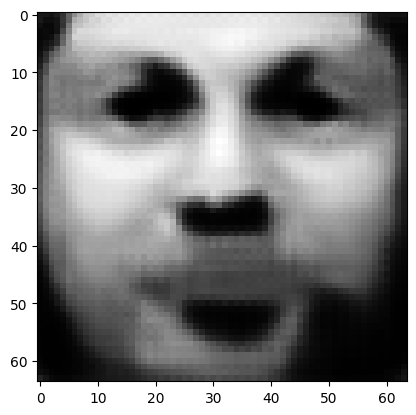

tensor([[1.5925e-07, 3.0154e-05, 9.6585e-04, 9.8201e-01, 2.4049e-06, 2.6757e-07,
         8.1264e-04, 1.2071e-06, 8.0953e-04, 9.4747e-06, 1.2007e-04, 1.3764e-05,
         2.5689e-04, 7.6409e-05, 4.5666e-04, 3.3960e-06, 7.0023e-05, 5.0654e-06,
         3.3211e-04, 3.8436e-04, 5.4674e-03, 1.8410e-03, 2.6796e-04, 1.3608e-04,
         2.0750e-05, 1.2277e-04, 2.4760e-04, 1.4036e-03, 7.7009e-04, 2.7346e-06,
         2.8657e-05, 1.7126e-05, 2.3346e-04, 2.3986e-04, 7.2130e-06, 3.2066e-06,
         1.0614e-03, 9.7557e-04, 7.7521e-04, 1.6998e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018152771517634392
tensor([[1.5921e-07, 3.0149e-05, 9.6569e-04, 9.8201e-01, 2.4044e-06, 2.6752e-07,
         8.1253e-04, 1.2068e-06, 8.0938e-04, 9.4727e-06, 1.2005e-04, 1.3761e-05,
         2.5685e-04, 7.6395e-05, 4.5659e-04, 3.3953e-06, 7.0009e-05, 5.0645e-06,
         3.3206e-04, 3.8431e-04, 5.4665e-03, 1.8407e-03, 2.6791e-04, 1.3606e-04,
         2.0745e-05, 1.2275e-04, 2.4756e-

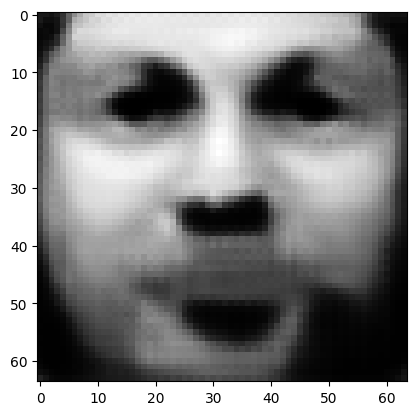

tensor([[1.5908e-07, 3.0132e-05, 9.6508e-04, 9.8203e-01, 2.4025e-06, 2.6736e-07,
         8.1209e-04, 1.2060e-06, 8.0880e-04, 9.4648e-06, 1.1996e-04, 1.3749e-05,
         2.5668e-04, 7.6338e-05, 4.5630e-04, 3.3929e-06, 6.9954e-05, 5.0607e-06,
         3.3189e-04, 3.8414e-04, 5.4630e-03, 1.8397e-03, 2.6773e-04, 1.3597e-04,
         2.0724e-05, 1.2269e-04, 2.4740e-04, 1.4025e-03, 7.6944e-04, 2.7313e-06,
         2.8625e-05, 1.7113e-05, 2.3327e-04, 2.3966e-04, 7.2040e-06, 3.2036e-06,
         1.0606e-03, 9.7470e-04, 7.7452e-04, 1.6979e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018138136714696884
tensor([[1.5905e-07, 3.0128e-05, 9.6493e-04, 9.8203e-01, 2.4020e-06, 2.6733e-07,
         8.1199e-04, 1.2058e-06, 8.0866e-04, 9.4630e-06, 1.1994e-04, 1.3746e-05,
         2.5664e-04, 7.6324e-05, 4.5623e-04, 3.3923e-06, 6.9941e-05, 5.0598e-06,
         3.3185e-04, 3.8410e-04, 5.4621e-03, 1.8394e-03, 2.6768e-04, 1.3595e-04,
         2.0719e-05, 1.2267e-04, 2.4736e-

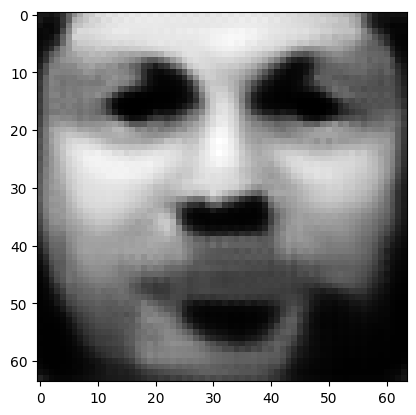

tensor([[1.5893e-07, 3.0112e-05, 9.6436e-04, 9.8204e-01, 2.4002e-06, 2.6717e-07,
         8.1158e-04, 1.2049e-06, 8.0810e-04, 9.4556e-06, 1.1986e-04, 1.3735e-05,
         2.5647e-04, 7.6271e-05, 4.5596e-04, 3.3899e-06, 6.9889e-05, 5.0563e-06,
         3.3169e-04, 3.8394e-04, 5.4588e-03, 1.8384e-03, 2.6751e-04, 1.3587e-04,
         2.0700e-05, 1.2261e-04, 2.4721e-04, 1.4015e-03, 7.6881e-04, 2.7281e-06,
         2.8595e-05, 1.7100e-05, 2.3309e-04, 2.3948e-04, 7.1955e-06, 3.2009e-06,
         1.0598e-03, 9.7388e-04, 7.7387e-04, 1.6961e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01812444068491459
tensor([[1.5890e-07, 3.0108e-05, 9.6422e-04, 9.8204e-01, 2.3997e-06, 2.6714e-07,
         8.1148e-04, 1.2047e-06, 8.0797e-04, 9.4538e-06, 1.1984e-04, 1.3732e-05,
         2.5643e-04, 7.6257e-05, 4.5589e-04, 3.3894e-06, 6.9876e-05, 5.0554e-06,
         3.3165e-04, 3.8390e-04, 5.4580e-03, 1.8382e-03, 2.6747e-04, 1.3585e-04,
         2.0695e-05, 1.2260e-04, 2.4718e-0

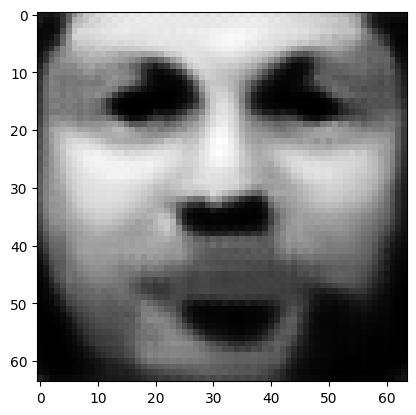

tensor([[1.5879e-07, 3.0093e-05, 9.6367e-04, 9.8205e-01, 2.3980e-06, 2.6699e-07,
         8.1109e-04, 1.2040e-06, 8.0744e-04, 9.4467e-06, 1.1976e-04, 1.3722e-05,
         2.5628e-04, 7.6207e-05, 4.5563e-04, 3.3872e-06, 6.9826e-05, 5.0520e-06,
         3.3149e-04, 3.8374e-04, 5.4548e-03, 1.8372e-03, 2.6730e-04, 1.3577e-04,
         2.0677e-05, 1.2254e-04, 2.4703e-04, 1.4005e-03, 7.6822e-04, 2.7251e-06,
         2.8566e-05, 1.7088e-05, 2.3292e-04, 2.3930e-04, 7.1874e-06, 3.1983e-06,
         1.0590e-03, 9.7309e-04, 7.7325e-04, 1.6944e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01811121217906475
tensor([[1.5876e-07, 3.0089e-05, 9.6354e-04, 9.8205e-01, 2.3976e-06, 2.6696e-07,
         8.1099e-04, 1.2038e-06, 8.0732e-04, 9.4450e-06, 1.1974e-04, 1.3719e-05,
         2.5624e-04, 7.6194e-05, 4.5557e-04, 3.3866e-06, 6.9814e-05, 5.0512e-06,
         3.3146e-04, 3.8370e-04, 5.4540e-03, 1.8370e-03, 2.6726e-04, 1.3575e-04,
         2.0672e-05, 1.2253e-04, 2.4700e-0

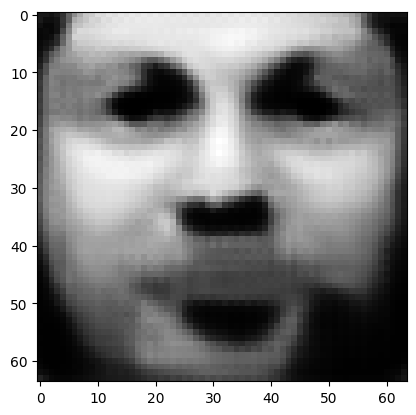

tensor([[1.5865e-07, 3.0074e-05, 9.6302e-04, 9.8206e-01, 2.3959e-06, 2.6682e-07,
         8.1062e-04, 1.2030e-06, 8.0682e-04, 9.4383e-06, 1.1967e-04, 1.3709e-05,
         2.5610e-04, 7.6146e-05, 4.5532e-04, 3.3845e-06, 6.9767e-05, 5.0480e-06,
         3.3131e-04, 3.8355e-04, 5.4510e-03, 1.8361e-03, 2.6710e-04, 1.3567e-04,
         2.0654e-05, 1.2247e-04, 2.4687e-04, 1.3996e-03, 7.6766e-04, 2.7223e-06,
         2.8539e-05, 1.7077e-05, 2.3276e-04, 2.3913e-04, 7.1797e-06, 3.1958e-06,
         1.0583e-03, 9.7234e-04, 7.7266e-04, 1.6928e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018098803237080574
tensor([[1.5862e-07, 3.0071e-05, 9.6289e-04, 9.8207e-01, 2.3955e-06, 2.6678e-07,
         8.1054e-04, 1.2029e-06, 8.0670e-04, 9.4367e-06, 1.1965e-04, 1.3707e-05,
         2.5606e-04, 7.6134e-05, 4.5526e-04, 3.3840e-06, 6.9756e-05, 5.0472e-06,
         3.3127e-04, 3.8352e-04, 5.4503e-03, 1.8359e-03, 2.6707e-04, 1.3565e-04,
         2.0650e-05, 1.2246e-04, 2.4683e-

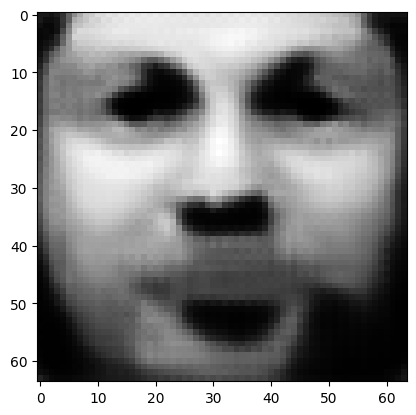

tensor([[1.5852e-07, 3.0057e-05, 9.6240e-04, 9.8208e-01, 2.3940e-06, 2.6665e-07,
         8.1018e-04, 1.2021e-06, 8.0622e-04, 9.4303e-06, 1.1958e-04, 1.3697e-05,
         2.5593e-04, 7.6088e-05, 4.5503e-04, 3.3820e-06, 6.9711e-05, 5.0442e-06,
         3.3113e-04, 3.8338e-04, 5.4474e-03, 1.8351e-03, 2.6692e-04, 1.3558e-04,
         2.0634e-05, 1.2241e-04, 2.4671e-04, 1.3988e-03, 7.6712e-04, 2.7196e-06,
         2.8513e-05, 1.7066e-05, 2.3260e-04, 2.3897e-04, 7.1725e-06, 3.1934e-06,
         1.0576e-03, 9.7163e-04, 7.7211e-04, 1.6913e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018086979165673256
tensor([[1.5849e-07, 3.0054e-05, 9.6227e-04, 9.8208e-01, 2.3936e-06, 2.6662e-07,
         8.1010e-04, 1.2020e-06, 8.0610e-04, 9.4288e-06, 1.1957e-04, 1.3695e-05,
         2.5589e-04, 7.6077e-05, 4.5497e-04, 3.3815e-06, 6.9700e-05, 5.0435e-06,
         3.3110e-04, 3.8334e-04, 5.4467e-03, 1.8348e-03, 2.6688e-04, 1.3556e-04,
         2.0629e-05, 1.2239e-04, 2.4667e-

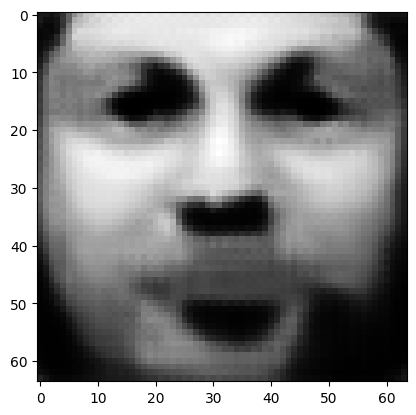

tensor([[1.5839e-07, 3.0040e-05, 9.6181e-04, 9.8209e-01, 2.3921e-06, 2.6650e-07,
         8.0976e-04, 1.2013e-06, 8.0565e-04, 9.4228e-06, 1.1950e-04, 1.3686e-05,
         2.5576e-04, 7.6033e-05, 4.5475e-04, 3.3797e-06, 6.9658e-05, 5.0406e-06,
         3.3097e-04, 3.8321e-04, 5.4440e-03, 1.8340e-03, 2.6674e-04, 1.3550e-04,
         2.0614e-05, 1.2234e-04, 2.4655e-04, 1.3979e-03, 7.6662e-04, 2.7171e-06,
         2.8489e-05, 1.7056e-05, 2.3245e-04, 2.3881e-04, 7.1655e-06, 3.1911e-06,
         1.0569e-03, 9.7096e-04, 7.7158e-04, 1.6898e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018075739964842796
tensor([[1.5837e-07, 3.0037e-05, 9.6169e-04, 9.8209e-01, 2.3917e-06, 2.6647e-07,
         8.0968e-04, 1.2011e-06, 8.0555e-04, 9.4213e-06, 1.1948e-04, 1.3684e-05,
         2.5573e-04, 7.6023e-05, 4.5470e-04, 3.3792e-06, 6.9648e-05, 5.0399e-06,
         3.3093e-04, 3.8318e-04, 5.4434e-03, 1.8338e-03, 2.6670e-04, 1.3548e-04,
         2.0610e-05, 1.2233e-04, 2.4652e-

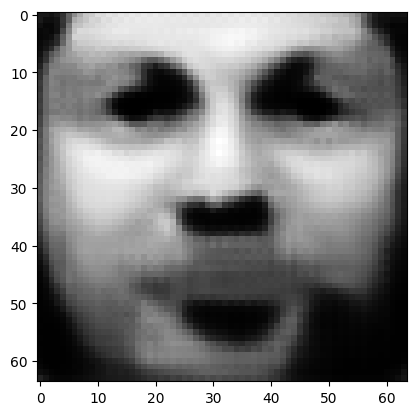

tensor([[1.5827e-07, 3.0025e-05, 9.6125e-04, 9.8210e-01, 2.3903e-06, 2.6635e-07,
         8.0936e-04, 1.2005e-06, 8.0511e-04, 9.4156e-06, 1.1942e-04, 1.3675e-05,
         2.5561e-04, 7.5981e-05, 4.5449e-04, 3.3774e-06, 6.9607e-05, 5.0371e-06,
         3.3081e-04, 3.8305e-04, 5.4408e-03, 1.8331e-03, 2.6657e-04, 1.3542e-04,
         2.0595e-05, 1.2228e-04, 2.4641e-04, 1.3972e-03, 7.6613e-04, 2.7147e-06,
         2.8466e-05, 1.7046e-05, 2.3232e-04, 2.3867e-04, 7.1590e-06, 3.1890e-06,
         1.0563e-03, 9.7032e-04, 7.7107e-04, 1.6884e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018065085634589195
tensor([[1.5825e-07, 3.0022e-05, 9.6114e-04, 9.8210e-01, 2.3900e-06, 2.6632e-07,
         8.0929e-04, 1.2004e-06, 8.0501e-04, 9.4142e-06, 1.1941e-04, 1.3673e-05,
         2.5558e-04, 7.5971e-05, 4.5444e-04, 3.3770e-06, 6.9598e-05, 5.0365e-06,
         3.3078e-04, 3.8302e-04, 5.4402e-03, 1.8329e-03, 2.6654e-04, 1.3540e-04,
         2.0591e-05, 1.2227e-04, 2.4638e-

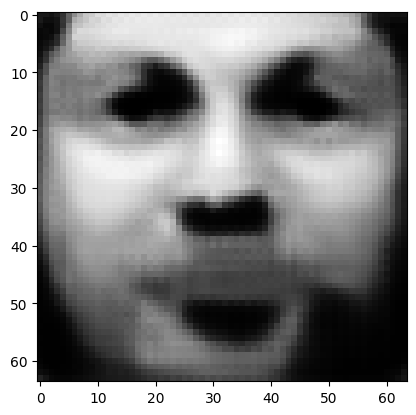

tensor([[1.5816e-07, 3.0010e-05, 9.6072e-04, 9.8211e-01, 2.3886e-06, 2.6621e-07,
         8.0899e-04, 1.1998e-06, 8.0461e-04, 9.4088e-06, 1.1935e-04, 1.3665e-05,
         2.5546e-04, 7.5932e-05, 4.5423e-04, 3.3753e-06, 6.9559e-05, 5.0339e-06,
         3.3066e-04, 3.8290e-04, 5.4377e-03, 1.8322e-03, 2.6641e-04, 1.3534e-04,
         2.0577e-05, 1.2223e-04, 2.4627e-04, 1.3964e-03, 7.6568e-04, 2.7124e-06,
         2.8443e-05, 1.7037e-05, 2.3218e-04, 2.3853e-04, 7.1527e-06, 3.1870e-06,
         1.0557e-03, 9.6971e-04, 7.7060e-04, 1.6871e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0180549006909132
tensor([[1.5814e-07, 3.0007e-05, 9.6061e-04, 9.8211e-01, 2.3883e-06, 2.6618e-07,
         8.0892e-04, 1.1996e-06, 8.0451e-04, 9.4074e-06, 1.1933e-04, 1.3663e-05,
         2.5543e-04, 7.5922e-05, 4.5419e-04, 3.3748e-06, 6.9550e-05, 5.0332e-06,
         3.3063e-04, 3.8287e-04, 5.4371e-03, 1.8320e-03, 2.6638e-04, 1.3532e-04,
         2.0573e-05, 1.2222e-04, 2.4625e-04

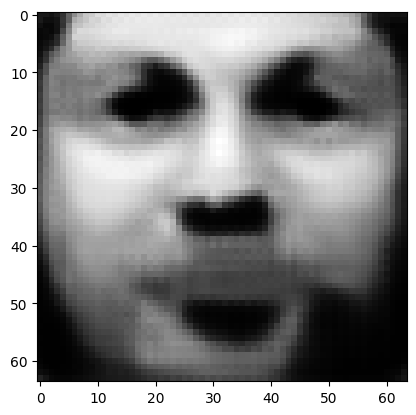

tensor([[1.5806e-07, 2.9996e-05, 9.6021e-04, 9.8212e-01, 2.3870e-06, 2.6608e-07,
         8.0863e-04, 1.1990e-06, 8.0412e-04, 9.4023e-06, 1.1928e-04, 1.3655e-05,
         2.5532e-04, 7.5885e-05, 4.5400e-04, 3.3732e-06, 6.9514e-05, 5.0308e-06,
         3.3051e-04, 3.8276e-04, 5.4348e-03, 1.8313e-03, 2.6625e-04, 1.3527e-04,
         2.0560e-05, 1.2217e-04, 2.4614e-04, 1.3957e-03, 7.6524e-04, 2.7102e-06,
         2.8422e-05, 1.7028e-05, 2.3206e-04, 2.3840e-04, 7.1468e-06, 3.1851e-06,
         1.0551e-03, 9.6914e-04, 7.7014e-04, 1.6859e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01804506592452526
tensor([[1.5804e-07, 2.9993e-05, 9.6011e-04, 9.8212e-01, 2.3867e-06, 2.6605e-07,
         8.0856e-04, 1.1989e-06, 8.0403e-04, 9.4010e-06, 1.1926e-04, 1.3653e-05,
         2.5529e-04, 7.5876e-05, 4.5395e-04, 3.3728e-06, 6.9505e-05, 5.0302e-06,
         3.3049e-04, 3.8273e-04, 5.4342e-03, 1.8311e-03, 2.6622e-04, 1.3525e-04,
         2.0556e-05, 1.2216e-04, 2.4612e-0

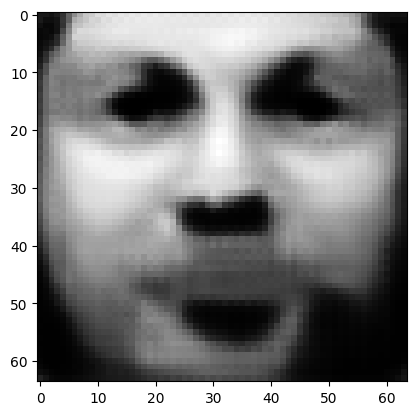

tensor([[1.5795e-07, 2.9982e-05, 9.5973e-04, 9.8213e-01, 2.3855e-06, 2.6595e-07,
         8.0829e-04, 1.1984e-06, 8.0366e-04, 9.3961e-06, 1.1921e-04, 1.3646e-05,
         2.5518e-04, 7.5841e-05, 4.5377e-04, 3.3713e-06, 6.9470e-05, 5.0278e-06,
         3.3038e-04, 3.8262e-04, 5.4320e-03, 1.8305e-03, 2.6611e-04, 1.3520e-04,
         2.0543e-05, 1.2212e-04, 2.4602e-04, 1.3950e-03, 7.6483e-04, 2.7081e-06,
         2.8403e-05, 1.7019e-05, 2.3194e-04, 2.3827e-04, 7.1412e-06, 3.1832e-06,
         1.0546e-03, 9.6859e-04, 7.6971e-04, 1.6847e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01803593337535858
tensor([[1.5793e-07, 2.9980e-05, 9.5964e-04, 9.8213e-01, 2.3852e-06, 2.6593e-07,
         8.0822e-04, 1.1982e-06, 8.0357e-04, 9.3949e-06, 1.1920e-04, 1.3644e-05,
         2.5516e-04, 7.5832e-05, 4.5373e-04, 3.3709e-06, 6.9462e-05, 5.0272e-06,
         3.3035e-04, 3.8259e-04, 5.4315e-03, 1.8303e-03, 2.6608e-04, 1.3518e-04,
         2.0540e-05, 1.2211e-04, 2.4599e-0

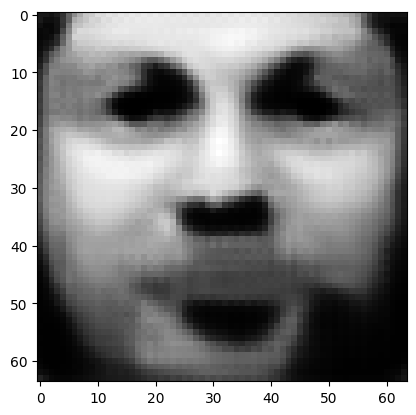

tensor([[1.5786e-07, 2.9970e-05, 9.5928e-04, 9.8213e-01, 2.3841e-06, 2.6583e-07,
         8.0796e-04, 1.1977e-06, 8.0323e-04, 9.3903e-06, 1.1915e-04, 1.3637e-05,
         2.5506e-04, 7.5798e-05, 4.5355e-04, 3.3695e-06, 6.9429e-05, 5.0250e-06,
         3.3025e-04, 3.8249e-04, 5.4294e-03, 1.8297e-03, 2.6597e-04, 1.3513e-04,
         2.0528e-05, 1.2207e-04, 2.4590e-04, 1.3944e-03, 7.6444e-04, 2.7061e-06,
         2.8384e-05, 1.7011e-05, 2.3183e-04, 2.3816e-04, 7.1359e-06, 3.1815e-06,
         1.0541e-03, 9.6807e-04, 7.6931e-04, 1.6836e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01802727021276951
tensor([[1.5784e-07, 2.9967e-05, 9.5919e-04, 9.8214e-01, 2.3838e-06, 2.6581e-07,
         8.0790e-04, 1.1976e-06, 8.0314e-04, 9.3891e-06, 1.1913e-04, 1.3635e-05,
         2.5503e-04, 7.5790e-05, 4.5351e-04, 3.3691e-06, 6.9421e-05, 5.0245e-06,
         3.3022e-04, 3.8247e-04, 5.4289e-03, 1.8295e-03, 2.6594e-04, 1.3512e-04,
         2.0525e-05, 1.2207e-04, 2.4588e-0

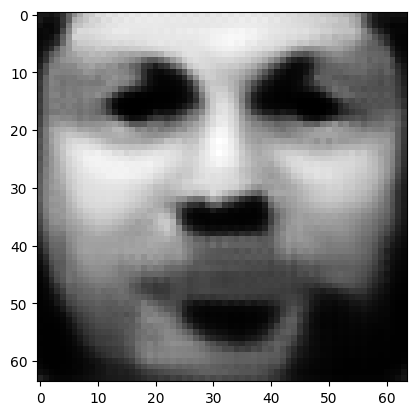

tensor([[1.5777e-07, 2.9957e-05, 9.5884e-04, 9.8214e-01, 2.3827e-06, 2.6571e-07,
         8.0766e-04, 1.1971e-06, 8.0281e-04, 9.3847e-06, 1.1908e-04, 1.3629e-05,
         2.5494e-04, 7.5758e-05, 4.5335e-04, 3.3677e-06, 6.9390e-05, 5.0223e-06,
         3.3013e-04, 3.8237e-04, 5.4269e-03, 1.8289e-03, 2.6584e-04, 1.3507e-04,
         2.0513e-05, 1.2203e-04, 2.4579e-04, 1.3938e-03, 7.6406e-04, 2.7043e-06,
         2.8366e-05, 1.7004e-05, 2.3172e-04, 2.3804e-04, 7.1308e-06, 3.1798e-06,
         1.0536e-03, 9.6757e-04, 7.6892e-04, 1.6825e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018019074574112892
tensor([[1.5775e-07, 2.9955e-05, 9.5876e-04, 9.8214e-01, 2.3825e-06, 2.6569e-07,
         8.0760e-04, 1.1970e-06, 8.0273e-04, 9.3836e-06, 1.1907e-04, 1.3627e-05,
         2.5491e-04, 7.5750e-05, 4.5331e-04, 3.3674e-06, 6.9382e-05, 5.0218e-06,
         3.3010e-04, 3.8234e-04, 5.4264e-03, 1.8288e-03, 2.6581e-04, 1.3505e-04,
         2.0511e-05, 1.2202e-04, 2.4577e-

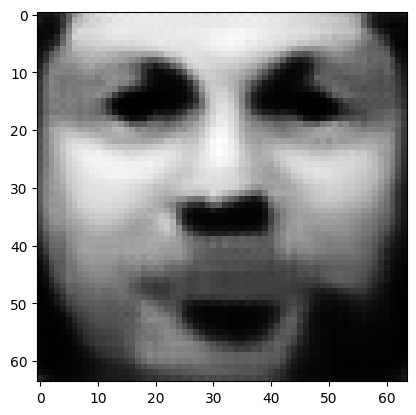

tensor([[1.5768e-07, 2.9946e-05, 9.5843e-04, 9.8215e-01, 2.3814e-06, 2.6561e-07,
         8.0737e-04, 1.1965e-06, 8.0242e-04, 9.3794e-06, 1.1903e-04, 1.3621e-05,
         2.5482e-04, 7.5720e-05, 4.5315e-04, 3.3660e-06, 6.9353e-05, 5.0198e-06,
         3.3001e-04, 3.8225e-04, 5.4245e-03, 1.8282e-03, 2.6572e-04, 1.3501e-04,
         2.0500e-05, 1.2199e-04, 2.4568e-04, 1.3932e-03, 7.6371e-04, 2.7025e-06,
         2.8349e-05, 1.6997e-05, 2.3162e-04, 2.3794e-04, 7.1260e-06, 3.1783e-06,
         1.0532e-03, 9.6711e-04, 7.6855e-04, 1.6815e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01801122911274433
tensor([[1.5766e-07, 2.9944e-05, 9.5835e-04, 9.8215e-01, 2.3812e-06, 2.6558e-07,
         8.0731e-04, 1.1964e-06, 8.0234e-04, 9.3784e-06, 1.1902e-04, 1.3619e-05,
         2.5480e-04, 7.5712e-05, 4.5312e-04, 3.3657e-06, 6.9346e-05, 5.0193e-06,
         3.2999e-04, 3.8223e-04, 5.4240e-03, 1.8281e-03, 2.6569e-04, 1.3500e-04,
         2.0497e-05, 1.2198e-04, 2.4566e-0

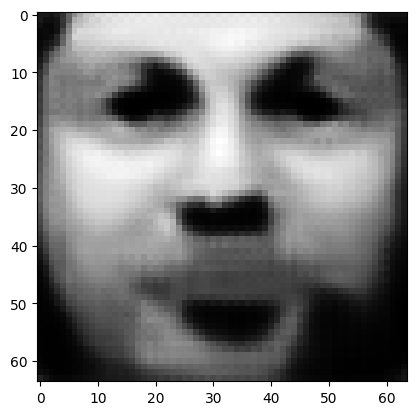

tensor([[1.5760e-07, 2.9935e-05, 9.5804e-04, 9.8216e-01, 2.3802e-06, 2.6550e-07,
         8.0709e-04, 1.1959e-06, 8.0204e-04, 9.3744e-06, 1.1897e-04, 1.3613e-05,
         2.5471e-04, 7.5683e-05, 4.5297e-04, 3.3645e-06, 6.9318e-05, 5.0174e-06,
         3.2990e-04, 3.8214e-04, 5.4222e-03, 1.8276e-03, 2.6560e-04, 1.3495e-04,
         2.0486e-05, 1.2194e-04, 2.4558e-04, 1.3927e-03, 7.6338e-04, 2.7008e-06,
         2.8332e-05, 1.6990e-05, 2.3152e-04, 2.3784e-04, 7.1214e-06, 3.1768e-06,
         1.0527e-03, 9.6666e-04, 7.6820e-04, 1.6805e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018003735691308975
tensor([[1.5758e-07, 2.9933e-05, 9.5797e-04, 9.8216e-01, 2.3800e-06, 2.6548e-07,
         8.0703e-04, 1.1958e-06, 8.0197e-04, 9.3735e-06, 1.1896e-04, 1.3612e-05,
         2.5469e-04, 7.5676e-05, 4.5293e-04, 3.3642e-06, 6.9311e-05, 5.0170e-06,
         3.2988e-04, 3.8212e-04, 5.4218e-03, 1.8274e-03, 2.6558e-04, 1.3494e-04,
         2.0484e-05, 1.2194e-04, 2.4556e-

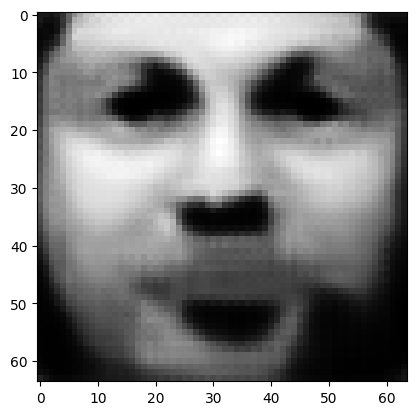

tensor([[1.5752e-07, 2.9924e-05, 9.5767e-04, 9.8216e-01, 2.3790e-06, 2.6540e-07,
         8.0682e-04, 1.1954e-06, 8.0169e-04, 9.3697e-06, 1.1892e-04, 1.3606e-05,
         2.5461e-04, 7.5649e-05, 4.5279e-04, 3.3630e-06, 6.9284e-05, 5.0152e-06,
         3.2980e-04, 3.8203e-04, 5.4201e-03, 1.8269e-03, 2.6549e-04, 1.3490e-04,
         2.0474e-05, 1.2190e-04, 2.4549e-04, 1.3922e-03, 7.6306e-04, 2.6992e-06,
         2.8317e-05, 1.6983e-05, 2.3143e-04, 2.3774e-04, 7.1171e-06, 3.1754e-06,
         1.0523e-03, 9.6624e-04, 7.6786e-04, 1.6796e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017996829003095627
tensor([[1.5750e-07, 2.9922e-05, 9.5760e-04, 9.8217e-01, 2.3788e-06, 2.6539e-07,
         8.0677e-04, 1.1953e-06, 8.0162e-04, 9.3687e-06, 1.1891e-04, 1.3605e-05,
         2.5459e-04, 7.5642e-05, 4.5276e-04, 3.3627e-06, 6.9278e-05, 5.0147e-06,
         3.2978e-04, 3.8201e-04, 5.4197e-03, 1.8268e-03, 2.6546e-04, 1.3489e-04,
         2.0471e-05, 1.2190e-04, 2.4547e-

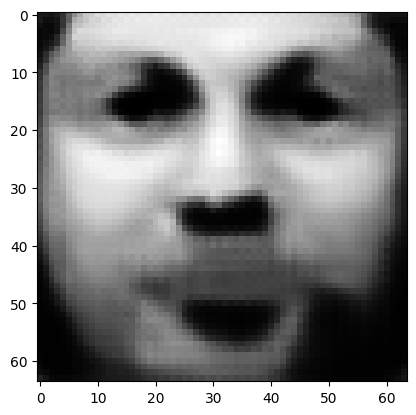

tensor([[1.5745e-07, 2.9914e-05, 9.5732e-04, 9.8217e-01, 2.3779e-06, 2.6531e-07,
         8.0657e-04, 1.1949e-06, 8.0135e-04, 9.3652e-06, 1.1887e-04, 1.3599e-05,
         2.5451e-04, 7.5616e-05, 4.5263e-04, 3.3616e-06, 6.9252e-05, 5.0130e-06,
         3.2970e-04, 3.8193e-04, 5.4180e-03, 1.8263e-03, 2.6538e-04, 1.3485e-04,
         2.0462e-05, 1.2187e-04, 2.4539e-04, 1.3917e-03, 7.6275e-04, 2.6977e-06,
         2.8302e-05, 1.6977e-05, 2.3134e-04, 2.3765e-04, 7.1130e-06, 3.1740e-06,
         1.0519e-03, 9.6583e-04, 7.6755e-04, 1.6787e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017989803105592728
tensor([[1.5743e-07, 2.9913e-05, 9.5725e-04, 9.8217e-01, 2.3777e-06, 2.6529e-07,
         8.0652e-04, 1.1948e-06, 8.0128e-04, 9.3643e-06, 1.1886e-04, 1.3598e-05,
         2.5449e-04, 7.5610e-05, 4.5260e-04, 3.3613e-06, 6.9246e-05, 5.0126e-06,
         3.2968e-04, 3.8191e-04, 5.4177e-03, 1.8262e-03, 2.6536e-04, 1.3484e-04,
         2.0460e-05, 1.2186e-04, 2.4538e-

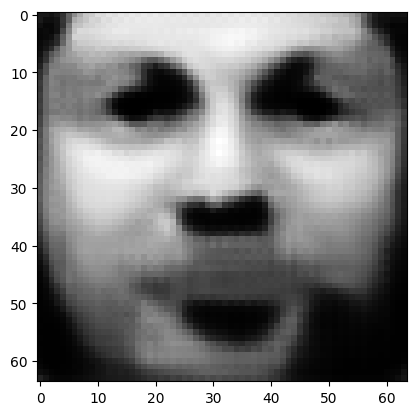

tensor([[1.5737e-07, 2.9905e-05, 9.5698e-04, 9.8218e-01, 2.3768e-06, 2.6522e-07,
         8.0633e-04, 1.1944e-06, 8.0102e-04, 9.3608e-06, 1.1882e-04, 1.3593e-05,
         2.5442e-04, 7.5585e-05, 4.5247e-04, 3.3602e-06, 6.9222e-05, 5.0109e-06,
         3.2960e-04, 3.8184e-04, 5.4161e-03, 1.8257e-03, 2.6528e-04, 1.3480e-04,
         2.0451e-05, 1.2183e-04, 2.4531e-04, 1.3912e-03, 7.6246e-04, 2.6962e-06,
         2.8289e-05, 1.6971e-05, 2.3126e-04, 2.3756e-04, 7.1090e-06, 3.1728e-06,
         1.0515e-03, 9.6545e-04, 7.6725e-04, 1.6779e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017983481287956238
tensor([[1.5736e-07, 2.9903e-05, 9.5692e-04, 9.8218e-01, 2.3766e-06, 2.6521e-07,
         8.0629e-04, 1.1943e-06, 8.0096e-04, 9.3600e-06, 1.1881e-04, 1.3591e-05,
         2.5440e-04, 7.5579e-05, 4.5244e-04, 3.3599e-06, 6.9216e-05, 5.0105e-06,
         3.2958e-04, 3.8182e-04, 5.4157e-03, 1.8256e-03, 2.6526e-04, 1.3479e-04,
         2.0448e-05, 1.2183e-04, 2.4529e-

In [140]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=3)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.414968967437744


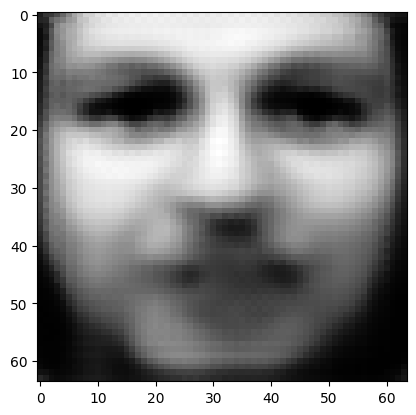

tensor([[1.8180e-04, 3.3811e-04, 1.5755e-02, 4.6695e-03, 7.4628e-03, 1.5371e-05,
         1.7655e-02, 1.7951e-04, 1.3474e-01, 1.0545e-02, 5.4931e-03, 2.1581e-02,
         2.4069e-02, 6.3024e-03, 6.6227e-03, 7.0379e-04, 2.9619e-02, 1.0631e-03,
         2.2324e-03, 1.2159e-03, 1.1979e-01, 3.4232e-02, 2.1890e-02, 9.4910e-03,
         1.1249e-01, 1.7384e-03, 4.1958e-03, 3.5317e-02, 1.9200e-02, 1.0378e-02,
         5.5897e-02, 6.4002e-04, 1.9228e-02, 5.7262e-03, 6.0206e-02, 1.3688e-03,
         2.1969e-02, 6.8722e-02, 6.2815e-02, 4.4268e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.897825717926025
tensor([[1.7935e-04, 3.8237e-04, 1.1703e-02, 4.3320e-03, 1.7695e-02, 1.6516e-05,
         1.2525e-02, 1.2632e-04, 9.7910e-02, 8.3979e-03, 4.4765e-03, 2.7742e-02,
         2.4223e-02, 7.9494e-03, 7.3832e-03, 6.5018e-04, 3.0803e-02, 1.0706e-03,
         1.7625e-03, 1.0283e-03, 1.5169e-01, 3.5482e-02, 2.5110e-02, 7.8069e-03,
         1.0450e-01, 2.5394e-03, 3.4270e-03,

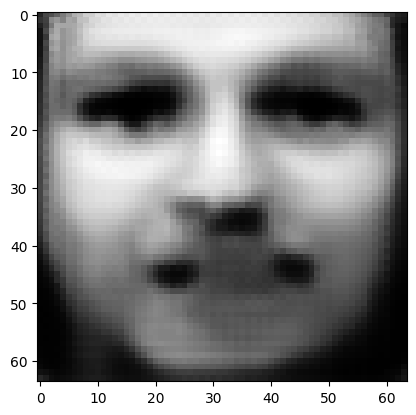

tensor([[9.9281e-05, 3.1103e-04, 3.4118e-03, 2.3286e-03, 1.9032e-01, 1.6405e-05,
         4.0435e-03, 3.4360e-05, 2.9079e-02, 3.3699e-03, 1.7361e-03, 3.3689e-02,
         1.5743e-02, 8.7722e-03, 6.4617e-03, 3.7081e-04, 2.4878e-02, 6.6970e-04,
         6.2655e-04, 4.2262e-04, 1.4954e-01, 3.0068e-02, 2.8458e-02, 2.8521e-03,
         6.5421e-02, 5.0508e-03, 1.1770e-03, 1.3040e-02, 1.2071e-03, 9.2491e-03,
         1.9740e-01, 2.6128e-03, 1.2018e-02, 6.8880e-03, 4.5733e-02, 2.8005e-03,
         1.3174e-02, 2.2696e-02, 2.9597e-02, 3.4624e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.6590262651443481
tensor([[8.1197e-05, 2.6873e-04, 2.5677e-03, 1.9588e-03, 2.7001e-01, 1.5439e-05,
         3.0279e-03, 2.5405e-05, 2.1776e-02, 2.7234e-03, 1.3459e-03, 3.1828e-02,
         1.3118e-02, 7.8888e-03, 5.7404e-03, 3.1268e-04, 2.1563e-02, 5.6040e-04,
         4.9244e-04, 3.3708e-04, 1.3399e-01, 2.6962e-02, 2.7024e-02, 2.1656e-03,
         5.3460e-02, 5.1603e-03, 8.9688e-04

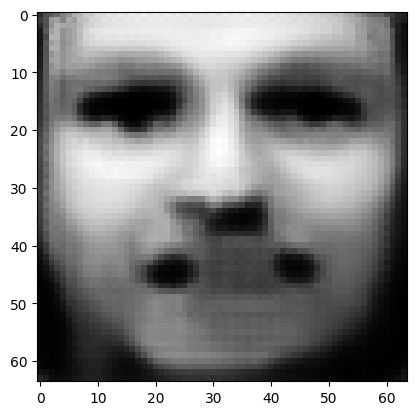

tensor([[4.1666e-05, 1.4641e-04, 9.9397e-04, 1.0035e-03, 5.4893e-01, 1.1229e-05,
         1.2091e-03, 1.0189e-05, 8.1895e-03, 1.3505e-03, 5.5414e-04, 2.1227e-02,
         6.4336e-03, 4.5261e-03, 3.3129e-03, 1.6791e-04, 1.2031e-02, 2.8446e-04,
         2.2003e-04, 1.4910e-04, 7.4545e-02, 1.6789e-02, 1.9141e-02, 8.6102e-04,
         2.6390e-02, 4.1364e-03, 3.4495e-04, 3.9591e-03, 1.7807e-04, 5.2696e-03,
         1.5885e-01, 2.6530e-03, 5.9948e-03, 3.7675e-03, 2.3409e-02, 2.6389e-03,
         5.2835e-03, 7.6174e-03, 1.0224e-02, 1.7154e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5997905731201172
tensor([[3.6292e-05, 1.2853e-04, 8.3154e-04, 8.7376e-04, 5.9590e-01, 1.0392e-05,
         1.0078e-03, 8.5608e-06, 6.7270e-03, 1.1666e-03, 4.6490e-04, 1.9156e-02,
         5.5424e-03, 4.0137e-03, 2.9225e-03, 1.4806e-04, 1.0566e-02, 2.4670e-04,
         1.8712e-04, 1.2646e-04, 6.5571e-02, 1.5040e-02, 1.7396e-02, 7.1476e-04,
         2.2754e-02, 3.8483e-03, 2.8611e-04

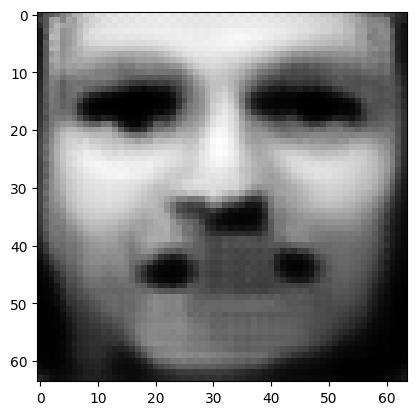

tensor([[2.3559e-05, 8.4767e-05, 4.9409e-04, 5.7558e-04, 7.1853e-01, 8.0882e-06,
         5.7033e-04, 5.0968e-06, 3.6715e-03, 7.5642e-04, 2.7006e-04, 1.3731e-02,
         3.4551e-03, 2.7026e-03, 1.9839e-03, 1.0002e-04, 6.8292e-03, 1.5643e-04,
         1.1561e-04, 7.6848e-05, 4.3581e-02, 1.0547e-02, 1.2885e-02, 4.0359e-04,
         1.4125e-02, 2.9952e-03, 1.6327e-04, 1.8119e-03, 6.1536e-05, 3.3897e-03,
         1.0978e-01, 2.1757e-03, 3.6315e-03, 2.3361e-03, 1.4005e-02, 2.1563e-03,
         2.8254e-03, 3.8528e-03, 4.9983e-03, 1.0143e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3305543065071106
tensor([[2.1659e-05, 7.7990e-05, 4.4718e-04, 5.3046e-04, 7.3818e-01, 7.6834e-06,
         5.1026e-04, 4.6110e-06, 3.2707e-03, 6.9533e-04, 2.4279e-04, 1.2867e-02,
         3.1477e-03, 2.4976e-03, 1.8338e-03, 9.2660e-05, 6.2562e-03, 1.4340e-04,
         1.0523e-04, 6.9844e-05, 4.0281e-02, 9.7997e-03, 1.2117e-02, 3.6144e-04,
         1.2849e-02, 2.8414e-03, 1.4636e-04

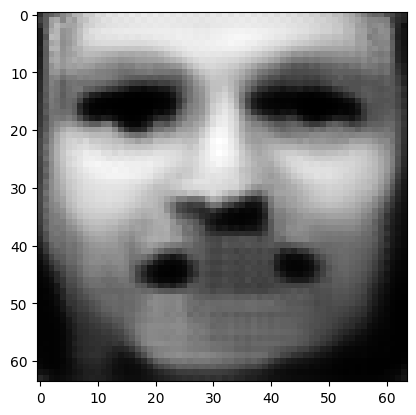

tensor([[1.6164e-05, 5.8323e-05, 3.2100e-04, 4.0504e-04, 7.9590e-01, 6.4544e-06,
         3.4994e-04, 3.2768e-06, 2.2223e-03, 5.2066e-04, 1.6883e-04, 1.0246e-02,
         2.3012e-03, 1.9051e-03, 1.4028e-03, 7.1261e-05, 4.6239e-03, 1.0707e-04,
         7.5943e-05, 5.0908e-05, 3.0978e-02, 7.5902e-03, 9.8174e-03, 2.4840e-04,
         9.2224e-03, 2.3648e-03, 1.0084e-04, 1.0934e-03, 3.1902e-05, 2.4971e-03,
         8.2827e-02, 1.8049e-03, 2.5925e-03, 1.6730e-03, 9.8880e-03, 1.8079e-03,
         1.8586e-03, 2.4793e-03, 3.1252e-03, 7.2464e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22828616201877594
tensor([[1.5176e-05, 5.4677e-05, 2.9845e-04, 3.8133e-04, 8.0663e-01, 6.2101e-06,
         3.2335e-04, 3.0481e-06, 2.0474e-03, 4.8978e-04, 1.5617e-04, 9.7477e-03,
         2.1497e-03, 1.7943e-03, 1.3221e-03, 6.7313e-05, 4.3427e-03, 1.0039e-04,
         7.0718e-05, 4.7482e-05, 2.9204e-02, 7.1812e-03, 9.3894e-03, 2.2942e-04,
         8.6093e-03, 2.2709e-03, 9.2962e-0

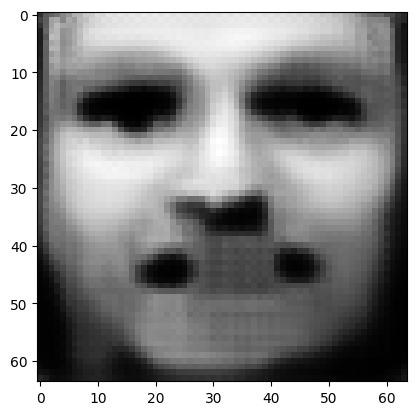

tensor([[1.2142e-05, 4.3616e-05, 2.3466e-04, 3.1090e-04, 8.3969e-01, 5.4420e-06,
         2.4527e-04, 2.3704e-06, 1.5425e-03, 3.9473e-04, 1.1905e-04, 8.1978e-03,
         1.7040e-03, 1.4654e-03, 1.0771e-03, 5.5205e-05, 3.4724e-03, 8.0742e-05,
         5.5098e-05, 3.7513e-05, 2.3978e-02, 5.9114e-03, 8.0226e-03, 1.7375e-04,
         6.7146e-03, 1.9707e-03, 7.0341e-05, 7.5439e-04, 1.9786e-05, 1.9704e-03,
         6.6633e-02, 1.5464e-03, 2.0157e-03, 1.2961e-03, 7.6557e-03, 1.5622e-03,
         1.3619e-03, 1.7812e-03, 2.2112e-03, 5.6033e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.17472150921821594
tensor([[1.1572e-05, 4.1537e-05, 2.2254e-04, 2.9733e-04, 8.4611e-01, 5.2841e-06,
         2.3085e-04, 2.2429e-06, 1.4492e-03, 3.7616e-04, 1.1215e-04, 7.8949e-03,
         1.6200e-03, 1.4027e-03, 1.0296e-03, 5.2831e-05, 3.3041e-03, 7.7034e-05,
         5.2154e-05, 3.5632e-05, 2.2978e-02, 5.6623e-03, 7.7441e-03, 1.6353e-04,
         6.3565e-03, 1.9103e-03, 6.6178e-0

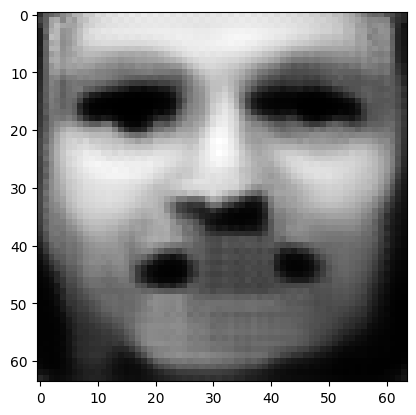

tensor([[9.7815e-06, 3.4767e-05, 1.8463e-04, 2.5279e-04, 8.6690e-01, 4.7535e-06,
         1.8688e-04, 1.8493e-06, 1.1680e-03, 3.1879e-04, 9.0641e-05, 6.9259e-03,
         1.3542e-03, 1.1978e-03, 8.7395e-04, 4.5270e-05, 2.7822e-03, 6.5268e-05,
         4.2934e-05, 2.9611e-05, 1.9723e-02, 4.8536e-03, 6.8384e-03, 1.3240e-04,
         5.2480e-03, 1.7066e-03, 5.3277e-05, 5.6601e-04, 1.3760e-05, 1.6386e-03,
         5.6252e-02, 1.3625e-03, 1.6599e-03, 1.0599e-03, 6.2896e-03, 1.3850e-03,
         1.0694e-03, 1.3835e-03, 1.6949e-03, 4.5999e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1428312510251999
tensor([[9.4156e-06, 3.3403e-05, 1.7718e-04, 2.4371e-04, 8.7114e-01, 4.6409e-06,
         1.7827e-04, 1.7712e-06, 1.1135e-03, 3.0711e-04, 8.6450e-05, 6.7268e-03,
         1.3010e-03, 1.1568e-03, 8.4227e-04, 4.3733e-05, 2.6771e-03, 6.2910e-05,
         4.1102e-05, 2.8412e-05, 1.9066e-02, 4.6874e-03, 6.6474e-03, 1.2629e-04,
         5.0273e-03, 1.6642e-03, 5.0772e-05

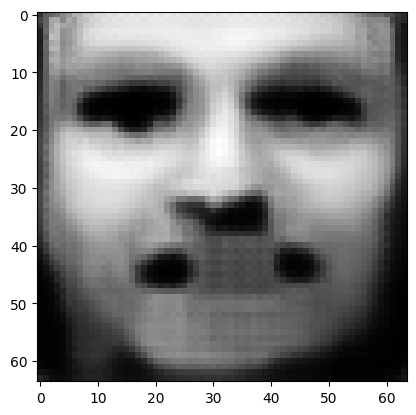

tensor([[8.2408e-06, 2.8905e-05, 1.5324e-04, 2.1382e-04, 8.8532e-01, 4.2661e-06,
         1.5083e-04, 1.5210e-06, 9.3968e-04, 2.6976e-04, 7.2889e-05, 6.0698e-03,
         1.1291e-03, 1.0191e-03, 7.3714e-04, 3.8716e-05, 2.3324e-03, 5.5121e-05,
         3.5192e-05, 2.4492e-05, 1.6866e-02, 4.1367e-03, 6.0154e-03, 1.0678e-04,
         4.3130e-03, 1.5196e-03, 4.2798e-05, 4.5043e-04, 1.0326e-05, 1.4132e-03,
         4.9035e-02, 1.2266e-03, 1.4202e-03, 8.9970e-04, 5.3749e-03, 1.2532e-03,
         8.8045e-04, 1.1302e-03, 1.3694e-03, 3.9315e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12180601060390472
tensor([[8.0014e-06, 2.7969e-05, 1.4820e-04, 2.0739e-04, 8.8831e-01, 4.1842e-06,
         1.4536e-04, 1.4706e-06, 9.0470e-04, 2.6222e-04, 7.0136e-05, 5.9311e-03,
         1.0929e-03, 9.8947e-04, 7.1481e-04, 3.7686e-05, 2.2621e-03, 5.3487e-05,
         3.3997e-05, 2.3668e-05, 1.6389e-02, 4.0215e-03, 5.8779e-03, 1.0288e-04,
         4.1714e-03, 1.4879e-03, 4.1166e-0

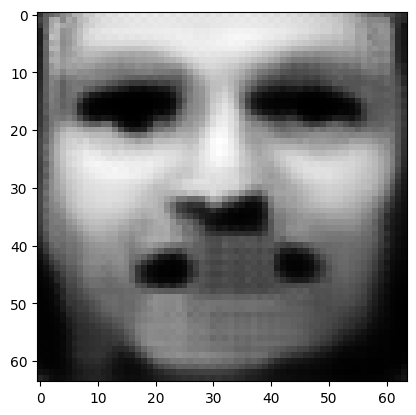

tensor([[7.1784e-06, 2.4801e-05, 1.3149e-04, 1.8579e-04, 8.9857e-01, 3.9002e-06,
         1.2682e-04, 1.2983e-06, 7.8696e-04, 2.3578e-04, 6.0889e-05, 5.4517e-03,
         9.7244e-04, 8.9092e-04, 6.3876e-04, 3.4119e-05, 2.0198e-03, 4.7973e-05,
         2.9904e-05, 2.0908e-05, 1.4797e-02, 3.6227e-03, 5.4001e-03, 8.9662e-05,
         3.6830e-03, 1.3791e-03, 3.5743e-05, 3.7359e-04, 8.1656e-06, 1.2506e-03,
         4.3763e-02, 1.1240e-03, 1.2489e-03, 7.8402e-04, 4.7297e-03, 1.1527e-03,
         7.4911e-04, 9.5699e-04, 1.1486e-03, 3.4623e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10695092380046844
tensor([[7.0049e-06, 2.4142e-05, 1.2791e-04, 1.8115e-04, 9.0077e-01, 3.8378e-06,
         1.2293e-04, 1.2617e-06, 7.6208e-04, 2.3004e-04, 5.8969e-05, 5.3479e-03,
         9.4684e-04, 8.7016e-04, 6.2243e-04, 3.3353e-05, 1.9687e-03, 4.6788e-05,
         2.9043e-05, 2.0322e-05, 1.4453e-02, 3.5378e-03, 5.2953e-03, 8.6873e-05,
         3.5806e-03, 1.3553e-03, 3.4614e-0

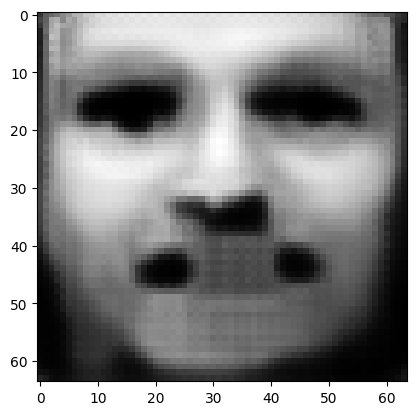

tensor([[6.3934e-06, 2.1810e-05, 1.1594e-04, 1.6538e-04, 9.0854e-01, 3.6208e-06,
         1.0965e-04, 1.1383e-06, 6.7843e-04, 2.1076e-04, 5.2382e-05, 4.9801e-03,
         8.5895e-04, 7.9596e-04, 5.6665e-04, 3.0705e-05, 1.7880e-03, 4.2719e-05,
         2.6101e-05, 1.8333e-05, 1.3261e-02, 3.2409e-03, 4.9344e-03, 7.7424e-05,
         3.2217e-03, 1.2707e-03, 3.0772e-05, 3.1927e-04, 6.7136e-06, 1.1290e-03,
         3.9723e-02, 1.0435e-03, 1.1214e-03, 6.9856e-04, 4.2419e-03, 1.0743e-03,
         6.5419e-04, 8.3272e-04, 9.9100e-04, 3.1111e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09591332823038101
tensor([[6.2655e-06, 2.1308e-05, 1.1318e-04, 1.6180e-04, 9.1027e-01, 3.5709e-06,
         1.0681e-04, 1.1120e-06, 6.6024e-04, 2.0664e-04, 5.0957e-05, 4.8979e-03,
         8.3933e-04, 7.7901e-04, 5.5411e-04, 3.0127e-05, 1.7489e-03, 4.1798e-05,
         2.5471e-05, 1.7891e-05, 1.2987e-02, 3.1756e-03, 4.8516e-03, 7.5420e-05,
         3.1471e-03, 1.2513e-03, 2.9932e-0

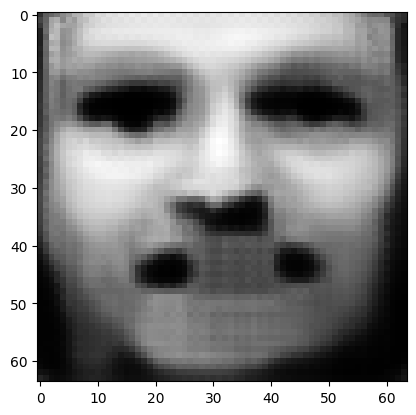

tensor([[5.7904e-06, 1.9525e-05, 1.0381e-04, 1.4940e-04, 9.1644e-01, 3.3919e-06,
         9.6648e-05, 1.0168e-06, 5.9600e-04, 1.9143e-04, 4.5979e-05, 4.5993e-03,
         7.7102e-04, 7.2081e-04, 5.1002e-04, 2.8029e-05, 1.6086e-03, 3.8542e-05,
         2.3213e-05, 1.6355e-05, 1.2040e-02, 2.9434e-03, 4.5572e-03, 6.8199e-05,
         2.8718e-03, 1.1820e-03, 2.7034e-05, 2.7878e-04, 5.6701e-06, 1.0328e-03,
         3.6488e-02, 9.7668e-04, 1.0211e-03, 6.3174e-04, 3.8621e-03, 1.0112e-03,
         5.8187e-04, 7.3771e-04, 8.7220e-04, 2.8400e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0872570276260376
tensor([[5.6882e-06, 1.9130e-05, 1.0165e-04, 1.4659e-04, 9.1784e-01, 3.3506e-06,
         9.4444e-05, 9.9605e-07, 5.8186e-04, 1.8813e-04, 4.4878e-05, 4.5320e-03,
         7.5541e-04, 7.0726e-04, 5.0010e-04, 2.7557e-05, 1.5775e-03, 3.7804e-05,
         2.2724e-05, 1.6007e-05, 1.1821e-02, 2.8915e-03, 4.4905e-03, 6.6634e-05,
         2.8129e-03, 1.1663e-03, 2.6387e-05

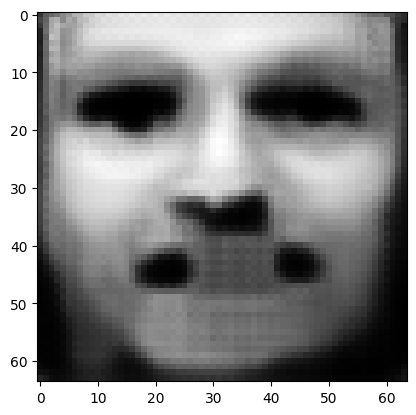

tensor([[5.3080e-06, 1.7708e-05, 9.4087e-05, 1.3654e-04, 9.2285e-01, 3.1993e-06,
         8.6427e-05, 9.2036e-07, 5.3151e-04, 1.7599e-04, 4.0986e-05, 4.2863e-03,
         7.0026e-04, 6.5961e-04, 4.6508e-04, 2.5837e-05, 1.4646e-03, 3.5177e-05,
         2.0947e-05, 1.4784e-05, 1.1051e-02, 2.7041e-03, 4.2513e-03, 6.0983e-05,
         2.5958e-03, 1.1086e-03, 2.4109e-05, 2.4738e-04, 4.8872e-06, 9.5468e-04,
         3.3836e-02, 9.2063e-04, 9.3965e-04, 5.7789e-04, 3.5565e-03, 9.5889e-04,
         5.2486e-04, 6.6275e-04, 7.7924e-04, 2.6205e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08028358966112137
tensor([[5.2197e-06, 1.7385e-05, 9.2366e-05, 1.3426e-04, 9.2400e-01, 3.1640e-06,
         8.4627e-05, 9.0299e-07, 5.2023e-04, 1.7314e-04, 4.0116e-05, 4.2291e-03,
         6.8764e-04, 6.4895e-04, 4.5699e-04, 2.5436e-05, 1.4395e-03, 3.4577e-05,
         2.0541e-05, 1.4505e-05, 1.0876e-02, 2.6615e-03, 4.1965e-03, 5.9692e-05,
         2.5462e-03, 1.0954e-03, 2.3593e-0

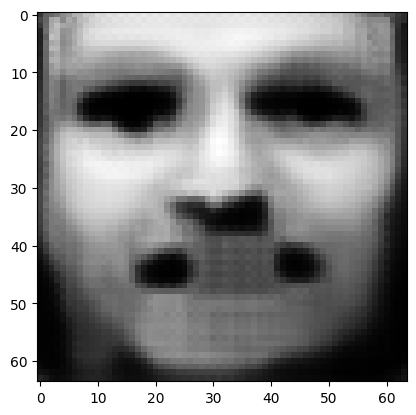

tensor([[4.9056e-06, 1.6223e-05, 8.6199e-05, 1.2600e-04, 9.2817e-01, 3.0357e-06,
         7.8228e-05, 8.4145e-07, 4.8002e-04, 1.6302e-04, 3.7003e-05, 4.0212e-03,
         6.4233e-04, 6.1003e-04, 4.2784e-04, 2.3999e-05, 1.3483e-03, 3.2416e-05,
         1.9096e-05, 1.3502e-05, 1.0237e-02, 2.5069e-03, 3.9962e-03, 5.5114e-05,
         2.3705e-03, 1.0468e-03, 2.1756e-05, 2.2237e-04, 4.2800e-06, 8.8937e-04,
         3.1623e-02, 8.7340e-04, 8.7269e-04, 5.3374e-04, 3.3056e-03, 9.1376e-04,
         4.7889e-04, 6.0309e-04, 7.0494e-04, 2.4382e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07454295456409454
tensor([[4.8352e-06, 1.5962e-05, 8.4796e-05, 1.2412e-04, 9.2912e-01, 3.0061e-06,
         7.6791e-05, 8.2761e-07, 4.7098e-04, 1.6072e-04, 3.6305e-05, 3.9739e-03,
         6.3207e-04, 6.0119e-04, 4.2121e-04, 2.3675e-05, 1.3276e-03, 3.1929e-05,
         1.8771e-05, 1.3276e-05, 1.0092e-02, 2.4715e-03, 3.9495e-03, 5.4090e-05,
         2.3312e-03, 1.0355e-03, 2.1344e-0

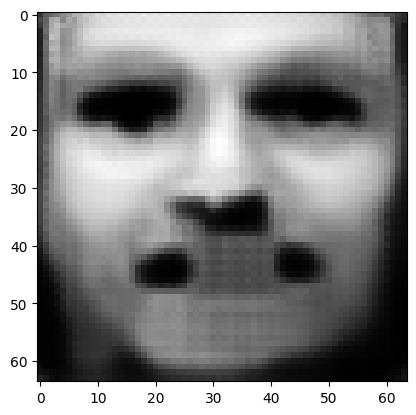

tensor([[4.5790e-06, 1.5017e-05, 7.9802e-05, 1.1734e-04, 9.3257e-01, 2.8990e-06,
         7.1637e-05, 7.7781e-07, 4.3872e-04, 1.5244e-04, 3.3805e-05, 3.8018e-03,
         5.9521e-04, 5.6921e-04, 3.9729e-04, 2.2501e-05, 1.2526e-03, 3.0163e-05,
         1.7604e-05, 1.2463e-05, 9.5653e-03, 2.3439e-03, 3.7816e-03, 5.0411e-05,
         2.1886e-03, 9.9452e-04, 1.9876e-05, 2.0233e-04, 3.8079e-06, 8.3576e-04,
         2.9780e-02, 8.3340e-04, 8.1752e-04, 4.9741e-04, 3.0979e-03, 8.7568e-04,
         4.4146e-04, 5.5503e-04, 6.4497e-04, 2.2896e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06981628388166428
tensor([[4.5214e-06, 1.4804e-05, 7.8651e-05, 1.1576e-04, 9.3335e-01, 2.8741e-06,
         7.0485e-05, 7.6661e-07, 4.3146e-04, 1.5057e-04, 3.3244e-05, 3.7625e-03,
         5.8680e-04, 5.6188e-04, 3.9179e-04, 2.2234e-05, 1.2357e-03, 2.9758e-05,
         1.7341e-05, 1.2276e-05, 9.4433e-03, 2.3148e-03, 3.7424e-03, 4.9586e-05,
         2.1572e-03, 9.8511e-04, 1.9546e-0

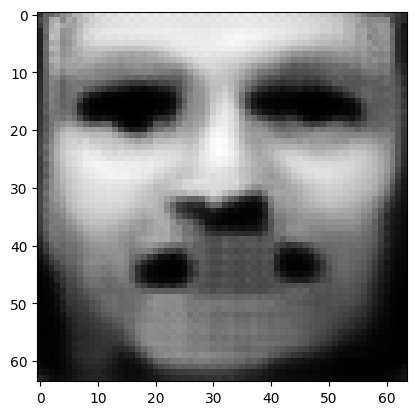

tensor([[4.3098e-06, 1.4020e-05, 7.4565e-05, 1.1014e-04, 9.3624e-01, 2.7844e-06,
         6.6296e-05, 7.2609e-07, 4.0531e-04, 1.4381e-04, 3.1207e-05, 3.6185e-03,
         5.5650e-04, 5.3501e-04, 3.7197e-04, 2.1267e-05, 1.1739e-03, 2.8289e-05,
         1.6386e-05, 1.1608e-05, 9.0035e-03, 2.2085e-03, 3.6024e-03, 4.6602e-05,
         2.0402e-03, 9.5040e-04, 1.8357e-05, 1.8615e-04, 3.4350e-06, 7.9095e-04,
         2.8228e-02, 7.9923e-04, 7.7157e-04, 4.6709e-04, 2.9251e-03, 8.4328e-04,
         4.1078e-04, 5.1552e-04, 5.9602e-04, 2.1658e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06588346511125565
tensor([[4.2613e-06, 1.3842e-05, 7.3598e-05, 1.0883e-04, 9.3691e-01, 2.7630e-06,
         6.5330e-05, 7.1666e-07, 3.9924e-04, 1.4220e-04, 3.0741e-05, 3.5850e-03,
         5.4949e-04, 5.2889e-04, 3.6736e-04, 2.1042e-05, 1.1597e-03, 2.7950e-05,
         1.6164e-05, 1.1452e-05, 8.9022e-03, 2.1837e-03, 3.5687e-03, 4.5917e-05,
         2.0136e-03, 9.4235e-04, 1.8083e-0

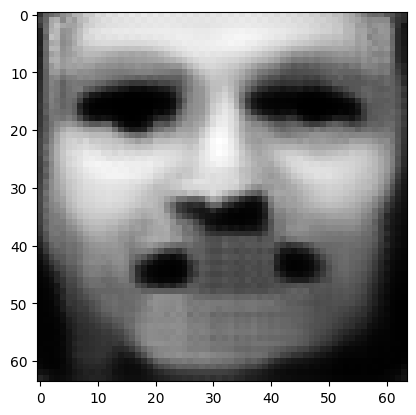

tensor([[4.0835e-06, 1.3184e-05, 7.0146e-05, 1.0401e-04, 9.3936e-01, 2.6848e-06,
         6.1832e-05, 6.8260e-07, 3.7732e-04, 1.3643e-04, 2.9039e-05, 3.4622e-03,
         5.2405e-04, 5.0631e-04, 3.5040e-04, 2.0222e-05, 1.1078e-03, 2.6705e-05,
         1.5358e-05, 1.0885e-05, 8.5293e-03, 2.0929e-03, 3.4460e-03, 4.3429e-05,
         1.9163e-03, 9.1249e-04, 1.7090e-05, 1.7272e-04, 3.1311e-06, 7.5259e-04,
         2.6908e-02, 7.6993e-04, 7.3237e-04, 4.4139e-04, 2.7784e-03, 8.1482e-04,
         3.8498e-04, 4.8259e-04, 5.5521e-04, 2.0616e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06255512684583664
tensor([[4.0424e-06, 1.3034e-05, 6.9354e-05, 1.0290e-04, 9.3993e-01, 2.6665e-06,
         6.1020e-05, 6.7473e-07, 3.7227e-04, 1.3507e-04, 2.8649e-05, 3.4340e-03,
         5.1817e-04, 5.0117e-04, 3.4649e-04, 2.0034e-05, 1.0957e-03, 2.6423e-05,
         1.5173e-05, 1.0756e-05, 8.4450e-03, 2.0717e-03, 3.4167e-03, 4.2859e-05,
         1.8935e-03, 9.0550e-04, 1.6863e-0

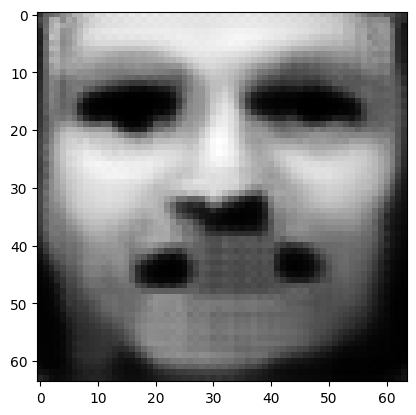

tensor([[3.8891e-06, 1.2473e-05, 6.6414e-05, 9.8773e-05, 9.4204e-01, 2.5983e-06,
         5.8048e-05, 6.4566e-07, 3.5370e-04, 1.3007e-04, 2.7213e-05, 3.3279e-03,
         4.9670e-04, 4.8196e-04, 3.3210e-04, 1.9331e-05, 1.0510e-03, 2.5364e-05,
         1.4483e-05, 1.0274e-05, 8.1282e-03, 1.9929e-03, 3.3101e-03, 4.0760e-05,
         1.8108e-03, 8.7964e-04, 1.6026e-05, 1.6143e-04, 2.8801e-06, 7.1965e-04,
         2.5771e-02, 7.4437e-04, 6.9868e-04, 4.1948e-04, 2.6516e-03, 7.8975e-04,
         3.6301e-04, 4.5467e-04, 5.2079e-04, 1.9725e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05970945954322815
tensor([[3.8532e-06, 1.2342e-05, 6.5770e-05, 9.7853e-05, 9.4253e-01, 2.5830e-06,
         5.7371e-05, 6.3908e-07, 3.4953e-04, 1.2895e-04, 2.6884e-05, 3.3035e-03,
         4.9186e-04, 4.7751e-04, 3.2885e-04, 1.9171e-05, 1.0406e-03, 2.5124e-05,
         1.4325e-05, 1.0166e-05, 8.0564e-03, 1.9749e-03, 3.2865e-03, 4.0282e-05,
         1.7914e-03, 8.7365e-04, 1.5837e-0

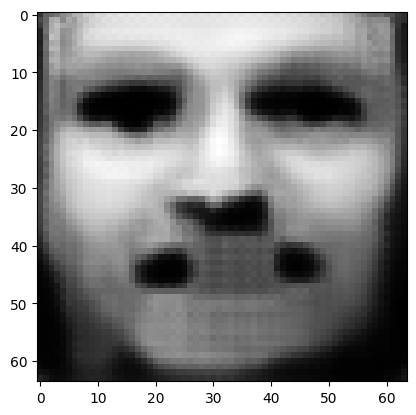

tensor([[3.7206e-06, 1.1859e-05, 6.3243e-05, 9.4286e-05, 9.4436e-01, 2.5232e-06,
         5.4834e-05, 6.1416e-07, 3.3375e-04, 1.2465e-04, 2.5662e-05, 3.2111e-03,
         4.7332e-04, 4.6083e-04, 3.1645e-04, 1.8564e-05, 1.0022e-03, 2.4212e-05,
         1.3735e-05, 9.7538e-06, 7.7817e-03, 1.9068e-03, 3.1938e-03, 3.8493e-05,
         1.7202e-03, 8.5089e-04, 1.5124e-05, 1.5187e-04, 2.6711e-06, 6.9110e-04,
         2.4779e-02, 7.2181e-04, 6.6959e-04, 4.0054e-04, 2.5417e-03, 7.6775e-04,
         3.4422e-04, 4.3069e-04, 4.9147e-04, 1.8947e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05724684149026871
tensor([[3.6901e-06, 1.1748e-05, 6.2638e-05, 9.3435e-05, 9.4479e-01, 2.5089e-06,
         5.4239e-05, 6.0827e-07, 3.3002e-04, 1.2361e-04, 2.5377e-05, 3.1895e-03,
         4.6895e-04, 4.5696e-04, 3.1352e-04, 1.8420e-05, 9.9312e-04, 2.3998e-05,
         1.3596e-05, 9.6565e-06, 7.7171e-03, 1.8907e-03, 3.1713e-03, 3.8075e-05,
         1.7037e-03, 8.4551e-04, 1.4957e-0

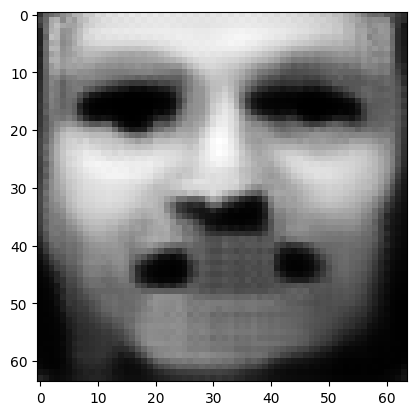

tensor([[3.5745e-06, 1.1327e-05, 6.0445e-05, 9.0322e-05, 9.4640e-01, 2.4561e-06,
         5.2061e-05, 5.8668e-07, 3.1645e-04, 1.1987e-04, 2.4321e-05, 3.1079e-03,
         4.5294e-04, 4.4233e-04, 3.0267e-04, 1.7890e-05, 9.5954e-04, 2.3199e-05,
         1.3084e-05, 9.2971e-06, 7.4751e-03, 1.8310e-03, 3.0894e-03, 3.6534e-05,
         1.6424e-03, 8.2537e-04, 1.4344e-05, 1.4364e-04, 2.4933e-06, 6.6598e-04,
         2.3911e-02, 7.0189e-04, 6.4398e-04, 3.8394e-04, 2.4452e-03, 7.4814e-04,
         3.2786e-04, 4.0994e-04, 4.6610e-04, 1.8272e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0550914965569973
tensor([[3.5477e-06, 1.1230e-05, 5.9928e-05, 8.9576e-05, 9.4678e-01, 2.4435e-06,
         5.1551e-05, 5.8164e-07, 3.1327e-04, 1.1900e-04, 2.4076e-05, 3.0889e-03,
         4.4916e-04, 4.3892e-04, 3.0012e-04, 1.7767e-05, 9.5170e-04, 2.3012e-05,
         1.2966e-05, 9.2131e-06, 7.4179e-03, 1.8170e-03, 3.0697e-03, 3.6176e-05,
         1.6282e-03, 8.2053e-04, 1.4202e-05

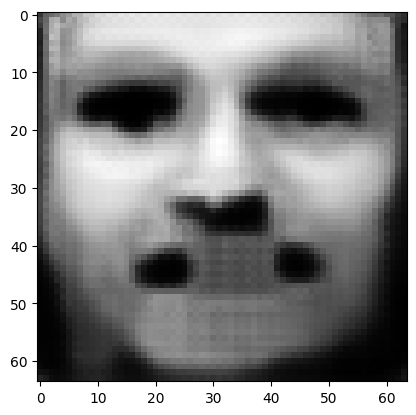

tensor([[3.4471e-06, 1.0862e-05, 5.8046e-05, 8.6886e-05, 9.4819e-01, 2.3975e-06,
         4.9667e-05, 5.6300e-07, 3.0161e-04, 1.1576e-04, 2.3162e-05, 3.0174e-03,
         4.3531e-04, 4.2607e-04, 2.9068e-04, 1.7306e-05, 9.2229e-04, 2.2321e-05,
         1.2521e-05, 8.9032e-06, 7.2070e-03, 1.7648e-03, 2.9986e-03, 3.4846e-05,
         1.5743e-03, 8.0261e-04, 1.3674e-05, 1.3654e-04, 2.3427e-06, 6.4404e-04,
         2.3139e-02, 6.8402e-04, 6.2167e-04, 3.6938e-04, 2.3605e-03, 7.3079e-04,
         3.1362e-04, 3.9191e-04, 4.4410e-04, 1.7679e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05319659039378166
tensor([[3.4233e-06, 1.0777e-05, 5.7588e-05, 8.6234e-05, 9.4853e-01, 2.3863e-06,
         4.9223e-05, 5.5855e-07, 2.9884e-04, 1.1498e-04, 2.2950e-05, 3.0003e-03,
         4.3200e-04, 4.2308e-04, 2.8845e-04, 1.7197e-05, 9.1541e-04, 2.2156e-05,
         1.2416e-05, 8.8296e-06, 7.1566e-03, 1.7524e-03, 2.9813e-03, 3.4531e-05,
         1.5619e-03, 7.9833e-04, 1.3549e-0

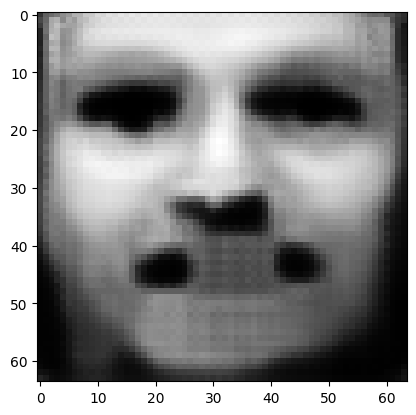

tensor([[3.3344e-06, 1.0453e-05, 5.5910e-05, 8.3822e-05, 9.4979e-01, 2.3448e-06,
         4.7571e-05, 5.4205e-07, 2.8859e-04, 1.1209e-04, 2.2149e-05, 2.9362e-03,
         4.1970e-04, 4.1172e-04, 2.8004e-04, 1.6787e-05, 8.8944e-04, 2.1544e-05,
         1.2024e-05, 8.5545e-06, 6.9680e-03, 1.7059e-03, 2.9167e-03, 3.3361e-05,
         1.5148e-03, 7.8221e-04, 1.3084e-05, 1.3033e-04, 2.2125e-06, 6.2456e-04,
         2.2454e-02, 6.6811e-04, 6.0191e-04, 3.5648e-04, 2.2857e-03, 7.1519e-04,
         3.0108e-04, 3.7617e-04, 4.2484e-04, 1.7158e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05151810497045517
tensor([[3.3139e-06, 1.0377e-05, 5.5509e-05, 8.3247e-05, 9.5008e-01, 2.3349e-06,
         4.7185e-05, 5.3819e-07, 2.8617e-04, 1.1141e-04, 2.1961e-05, 2.9211e-03,
         4.1677e-04, 4.0902e-04, 2.7803e-04, 1.6690e-05, 8.8335e-04, 2.1400e-05,
         1.1933e-05, 8.4893e-06, 6.9231e-03, 1.6950e-03, 2.9011e-03, 3.3087e-05,
         1.5038e-03, 7.7838e-04, 1.2975e-0

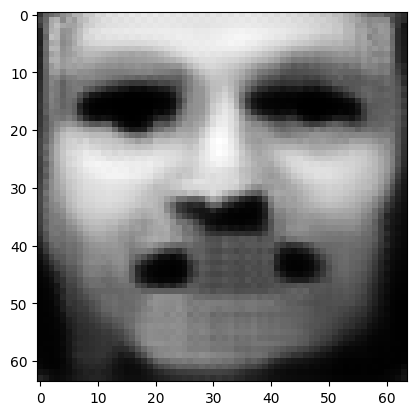

tensor([[3.2347e-06, 1.0089e-05, 5.4024e-05, 8.1091e-05, 9.5121e-01, 2.2973e-06,
         4.5727e-05, 5.2357e-07, 2.7713e-04, 1.0884e-04, 2.1254e-05, 2.8639e-03,
         4.0585e-04, 3.9892e-04, 2.7055e-04, 1.6325e-05, 8.6028e-04, 2.0856e-05,
         1.1585e-05, 8.2451e-06, 6.7552e-03, 1.6535e-03, 2.8434e-03, 3.2055e-05,
         1.4622e-03, 7.6385e-04, 1.2564e-05, 1.2487e-04, 2.0992e-06, 6.0715e-04,
         2.1842e-02, 6.5372e-04, 5.8429e-04, 3.4497e-04, 2.2192e-03, 7.0110e-04,
         2.8996e-04, 3.6223e-04, 4.0783e-04, 1.6693e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0500226654112339
tensor([[3.2158e-06, 1.0021e-05, 5.3688e-05, 8.0601e-05, 9.5147e-01, 2.2886e-06,
         4.5386e-05, 5.2014e-07, 2.7504e-04, 1.0824e-04, 2.1087e-05, 2.8506e-03,
         4.0334e-04, 3.9656e-04, 2.6881e-04, 1.6239e-05, 8.5485e-04, 2.0729e-05,
         1.1504e-05, 8.1887e-06, 6.7166e-03, 1.6437e-03, 2.8303e-03, 3.1814e-05,
         1.4521e-03, 7.6045e-04, 1.2469e-05

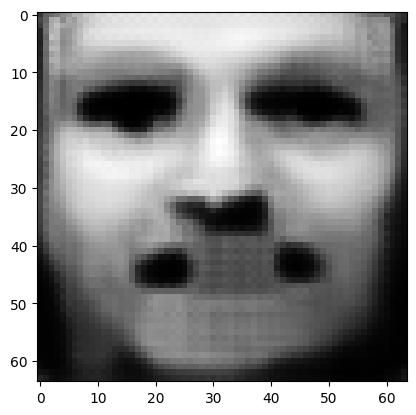

tensor([[3.1454e-06, 9.7637e-06, 5.2343e-05, 7.8657e-05, 9.5248e-01, 2.2543e-06,
         4.4090e-05, 5.0704e-07, 2.6698e-04, 1.0591e-04, 2.0457e-05, 2.7992e-03,
         3.9352e-04, 3.8752e-04, 2.6204e-04, 1.5908e-05, 8.3435e-04, 2.0241e-05,
         1.1193e-05, 7.9689e-06, 6.5658e-03, 1.6063e-03, 2.7776e-03, 3.0897e-05,
         1.4151e-03, 7.4742e-04, 1.2102e-05, 1.2004e-04, 1.9998e-06, 5.9138e-04,
         2.1292e-02, 6.4068e-04, 5.6846e-04, 3.3463e-04, 2.1595e-03, 6.8820e-04,
         2.8007e-04, 3.4982e-04, 3.9276e-04, 1.6274e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04868418723344803
tensor([[3.1283e-06, 9.7015e-06, 5.2050e-05, 7.8222e-05, 9.5272e-01, 2.2466e-06,
         4.3787e-05, 5.0402e-07, 2.6514e-04, 1.0539e-04, 2.0309e-05, 2.7871e-03,
         3.9128e-04, 3.8537e-04, 2.6050e-04, 1.5831e-05, 8.2943e-04, 2.0128e-05,
         1.1121e-05, 7.9190e-06, 6.5312e-03, 1.5976e-03, 2.7660e-03, 3.0683e-05,
         1.4061e-03, 7.4432e-04, 1.2018e-0

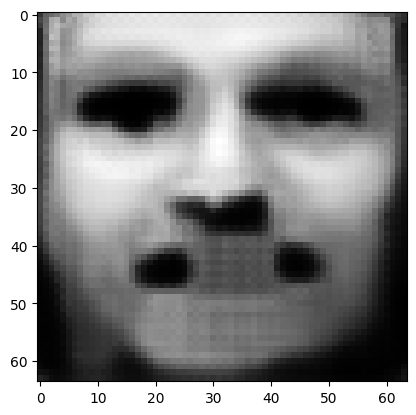

tensor([[3.0652e-06, 9.4712e-06, 5.0860e-05, 7.6498e-05, 9.5363e-01, 2.2159e-06,
         4.2628e-05, 4.9236e-07, 2.5797e-04, 1.0331e-04, 1.9747e-05, 2.7408e-03,
         3.8257e-04, 3.7725e-04, 2.5447e-04, 1.5535e-05, 8.1096e-04, 1.9692e-05,
         1.0843e-05, 7.7239e-06, 6.3967e-03, 1.5641e-03, 2.7192e-03, 2.9866e-05,
         1.3727e-03, 7.3254e-04, 1.1692e-05, 1.1575e-04, 1.9125e-06, 5.7722e-04,
         2.0792e-02, 6.2875e-04, 5.5426e-04, 3.2536e-04, 2.1056e-03, 6.7651e-04,
         2.7125e-04, 3.3870e-04, 3.7931e-04, 1.5896e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047478750348091125
tensor([[3.0504e-06, 9.4166e-06, 5.0575e-05, 7.6084e-05, 9.5385e-01, 2.2085e-06,
         4.2355e-05, 4.8959e-07, 2.5627e-04, 1.0282e-04, 1.9613e-05, 2.7298e-03,
         3.8047e-04, 3.7531e-04, 2.5302e-04, 1.5465e-05, 8.0658e-04, 1.9589e-05,
         1.0778e-05, 7.6772e-06, 6.3645e-03, 1.5561e-03, 2.7077e-03, 2.9673e-05,
         1.3648e-03, 7.2970e-04, 1.1614e-

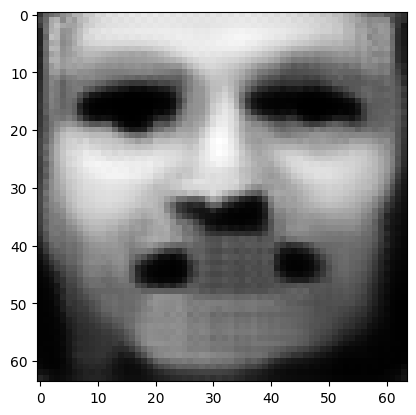

tensor([[2.9933e-06, 9.2090e-06, 4.9508e-05, 7.4536e-05, 9.5467e-01, 2.1806e-06,
         4.1317e-05, 4.7913e-07, 2.4987e-04, 1.0095e-04, 1.9110e-05, 2.6878e-03,
         3.7262e-04, 3.6795e-04, 2.4759e-04, 1.5198e-05, 7.8995e-04, 1.9196e-05,
         1.0529e-05, 7.5024e-06, 6.2433e-03, 1.5258e-03, 2.6652e-03, 2.8943e-05,
         1.3347e-03, 7.1896e-04, 1.1323e-05, 1.1190e-04, 1.8349e-06, 5.6439e-04,
         2.0340e-02, 6.1792e-04, 5.4140e-04, 3.1697e-04, 2.0570e-03, 6.6582e-04,
         2.6329e-04, 3.2875e-04, 3.6726e-04, 1.5556e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04638829082250595
tensor([[2.9799e-06, 9.1596e-06, 4.9252e-05, 7.4159e-05, 9.5487e-01, 2.1738e-06,
         4.1072e-05, 4.7665e-07, 2.4835e-04, 1.0051e-04, 1.8990e-05, 2.6778e-03,
         3.7074e-04, 3.6619e-04, 2.4627e-04, 1.5135e-05, 7.8598e-04, 1.9102e-05,
         1.0470e-05, 7.4604e-06, 6.2139e-03, 1.5185e-03, 2.6548e-03, 2.8770e-05,
         1.3277e-03, 7.1636e-04, 1.1253e-0

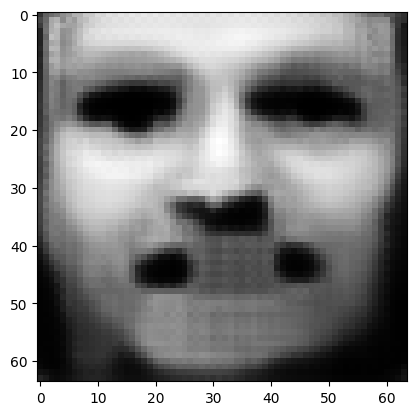

tensor([[2.9283e-06, 8.9719e-06, 4.8286e-05, 7.2752e-05, 9.5562e-01, 2.1483e-06,
         4.0137e-05, 4.6718e-07, 2.4257e-04, 9.8804e-05, 1.8537e-05, 2.6394e-03,
         3.6366e-04, 3.5955e-04, 2.4134e-04, 1.4892e-05, 7.7092e-04, 1.8748e-05,
         1.0244e-05, 7.3024e-06, 6.1040e-03, 1.4910e-03, 2.6158e-03, 2.8112e-05,
         1.3004e-03, 7.0647e-04, 1.0991e-05, 1.0844e-04, 1.7658e-06, 5.5275e-04,
         1.9928e-02, 6.0798e-04, 5.2977e-04, 3.0937e-04, 2.0131e-03, 6.5605e-04,
         2.5611e-04, 3.1978e-04, 3.5643e-04, 1.5247e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045398034155368805
tensor([[2.9162e-06, 8.9275e-06, 4.8051e-05, 7.2411e-05, 9.5580e-01, 2.1420e-06,
         3.9914e-05, 4.6489e-07, 2.4119e-04, 9.8387e-05, 1.8428e-05, 2.6302e-03,
         3.6195e-04, 3.5797e-04, 2.4014e-04, 1.4833e-05, 7.6736e-04, 1.8664e-05,
         1.0190e-05, 7.2644e-06, 6.0777e-03, 1.4844e-03, 2.6062e-03, 2.7954e-05,
         1.2939e-03, 7.0408e-04, 1.0927e-

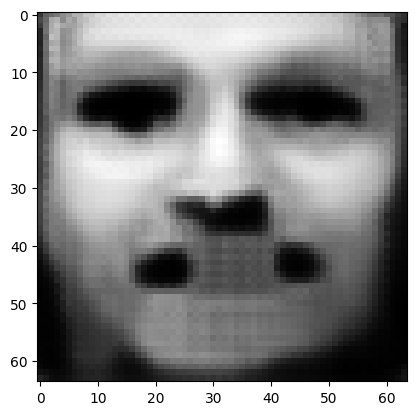

tensor([[2.8698e-06, 8.7571e-06, 4.7173e-05, 7.1129e-05, 9.5648e-01, 2.1186e-06,
         3.9070e-05, 4.5628e-07, 2.3596e-04, 9.6836e-05, 1.8016e-05, 2.5952e-03,
         3.5555e-04, 3.5193e-04, 2.3564e-04, 1.4611e-05, 7.5373e-04, 1.8343e-05,
         9.9850e-06, 7.1206e-06, 5.9773e-03, 1.4593e-03, 2.5707e-03, 2.7359e-05,
         1.2691e-03, 6.9499e-04, 1.0689e-05, 1.0531e-04, 1.7040e-06, 5.4210e-04,
         1.9553e-02, 5.9888e-04, 5.1919e-04, 3.0245e-04, 1.9731e-03, 6.4703e-04,
         2.4964e-04, 3.1170e-04, 3.4665e-04, 1.4964e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04449687525629997
tensor([[2.8587e-06, 8.7164e-06, 4.6972e-05, 7.0835e-05, 9.5664e-01, 2.1132e-06,
         3.8871e-05, 4.5427e-07, 2.3475e-04, 9.6479e-05, 1.7920e-05, 2.5870e-03,
         3.5405e-04, 3.5049e-04, 2.3460e-04, 1.4559e-05, 7.5053e-04, 1.8267e-05,
         9.9367e-06, 7.0875e-06, 5.9539e-03, 1.4535e-03, 2.5627e-03, 2.7219e-05,
         1.2631e-03, 6.9284e-04, 1.0634e-0

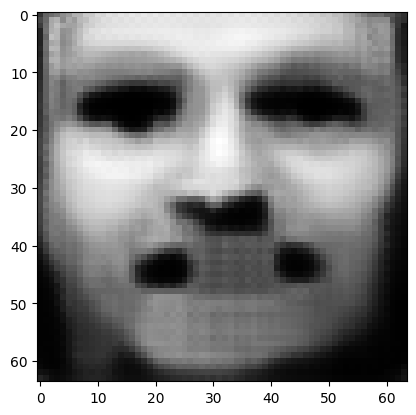

tensor([[2.8164e-06, 8.5611e-06, 4.6173e-05, 6.9663e-05, 9.5727e-01, 2.0917e-06,
         3.8105e-05, 4.4643e-07, 2.3001e-04, 9.5061e-05, 1.7546e-05, 2.5550e-03,
         3.4822e-04, 3.4497e-04, 2.3049e-04, 1.4356e-05, 7.3807e-04, 1.7975e-05,
         9.7502e-06, 6.9567e-06, 5.8622e-03, 1.4306e-03, 2.5300e-03, 2.6679e-05,
         1.2406e-03, 6.8446e-04, 1.0418e-05, 1.0248e-04, 1.6485e-06, 5.3238e-04,
         1.9209e-02, 5.9049e-04, 5.0956e-04, 2.9615e-04, 1.9366e-03, 6.3878e-04,
         2.4377e-04, 3.0432e-04, 3.3778e-04, 1.4703e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04367467388510704
tensor([[2.8063e-06, 8.5242e-06, 4.5978e-05, 6.9379e-05, 9.5742e-01, 2.0864e-06,
         3.7922e-05, 4.4456e-07, 2.2888e-04, 9.4721e-05, 1.7457e-05, 2.5472e-03,
         3.4680e-04, 3.4364e-04, 2.2950e-04, 1.4308e-05, 7.3510e-04, 1.7905e-05,
         9.7057e-06, 6.9253e-06, 5.8401e-03, 1.4251e-03, 2.5220e-03, 2.6550e-05,
         1.2352e-03, 6.8244e-04, 1.0366e-0

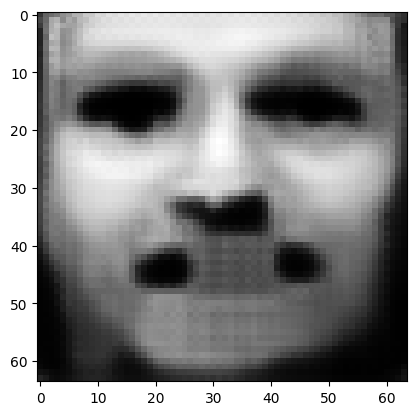

tensor([[2.7681e-06, 8.3832e-06, 4.5244e-05, 6.8305e-05, 9.5799e-01, 2.0666e-06,
         3.7225e-05, 4.3744e-07, 2.2457e-04, 9.3434e-05, 1.7117e-05, 2.5180e-03,
         3.4145e-04, 3.3858e-04, 2.2574e-04, 1.4123e-05, 7.2379e-04, 1.7637e-05,
         9.5363e-06, 6.8059e-06, 5.7558e-03, 1.4041e-03, 2.4919e-03, 2.6060e-05,
         1.2147e-03, 6.7473e-04, 1.0170e-05, 9.9908e-05, 1.5984e-06, 5.2346e-04,
         1.8894e-02, 5.8278e-04, 5.0069e-04, 2.9037e-04, 1.9033e-03, 6.3117e-04,
         2.3840e-04, 2.9761e-04, 3.2971e-04, 1.4466e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0429203175008297
tensor([[2.7587e-06, 8.3491e-06, 4.5067e-05, 6.8047e-05, 9.5813e-01, 2.0617e-06,
         3.7057e-05, 4.3571e-07, 2.2353e-04, 9.3116e-05, 1.7035e-05, 2.5108e-03,
         3.4016e-04, 3.3736e-04, 2.2484e-04, 1.4078e-05, 7.2104e-04, 1.7573e-05,
         9.4953e-06, 6.7771e-06, 5.7356e-03, 1.3991e-03, 2.4846e-03, 2.5942e-05,
         1.2097e-03, 6.7286e-04, 1.0122e-05

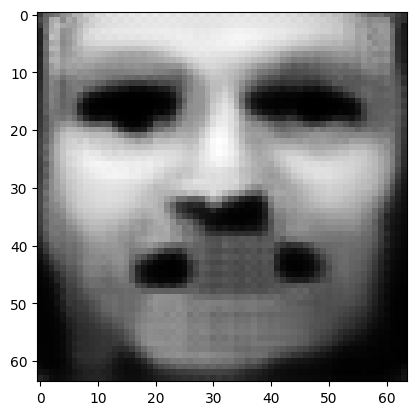

tensor([[2.7228e-06, 8.2196e-06, 4.4387e-05, 6.7057e-05, 9.5866e-01, 2.0431e-06,
         3.6409e-05, 4.2907e-07, 2.1951e-04, 9.1898e-05, 1.6723e-05, 2.4832e-03,
         3.3519e-04, 3.3271e-04, 2.2137e-04, 1.3905e-05, 7.1046e-04, 1.7324e-05,
         9.3389e-06, 6.6672e-06, 5.6579e-03, 1.3797e-03, 2.4562e-03, 2.5487e-05,
         1.1905e-03, 6.6567e-04, 9.9407e-06, 9.7530e-05, 1.5523e-06, 5.1520e-04,
         1.8601e-02, 5.7563e-04, 4.9247e-04, 2.8506e-04, 1.8722e-03, 6.2410e-04,
         2.3344e-04, 2.9143e-04, 3.2228e-04, 1.4246e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042220588773489
tensor([[2.7141e-06, 8.1881e-06, 4.4225e-05, 6.6817e-05, 9.5879e-01, 2.0385e-06,
         3.6256e-05, 4.2749e-07, 2.1856e-04, 9.1609e-05, 1.6648e-05, 2.4766e-03,
         3.3399e-04, 3.3158e-04, 2.2053e-04, 1.3863e-05, 7.0794e-04, 1.7264e-05,
         9.3014e-06, 6.6406e-06, 5.6390e-03, 1.3750e-03, 2.4495e-03, 2.5378e-05,
         1.1860e-03, 6.6394e-04, 9.8971e-06,

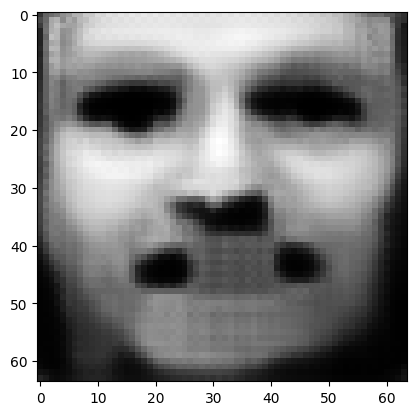

tensor([[2.6811e-06, 8.0690e-06, 4.3605e-05, 6.5914e-05, 9.5928e-01, 2.0214e-06,
         3.5666e-05, 4.2144e-07, 2.1492e-04, 9.0502e-05, 1.6363e-05, 2.4512e-03,
         3.2943e-04, 3.2727e-04, 2.1735e-04, 1.3705e-05, 6.9828e-04, 1.7035e-05,
         9.1590e-06, 6.5402e-06, 5.5674e-03, 1.3573e-03, 2.4236e-03, 2.4963e-05,
         1.1685e-03, 6.5732e-04, 9.7315e-06, 9.5363e-05, 1.5106e-06, 5.0759e-04,
         1.8331e-02, 5.6900e-04, 4.8493e-04, 2.8017e-04, 1.8437e-03, 6.1758e-04,
         2.2891e-04, 2.8577e-04, 3.1548e-04, 1.4043e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041576407849788666
tensor([[2.6731e-06, 8.0403e-06, 4.3453e-05, 6.5693e-05, 9.5939e-01, 2.0172e-06,
         3.5524e-05, 4.1996e-07, 2.1404e-04, 9.0229e-05, 1.6294e-05, 2.4451e-03,
         3.2832e-04, 3.2624e-04, 2.1658e-04, 1.3666e-05, 6.9596e-04, 1.6980e-05,
         9.1243e-06, 6.5157e-06, 5.5501e-03, 1.3530e-03, 2.4172e-03, 2.4863e-05,
         1.1643e-03, 6.5573e-04, 9.6914e-

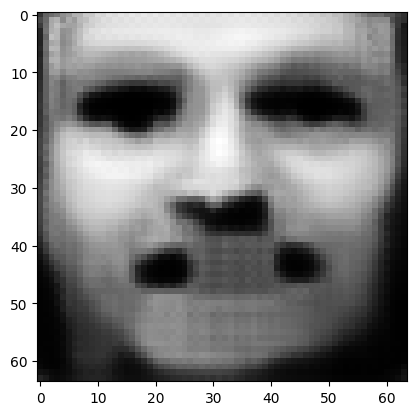

tensor([[2.6428e-06, 7.9307e-06, 4.2884e-05, 6.4860e-05, 9.5985e-01, 2.0012e-06,
         3.4983e-05, 4.1439e-07, 2.1070e-04, 8.9211e-05, 1.6032e-05, 2.4217e-03,
         3.2414e-04, 3.2228e-04, 2.1365e-04, 1.3520e-05, 6.8702e-04, 1.6769e-05,
         8.9931e-06, 6.4234e-06, 5.4843e-03, 1.3366e-03, 2.3932e-03, 2.4482e-05,
         1.1481e-03, 6.4959e-04, 9.5399e-06, 9.3379e-05, 1.4725e-06, 5.0058e-04,
         1.8082e-02, 5.6286e-04, 4.7796e-04, 2.7567e-04, 1.8172e-03, 6.1150e-04,
         2.2474e-04, 2.8057e-04, 3.0924e-04, 1.3856e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040982846170663834
tensor([[2.6355e-06, 7.9047e-06, 4.2743e-05, 6.4657e-05, 9.5995e-01, 1.9973e-06,
         3.4851e-05, 4.1303e-07, 2.0988e-04, 8.8957e-05, 1.5969e-05, 2.4160e-03,
         3.2313e-04, 3.2134e-04, 2.1294e-04, 1.3484e-05, 6.8487e-04, 1.6718e-05,
         8.9612e-06, 6.4008e-06, 5.4683e-03, 1.3326e-03, 2.3874e-03, 2.4390e-05,
         1.1443e-03, 6.4813e-04, 9.5033e-

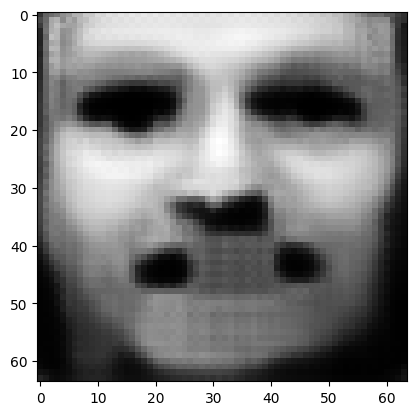

tensor([[2.6074e-06, 7.8037e-06, 4.2219e-05, 6.3892e-05, 9.6037e-01, 1.9826e-06,
         3.4354e-05, 4.0791e-07, 2.0682e-04, 8.8020e-05, 1.5729e-05, 2.3944e-03,
         3.1927e-04, 3.1766e-04, 2.1025e-04, 1.3349e-05, 6.7664e-04, 1.6524e-05,
         8.8409e-06, 6.3160e-06, 5.4074e-03, 1.3175e-03, 2.3653e-03, 2.4040e-05,
         1.1294e-03, 6.4246e-04, 9.3642e-06, 9.1561e-05, 1.4377e-06, 4.9409e-04,
         1.7851e-02, 5.5719e-04, 4.7152e-04, 2.7152e-04, 1.7927e-03, 6.0589e-04,
         2.2091e-04, 2.7579e-04, 3.0351e-04, 1.3683e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040434613823890686
tensor([[2.6006e-06, 7.7790e-06, 4.2101e-05, 6.3716e-05, 9.6047e-01, 1.9792e-06,
         3.4237e-05, 4.0672e-07, 2.0611e-04, 8.7806e-05, 1.5672e-05, 2.3892e-03,
         3.1838e-04, 3.1678e-04, 2.0963e-04, 1.3317e-05, 6.7467e-04, 1.6478e-05,
         8.8123e-06, 6.2962e-06, 5.3931e-03, 1.3140e-03, 2.3603e-03, 2.3958e-05,
         1.1259e-03, 6.4111e-04, 9.3317e-

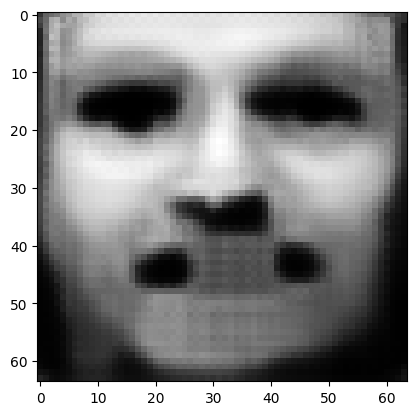

tensor([[2.5746e-06, 7.6857e-06, 4.1614e-05, 6.3007e-05, 9.6086e-01, 1.9655e-06,
         3.3778e-05, 4.0196e-07, 2.0327e-04, 8.6933e-05, 1.5450e-05, 2.3690e-03,
         3.1481e-04, 3.1339e-04, 2.0713e-04, 1.3192e-05, 6.6706e-04, 1.6298e-05,
         8.7007e-06, 6.2176e-06, 5.3366e-03, 1.3000e-03, 2.3398e-03, 2.3635e-05,
         1.1121e-03, 6.3585e-04, 9.2033e-06, 8.9895e-05, 1.4060e-06, 4.8809e-04,
         1.7637e-02, 5.5189e-04, 4.6558e-04, 2.6769e-04, 1.7701e-03, 6.0068e-04,
         2.1739e-04, 2.7136e-04, 2.9825e-04, 1.3522e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039928000420331955
tensor([[2.5685e-06, 7.6635e-06, 4.1495e-05, 6.2834e-05, 9.6095e-01, 1.9622e-06,
         3.3667e-05, 4.0082e-07, 2.0259e-04, 8.6721e-05, 1.5397e-05, 2.3642e-03,
         3.1395e-04, 3.1257e-04, 2.0653e-04, 1.3162e-05, 6.6521e-04, 1.6255e-05,
         8.6740e-06, 6.1986e-06, 5.3230e-03, 1.2966e-03, 2.3347e-03, 2.3558e-05,
         1.1089e-03, 6.3457e-04, 9.1724e-

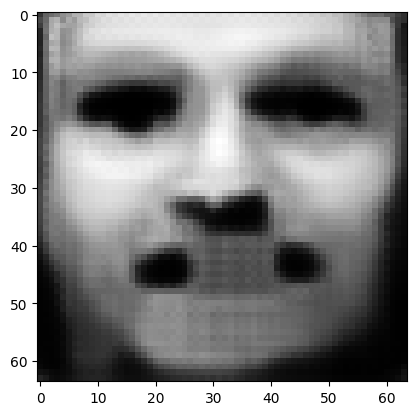

tensor([[2.5444e-06, 7.5772e-06, 4.1044e-05, 6.2177e-05, 9.6131e-01, 1.9494e-06,
         3.3243e-05, 3.9643e-07, 1.9998e-04, 8.5913e-05, 1.5193e-05, 2.3455e-03,
         3.1065e-04, 3.0943e-04, 2.0423e-04, 1.3045e-05, 6.5817e-04, 1.6088e-05,
         8.5709e-06, 6.1260e-06, 5.2707e-03, 1.2836e-03, 2.3157e-03, 2.3260e-05,
         1.0962e-03, 6.2968e-04, 9.0540e-06, 8.8352e-05, 1.3767e-06, 4.8252e-04,
         1.7439e-02, 5.4698e-04, 4.6005e-04, 2.6413e-04, 1.7491e-03, 5.9581e-04,
         2.1411e-04, 2.6729e-04, 2.9337e-04, 1.3374e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03945734724402428
tensor([[2.5387e-06, 7.5566e-06, 4.0935e-05, 6.2016e-05, 9.6140e-01, 1.9463e-06,
         3.3140e-05, 3.9536e-07, 1.9934e-04, 8.5717e-05, 1.5143e-05, 2.3410e-03,
         3.0985e-04, 3.0868e-04, 2.0367e-04, 1.3017e-05, 6.5645e-04, 1.6048e-05,
         8.5461e-06, 6.1084e-06, 5.2580e-03, 1.2804e-03, 2.3110e-03, 2.3188e-05,
         1.0931e-03, 6.2848e-04, 9.0254e-0

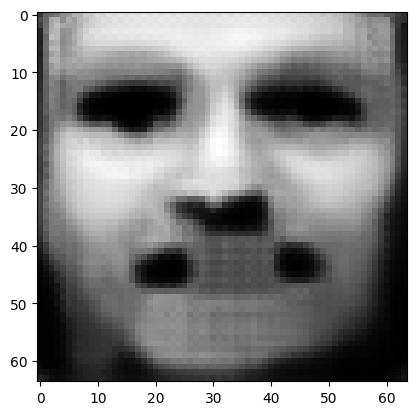

tensor([[2.5163e-06, 7.4767e-06, 4.0517e-05, 6.1408e-05, 9.6173e-01, 1.9344e-06,
         3.2748e-05, 3.9129e-07, 1.9693e-04, 8.4966e-05, 1.4954e-05, 2.3236e-03,
         3.0679e-04, 3.0575e-04, 2.0153e-04, 1.2909e-05, 6.4990e-04, 1.5893e-05,
         8.4508e-06, 6.0411e-06, 5.2093e-03, 1.2684e-03, 2.2932e-03, 2.2912e-05,
         1.0814e-03, 6.2393e-04, 8.9158e-06, 8.6925e-05, 1.3498e-06, 4.7733e-04,
         1.7254e-02, 5.4241e-04, 4.5491e-04, 2.6083e-04, 1.7295e-03, 5.9128e-04,
         2.1108e-04, 2.6351e-04, 2.8886e-04, 1.3236e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039019834250211716
tensor([[2.5109e-06, 7.4571e-06, 4.0415e-05, 6.1259e-05, 9.6181e-01, 1.9315e-06,
         3.2655e-05, 3.9031e-07, 1.9635e-04, 8.4786e-05, 1.4908e-05, 2.3194e-03,
         3.0604e-04, 3.0503e-04, 2.0101e-04, 1.2883e-05, 6.4833e-04, 1.5856e-05,
         8.4279e-06, 6.0246e-06, 5.1973e-03, 1.2655e-03, 2.2889e-03, 2.2846e-05,
         1.0786e-03, 6.2283e-04, 8.8891e-

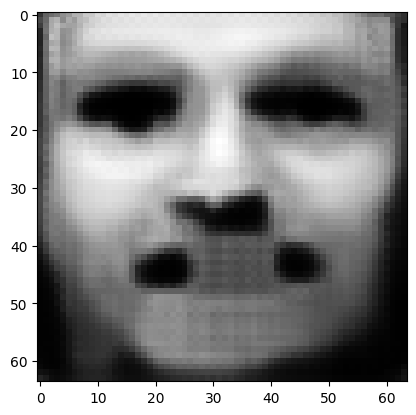

tensor([[2.4902e-06, 7.3828e-06, 4.0026e-05, 6.0693e-05, 9.6212e-01, 1.9203e-06,
         3.2292e-05, 3.8654e-07, 1.9410e-04, 8.4089e-05, 1.4733e-05, 2.3031e-03,
         3.0319e-04, 3.0230e-04, 1.9902e-04, 1.2782e-05, 6.4221e-04, 1.5712e-05,
         8.3397e-06, 5.9621e-06, 5.1518e-03, 1.2543e-03, 2.2723e-03, 2.2591e-05,
         1.0677e-03, 6.1856e-04, 8.7873e-06, 8.5602e-05, 1.3249e-06, 4.7251e-04,
         1.7081e-02, 5.3812e-04, 4.5014e-04, 2.5774e-04, 1.7114e-03, 5.8707e-04,
         2.0826e-04, 2.6000e-04, 2.8467e-04, 1.3106e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.038611605763435364
tensor([[2.4851e-06, 7.3651e-06, 3.9930e-05, 6.0555e-05, 9.6220e-01, 1.9176e-06,
         3.2203e-05, 3.8561e-07, 1.9355e-04, 8.3914e-05, 1.4690e-05, 2.2992e-03,
         3.0248e-04, 3.0165e-04, 1.9854e-04, 1.2757e-05, 6.4072e-04, 1.5677e-05,
         8.3182e-06, 5.9470e-06, 5.1409e-03, 1.2515e-03, 2.2682e-03, 2.2528e-05,
         1.0650e-03, 6.1752e-04, 8.7625e-

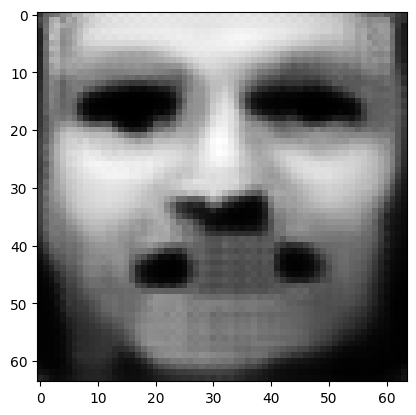

tensor([[2.4658e-06, 7.2960e-06, 3.9569e-05, 6.0030e-05, 9.6249e-01, 1.9072e-06,
         3.1866e-05, 3.8210e-07, 1.9148e-04, 8.3266e-05, 1.4528e-05, 2.2840e-03,
         2.9983e-04, 2.9911e-04, 1.9669e-04, 1.2663e-05, 6.3504e-04, 1.5543e-05,
         8.2363e-06, 5.8890e-06, 5.0986e-03, 1.2411e-03, 2.2528e-03, 2.2291e-05,
         1.0548e-03, 6.1354e-04, 8.6681e-06, 8.4373e-05, 1.3019e-06, 4.6801e-04,
         1.6921e-02, 5.3413e-04, 4.4569e-04, 2.5489e-04, 1.6944e-03, 5.8312e-04,
         2.0565e-04, 2.5675e-04, 2.8079e-04, 1.2986e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03823166713118553
tensor([[2.4611e-06, 7.2795e-06, 3.9481e-05, 5.9903e-05, 9.6256e-01, 1.9046e-06,
         3.1785e-05, 3.8125e-07, 1.9098e-04, 8.3107e-05, 1.4488e-05, 2.2803e-03,
         2.9918e-04, 2.9850e-04, 1.9624e-04, 1.2641e-05, 6.3370e-04, 1.5511e-05,
         8.2166e-06, 5.8750e-06, 5.0885e-03, 1.2386e-03, 2.2489e-03, 2.2234e-05,
         1.0523e-03, 6.1258e-04, 8.6453e-0

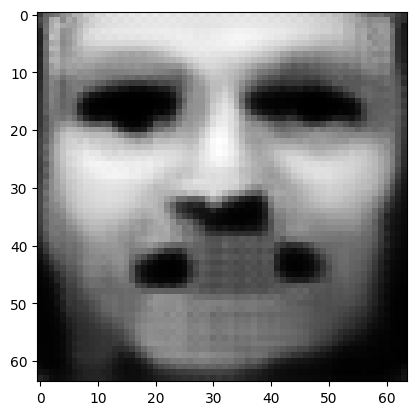

tensor([[2.4431e-06, 7.2152e-06, 3.9145e-05, 5.9413e-05, 9.6283e-01, 1.8949e-06,
         3.1471e-05, 3.7798e-07, 1.8904e-04, 8.2501e-05, 1.4337e-05, 2.2662e-03,
         2.9671e-04, 2.9613e-04, 1.9452e-04, 1.2553e-05, 6.2840e-04, 1.5387e-05,
         8.1403e-06, 5.8210e-06, 5.0491e-03, 1.2289e-03, 2.2345e-03, 2.2014e-05,
         1.0429e-03, 6.0886e-04, 8.5576e-06, 8.3235e-05, 1.2806e-06, 4.6382e-04,
         1.6771e-02, 5.3040e-04, 4.4154e-04, 2.5222e-04, 1.6786e-03, 5.7943e-04,
         2.0322e-04, 2.5372e-04, 2.7719e-04, 1.2874e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0378776378929615
tensor([[2.4387e-06, 7.1996e-06, 3.9063e-05, 5.9293e-05, 9.6290e-01, 1.8925e-06,
         3.1395e-05, 3.7718e-07, 1.8857e-04, 8.2352e-05, 1.4301e-05, 2.2627e-03,
         2.9611e-04, 2.9556e-04, 1.9411e-04, 1.2532e-05, 6.2711e-04, 1.5356e-05,
         8.1218e-06, 5.8077e-06, 5.0394e-03, 1.2265e-03, 2.2310e-03, 2.1960e-05,
         1.0406e-03, 6.0796e-04, 8.5363e-06

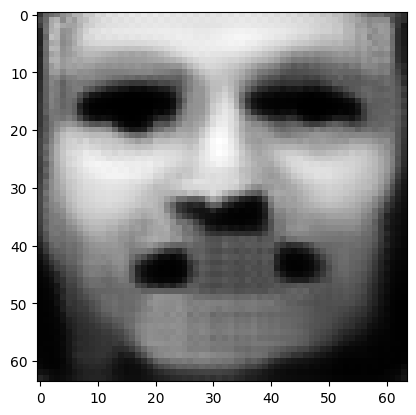

tensor([[2.4219e-06, 7.1399e-06, 3.8750e-05, 5.8837e-05, 9.6315e-01, 1.8835e-06,
         3.1104e-05, 3.7415e-07, 1.8678e-04, 8.1789e-05, 1.4160e-05, 2.2495e-03,
         2.9381e-04, 2.9335e-04, 1.9251e-04, 1.2450e-05, 6.2219e-04, 1.5240e-05,
         8.0510e-06, 5.7577e-06, 5.0027e-03, 1.2175e-03, 2.2175e-03, 2.1756e-05,
         1.0318e-03, 6.0448e-04, 8.4549e-06, 8.2177e-05, 1.2609e-06, 4.5992e-04,
         1.6631e-02, 5.2691e-04, 4.3768e-04, 2.4974e-04, 1.6638e-03, 5.7598e-04,
         2.0095e-04, 2.5090e-04, 2.7384e-04, 1.2769e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03754736855626106
tensor([[2.4178e-06, 7.1251e-06, 3.8680e-05, 5.8732e-05, 9.6321e-01, 1.8814e-06,
         3.1035e-05, 3.7343e-07, 1.8636e-04, 8.1659e-05, 1.4127e-05, 2.2463e-03,
         2.9327e-04, 2.9282e-04, 1.9213e-04, 1.2431e-05, 6.2100e-04, 1.5213e-05,
         8.0341e-06, 5.7459e-06, 4.9941e-03, 1.2153e-03, 2.2144e-03, 2.1707e-05,
         1.0296e-03, 6.0365e-04, 8.4357e-0

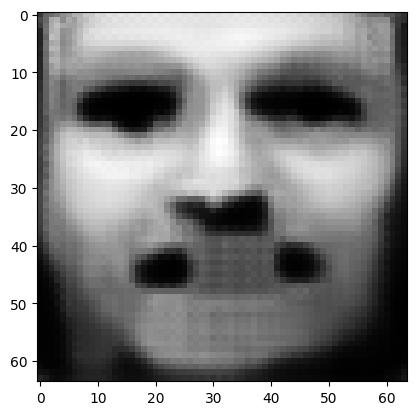

tensor([[2.4022e-06, 7.0696e-06, 3.8383e-05, 5.8299e-05, 9.6345e-01, 1.8727e-06,
         3.0762e-05, 3.7058e-07, 1.8468e-04, 8.1127e-05, 1.3996e-05, 2.2340e-03,
         2.9110e-04, 2.9075e-04, 1.9063e-04, 1.2354e-05, 6.1638e-04, 1.5104e-05,
         7.9679e-06, 5.6987e-06, 4.9595e-03, 1.2068e-03, 2.2016e-03, 2.1516e-05,
         1.0214e-03, 6.0037e-04, 8.3593e-06, 8.1192e-05, 1.2427e-06, 4.5628e-04,
         1.6500e-02, 5.2363e-04, 4.3406e-04, 2.4742e-04, 1.6501e-03, 5.7276e-04,
         1.9884e-04, 2.4828e-04, 2.7072e-04, 1.2672e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03723869472742081
tensor([[2.3983e-06, 7.0559e-06, 3.8316e-05, 5.8202e-05, 9.6350e-01, 1.8708e-06,
         3.0698e-05, 3.6990e-07, 1.8428e-04, 8.1004e-05, 1.3964e-05, 2.2310e-03,
         2.9060e-04, 2.9026e-04, 1.9027e-04, 1.2336e-05, 6.1530e-04, 1.5078e-05,
         7.9520e-06, 5.6877e-06, 4.9513e-03, 1.2048e-03, 2.1987e-03, 2.1470e-05,
         1.0194e-03, 5.9961e-04, 8.3414e-0

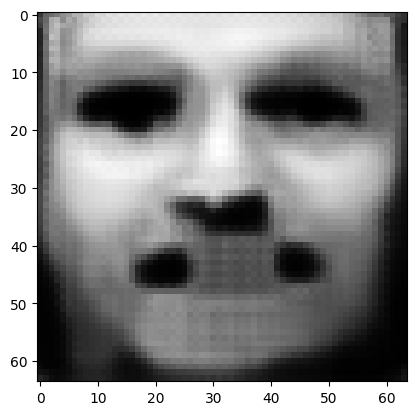

tensor([[2.3836e-06, 7.0036e-06, 3.8043e-05, 5.7803e-05, 9.6372e-01, 1.8628e-06,
         3.0445e-05, 3.6725e-07, 1.8272e-04, 8.0512e-05, 1.3842e-05, 2.2194e-03,
         2.8859e-04, 2.8832e-04, 1.8888e-04, 1.2265e-05, 6.1098e-04, 1.4977e-05,
         7.8903e-06, 5.6440e-06, 4.9192e-03, 1.1969e-03, 2.1869e-03, 2.1293e-05,
         1.0117e-03, 5.9655e-04, 8.2706e-06, 8.0278e-05, 1.2257e-06, 4.5285e-04,
         1.6377e-02, 5.2056e-04, 4.3070e-04, 2.4526e-04, 1.6371e-03, 5.6973e-04,
         1.9687e-04, 2.4582e-04, 2.6781e-04, 1.2579e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03695002943277359
tensor([[2.3801e-06, 6.9912e-06, 3.7975e-05, 5.7706e-05, 9.6378e-01, 1.8608e-06,
         3.0383e-05, 3.6661e-07, 1.8234e-04, 8.0390e-05, 1.3813e-05, 2.2166e-03,
         2.8810e-04, 2.8786e-04, 1.8854e-04, 1.2247e-05, 6.0994e-04, 1.4952e-05,
         7.8753e-06, 5.6333e-06, 4.9114e-03, 1.1950e-03, 2.1840e-03, 2.1249e-05,
         1.0099e-03, 5.9581e-04, 8.2533e-0

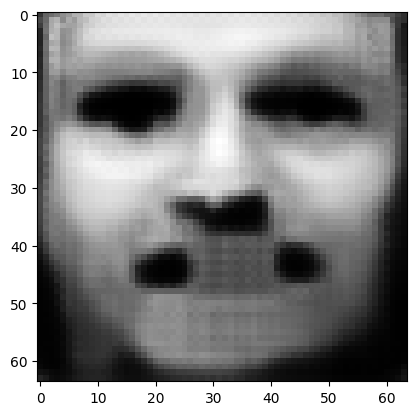

tensor([[2.3664e-06, 6.9423e-06, 3.7721e-05, 5.7332e-05, 9.6399e-01, 1.8533e-06,
         3.0146e-05, 3.6413e-07, 1.8089e-04, 7.9930e-05, 1.3699e-05, 2.2057e-03,
         2.8622e-04, 2.8605e-04, 1.8723e-04, 1.2181e-05, 6.0590e-04, 1.4858e-05,
         7.8176e-06, 5.5925e-06, 4.8813e-03, 1.1876e-03, 2.1729e-03, 2.1083e-05,
         1.0027e-03, 5.9293e-04, 8.1872e-06, 7.9421e-05, 1.2099e-06, 4.4966e-04,
         1.6262e-02, 5.1767e-04, 4.2753e-04, 2.4323e-04, 1.6251e-03, 5.6689e-04,
         1.9503e-04, 2.4353e-04, 2.6509e-04, 1.2494e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03667932376265526
tensor([[2.3631e-06, 6.9305e-06, 3.7658e-05, 5.7242e-05, 9.6404e-01, 1.8515e-06,
         3.0090e-05, 3.6353e-07, 1.8054e-04, 7.9818e-05, 1.3672e-05, 2.2031e-03,
         2.8577e-04, 2.8561e-04, 1.8692e-04, 1.2165e-05, 6.0494e-04, 1.4835e-05,
         7.8037e-06, 5.5825e-06, 4.8740e-03, 1.1858e-03, 2.1702e-03, 2.1043e-05,
         1.0010e-03, 5.9225e-04, 8.1713e-0

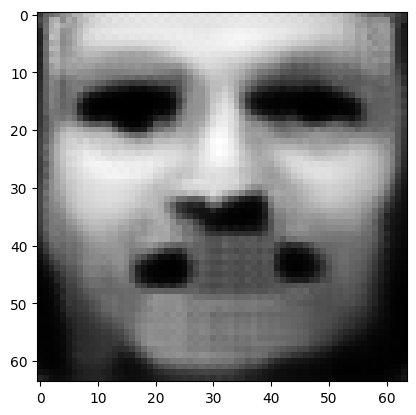

tensor([[2.3502e-06, 6.8848e-06, 3.7419e-05, 5.6893e-05, 9.6423e-01, 1.8445e-06,
         2.9868e-05, 3.6121e-07, 1.7918e-04, 7.9386e-05, 1.3565e-05, 2.1929e-03,
         2.8401e-04, 2.8392e-04, 1.8569e-04, 1.2102e-05, 6.0117e-04, 1.4746e-05,
         7.7496e-06, 5.5443e-06, 4.8458e-03, 1.1788e-03, 2.1598e-03, 2.0888e-05,
         9.9426e-04, 5.8956e-04, 8.1094e-06, 7.8623e-05, 1.1952e-06, 4.4665e-04,
         1.6154e-02, 5.1497e-04, 4.2456e-04, 2.4133e-04, 1.6138e-03, 5.6421e-04,
         1.9331e-04, 2.4139e-04, 2.6255e-04, 1.2413e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03642624616622925
tensor([[2.3471e-06, 6.8738e-06, 3.7361e-05, 5.6808e-05, 9.6428e-01, 1.8428e-06,
         2.9815e-05, 3.6065e-07, 1.7885e-04, 7.9282e-05, 1.3539e-05, 2.1904e-03,
         2.8358e-04, 2.8351e-04, 1.8539e-04, 1.2087e-05, 6.0026e-04, 1.4724e-05,
         7.7367e-06, 5.5350e-06, 4.8388e-03, 1.1771e-03, 2.1573e-03, 2.0850e-05,
         9.9264e-04, 5.8891e-04, 8.0944e-0

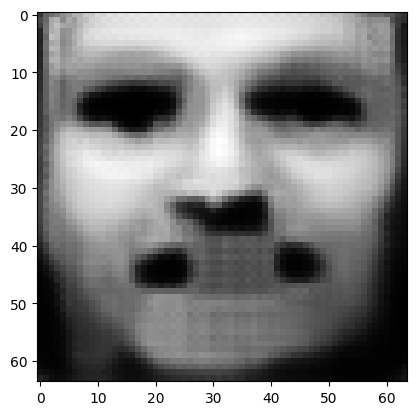

tensor([[2.3350e-06, 6.8310e-06, 3.7137e-05, 5.6480e-05, 9.6446e-01, 1.8362e-06,
         2.9608e-05, 3.5847e-07, 1.7757e-04, 7.8876e-05, 1.3440e-05, 2.1809e-03,
         2.8193e-04, 2.8192e-04, 1.8425e-04, 1.2028e-05, 5.9672e-04, 1.4641e-05,
         7.6861e-06, 5.4992e-06, 4.8125e-03, 1.1706e-03, 2.1475e-03, 2.0705e-05,
         9.8633e-04, 5.8638e-04, 8.0366e-06, 7.7875e-05, 1.1814e-06, 4.4384e-04,
         1.6053e-02, 5.1242e-04, 4.2178e-04, 2.3954e-04, 1.6031e-03, 5.6169e-04,
         1.9169e-04, 2.3938e-04, 2.6017e-04, 1.2338e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036188166588544846
tensor([[2.3321e-06, 6.8207e-06, 3.7082e-05, 5.6399e-05, 9.6450e-01, 1.8346e-06,
         2.9558e-05, 3.5795e-07, 1.7726e-04, 7.8779e-05, 1.3416e-05, 2.1785e-03,
         2.8153e-04, 2.8154e-04, 1.8397e-04, 1.2014e-05, 5.9586e-04, 1.4621e-05,
         7.6739e-06, 5.4905e-06, 4.8060e-03, 1.1690e-03, 2.1451e-03, 2.0670e-05,
         9.8483e-04, 5.8576e-04, 8.0225e-

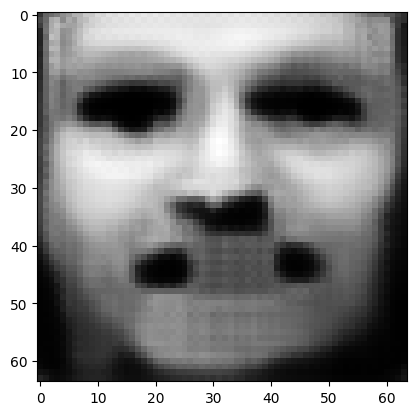

tensor([[2.3209e-06, 6.7805e-06, 3.6874e-05, 5.6093e-05, 9.6467e-01, 1.8284e-06,
         2.9365e-05, 3.5592e-07, 1.7608e-04, 7.8402e-05, 1.3322e-05, 2.1696e-03,
         2.7999e-04, 2.8005e-04, 1.8290e-04, 1.1959e-05, 5.9256e-04, 1.4543e-05,
         7.6265e-06, 5.4569e-06, 4.7812e-03, 1.1629e-03, 2.1360e-03, 2.0534e-05,
         9.7895e-04, 5.8340e-04, 7.9686e-06, 7.7178e-05, 1.1686e-06, 4.4120e-04,
         1.5958e-02, 5.1003e-04, 4.1917e-04, 2.3787e-04, 1.5932e-03, 5.5933e-04,
         1.9018e-04, 2.3750e-04, 2.5794e-04, 1.2267e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03596555441617966
tensor([[2.3181e-06, 6.7708e-06, 3.6822e-05, 5.6018e-05, 9.6472e-01, 1.8269e-06,
         2.9318e-05, 3.5542e-07, 1.7579e-04, 7.8307e-05, 1.3300e-05, 2.1674e-03,
         2.7961e-04, 2.7969e-04, 1.8263e-04, 1.1946e-05, 5.9176e-04, 1.4524e-05,
         7.6150e-06, 5.4488e-06, 4.7752e-03, 1.1614e-03, 2.1337e-03, 2.0501e-05,
         9.7750e-04, 5.8282e-04, 7.9553e-0

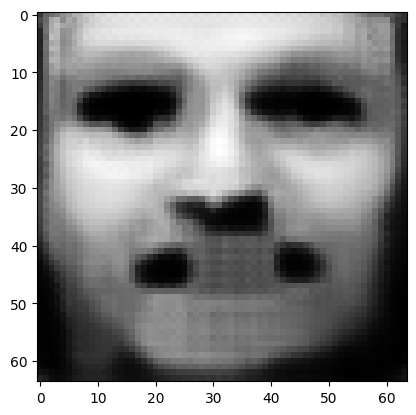

tensor([[2.3075e-06, 6.7331e-06, 3.6627e-05, 5.5732e-05, 9.6488e-01, 1.8211e-06,
         2.9138e-05, 3.5353e-07, 1.7468e-04, 7.7955e-05, 1.3213e-05, 2.1590e-03,
         2.7817e-04, 2.7829e-04, 1.8163e-04, 1.1894e-05, 5.8867e-04, 1.4451e-05,
         7.5708e-06, 5.4174e-06, 4.7518e-03, 1.1557e-03, 2.1252e-03, 2.0374e-05,
         9.7199e-04, 5.8060e-04, 7.9048e-06, 7.6524e-05, 1.1567e-06, 4.3872e-04,
         1.5869e-02, 5.0778e-04, 4.1673e-04, 2.3630e-04, 1.5839e-03, 5.5711e-04,
         1.8877e-04, 2.3574e-04, 2.5586e-04, 1.2201e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03575623780488968
tensor([[2.3049e-06, 6.7241e-06, 3.6579e-05, 5.5661e-05, 9.6491e-01, 1.8196e-06,
         2.9093e-05, 3.5306e-07, 1.7441e-04, 7.7868e-05, 1.3192e-05, 2.1569e-03,
         2.7781e-04, 2.7795e-04, 1.8138e-04, 1.1881e-05, 5.8791e-04, 1.4434e-05,
         7.5601e-06, 5.4099e-06, 4.7462e-03, 1.1543e-03, 2.1231e-03, 2.0343e-05,
         9.7065e-04, 5.8005e-04, 7.8926e-0

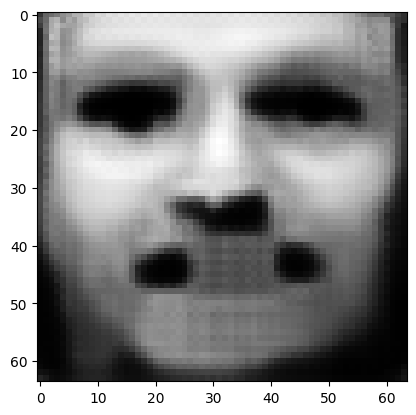

tensor([[2.2949e-06, 6.6887e-06, 3.6394e-05, 5.5392e-05, 9.6507e-01, 1.8141e-06,
         2.8923e-05, 3.5127e-07, 1.7336e-04, 7.7533e-05, 1.3110e-05, 2.1490e-03,
         2.7646e-04, 2.7664e-04, 1.8044e-04, 1.1833e-05, 5.8499e-04, 1.4365e-05,
         7.5184e-06, 5.3803e-06, 4.7244e-03, 1.1490e-03, 2.1150e-03, 2.0223e-05,
         9.6546e-04, 5.7796e-04, 7.8450e-06, 7.5911e-05, 1.1455e-06, 4.3639e-04,
         1.5785e-02, 5.0566e-04, 4.1443e-04, 2.3483e-04, 1.5751e-03, 5.5502e-04,
         1.8744e-04, 2.3409e-04, 2.5391e-04, 1.2139e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0355597585439682
tensor([[2.2925e-06, 6.6802e-06, 3.6350e-05, 5.5326e-05, 9.6510e-01, 1.8128e-06,
         2.8882e-05, 3.5084e-07, 1.7311e-04, 7.7450e-05, 1.3090e-05, 2.1471e-03,
         2.7613e-04, 2.7632e-04, 1.8021e-04, 1.1821e-05, 5.8428e-04, 1.4348e-05,
         7.5083e-06, 5.3732e-06, 4.7191e-03, 1.1476e-03, 2.1130e-03, 2.0194e-05,
         9.6419e-04, 5.7745e-04, 7.8335e-06

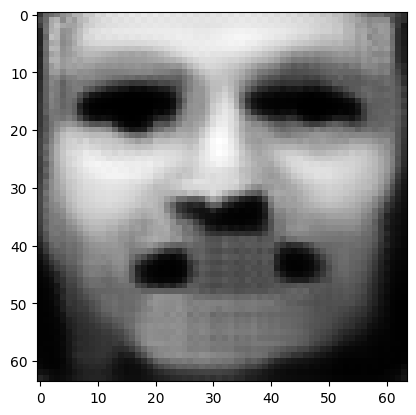

tensor([[2.2832e-06, 6.6470e-06, 3.6177e-05, 5.5073e-05, 9.6524e-01, 1.8076e-06,
         2.8723e-05, 3.4916e-07, 1.7213e-04, 7.7137e-05, 1.3013e-05, 2.1396e-03,
         2.7485e-04, 2.7509e-04, 1.7932e-04, 1.1775e-05, 5.8154e-04, 1.4284e-05,
         7.4694e-06, 5.3456e-06, 4.6986e-03, 1.1426e-03, 2.1054e-03, 2.0082e-05,
         9.5932e-04, 5.7548e-04, 7.7889e-06, 7.5336e-05, 1.1350e-06, 4.3420e-04,
         1.5706e-02, 5.0367e-04, 4.1227e-04, 2.3345e-04, 1.5669e-03, 5.5304e-04,
         1.8619e-04, 2.3254e-04, 2.5208e-04, 1.2080e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035375095903873444
tensor([[2.2809e-06, 6.6390e-06, 3.6134e-05, 5.5010e-05, 9.6528e-01, 1.8064e-06,
         2.8684e-05, 3.4875e-07, 1.7189e-04, 7.7061e-05, 1.2995e-05, 2.1378e-03,
         2.7454e-04, 2.7479e-04, 1.7910e-04, 1.1764e-05, 5.8087e-04, 1.4269e-05,
         7.4599e-06, 5.3388e-06, 4.6935e-03, 1.1414e-03, 2.1035e-03, 2.0055e-05,
         9.5815e-04, 5.7499e-04, 7.7781e-

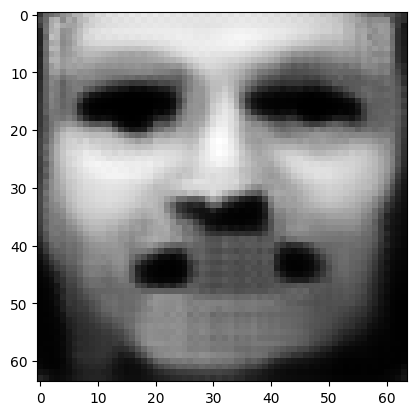

tensor([[2.2721e-06, 6.6078e-06, 3.5971e-05, 5.4772e-05, 9.6541e-01, 1.8015e-06,
         2.8534e-05, 3.4717e-07, 1.7097e-04, 7.6764e-05, 1.2922e-05, 2.1308e-03,
         2.7334e-04, 2.7363e-04, 1.7827e-04, 1.1721e-05, 5.7829e-04, 1.4208e-05,
         7.4231e-06, 5.3128e-06, 4.6743e-03, 1.1366e-03, 2.0963e-03, 1.9950e-05,
         9.5352e-04, 5.7313e-04, 7.7362e-06, 7.4793e-05, 1.1251e-06, 4.3215e-04,
         1.5632e-02, 5.0179e-04, 4.1024e-04, 2.3215e-04, 1.5591e-03, 5.5118e-04,
         1.8501e-04, 2.3108e-04, 2.5035e-04, 1.2025e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03520098701119423
tensor([[2.2700e-06, 6.6001e-06, 3.5934e-05, 5.4717e-05, 9.6544e-01, 1.8004e-06,
         2.8498e-05, 3.4680e-07, 1.7075e-04, 7.6697e-05, 1.2905e-05, 2.1291e-03,
         2.7306e-04, 2.7334e-04, 1.7807e-04, 1.1711e-05, 5.7767e-04, 1.4193e-05,
         7.4143e-06, 5.3067e-06, 4.6697e-03, 1.1355e-03, 2.0947e-03, 1.9925e-05,
         9.5240e-04, 5.7268e-04, 7.7263e-0

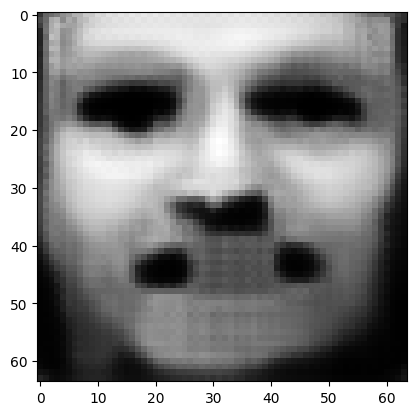

tensor([[2.2618e-06, 6.5710e-06, 3.5778e-05, 5.4490e-05, 9.6557e-01, 1.7957e-06,
         2.8356e-05, 3.4530e-07, 1.6987e-04, 7.6414e-05, 1.2837e-05, 2.1225e-03,
         2.7192e-04, 2.7225e-04, 1.7728e-04, 1.1671e-05, 5.7524e-04, 1.4136e-05,
         7.3795e-06, 5.2819e-06, 4.6515e-03, 1.1309e-03, 2.0877e-03, 1.9826e-05,
         9.4808e-04, 5.7092e-04, 7.6865e-06, 7.4284e-05, 1.1159e-06, 4.3020e-04,
         1.5562e-02, 5.0002e-04, 4.0832e-04, 2.3093e-04, 1.5518e-03, 5.4942e-04,
         1.8391e-04, 2.2971e-04, 2.4873e-04, 1.1972e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03503686189651489
tensor([[2.2597e-06, 6.5638e-06, 3.5743e-05, 5.4438e-05, 9.6560e-01, 1.7946e-06,
         2.8322e-05, 3.4495e-07, 1.6966e-04, 7.6349e-05, 1.2820e-05, 2.1209e-03,
         2.7165e-04, 2.7199e-04, 1.7709e-04, 1.1661e-05, 5.7464e-04, 1.4122e-05,
         7.3712e-06, 5.2762e-06, 4.6472e-03, 1.1299e-03, 2.0862e-03, 1.9802e-05,
         9.4700e-04, 5.7050e-04, 7.6772e-0

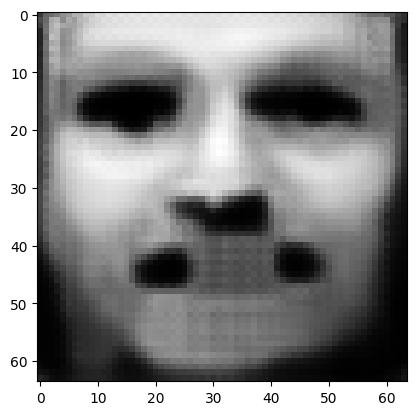

tensor([[2.2520e-06, 6.5363e-06, 3.5596e-05, 5.4224e-05, 9.6572e-01, 1.7903e-06,
         2.8189e-05, 3.4355e-07, 1.6884e-04, 7.6084e-05, 1.2756e-05, 2.1146e-03,
         2.7058e-04, 2.7096e-04, 1.7634e-04, 1.1623e-05, 5.7236e-04, 1.4068e-05,
         7.3386e-06, 5.2529e-06, 4.6301e-03, 1.1256e-03, 2.0797e-03, 1.9709e-05,
         9.4295e-04, 5.6884e-04, 7.6400e-06, 7.3806e-05, 1.1072e-06, 4.2838e-04,
         1.5495e-02, 4.9836e-04, 4.0652e-04, 2.2978e-04, 1.5449e-03, 5.4777e-04,
         1.8287e-04, 2.2842e-04, 2.4721e-04, 1.1923e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03488260880112648
tensor([[2.2501e-06, 6.5295e-06, 3.5563e-05, 5.4175e-05, 9.6575e-01, 1.7892e-06,
         2.8156e-05, 3.4322e-07, 1.6865e-04, 7.6022e-05, 1.2741e-05, 2.1131e-03,
         2.7033e-04, 2.7070e-04, 1.7617e-04, 1.1614e-05, 5.7180e-04, 1.4055e-05,
         7.3307e-06, 5.2475e-06, 4.6260e-03, 1.1246e-03, 2.0782e-03, 1.9686e-05,
         9.4194e-04, 5.6844e-04, 7.6311e-0

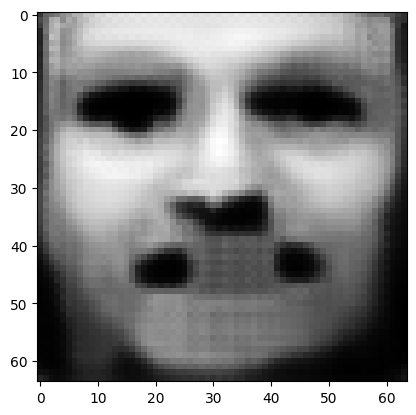

tensor([[2.2428e-06, 6.5035e-06, 3.5427e-05, 5.3977e-05, 9.6586e-01, 1.7852e-06,
         2.8031e-05, 3.4190e-07, 1.6788e-04, 7.5775e-05, 1.2681e-05, 2.1072e-03,
         2.6933e-04, 2.6973e-04, 1.7547e-04, 1.1578e-05, 5.6965e-04, 1.4004e-05,
         7.3001e-06, 5.2258e-06, 4.6100e-03, 1.1206e-03, 2.0722e-03, 1.9599e-05,
         9.3809e-04, 5.6688e-04, 7.5963e-06, 7.3357e-05, 1.0991e-06, 4.2665e-04,
         1.5433e-02, 4.9678e-04, 4.0483e-04, 2.2869e-04, 1.5384e-03, 5.4620e-04,
         1.8190e-04, 2.2720e-04, 2.4578e-04, 1.1876e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03473685309290886
tensor([[2.2410e-06, 6.4973e-06, 3.5393e-05, 5.3927e-05, 9.6589e-01, 1.7841e-06,
         2.8001e-05, 3.4158e-07, 1.6769e-04, 7.5714e-05, 1.2666e-05, 2.1058e-03,
         2.6908e-04, 2.6950e-04, 1.7530e-04, 1.1569e-05, 5.6912e-04, 1.3992e-05,
         7.2927e-06, 5.2205e-06, 4.6060e-03, 1.1197e-03, 2.0707e-03, 1.9577e-05,
         9.3716e-04, 5.6650e-04, 7.5877e-0

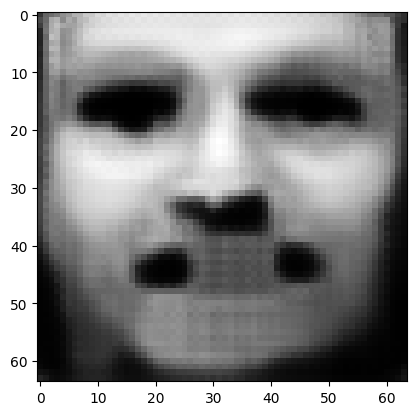

tensor([[2.2341e-06, 6.4728e-06, 3.5265e-05, 5.3740e-05, 9.6599e-01, 1.7803e-06,
         2.7882e-05, 3.4034e-07, 1.6696e-04, 7.5481e-05, 1.2610e-05, 2.1002e-03,
         2.6814e-04, 2.6858e-04, 1.7465e-04, 1.1535e-05, 5.6708e-04, 1.3944e-05,
         7.2637e-06, 5.2001e-06, 4.5909e-03, 1.1159e-03, 2.0650e-03, 1.9495e-05,
         9.3353e-04, 5.6503e-04, 7.5549e-06, 7.2932e-05, 1.0915e-06, 4.2503e-04,
         1.5374e-02, 4.9529e-04, 4.0322e-04, 2.2767e-04, 1.5323e-03, 5.4472e-04,
         1.8098e-04, 2.2606e-04, 2.4443e-04, 1.1832e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03459947928786278
tensor([[2.2325e-06, 6.4668e-06, 3.5234e-05, 5.3694e-05, 9.6602e-01, 1.7793e-06,
         2.7854e-05, 3.4004e-07, 1.6679e-04, 7.5425e-05, 1.2596e-05, 2.0989e-03,
         2.6791e-04, 2.6836e-04, 1.7448e-04, 1.1527e-05, 5.6659e-04, 1.3933e-05,
         7.2567e-06, 5.1951e-06, 4.5872e-03, 1.1150e-03, 2.0636e-03, 1.9475e-05,
         9.3266e-04, 5.6467e-04, 7.5469e-0

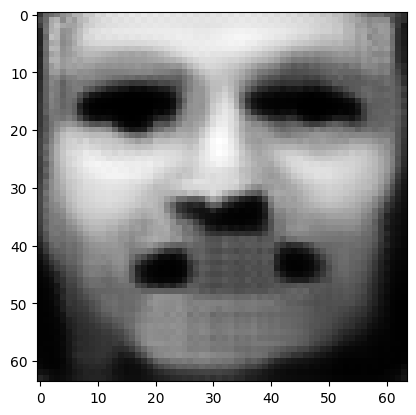

tensor([[2.2259e-06, 6.4438e-06, 3.5113e-05, 5.3518e-05, 9.6612e-01, 1.7757e-06,
         2.7743e-05, 3.3887e-07, 1.6610e-04, 7.5205e-05, 1.2543e-05, 2.0937e-03,
         2.6702e-04, 2.6750e-04, 1.7387e-04, 1.1495e-05, 5.6467e-04, 1.3888e-05,
         7.2296e-06, 5.1758e-06, 4.5729e-03, 1.1114e-03, 2.0582e-03, 1.9397e-05,
         9.2925e-04, 5.6328e-04, 7.5160e-06, 7.2533e-05, 1.0843e-06, 4.2350e-04,
         1.5319e-02, 4.9388e-04, 4.0171e-04, 2.2671e-04, 1.5265e-03, 5.4333e-04,
         1.8011e-04, 2.2498e-04, 2.4316e-04, 1.1791e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03447003662586212
tensor([[2.2244e-06, 6.4383e-06, 3.5083e-05, 5.3474e-05, 9.6614e-01, 1.7748e-06,
         2.7716e-05, 3.3859e-07, 1.6594e-04, 7.5151e-05, 1.2530e-05, 2.0924e-03,
         2.6680e-04, 2.6729e-04, 1.7371e-04, 1.1488e-05, 5.6421e-04, 1.3877e-05,
         7.2230e-06, 5.1711e-06, 4.5694e-03, 1.1106e-03, 2.0569e-03, 1.9379e-05,
         9.2842e-04, 5.6294e-04, 7.5084e-0

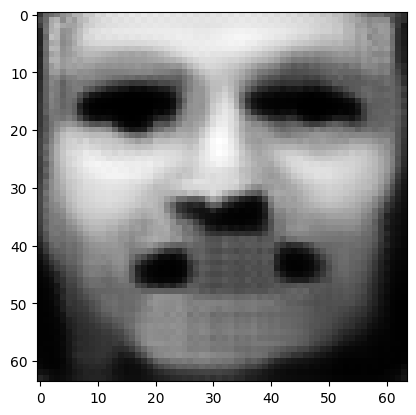

tensor([[2.2183e-06, 6.4165e-06, 3.4970e-05, 5.3307e-05, 9.6624e-01, 1.7714e-06,
         2.7611e-05, 3.3749e-07, 1.6529e-04, 7.4945e-05, 1.2480e-05, 2.0875e-03,
         2.6596e-04, 2.6647e-04, 1.7313e-04, 1.1458e-05, 5.6240e-04, 1.3834e-05,
         7.1974e-06, 5.1530e-06, 4.5560e-03, 1.1072e-03, 2.0518e-03, 1.9305e-05,
         9.2520e-04, 5.6162e-04, 7.4793e-06, 7.2157e-05, 1.0775e-06, 4.2205e-04,
         1.5266e-02, 4.9256e-04, 4.0028e-04, 2.2580e-04, 1.5211e-03, 5.4201e-04,
         1.7929e-04, 2.2396e-04, 2.4196e-04, 1.1752e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034347835928201675
tensor([[2.2168e-06, 6.4112e-06, 3.4941e-05, 5.3266e-05, 9.6626e-01, 1.7705e-06,
         2.7586e-05, 3.3722e-07, 1.6514e-04, 7.4893e-05, 1.2467e-05, 2.0862e-03,
         2.6576e-04, 2.6627e-04, 1.7299e-04, 1.1450e-05, 5.6197e-04, 1.3824e-05,
         7.1911e-06, 5.1485e-06, 4.5526e-03, 1.1064e-03, 2.0506e-03, 1.9288e-05,
         9.2443e-04, 5.6131e-04, 7.4722e-

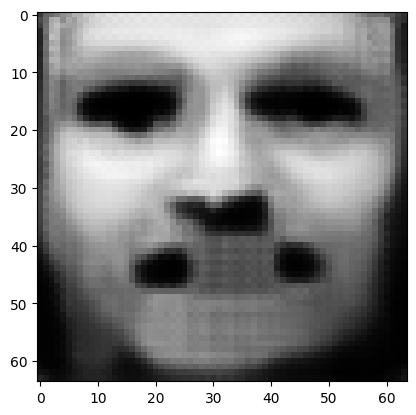

tensor([[2.2110e-06, 6.3906e-06, 3.4834e-05, 5.3109e-05, 9.6635e-01, 1.7673e-06,
         2.7487e-05, 3.3618e-07, 1.6453e-04, 7.4699e-05, 1.2420e-05, 2.0816e-03,
         2.6497e-04, 2.6550e-04, 1.7244e-04, 1.1422e-05, 5.6026e-04, 1.3784e-05,
         7.1670e-06, 5.1314e-06, 4.5399e-03, 1.1033e-03, 2.0458e-03, 1.9219e-05,
         9.2140e-04, 5.6006e-04, 7.4447e-06, 7.1803e-05, 1.0711e-06, 4.2068e-04,
         1.5217e-02, 4.9131e-04, 3.9894e-04, 2.2494e-04, 1.5159e-03, 5.4076e-04,
         1.7852e-04, 2.2300e-04, 2.4083e-04, 1.1716e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03423253074288368
tensor([[2.2096e-06, 6.3857e-06, 3.4807e-05, 5.3070e-05, 9.6637e-01, 1.7665e-06,
         2.7463e-05, 3.3593e-07, 1.6438e-04, 7.4650e-05, 1.2408e-05, 2.0804e-03,
         2.6477e-04, 2.6532e-04, 1.7230e-04, 1.1415e-05, 5.5984e-04, 1.3774e-05,
         7.1611e-06, 5.1272e-06, 4.5368e-03, 1.1025e-03, 2.0446e-03, 1.9202e-05,
         9.2066e-04, 5.5976e-04, 7.4380e-0

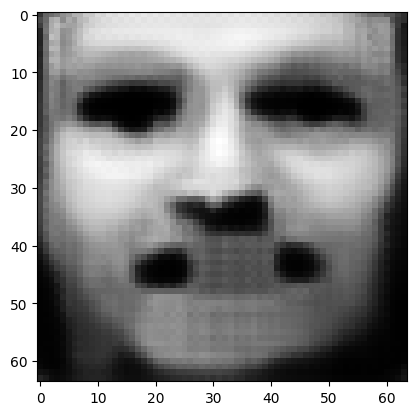

tensor([[2.2041e-06, 6.3663e-06, 3.4706e-05, 5.2922e-05, 9.6645e-01, 1.7634e-06,
         2.7370e-05, 3.3495e-07, 1.6381e-04, 7.4467e-05, 1.2364e-05, 2.0760e-03,
         2.6402e-04, 2.6459e-04, 1.7178e-04, 1.1388e-05, 5.5823e-04, 1.3736e-05,
         7.1383e-06, 5.1111e-06, 4.5248e-03, 1.0995e-03, 2.0401e-03, 1.9137e-05,
         9.1780e-04, 5.5858e-04, 7.4122e-06, 7.1469e-05, 1.0651e-06, 4.1940e-04,
         1.5170e-02, 4.9012e-04, 3.9767e-04, 2.2413e-04, 1.5111e-03, 5.3958e-04,
         1.7779e-04, 2.2210e-04, 2.3976e-04, 1.1681e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03412343189120293
tensor([[2.2028e-06, 6.3616e-06, 3.4681e-05, 5.2885e-05, 9.6647e-01, 1.7626e-06,
         2.7347e-05, 3.3471e-07, 1.6367e-04, 7.4421e-05, 1.2353e-05, 2.0750e-03,
         2.6384e-04, 2.6441e-04, 1.7166e-04, 1.1382e-05, 5.5784e-04, 1.3727e-05,
         7.1328e-06, 5.1071e-06, 4.5219e-03, 1.0988e-03, 2.0390e-03, 1.9121e-05,
         9.1710e-04, 5.5830e-04, 7.4058e-0

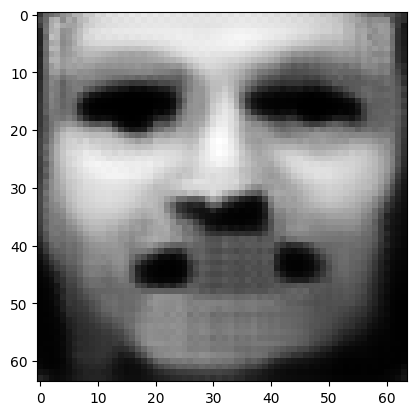

tensor([[2.1976e-06, 6.3433e-06, 3.4585e-05, 5.2745e-05, 9.6655e-01, 1.7597e-06,
         2.7259e-05, 3.3379e-07, 1.6313e-04, 7.4248e-05, 1.2311e-05, 2.0708e-03,
         2.6313e-04, 2.6372e-04, 1.7117e-04, 1.1356e-05, 5.5632e-04, 1.3691e-05,
         7.1113e-06, 5.0919e-06, 4.5105e-03, 1.0960e-03, 2.0347e-03, 1.9060e-05,
         9.1440e-04, 5.5719e-04, 7.3814e-06, 7.1153e-05, 1.0595e-06, 4.1818e-04,
         1.5126e-02, 4.8900e-04, 3.9646e-04, 2.2336e-04, 1.5065e-03, 5.3847e-04,
         1.7710e-04, 2.2125e-04, 2.3876e-04, 1.1648e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03402054309844971
tensor([[2.1963e-06, 6.3389e-06, 3.4562e-05, 5.2710e-05, 9.6657e-01, 1.7590e-06,
         2.7238e-05, 3.3356e-07, 1.6300e-04, 7.4204e-05, 1.2301e-05, 2.0698e-03,
         2.6296e-04, 2.6356e-04, 1.7105e-04, 1.1350e-05, 5.5595e-04, 1.3683e-05,
         7.1060e-06, 5.0882e-06, 4.5077e-03, 1.0953e-03, 2.0336e-03, 1.9045e-05,
         9.1375e-04, 5.5692e-04, 7.3754e-0

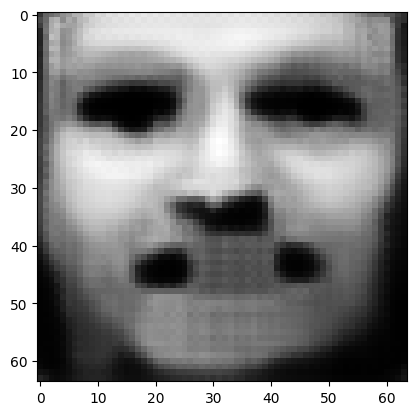

tensor([[2.1915e-06, 6.3216e-06, 3.4471e-05, 5.2578e-05, 9.6665e-01, 1.7563e-06,
         2.7155e-05, 3.3268e-07, 1.6249e-04, 7.4039e-05, 1.2261e-05, 2.0658e-03,
         2.6229e-04, 2.6291e-04, 1.7058e-04, 1.1326e-05, 5.5451e-04, 1.3649e-05,
         7.0857e-06, 5.0737e-06, 4.4970e-03, 1.0926e-03, 2.0296e-03, 1.8987e-05,
         9.1120e-04, 5.5587e-04, 7.3523e-06, 7.0856e-05, 1.0541e-06, 4.1703e-04,
         1.5084e-02, 4.8794e-04, 3.9533e-04, 2.2264e-04, 1.5021e-03, 5.3741e-04,
         1.7645e-04, 2.2044e-04, 2.3781e-04, 1.1617e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03392340615391731
tensor([[2.1903e-06, 6.3174e-06, 3.4449e-05, 5.2545e-05, 9.6666e-01, 1.7556e-06,
         2.7135e-05, 3.3247e-07, 1.6236e-04, 7.3998e-05, 1.2251e-05, 2.0649e-03,
         2.6213e-04, 2.6275e-04, 1.7047e-04, 1.1320e-05, 5.5416e-04, 1.3641e-05,
         7.0807e-06, 5.0702e-06, 4.4944e-03, 1.0920e-03, 2.0286e-03, 1.8973e-05,
         9.1057e-04, 5.5561e-04, 7.3467e-0

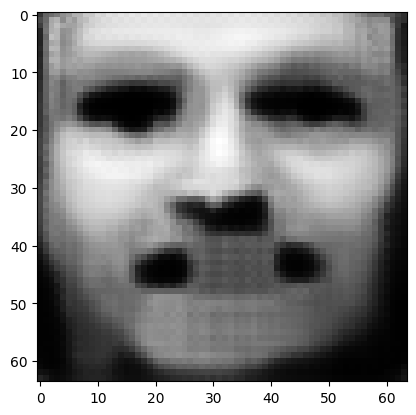

tensor([[2.1856e-06, 6.3011e-06, 3.4363e-05, 5.2420e-05, 9.6673e-01, 1.7530e-06,
         2.7056e-05, 3.3164e-07, 1.6188e-04, 7.3842e-05, 1.2214e-05, 2.0611e-03,
         2.6150e-04, 2.6214e-04, 1.7003e-04, 1.1298e-05, 5.5280e-04, 1.3609e-05,
         7.0615e-06, 5.0566e-06, 4.4843e-03, 1.0895e-03, 2.0247e-03, 1.8918e-05,
         9.0816e-04, 5.5462e-04, 7.3249e-06, 7.0574e-05, 1.0491e-06, 4.1594e-04,
         1.5045e-02, 4.8694e-04, 3.9425e-04, 2.2195e-04, 1.4980e-03, 5.3641e-04,
         1.7583e-04, 2.1968e-04, 2.3691e-04, 1.1588e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03383144736289978
tensor([[2.1845e-06, 6.2972e-06, 3.4342e-05, 5.2389e-05, 9.6675e-01, 1.7523e-06,
         2.7037e-05, 3.3144e-07, 1.6177e-04, 7.3804e-05, 1.2205e-05, 2.0602e-03,
         2.6134e-04, 2.6199e-04, 1.6992e-04, 1.1292e-05, 5.5247e-04, 1.3601e-05,
         7.0568e-06, 5.0533e-06, 4.4818e-03, 1.0888e-03, 2.0238e-03, 1.8905e-05,
         9.0758e-04, 5.5437e-04, 7.3196e-0

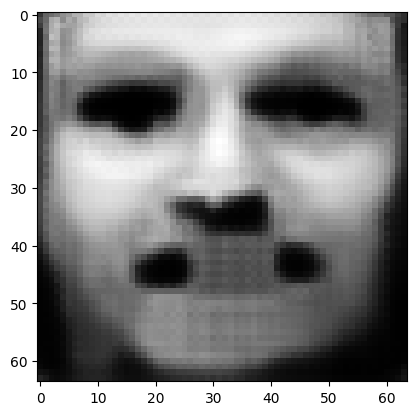

tensor([[2.1802e-06, 6.2818e-06, 3.4261e-05, 5.2270e-05, 9.6682e-01, 1.7499e-06,
         2.6963e-05, 3.3066e-07, 1.6131e-04, 7.3657e-05, 1.2169e-05, 2.0567e-03,
         2.6075e-04, 2.6141e-04, 1.6951e-04, 1.1271e-05, 5.5118e-04, 1.3571e-05,
         7.0387e-06, 5.0405e-06, 4.4722e-03, 1.0865e-03, 2.0201e-03, 1.8853e-05,
         9.0530e-04, 5.5343e-04, 7.2990e-06, 7.0309e-05, 1.0444e-06, 4.1492e-04,
         1.5007e-02, 4.8599e-04, 3.9324e-04, 2.2131e-04, 1.4942e-03, 5.3547e-04,
         1.7525e-04, 2.1896e-04, 2.3606e-04, 1.1561e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03374454751610756
tensor([[2.1791e-06, 6.2780e-06, 3.4242e-05, 5.2243e-05, 9.6683e-01, 1.7493e-06,
         2.6945e-05, 3.3047e-07, 1.6120e-04, 7.3622e-05, 1.2160e-05, 2.0559e-03,
         2.6061e-04, 2.6127e-04, 1.6941e-04, 1.1266e-05, 5.5087e-04, 1.3564e-05,
         7.0343e-06, 5.0374e-06, 4.4700e-03, 1.0859e-03, 2.0193e-03, 1.8841e-05,
         9.0473e-04, 5.5321e-04, 7.2941e-0

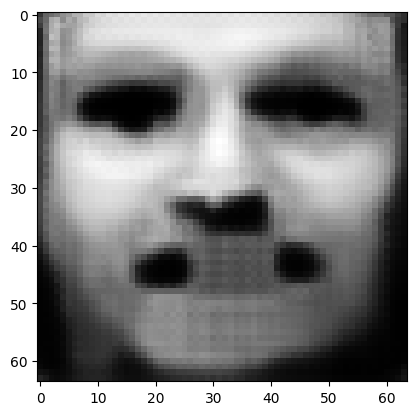

tensor([[2.1750e-06, 6.2635e-06, 3.4164e-05, 5.2129e-05, 9.6690e-01, 1.7469e-06,
         2.6875e-05, 3.2973e-07, 1.6077e-04, 7.3481e-05, 1.2127e-05, 2.0525e-03,
         2.6004e-04, 2.6072e-04, 1.6902e-04, 1.1246e-05, 5.4965e-04, 1.3535e-05,
         7.0171e-06, 5.0252e-06, 4.4609e-03, 1.0836e-03, 2.0158e-03, 1.8792e-05,
         9.0258e-04, 5.5231e-04, 7.2745e-06, 7.0058e-05, 1.0399e-06, 4.1394e-04,
         1.4972e-02, 4.8509e-04, 3.9227e-04, 2.2070e-04, 1.4905e-03, 5.3457e-04,
         1.7470e-04, 2.1828e-04, 2.3526e-04, 1.1535e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033662255853414536
tensor([[2.1739e-06, 6.2599e-06, 3.4147e-05, 5.2104e-05, 9.6691e-01, 1.7464e-06,
         2.6858e-05, 3.2955e-07, 1.6067e-04, 7.3448e-05, 1.2119e-05, 2.0517e-03,
         2.5991e-04, 2.6059e-04, 1.6892e-04, 1.1241e-05, 5.4936e-04, 1.3528e-05,
         7.0130e-06, 5.0224e-06, 4.4587e-03, 1.0831e-03, 2.0150e-03, 1.8780e-05,
         9.0204e-04, 5.5210e-04, 7.2699e-

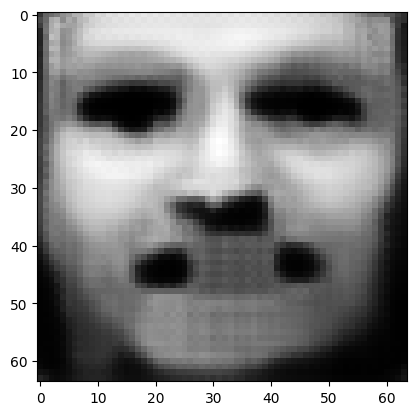

tensor([[2.1700e-06, 6.2461e-06, 3.4074e-05, 5.1998e-05, 9.6697e-01, 1.7441e-06,
         2.6791e-05, 3.2884e-07, 1.6026e-04, 7.3314e-05, 1.2087e-05, 2.0485e-03,
         2.5937e-04, 2.6007e-04, 1.6855e-04, 1.1221e-05, 5.4819e-04, 1.3501e-05,
         6.9967e-06, 5.0109e-06, 4.4501e-03, 1.0810e-03, 2.0117e-03, 1.8734e-05,
         8.9998e-04, 5.5125e-04, 7.2513e-06, 6.9820e-05, 1.0356e-06, 4.1302e-04,
         1.4939e-02, 4.8424e-04, 3.9137e-04, 2.2012e-04, 1.4870e-03, 5.3373e-04,
         1.7418e-04, 2.1763e-04, 2.3450e-04, 1.1509e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0335841029882431
tensor([[2.1690e-06, 6.2428e-06, 3.4055e-05, 5.1971e-05, 9.6699e-01, 1.7436e-06,
         2.6775e-05, 3.2867e-07, 1.6016e-04, 7.3281e-05, 1.2079e-05, 2.0477e-03,
         2.5924e-04, 2.5994e-04, 1.6846e-04, 1.1217e-05, 5.4791e-04, 1.3494e-05,
         6.9928e-06, 5.0080e-06, 4.4480e-03, 1.0804e-03, 2.0109e-03, 1.8722e-05,
         8.9948e-04, 5.5104e-04, 7.2468e-06

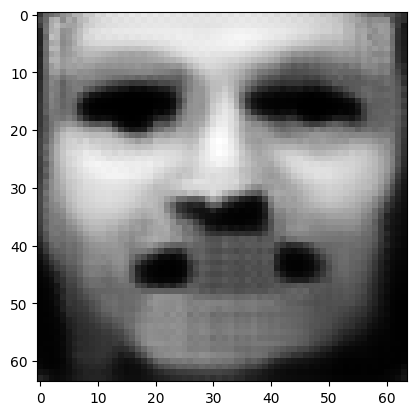

tensor([[2.1653e-06, 6.2297e-06, 3.3986e-05, 5.1871e-05, 9.6705e-01, 1.7415e-06,
         2.6712e-05, 3.2800e-07, 1.5977e-04, 7.3154e-05, 1.2049e-05, 2.0447e-03,
         2.5873e-04, 2.5944e-04, 1.6811e-04, 1.1198e-05, 5.4680e-04, 1.3469e-05,
         6.9774e-06, 4.9972e-06, 4.4399e-03, 1.0784e-03, 2.0078e-03, 1.8678e-05,
         8.9751e-04, 5.5024e-04, 7.2292e-06, 6.9594e-05, 1.0316e-06, 4.1215e-04,
         1.4907e-02, 4.8343e-04, 3.9050e-04, 2.1957e-04, 1.4836e-03, 5.3293e-04,
         1.7369e-04, 2.1702e-04, 2.3378e-04, 1.1486e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033509980887174606
tensor([[2.1644e-06, 6.2265e-06, 3.3969e-05, 5.1847e-05, 9.6706e-01, 1.7409e-06,
         2.6696e-05, 3.2784e-07, 1.5967e-04, 7.3123e-05, 1.2042e-05, 2.0439e-03,
         2.5860e-04, 2.5932e-04, 1.6802e-04, 1.1194e-05, 5.4653e-04, 1.3462e-05,
         6.9736e-06, 4.9945e-06, 4.4379e-03, 1.0779e-03, 2.0070e-03, 1.8667e-05,
         8.9704e-04, 5.5004e-04, 7.2249e-

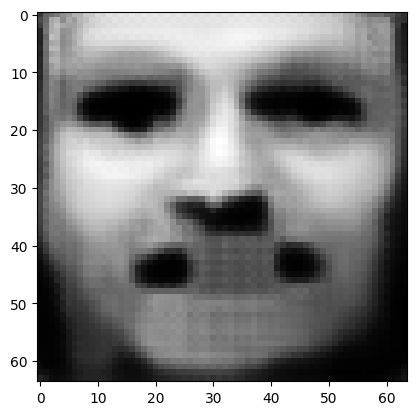

tensor([[2.1608e-06, 6.2141e-06, 3.3904e-05, 5.1752e-05, 9.6711e-01, 1.7389e-06,
         2.6636e-05, 3.2720e-07, 1.5930e-04, 7.3003e-05, 1.2013e-05, 2.0410e-03,
         2.5812e-04, 2.5885e-04, 1.6769e-04, 1.1176e-05, 5.4548e-04, 1.3438e-05,
         6.9591e-06, 4.9842e-06, 4.4301e-03, 1.0760e-03, 2.0040e-03, 1.8625e-05,
         8.9518e-04, 5.4928e-04, 7.2082e-06, 6.9379e-05, 1.0278e-06, 4.1132e-04,
         1.4876e-02, 4.8266e-04, 3.8968e-04, 2.1905e-04, 1.4805e-03, 5.3217e-04,
         1.7322e-04, 2.1644e-04, 2.3310e-04, 1.1463e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033439308404922485
tensor([[2.1599e-06, 6.2111e-06, 3.3887e-05, 5.1729e-05, 9.6713e-01, 1.7384e-06,
         2.6621e-05, 3.2705e-07, 1.5921e-04, 7.2973e-05, 1.2006e-05, 2.0403e-03,
         2.5800e-04, 2.5874e-04, 1.6761e-04, 1.1172e-05, 5.4523e-04, 1.3432e-05,
         6.9555e-06, 4.9817e-06, 4.4282e-03, 1.0755e-03, 2.0033e-03, 1.8615e-05,
         8.9473e-04, 5.4910e-04, 7.2042e-

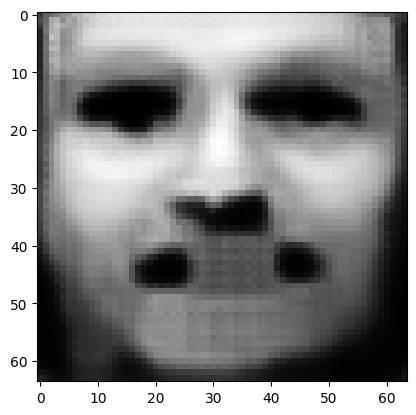

tensor([[2.1565e-06, 6.1994e-06, 3.3826e-05, 5.1639e-05, 9.6718e-01, 1.7365e-06,
         2.6565e-05, 3.2644e-07, 1.5886e-04, 7.2859e-05, 1.1979e-05, 2.0376e-03,
         2.5754e-04, 2.5829e-04, 1.6730e-04, 1.1155e-05, 5.4423e-04, 1.3409e-05,
         6.9417e-06, 4.9719e-06, 4.4209e-03, 1.0737e-03, 2.0005e-03, 1.8576e-05,
         8.9296e-04, 5.4837e-04, 7.1884e-06, 6.9176e-05, 1.0241e-06, 4.1053e-04,
         1.4848e-02, 4.8193e-04, 3.8890e-04, 2.1856e-04, 1.4775e-03, 5.3145e-04,
         1.7278e-04, 2.1589e-04, 2.3245e-04, 1.1442e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0333729013800621
tensor([[2.1557e-06, 6.1965e-06, 3.3810e-05, 5.1617e-05, 9.6719e-01, 1.7360e-06,
         2.6551e-05, 3.2630e-07, 1.5878e-04, 7.2831e-05, 1.1972e-05, 2.0370e-03,
         2.5743e-04, 2.5818e-04, 1.6722e-04, 1.1151e-05, 5.4399e-04, 1.3403e-05,
         6.9384e-06, 4.9695e-06, 4.4191e-03, 1.0733e-03, 1.9998e-03, 1.8566e-05,
         8.9254e-04, 5.4820e-04, 7.1846e-06

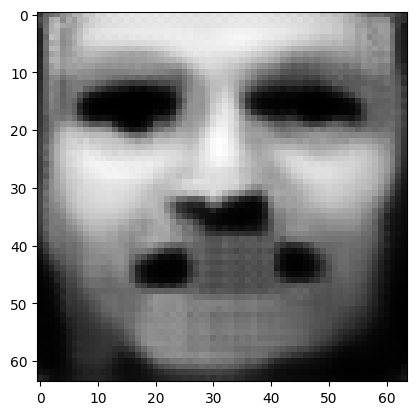

tensor([[2.1525e-06, 6.1854e-06, 3.3752e-05, 5.1532e-05, 9.6724e-01, 1.7342e-06,
         2.6497e-05, 3.2573e-07, 1.5845e-04, 7.2723e-05, 1.1947e-05, 2.0344e-03,
         2.5699e-04, 2.5776e-04, 1.6692e-04, 1.1136e-05, 5.4305e-04, 1.3381e-05,
         6.9254e-06, 4.9603e-06, 4.4122e-03, 1.0716e-03, 1.9971e-03, 1.8529e-05,
         8.9087e-04, 5.4751e-04, 7.1696e-06, 6.8984e-05, 1.0207e-06, 4.0979e-04,
         1.4821e-02, 4.8124e-04, 3.8817e-04, 2.1809e-04, 1.4746e-03, 5.3077e-04,
         1.7236e-04, 2.1537e-04, 2.3184e-04, 1.1422e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03330960124731064
tensor([[2.1517e-06, 6.1828e-06, 3.3737e-05, 5.1511e-05, 9.6725e-01, 1.7338e-06,
         2.6484e-05, 3.2559e-07, 1.5837e-04, 7.2696e-05, 1.1940e-05, 2.0337e-03,
         2.5689e-04, 2.5766e-04, 1.6685e-04, 1.1132e-05, 5.4282e-04, 1.3376e-05,
         6.9221e-06, 4.9580e-06, 4.4105e-03, 1.0711e-03, 1.9965e-03, 1.8519e-05,
         8.9047e-04, 5.4735e-04, 7.1660e-0

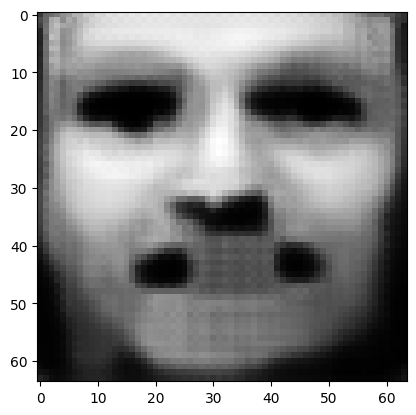

tensor([[2.1487e-06, 6.1722e-06, 3.3681e-05, 5.1430e-05, 9.6730e-01, 1.7320e-06,
         2.6433e-05, 3.2504e-07, 1.5806e-04, 7.2593e-05, 1.1916e-05, 2.0313e-03,
         2.5647e-04, 2.5726e-04, 1.6657e-04, 1.1117e-05, 5.4192e-04, 1.3355e-05,
         6.9099e-06, 4.9493e-06, 4.4040e-03, 1.0695e-03, 1.9939e-03, 1.8484e-05,
         8.8888e-04, 5.4670e-04, 7.1518e-06, 6.8802e-05, 1.0175e-06, 4.0908e-04,
         1.4795e-02, 4.8059e-04, 3.8747e-04, 2.1765e-04, 1.4719e-03, 5.3012e-04,
         1.7196e-04, 2.1488e-04, 2.3126e-04, 1.1403e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033249758183956146
tensor([[2.1480e-06, 6.1697e-06, 3.3667e-05, 5.1411e-05, 9.6731e-01, 1.7316e-06,
         2.6421e-05, 3.2491e-07, 1.5798e-04, 7.2568e-05, 1.1910e-05, 2.0307e-03,
         2.5637e-04, 2.5716e-04, 1.6650e-04, 1.1114e-05, 5.4170e-04, 1.3350e-05,
         6.9069e-06, 4.9472e-06, 4.4024e-03, 1.0691e-03, 1.9933e-03, 1.8475e-05,
         8.8850e-04, 5.4654e-04, 7.1484e-

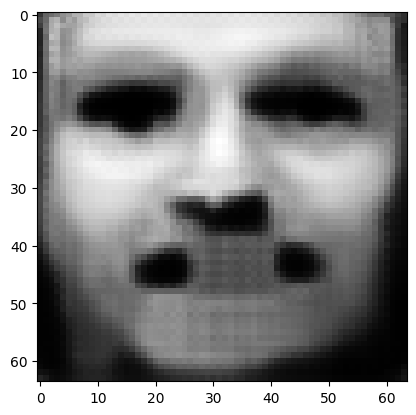

tensor([[2.1451e-06, 6.1598e-06, 3.3614e-05, 5.1335e-05, 9.6735e-01, 1.7300e-06,
         2.6373e-05, 3.2440e-07, 1.5769e-04, 7.2472e-05, 1.1887e-05, 2.0284e-03,
         2.5598e-04, 2.5678e-04, 1.6623e-04, 1.1099e-05, 5.4086e-04, 1.3331e-05,
         6.8952e-06, 4.9390e-06, 4.3962e-03, 1.0676e-03, 1.9909e-03, 1.8442e-05,
         8.8700e-04, 5.4592e-04, 7.1350e-06, 6.8629e-05, 1.0144e-06, 4.0842e-04,
         1.4771e-02, 4.7996e-04, 3.8681e-04, 2.1723e-04, 1.4694e-03, 5.2952e-04,
         1.7158e-04, 2.1442e-04, 2.3072e-04, 1.1385e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03319302201271057
tensor([[2.1444e-06, 6.1573e-06, 3.3601e-05, 5.1316e-05, 9.6736e-01, 1.7296e-06,
         2.6361e-05, 3.2427e-07, 1.5761e-04, 7.2448e-05, 1.1882e-05, 2.0278e-03,
         2.5589e-04, 2.5669e-04, 1.6617e-04, 1.1096e-05, 5.4065e-04, 1.3326e-05,
         6.8924e-06, 4.9370e-06, 4.3946e-03, 1.0672e-03, 1.9903e-03, 1.8434e-05,
         8.8664e-04, 5.4577e-04, 7.1317e-0

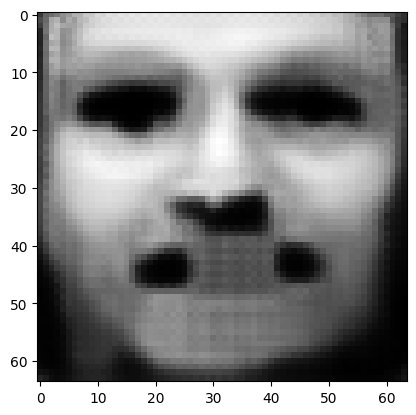

tensor([[2.1417e-06, 6.1479e-06, 3.3551e-05, 5.1244e-05, 9.6740e-01, 1.7280e-06,
         2.6315e-05, 3.2379e-07, 1.5733e-04, 7.2355e-05, 1.1860e-05, 2.0256e-03,
         2.5552e-04, 2.5633e-04, 1.6591e-04, 1.1083e-05, 5.3984e-04, 1.3307e-05,
         6.8813e-06, 4.9292e-06, 4.3888e-03, 1.0657e-03, 1.9880e-03, 1.8402e-05,
         8.8522e-04, 5.4519e-04, 7.1191e-06, 6.8466e-05, 1.0115e-06, 4.0779e-04,
         1.4748e-02, 4.7937e-04, 3.8618e-04, 2.1684e-04, 1.4670e-03, 5.2894e-04,
         1.7122e-04, 2.1398e-04, 2.3020e-04, 1.1368e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03313940018415451
tensor([[2.1410e-06, 6.1456e-06, 3.3539e-05, 5.1227e-05, 9.6741e-01, 1.7276e-06,
         2.6304e-05, 3.2367e-07, 1.5727e-04, 7.2333e-05, 1.1855e-05, 2.0250e-03,
         2.5543e-04, 2.5624e-04, 1.6585e-04, 1.1079e-05, 5.3965e-04, 1.3303e-05,
         6.8787e-06, 4.9273e-06, 4.3873e-03, 1.0654e-03, 1.9875e-03, 1.8394e-05,
         8.8487e-04, 5.4504e-04, 7.1160e-0

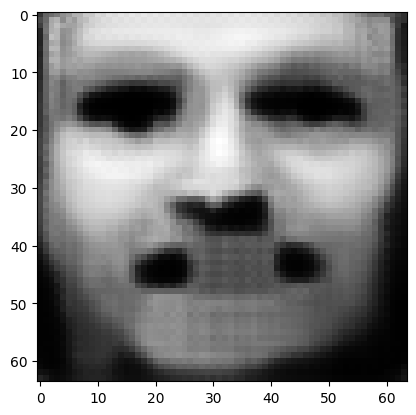

tensor([[2.1384e-06, 6.1367e-06, 3.3492e-05, 5.1158e-05, 9.6745e-01, 1.7262e-06,
         2.6261e-05, 3.2321e-07, 1.5700e-04, 7.2246e-05, 1.1834e-05, 2.0230e-03,
         2.5508e-04, 2.5590e-04, 1.6561e-04, 1.1067e-05, 5.3888e-04, 1.3285e-05,
         6.8682e-06, 4.9199e-06, 4.3818e-03, 1.0640e-03, 1.9853e-03, 1.8364e-05,
         8.8352e-04, 5.4449e-04, 7.1040e-06, 6.8311e-05, 1.0088e-06, 4.0719e-04,
         1.4726e-02, 4.7881e-04, 3.8559e-04, 2.1646e-04, 1.4647e-03, 5.2839e-04,
         1.7088e-04, 2.1356e-04, 2.2970e-04, 1.1352e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03308842331171036
tensor([[2.1378e-06, 6.1346e-06, 3.3480e-05, 5.1141e-05, 9.6746e-01, 1.7258e-06,
         2.6250e-05, 3.2309e-07, 1.5693e-04, 7.2224e-05, 1.1829e-05, 2.0224e-03,
         2.5499e-04, 2.5582e-04, 1.6555e-04, 1.1064e-05, 5.3870e-04, 1.3281e-05,
         6.8656e-06, 4.9181e-06, 4.3804e-03, 1.0636e-03, 1.9848e-03, 1.8357e-05,
         8.8320e-04, 5.4435e-04, 7.1010e-0

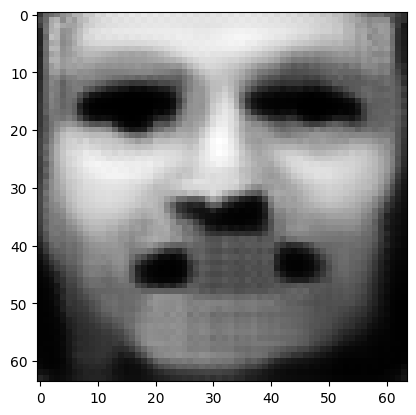

tensor([[2.1353e-06, 6.1261e-06, 3.3435e-05, 5.1077e-05, 9.6750e-01, 1.7244e-06,
         2.6209e-05, 3.2266e-07, 1.5668e-04, 7.2141e-05, 1.1809e-05, 2.0205e-03,
         2.5466e-04, 2.5549e-04, 1.6533e-04, 1.1052e-05, 5.3797e-04, 1.3264e-05,
         6.8557e-06, 4.9111e-06, 4.3751e-03, 1.0623e-03, 1.9827e-03, 1.8329e-05,
         8.8192e-04, 5.4383e-04, 7.0897e-06, 6.8165e-05, 1.0062e-06, 4.0663e-04,
         1.4705e-02, 4.7828e-04, 3.8503e-04, 2.1611e-04, 1.4625e-03, 5.2787e-04,
         1.7056e-04, 2.1316e-04, 2.2924e-04, 1.1337e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03304021432995796
tensor([[2.1347e-06, 6.1240e-06, 3.3424e-05, 5.1061e-05, 9.6751e-01, 1.7241e-06,
         2.6199e-05, 3.2255e-07, 1.5662e-04, 7.2121e-05, 1.1805e-05, 2.0200e-03,
         2.5458e-04, 2.5541e-04, 1.6527e-04, 1.1049e-05, 5.3780e-04, 1.3260e-05,
         6.8533e-06, 4.9093e-06, 4.3738e-03, 1.0620e-03, 1.9822e-03, 1.8322e-05,
         8.8161e-04, 5.4370e-04, 7.0869e-0

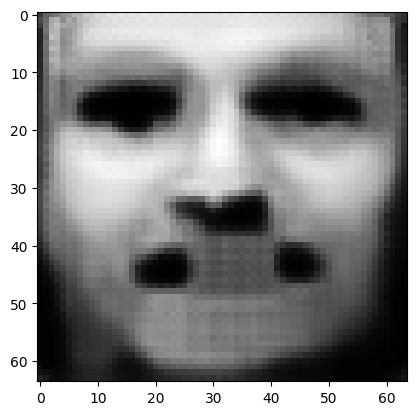

tensor([[2.1324e-06, 6.1160e-06, 3.3381e-05, 5.0999e-05, 9.6754e-01, 1.7227e-06,
         2.6160e-05, 3.2214e-07, 1.5638e-04, 7.2043e-05, 1.1786e-05, 2.0181e-03,
         2.5427e-04, 2.5511e-04, 1.6506e-04, 1.1037e-05, 5.3711e-04, 1.3244e-05,
         6.8439e-06, 4.9027e-06, 4.3688e-03, 1.0608e-03, 1.9803e-03, 1.8295e-05,
         8.8040e-04, 5.4320e-04, 7.0761e-06, 6.8026e-05, 1.0037e-06, 4.0609e-04,
         1.4685e-02, 4.7778e-04, 3.8449e-04, 2.1577e-04, 1.4604e-03, 5.2738e-04,
         1.7026e-04, 2.1278e-04, 2.2880e-04, 1.1322e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032994311302900314
tensor([[2.1318e-06, 6.1141e-06, 3.3371e-05, 5.0984e-05, 9.6755e-01, 1.7224e-06,
         2.6151e-05, 3.2204e-07, 1.5633e-04, 7.2024e-05, 1.1782e-05, 2.0176e-03,
         2.5419e-04, 2.5503e-04, 1.6500e-04, 1.1035e-05, 5.3694e-04, 1.3240e-05,
         6.8416e-06, 4.9011e-06, 4.3676e-03, 1.0605e-03, 1.9798e-03, 1.8288e-05,
         8.8011e-04, 5.4308e-04, 7.0735e-

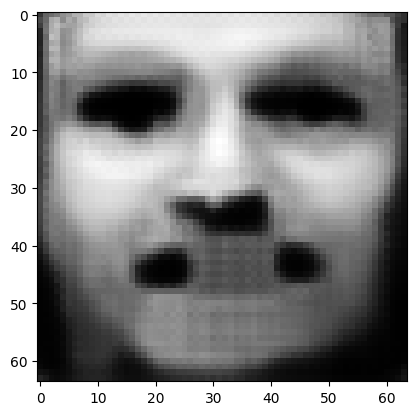

tensor([[2.1296e-06, 6.1064e-06, 3.3330e-05, 5.0926e-05, 9.6759e-01, 1.7212e-06,
         2.6114e-05, 3.2164e-07, 1.5610e-04, 7.1949e-05, 1.1764e-05, 2.0159e-03,
         2.5389e-04, 2.5474e-04, 1.6480e-04, 1.1024e-05, 5.3630e-04, 1.3225e-05,
         6.8327e-06, 4.8948e-06, 4.3628e-03, 1.0593e-03, 1.9780e-03, 1.8263e-05,
         8.7896e-04, 5.4261e-04, 7.0633e-06, 6.7894e-05, 1.0014e-06, 4.0558e-04,
         1.4667e-02, 4.7730e-04, 3.8399e-04, 2.1545e-04, 1.4585e-03, 5.2692e-04,
         1.6997e-04, 2.1243e-04, 2.2838e-04, 1.1308e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03295094147324562
tensor([[2.1291e-06, 6.1046e-06, 3.3320e-05, 5.0912e-05, 9.6759e-01, 1.7209e-06,
         2.6105e-05, 3.2155e-07, 1.5605e-04, 7.1931e-05, 1.1760e-05, 2.0154e-03,
         2.5382e-04, 2.5467e-04, 1.6475e-04, 1.1021e-05, 5.3614e-04, 1.3222e-05,
         6.8306e-06, 4.8933e-06, 4.3617e-03, 1.0590e-03, 1.9775e-03, 1.8256e-05,
         8.7869e-04, 5.4249e-04, 7.0608e-0

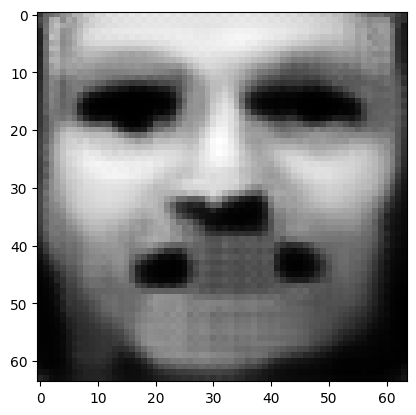

tensor([[2.1270e-06, 6.0974e-06, 3.3282e-05, 5.0857e-05, 9.6763e-01, 1.7197e-06,
         2.6070e-05, 3.2117e-07, 1.5583e-04, 7.1860e-05, 1.1743e-05, 2.0137e-03,
         2.5354e-04, 2.5440e-04, 1.6456e-04, 1.1011e-05, 5.3552e-04, 1.3207e-05,
         6.8221e-06, 4.8873e-06, 4.3572e-03, 1.0579e-03, 1.9758e-03, 1.8232e-05,
         8.7760e-04, 5.4204e-04, 7.0511e-06, 6.7769e-05, 9.9920e-07, 4.0510e-04,
         1.4649e-02, 4.7685e-04, 3.8351e-04, 2.1515e-04, 1.4566e-03, 5.2647e-04,
         1.6969e-04, 2.1209e-04, 2.2798e-04, 1.1295e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03290964663028717
tensor([[2.1265e-06, 6.0956e-06, 3.3272e-05, 5.0843e-05, 9.6763e-01, 1.7194e-06,
         2.6062e-05, 3.2108e-07, 1.5578e-04, 7.1843e-05, 1.1739e-05, 2.0133e-03,
         2.5347e-04, 2.5433e-04, 1.6451e-04, 1.1008e-05, 5.3537e-04, 1.3204e-05,
         6.8201e-06, 4.8858e-06, 4.3561e-03, 1.0576e-03, 1.9753e-03, 1.8226e-05,
         8.7734e-04, 5.4193e-04, 7.0487e-0

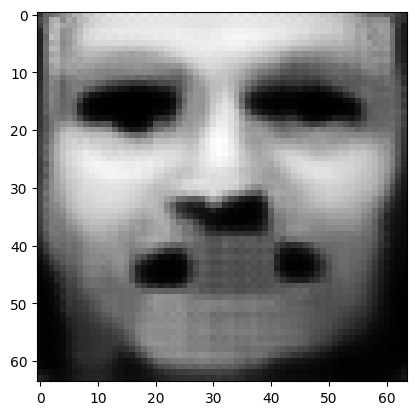

tensor([[2.1245e-06, 6.0888e-06, 3.3236e-05, 5.0791e-05, 9.6766e-01, 1.7182e-06,
         2.6029e-05, 3.2073e-07, 1.5558e-04, 7.1776e-05, 1.1723e-05, 2.0117e-03,
         2.5320e-04, 2.5407e-04, 1.6433e-04, 1.0999e-05, 5.3478e-04, 1.3190e-05,
         6.8120e-06, 4.8802e-06, 4.3518e-03, 1.0565e-03, 1.9737e-03, 1.8203e-05,
         8.7630e-04, 5.4150e-04, 7.0396e-06, 6.7651e-05, 9.9711e-07, 4.0464e-04,
         1.4632e-02, 4.7641e-04, 3.8306e-04, 2.1486e-04, 1.4548e-03, 5.2605e-04,
         1.6943e-04, 2.1177e-04, 2.2761e-04, 1.1283e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03287065774202347
tensor([[2.1240e-06, 6.0871e-06, 3.3227e-05, 5.0778e-05, 9.6767e-01, 1.7180e-06,
         2.6021e-05, 3.2064e-07, 1.5553e-04, 7.1760e-05, 1.1720e-05, 2.0113e-03,
         2.5313e-04, 2.5400e-04, 1.6428e-04, 1.0996e-05, 5.3464e-04, 1.3187e-05,
         6.8101e-06, 4.8788e-06, 4.3507e-03, 1.0563e-03, 1.9733e-03, 1.8198e-05,
         8.7605e-04, 5.4140e-04, 7.0373e-0

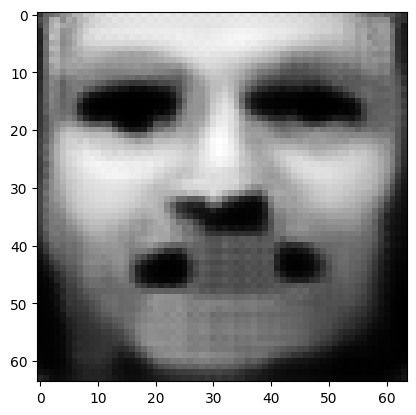

tensor([[2.1221e-06, 6.0806e-06, 3.3193e-05, 5.0728e-05, 9.6770e-01, 1.7169e-06,
         2.5989e-05, 3.2031e-07, 1.5533e-04, 7.1696e-05, 1.1705e-05, 2.0098e-03,
         2.5288e-04, 2.5375e-04, 1.6411e-04, 1.0987e-05, 5.3409e-04, 1.3174e-05,
         6.8025e-06, 4.8734e-06, 4.3467e-03, 1.0553e-03, 1.9717e-03, 1.8176e-05,
         8.7507e-04, 5.4100e-04, 7.0286e-06, 6.7539e-05, 9.9512e-07, 4.0420e-04,
         1.4616e-02, 4.7601e-04, 3.8262e-04, 2.1459e-04, 1.4532e-03, 5.2565e-04,
         1.6919e-04, 2.1147e-04, 2.2725e-04, 1.1271e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03283362835645676
tensor([[2.1217e-06, 6.0790e-06, 3.3184e-05, 5.0716e-05, 9.6771e-01, 1.7166e-06,
         2.5982e-05, 3.2023e-07, 1.5529e-04, 7.1681e-05, 1.1701e-05, 2.0094e-03,
         2.5282e-04, 2.5369e-04, 1.6406e-04, 1.0985e-05, 5.3395e-04, 1.3171e-05,
         6.8006e-06, 4.8721e-06, 4.3457e-03, 1.0550e-03, 1.9713e-03, 1.8170e-05,
         8.7483e-04, 5.4090e-04, 7.0264e-0

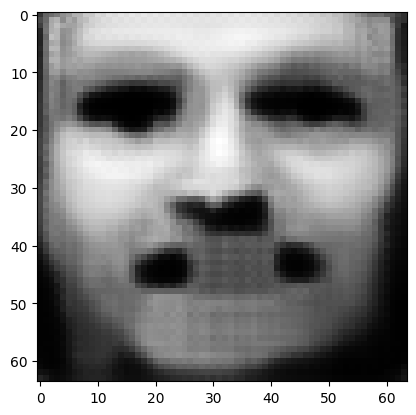

tensor([[2.1199e-06, 6.0729e-06, 3.3151e-05, 5.0669e-05, 9.6773e-01, 1.7156e-06,
         2.5952e-05, 3.1991e-07, 1.5510e-04, 7.1621e-05, 1.1687e-05, 2.0080e-03,
         2.5257e-04, 2.5346e-04, 1.6390e-04, 1.0976e-05, 5.3342e-04, 1.3159e-05,
         6.7934e-06, 4.8670e-06, 4.3418e-03, 1.0541e-03, 1.9698e-03, 1.8150e-05,
         8.7391e-04, 5.4051e-04, 7.0182e-06, 6.7433e-05, 9.9325e-07, 4.0379e-04,
         1.4601e-02, 4.7562e-04, 3.8221e-04, 2.1433e-04, 1.4516e-03, 5.2527e-04,
         1.6895e-04, 2.1118e-04, 2.2691e-04, 1.1260e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032798442989587784
tensor([[2.1195e-06, 6.0714e-06, 3.3143e-05, 5.0657e-05, 9.6774e-01, 1.7154e-06,
         2.5945e-05, 3.1983e-07, 1.5506e-04, 7.1606e-05, 1.1683e-05, 2.0076e-03,
         2.5252e-04, 2.5340e-04, 1.6386e-04, 1.0974e-05, 5.3330e-04, 1.3156e-05,
         6.7917e-06, 4.8658e-06, 4.3409e-03, 1.0538e-03, 1.9695e-03, 1.8145e-05,
         8.7369e-04, 5.4042e-04, 7.0162e-

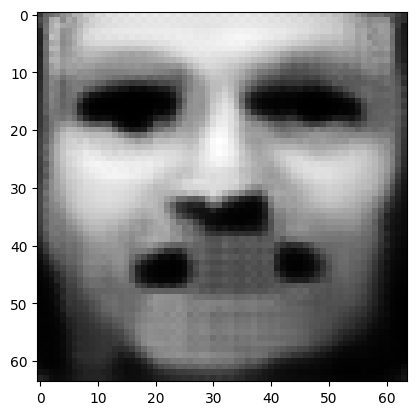

tensor([[2.1178e-06, 6.0655e-06, 3.3112e-05, 5.0612e-05, 9.6777e-01, 1.7144e-06,
         2.5916e-05, 3.1953e-07, 1.5489e-04, 7.1549e-05, 1.1670e-05, 2.0063e-03,
         2.5229e-04, 2.5318e-04, 1.6370e-04, 1.0966e-05, 5.3280e-04, 1.3145e-05,
         6.7848e-06, 4.8609e-06, 4.3372e-03, 1.0529e-03, 1.9681e-03, 1.8125e-05,
         8.7280e-04, 5.4005e-04, 7.0084e-06, 6.7332e-05, 9.9147e-07, 4.0340e-04,
         1.4587e-02, 4.7525e-04, 3.8183e-04, 2.1408e-04, 1.4501e-03, 5.2491e-04,
         1.6873e-04, 2.1090e-04, 2.2659e-04, 1.1249e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032764989882707596
tensor([[2.1173e-06, 6.0641e-06, 3.3105e-05, 5.0601e-05, 9.6777e-01, 1.7141e-06,
         2.5910e-05, 3.1946e-07, 1.5484e-04, 7.1535e-05, 1.1667e-05, 2.0059e-03,
         2.5223e-04, 2.5312e-04, 1.6366e-04, 1.0964e-05, 5.3268e-04, 1.3142e-05,
         6.7832e-06, 4.8597e-06, 4.3363e-03, 1.0527e-03, 1.9677e-03, 1.8120e-05,
         8.7259e-04, 5.3997e-04, 7.0064e-

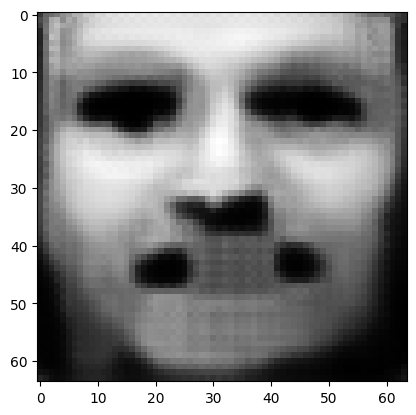

tensor([[2.1157e-06, 6.0586e-06, 3.3075e-05, 5.0559e-05, 9.6780e-01, 1.7132e-06,
         2.5883e-05, 3.1917e-07, 1.5468e-04, 7.1481e-05, 1.1654e-05, 2.0046e-03,
         2.5201e-04, 2.5291e-04, 1.6352e-04, 1.0956e-05, 5.3220e-04, 1.3131e-05,
         6.7767e-06, 4.8552e-06, 4.3329e-03, 1.0519e-03, 1.9664e-03, 1.8102e-05,
         8.7176e-04, 5.3962e-04, 6.9990e-06, 6.7236e-05, 9.8978e-07, 4.0303e-04,
         1.4573e-02, 4.7490e-04, 3.8146e-04, 2.1385e-04, 1.4487e-03, 5.2457e-04,
         1.6852e-04, 2.1064e-04, 2.2628e-04, 1.1239e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0327334925532341
tensor([[2.1153e-06, 6.0572e-06, 3.3068e-05, 5.0548e-05, 9.6780e-01, 1.7130e-06,
         2.5876e-05, 3.1910e-07, 1.5464e-04, 7.1467e-05, 1.1651e-05, 2.0043e-03,
         2.5196e-04, 2.5286e-04, 1.6348e-04, 1.0954e-05, 5.3208e-04, 1.3128e-05,
         6.7751e-06, 4.8540e-06, 4.3320e-03, 1.0516e-03, 1.9660e-03, 1.8097e-05,
         8.7155e-04, 5.3954e-04, 6.9972e-06

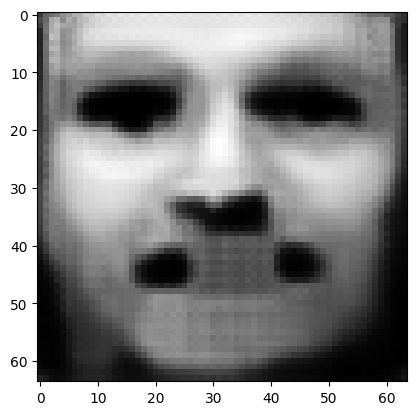

tensor([[2.1138e-06, 6.0520e-06, 3.3040e-05, 5.0508e-05, 9.6783e-01, 1.7121e-06,
         2.5851e-05, 3.1883e-07, 1.5448e-04, 7.1416e-05, 1.1639e-05, 2.0031e-03,
         2.5175e-04, 2.5266e-04, 1.6334e-04, 1.0947e-05, 5.3163e-04, 1.3118e-05,
         6.7690e-06, 4.8497e-06, 4.3287e-03, 1.0508e-03, 1.9647e-03, 1.8080e-05,
         8.7076e-04, 5.3921e-04, 6.9902e-06, 6.7145e-05, 9.8817e-07, 4.0268e-04,
         1.4560e-02, 4.7457e-04, 3.8111e-04, 2.1363e-04, 1.4473e-03, 5.2425e-04,
         1.6832e-04, 2.1040e-04, 2.2600e-04, 1.1230e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03270338103175163
tensor([[2.1134e-06, 6.0507e-06, 3.3033e-05, 5.0498e-05, 9.6783e-01, 1.7119e-06,
         2.5845e-05, 3.1876e-07, 1.5445e-04, 7.1403e-05, 1.1636e-05, 2.0028e-03,
         2.5170e-04, 2.5261e-04, 1.6330e-04, 1.0945e-05, 5.3153e-04, 1.3115e-05,
         6.7675e-06, 4.8486e-06, 4.3279e-03, 1.0506e-03, 1.9644e-03, 1.8075e-05,
         8.7057e-04, 5.3913e-04, 6.9884e-0

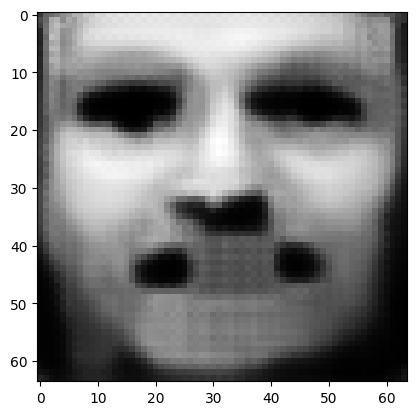

tensor([[2.1120e-06, 6.0457e-06, 3.3007e-05, 5.0460e-05, 9.6785e-01, 1.7111e-06,
         2.5821e-05, 3.1851e-07, 1.5430e-04, 7.1355e-05, 1.1624e-05, 2.0016e-03,
         2.5151e-04, 2.5242e-04, 1.6317e-04, 1.0938e-05, 5.3110e-04, 1.3105e-05,
         6.7617e-06, 4.8445e-06, 4.3248e-03, 1.0499e-03, 1.9632e-03, 1.8059e-05,
         8.6982e-04, 5.3882e-04, 6.9818e-06, 6.7060e-05, 9.8666e-07, 4.0234e-04,
         1.4548e-02, 4.7425e-04, 3.8078e-04, 2.1342e-04, 1.4460e-03, 5.2394e-04,
         1.6813e-04, 2.1016e-04, 2.2572e-04, 1.1221e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03267476707696915
tensor([[2.1116e-06, 6.0445e-06, 3.3000e-05, 5.0451e-05, 9.6786e-01, 1.7109e-06,
         2.5815e-05, 3.1844e-07, 1.5426e-04, 7.1343e-05, 1.1621e-05, 2.0013e-03,
         2.5146e-04, 2.5237e-04, 1.6314e-04, 1.0936e-05, 5.3100e-04, 1.3103e-05,
         6.7602e-06, 4.8435e-06, 4.3240e-03, 1.0497e-03, 1.9629e-03, 1.8054e-05,
         8.6963e-04, 5.3874e-04, 6.9801e-0

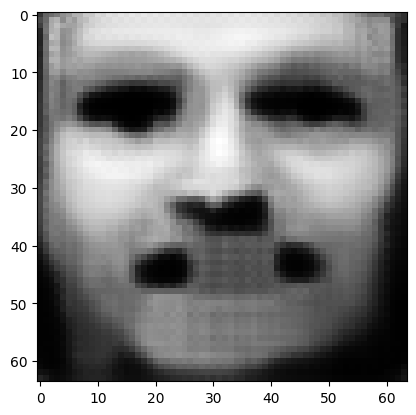

tensor([[2.1103e-06, 6.0398e-06, 3.2975e-05, 5.0414e-05, 9.6788e-01, 1.7101e-06,
         2.5792e-05, 3.1820e-07, 1.5412e-04, 7.1296e-05, 1.1610e-05, 2.0002e-03,
         2.5128e-04, 2.5219e-04, 1.6301e-04, 1.0929e-05, 5.3059e-04, 1.3094e-05,
         6.7547e-06, 4.8396e-06, 4.3211e-03, 1.0489e-03, 1.9618e-03, 1.8039e-05,
         8.6892e-04, 5.3844e-04, 6.9738e-06, 6.6978e-05, 9.8521e-07, 4.0202e-04,
         1.4537e-02, 4.7395e-04, 3.8046e-04, 2.1322e-04, 1.4448e-03, 5.2365e-04,
         1.6795e-04, 2.0994e-04, 2.2546e-04, 1.1212e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032647885382175446
tensor([[2.1099e-06, 6.0386e-06, 3.2969e-05, 5.0406e-05, 9.6788e-01, 1.7099e-06,
         2.5786e-05, 3.1814e-07, 1.5409e-04, 7.1285e-05, 1.1608e-05, 1.9999e-03,
         2.5123e-04, 2.5214e-04, 1.6298e-04, 1.0928e-05, 5.3049e-04, 1.3091e-05,
         6.7533e-06, 4.8386e-06, 4.3203e-03, 1.0487e-03, 1.9615e-03, 1.8035e-05,
         8.6875e-04, 5.3837e-04, 6.9722e-

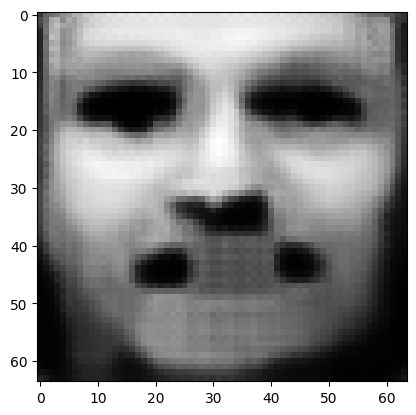

tensor([[2.1086e-06, 6.0341e-06, 3.2945e-05, 5.0371e-05, 9.6790e-01, 1.7092e-06,
         2.5765e-05, 3.1791e-07, 1.5396e-04, 7.1241e-05, 1.1597e-05, 1.9989e-03,
         2.5105e-04, 2.5197e-04, 1.6286e-04, 1.0921e-05, 5.3011e-04, 1.3082e-05,
         6.7481e-06, 4.8349e-06, 4.3175e-03, 1.0480e-03, 1.9604e-03, 1.8020e-05,
         8.6807e-04, 5.3809e-04, 6.9662e-06, 6.6900e-05, 9.8384e-07, 4.0172e-04,
         1.4525e-02, 4.7367e-04, 3.8016e-04, 2.1303e-04, 1.4436e-03, 5.2337e-04,
         1.6778e-04, 2.0973e-04, 2.2521e-04, 1.1204e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032621923834085464
tensor([[2.1083e-06, 6.0330e-06, 3.2939e-05, 5.0363e-05, 9.6791e-01, 1.7090e-06,
         2.5759e-05, 3.1785e-07, 1.5392e-04, 7.1230e-05, 1.1595e-05, 1.9986e-03,
         2.5101e-04, 2.5193e-04, 1.6283e-04, 1.0920e-05, 5.3001e-04, 1.3080e-05,
         6.7468e-06, 4.8340e-06, 4.3168e-03, 1.0479e-03, 1.9601e-03, 1.8016e-05,
         8.6791e-04, 5.3802e-04, 6.9647e-

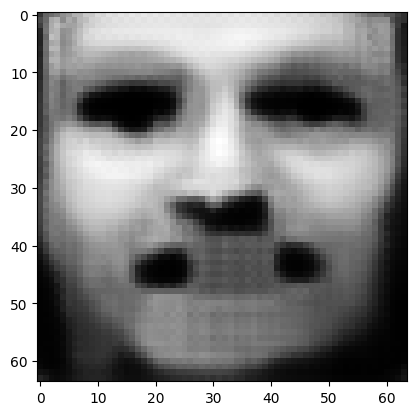

tensor([[2.1071e-06, 6.0288e-06, 3.2916e-05, 5.0330e-05, 9.6793e-01, 1.7083e-06,
         2.5739e-05, 3.1763e-07, 1.5380e-04, 7.1189e-05, 1.1585e-05, 1.9976e-03,
         2.5084e-04, 2.5177e-04, 1.6272e-04, 1.0914e-05, 5.2965e-04, 1.3072e-05,
         6.7418e-06, 4.8305e-06, 4.3142e-03, 1.0472e-03, 1.9591e-03, 1.8002e-05,
         8.6726e-04, 5.3775e-04, 6.9590e-06, 6.6826e-05, 9.8255e-07, 4.0144e-04,
         1.4515e-02, 4.7340e-04, 3.7988e-04, 2.1285e-04, 1.4425e-03, 5.2311e-04,
         1.6762e-04, 2.0953e-04, 2.2498e-04, 1.1196e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03259769454598427
tensor([[2.1068e-06, 6.0277e-06, 3.2911e-05, 5.0322e-05, 9.6793e-01, 1.7081e-06,
         2.5734e-05, 3.1758e-07, 1.5377e-04, 7.1179e-05, 1.1583e-05, 1.9974e-03,
         2.5080e-04, 2.5173e-04, 1.6269e-04, 1.0912e-05, 5.2956e-04, 1.3070e-05,
         6.7406e-06, 4.8296e-06, 4.3135e-03, 1.0471e-03, 1.9588e-03, 1.7998e-05,
         8.6711e-04, 5.3769e-04, 6.9576e-0

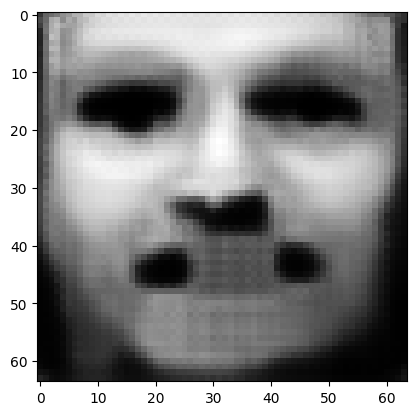

tensor([[2.1056e-06, 6.0237e-06, 3.2889e-05, 5.0291e-05, 9.6795e-01, 1.7074e-06,
         2.5714e-05, 3.1737e-07, 1.5365e-04, 7.1139e-05, 1.1573e-05, 1.9964e-03,
         2.5064e-04, 2.5157e-04, 1.6258e-04, 1.0906e-05, 5.2921e-04, 1.3062e-05,
         6.7358e-06, 4.8262e-06, 4.3110e-03, 1.0464e-03, 1.9579e-03, 1.7985e-05,
         8.6650e-04, 5.3744e-04, 6.9522e-06, 6.6757e-05, 9.8131e-07, 4.0116e-04,
         1.4505e-02, 4.7314e-04, 3.7961e-04, 2.1268e-04, 1.4415e-03, 5.2286e-04,
         1.6746e-04, 2.0934e-04, 2.2476e-04, 1.1189e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03257438540458679
tensor([[2.1053e-06, 6.0227e-06, 3.2884e-05, 5.0283e-05, 9.6795e-01, 1.7073e-06,
         2.5709e-05, 3.1732e-07, 1.5362e-04, 7.1129e-05, 1.1571e-05, 1.9962e-03,
         2.5060e-04, 2.5153e-04, 1.6255e-04, 1.0905e-05, 5.2913e-04, 1.3060e-05,
         6.7347e-06, 4.8254e-06, 4.3104e-03, 1.0463e-03, 1.9576e-03, 1.7981e-05,
         8.6635e-04, 5.3737e-04, 6.9509e-0

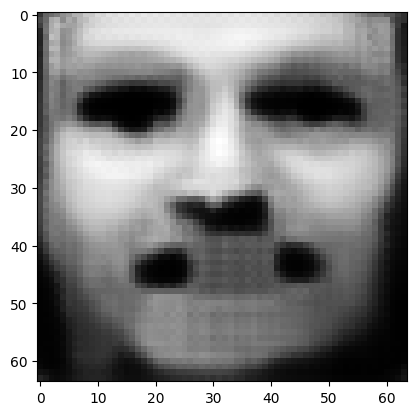

tensor([[2.1042e-06, 6.0188e-06, 3.2863e-05, 5.0254e-05, 9.6797e-01, 1.7066e-06,
         2.5691e-05, 3.1712e-07, 1.5350e-04, 7.1092e-05, 1.1562e-05, 1.9953e-03,
         2.5045e-04, 2.5139e-04, 1.6245e-04, 1.0900e-05, 5.2880e-04, 1.3052e-05,
         6.7302e-06, 4.8223e-06, 4.3080e-03, 1.0457e-03, 1.9567e-03, 1.7968e-05,
         8.6577e-04, 5.3713e-04, 6.9457e-06, 6.6690e-05, 9.8015e-07, 4.0091e-04,
         1.4496e-02, 4.7290e-04, 3.7935e-04, 2.1252e-04, 1.4405e-03, 5.2262e-04,
         1.6732e-04, 2.0916e-04, 2.2455e-04, 1.1182e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032552462071180344
tensor([[2.1039e-06, 6.0179e-06, 3.2858e-05, 5.0246e-05, 9.6798e-01, 1.7065e-06,
         2.5686e-05, 3.1707e-07, 1.5347e-04, 7.1082e-05, 1.1560e-05, 1.9951e-03,
         2.5042e-04, 2.5135e-04, 1.6242e-04, 1.0898e-05, 5.2872e-04, 1.3050e-05,
         6.7291e-06, 4.8214e-06, 4.3074e-03, 1.0455e-03, 1.9564e-03, 1.7965e-05,
         8.6563e-04, 5.3707e-04, 6.9444e-

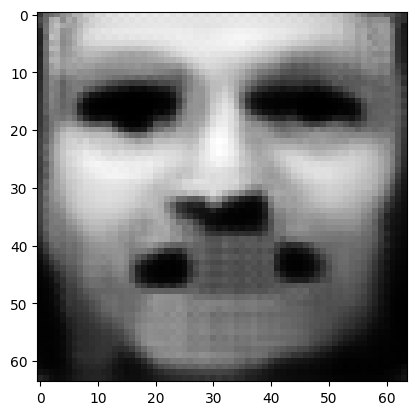

tensor([[2.1029e-06, 6.0142e-06, 3.2839e-05, 5.0218e-05, 9.6799e-01, 1.7059e-06,
         2.5669e-05, 3.1688e-07, 1.5337e-04, 7.1047e-05, 1.1552e-05, 1.9942e-03,
         2.5027e-04, 2.5121e-04, 1.6233e-04, 1.0893e-05, 5.2841e-04, 1.3043e-05,
         6.7248e-06, 4.8184e-06, 4.3051e-03, 1.0450e-03, 1.9556e-03, 1.7953e-05,
         8.6508e-04, 5.3685e-04, 6.9396e-06, 6.6627e-05, 9.7904e-07, 4.0066e-04,
         1.4487e-02, 4.7267e-04, 3.7911e-04, 2.1236e-04, 1.4396e-03, 5.2239e-04,
         1.6718e-04, 2.0899e-04, 2.2435e-04, 1.1175e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03253168985247612
tensor([[2.1026e-06, 6.0134e-06, 3.2834e-05, 5.0212e-05, 9.6800e-01, 1.7057e-06,
         2.5664e-05, 3.1684e-07, 1.5334e-04, 7.1038e-05, 1.1550e-05, 1.9940e-03,
         2.5024e-04, 2.5118e-04, 1.6230e-04, 1.0892e-05, 5.2833e-04, 1.3041e-05,
         6.7238e-06, 4.8177e-06, 4.3045e-03, 1.0448e-03, 1.9553e-03, 1.7950e-05,
         8.6495e-04, 5.3679e-04, 6.9384e-0

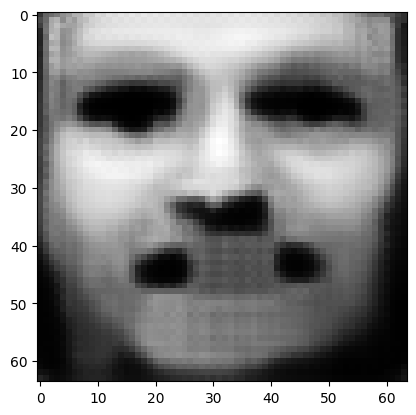

tensor([[2.1016e-06, 6.0099e-06, 3.2816e-05, 5.0185e-05, 9.6801e-01, 1.7051e-06,
         2.5647e-05, 3.1665e-07, 1.5324e-04, 7.1004e-05, 1.1542e-05, 1.9932e-03,
         2.5010e-04, 2.5104e-04, 1.6221e-04, 1.0887e-05, 5.2803e-04, 1.3035e-05,
         6.7197e-06, 4.8148e-06, 4.3023e-03, 1.0443e-03, 1.9545e-03, 1.7938e-05,
         8.6442e-04, 5.3657e-04, 6.9337e-06, 6.6567e-05, 9.7798e-07, 4.0043e-04,
         1.4478e-02, 4.7245e-04, 3.7887e-04, 2.1222e-04, 1.4387e-03, 5.2218e-04,
         1.6705e-04, 2.0883e-04, 2.2416e-04, 1.1169e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03251161053776741
tensor([[2.1013e-06, 6.0090e-06, 3.2811e-05, 5.0178e-05, 9.6801e-01, 1.7050e-06,
         2.5643e-05, 3.1661e-07, 1.5321e-04, 7.0996e-05, 1.1540e-05, 1.9930e-03,
         2.5007e-04, 2.5101e-04, 1.6219e-04, 1.0886e-05, 5.2796e-04, 1.3033e-05,
         6.7187e-06, 4.8141e-06, 4.3018e-03, 1.0441e-03, 1.9543e-03, 1.7935e-05,
         8.6430e-04, 5.3652e-04, 6.9326e-0

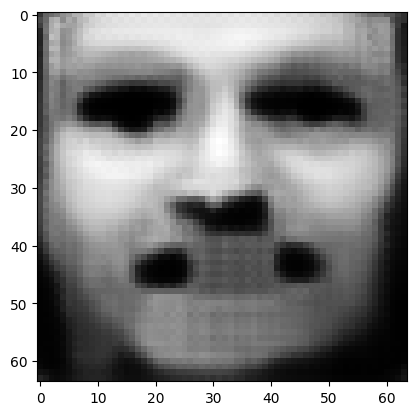

tensor([[2.1004e-06, 6.0057e-06, 3.2794e-05, 5.0153e-05, 9.6803e-01, 1.7044e-06,
         2.5628e-05, 3.1644e-07, 1.5312e-04, 7.0963e-05, 1.1532e-05, 1.9922e-03,
         2.4994e-04, 2.5088e-04, 1.6210e-04, 1.0881e-05, 5.2768e-04, 1.3026e-05,
         6.7149e-06, 4.8114e-06, 4.2997e-03, 1.0436e-03, 1.9535e-03, 1.7924e-05,
         8.6380e-04, 5.3631e-04, 6.9282e-06, 6.6511e-05, 9.7698e-07, 4.0021e-04,
         1.4470e-02, 4.7224e-04, 3.7866e-04, 2.1208e-04, 1.4378e-03, 5.2198e-04,
         1.6692e-04, 2.0867e-04, 2.2397e-04, 1.1163e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032492686063051224
tensor([[2.1002e-06, 6.0049e-06, 3.2789e-05, 5.0147e-05, 9.6803e-01, 1.7043e-06,
         2.5624e-05, 3.1640e-07, 1.5309e-04, 7.0956e-05, 1.1530e-05, 1.9920e-03,
         2.4991e-04, 2.5085e-04, 1.6208e-04, 1.0880e-05, 5.2761e-04, 1.3025e-05,
         6.7140e-06, 4.8107e-06, 4.2992e-03, 1.0435e-03, 1.9533e-03, 1.7922e-05,
         8.6368e-04, 5.3626e-04, 6.9271e-

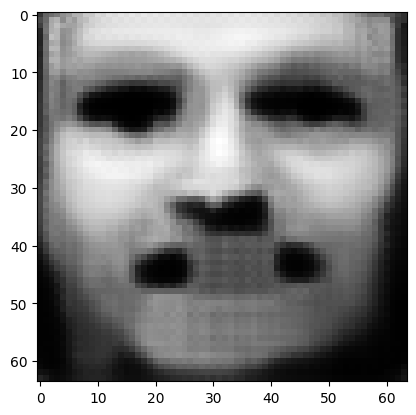

tensor([[2.0992e-06, 6.0018e-06, 3.2773e-05, 5.0123e-05, 9.6805e-01, 1.7038e-06,
         2.5609e-05, 3.1624e-07, 1.5300e-04, 7.0925e-05, 1.1523e-05, 1.9913e-03,
         2.4979e-04, 2.5073e-04, 1.6199e-04, 1.0875e-05, 5.2734e-04, 1.3019e-05,
         6.7103e-06, 4.8081e-06, 4.2973e-03, 1.0430e-03, 1.9525e-03, 1.7911e-05,
         8.6321e-04, 5.3607e-04, 6.9229e-06, 6.6457e-05, 9.7603e-07, 4.0000e-04,
         1.4462e-02, 4.7204e-04, 3.7845e-04, 2.1195e-04, 1.4370e-03, 5.2178e-04,
         1.6680e-04, 2.0853e-04, 2.2380e-04, 1.1157e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03247480094432831
tensor([[2.0990e-06, 6.0010e-06, 3.2768e-05, 5.0117e-05, 9.6805e-01, 1.7036e-06,
         2.5605e-05, 3.1620e-07, 1.5298e-04, 7.0917e-05, 1.1521e-05, 1.9911e-03,
         2.4975e-04, 2.5070e-04, 1.6197e-04, 1.0874e-05, 5.2728e-04, 1.3017e-05,
         6.7094e-06, 4.8075e-06, 4.2968e-03, 1.0429e-03, 1.9523e-03, 1.7909e-05,
         8.6309e-04, 5.3602e-04, 6.9219e-0

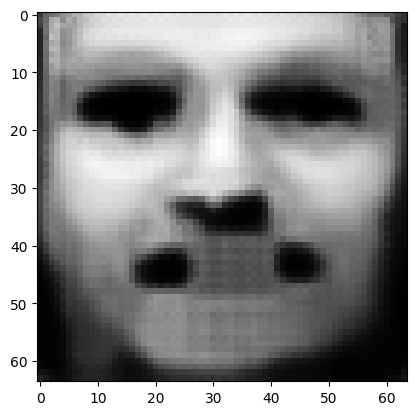

tensor([[2.0982e-06, 5.9981e-06, 3.2753e-05, 5.0094e-05, 9.6806e-01, 1.7032e-06,
         2.5590e-05, 3.1605e-07, 1.5289e-04, 7.0888e-05, 1.1514e-05, 1.9904e-03,
         2.4964e-04, 2.5059e-04, 1.6189e-04, 1.0870e-05, 5.2702e-04, 1.3011e-05,
         6.7059e-06, 4.8051e-06, 4.2949e-03, 1.0424e-03, 1.9516e-03, 1.7899e-05,
         8.6265e-04, 5.3583e-04, 6.9179e-06, 6.6406e-05, 9.7513e-07, 3.9980e-04,
         1.4455e-02, 4.7185e-04, 3.7825e-04, 2.1182e-04, 1.4362e-03, 5.2160e-04,
         1.6669e-04, 2.0839e-04, 2.2364e-04, 1.1152e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032457951456308365
tensor([[2.0980e-06, 5.9974e-06, 3.2749e-05, 5.0089e-05, 9.6807e-01, 1.7030e-06,
         2.5587e-05, 3.1601e-07, 1.5287e-04, 7.0881e-05, 1.1513e-05, 1.9902e-03,
         2.4961e-04, 2.5056e-04, 1.6187e-04, 1.0869e-05, 5.2696e-04, 1.3010e-05,
         6.7051e-06, 4.8044e-06, 4.2945e-03, 1.0423e-03, 1.9514e-03, 1.7896e-05,
         8.6254e-04, 5.3579e-04, 6.9169e-

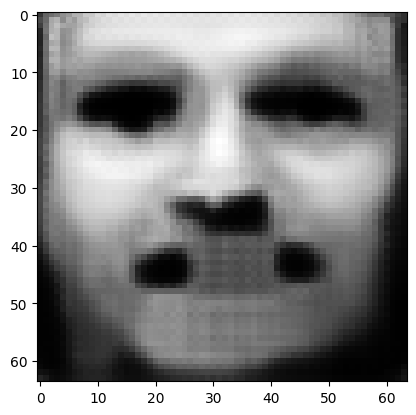

tensor([[2.0971e-06, 5.9945e-06, 3.2734e-05, 5.0067e-05, 9.6808e-01, 1.7026e-06,
         2.5573e-05, 3.1586e-07, 1.5278e-04, 7.0853e-05, 1.1506e-05, 1.9896e-03,
         2.4950e-04, 2.5045e-04, 1.6180e-04, 1.0865e-05, 5.2672e-04, 1.3004e-05,
         6.7017e-06, 4.8021e-06, 4.2927e-03, 1.0419e-03, 1.9508e-03, 1.7887e-05,
         8.6211e-04, 5.3561e-04, 6.9131e-06, 6.6357e-05, 9.7427e-07, 3.9961e-04,
         1.4448e-02, 4.7167e-04, 3.7806e-04, 2.1170e-04, 1.4355e-03, 5.2142e-04,
         1.6658e-04, 2.0826e-04, 2.2348e-04, 1.1147e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03244167938828468
tensor([[2.0969e-06, 5.9938e-06, 3.2730e-05, 5.0062e-05, 9.6808e-01, 1.7025e-06,
         2.5570e-05, 3.1583e-07, 1.5276e-04, 7.0847e-05, 1.1505e-05, 1.9894e-03,
         2.4947e-04, 2.5043e-04, 1.6178e-04, 1.0864e-05, 5.2666e-04, 1.3003e-05,
         6.7010e-06, 4.8015e-06, 4.2923e-03, 1.0418e-03, 1.9506e-03, 1.7885e-05,
         8.6201e-04, 5.3557e-04, 6.9122e-0

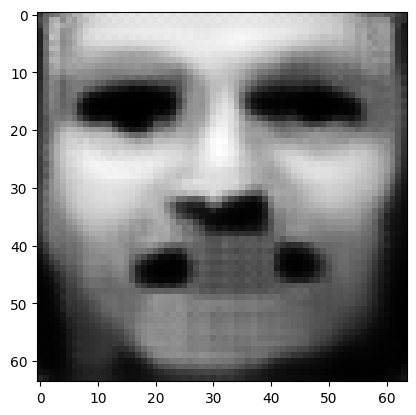

tensor([[2.0961e-06, 5.9912e-06, 3.2716e-05, 5.0041e-05, 9.6809e-01, 1.7020e-06,
         2.5557e-05, 3.1569e-07, 1.5268e-04, 7.0820e-05, 1.1499e-05, 1.9888e-03,
         2.4937e-04, 2.5033e-04, 1.6171e-04, 1.0860e-05, 5.2643e-04, 1.2998e-05,
         6.6978e-06, 4.7993e-06, 4.2906e-03, 1.0414e-03, 1.9499e-03, 1.7876e-05,
         8.6160e-04, 5.3540e-04, 6.9086e-06, 6.6311e-05, 9.7346e-07, 3.9943e-04,
         1.4441e-02, 4.7150e-04, 3.7788e-04, 2.1159e-04, 1.4348e-03, 5.2126e-04,
         1.6648e-04, 2.0813e-04, 2.2334e-04, 1.1142e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03242633119225502
tensor([[2.0960e-06, 5.9905e-06, 3.2712e-05, 5.0036e-05, 9.6810e-01, 1.7019e-06,
         2.5554e-05, 3.1566e-07, 1.5266e-04, 7.0814e-05, 1.1497e-05, 1.9886e-03,
         2.4934e-04, 2.5030e-04, 1.6169e-04, 1.0859e-05, 5.2638e-04, 1.2996e-05,
         6.6970e-06, 4.7988e-06, 4.2902e-03, 1.0413e-03, 1.9498e-03, 1.7873e-05,
         8.6151e-04, 5.3536e-04, 6.9078e-0

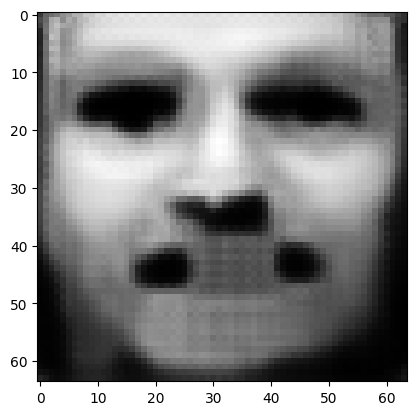

tensor([[2.0952e-06, 5.9879e-06, 3.2699e-05, 5.0017e-05, 9.6811e-01, 1.7015e-06,
         2.5542e-05, 3.1552e-07, 1.5259e-04, 7.0789e-05, 1.1491e-05, 1.9880e-03,
         2.4924e-04, 2.5020e-04, 1.6162e-04, 1.0856e-05, 5.2616e-04, 1.2991e-05,
         6.6941e-06, 4.7967e-06, 4.2886e-03, 1.0409e-03, 1.9492e-03, 1.7865e-05,
         8.6112e-04, 5.3520e-04, 6.9043e-06, 6.6267e-05, 9.7269e-07, 3.9925e-04,
         1.4435e-02, 4.7134e-04, 3.7771e-04, 2.1148e-04, 1.4342e-03, 5.2110e-04,
         1.6639e-04, 2.0801e-04, 2.2320e-04, 1.1137e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032411787658929825
tensor([[2.0950e-06, 5.9873e-06, 3.2695e-05, 5.0011e-05, 9.6811e-01, 1.7014e-06,
         2.5539e-05, 3.1549e-07, 1.5257e-04, 7.0783e-05, 1.1490e-05, 1.9879e-03,
         2.4922e-04, 2.5018e-04, 1.6160e-04, 1.0855e-05, 5.2610e-04, 1.2990e-05,
         6.6933e-06, 4.7961e-06, 4.2882e-03, 1.0408e-03, 1.9490e-03, 1.7863e-05,
         8.6103e-04, 5.3516e-04, 6.9035e-

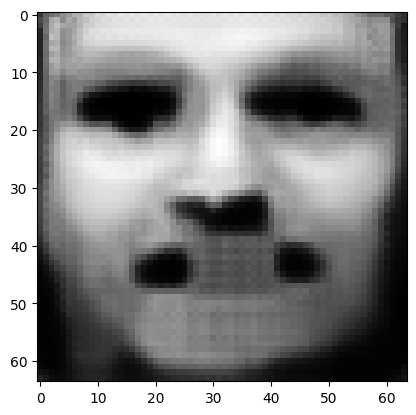

tensor([[2.0943e-06, 5.9849e-06, 3.2682e-05, 4.9993e-05, 9.6812e-01, 1.7010e-06,
         2.5527e-05, 3.1537e-07, 1.5250e-04, 7.0759e-05, 1.1484e-05, 1.9873e-03,
         2.4912e-04, 2.5008e-04, 1.6154e-04, 1.0851e-05, 5.2590e-04, 1.2985e-05,
         6.6905e-06, 4.7942e-06, 4.2867e-03, 1.0404e-03, 1.9484e-03, 1.7855e-05,
         8.6066e-04, 5.3501e-04, 6.9003e-06, 6.6225e-05, 9.7195e-07, 3.9909e-04,
         1.4429e-02, 4.7119e-04, 3.7755e-04, 2.1138e-04, 1.4335e-03, 5.2095e-04,
         1.6629e-04, 2.0790e-04, 2.2306e-04, 1.1133e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03239794075489044
tensor([[2.0942e-06, 5.9843e-06, 3.2679e-05, 4.9989e-05, 9.6812e-01, 1.7009e-06,
         2.5524e-05, 3.1534e-07, 1.5248e-04, 7.0753e-05, 1.1483e-05, 1.9871e-03,
         2.4910e-04, 2.5006e-04, 1.6152e-04, 1.0850e-05, 5.2585e-04, 1.2984e-05,
         6.6898e-06, 4.7937e-06, 4.2863e-03, 1.0403e-03, 1.9483e-03, 1.7853e-05,
         8.6058e-04, 5.3497e-04, 6.8995e-0

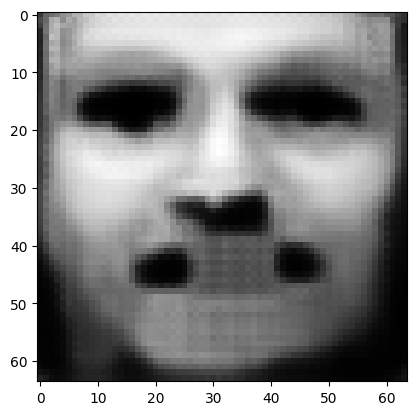

tensor([[2.0935e-06, 5.9820e-06, 3.2667e-05, 4.9971e-05, 9.6813e-01, 1.7005e-06,
         2.5513e-05, 3.1522e-07, 1.5241e-04, 7.0731e-05, 1.1478e-05, 1.9866e-03,
         2.4901e-04, 2.4997e-04, 1.6146e-04, 1.0847e-05, 5.2565e-04, 1.2980e-05,
         6.6871e-06, 4.7918e-06, 4.2849e-03, 1.0399e-03, 1.9477e-03, 1.7845e-05,
         8.6023e-04, 5.3483e-04, 6.8964e-06, 6.6186e-05, 9.7126e-07, 3.9894e-04,
         1.4423e-02, 4.7104e-04, 3.7740e-04, 2.1128e-04, 1.4329e-03, 5.2081e-04,
         1.6621e-04, 2.0779e-04, 2.2294e-04, 1.1129e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032384783029556274
tensor([[2.0933e-06, 5.9814e-06, 3.2664e-05, 4.9966e-05, 9.6814e-01, 1.7004e-06,
         2.5510e-05, 3.1519e-07, 1.5240e-04, 7.0725e-05, 1.1476e-05, 1.9865e-03,
         2.4899e-04, 2.4995e-04, 1.6145e-04, 1.0846e-05, 5.2560e-04, 1.2978e-05,
         6.6865e-06, 4.7913e-06, 4.2845e-03, 1.0399e-03, 1.9476e-03, 1.7843e-05,
         8.6015e-04, 5.3479e-04, 6.8956e-

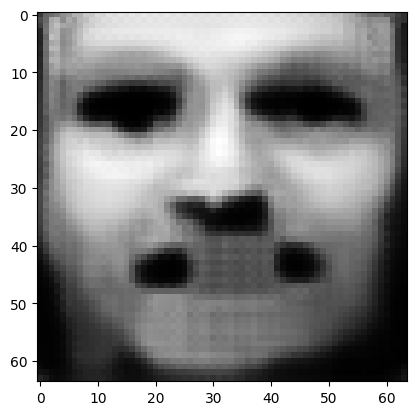

tensor([[2.0927e-06, 5.9793e-06, 3.2652e-05, 4.9950e-05, 9.6815e-01, 1.7000e-06,
         2.5500e-05, 3.1508e-07, 1.5233e-04, 7.0704e-05, 1.1471e-05, 1.9860e-03,
         2.4890e-04, 2.4987e-04, 1.6139e-04, 1.0843e-05, 5.2541e-04, 1.2974e-05,
         6.6839e-06, 4.7895e-06, 4.2831e-03, 1.0395e-03, 1.9470e-03, 1.7836e-05,
         8.5982e-04, 5.3466e-04, 6.8927e-06, 6.6148e-05, 9.7060e-07, 3.9879e-04,
         1.4418e-02, 4.7091e-04, 3.7725e-04, 2.1119e-04, 1.4324e-03, 5.2067e-04,
         1.6612e-04, 2.0769e-04, 2.2282e-04, 1.1125e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03237220272421837
tensor([[2.0925e-06, 5.9787e-06, 3.2650e-05, 4.9946e-05, 9.6815e-01, 1.6999e-06,
         2.5497e-05, 3.1505e-07, 1.5232e-04, 7.0699e-05, 1.1470e-05, 1.9858e-03,
         2.4888e-04, 2.4985e-04, 1.6137e-04, 1.0843e-05, 5.2537e-04, 1.2973e-05,
         6.6833e-06, 4.7891e-06, 4.2828e-03, 1.0394e-03, 1.9469e-03, 1.7834e-05,
         8.5974e-04, 5.3462e-04, 6.8920e-0

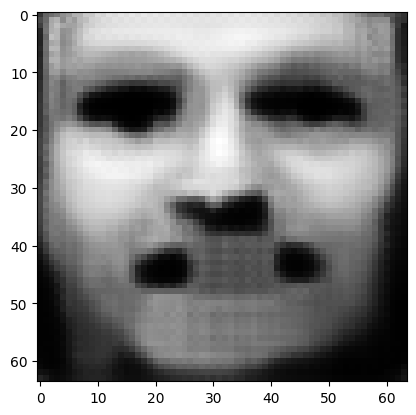

tensor([[2.0919e-06, 5.9766e-06, 3.2639e-05, 4.9930e-05, 9.6816e-01, 1.6996e-06,
         2.5487e-05, 3.1494e-07, 1.5226e-04, 7.0678e-05, 1.1465e-05, 1.9853e-03,
         2.4880e-04, 2.4977e-04, 1.6132e-04, 1.0840e-05, 5.2519e-04, 1.2969e-05,
         6.6808e-06, 4.7873e-06, 4.2815e-03, 1.0391e-03, 1.9464e-03, 1.7827e-05,
         8.5942e-04, 5.3449e-04, 6.8892e-06, 6.6112e-05, 9.6996e-07, 3.9865e-04,
         1.4413e-02, 4.7077e-04, 3.7711e-04, 2.1110e-04, 1.4318e-03, 5.2054e-04,
         1.6604e-04, 2.0759e-04, 2.2270e-04, 1.1121e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03236043080687523
tensor([[2.0918e-06, 5.9761e-06, 3.2636e-05, 4.9926e-05, 9.6816e-01, 1.6995e-06,
         2.5485e-05, 3.1491e-07, 1.5224e-04, 7.0674e-05, 1.1464e-05, 1.9852e-03,
         2.4878e-04, 2.4975e-04, 1.6130e-04, 1.0839e-05, 5.2515e-04, 1.2968e-05,
         6.6803e-06, 4.7869e-06, 4.2812e-03, 1.0390e-03, 1.9463e-03, 1.7825e-05,
         8.5935e-04, 5.3446e-04, 6.8886e-0

In [141]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=4)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  11.510977745056152


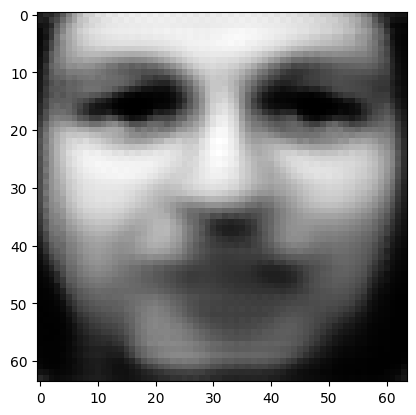

tensor([[2.0352e-04, 3.3880e-04, 2.4022e-02, 5.8337e-03, 2.9061e-03, 1.9740e-05,
         2.5928e-02, 3.0236e-04, 1.5512e-01, 1.1827e-02, 7.7623e-03, 1.2878e-02,
         2.4995e-02, 5.7240e-03, 5.4320e-03, 8.8035e-04, 2.8938e-02, 1.1173e-03,
         2.6595e-03, 1.3049e-03, 7.5701e-02, 3.2880e-02, 1.9116e-02, 8.9904e-03,
         1.2180e-01, 1.1566e-03, 5.5222e-03, 3.8428e-02, 3.4810e-02, 9.0501e-03,
         2.8699e-02, 5.3015e-04, 2.1628e-02, 5.0865e-03, 5.2000e-02, 1.1088e-03,
         2.3429e-02, 1.0593e-01, 5.9856e-02, 3.6091e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  10.832881927490234
tensor([[2.6077e-04, 4.0835e-04, 2.9001e-02, 7.5262e-03, 3.4446e-03, 2.8798e-05,
         2.5281e-02, 3.7561e-04, 1.3652e-01, 1.2673e-02, 8.6777e-03, 1.3324e-02,
         2.8094e-02, 6.8272e-03, 5.5518e-03, 1.1526e-03, 3.1379e-02, 1.2694e-03,
         2.8387e-03, 1.3307e-03, 7.5940e-02, 3.5424e-02, 2.1659e-02, 8.2263e-03,
         1.1126e-01, 1.3023e-03, 6.5010e-03

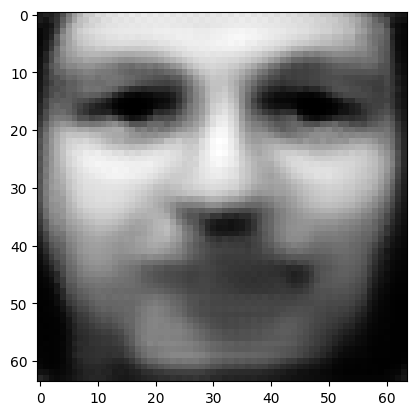

tensor([[4.1336e-04, 6.0908e-04, 4.5416e-02, 1.2826e-02, 5.9314e-03, 8.6500e-05,
         2.2970e-02, 5.8791e-04, 8.9810e-02, 1.2418e-02, 1.0652e-02, 1.3344e-02,
         3.7306e-02, 1.1018e-02, 5.3943e-03, 2.2284e-03, 3.7951e-02, 1.6422e-03,
         2.6734e-03, 1.2506e-03, 7.0855e-02, 3.9037e-02, 2.8310e-02, 5.2361e-03,
         9.2832e-02, 1.9583e-03, 8.5628e-03, 3.0212e-02, 2.7037e-02, 8.5035e-03,
         2.0253e-02, 1.8937e-03, 2.6996e-02, 7.1597e-03, 3.2763e-02, 1.4534e-03,
         3.0283e-02, 1.8774e-01, 3.9306e-02, 2.5080e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  9.355365753173828
tensor([[4.3389e-04, 6.2861e-04, 4.9904e-02, 1.4446e-02, 6.5679e-03, 1.0927e-04,
         2.2666e-02, 6.1992e-04, 8.3912e-02, 1.2070e-02, 1.0736e-02, 1.3023e-02,
         3.9499e-02, 1.1875e-02, 5.3079e-03, 2.4659e-03, 3.8512e-02, 1.7482e-03,
         2.5294e-03, 1.2472e-03, 6.9467e-02, 3.9025e-02, 3.0580e-02, 4.6419e-03,
         8.6924e-02, 2.1052e-03, 8.6415e-03,

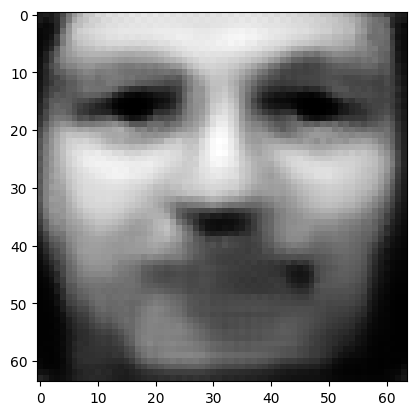

tensor([[0.0005, 0.0007, 0.0636, 0.0203, 0.0106, 0.0002, 0.0216, 0.0007, 0.0658,
         0.0116, 0.0107, 0.0123, 0.0478, 0.0144, 0.0053, 0.0035, 0.0398, 0.0020,
         0.0020, 0.0012, 0.0615, 0.0389, 0.0429, 0.0031, 0.0759, 0.0029, 0.0084,
         0.0249, 0.0185, 0.0070, 0.0161, 0.0037, 0.0298, 0.0076, 0.0233, 0.0016,
         0.0308, 0.2244, 0.0257, 0.0184]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.297290802001953
tensor([[0.0005, 0.0007, 0.0668, 0.0215, 0.0119, 0.0003, 0.0212, 0.0008, 0.0626,
         0.0116, 0.0107, 0.0120, 0.0501, 0.0148, 0.0053, 0.0038, 0.0397, 0.0021,
         0.0019, 0.0012, 0.0590, 0.0388, 0.0466, 0.0028, 0.0738, 0.0030, 0.0083,
         0.0241, 0.0171, 0.0068, 0.0156, 0.0041, 0.0302, 0.0077, 0.0219, 0.0017,
         0.0306, 0.2275, 0.0236, 0.0174]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.108343124389648
tensor([[0.0005, 0.0007, 0.0698, 0.0225, 0.0133, 0.0004, 0.0208, 0.0008, 0.0597,
         0.

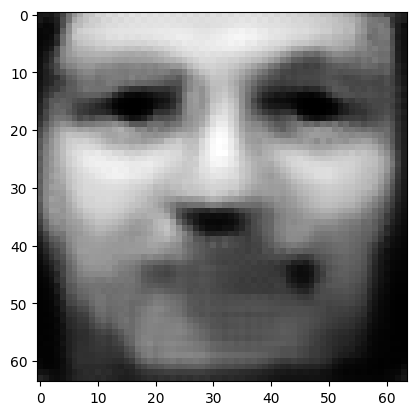

tensor([[0.0006, 0.0006, 0.0765, 0.0248, 0.0182, 0.0006, 0.0199, 0.0008, 0.0523,
         0.0117, 0.0100, 0.0106, 0.0593, 0.0155, 0.0050, 0.0050, 0.0394, 0.0021,
         0.0014, 0.0010, 0.0471, 0.0382, 0.0600, 0.0019, 0.0675, 0.0036, 0.0076,
         0.0206, 0.0128, 0.0064, 0.0139, 0.0059, 0.0323, 0.0077, 0.0178, 0.0019,
         0.0291, 0.2396, 0.0171, 0.0137]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.409632682800293
tensor([[0.0006, 0.0006, 0.0784, 0.0253, 0.0200, 0.0007, 0.0195, 0.0009, 0.0503,
         0.0118, 0.0098, 0.0102, 0.0616, 0.0155, 0.0049, 0.0054, 0.0393, 0.0021,
         0.0013, 0.0010, 0.0444, 0.0380, 0.0629, 0.0017, 0.0658, 0.0036, 0.0073,
         0.0197, 0.0120, 0.0063, 0.0135, 0.0063, 0.0329, 0.0077, 0.0170, 0.0020,
         0.0286, 0.2426, 0.0158, 0.0129]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.251016616821289
tensor([[0.0006, 0.0006, 0.0800, 0.0258, 0.0221, 0.0008, 0.0190, 0.0009, 0.0484,
         0.

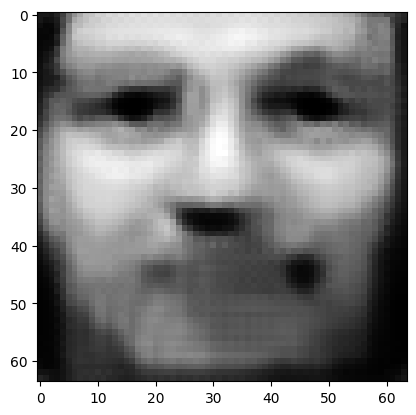

tensor([[0.0006, 0.0006, 0.0834, 0.0272, 0.0287, 0.0013, 0.0182, 0.0010, 0.0428,
         0.0121, 0.0090, 0.0093, 0.0703, 0.0154, 0.0045, 0.0072, 0.0387, 0.0021,
         0.0011, 0.0009, 0.0359, 0.0368, 0.0716, 0.0013, 0.0605, 0.0038, 0.0066,
         0.0165, 0.0094, 0.0062, 0.0120, 0.0082, 0.0351, 0.0075, 0.0144, 0.0022,
         0.0262, 0.2491, 0.0119, 0.0106]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.680172920227051
tensor([[0.0007, 0.0006, 0.0847, 0.0278, 0.0310, 0.0014, 0.0180, 0.0010, 0.0413,
         0.0123, 0.0088, 0.0091, 0.0724, 0.0152, 0.0044, 0.0078, 0.0384, 0.0021,
         0.0010, 0.0009, 0.0342, 0.0366, 0.0728, 0.0012, 0.0589, 0.0038, 0.0065,
         0.0158, 0.0089, 0.0062, 0.0117, 0.0087, 0.0357, 0.0074, 0.0138, 0.0023,
         0.0255, 0.2495, 0.0112, 0.0103]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.554596900939941
tensor([[0.0007, 0.0006, 0.0857, 0.0281, 0.0334, 0.0016, 0.0178, 0.0010, 0.0399,
         0.

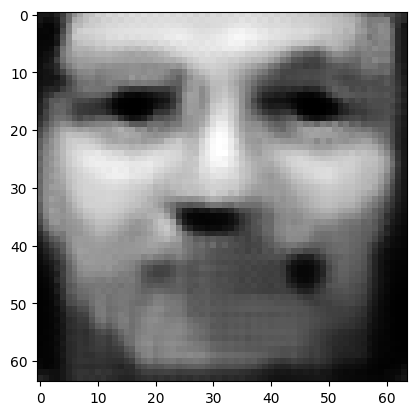

tensor([[0.0008, 0.0006, 0.0880, 0.0290, 0.0405, 0.0023, 0.0171, 0.0011, 0.0367,
         0.0137, 0.0084, 0.0083, 0.0833, 0.0139, 0.0041, 0.0108, 0.0367, 0.0022,
         0.0009, 0.0009, 0.0275, 0.0357, 0.0790, 0.0010, 0.0535, 0.0036, 0.0061,
         0.0138, 0.0077, 0.0064, 0.0102, 0.0103, 0.0380, 0.0072, 0.0119, 0.0027,
         0.0229, 0.2454, 0.0087, 0.0091]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.085265159606934
tensor([[0.0008, 0.0006, 0.0886, 0.0291, 0.0431, 0.0025, 0.0168, 0.0011, 0.0356,
         0.0141, 0.0083, 0.0082, 0.0857, 0.0137, 0.0041, 0.0117, 0.0362, 0.0022,
         0.0009, 0.0009, 0.0261, 0.0355, 0.0808, 0.0009, 0.0523, 0.0036, 0.0060,
         0.0134, 0.0074, 0.0065, 0.0099, 0.0107, 0.0383, 0.0071, 0.0115, 0.0029,
         0.0222, 0.2437, 0.0082, 0.0089]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.975316047668457
tensor([[0.0008, 0.0006, 0.0888, 0.0294, 0.0462, 0.0028, 0.0166, 0.0012, 0.0347,
         0.

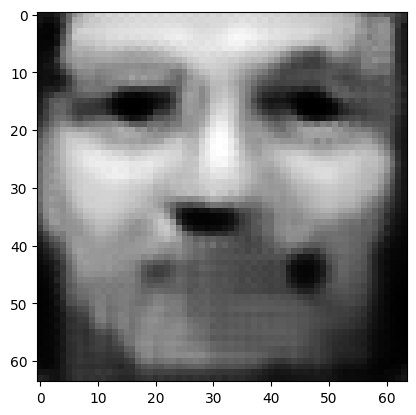

tensor([[0.0009, 0.0006, 0.0890, 0.0295, 0.0562, 0.0039, 0.0161, 0.0013, 0.0319,
         0.0156, 0.0078, 0.0078, 0.0923, 0.0126, 0.0038, 0.0153, 0.0345, 0.0022,
         0.0008, 0.0009, 0.0213, 0.0345, 0.0876, 0.0008, 0.0481, 0.0035, 0.0055,
         0.0117, 0.0062, 0.0065, 0.0089, 0.0126, 0.0399, 0.0068, 0.0102, 0.0033,
         0.0198, 0.2353, 0.0065, 0.0081]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.543708801269531
tensor([[0.0010, 0.0006, 0.0892, 0.0296, 0.0595, 0.0043, 0.0159, 0.0013, 0.0310,
         0.0159, 0.0077, 0.0077, 0.0937, 0.0124, 0.0037, 0.0163, 0.0341, 0.0022,
         0.0008, 0.0009, 0.0204, 0.0343, 0.0885, 0.0008, 0.0469, 0.0035, 0.0055,
         0.0113, 0.0060, 0.0066, 0.0087, 0.0130, 0.0401, 0.0068, 0.0099, 0.0034,
         0.0192, 0.2334, 0.0061, 0.0080]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.4439697265625
tensor([[0.0010, 0.0006, 0.0894, 0.0296, 0.0629, 0.0048, 0.0157, 0.0013, 0.0302,
         0.01

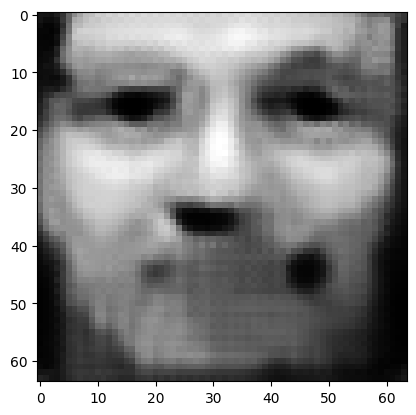

tensor([[0.0011, 0.0006, 0.0901, 0.0295, 0.0722, 0.0062, 0.0155, 0.0014, 0.0281,
         0.0174, 0.0073, 0.0074, 0.0971, 0.0114, 0.0035, 0.0209, 0.0323, 0.0022,
         0.0007, 0.0008, 0.0168, 0.0330, 0.0919, 0.0007, 0.0436, 0.0034, 0.0051,
         0.0099, 0.0052, 0.0066, 0.0077, 0.0147, 0.0410, 0.0064, 0.0090, 0.0038,
         0.0170, 0.2258, 0.0050, 0.0076]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.075769424438477
tensor([[0.0011, 0.0006, 0.0903, 0.0296, 0.0752, 0.0068, 0.0154, 0.0015, 0.0273,
         0.0177, 0.0073, 0.0073, 0.0976, 0.0112, 0.0034, 0.0222, 0.0318, 0.0022,
         0.0007, 0.0008, 0.0160, 0.0327, 0.0921, 0.0006, 0.0426, 0.0033, 0.0050,
         0.0095, 0.0051, 0.0067, 0.0075, 0.0152, 0.0413, 0.0064, 0.0087, 0.0039,
         0.0165, 0.2247, 0.0047, 0.0075]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.988637924194336
tensor([[0.0011, 0.0006, 0.0907, 0.0296, 0.0782, 0.0074, 0.0153, 0.0015, 0.0267,
         0.

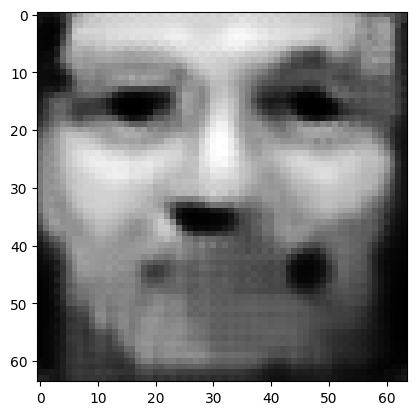

tensor([[0.0012, 0.0006, 0.0919, 0.0297, 0.0861, 0.0094, 0.0152, 0.0016, 0.0250,
         0.0191, 0.0070, 0.0068, 0.0992, 0.0101, 0.0032, 0.0279, 0.0297, 0.0023,
         0.0006, 0.0008, 0.0134, 0.0314, 0.0920, 0.0006, 0.0393, 0.0031, 0.0047,
         0.0084, 0.0046, 0.0068, 0.0065, 0.0165, 0.0424, 0.0060, 0.0080, 0.0043,
         0.0146, 0.2186, 0.0039, 0.0072]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.665986061096191
tensor([[0.0012, 0.0006, 0.0921, 0.0297, 0.0887, 0.0101, 0.0152, 0.0017, 0.0244,
         0.0194, 0.0070, 0.0067, 0.0993, 0.0099, 0.0031, 0.0294, 0.0292, 0.0023,
         0.0006, 0.0008, 0.0128, 0.0311, 0.0921, 0.0006, 0.0386, 0.0031, 0.0046,
         0.0081, 0.0045, 0.0068, 0.0063, 0.0168, 0.0427, 0.0060, 0.0078, 0.0044,
         0.0142, 0.2169, 0.0038, 0.0071]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.590648651123047
tensor([[0.0012, 0.0006, 0.0927, 0.0297, 0.0910, 0.0109, 0.0152, 0.0017, 0.0240,
         0.

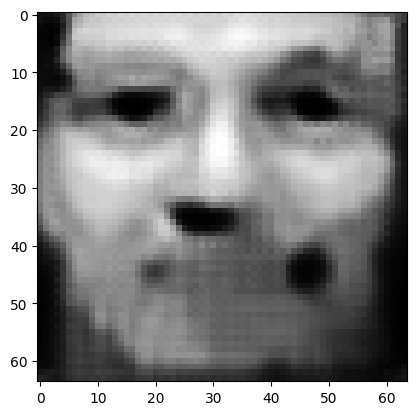

tensor([[0.0013, 0.0006, 0.0938, 0.0296, 0.0976, 0.0136, 0.0151, 0.0019, 0.0226,
         0.0206, 0.0068, 0.0061, 0.0989, 0.0090, 0.0029, 0.0356, 0.0275, 0.0023,
         0.0006, 0.0008, 0.0107, 0.0299, 0.0919, 0.0005, 0.0359, 0.0028, 0.0043,
         0.0072, 0.0041, 0.0068, 0.0055, 0.0178, 0.0437, 0.0057, 0.0072, 0.0047,
         0.0126, 0.2113, 0.0032, 0.0067]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.300876617431641
tensor([[0.0013, 0.0006, 0.0943, 0.0295, 0.0996, 0.0145, 0.0151, 0.0019, 0.0222,
         0.0209, 0.0068, 0.0060, 0.0984, 0.0088, 0.0029, 0.0372, 0.0271, 0.0023,
         0.0006, 0.0008, 0.0103, 0.0296, 0.0918, 0.0005, 0.0352, 0.0028, 0.0042,
         0.0070, 0.0040, 0.0068, 0.0053, 0.0180, 0.0439, 0.0056, 0.0071, 0.0048,
         0.0123, 0.2104, 0.0031, 0.0066]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.232919692993164
tensor([[0.0013, 0.0006, 0.0948, 0.0295, 0.1012, 0.0155, 0.0151, 0.0020, 0.0218,
         0.

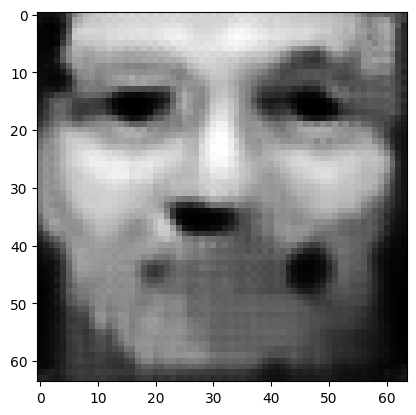

tensor([[0.0014, 0.0006, 0.0970, 0.0297, 0.1064, 0.0189, 0.0151, 0.0022, 0.0205,
         0.0217, 0.0065, 0.0056, 0.0955, 0.0082, 0.0027, 0.0429, 0.0257, 0.0023,
         0.0006, 0.0008, 0.0087, 0.0283, 0.0918, 0.0004, 0.0323, 0.0026, 0.0039,
         0.0062, 0.0037, 0.0067, 0.0046, 0.0190, 0.0444, 0.0052, 0.0066, 0.0050,
         0.0111, 0.2068, 0.0026, 0.0061]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.971210479736328
tensor([[0.0014, 0.0006, 0.0978, 0.0298, 0.1077, 0.0201, 0.0152, 0.0022, 0.0200,
         0.0219, 0.0065, 0.0055, 0.0947, 0.0080, 0.0026, 0.0443, 0.0254, 0.0023,
         0.0005, 0.0008, 0.0083, 0.0279, 0.0917, 0.0004, 0.0317, 0.0026, 0.0039,
         0.0060, 0.0036, 0.0066, 0.0044, 0.0193, 0.0444, 0.0051, 0.0064, 0.0050,
         0.0108, 0.2059, 0.0025, 0.0060]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.9094643592834473
tensor([[0.0014, 0.0006, 0.0986, 0.0299, 0.1091, 0.0213, 0.0153, 0.0023, 0.0196,
         0

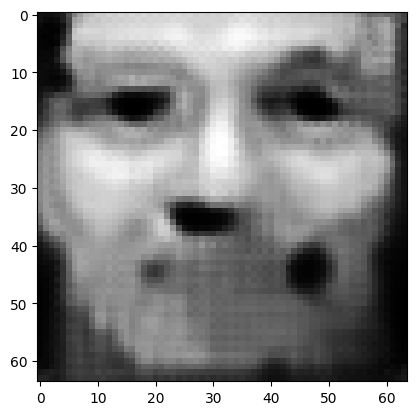

tensor([[0.0015, 0.0005, 0.1004, 0.0303, 0.1120, 0.0251, 0.0155, 0.0025, 0.0185,
         0.0228, 0.0062, 0.0052, 0.0921, 0.0074, 0.0024, 0.0495, 0.0241, 0.0023,
         0.0005, 0.0008, 0.0071, 0.0268, 0.0919, 0.0004, 0.0295, 0.0025, 0.0037,
         0.0055, 0.0033, 0.0063, 0.0039, 0.0201, 0.0445, 0.0048, 0.0059, 0.0051,
         0.0099, 0.2015, 0.0022, 0.0055]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.68435001373291
tensor([[0.0015, 0.0005, 0.1007, 0.0304, 0.1129, 0.0264, 0.0156, 0.0025, 0.0182,
         0.0229, 0.0061, 0.0051, 0.0918, 0.0072, 0.0023, 0.0507, 0.0238, 0.0023,
         0.0005, 0.0008, 0.0068, 0.0265, 0.0918, 0.0004, 0.0290, 0.0025, 0.0036,
         0.0053, 0.0033, 0.0062, 0.0037, 0.0203, 0.0446, 0.0047, 0.0058, 0.0052,
         0.0097, 0.2005, 0.0021, 0.0055]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.632615804672241
tensor([[0.0015, 0.0005, 0.1010, 0.0306, 0.1139, 0.0278, 0.0157, 0.0026, 0.0179,
         0.0

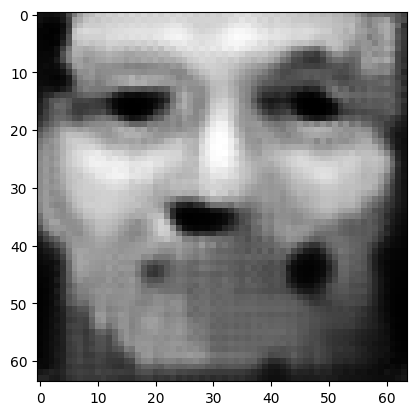

tensor([[0.0016, 0.0005, 0.1015, 0.0311, 0.1165, 0.0322, 0.0159, 0.0027, 0.0169,
         0.0235, 0.0059, 0.0048, 0.0900, 0.0067, 0.0022, 0.0549, 0.0225, 0.0023,
         0.0005, 0.0008, 0.0059, 0.0256, 0.0919, 0.0003, 0.0270, 0.0025, 0.0034,
         0.0049, 0.0031, 0.0059, 0.0033, 0.0208, 0.0449, 0.0044, 0.0054, 0.0053,
         0.0090, 0.1965, 0.0019, 0.0051]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.4372634887695312
tensor([[0.0016, 0.0005, 0.1016, 0.0312, 0.1174, 0.0337, 0.0159, 0.0028, 0.0166,
         0.0237, 0.0058, 0.0047, 0.0896, 0.0066, 0.0021, 0.0559, 0.0222, 0.0023,
         0.0005, 0.0008, 0.0057, 0.0254, 0.0919, 0.0003, 0.0266, 0.0025, 0.0033,
         0.0048, 0.0030, 0.0059, 0.0032, 0.0210, 0.0449, 0.0043, 0.0053, 0.0053,
         0.0089, 0.1955, 0.0018, 0.0050]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.391732692718506
tensor([[0.0016, 0.0005, 0.1016, 0.0313, 0.1183, 0.0352, 0.0160, 0.0028, 0.0163,
         0

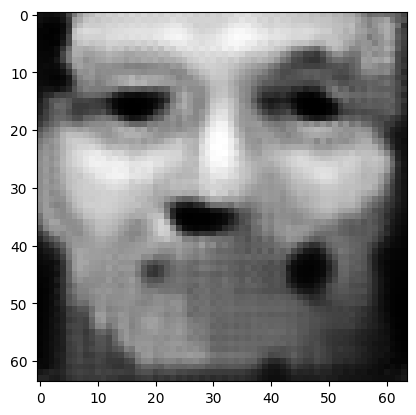

tensor([[0.0017, 0.0005, 0.1018, 0.0317, 0.1205, 0.0400, 0.0161, 0.0030, 0.0154,
         0.0243, 0.0056, 0.0045, 0.0877, 0.0061, 0.0020, 0.0596, 0.0212, 0.0022,
         0.0005, 0.0007, 0.0050, 0.0247, 0.0918, 0.0003, 0.0250, 0.0024, 0.0032,
         0.0045, 0.0028, 0.0056, 0.0029, 0.0216, 0.0448, 0.0041, 0.0050, 0.0054,
         0.0084, 0.1914, 0.0016, 0.0047]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.219271183013916
tensor([[0.0017, 0.0005, 0.1017, 0.0318, 0.1212, 0.0416, 0.0162, 0.0031, 0.0151,
         0.0244, 0.0055, 0.0044, 0.0872, 0.0060, 0.0019, 0.0603, 0.0210, 0.0022,
         0.0005, 0.0007, 0.0048, 0.0245, 0.0919, 0.0003, 0.0246, 0.0024, 0.0031,
         0.0044, 0.0028, 0.0055, 0.0028, 0.0218, 0.0447, 0.0040, 0.0049, 0.0054,
         0.0083, 0.1902, 0.0016, 0.0047]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.1784582138061523
tensor([[0.0017, 0.0005, 0.1017, 0.0319, 0.1218, 0.0434, 0.0162, 0.0031, 0.0148,
         0

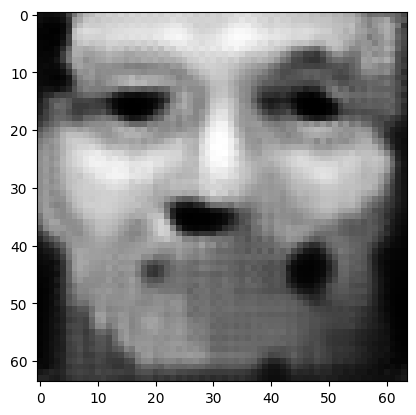

tensor([[0.0018, 0.0005, 0.1013, 0.0321, 0.1236, 0.0487, 0.0162, 0.0033, 0.0139,
         0.0249, 0.0053, 0.0042, 0.0855, 0.0057, 0.0018, 0.0634, 0.0201, 0.0021,
         0.0005, 0.0007, 0.0042, 0.0239, 0.0920, 0.0003, 0.0233, 0.0024, 0.0030,
         0.0041, 0.0026, 0.0052, 0.0026, 0.0224, 0.0443, 0.0038, 0.0045, 0.0055,
         0.0080, 0.1862, 0.0014, 0.0044]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.0219736099243164
tensor([[0.0019, 0.0005, 0.1012, 0.0322, 0.1240, 0.0505, 0.0162, 0.0034, 0.0137,
         0.0250, 0.0052, 0.0042, 0.0852, 0.0056, 0.0018, 0.0640, 0.0199, 0.0021,
         0.0005, 0.0007, 0.0041, 0.0237, 0.0921, 0.0003, 0.0229, 0.0024, 0.0030,
         0.0041, 0.0026, 0.0051, 0.0025, 0.0226, 0.0441, 0.0038, 0.0045, 0.0055,
         0.0079, 0.1852, 0.0014, 0.0043]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.9849233627319336
tensor([[0.0019, 0.0005, 0.1011, 0.0323, 0.1244, 0.0524, 0.0162, 0.0034, 0.0134,
         

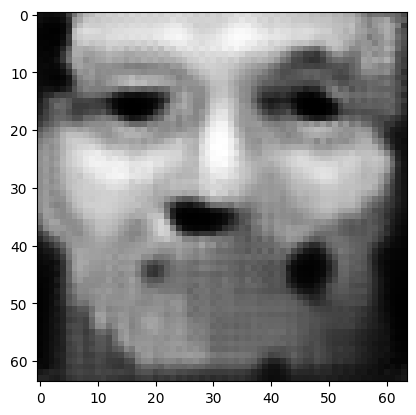

tensor([[0.0020, 0.0005, 0.1010, 0.0325, 0.1255, 0.0580, 0.0163, 0.0036, 0.0126,
         0.0253, 0.0051, 0.0040, 0.0836, 0.0054, 0.0016, 0.0661, 0.0192, 0.0020,
         0.0005, 0.0007, 0.0037, 0.0232, 0.0926, 0.0003, 0.0217, 0.0025, 0.0028,
         0.0039, 0.0024, 0.0048, 0.0023, 0.0232, 0.0435, 0.0036, 0.0042, 0.0055,
         0.0077, 0.1813, 0.0013, 0.0041]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.846459150314331
tensor([[0.0020, 0.0005, 0.1010, 0.0325, 0.1257, 0.0600, 0.0163, 0.0037, 0.0124,
         0.0254, 0.0050, 0.0039, 0.0831, 0.0053, 0.0016, 0.0666, 0.0190, 0.0020,
         0.0004, 0.0007, 0.0036, 0.0230, 0.0926, 0.0002, 0.0214, 0.0025, 0.0028,
         0.0038, 0.0024, 0.0048, 0.0023, 0.0233, 0.0433, 0.0036, 0.0041, 0.0055,
         0.0077, 0.1805, 0.0012, 0.0040]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.8136935234069824
tensor([[0.0020, 0.0005, 0.1009, 0.0326, 0.1260, 0.0619, 0.0163, 0.0037, 0.0122,
         0

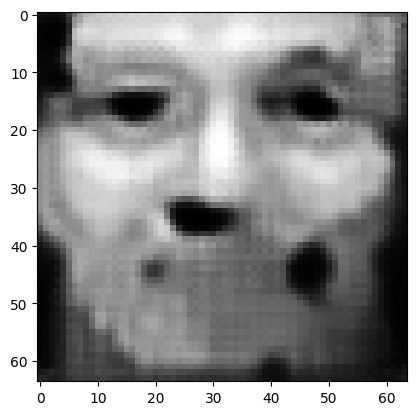

tensor([[0.0021, 0.0005, 0.1003, 0.0325, 0.1269, 0.0679, 0.0163, 0.0039, 0.0115,
         0.0256, 0.0049, 0.0038, 0.0814, 0.0051, 0.0015, 0.0682, 0.0184, 0.0020,
         0.0004, 0.0007, 0.0032, 0.0225, 0.0925, 0.0002, 0.0203, 0.0025, 0.0027,
         0.0036, 0.0023, 0.0045, 0.0021, 0.0238, 0.0428, 0.0035, 0.0039, 0.0055,
         0.0075, 0.1776, 0.0012, 0.0038]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.6892292499542236
tensor([[0.0022, 0.0005, 0.1001, 0.0325, 0.1270, 0.0700, 0.0163, 0.0040, 0.0113,
         0.0256, 0.0048, 0.0037, 0.0810, 0.0050, 0.0015, 0.0687, 0.0183, 0.0020,
         0.0004, 0.0007, 0.0031, 0.0224, 0.0925, 0.0002, 0.0200, 0.0025, 0.0027,
         0.0036, 0.0023, 0.0045, 0.0020, 0.0239, 0.0427, 0.0034, 0.0039, 0.0055,
         0.0075, 0.1769, 0.0011, 0.0038]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.6595335006713867
tensor([[0.0022, 0.0005, 0.0999, 0.0325, 0.1273, 0.0721, 0.0163, 0.0040, 0.0110,
         

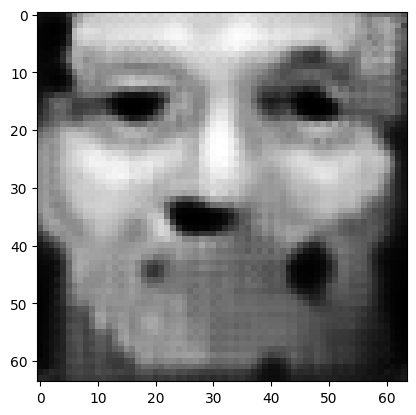

tensor([[0.0023, 0.0005, 0.0993, 0.0323, 0.1278, 0.0784, 0.0163, 0.0042, 0.0104,
         0.0257, 0.0047, 0.0036, 0.0793, 0.0049, 0.0014, 0.0702, 0.0177, 0.0019,
         0.0004, 0.0006, 0.0028, 0.0219, 0.0921, 0.0002, 0.0191, 0.0025, 0.0025,
         0.0034, 0.0022, 0.0043, 0.0019, 0.0244, 0.0421, 0.0033, 0.0037, 0.0056,
         0.0073, 0.1741, 0.0011, 0.0036]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.545834541320801
tensor([[0.0023, 0.0005, 0.0991, 0.0323, 0.1279, 0.0806, 0.0163, 0.0043, 0.0103,
         0.0257, 0.0047, 0.0036, 0.0790, 0.0048, 0.0014, 0.0705, 0.0176, 0.0019,
         0.0004, 0.0006, 0.0028, 0.0218, 0.0920, 0.0002, 0.0189, 0.0025, 0.0025,
         0.0034, 0.0021, 0.0042, 0.0019, 0.0245, 0.0419, 0.0033, 0.0037, 0.0056,
         0.0073, 0.1733, 0.0010, 0.0035]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.518683433532715
tensor([[0.0024, 0.0005, 0.0989, 0.0322, 0.1281, 0.0827, 0.0163, 0.0043, 0.0101,
         0.

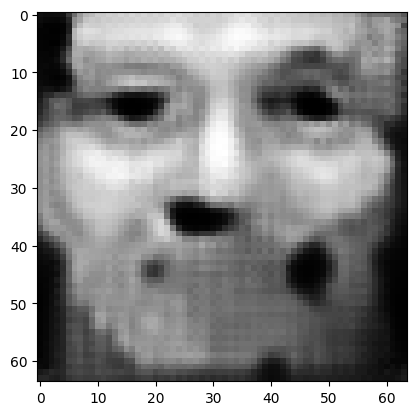

tensor([[0.0024, 0.0005, 0.0984, 0.0321, 0.1283, 0.0894, 0.0162, 0.0045, 0.0096,
         0.0257, 0.0045, 0.0034, 0.0777, 0.0047, 0.0013, 0.0719, 0.0171, 0.0018,
         0.0004, 0.0006, 0.0025, 0.0213, 0.0913, 0.0002, 0.0180, 0.0025, 0.0024,
         0.0032, 0.0020, 0.0040, 0.0018, 0.0249, 0.0412, 0.0032, 0.0035, 0.0056,
         0.0072, 0.1701, 0.0010, 0.0034]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.414233684539795
tensor([[0.0025, 0.0005, 0.0982, 0.0321, 0.1284, 0.0917, 0.0162, 0.0046, 0.0094,
         0.0257, 0.0045, 0.0034, 0.0774, 0.0047, 0.0013, 0.0722, 0.0169, 0.0018,
         0.0004, 0.0006, 0.0025, 0.0212, 0.0912, 0.0002, 0.0178, 0.0025, 0.0024,
         0.0032, 0.0020, 0.0040, 0.0017, 0.0250, 0.0411, 0.0031, 0.0034, 0.0056,
         0.0071, 0.1693, 0.0010, 0.0033]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.3892405033111572
tensor([[0.0025, 0.0005, 0.0980, 0.0320, 0.1284, 0.0940, 0.0162, 0.0046, 0.0092,
         0

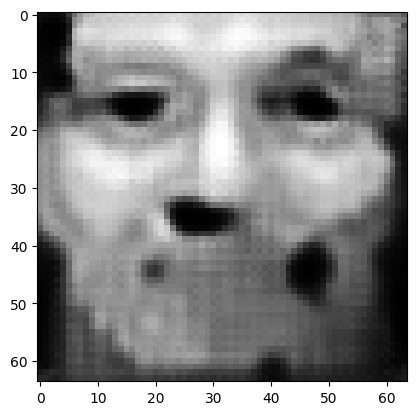

tensor([[0.0026, 0.0005, 0.0974, 0.0318, 0.1283, 0.1009, 0.0161, 0.0048, 0.0088,
         0.0257, 0.0044, 0.0033, 0.0762, 0.0045, 0.0012, 0.0734, 0.0164, 0.0018,
         0.0004, 0.0006, 0.0023, 0.0207, 0.0905, 0.0002, 0.0170, 0.0025, 0.0023,
         0.0031, 0.0019, 0.0038, 0.0016, 0.0253, 0.0404, 0.0031, 0.0033, 0.0055,
         0.0070, 0.1662, 0.0009, 0.0032]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.2938857078552246
tensor([[0.0026, 0.0005, 0.0972, 0.0318, 0.1283, 0.1032, 0.0161, 0.0049, 0.0086,
         0.0257, 0.0044, 0.0033, 0.0758, 0.0045, 0.0012, 0.0736, 0.0163, 0.0018,
         0.0004, 0.0006, 0.0022, 0.0206, 0.0903, 0.0002, 0.0168, 0.0025, 0.0023,
         0.0030, 0.0019, 0.0038, 0.0016, 0.0254, 0.0403, 0.0030, 0.0032, 0.0055,
         0.0070, 0.1655, 0.0009, 0.0031]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.271077871322632
tensor([[0.0027, 0.0005, 0.0970, 0.0317, 0.1283, 0.1055, 0.0161, 0.0049, 0.0085,
         0

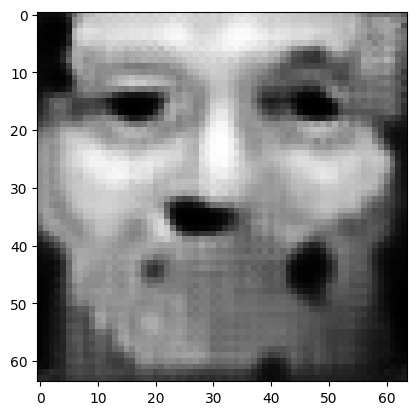

tensor([[0.0027, 0.0005, 0.0962, 0.0315, 0.1281, 0.1126, 0.0160, 0.0051, 0.0081,
         0.0257, 0.0043, 0.0031, 0.0746, 0.0044, 0.0011, 0.0747, 0.0158, 0.0017,
         0.0004, 0.0006, 0.0020, 0.0202, 0.0895, 0.0002, 0.0161, 0.0025, 0.0022,
         0.0029, 0.0018, 0.0036, 0.0015, 0.0257, 0.0396, 0.0029, 0.0031, 0.0055,
         0.0068, 0.1624, 0.0008, 0.0030]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.1840813159942627
tensor([[0.0028, 0.0005, 0.0960, 0.0314, 0.1281, 0.1149, 0.0160, 0.0051, 0.0080,
         0.0257, 0.0042, 0.0031, 0.0744, 0.0043, 0.0011, 0.0750, 0.0157, 0.0017,
         0.0004, 0.0006, 0.0020, 0.0201, 0.0893, 0.0002, 0.0159, 0.0025, 0.0022,
         0.0029, 0.0018, 0.0036, 0.0015, 0.0257, 0.0395, 0.0029, 0.0031, 0.0055,
         0.0068, 0.1616, 0.0008, 0.0030]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.1633448600769043
tensor([[0.0028, 0.0005, 0.0957, 0.0313, 0.1280, 0.1173, 0.0160, 0.0052, 0.0079,
         

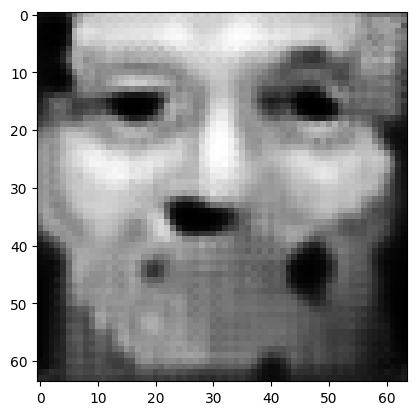

tensor([[0.0029, 0.0005, 0.0950, 0.0312, 0.1276, 0.1244, 0.0159, 0.0053, 0.0075,
         0.0257, 0.0041, 0.0030, 0.0734, 0.0042, 0.0011, 0.0760, 0.0153, 0.0017,
         0.0004, 0.0006, 0.0018, 0.0197, 0.0884, 0.0002, 0.0152, 0.0025, 0.0021,
         0.0028, 0.0018, 0.0034, 0.0014, 0.0259, 0.0389, 0.0028, 0.0029, 0.0055,
         0.0067, 0.1585, 0.0008, 0.0029]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.084583282470703
tensor([[0.0029, 0.0005, 0.0948, 0.0311, 0.1275, 0.1267, 0.0158, 0.0054, 0.0074,
         0.0257, 0.0041, 0.0030, 0.0732, 0.0042, 0.0011, 0.0763, 0.0152, 0.0017,
         0.0004, 0.0006, 0.0018, 0.0196, 0.0881, 0.0002, 0.0151, 0.0025, 0.0021,
         0.0028, 0.0017, 0.0034, 0.0014, 0.0259, 0.0387, 0.0028, 0.0029, 0.0055,
         0.0067, 0.1577, 0.0008, 0.0029]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.0655975341796875
tensor([[2.9511e-03, 4.8305e-04, 9.4499e-02, 3.1033e-02, 1.2739e-01, 1.2914e-01,
         1

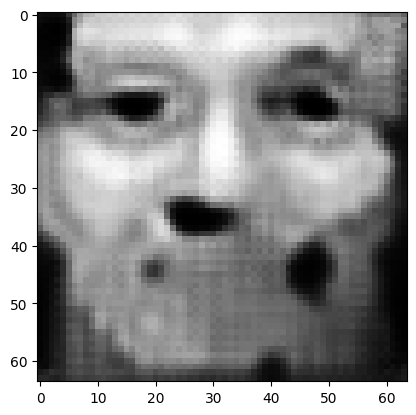

tensor([[3.0401e-03, 4.8205e-04, 9.3705e-02, 3.0808e-02, 1.2702e-01, 1.3633e-01,
         1.5680e-02, 5.5984e-03, 7.0153e-03, 2.5632e-02, 3.9914e-03, 2.9159e-03,
         7.2344e-02, 4.0573e-03, 1.0295e-03, 7.7099e-02, 1.4749e-02, 1.6088e-03,
         3.5416e-04, 5.4786e-04, 1.6915e-03, 1.9149e-02, 8.7272e-02, 1.5151e-04,
         1.4484e-02, 2.4922e-03, 2.0665e-03, 2.6714e-03, 1.6931e-03, 3.3044e-03,
         1.3228e-03, 2.5975e-02, 3.8150e-02, 2.7501e-03, 2.8065e-03, 5.5259e-03,
         6.5770e-03, 1.5443e-01, 7.2697e-04, 2.7558e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.9926797151565552
tensor([[3.0703e-03, 4.8181e-04, 9.3401e-02, 3.0735e-02, 1.2693e-01, 1.3873e-01,
         1.5631e-02, 5.6479e-03, 6.9141e-03, 2.5618e-02, 3.9663e-03, 2.8943e-03,
         7.2138e-02, 4.0299e-03, 1.0197e-03, 7.7271e-02, 1.4645e-02, 1.5990e-03,
         3.5195e-04, 5.4514e-04, 1.6637e-03, 1.9051e-02, 8.7099e-02, 1.4981e-04,
         1.4337e-02, 2.4893e-03, 2.0503e-03

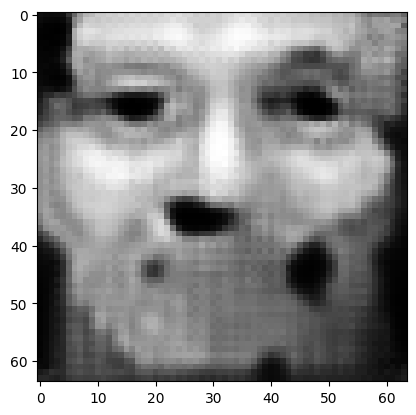

tensor([[3.1897e-03, 4.8120e-04, 9.2113e-02, 3.0461e-02, 1.2635e-01, 1.4833e-01,
         1.5463e-02, 5.8370e-03, 6.5420e-03, 2.5519e-02, 3.8685e-03, 2.8129e-03,
         7.1382e-02, 3.9244e-03, 9.8177e-04, 7.7887e-02, 1.4236e-02, 1.5621e-03,
         3.4366e-04, 5.3451e-04, 1.5593e-03, 1.8669e-02, 8.6200e-02, 1.4344e-04,
         1.3798e-02, 2.4803e-03, 1.9900e-03, 2.5586e-03, 1.6279e-03, 3.1695e-03,
         1.2467e-03, 2.6068e-02, 3.7438e-02, 2.6713e-03, 2.6826e-03, 5.5194e-03,
         6.4658e-03, 1.5057e-01, 6.8538e-04, 2.6383e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.9083251953125
tensor([[3.2171e-03, 4.8105e-04, 9.1783e-02, 3.0397e-02, 1.2623e-01, 1.5071e-01,
         1.5423e-02, 5.8809e-03, 6.4553e-03, 2.5480e-02, 3.8451e-03, 2.7928e-03,
         7.1145e-02, 3.8986e-03, 9.7276e-04, 7.8031e-02, 1.4137e-02, 1.5540e-03,
         3.4174e-04, 5.3209e-04, 1.5352e-03, 1.8578e-02, 8.5924e-02, 1.4192e-04,
         1.3664e-02, 2.4773e-03, 1.9751e-03, 2

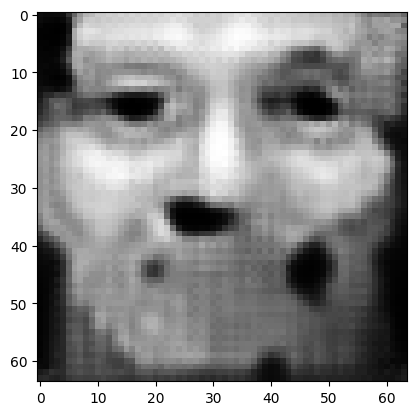

tensor([[3.3225e-03, 4.7926e-04, 9.0540e-02, 3.0186e-02, 1.2546e-01, 1.6015e-01,
         1.5315e-02, 6.0577e-03, 6.1430e-03, 2.5328e-02, 3.7550e-03, 2.7172e-03,
         7.0241e-02, 3.7969e-03, 9.3780e-04, 7.8412e-02, 1.3782e-02, 1.5246e-03,
         3.3464e-04, 5.2254e-04, 1.4438e-03, 1.8224e-02, 8.5041e-02, 1.3639e-04,
         1.3160e-02, 2.4664e-03, 1.9182e-03, 2.4542e-03, 1.5696e-03, 3.0438e-03,
         1.1779e-03, 2.6141e-02, 3.6818e-02, 2.5936e-03, 2.5719e-03, 5.5041e-03,
         6.3557e-03, 1.4720e-01, 6.4904e-04, 2.5275e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.8316327333450317
tensor([[3.3490e-03, 4.7892e-04, 9.0191e-02, 3.0123e-02, 1.2527e-01, 1.6248e-01,
         1.5289e-02, 6.0998e-03, 6.0690e-03, 2.5282e-02, 3.7338e-03, 2.6988e-03,
         7.0043e-02, 3.7721e-03, 9.2953e-04, 7.8516e-02, 1.3694e-02, 1.5185e-03,
         3.3297e-04, 5.2041e-04, 1.4225e-03, 1.8136e-02, 8.4764e-02, 1.3513e-04,
         1.3038e-02, 2.4622e-03, 1.9044e-03

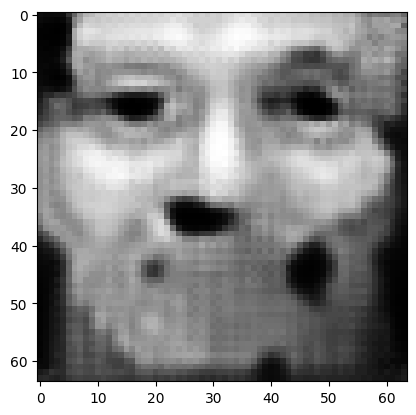

tensor([[3.4499e-03, 4.7694e-04, 8.8735e-02, 2.9919e-02, 1.2463e-01, 1.7164e-01,
         1.5206e-02, 6.2590e-03, 5.8000e-03, 2.5076e-02, 3.6446e-03, 2.6334e-03,
         6.9270e-02, 3.6754e-03, 8.9796e-04, 7.8792e-02, 1.3358e-02, 1.4960e-03,
         3.2664e-04, 5.1160e-04, 1.3436e-03, 1.7791e-02, 8.3704e-02, 1.3051e-04,
         1.2587e-02, 2.4499e-03, 1.8510e-03, 2.3563e-03, 1.5165e-03, 2.9323e-03,
         1.1182e-03, 2.6190e-02, 3.6307e-02, 2.5185e-03, 2.4739e-03, 5.4940e-03,
         6.2411e-03, 1.4415e-01, 6.1763e-04, 2.4320e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.7623652219772339
tensor([[3.4745e-03, 4.7663e-04, 8.8392e-02, 2.9897e-02, 1.2445e-01, 1.7389e-01,
         1.5179e-02, 6.2966e-03, 5.7350e-03, 2.5016e-02, 3.6232e-03, 2.6178e-03,
         6.9064e-02, 3.6535e-03, 8.9095e-04, 7.8807e-02, 1.3273e-02, 1.4904e-03,
         3.2517e-04, 5.0961e-04, 1.3257e-03, 1.7713e-02, 8.3486e-02, 1.2940e-04,
         1.2470e-02, 2.4482e-03, 1.8383e-03

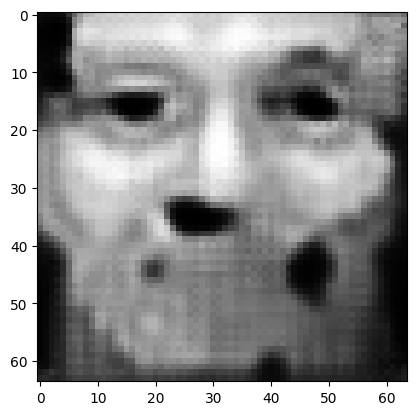

tensor([[3.5709e-03, 4.7525e-04, 8.7047e-02, 2.9739e-02, 1.2362e-01, 1.8280e-01,
         1.5087e-02, 6.4454e-03, 5.4924e-03, 2.4777e-02, 3.5434e-03, 2.5573e-03,
         6.8261e-02, 3.5704e-03, 8.6284e-04, 7.8945e-02, 1.2964e-02, 1.4684e-03,
         3.1939e-04, 5.0147e-04, 1.2571e-03, 1.7399e-02, 8.2456e-02, 1.2517e-04,
         1.2045e-02, 2.4387e-03, 1.7905e-03, 2.2684e-03, 1.4676e-03, 2.8257e-03,
         1.0643e-03, 2.6237e-02, 3.5794e-02, 2.4529e-03, 2.3816e-03, 5.4761e-03,
         6.1460e-03, 1.4141e-01, 5.9002e-04, 2.3393e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.6993873119354248
tensor([[3.5957e-03, 4.7503e-04, 8.6724e-02, 2.9700e-02, 1.2339e-01, 1.8501e-01,
         1.5060e-02, 6.4826e-03, 5.4339e-03, 2.4719e-02, 3.5243e-03, 2.5430e-03,
         6.8055e-02, 3.5506e-03, 8.5614e-04, 7.8975e-02, 1.2887e-02, 1.4631e-03,
         3.1806e-04, 4.9964e-04, 1.2411e-03, 1.7324e-02, 8.2194e-02, 1.2417e-04,
         1.1940e-02, 2.4358e-03, 1.7791e-03

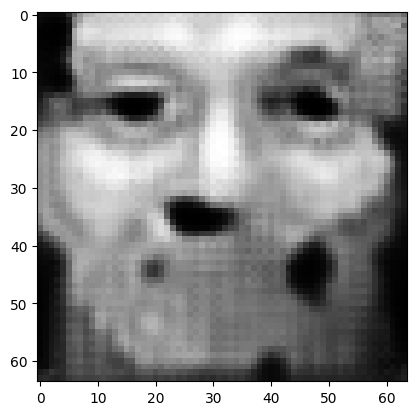

tensor([[3.6922e-03, 4.7267e-04, 8.5611e-02, 2.9488e-02, 1.2218e-01, 1.9379e-01,
         1.5035e-02, 6.6290e-03, 5.2372e-03, 2.4538e-02, 3.4470e-03, 2.4877e-03,
         6.7294e-02, 3.4666e-03, 8.2844e-04, 7.9149e-02, 1.2592e-02, 1.4471e-03,
         3.1336e-04, 4.9206e-04, 1.1763e-03, 1.7017e-02, 8.1012e-02, 1.2058e-04,
         1.1562e-02, 2.4155e-03, 1.7374e-03, 2.1862e-03, 1.4261e-03, 2.7323e-03,
         1.0152e-03, 2.6197e-02, 3.5316e-02, 2.3851e-03, 2.2944e-03, 5.4583e-03,
         6.0401e-03, 1.3889e-01, 5.6480e-04, 2.2536e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.6409578323364258
tensor([[3.7154e-03, 4.7206e-04, 8.5343e-02, 2.9432e-02, 1.2185e-01, 1.9595e-01,
         1.5033e-02, 6.6651e-03, 5.1922e-03, 2.4495e-02, 3.4289e-03, 2.4742e-03,
         6.7098e-02, 3.4460e-03, 8.2185e-04, 7.9179e-02, 1.2524e-02, 1.4432e-03,
         3.1226e-04, 4.9020e-04, 1.1609e-03, 1.6944e-02, 8.0720e-02, 1.1973e-04,
         1.1476e-02, 2.4103e-03, 1.7277e-03

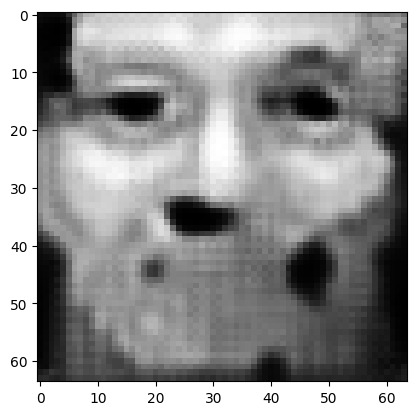

tensor([[3.8095e-03, 4.6957e-04, 8.4231e-02, 2.9216e-02, 1.2060e-01, 2.0446e-01,
         1.5022e-02, 6.8034e-03, 5.0141e-03, 2.4290e-02, 3.3566e-03, 2.4222e-03,
         6.6386e-02, 3.3706e-03, 7.9627e-04, 7.9117e-02, 1.2256e-02, 1.4289e-03,
         3.0768e-04, 4.8277e-04, 1.1032e-03, 1.6656e-02, 7.9633e-02, 1.1645e-04,
         1.1140e-02, 2.3930e-03, 1.6886e-03, 2.1121e-03, 1.3887e-03, 2.6450e-03,
         9.7125e-04, 2.6130e-02, 3.4876e-02, 2.3207e-03, 2.2165e-03, 5.4391e-03,
         5.9431e-03, 1.3667e-01, 5.4263e-04, 2.1723e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5873762369155884
tensor([[3.8317e-03, 4.6887e-04, 8.3956e-02, 2.9173e-02, 1.2028e-01, 2.0657e-01,
         1.5022e-02, 6.8369e-03, 4.9727e-03, 2.4234e-02, 3.3386e-03, 2.4098e-03,
         6.6198e-02, 3.3522e-03, 7.9017e-04, 7.9081e-02, 1.2192e-02, 1.4257e-03,
         3.0656e-04, 4.8099e-04, 1.0898e-03, 1.6586e-02, 7.9375e-02, 1.1568e-04,
         1.1057e-02, 2.3889e-03, 1.6789e-03

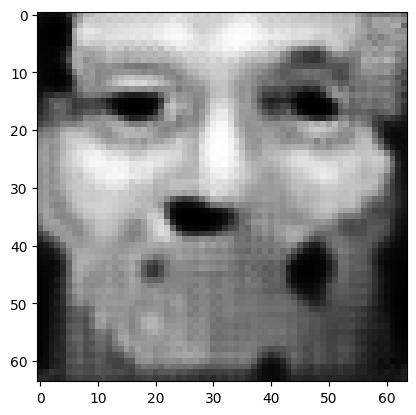

tensor([[3.9224e-03, 4.6647e-04, 8.2719e-02, 2.9011e-02, 1.1910e-01, 2.1475e-01,
         1.5024e-02, 6.9579e-03, 4.8169e-03, 2.3993e-02, 3.2669e-03, 2.3636e-03,
         6.5647e-02, 3.2799e-03, 7.6789e-04, 7.8904e-02, 1.1929e-02, 1.4165e-03,
         3.0233e-04, 4.7467e-04, 1.0403e-03, 1.6310e-02, 7.8310e-02, 1.1293e-04,
         1.0739e-02, 2.3718e-03, 1.6417e-03, 2.0426e-03, 1.3543e-03, 2.5645e-03,
         9.3222e-04, 2.6044e-02, 3.4509e-02, 2.2606e-03, 2.1460e-03, 5.4226e-03,
         5.8501e-03, 1.3461e-01, 5.2329e-04, 2.0986e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5382916927337646
tensor([[3.9429e-03, 4.6582e-04, 8.2409e-02, 2.8980e-02, 1.1881e-01, 2.1674e-01,
         1.5024e-02, 6.9847e-03, 4.7819e-03, 2.3930e-02, 3.2491e-03, 2.3527e-03,
         6.5523e-02, 3.2618e-03, 7.6277e-04, 7.8855e-02, 1.1865e-02, 1.4147e-03,
         3.0133e-04, 4.7330e-04, 1.0289e-03, 1.6245e-02, 7.8046e-02, 1.1230e-04,
         1.0661e-02, 2.3673e-03, 1.6328e-03

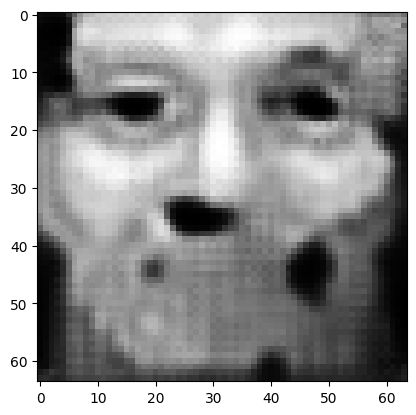

tensor([[4.0264e-03, 4.6322e-04, 8.1138e-02, 2.8833e-02, 1.1771e-01, 2.2464e-01,
         1.5031e-02, 7.0871e-03, 4.6451e-03, 2.3667e-02, 3.1796e-03, 2.3103e-03,
         6.5062e-02, 3.1924e-03, 7.4260e-04, 7.8610e-02, 1.1618e-02, 1.4079e-03,
         2.9731e-04, 4.6764e-04, 9.8523e-04, 1.5982e-02, 7.6992e-02, 1.0986e-04,
         1.0365e-02, 2.3500e-03, 1.5978e-03, 1.9775e-03, 1.3225e-03, 2.4923e-03,
         8.9798e-04, 2.5943e-02, 3.4198e-02, 2.2042e-03, 2.0805e-03, 5.4100e-03,
         5.7574e-03, 1.3266e-01, 5.0608e-04, 2.0323e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.4932537078857422
tensor([[4.0465e-03, 4.6254e-04, 8.0829e-02, 2.8806e-02, 1.1744e-01, 2.2658e-01,
         1.5032e-02, 7.1115e-03, 4.6128e-03, 2.3604e-02, 3.1628e-03, 2.3002e-03,
         6.4945e-02, 3.1755e-03, 7.3785e-04, 7.8525e-02, 1.1559e-02, 1.4061e-03,
         2.9635e-04, 4.6629e-04, 9.7494e-04, 1.5919e-02, 7.6766e-02, 1.0927e-04,
         1.0292e-02, 2.3463e-03, 1.5893e-03

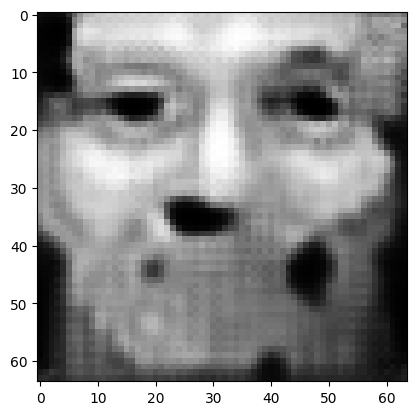

tensor([[4.1228e-03, 4.5996e-04, 7.9601e-02, 2.8664e-02, 1.1641e-01, 2.3419e-01,
         1.5042e-02, 7.2035e-03, 4.4921e-03, 2.3359e-02, 3.0996e-03, 2.2607e-03,
         6.4461e-02, 3.1089e-03, 7.1969e-04, 7.8239e-02, 1.1331e-02, 1.3997e-03,
         2.9284e-04, 4.6138e-04, 9.3592e-04, 1.5679e-02, 7.5772e-02, 1.0706e-04,
         1.0018e-02, 2.3299e-03, 1.5565e-03, 1.9187e-03, 1.2930e-03, 2.4260e-03,
         8.6702e-04, 2.5825e-02, 3.3893e-02, 2.1512e-03, 2.0209e-03, 5.3979e-03,
         5.6700e-03, 1.3076e-01, 4.9049e-04, 1.9728e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.4516280889511108
tensor([[4.1405e-03, 4.5929e-04, 7.9304e-02, 2.8639e-02, 1.1616e-01, 2.3604e-01,
         1.5047e-02, 7.2244e-03, 4.4643e-03, 2.3303e-02, 3.0847e-03, 2.2512e-03,
         6.4344e-02, 3.0923e-03, 7.1548e-04, 7.8153e-02, 1.1277e-02, 1.3981e-03,
         2.9209e-04, 4.6032e-04, 9.2672e-04, 1.5622e-02, 7.5557e-02, 1.0655e-04,
         9.9518e-03, 2.3260e-03, 1.5487e-03

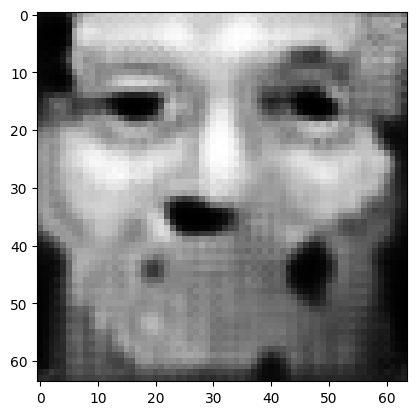

tensor([[4.2082e-03, 4.5654e-04, 7.8141e-02, 2.8526e-02, 1.1522e-01, 2.4327e-01,
         1.5062e-02, 7.3061e-03, 4.3590e-03, 2.3086e-02, 3.0266e-03, 2.2148e-03,
         6.3839e-02, 3.0267e-03, 6.9918e-04, 7.7839e-02, 1.1065e-02, 1.3923e-03,
         2.8917e-04, 4.5628e-04, 8.9179e-04, 1.5403e-02, 7.4660e-02, 1.0458e-04,
         9.6955e-03, 2.3096e-03, 1.5180e-03, 1.8649e-03, 1.2659e-03, 2.3663e-03,
         8.3866e-04, 2.5684e-02, 3.3608e-02, 2.1010e-03, 1.9667e-03, 5.3903e-03,
         5.5846e-03, 1.2887e-01, 4.7632e-04, 1.9203e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.4135756492614746
tensor([[4.2251e-03, 4.5584e-04, 7.7847e-02, 2.8486e-02, 1.1501e-01, 2.4505e-01,
         1.5064e-02, 7.3252e-03, 4.3328e-03, 2.3031e-02, 3.0125e-03, 2.2059e-03,
         6.3722e-02, 3.0112e-03, 6.9518e-04, 7.7756e-02, 1.1014e-02, 1.3911e-03,
         2.8839e-04, 4.5522e-04, 8.8342e-04, 1.5347e-02, 7.4434e-02, 1.0410e-04,
         9.6349e-03, 2.3053e-03, 1.5104e-03

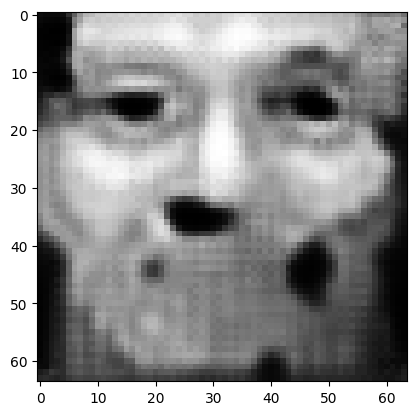

tensor([[4.2877e-03, 4.5285e-04, 7.6755e-02, 2.8356e-02, 1.1412e-01, 2.5202e-01,
         1.5077e-02, 7.3998e-03, 4.2366e-03, 2.2828e-02, 2.9577e-03, 2.1716e-03,
         6.3228e-02, 2.9491e-03, 6.7990e-04, 7.7415e-02, 1.0816e-02, 1.3854e-03,
         2.8558e-04, 4.5128e-04, 8.5153e-04, 1.5138e-02, 7.3587e-02, 1.0226e-04,
         9.3988e-03, 2.2889e-03, 1.4816e-03, 1.8143e-03, 1.2399e-03, 2.3118e-03,
         8.1262e-04, 2.5532e-02, 3.3331e-02, 2.0530e-03, 1.9171e-03, 5.3832e-03,
         5.4998e-03, 1.2705e-01, 4.6313e-04, 1.8722e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3782423734664917
tensor([[4.3027e-03, 4.5206e-04, 7.6500e-02, 2.8325e-02, 1.1390e-01, 2.5370e-01,
         1.5079e-02, 7.4173e-03, 4.2147e-03, 2.2789e-02, 2.9452e-03, 2.1634e-03,
         6.3105e-02, 2.9335e-03, 6.7652e-04, 7.7322e-02, 1.0768e-02, 1.3841e-03,
         2.8496e-04, 4.5050e-04, 8.4408e-04, 1.5088e-02, 7.3421e-02, 1.0184e-04,
         9.3418e-03, 2.2846e-03, 1.4747e-03

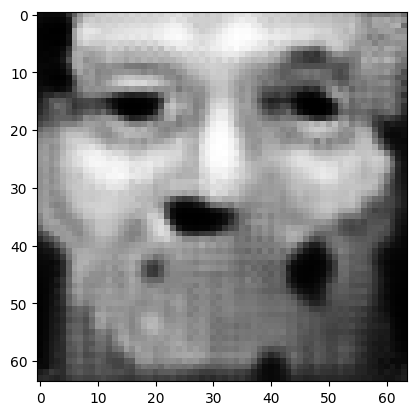

tensor([[4.3558e-03, 4.4887e-04, 7.5430e-02, 2.8163e-02, 1.1322e-01, 2.6025e-01,
         1.5087e-02, 7.4771e-03, 4.1312e-03, 2.2625e-02, 2.8966e-03, 2.1310e-03,
         6.2595e-02, 2.8726e-03, 6.6303e-04, 7.7020e-02, 1.0583e-02, 1.3787e-03,
         2.8234e-04, 4.4750e-04, 8.1550e-04, 1.4894e-02, 7.2674e-02, 1.0018e-04,
         9.1265e-03, 2.2655e-03, 1.4470e-03, 1.7681e-03, 1.2164e-03, 2.2660e-03,
         7.8896e-04, 2.5340e-02, 3.3077e-02, 2.0089e-03, 1.8746e-03, 5.3839e-03,
         5.4154e-03, 1.2519e-01, 4.5118e-04, 1.8328e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3460986614227295
tensor([[4.3671e-03, 4.4801e-04, 7.5157e-02, 2.8132e-02, 1.1308e-01, 2.6183e-01,
         1.5088e-02, 7.4899e-03, 4.1134e-03, 2.2592e-02, 2.8846e-03, 2.1234e-03,
         6.2459e-02, 2.8564e-03, 6.6012e-04, 7.6954e-02, 1.0537e-02, 1.3779e-03,
         2.8177e-04, 4.4696e-04, 8.0887e-04, 1.4848e-02, 7.2510e-02, 9.9820e-05,
         9.0733e-03, 2.2601e-03, 1.4401e-03

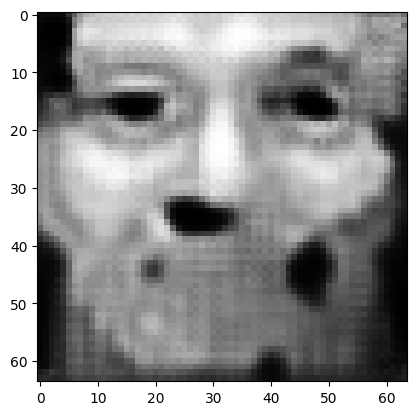

tensor([[4.4145e-03, 4.4462e-04, 7.4066e-02, 2.7996e-02, 1.1258e-01, 2.6803e-01,
         1.5088e-02, 7.5395e-03, 4.0409e-03, 2.2460e-02, 2.8377e-03, 2.0939e-03,
         6.1958e-02, 2.7948e-03, 6.4872e-04, 7.6660e-02, 1.0358e-02, 1.3741e-03,
         2.7944e-04, 4.4465e-04, 7.8354e-04, 1.4664e-02, 7.1883e-02, 9.8413e-05,
         8.8721e-03, 2.2396e-03, 1.4133e-03, 1.7236e-03, 1.1940e-03, 2.2269e-03,
         7.6716e-04, 2.5130e-02, 3.2851e-02, 1.9670e-03, 1.8374e-03, 5.3917e-03,
         5.3265e-03, 1.2328e-01, 4.4021e-04, 1.7976e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3166569471359253
tensor([[4.4259e-03, 4.4378e-04, 7.3800e-02, 2.7966e-02, 1.1245e-01, 2.6955e-01,
         1.5088e-02, 7.5516e-03, 4.0237e-03, 2.2428e-02, 2.8263e-03, 2.0868e-03,
         6.1839e-02, 2.7799e-03, 6.4597e-04, 7.6590e-02, 1.0315e-02, 1.3732e-03,
         2.7886e-04, 4.4413e-04, 7.7755e-04, 1.4619e-02, 7.1732e-02, 9.8077e-05,
         8.8230e-03, 2.2344e-03, 1.4068e-03

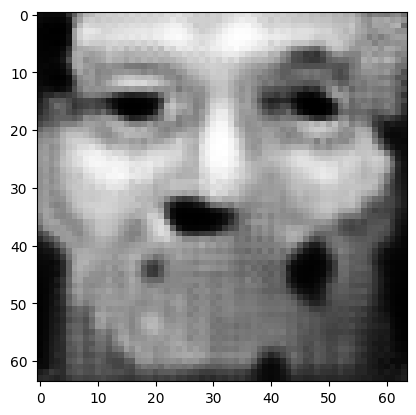

tensor([[4.4713e-03, 4.4073e-04, 7.2749e-02, 2.7823e-02, 1.1194e-01, 2.7552e-01,
         1.5074e-02, 7.6010e-03, 3.9547e-03, 2.2301e-02, 2.7832e-03, 2.0586e-03,
         6.1358e-02, 2.7229e-03, 6.3575e-04, 7.6284e-02, 1.0143e-02, 1.3695e-03,
         2.7665e-04, 4.4200e-04, 7.5461e-04, 1.4444e-02, 7.1132e-02, 9.6758e-05,
         8.6395e-03, 2.2145e-03, 1.3820e-03, 1.6817e-03, 1.1731e-03, 2.1913e-03,
         7.4705e-04, 2.4921e-02, 3.2631e-02, 1.9282e-03, 1.8031e-03, 5.4000e-03,
         5.2425e-03, 1.2148e-01, 4.3009e-04, 1.7652e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2890897989273071
tensor([[4.4824e-03, 4.4002e-04, 7.2492e-02, 2.7792e-02, 1.1181e-01, 2.7700e-01,
         1.5070e-02, 7.6136e-03, 3.9376e-03, 2.2270e-02, 2.7728e-03, 2.0518e-03,
         6.1232e-02, 2.7090e-03, 6.3332e-04, 7.6209e-02, 1.0100e-02, 1.3685e-03,
         2.7617e-04, 4.4149e-04, 7.4912e-04, 1.4401e-02, 7.0981e-02, 9.6445e-05,
         8.5948e-03, 2.2099e-03, 1.3761e-03

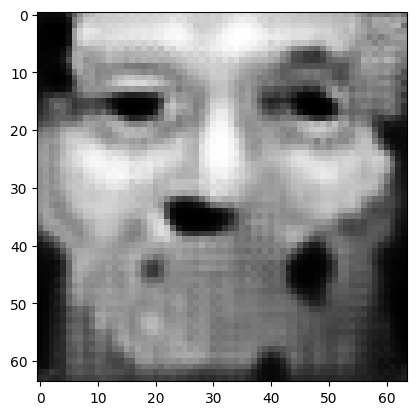

tensor([[4.5255e-03, 4.3715e-04, 7.1499e-02, 2.7650e-02, 1.1127e-01, 2.8277e-01,
         1.5050e-02, 7.6596e-03, 3.8720e-03, 2.2141e-02, 2.7326e-03, 2.0250e-03,
         6.0770e-02, 2.6566e-03, 6.2364e-04, 7.5893e-02, 9.9388e-03, 1.3646e-03,
         2.7400e-04, 4.3937e-04, 7.2812e-04, 1.4232e-02, 7.0394e-02, 9.5177e-05,
         8.4247e-03, 2.1912e-03, 1.3528e-03, 1.6425e-03, 1.1532e-03, 2.1574e-03,
         7.2830e-04, 2.4721e-02, 3.2406e-02, 1.8922e-03, 1.7707e-03, 5.4056e-03,
         5.1638e-03, 1.1980e-01, 4.2067e-04, 1.7351e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.263137698173523
tensor([[4.5357e-03, 4.3644e-04, 7.1261e-02, 2.7612e-02, 1.1114e-01, 2.8417e-01,
         1.5044e-02, 7.6705e-03, 3.8568e-03, 2.2110e-02, 2.7228e-03, 2.0185e-03,
         6.0656e-02, 2.6442e-03, 6.2129e-04, 7.5818e-02, 9.9000e-03, 1.3636e-03,
         2.7343e-04, 4.3888e-04, 7.2318e-04, 1.4191e-02, 7.0243e-02, 9.4867e-05,
         8.3840e-03, 2.1866e-03, 1.3471e-03,

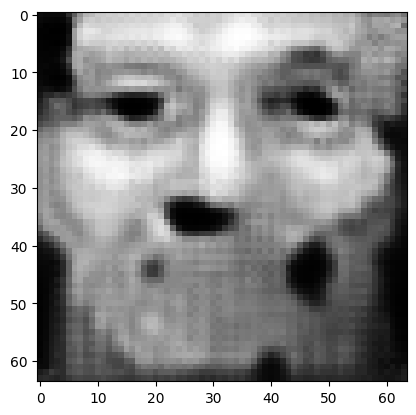

tensor([[4.5747e-03, 4.3383e-04, 7.0320e-02, 2.7470e-02, 1.1060e-01, 2.8965e-01,
         1.5021e-02, 7.7141e-03, 3.7963e-03, 2.1983e-02, 2.6857e-03, 1.9927e-03,
         6.0224e-02, 2.5958e-03, 6.1218e-04, 7.5550e-02, 9.7503e-03, 1.3592e-03,
         2.7135e-04, 4.3702e-04, 7.0401e-04, 1.4034e-02, 6.9616e-02, 9.3694e-05,
         8.2257e-03, 2.1671e-03, 1.3256e-03, 1.6062e-03, 1.1352e-03, 2.1272e-03,
         7.1116e-04, 2.4509e-02, 3.2202e-02, 1.8592e-03, 1.7403e-03, 5.4102e-03,
         5.0899e-03, 1.1828e-01, 4.1212e-04, 1.7083e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2390685081481934
tensor([[4.5840e-03, 4.3320e-04, 7.0090e-02, 2.7438e-02, 1.1046e-01, 2.9100e-01,
         1.5015e-02, 7.7255e-03, 3.7817e-03, 2.1953e-02, 2.6770e-03, 1.9863e-03,
         6.0115e-02, 2.5839e-03, 6.1007e-04, 7.5488e-02, 9.7136e-03, 1.3581e-03,
         2.7087e-04, 4.3659e-04, 6.9940e-04, 1.3997e-02, 6.9464e-02, 9.3420e-05,
         8.1874e-03, 2.1623e-03, 1.3205e-03

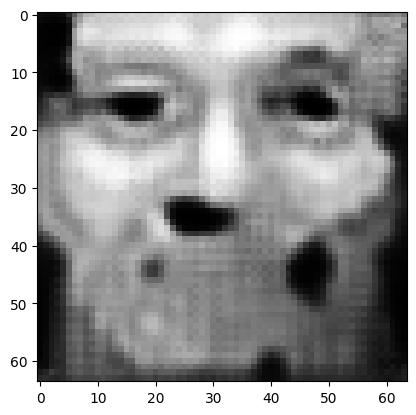

tensor([[4.6218e-03, 4.3063e-04, 6.9233e-02, 2.7291e-02, 1.0989e-01, 2.9621e-01,
         1.4988e-02, 7.7702e-03, 3.7241e-03, 2.1835e-02, 2.6423e-03, 1.9620e-03,
         5.9719e-02, 2.5395e-03, 6.0138e-04, 7.5233e-02, 9.5781e-03, 1.3532e-03,
         2.6881e-04, 4.3470e-04, 6.8202e-04, 1.3848e-02, 6.8860e-02, 9.2329e-05,
         8.0421e-03, 2.1440e-03, 1.3006e-03, 1.5722e-03, 1.1186e-03, 2.0986e-03,
         6.9499e-04, 2.4302e-02, 3.2007e-02, 1.8285e-03, 1.7122e-03, 5.4127e-03,
         5.0219e-03, 1.1685e-01, 4.0427e-04, 1.6830e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2166811227798462
tensor([[4.6301e-03, 4.3000e-04, 6.9033e-02, 2.7261e-02, 1.0975e-01, 2.9748e-01,
         1.4981e-02, 7.7801e-03, 3.7106e-03, 2.1805e-02, 2.6338e-03, 1.9560e-03,
         5.9614e-02, 2.5287e-03, 5.9928e-04, 7.5166e-02, 9.5457e-03, 1.3519e-03,
         2.6831e-04, 4.3430e-04, 6.7792e-04, 1.3814e-02, 6.8713e-02, 9.2055e-05,
         8.0056e-03, 2.1395e-03, 1.2957e-03

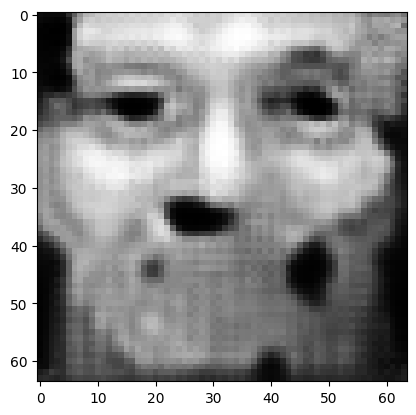

tensor([[4.6640e-03, 4.2759e-04, 6.8248e-02, 2.7133e-02, 1.0918e-01, 3.0244e-01,
         1.4954e-02, 7.8217e-03, 3.6574e-03, 2.1689e-02, 2.6016e-03, 1.9330e-03,
         5.9214e-02, 2.4874e-03, 5.9119e-04, 7.4913e-02, 9.4196e-03, 1.3468e-03,
         2.6643e-04, 4.3261e-04, 6.6207e-04, 1.3677e-02, 6.8130e-02, 9.1026e-05,
         7.8672e-03, 2.1223e-03, 1.2773e-03, 1.5407e-03, 1.1033e-03, 2.0715e-03,
         6.7991e-04, 2.4097e-02, 3.1821e-02, 1.8001e-03, 1.6858e-03, 5.4118e-03,
         4.9594e-03, 1.1552e-01, 3.9698e-04, 1.6589e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1958682537078857
tensor([[4.6723e-03, 4.2701e-04, 6.8065e-02, 2.7106e-02, 1.0904e-01, 3.0364e-01,
         1.4946e-02, 7.8318e-03, 3.6440e-03, 2.1662e-02, 2.5938e-03, 1.9274e-03,
         5.9125e-02, 2.4774e-03, 5.8931e-04, 7.4851e-02, 9.3884e-03, 1.3456e-03,
         2.6598e-04, 4.3220e-04, 6.5832e-04, 1.3644e-02, 6.7998e-02, 9.0780e-05,
         7.8330e-03, 2.1181e-03, 1.2731e-03

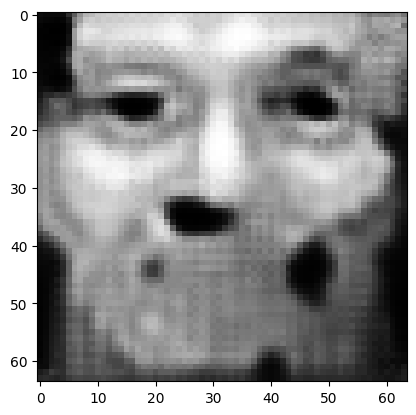

tensor([[4.7043e-03, 4.2463e-04, 6.7366e-02, 2.6978e-02, 1.0847e-01, 3.0836e-01,
         1.4918e-02, 7.8695e-03, 3.5940e-03, 2.1550e-02, 2.5633e-03, 1.9064e-03,
         5.8757e-02, 2.4395e-03, 5.8151e-04, 7.4613e-02, 9.2722e-03, 1.3407e-03,
         2.6417e-04, 4.3056e-04, 6.4386e-04, 1.3513e-02, 6.7436e-02, 8.9795e-05,
         7.7032e-03, 2.1018e-03, 1.2564e-03, 1.5114e-03, 1.0889e-03, 2.0452e-03,
         6.6573e-04, 2.3903e-02, 3.1633e-02, 1.7732e-03, 1.6605e-03, 5.4082e-03,
         4.9008e-03, 1.1424e-01, 3.9012e-04, 1.6358e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1764967441558838
tensor([[4.7115e-03, 4.2406e-04, 6.7192e-02, 2.6948e-02, 1.0834e-01, 3.0951e-01,
         1.4910e-02, 7.8775e-03, 3.5822e-03, 2.1521e-02, 2.5558e-03, 1.9010e-03,
         5.8661e-02, 2.4304e-03, 5.7960e-04, 7.4550e-02, 9.2438e-03, 1.3394e-03,
         2.6369e-04, 4.3016e-04, 6.4040e-04, 1.3482e-02, 6.7295e-02, 8.9540e-05,
         7.6715e-03, 2.0979e-03, 1.2522e-03

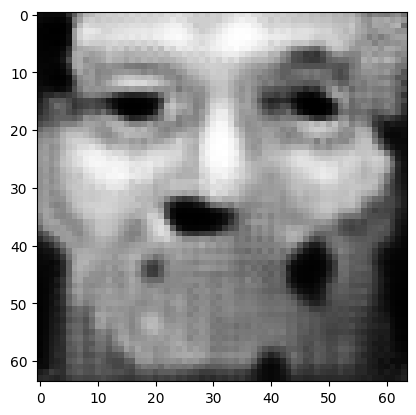

tensor([[4.7434e-03, 4.2192e-04, 6.6549e-02, 2.6828e-02, 1.0778e-01, 3.1404e-01,
         1.4880e-02, 7.9145e-03, 3.5345e-03, 2.1410e-02, 2.5270e-03, 1.8810e-03,
         5.8301e-02, 2.3951e-03, 5.7215e-04, 7.4312e-02, 9.1343e-03, 1.3346e-03,
         2.6198e-04, 4.2869e-04, 6.2709e-04, 1.3359e-02, 6.6735e-02, 8.8605e-05,
         7.5467e-03, 2.0820e-03, 1.2365e-03, 1.4837e-03, 1.0754e-03, 2.0206e-03,
         6.5248e-04, 2.3707e-02, 3.1451e-02, 1.7481e-03, 1.6365e-03, 5.4026e-03,
         4.8461e-03, 1.1306e-01, 3.8372e-04, 1.6149e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1582494974136353
tensor([[4.7523e-03, 4.2142e-04, 6.6392e-02, 2.6792e-02, 1.0763e-01, 3.1517e-01,
         1.4871e-02, 7.9254e-03, 3.5225e-03, 2.1382e-02, 2.5200e-03, 1.8761e-03,
         5.8211e-02, 2.3867e-03, 5.7020e-04, 7.4251e-02, 9.1083e-03, 1.3332e-03,
         2.6156e-04, 4.2827e-04, 6.2380e-04, 1.3328e-02, 6.6583e-02, 8.8373e-05,
         7.5166e-03, 2.0781e-03, 1.2327e-03

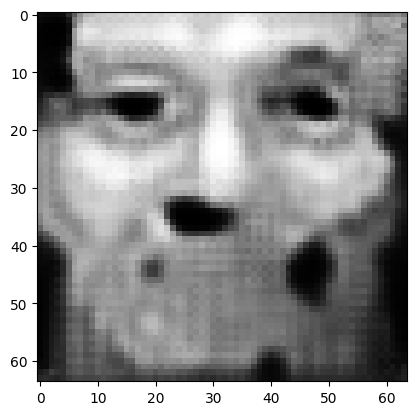

tensor([[4.7872e-03, 4.1945e-04, 6.5791e-02, 2.6657e-02, 1.0706e-01, 3.1963e-01,
         1.4830e-02, 7.9646e-03, 3.4752e-03, 2.1268e-02, 2.4917e-03, 1.8576e-03,
         5.7842e-02, 2.3538e-03, 5.6274e-04, 7.4008e-02, 9.0059e-03, 1.3284e-03,
         2.5987e-04, 4.2672e-04, 6.1142e-04, 1.3208e-02, 6.6005e-02, 8.7456e-05,
         7.3954e-03, 2.0627e-03, 1.2176e-03, 1.4566e-03, 1.0626e-03, 1.9968e-03,
         6.3967e-04, 2.3506e-02, 3.1265e-02, 1.7237e-03, 1.6137e-03, 5.3945e-03,
         4.7952e-03, 1.1197e-01, 3.7766e-04, 1.5964e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1406019926071167
tensor([[4.7954e-03, 4.1897e-04, 6.5647e-02, 2.6625e-02, 1.0692e-01, 3.2071e-01,
         1.4820e-02, 7.9737e-03, 3.4639e-03, 2.1240e-02, 2.4850e-03, 1.8531e-03,
         5.7751e-02, 2.3459e-03, 5.6093e-04, 7.3945e-02, 8.9808e-03, 1.3271e-03,
         2.5946e-04, 4.2636e-04, 6.0843e-04, 1.3179e-02, 6.5869e-02, 8.7226e-05,
         7.3659e-03, 2.0591e-03, 1.2139e-03

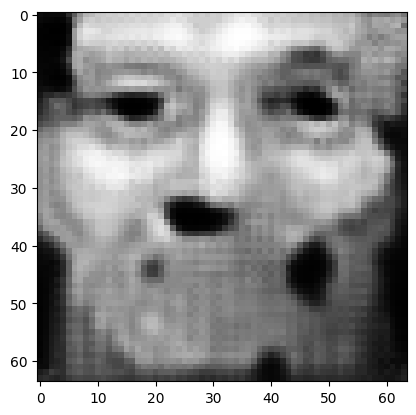

tensor([[4.8263e-03, 4.1719e-04, 6.5093e-02, 2.6485e-02, 1.0635e-01, 3.2492e-01,
         1.4780e-02, 8.0088e-03, 3.4201e-03, 2.1123e-02, 2.4594e-03, 1.8357e-03,
         5.7407e-02, 2.3168e-03, 5.5384e-04, 7.3707e-02, 8.8871e-03, 1.3221e-03,
         2.5785e-04, 4.2475e-04, 5.9694e-04, 1.3066e-02, 6.5301e-02, 8.6337e-05,
         7.2572e-03, 2.0448e-03, 1.2002e-03, 1.4316e-03, 1.0505e-03, 1.9746e-03,
         6.2801e-04, 2.3319e-02, 3.1083e-02, 1.7013e-03, 1.5919e-03, 5.3851e-03,
         4.7480e-03, 1.1099e-01, 3.7200e-04, 1.5792e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1241899728775024
tensor([[4.8339e-03, 4.1677e-04, 6.4959e-02, 2.6451e-02, 1.0622e-01, 3.2594e-01,
         1.4770e-02, 8.0166e-03, 3.4093e-03, 2.1093e-02, 2.4532e-03, 1.8315e-03,
         5.7323e-02, 2.3100e-03, 5.5210e-04, 7.3647e-02, 8.8644e-03, 1.3209e-03,
         2.5743e-04, 4.2436e-04, 5.9422e-04, 1.3039e-02, 6.5162e-02, 8.6114e-05,
         7.2304e-03, 2.0415e-03, 1.1969e-03

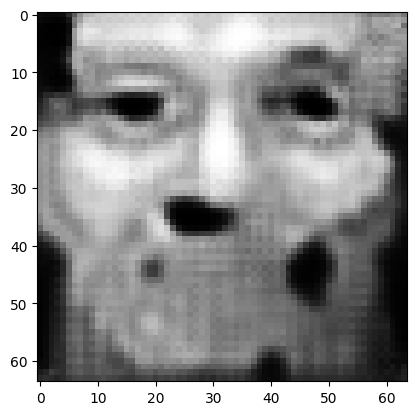

tensor([[4.8635e-03, 4.1512e-04, 6.4444e-02, 2.6329e-02, 1.0565e-01, 3.2994e-01,
         1.4729e-02, 8.0493e-03, 3.3677e-03, 2.0980e-02, 2.4293e-03, 1.8152e-03,
         5.6994e-02, 2.2831e-03, 5.4555e-04, 7.3403e-02, 8.7779e-03, 1.3161e-03,
         2.5592e-04, 4.2285e-04, 5.8373e-04, 1.2933e-02, 6.4645e-02, 8.5278e-05,
         7.1270e-03, 2.0286e-03, 1.1842e-03, 1.4085e-03, 1.0391e-03, 1.9530e-03,
         6.1713e-04, 2.3147e-02, 3.0904e-02, 1.6806e-03, 1.5713e-03, 5.3744e-03,
         4.7050e-03, 1.1007e-01, 3.6674e-04, 1.5626e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.1088552474975586
tensor([[4.8710e-03, 4.1474e-04, 6.4319e-02, 2.6298e-02, 1.0550e-01, 3.3090e-01,
         1.4720e-02, 8.0580e-03, 3.3580e-03, 2.0954e-02, 2.4237e-03, 1.8112e-03,
         5.6915e-02, 2.2766e-03, 5.4403e-04, 7.3347e-02, 8.7581e-03, 1.3150e-03,
         2.5557e-04, 4.2250e-04, 5.8123e-04, 1.2908e-02, 6.4518e-02, 8.5090e-05,
         7.1030e-03, 2.0253e-03, 1.1813e-03

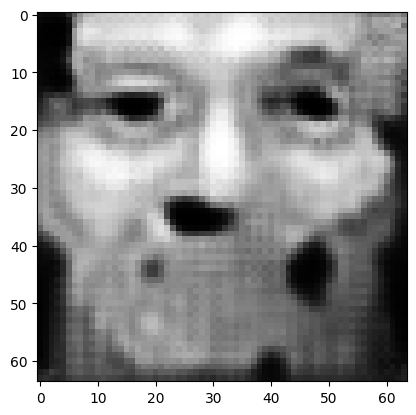

tensor([[4.8999e-03, 4.1326e-04, 6.3835e-02, 2.6191e-02, 1.0493e-01, 3.3468e-01,
         1.4681e-02, 8.0876e-03, 3.3192e-03, 2.0843e-02, 2.4016e-03, 1.7955e-03,
         5.6609e-02, 2.2517e-03, 5.3801e-04, 7.3096e-02, 8.6789e-03, 1.3103e-03,
         2.5414e-04, 4.2113e-04, 5.7161e-04, 1.2811e-02, 6.4039e-02, 8.4309e-05,
         7.0060e-03, 2.0132e-03, 1.1695e-03, 1.3873e-03, 1.0290e-03, 1.9325e-03,
         6.0697e-04, 2.2986e-02, 3.0737e-02, 1.6617e-03, 1.5522e-03, 5.3632e-03,
         4.6671e-03, 1.0923e-01, 3.6199e-04, 1.5463e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0945780277252197
tensor([[4.9068e-03, 4.1286e-04, 6.3721e-02, 2.6163e-02, 1.0479e-01, 3.3560e-01,
         1.4674e-02, 8.0945e-03, 3.3103e-03, 2.0816e-02, 2.3962e-03, 1.7916e-03,
         5.6537e-02, 2.2459e-03, 5.3649e-04, 7.3027e-02, 8.6609e-03, 1.3091e-03,
         2.5378e-04, 4.2077e-04, 5.6927e-04, 1.2788e-02, 6.3923e-02, 8.4116e-05,
         6.9836e-03, 2.0104e-03, 1.1666e-03

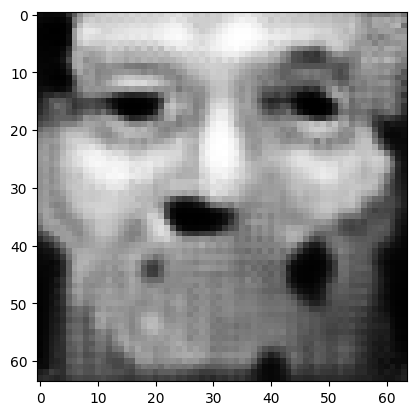

tensor([[4.9343e-03, 4.1151e-04, 6.3270e-02, 2.6063e-02, 1.0424e-01, 3.3916e-01,
         1.4638e-02, 8.1221e-03, 3.2747e-03, 2.0711e-02, 2.3757e-03, 1.7769e-03,
         5.6238e-02, 2.2228e-03, 5.3091e-04, 7.2784e-02, 8.5881e-03, 1.3046e-03,
         2.5246e-04, 4.1953e-04, 5.6045e-04, 1.2698e-02, 6.3465e-02, 8.3389e-05,
         6.8940e-03, 1.9991e-03, 1.1556e-03, 1.3678e-03, 1.0197e-03, 1.9132e-03,
         5.9765e-04, 2.2833e-02, 3.0580e-02, 1.6441e-03, 1.5345e-03, 5.3511e-03,
         4.6327e-03, 1.0847e-01, 3.5761e-04, 1.5312e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.081294059753418
tensor([[4.9415e-03, 4.1120e-04, 6.3157e-02, 2.6034e-02, 1.0411e-01, 3.4003e-01,
         1.4629e-02, 8.1292e-03, 3.2659e-03, 2.0685e-02, 2.3709e-03, 1.7734e-03,
         5.6169e-02, 2.2174e-03, 5.2954e-04, 7.2727e-02, 8.5706e-03, 1.3036e-03,
         2.5213e-04, 4.1921e-04, 5.5831e-04, 1.2676e-02, 6.3348e-02, 8.3216e-05,
         6.8732e-03, 1.9963e-03, 1.1530e-03,

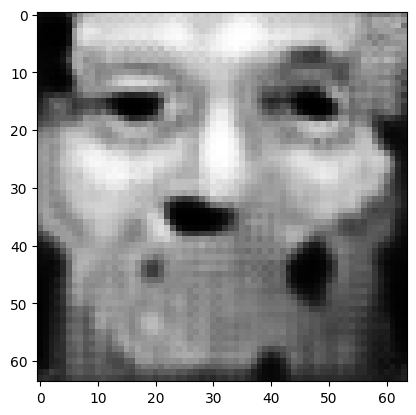

tensor([[4.9672e-03, 4.0989e-04, 6.2734e-02, 2.5940e-02, 1.0358e-01, 3.4341e-01,
         1.4594e-02, 8.1542e-03, 3.2325e-03, 2.0582e-02, 2.3515e-03, 1.7596e-03,
         5.5889e-02, 2.1962e-03, 5.2427e-04, 7.2482e-02, 8.5037e-03, 1.2994e-03,
         2.5086e-04, 4.1798e-04, 5.5017e-04, 1.2590e-02, 6.2924e-02, 8.2529e-05,
         6.7895e-03, 1.9859e-03, 1.1427e-03, 1.3496e-03, 1.0109e-03, 1.8947e-03,
         5.8895e-04, 2.2690e-02, 3.0427e-02, 1.6276e-03, 1.5179e-03, 5.3391e-03,
         4.6005e-03, 1.0774e-01, 3.5352e-04, 1.5170e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0688321590423584
tensor([[4.9731e-03, 4.0955e-04, 6.2633e-02, 2.5919e-02, 1.0345e-01, 3.4423e-01,
         1.4585e-02, 8.1599e-03, 3.2247e-03, 2.0557e-02, 2.3468e-03, 1.7563e-03,
         5.5818e-02, 2.1909e-03, 5.2300e-04, 7.2420e-02, 8.4877e-03, 1.2983e-03,
         2.5055e-04, 4.1770e-04, 5.4821e-04, 1.2570e-02, 6.2825e-02, 8.2361e-05,
         6.7689e-03, 1.9834e-03, 1.1402e-03

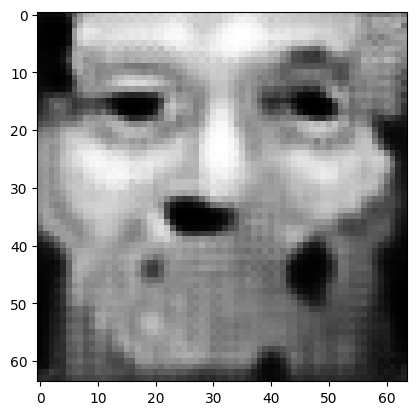

tensor([[4.9976e-03, 4.0835e-04, 6.2226e-02, 2.5828e-02, 1.0294e-01, 3.4743e-01,
         1.4552e-02, 8.1823e-03, 3.1936e-03, 2.0457e-02, 2.3287e-03, 1.7431e-03,
         5.5558e-02, 2.1712e-03, 5.1809e-04, 7.2184e-02, 8.4250e-03, 1.2943e-03,
         2.4933e-04, 4.1654e-04, 5.4062e-04, 1.2490e-02, 6.2419e-02, 8.1715e-05,
         6.6915e-03, 1.9734e-03, 1.1306e-03, 1.3327e-03, 1.0027e-03, 1.8772e-03,
         5.8085e-04, 2.2553e-02, 3.0284e-02, 1.6122e-03, 1.5024e-03, 5.3271e-03,
         4.5706e-03, 1.0707e-01, 3.4971e-04, 1.5035e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0571839809417725
tensor([[5.0027e-03, 4.0803e-04, 6.2130e-02, 2.5810e-02, 1.0282e-01, 3.4821e-01,
         1.4544e-02, 8.1871e-03, 3.1865e-03, 2.0432e-02, 2.3242e-03, 1.7399e-03,
         5.5489e-02, 2.1662e-03, 5.1690e-04, 7.2125e-02, 8.4103e-03, 1.2933e-03,
         2.4903e-04, 4.1628e-04, 5.3882e-04, 1.2472e-02, 6.2323e-02, 8.1556e-05,
         6.6719e-03, 1.9709e-03, 1.1282e-03

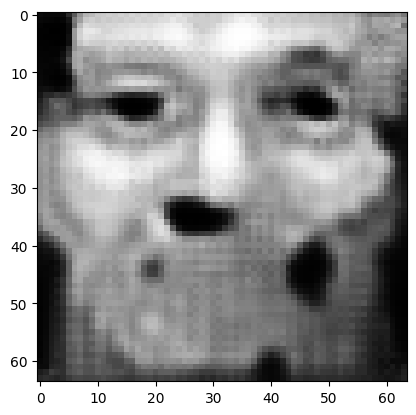

tensor([[5.0250e-03, 4.0684e-04, 6.1745e-02, 2.5726e-02, 1.0233e-01, 3.5126e-01,
         1.4513e-02, 8.2083e-03, 3.1578e-03, 2.0338e-02, 2.3073e-03, 1.7275e-03,
         5.5237e-02, 2.1474e-03, 5.1230e-04, 7.1896e-02, 8.3524e-03, 1.2894e-03,
         2.4791e-04, 4.1516e-04, 5.3170e-04, 1.2397e-02, 6.1942e-02, 8.0956e-05,
         6.5999e-03, 1.9615e-03, 1.1193e-03, 1.3167e-03, 9.9508e-04, 1.8607e-03,
         5.7325e-04, 2.2423e-02, 3.0149e-02, 1.5976e-03, 1.4877e-03, 5.3151e-03,
         4.5423e-03, 1.0643e-01, 3.4616e-04, 1.4903e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0462285280227661
tensor([[5.0301e-03, 4.0657e-04, 6.1651e-02, 2.5707e-02, 1.0222e-01, 3.5200e-01,
         1.4505e-02, 8.2122e-03, 3.1506e-03, 2.0312e-02, 2.3030e-03, 1.7244e-03,
         5.5171e-02, 2.1429e-03, 5.1117e-04, 7.1836e-02, 8.3380e-03, 1.2885e-03,
         2.4762e-04, 4.1490e-04, 5.3003e-04, 1.2379e-02, 6.1844e-02, 8.0800e-05,
         6.5815e-03, 1.9593e-03, 1.1170e-03

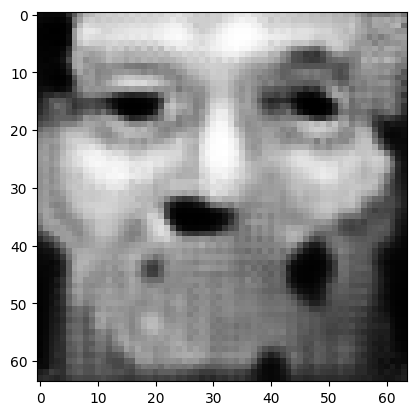

tensor([[5.0508e-03, 4.0545e-04, 6.1287e-02, 2.5630e-02, 1.0176e-01, 3.5489e-01,
         1.4476e-02, 8.2297e-03, 3.1239e-03, 2.0219e-02, 2.2870e-03, 1.7127e-03,
         5.4936e-02, 2.1257e-03, 5.0686e-04, 7.1602e-02, 8.2843e-03, 1.2847e-03,
         2.4652e-04, 4.1380e-04, 5.2346e-04, 1.2308e-02, 6.1492e-02, 8.0223e-05,
         6.5146e-03, 1.9508e-03, 1.1086e-03, 1.3019e-03, 9.8768e-04, 1.8448e-03,
         5.6629e-04, 2.2305e-02, 3.0019e-02, 1.5841e-03, 1.4738e-03, 5.3033e-03,
         4.5159e-03, 1.0584e-01, 3.4283e-04, 1.4779e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0359584093093872
tensor([[5.0557e-03, 4.0519e-04, 6.1195e-02, 2.5615e-02, 1.0165e-01, 3.5559e-01,
         1.4467e-02, 8.2336e-03, 3.1169e-03, 2.0195e-02, 2.2831e-03, 1.7097e-03,
         5.4878e-02, 2.1215e-03, 5.0586e-04, 7.1535e-02, 8.2706e-03, 1.2838e-03,
         2.4624e-04, 4.1353e-04, 5.2188e-04, 1.2291e-02, 6.1414e-02, 8.0078e-05,
         6.4978e-03, 1.9489e-03, 1.1065e-03

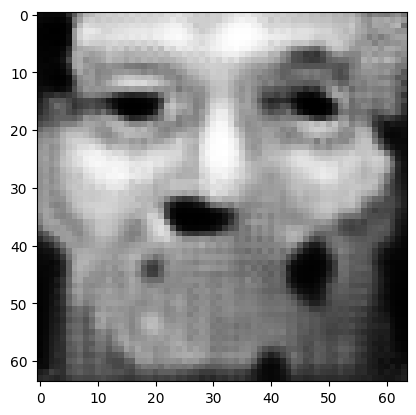

tensor([[5.0741e-03, 4.0411e-04, 6.0844e-02, 2.5544e-02, 1.0123e-01, 3.5834e-01,
         1.4436e-02, 8.2482e-03, 3.0915e-03, 2.0102e-02, 2.2677e-03, 1.6985e-03,
         5.4649e-02, 2.1055e-03, 5.0189e-04, 7.1290e-02, 8.2195e-03, 1.2802e-03,
         2.4515e-04, 4.1245e-04, 5.1582e-04, 1.2225e-02, 6.1097e-02, 7.9522e-05,
         6.4343e-03, 1.9411e-03, 1.0983e-03, 1.2880e-03, 9.8049e-04, 1.8295e-03,
         5.5977e-04, 2.2196e-02, 2.9894e-02, 1.5715e-03, 1.4607e-03, 5.2919e-03,
         4.4914e-03, 1.0526e-01, 3.3971e-04, 1.4656e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.026279091835022
tensor([[5.0789e-03, 4.0384e-04, 6.0756e-02, 2.5525e-02, 1.0112e-01, 3.5900e-01,
         1.4428e-02, 8.2515e-03, 3.0853e-03, 2.0079e-02, 2.2640e-03, 1.6959e-03,
         5.4596e-02, 2.1017e-03, 5.0090e-04, 7.1229e-02, 8.2071e-03, 1.2794e-03,
         2.4487e-04, 4.1216e-04, 5.1434e-04, 1.2208e-02, 6.1019e-02, 7.9386e-05,
         6.4196e-03, 1.9392e-03, 1.0963e-03,

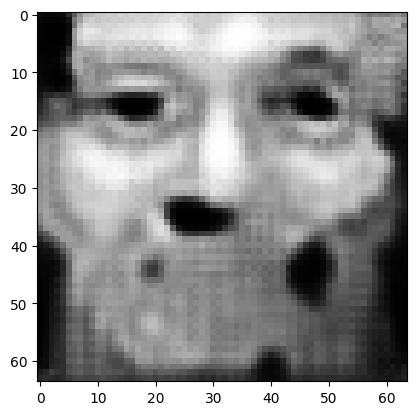

tensor([[5.0961e-03, 4.0284e-04, 6.0422e-02, 2.5461e-02, 1.0072e-01, 3.6159e-01,
         1.4399e-02, 8.2643e-03, 3.0618e-03, 1.9990e-02, 2.2497e-03, 1.6854e-03,
         5.4382e-02, 2.0867e-03, 4.9724e-04, 7.0995e-02, 8.1599e-03, 1.2761e-03,
         2.4385e-04, 4.1115e-04, 5.0872e-04, 1.2146e-02, 6.0725e-02, 7.8871e-05,
         6.3609e-03, 1.9319e-03, 1.0887e-03, 1.2751e-03, 9.7385e-04, 1.8150e-03,
         5.5375e-04, 2.2093e-02, 2.9776e-02, 1.5597e-03, 1.4486e-03, 5.2808e-03,
         4.4685e-03, 1.0473e-01, 3.3683e-04, 1.4544e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0172326564788818
tensor([[5.1004e-03, 4.0261e-04, 6.0339e-02, 2.5449e-02, 1.0062e-01, 3.6222e-01,
         1.4392e-02, 8.2676e-03, 3.0560e-03, 1.9969e-02, 2.2463e-03, 1.6828e-03,
         5.4327e-02, 2.0830e-03, 4.9638e-04, 7.0938e-02, 8.1483e-03, 1.2753e-03,
         2.4362e-04, 4.1092e-04, 5.0736e-04, 1.2131e-02, 6.0656e-02, 7.8750e-05,
         6.3461e-03, 1.9301e-03, 1.0869e-03

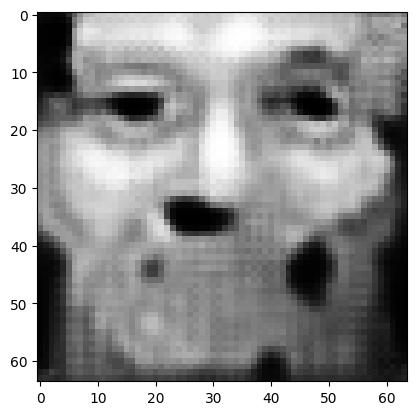

tensor([[5.1169e-03, 4.0169e-04, 6.0019e-02, 2.5391e-02, 1.0023e-01, 3.6469e-01,
         1.4364e-02, 8.2789e-03, 3.0336e-03, 1.9883e-02, 2.2327e-03, 1.6729e-03,
         5.4124e-02, 2.0690e-03, 4.9293e-04, 7.0708e-02, 8.1037e-03, 1.2721e-03,
         2.4266e-04, 4.0996e-04, 5.0211e-04, 1.2072e-02, 6.0379e-02, 7.8262e-05,
         6.2906e-03, 1.9233e-03, 1.0797e-03, 1.2629e-03, 9.6756e-04, 1.8012e-03,
         5.4804e-04, 2.1999e-02, 2.9663e-02, 1.5487e-03, 1.4370e-03, 5.2703e-03,
         4.4472e-03, 1.0422e-01, 3.3411e-04, 1.4434e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.008721113204956
tensor([[5.1206e-03, 4.0143e-04, 5.9943e-02, 2.5376e-02, 1.0013e-01, 3.6529e-01,
         1.4357e-02, 8.2812e-03, 3.0283e-03, 1.9862e-02, 2.2293e-03, 1.6704e-03,
         5.4075e-02, 2.0654e-03, 4.9208e-04, 7.0655e-02, 8.0933e-03, 1.2714e-03,
         2.4242e-04, 4.0972e-04, 5.0083e-04, 1.2058e-02, 6.0312e-02, 7.8144e-05,
         6.2769e-03, 1.9215e-03, 1.0779e-03,

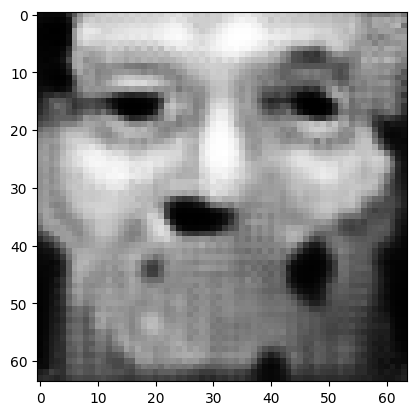

tensor([[5.1363e-03, 4.0050e-04, 5.9634e-02, 2.5315e-02, 9.9776e-02, 3.6765e-01,
         1.4330e-02, 8.2917e-03, 3.0071e-03, 1.9782e-02, 2.2163e-03, 1.6611e-03,
         5.3877e-02, 2.0518e-03, 4.8882e-04, 7.0443e-02, 8.0508e-03, 1.2684e-03,
         2.4150e-04, 4.0878e-04, 4.9588e-04, 1.2001e-02, 6.0042e-02, 7.7686e-05,
         6.2235e-03, 1.9146e-03, 1.0710e-03, 1.2512e-03, 9.6153e-04, 1.7883e-03,
         5.4263e-04, 2.1906e-02, 2.9556e-02, 1.5381e-03, 1.4262e-03, 5.2603e-03,
         4.4260e-03, 1.0373e-01, 3.3152e-04, 1.4328e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0006310939788818
tensor([[5.1403e-03, 4.0026e-04, 5.9559e-02, 2.5301e-02, 9.9683e-02, 3.6822e-01,
         1.4324e-02, 8.2945e-03, 3.0019e-03, 1.9763e-02, 2.2131e-03, 1.6587e-03,
         5.3832e-02, 2.0485e-03, 4.8803e-04, 7.0390e-02, 8.0408e-03, 1.2676e-03,
         2.4129e-04, 4.0854e-04, 4.9466e-04, 1.1987e-02, 5.9980e-02, 7.7577e-05,
         6.2109e-03, 1.9130e-03, 1.0694e-03

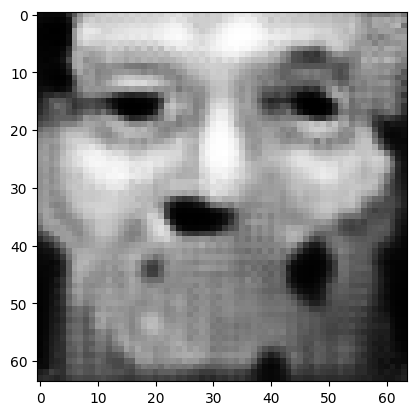

tensor([[5.1541e-03, 3.9933e-04, 5.9269e-02, 2.5248e-02, 9.9341e-02, 3.7046e-01,
         1.4298e-02, 8.3035e-03, 2.9824e-03, 1.9687e-02, 2.2008e-03, 1.6498e-03,
         5.3639e-02, 2.0354e-03, 4.8498e-04, 7.0189e-02, 8.0010e-03, 1.2649e-03,
         2.4043e-04, 4.0766e-04, 4.9002e-04, 1.1934e-02, 5.9730e-02, 7.7148e-05,
         6.1601e-03, 1.9064e-03, 1.0629e-03, 1.2402e-03, 9.5585e-04, 1.7761e-03,
         5.3749e-04, 2.1819e-02, 2.9453e-02, 1.5279e-03, 1.4159e-03, 5.2507e-03,
         4.4059e-03, 1.0325e-01, 3.2907e-04, 1.4225e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9930015802383423
tensor([[5.1579e-03, 3.9913e-04, 5.9195e-02, 2.5232e-02, 9.9257e-02, 3.7101e-01,
         1.4292e-02, 8.3059e-03, 2.9775e-03, 1.9669e-02, 2.1978e-03, 1.6477e-03,
         5.3594e-02, 2.0323e-03, 4.8423e-04, 7.0142e-02, 7.9912e-03, 1.2642e-03,
         2.4022e-04, 4.0743e-04, 4.8889e-04, 1.1920e-02, 5.9665e-02, 7.7045e-05,
         6.1484e-03, 1.9048e-03, 1.0614e-03

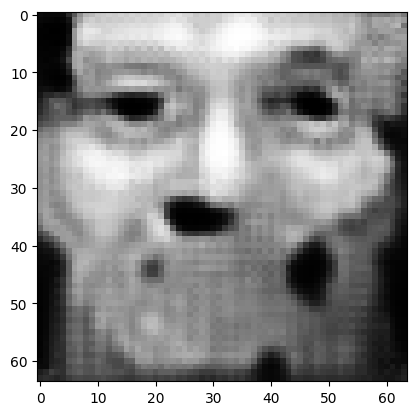

tensor([[5.1716e-03, 3.9825e-04, 5.8918e-02, 2.5179e-02, 9.8925e-02, 3.7314e-01,
         1.4268e-02, 8.3144e-03, 2.9590e-03, 1.9597e-02, 2.1862e-03, 1.6394e-03,
         5.3415e-02, 2.0201e-03, 4.8135e-04, 6.9947e-02, 7.9541e-03, 1.2615e-03,
         2.3941e-04, 4.0656e-04, 4.8453e-04, 1.1870e-02, 5.9428e-02, 7.6642e-05,
         6.1020e-03, 1.8987e-03, 1.0553e-03, 1.2300e-03, 9.5050e-04, 1.7645e-03,
         5.3273e-04, 2.1737e-02, 2.9354e-02, 1.5184e-03, 1.4063e-03, 5.2416e-03,
         4.3868e-03, 1.0280e-01, 3.2678e-04, 1.4132e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9858083724975586
tensor([[5.1747e-03, 3.9806e-04, 5.8851e-02, 2.5169e-02, 9.8844e-02, 3.7365e-01,
         1.4261e-02, 8.3164e-03, 2.9545e-03, 1.9579e-02, 2.1835e-03, 1.6373e-03,
         5.3369e-02, 2.0171e-03, 4.8070e-04, 6.9902e-02, 7.9448e-03, 1.2609e-03,
         2.3923e-04, 4.0637e-04, 4.8350e-04, 1.1857e-02, 5.9371e-02, 7.6546e-05,
         6.0904e-03, 1.8972e-03, 1.0539e-03

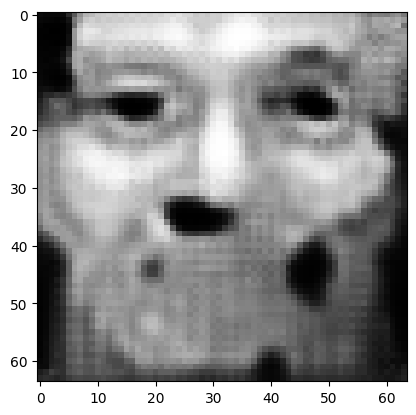

tensor([[5.1878e-03, 3.9725e-04, 5.8586e-02, 2.5117e-02, 9.8535e-02, 3.7567e-01,
         1.4238e-02, 8.3239e-03, 2.9369e-03, 1.9510e-02, 2.1725e-03, 1.6294e-03,
         5.3200e-02, 2.0057e-03, 4.7798e-04, 6.9715e-02, 7.9091e-03, 1.2584e-03,
         2.3845e-04, 4.0552e-04, 4.7942e-04, 1.1809e-02, 5.9144e-02, 7.6163e-05,
         6.0470e-03, 1.8915e-03, 1.0481e-03, 1.2202e-03, 9.4539e-04, 1.7537e-03,
         5.2826e-04, 2.1661e-02, 2.9260e-02, 1.5095e-03, 1.3972e-03, 5.2329e-03,
         4.3686e-03, 1.0238e-01, 3.2461e-04, 1.4042e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9790396690368652
tensor([[5.1912e-03, 3.9707e-04, 5.8522e-02, 2.5105e-02, 9.8454e-02, 3.7616e-01,
         1.4233e-02, 8.3260e-03, 2.9326e-03, 1.9494e-02, 2.1699e-03, 1.6275e-03,
         5.3159e-02, 2.0030e-03, 4.7734e-04, 6.9672e-02, 7.9006e-03, 1.2578e-03,
         2.3827e-04, 4.0532e-04, 4.7844e-04, 1.1797e-02, 5.9089e-02, 7.6074e-05,
         6.0367e-03, 1.8901e-03, 1.0468e-03

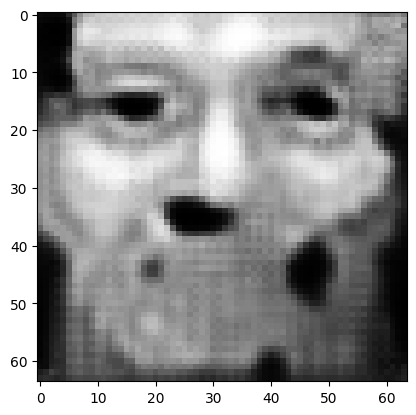

tensor([[5.2037e-03, 3.9634e-04, 5.8273e-02, 2.5056e-02, 9.8155e-02, 3.7807e-01,
         1.4211e-02, 8.3331e-03, 2.9163e-03, 1.9429e-02, 2.1598e-03, 1.6201e-03,
         5.2995e-02, 1.9923e-03, 4.7483e-04, 6.9499e-02, 7.8670e-03, 1.2555e-03,
         2.3756e-04, 4.0457e-04, 4.7465e-04, 1.1752e-02, 5.8868e-02, 7.5717e-05,
         5.9961e-03, 1.8846e-03, 1.0415e-03, 1.2112e-03, 9.4072e-04, 1.7437e-03,
         5.2409e-04, 2.1589e-02, 2.9171e-02, 1.5012e-03, 1.3888e-03, 5.2245e-03,
         4.3517e-03, 1.0200e-01, 3.2260e-04, 1.3960e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9726845026016235
tensor([[5.2068e-03, 3.9617e-04, 5.8213e-02, 2.5044e-02, 9.8081e-02, 3.7853e-01,
         1.4206e-02, 8.3351e-03, 2.9123e-03, 1.9413e-02, 2.1574e-03, 1.6183e-03,
         5.2954e-02, 1.9897e-03, 4.7422e-04, 6.9456e-02, 7.8589e-03, 1.2549e-03,
         2.3739e-04, 4.0438e-04, 4.7373e-04, 1.1741e-02, 5.8815e-02, 7.5632e-05,
         5.9863e-03, 1.8833e-03, 1.0402e-03

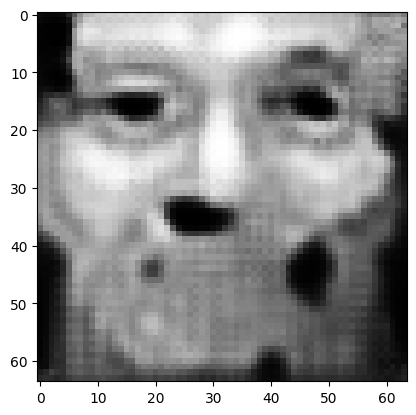

tensor([[5.2188e-03, 3.9548e-04, 5.7979e-02, 2.4997e-02, 9.7793e-02, 3.8033e-01,
         1.4186e-02, 8.3419e-03, 2.8969e-03, 1.9352e-02, 2.1479e-03, 1.6113e-03,
         5.2803e-02, 1.9797e-03, 4.7185e-04, 6.9292e-02, 7.8276e-03, 1.2527e-03,
         2.3672e-04, 4.0365e-04, 4.7015e-04, 1.1698e-02, 5.8608e-02, 7.5299e-05,
         5.9486e-03, 1.8781e-03, 1.0352e-03, 1.2028e-03, 9.3634e-04, 1.7342e-03,
         5.2019e-04, 2.1521e-02, 2.9087e-02, 1.4934e-03, 1.3809e-03, 5.2169e-03,
         4.3357e-03, 1.0163e-01, 3.2071e-04, 1.3883e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.96671062707901
tensor([[5.2216e-03, 3.9531e-04, 5.7922e-02, 2.4987e-02, 9.7722e-02, 3.8077e-01,
         1.4181e-02, 8.3438e-03, 2.8932e-03, 1.9337e-02, 2.1456e-03, 1.6096e-03,
         5.2764e-02, 1.9772e-03, 4.7131e-04, 6.9253e-02, 7.8196e-03, 1.2522e-03,
         2.3657e-04, 4.0348e-04, 4.6929e-04, 1.1688e-02, 5.8560e-02, 7.5220e-05,
         5.9391e-03, 1.8768e-03, 1.0339e-03, 

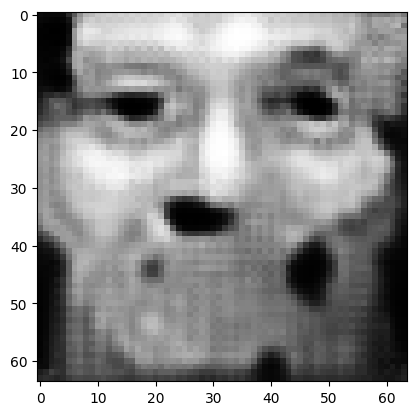

tensor([[5.2328e-03, 3.9464e-04, 5.7701e-02, 2.4942e-02, 9.7451e-02, 3.8247e-01,
         1.4163e-02, 8.3507e-03, 2.8788e-03, 1.9280e-02, 2.1367e-03, 1.6031e-03,
         5.2617e-02, 1.9677e-03, 4.6909e-04, 6.9104e-02, 7.7901e-03, 1.2502e-03,
         2.3595e-04, 4.0279e-04, 4.6594e-04, 1.1647e-02, 5.8361e-02, 7.4915e-05,
         5.9035e-03, 1.8718e-03, 1.0292e-03, 1.1948e-03, 9.3223e-04, 1.7254e-03,
         5.1649e-04, 2.1457e-02, 2.9009e-02, 1.4860e-03, 1.3735e-03, 5.2097e-03,
         4.3203e-03, 1.0128e-01, 3.1893e-04, 1.3809e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9611039161682129
tensor([[5.2354e-03, 3.9448e-04, 5.7647e-02, 2.4932e-02, 9.7383e-02, 3.8288e-01,
         1.4159e-02, 8.3524e-03, 2.8754e-03, 1.9266e-02, 2.1345e-03, 1.6015e-03,
         5.2581e-02, 1.9653e-03, 4.6857e-04, 6.9068e-02, 7.7829e-03, 1.2497e-03,
         2.3580e-04, 4.0263e-04, 4.6512e-04, 1.1637e-02, 5.8314e-02, 7.4841e-05,
         5.8948e-03, 1.8705e-03, 1.0280e-03

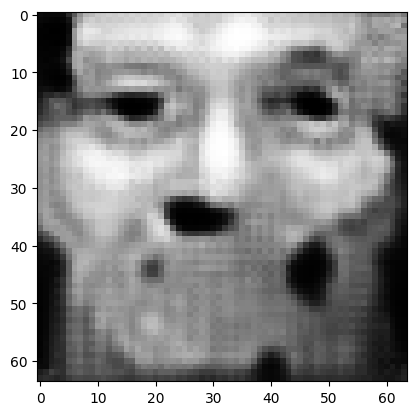

tensor([[5.2459e-03, 3.9384e-04, 5.7436e-02, 2.4889e-02, 9.7130e-02, 3.8450e-01,
         1.4142e-02, 8.3586e-03, 2.8619e-03, 1.9212e-02, 2.1260e-03, 1.5953e-03,
         5.2438e-02, 1.9563e-03, 4.6648e-04, 6.8925e-02, 7.7549e-03, 1.2478e-03,
         2.3522e-04, 4.0199e-04, 4.6197e-04, 1.1599e-02, 5.8126e-02, 7.4551e-05,
         5.8610e-03, 1.8658e-03, 1.0235e-03, 1.1872e-03, 9.2833e-04, 1.7170e-03,
         5.1301e-04, 2.1396e-02, 2.8935e-02, 1.4789e-03, 1.3665e-03, 5.2029e-03,
         4.3056e-03, 1.0095e-01, 3.1726e-04, 1.3738e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.955817699432373
tensor([[5.2485e-03, 3.9369e-04, 5.7384e-02, 2.4879e-02, 9.7065e-02, 3.8489e-01,
         1.4138e-02, 8.3604e-03, 2.8586e-03, 1.9199e-02, 2.1240e-03, 1.5938e-03,
         5.2404e-02, 1.9541e-03, 4.6598e-04, 6.8890e-02, 7.7482e-03, 1.2474e-03,
         2.3508e-04, 4.0183e-04, 4.6120e-04, 1.1590e-02, 5.8082e-02, 7.4483e-05,
         5.8530e-03, 1.8646e-03, 1.0224e-03,

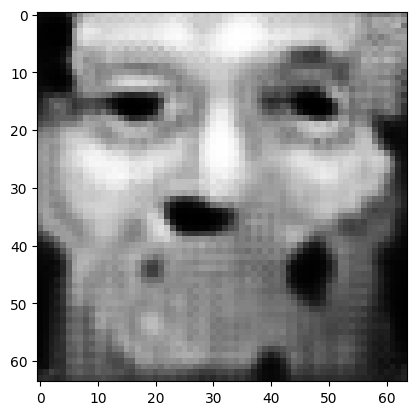

tensor([[5.2583e-03, 3.9309e-04, 5.7181e-02, 2.4839e-02, 9.6828e-02, 3.8642e-01,
         1.4121e-02, 8.3665e-03, 2.8458e-03, 1.9147e-02, 2.1161e-03, 1.5880e-03,
         5.2268e-02, 1.9455e-03, 4.6405e-04, 6.8751e-02, 7.7220e-03, 1.2456e-03,
         2.3454e-04, 4.0122e-04, 4.5824e-04, 1.1554e-02, 5.7908e-02, 7.4211e-05,
         5.8215e-03, 1.8602e-03, 1.0181e-03, 1.1801e-03, 9.2464e-04, 1.7091e-03,
         5.0973e-04, 2.1339e-02, 2.8865e-02, 1.4723e-03, 1.3601e-03, 5.1966e-03,
         4.2920e-03, 1.0064e-01, 3.1571e-04, 1.3672e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9508355855941772
tensor([[5.2606e-03, 3.9293e-04, 5.7131e-02, 2.4828e-02, 9.6775e-02, 3.8679e-01,
         1.4117e-02, 8.3676e-03, 2.8427e-03, 1.9134e-02, 2.1141e-03, 1.5866e-03,
         5.2235e-02, 1.9435e-03, 4.6356e-04, 6.8715e-02, 7.7155e-03, 1.2451e-03,
         2.3439e-04, 4.0105e-04, 4.5753e-04, 1.1545e-02, 5.7867e-02, 7.4141e-05,
         5.8137e-03, 1.8591e-03, 1.0170e-03

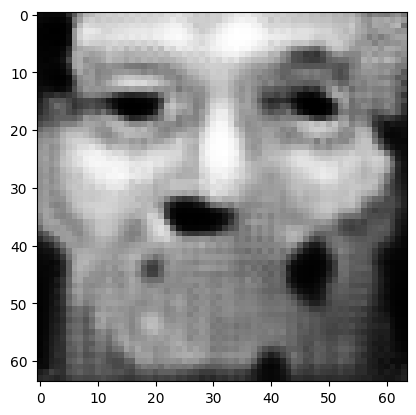

tensor([[5.2700e-03, 3.9236e-04, 5.6938e-02, 2.4790e-02, 9.6549e-02, 3.8824e-01,
         1.4101e-02, 8.3735e-03, 2.8307e-03, 1.9086e-02, 2.1067e-03, 1.5811e-03,
         5.2105e-02, 1.9354e-03, 4.6174e-04, 6.8581e-02, 7.6906e-03, 1.2435e-03,
         2.3387e-04, 4.0046e-04, 4.5474e-04, 1.1511e-02, 5.7705e-02, 7.3887e-05,
         5.7843e-03, 1.8549e-03, 1.0130e-03, 1.1734e-03, 9.2110e-04, 1.7017e-03,
         5.0666e-04, 2.1286e-02, 2.8798e-02, 1.4661e-03, 1.3541e-03, 5.1906e-03,
         4.2790e-03, 1.0034e-01, 3.1423e-04, 1.3610e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9461348056793213
tensor([[5.2722e-03, 3.9222e-04, 5.6891e-02, 2.4779e-02, 9.6497e-02, 3.8859e-01,
         1.4097e-02, 8.3746e-03, 2.8278e-03, 1.9074e-02, 2.1048e-03, 1.5798e-03,
         5.2074e-02, 1.9335e-03, 4.6128e-04, 6.8548e-02, 7.6846e-03, 1.2431e-03,
         2.3373e-04, 4.0031e-04, 4.5406e-04, 1.1503e-02, 5.7664e-02, 7.3821e-05,
         5.7773e-03, 1.8539e-03, 1.0119e-03

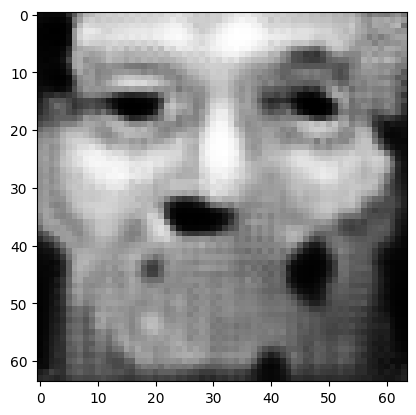

tensor([[5.2809e-03, 3.9167e-04, 5.6708e-02, 2.4742e-02, 9.6283e-02, 3.8997e-01,
         1.4082e-02, 8.3800e-03, 2.8164e-03, 1.9028e-02, 2.0978e-03, 1.5746e-03,
         5.1950e-02, 1.9259e-03, 4.5958e-04, 6.8420e-02, 7.6609e-03, 1.2414e-03,
         2.3324e-04, 3.9976e-04, 4.5144e-04, 1.1471e-02, 5.7512e-02, 7.3579e-05,
         5.7492e-03, 1.8500e-03, 1.0081e-03, 1.1671e-03, 9.1776e-04, 1.6947e-03,
         5.0377e-04, 2.1234e-02, 2.8734e-02, 1.4602e-03, 1.3484e-03, 5.1848e-03,
         4.2666e-03, 1.0006e-01, 3.1284e-04, 1.3552e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9416955709457397
tensor([[5.2831e-03, 3.9154e-04, 5.6663e-02, 2.4731e-02, 9.6232e-02, 3.9030e-01,
         1.4078e-02, 8.3815e-03, 2.8137e-03, 1.9017e-02, 2.0961e-03, 1.5734e-03,
         5.1918e-02, 1.9240e-03, 4.5915e-04, 6.8393e-02, 7.6553e-03, 1.2411e-03,
         2.3313e-04, 3.9961e-04, 4.5080e-04, 1.1463e-02, 5.7470e-02, 7.3521e-05,
         5.7428e-03, 1.8490e-03, 1.0072e-03

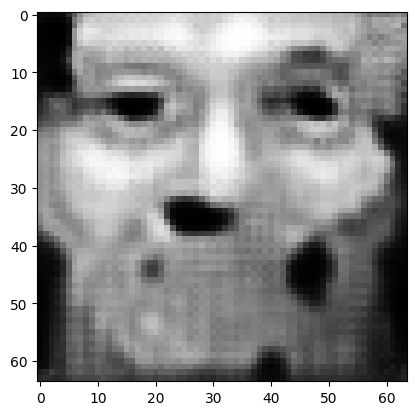

tensor([[5.2912e-03, 3.9102e-04, 5.6492e-02, 2.4696e-02, 9.6029e-02, 3.9160e-01,
         1.4064e-02, 8.3863e-03, 2.8030e-03, 1.8973e-02, 2.0894e-03, 1.5685e-03,
         5.1801e-02, 1.9168e-03, 4.5752e-04, 6.8271e-02, 7.6332e-03, 1.2395e-03,
         2.3266e-04, 3.9909e-04, 4.4833e-04, 1.1432e-02, 5.7326e-02, 7.3291e-05,
         5.7165e-03, 1.8452e-03, 1.0035e-03, 1.1612e-03, 9.1462e-04, 1.6881e-03,
         5.0105e-04, 2.1185e-02, 2.8674e-02, 1.4546e-03, 1.3431e-03, 5.1794e-03,
         4.2549e-03, 9.9799e-02, 3.1153e-04, 1.3497e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9375050067901611
tensor([[5.2932e-03, 3.9090e-04, 5.6448e-02, 2.4687e-02, 9.5982e-02, 3.9192e-01,
         1.4060e-02, 8.3875e-03, 2.8004e-03, 1.8962e-02, 2.0878e-03, 1.5672e-03,
         5.1772e-02, 1.9151e-03, 4.5714e-04, 6.8243e-02, 7.6275e-03, 1.2392e-03,
         2.3254e-04, 3.9896e-04, 4.4774e-04, 1.1425e-02, 5.7290e-02, 7.3235e-05,
         5.7101e-03, 1.8443e-03, 1.0026e-03

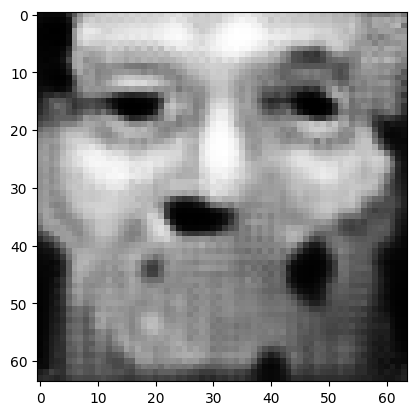

tensor([[5.3008e-03, 3.9040e-04, 5.6286e-02, 2.4654e-02, 9.5790e-02, 3.9316e-01,
         1.4047e-02, 8.3919e-03, 2.7903e-03, 1.8921e-02, 2.0815e-03, 1.5626e-03,
         5.1659e-02, 1.9083e-03, 4.5559e-04, 6.8126e-02, 7.6066e-03, 1.2377e-03,
         2.3210e-04, 3.9846e-04, 4.4540e-04, 1.1396e-02, 5.7153e-02, 7.3015e-05,
         5.6852e-03, 1.8408e-03, 9.9919e-04, 1.1555e-03, 9.1162e-04, 1.6818e-03,
         4.9847e-04, 2.1139e-02, 2.8616e-02, 1.4493e-03, 1.3381e-03, 5.1742e-03,
         4.2438e-03, 9.9545e-02, 3.1028e-04, 1.3444e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9335356950759888
tensor([[5.3027e-03, 3.9029e-04, 5.6245e-02, 2.4645e-02, 9.5742e-02, 3.9346e-01,
         1.4043e-02, 8.3931e-03, 2.7878e-03, 1.8911e-02, 2.0800e-03, 1.5615e-03,
         5.1632e-02, 1.9066e-03, 4.5522e-04, 6.8100e-02, 7.6015e-03, 1.2373e-03,
         2.3199e-04, 3.9834e-04, 4.4484e-04, 1.1389e-02, 5.7118e-02, 7.2964e-05,
         5.6793e-03, 1.8399e-03, 9.9837e-04

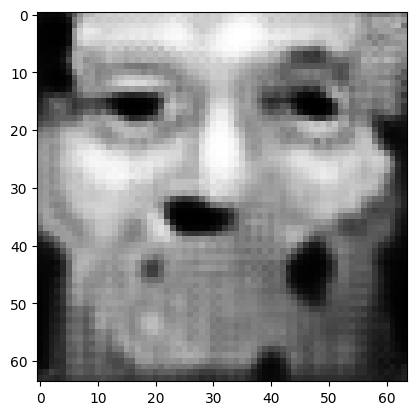

tensor([[5.3100e-03, 3.8982e-04, 5.6090e-02, 2.4614e-02, 9.5560e-02, 3.9464e-01,
         1.4030e-02, 8.3974e-03, 2.7782e-03, 1.8872e-02, 2.0741e-03, 1.5571e-03,
         5.1525e-02, 1.9002e-03, 4.5379e-04, 6.7990e-02, 7.5816e-03, 1.2359e-03,
         2.3158e-04, 3.9787e-04, 4.4265e-04, 1.1362e-02, 5.6989e-02, 7.2759e-05,
         5.6558e-03, 1.8365e-03, 9.9512e-04, 1.1502e-03, 9.0881e-04, 1.6759e-03,
         4.9603e-04, 2.1096e-02, 2.8561e-02, 1.4443e-03, 1.3333e-03, 5.1693e-03,
         4.2333e-03, 9.9303e-02, 3.0910e-04, 1.3395e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9297866225242615
tensor([[5.3118e-03, 3.8970e-04, 5.6053e-02, 2.4607e-02, 9.5515e-02, 3.9492e-01,
         1.4028e-02, 8.3982e-03, 2.7760e-03, 1.8862e-02, 2.0726e-03, 1.5560e-03,
         5.1499e-02, 1.8986e-03, 4.5343e-04, 6.7962e-02, 7.5769e-03, 1.2356e-03,
         2.3147e-04, 3.9775e-04, 4.4211e-04, 1.1355e-02, 5.6958e-02, 7.2708e-05,
         5.6501e-03, 1.8358e-03, 9.9433e-04

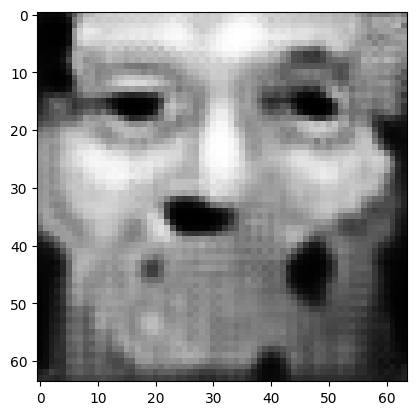

tensor([[5.3188e-03, 3.8927e-04, 5.5906e-02, 2.4576e-02, 9.5342e-02, 3.9604e-01,
         1.4016e-02, 8.4022e-03, 2.7669e-03, 1.8825e-02, 2.0670e-03, 1.5519e-03,
         5.1396e-02, 1.8925e-03, 4.5206e-04, 6.7860e-02, 7.5580e-03, 1.2342e-03,
         2.3108e-04, 3.9729e-04, 4.4004e-04, 1.1329e-02, 5.6832e-02, 7.2514e-05,
         5.6282e-03, 1.8326e-03, 9.9127e-04, 1.1453e-03, 9.0614e-04, 1.6703e-03,
         4.9375e-04, 2.1055e-02, 2.8509e-02, 1.4396e-03, 1.3287e-03, 5.1646e-03,
         4.2233e-03, 9.9076e-02, 3.0799e-04, 1.3348e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9262412190437317
tensor([[5.3204e-03, 3.8916e-04, 5.5871e-02, 2.4569e-02, 9.5299e-02, 3.9631e-01,
         1.4013e-02, 8.4029e-03, 2.7648e-03, 1.8816e-02, 2.0656e-03, 1.5509e-03,
         5.1371e-02, 1.8911e-03, 4.5173e-04, 6.7833e-02, 7.5534e-03, 1.2339e-03,
         2.3098e-04, 3.9718e-04, 4.3954e-04, 1.1323e-02, 5.6804e-02, 7.2466e-05,
         5.6226e-03, 1.8318e-03, 9.9050e-04

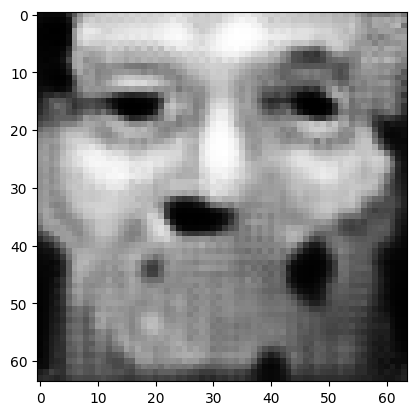

tensor([[5.3270e-03, 3.8875e-04, 5.5731e-02, 2.4540e-02, 9.5134e-02, 3.9737e-01,
         1.4001e-02, 8.4065e-03, 2.7561e-03, 1.8780e-02, 2.0603e-03, 1.5469e-03,
         5.1273e-02, 1.8853e-03, 4.5044e-04, 6.7733e-02, 7.5354e-03, 1.2326e-03,
         2.3061e-04, 3.9675e-04, 4.3758e-04, 1.1298e-02, 5.6684e-02, 7.2279e-05,
         5.6019e-03, 1.8288e-03, 9.8759e-04, 1.1405e-03, 9.0360e-04, 1.6649e-03,
         4.9159e-04, 2.1016e-02, 2.8459e-02, 1.4352e-03, 1.3244e-03, 5.1599e-03,
         4.2139e-03, 9.8860e-02, 3.0693e-04, 1.3303e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9228755235671997
tensor([[5.3286e-03, 3.8864e-04, 5.5698e-02, 2.4532e-02, 9.5092e-02, 3.9763e-01,
         1.3998e-02, 8.4074e-03, 2.7541e-03, 1.8771e-02, 2.0590e-03, 1.5459e-03,
         5.1250e-02, 1.8839e-03, 4.5012e-04, 6.7708e-02, 7.5312e-03, 1.2323e-03,
         2.3051e-04, 3.9664e-04, 4.3711e-04, 1.1292e-02, 5.6657e-02, 7.2234e-05,
         5.5969e-03, 1.8281e-03, 9.8688e-04

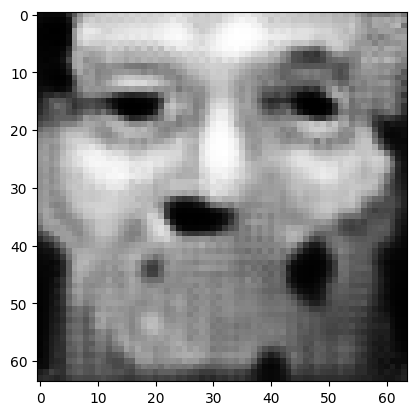

tensor([[5.3348e-03, 3.8825e-04, 5.5565e-02, 2.4504e-02, 9.4934e-02, 3.9864e-01,
         1.3987e-02, 8.4108e-03, 2.7460e-03, 1.8738e-02, 2.0540e-03, 1.5422e-03,
         5.1158e-02, 1.8785e-03, 4.4890e-04, 6.7614e-02, 7.5142e-03, 1.2311e-03,
         2.3016e-04, 3.9623e-04, 4.3526e-04, 1.1269e-02, 5.6544e-02, 7.2058e-05,
         5.5774e-03, 1.8252e-03, 9.8414e-04, 1.1361e-03, 9.0123e-04, 1.6599e-03,
         4.8955e-04, 2.0978e-02, 2.8411e-02, 1.4309e-03, 1.3203e-03, 5.1555e-03,
         4.2050e-03, 9.8657e-02, 3.0594e-04, 1.3262e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9196944236755371
tensor([[5.3362e-03, 3.8815e-04, 5.5534e-02, 2.4498e-02, 9.4898e-02, 3.9889e-01,
         1.3984e-02, 8.4114e-03, 2.7440e-03, 1.8729e-02, 2.0527e-03, 1.5413e-03,
         5.1134e-02, 1.8772e-03, 4.4860e-04, 6.7589e-02, 7.5100e-03, 1.2308e-03,
         2.3007e-04, 3.9613e-04, 4.3481e-04, 1.1263e-02, 5.6518e-02, 7.2013e-05,
         5.5723e-03, 1.8246e-03, 9.8343e-04

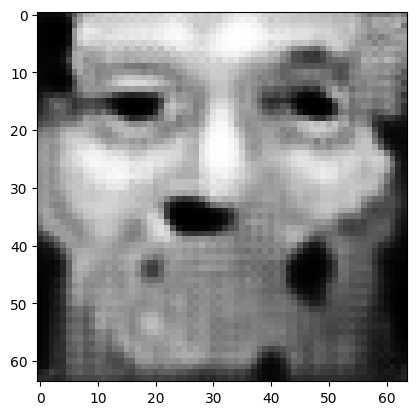

tensor([[5.3421e-03, 3.8778e-04, 5.5409e-02, 2.4471e-02, 9.4747e-02, 3.9984e-01,
         1.3973e-02, 8.4147e-03, 2.7364e-03, 1.8697e-02, 2.0481e-03, 1.5377e-03,
         5.1045e-02, 1.8720e-03, 4.4746e-04, 6.7500e-02, 7.4938e-03, 1.2296e-03,
         2.2974e-04, 3.9574e-04, 4.3307e-04, 1.1241e-02, 5.6411e-02, 7.1847e-05,
         5.5539e-03, 1.8218e-03, 9.8084e-04, 1.1319e-03, 8.9895e-04, 1.6552e-03,
         4.8762e-04, 2.0943e-02, 2.8366e-02, 1.4270e-03, 1.3165e-03, 5.1514e-03,
         4.1966e-03, 9.8464e-02, 3.0499e-04, 1.3222e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.916683554649353
tensor([[5.3436e-03, 3.8769e-04, 5.5378e-02, 2.4465e-02, 9.4711e-02, 4.0008e-01,
         1.3971e-02, 8.4155e-03, 2.7345e-03, 1.8690e-02, 2.0469e-03, 1.5368e-03,
         5.1023e-02, 1.8707e-03, 4.4718e-04, 6.7478e-02, 7.4899e-03, 1.2293e-03,
         2.2966e-04, 3.9565e-04, 4.3264e-04, 1.1236e-02, 5.6385e-02, 7.1807e-05,
         5.5494e-03, 1.8212e-03, 9.8021e-04,

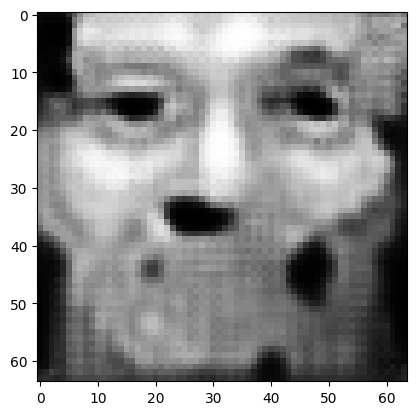

tensor([[5.3491e-03, 3.8733e-04, 5.5260e-02, 2.4440e-02, 9.4568e-02, 4.0098e-01,
         1.3961e-02, 8.4183e-03, 2.7273e-03, 1.8659e-02, 2.0424e-03, 1.5335e-03,
         5.0939e-02, 1.8659e-03, 4.4608e-04, 6.7390e-02, 7.4749e-03, 1.2282e-03,
         2.2934e-04, 3.9528e-04, 4.3098e-04, 1.1215e-02, 5.6286e-02, 7.1647e-05,
         5.5318e-03, 1.8186e-03, 9.7774e-04, 1.1279e-03, 8.9681e-04, 1.6507e-03,
         4.8580e-04, 2.0909e-02, 2.8323e-02, 1.4232e-03, 1.3128e-03, 5.1474e-03,
         4.1887e-03, 9.8281e-02, 3.0410e-04, 1.3184e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9138375520706177
tensor([[5.3505e-03, 3.8725e-04, 5.5231e-02, 2.4434e-02, 9.4535e-02, 4.0120e-01,
         1.3958e-02, 8.4190e-03, 2.7255e-03, 1.8652e-02, 2.0413e-03, 1.5326e-03,
         5.0919e-02, 1.8647e-03, 4.4582e-04, 6.7369e-02, 7.4710e-03, 1.2279e-03,
         2.2926e-04, 3.9519e-04, 4.3058e-04, 1.1210e-02, 5.6261e-02, 7.1608e-05,
         5.5275e-03, 1.8180e-03, 9.7713e-04

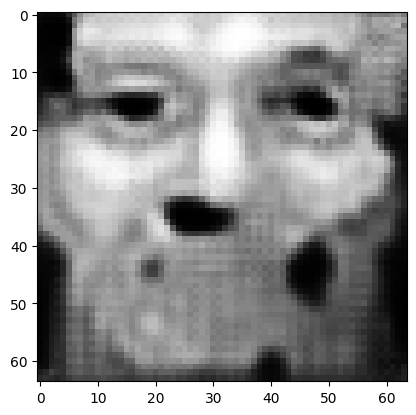

tensor([[5.3557e-03, 3.8692e-04, 5.5120e-02, 2.4410e-02, 9.4400e-02, 4.0206e-01,
         1.3948e-02, 8.4217e-03, 2.7187e-03, 1.8623e-02, 2.0371e-03, 1.5295e-03,
         5.0837e-02, 1.8601e-03, 4.4478e-04, 6.7287e-02, 7.4567e-03, 1.2268e-03,
         2.2896e-04, 3.9484e-04, 4.2903e-04, 1.1191e-02, 5.6165e-02, 7.1458e-05,
         5.5109e-03, 1.8156e-03, 9.7479e-04, 1.1241e-03, 8.9477e-04, 1.6464e-03,
         4.8408e-04, 2.0878e-02, 2.8283e-02, 1.4197e-03, 1.3094e-03, 5.1436e-03,
         4.1811e-03, 9.8110e-02, 3.0325e-04, 1.3149e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9111445546150208
tensor([[5.3571e-03, 3.8684e-04, 5.5092e-02, 2.4404e-02, 9.4367e-02, 4.0227e-01,
         1.3946e-02, 8.4225e-03, 2.7170e-03, 1.8616e-02, 2.0360e-03, 1.5287e-03,
         5.0818e-02, 1.8590e-03, 4.4453e-04, 6.7268e-02, 7.4532e-03, 1.2265e-03,
         2.2889e-04, 3.9475e-04, 4.2865e-04, 1.1186e-02, 5.6140e-02, 7.1421e-05,
         5.5070e-03, 1.8150e-03, 9.7423e-04

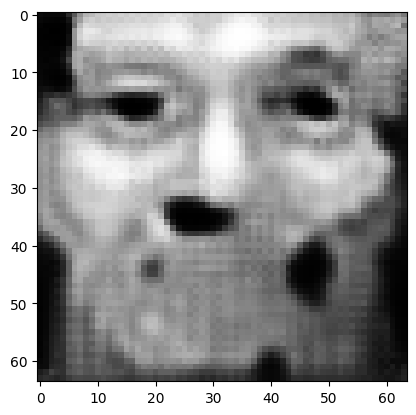

tensor([[5.3620e-03, 3.8652e-04, 5.4987e-02, 2.4382e-02, 9.4239e-02, 4.0309e-01,
         1.3936e-02, 8.4248e-03, 2.7104e-03, 1.8588e-02, 2.0320e-03, 1.5256e-03,
         5.0743e-02, 1.8546e-03, 4.4355e-04, 6.7188e-02, 7.4394e-03, 1.2255e-03,
         2.2860e-04, 3.9441e-04, 4.2718e-04, 1.1167e-02, 5.6051e-02, 7.1275e-05,
         5.4911e-03, 1.8127e-03, 9.7199e-04, 1.1205e-03, 8.9283e-04, 1.6424e-03,
         4.8244e-04, 2.0847e-02, 2.8244e-02, 1.4163e-03, 1.3061e-03, 5.1399e-03,
         4.1740e-03, 9.7946e-02, 3.0244e-04, 1.3115e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9085873961448669
tensor([[5.3632e-03, 3.8645e-04, 5.4962e-02, 2.4376e-02, 9.4208e-02, 4.0329e-01,
         1.3934e-02, 8.4254e-03, 2.7088e-03, 1.8581e-02, 2.0310e-03, 1.5249e-03,
         5.0724e-02, 1.8536e-03, 4.4331e-04, 6.7170e-02, 7.4361e-03, 1.2252e-03,
         2.2852e-04, 3.9433e-04, 4.2683e-04, 1.1163e-02, 5.6027e-02, 7.1240e-05,
         5.4874e-03, 1.8122e-03, 9.7145e-04

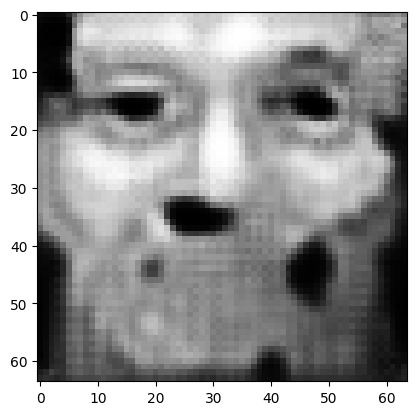

tensor([[5.3679e-03, 3.8614e-04, 5.4860e-02, 2.4354e-02, 9.4089e-02, 4.0406e-01,
         1.3923e-02, 8.4281e-03, 2.7025e-03, 1.8555e-02, 2.0272e-03, 1.5221e-03,
         5.0651e-02, 1.8495e-03, 4.4242e-04, 6.7095e-02, 7.4231e-03, 1.2243e-03,
         2.2824e-04, 3.9400e-04, 4.2547e-04, 1.1145e-02, 5.5943e-02, 7.1106e-05,
         5.4727e-03, 1.8100e-03, 9.6934e-04, 1.1171e-03, 8.9099e-04, 1.6387e-03,
         4.8091e-04, 2.0819e-02, 2.8207e-02, 1.4131e-03, 1.3031e-03, 5.1364e-03,
         4.1672e-03, 9.7794e-02, 3.0169e-04, 1.3083e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9061840772628784
tensor([[5.3690e-03, 3.8607e-04, 5.4836e-02, 2.4348e-02, 9.4061e-02, 4.0425e-01,
         1.3921e-02, 8.4286e-03, 2.7010e-03, 1.8549e-02, 2.0263e-03, 1.5214e-03,
         5.0633e-02, 1.8485e-03, 4.4220e-04, 6.7076e-02, 7.4199e-03, 1.2241e-03,
         2.2817e-04, 3.9393e-04, 4.2514e-04, 1.1141e-02, 5.5923e-02, 7.1072e-05,
         5.4690e-03, 1.8095e-03, 9.6881e-04

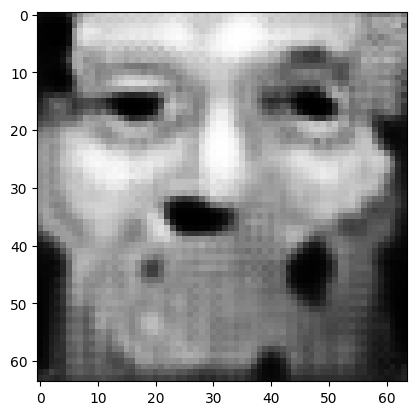

tensor([[5.3736e-03, 3.8579e-04, 5.4739e-02, 2.4327e-02, 9.3948e-02, 4.0498e-01,
         1.3911e-02, 8.4312e-03, 2.6950e-03, 1.8524e-02, 2.0227e-03, 1.5187e-03,
         5.0565e-02, 1.8447e-03, 4.4136e-04, 6.7006e-02, 7.4075e-03, 1.2232e-03,
         2.2791e-04, 3.9361e-04, 4.2386e-04, 1.1123e-02, 5.5842e-02, 7.0945e-05,
         5.4552e-03, 1.8075e-03, 9.6681e-04, 1.1138e-03, 8.8924e-04, 1.6351e-03,
         4.7947e-04, 2.0793e-02, 2.8173e-02, 1.4102e-03, 1.3002e-03, 5.1332e-03,
         4.1608e-03, 9.7649e-02, 3.0098e-04, 1.3052e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9039102792739868
tensor([[5.3746e-03, 3.8572e-04, 5.4717e-02, 2.4322e-02, 9.3920e-02, 4.0516e-01,
         1.3908e-02, 8.4317e-03, 2.6936e-03, 1.8518e-02, 2.0218e-03, 1.5180e-03,
         5.0548e-02, 1.8438e-03, 4.4115e-04, 6.6988e-02, 7.4045e-03, 1.2229e-03,
         2.2784e-04, 3.9354e-04, 4.2356e-04, 1.1119e-02, 5.5823e-02, 7.0914e-05,
         5.4517e-03, 1.8070e-03, 9.6631e-04

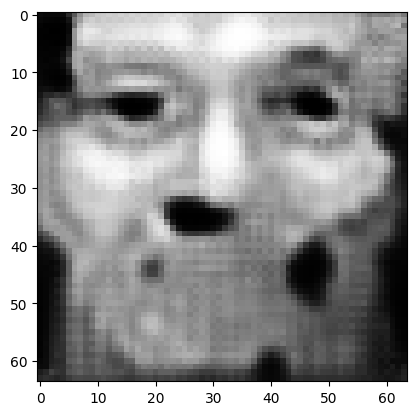

tensor([[5.3792e-03, 3.8546e-04, 5.4627e-02, 2.4302e-02, 9.3812e-02, 4.0585e-01,
         1.3899e-02, 8.4341e-03, 2.6878e-03, 1.8494e-02, 2.0184e-03, 1.5156e-03,
         5.0482e-02, 1.8403e-03, 4.4035e-04, 6.6920e-02, 7.3928e-03, 1.2221e-03,
         2.2759e-04, 3.9324e-04, 4.2237e-04, 1.1103e-02, 5.5747e-02, 7.0794e-05,
         5.4387e-03, 1.8051e-03, 9.6442e-04, 1.1108e-03, 8.8759e-04, 1.6318e-03,
         4.7811e-04, 2.0768e-02, 2.8140e-02, 1.4075e-03, 1.2976e-03, 5.1300e-03,
         4.1549e-03, 9.7512e-02, 3.0031e-04, 1.3023e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.901761531829834
tensor([[5.3803e-03, 3.8540e-04, 5.4605e-02, 2.4298e-02, 9.3785e-02, 4.0602e-01,
         1.3897e-02, 8.4348e-03, 2.6864e-03, 1.8488e-02, 2.0176e-03, 1.5149e-03,
         5.0466e-02, 1.8394e-03, 4.4017e-04, 6.6904e-02, 7.3899e-03, 1.2219e-03,
         2.2753e-04, 3.9317e-04, 4.2208e-04, 1.1099e-02, 5.5729e-02, 7.0765e-05,
         5.4354e-03, 1.8047e-03, 9.6396e-04,

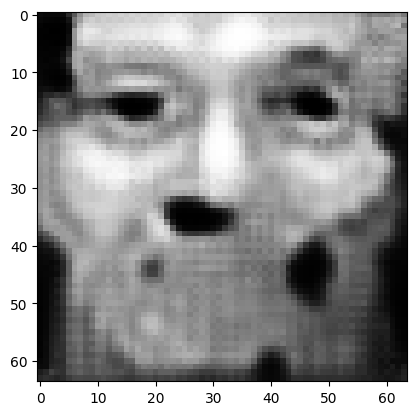

tensor([[5.3846e-03, 3.8516e-04, 5.4519e-02, 2.4279e-02, 9.3682e-02, 4.0668e-01,
         1.3888e-02, 8.4370e-03, 2.6811e-03, 1.8466e-02, 2.0143e-03, 1.5126e-03,
         5.0404e-02, 1.8361e-03, 4.3942e-04, 6.6840e-02, 7.3787e-03, 1.2211e-03,
         2.2730e-04, 3.9289e-04, 4.2095e-04, 1.1084e-02, 5.5657e-02, 7.0652e-05,
         5.4229e-03, 1.8028e-03, 9.6217e-04, 1.1078e-03, 8.8605e-04, 1.6286e-03,
         4.7681e-04, 2.0744e-02, 2.8109e-02, 1.4049e-03, 1.2951e-03, 5.1270e-03,
         4.1493e-03, 9.7381e-02, 2.9968e-04, 1.2996e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8997222185134888
tensor([[5.3856e-03, 3.8510e-04, 5.4499e-02, 2.4275e-02, 9.3656e-02, 4.0684e-01,
         1.3886e-02, 8.4376e-03, 2.6798e-03, 1.8460e-02, 2.0136e-03, 1.5120e-03,
         5.0389e-02, 1.8352e-03, 4.3924e-04, 6.6824e-02, 7.3760e-03, 1.2209e-03,
         2.2724e-04, 3.9283e-04, 4.2068e-04, 1.1080e-02, 5.5640e-02, 7.0625e-05,
         5.4198e-03, 1.8024e-03, 9.6174e-04

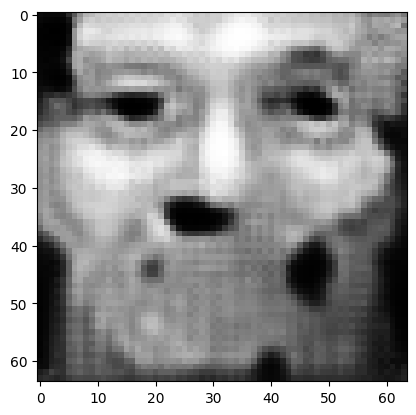

tensor([[5.3897e-03, 3.8487e-04, 5.4417e-02, 2.4258e-02, 9.3558e-02, 4.0747e-01,
         1.3877e-02, 8.4396e-03, 2.6746e-03, 1.8439e-02, 2.0105e-03, 1.5098e-03,
         5.0330e-02, 1.8321e-03, 4.3854e-04, 6.6762e-02, 7.3651e-03, 1.2202e-03,
         2.2701e-04, 3.9257e-04, 4.1961e-04, 1.1066e-02, 5.5573e-02, 7.0517e-05,
         5.4077e-03, 1.8007e-03, 9.6003e-04, 1.1051e-03, 8.8457e-04, 1.6255e-03,
         4.7558e-04, 2.0721e-02, 2.8079e-02, 1.4025e-03, 1.2927e-03, 5.1241e-03,
         4.1440e-03, 9.7255e-02, 2.9908e-04, 1.2970e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8977866768836975
tensor([[5.3906e-03, 3.8481e-04, 5.4398e-02, 2.4254e-02, 9.3534e-02, 4.0762e-01,
         1.3875e-02, 8.4402e-03, 2.6734e-03, 1.8434e-02, 2.0097e-03, 1.5092e-03,
         5.0315e-02, 1.8312e-03, 4.3837e-04, 6.6748e-02, 7.3625e-03, 1.2200e-03,
         2.2696e-04, 3.9251e-04, 4.1935e-04, 1.1062e-02, 5.5557e-02, 7.0492e-05,
         5.4048e-03, 1.8003e-03, 9.5962e-04

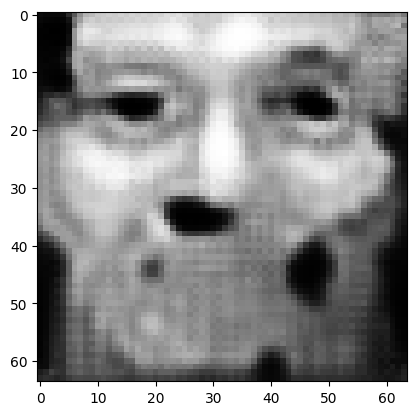

tensor([[5.3945e-03, 3.8458e-04, 5.4321e-02, 2.4237e-02, 9.3440e-02, 4.0822e-01,
         1.3867e-02, 8.4421e-03, 2.6685e-03, 1.8414e-02, 2.0068e-03, 1.5071e-03,
         5.0260e-02, 1.8282e-03, 4.3770e-04, 6.6689e-02, 7.3523e-03, 1.2193e-03,
         2.2674e-04, 3.9226e-04, 4.1834e-04, 1.1049e-02, 5.5494e-02, 7.0390e-05,
         5.3935e-03, 1.7987e-03, 9.5800e-04, 1.1025e-03, 8.8318e-04, 1.6226e-03,
         4.7440e-04, 2.0700e-02, 2.8051e-02, 1.4001e-03, 1.2904e-03, 5.1213e-03,
         4.1389e-03, 9.7135e-02, 2.9851e-04, 1.2945e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8959499597549438
tensor([[5.3954e-03, 3.8453e-04, 5.4302e-02, 2.4234e-02, 9.3416e-02, 4.0836e-01,
         1.3865e-02, 8.4427e-03, 2.6674e-03, 1.8409e-02, 2.0061e-03, 1.5065e-03,
         5.0246e-02, 1.8274e-03, 4.3754e-04, 6.6676e-02, 7.3498e-03, 1.2191e-03,
         2.2669e-04, 3.9220e-04, 4.1810e-04, 1.1045e-02, 5.5478e-02, 7.0366e-05,
         5.3907e-03, 1.7982e-03, 9.5762e-04

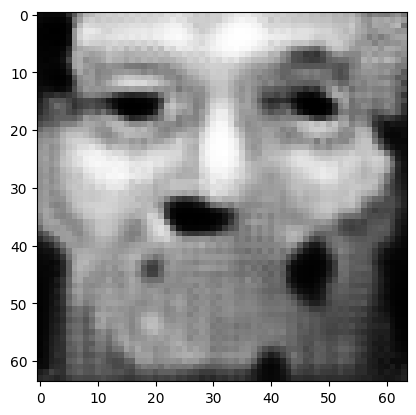

tensor([[5.3991e-03, 3.8431e-04, 5.4228e-02, 2.4218e-02, 9.3329e-02, 4.0893e-01,
         1.3857e-02, 8.4445e-03, 2.6628e-03, 1.8390e-02, 2.0033e-03, 1.5045e-03,
         5.0193e-02, 1.8246e-03, 4.3691e-04, 6.6619e-02, 7.3401e-03, 1.2184e-03,
         2.2649e-04, 3.9196e-04, 4.1714e-04, 1.1032e-02, 5.5420e-02, 7.0270e-05,
         5.3800e-03, 1.7967e-03, 9.5608e-04, 1.1000e-03, 8.8185e-04, 1.6199e-03,
         4.7329e-04, 2.0679e-02, 2.8024e-02, 1.3979e-03, 1.2882e-03, 5.1188e-03,
         4.1340e-03, 9.7020e-02, 2.9797e-04, 1.2921e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8942119479179382
tensor([[5.3998e-03, 3.8425e-04, 5.4210e-02, 2.4214e-02, 9.3309e-02, 4.0907e-01,
         1.3855e-02, 8.4449e-03, 2.6617e-03, 1.8385e-02, 2.0026e-03, 1.5040e-03,
         5.0180e-02, 1.8238e-03, 4.3676e-04, 6.6605e-02, 7.3378e-03, 1.2183e-03,
         2.2643e-04, 3.9190e-04, 4.1691e-04, 1.1029e-02, 5.5406e-02, 7.0246e-05,
         5.3775e-03, 1.7963e-03, 9.5569e-04

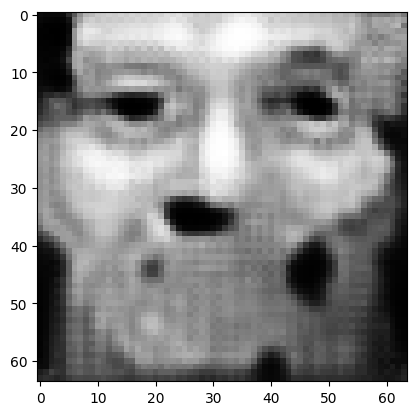

tensor([[5.4031e-03, 3.8404e-04, 5.4139e-02, 2.4198e-02, 9.3229e-02, 4.0960e-01,
         1.3847e-02, 8.4469e-03, 2.6574e-03, 1.8368e-02, 2.0000e-03, 1.5022e-03,
         5.0128e-02, 1.8211e-03, 4.3620e-04, 6.6551e-02, 7.3284e-03, 1.2177e-03,
         2.2624e-04, 3.9167e-04, 4.1602e-04, 1.1016e-02, 5.5353e-02, 7.0157e-05,
         5.3676e-03, 1.7949e-03, 9.5422e-04, 1.0976e-03, 8.8058e-04, 1.6174e-03,
         4.7225e-04, 2.0659e-02, 2.7999e-02, 1.3958e-03, 1.2863e-03, 5.1165e-03,
         4.1293e-03, 9.6913e-02, 2.9747e-04, 1.2899e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8925784826278687
tensor([[5.4039e-03, 3.8398e-04, 5.4122e-02, 2.4195e-02, 9.3209e-02, 4.0973e-01,
         1.3845e-02, 8.4474e-03, 2.6564e-03, 1.8364e-02, 1.9994e-03, 1.5017e-03,
         5.0114e-02, 1.8204e-03, 4.3606e-04, 6.6538e-02, 7.3262e-03, 1.2176e-03,
         2.2620e-04, 3.9162e-04, 4.1580e-04, 1.1013e-02, 5.5340e-02, 7.0136e-05,
         5.3652e-03, 1.7945e-03, 9.5386e-04

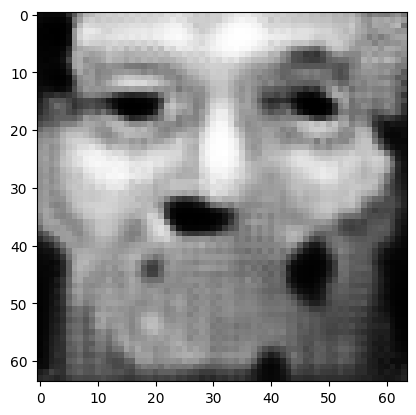

tensor([[5.4070e-03, 3.8378e-04, 5.4054e-02, 2.4180e-02, 9.3134e-02, 4.1023e-01,
         1.3838e-02, 8.4492e-03, 2.6523e-03, 1.8347e-02, 1.9969e-03, 1.4999e-03,
         5.0066e-02, 1.8178e-03, 4.3553e-04, 6.6486e-02, 7.3173e-03, 1.2170e-03,
         2.2601e-04, 3.9140e-04, 4.1496e-04, 1.1001e-02, 5.5291e-02, 7.0050e-05,
         5.3559e-03, 1.7932e-03, 9.5245e-04, 1.0953e-03, 8.7937e-04, 1.6151e-03,
         4.7126e-04, 2.0640e-02, 2.7975e-02, 1.3938e-03, 1.2845e-03, 5.1143e-03,
         4.1249e-03, 9.6811e-02, 2.9699e-04, 1.2877e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8910302519798279
tensor([[5.4077e-03, 3.8372e-04, 5.4039e-02, 2.4176e-02, 9.3116e-02, 4.1036e-01,
         1.3836e-02, 8.4496e-03, 2.6514e-03, 1.8343e-02, 1.9963e-03, 1.4995e-03,
         5.0053e-02, 1.8171e-03, 4.3539e-04, 6.6473e-02, 7.3153e-03, 1.2169e-03,
         2.2596e-04, 3.9135e-04, 4.1475e-04, 1.0999e-02, 5.5279e-02, 7.0029e-05,
         5.3536e-03, 1.7928e-03, 9.5210e-04

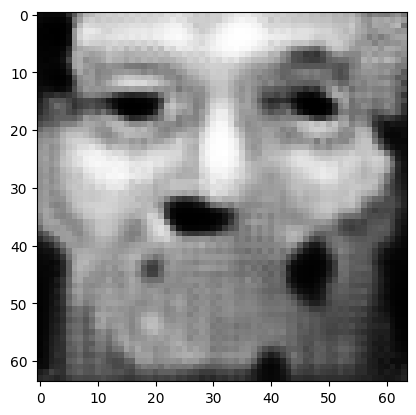

tensor([[5.4106e-03, 3.8353e-04, 5.3974e-02, 2.4162e-02, 9.3043e-02, 4.1084e-01,
         1.3828e-02, 8.4514e-03, 2.6475e-03, 1.8327e-02, 1.9940e-03, 1.4978e-03,
         5.0006e-02, 1.8146e-03, 4.3489e-04, 6.6425e-02, 7.3068e-03, 1.2163e-03,
         2.2579e-04, 3.9114e-04, 4.1395e-04, 1.0987e-02, 5.5230e-02, 6.9949e-05,
         5.3448e-03, 1.7915e-03, 9.5078e-04, 1.0932e-03, 8.7823e-04, 1.6129e-03,
         4.7033e-04, 2.0622e-02, 2.7953e-02, 1.3919e-03, 1.2828e-03, 5.1122e-03,
         4.1207e-03, 9.6714e-02, 2.9654e-04, 1.2857e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8895602822303772
tensor([[5.4113e-03, 3.8348e-04, 5.3959e-02, 2.4159e-02, 9.3026e-02, 4.1095e-01,
         1.3827e-02, 8.4519e-03, 2.6466e-03, 1.8324e-02, 1.9934e-03, 1.4974e-03,
         4.9994e-02, 1.8140e-03, 4.3477e-04, 6.6413e-02, 7.3048e-03, 1.2162e-03,
         2.2575e-04, 3.9109e-04, 4.1376e-04, 1.0985e-02, 5.5219e-02, 6.9930e-05,
         5.3426e-03, 1.7912e-03, 9.5046e-04

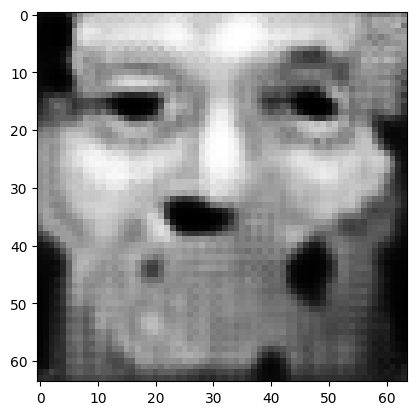

tensor([[5.4141e-03, 3.8330e-04, 5.3898e-02, 2.4145e-02, 9.2958e-02, 4.1141e-01,
         1.3820e-02, 8.4534e-03, 2.6430e-03, 1.8309e-02, 1.9912e-03, 1.4958e-03,
         4.9950e-02, 1.8117e-03, 4.3428e-04, 6.6366e-02, 7.2968e-03, 1.2157e-03,
         2.2558e-04, 3.9090e-04, 4.1300e-04, 1.0974e-02, 5.5174e-02, 6.9853e-05,
         5.3342e-03, 1.7900e-03, 9.4919e-04, 1.0912e-03, 8.7714e-04, 1.6107e-03,
         4.6944e-04, 2.0606e-02, 2.7932e-02, 1.3901e-03, 1.2812e-03, 5.1102e-03,
         4.1167e-03, 9.6622e-02, 2.9611e-04, 1.2838e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.888166069984436
tensor([[5.4147e-03, 3.8325e-04, 5.3884e-02, 2.4142e-02, 9.2940e-02, 4.1152e-01,
         1.3818e-02, 8.4538e-03, 2.6421e-03, 1.8305e-02, 1.9906e-03, 1.4954e-03,
         4.9939e-02, 1.8111e-03, 4.3416e-04, 6.6354e-02, 7.2949e-03, 1.2156e-03,
         2.2554e-04, 3.9085e-04, 4.1282e-04, 1.0971e-02, 5.5164e-02, 6.9834e-05,
         5.3322e-03, 1.7897e-03, 9.4888e-04,

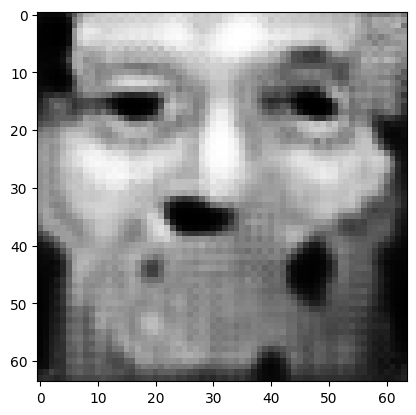

tensor([[5.4174e-03, 3.8308e-04, 5.3826e-02, 2.4129e-02, 9.2876e-02, 4.1195e-01,
         1.3812e-02, 8.4554e-03, 2.6386e-03, 1.8291e-02, 1.9885e-03, 1.4939e-03,
         4.9896e-02, 1.8088e-03, 4.3371e-04, 6.6310e-02, 7.2873e-03, 1.2151e-03,
         2.2538e-04, 3.9066e-04, 4.1210e-04, 1.0961e-02, 5.5120e-02, 6.9762e-05,
         5.3243e-03, 1.7885e-03, 9.4768e-04, 1.0892e-03, 8.7611e-04, 1.6087e-03,
         4.6860e-04, 2.0589e-02, 2.7911e-02, 1.3884e-03, 1.2796e-03, 5.1082e-03,
         4.1129e-03, 9.6535e-02, 2.9570e-04, 1.2820e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8868429660797119
tensor([[5.4180e-03, 3.8303e-04, 5.3812e-02, 2.4126e-02, 9.2860e-02, 4.1206e-01,
         1.3810e-02, 8.4557e-03, 2.6378e-03, 1.8287e-02, 1.9880e-03, 1.4935e-03,
         4.9886e-02, 1.8083e-03, 4.3359e-04, 6.6299e-02, 7.2855e-03, 1.2150e-03,
         2.2534e-04, 3.9062e-04, 4.1192e-04, 1.0959e-02, 5.5110e-02, 6.9744e-05,
         5.3223e-03, 1.7882e-03, 9.4739e-04

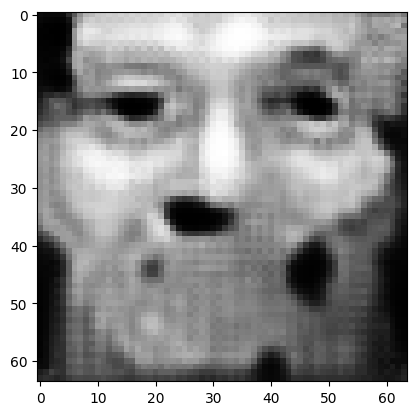

tensor([[5.4205e-03, 3.8287e-04, 5.3756e-02, 2.4113e-02, 9.2800e-02, 4.1247e-01,
         1.3804e-02, 8.4572e-03, 2.6345e-03, 1.8274e-02, 1.9860e-03, 1.4921e-03,
         4.9845e-02, 1.8062e-03, 4.3316e-04, 6.6257e-02, 7.2784e-03, 1.2145e-03,
         2.2519e-04, 3.9044e-04, 4.1124e-04, 1.0949e-02, 5.5068e-02, 6.9674e-05,
         5.3148e-03, 1.7871e-03, 9.4624e-04, 1.0874e-03, 8.7512e-04, 1.6068e-03,
         4.6780e-04, 2.0574e-02, 2.7892e-02, 1.3868e-03, 1.2782e-03, 5.1065e-03,
         4.1092e-03, 9.6452e-02, 2.9531e-04, 1.2804e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.885588526725769
tensor([[5.4211e-03, 3.8282e-04, 5.3743e-02, 2.4111e-02, 9.2786e-02, 4.1257e-01,
         1.3802e-02, 8.4574e-03, 2.6337e-03, 1.8270e-02, 1.9855e-03, 1.4918e-03,
         4.9836e-02, 1.8056e-03, 4.3304e-04, 6.6246e-02, 7.2767e-03, 1.2144e-03,
         2.2515e-04, 3.9039e-04, 4.1107e-04, 1.0947e-02, 5.5059e-02, 6.9657e-05,
         5.3129e-03, 1.7868e-03, 9.4595e-04,

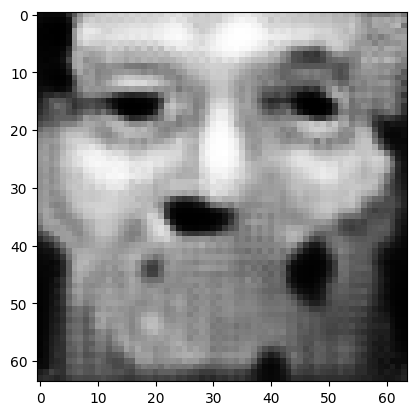

tensor([[5.4235e-03, 3.8267e-04, 5.3689e-02, 2.4099e-02, 9.2730e-02, 4.1296e-01,
         1.3796e-02, 8.4588e-03, 2.6305e-03, 1.8257e-02, 1.9836e-03, 1.4904e-03,
         4.9796e-02, 1.8036e-03, 4.3263e-04, 6.6206e-02, 7.2698e-03, 1.2140e-03,
         2.2501e-04, 3.9022e-04, 4.1043e-04, 1.0938e-02, 5.5019e-02, 6.9591e-05,
         5.3057e-03, 1.7858e-03, 9.4485e-04, 1.0857e-03, 8.7417e-04, 1.6050e-03,
         4.6705e-04, 2.0560e-02, 2.7874e-02, 1.3853e-03, 1.2768e-03, 5.1048e-03,
         4.1058e-03, 9.6374e-02, 2.9495e-04, 1.2788e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8843982219696045
tensor([[5.4240e-03, 3.8263e-04, 5.3676e-02, 2.4096e-02, 9.2716e-02, 4.1306e-01,
         1.3795e-02, 8.4590e-03, 2.6298e-03, 1.8254e-02, 1.9831e-03, 1.4901e-03,
         4.9787e-02, 1.8031e-03, 4.3253e-04, 6.6196e-02, 7.2682e-03, 1.2139e-03,
         2.2497e-04, 3.9018e-04, 4.1027e-04, 1.0935e-02, 5.5010e-02, 6.9574e-05,
         5.3039e-03, 1.7855e-03, 9.4458e-04

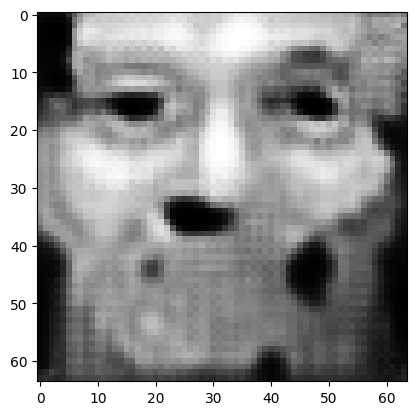

tensor([[5.4263e-03, 3.8249e-04, 5.3626e-02, 2.4085e-02, 9.2663e-02, 4.1343e-01,
         1.3789e-02, 8.4603e-03, 2.6268e-03, 1.8241e-02, 1.9813e-03, 1.4888e-03,
         4.9750e-02, 1.8012e-03, 4.3214e-04, 6.6158e-02, 7.2618e-03, 1.2135e-03,
         2.2483e-04, 3.9002e-04, 4.0966e-04, 1.0927e-02, 5.4972e-02, 6.9512e-05,
         5.2972e-03, 1.7845e-03, 9.4355e-04, 1.0840e-03, 8.7327e-04, 1.6033e-03,
         4.6634e-04, 2.0546e-02, 2.7856e-02, 1.3838e-03, 1.2755e-03, 5.1032e-03,
         4.1025e-03, 9.6300e-02, 2.9460e-04, 1.2772e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8832687139511108
tensor([[5.4268e-03, 3.8245e-04, 5.3614e-02, 2.4082e-02, 9.2649e-02, 4.1352e-01,
         1.3787e-02, 8.4606e-03, 2.6261e-03, 1.8238e-02, 1.9809e-03, 1.4885e-03,
         4.9741e-02, 1.8008e-03, 4.3204e-04, 6.6148e-02, 7.2603e-03, 1.2134e-03,
         2.2480e-04, 3.8998e-04, 4.0951e-04, 1.0925e-02, 5.4963e-02, 6.9497e-05,
         5.2955e-03, 1.7843e-03, 9.4330e-04

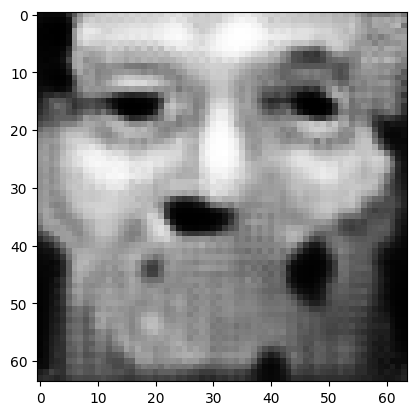

tensor([[5.4290e-03, 3.8231e-04, 5.3566e-02, 2.4071e-02, 9.2598e-02, 4.1387e-01,
         1.3782e-02, 8.4617e-03, 2.6233e-03, 1.8226e-02, 1.9791e-03, 1.4872e-03,
         4.9706e-02, 1.7990e-03, 4.3166e-04, 6.6112e-02, 7.2542e-03, 1.2130e-03,
         2.2467e-04, 3.8983e-04, 4.0893e-04, 1.0916e-02, 5.4928e-02, 6.9436e-05,
         5.2890e-03, 1.7833e-03, 9.4230e-04, 1.0825e-03, 8.7242e-04, 1.6016e-03,
         4.6566e-04, 2.0533e-02, 2.7840e-02, 1.3824e-03, 1.2743e-03, 5.1016e-03,
         4.0995e-03, 9.6230e-02, 2.9427e-04, 1.2758e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8821966052055359
tensor([[5.4295e-03, 3.8227e-04, 5.3554e-02, 2.4068e-02, 9.2585e-02, 4.1396e-01,
         1.3781e-02, 8.4620e-03, 2.6226e-03, 1.8224e-02, 1.9787e-03, 1.4869e-03,
         4.9698e-02, 1.7985e-03, 4.3157e-04, 6.6103e-02, 7.2527e-03, 1.2129e-03,
         2.2464e-04, 3.8979e-04, 4.0878e-04, 1.0914e-02, 5.4919e-02, 6.9422e-05,
         5.2875e-03, 1.7831e-03, 9.4207e-04

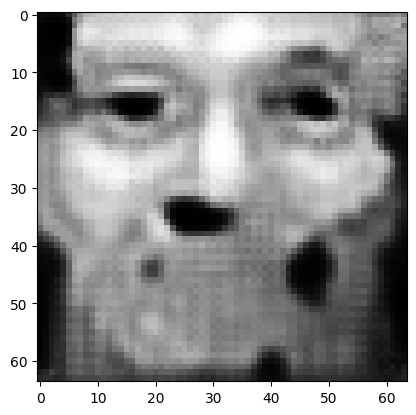

tensor([[5.4316e-03, 3.8214e-04, 5.3509e-02, 2.4058e-02, 9.2537e-02, 4.1429e-01,
         1.3776e-02, 8.4630e-03, 2.6199e-03, 1.8212e-02, 1.9771e-03, 1.4858e-03,
         4.9665e-02, 1.7968e-03, 4.3121e-04, 6.6069e-02, 7.2470e-03, 1.2125e-03,
         2.2451e-04, 3.8964e-04, 4.0823e-04, 1.0906e-02, 5.4885e-02, 6.9365e-05,
         5.2813e-03, 1.7822e-03, 9.4113e-04, 1.0810e-03, 8.7162e-04, 1.6001e-03,
         4.6502e-04, 2.0521e-02, 2.7824e-02, 1.3811e-03, 1.2731e-03, 5.1001e-03,
         4.0965e-03, 9.6164e-02, 2.9395e-04, 1.2744e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.881178081035614
tensor([[5.4321e-03, 3.8210e-04, 5.3498e-02, 2.4056e-02, 9.2525e-02, 4.1438e-01,
         1.3774e-02, 8.4634e-03, 2.6193e-03, 1.8210e-02, 1.9767e-03, 1.4855e-03,
         4.9657e-02, 1.7964e-03, 4.3112e-04, 6.6060e-02, 7.2456e-03, 1.2124e-03,
         2.2448e-04, 3.8961e-04, 4.0810e-04, 1.0905e-02, 5.4877e-02, 6.9352e-05,
         5.2799e-03, 1.7820e-03, 9.4090e-04,

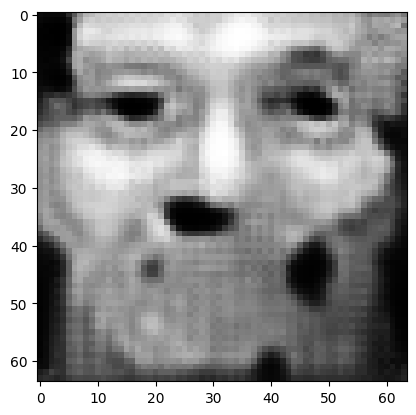

tensor([[5.4340e-03, 3.8198e-04, 5.3454e-02, 2.4046e-02, 9.2479e-02, 4.1470e-01,
         1.3769e-02, 8.4644e-03, 2.6167e-03, 1.8199e-02, 1.9752e-03, 1.4844e-03,
         4.9625e-02, 1.7948e-03, 4.3078e-04, 6.6028e-02, 7.2401e-03, 1.2121e-03,
         2.2436e-04, 3.8947e-04, 4.0757e-04, 1.0897e-02, 5.4844e-02, 6.9298e-05,
         5.2740e-03, 1.7811e-03, 9.4001e-04, 1.0796e-03, 8.7085e-04, 1.5986e-03,
         4.6441e-04, 2.0509e-02, 2.7809e-02, 1.3799e-03, 1.2720e-03, 5.0987e-03,
         4.0937e-03, 9.6100e-02, 2.9366e-04, 1.2731e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8802114725112915
tensor([[5.4345e-03, 3.8195e-04, 5.3444e-02, 2.4044e-02, 9.2467e-02, 4.1477e-01,
         1.3768e-02, 8.4646e-03, 2.6161e-03, 1.8196e-02, 1.9748e-03, 1.4841e-03,
         4.9617e-02, 1.7944e-03, 4.3070e-04, 6.6020e-02, 7.2388e-03, 1.2120e-03,
         2.2434e-04, 3.8943e-04, 4.0744e-04, 1.0895e-02, 5.4837e-02, 6.9285e-05,
         5.2726e-03, 1.7809e-03, 9.3980e-04

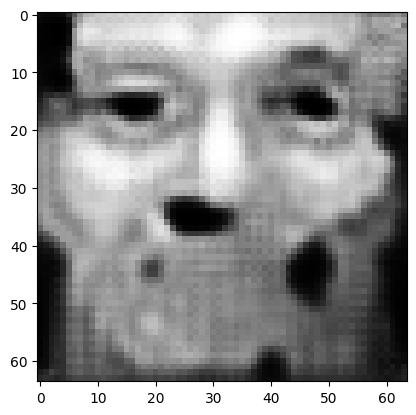

tensor([[5.4364e-03, 3.8183e-04, 5.3403e-02, 2.4034e-02, 9.2423e-02, 4.1508e-01,
         1.3764e-02, 8.4656e-03, 2.6137e-03, 1.8186e-02, 1.9733e-03, 1.4831e-03,
         4.9587e-02, 1.7928e-03, 4.3038e-04, 6.5989e-02, 7.2336e-03, 1.2117e-03,
         2.2422e-04, 3.8930e-04, 4.0695e-04, 1.0888e-02, 5.4806e-02, 6.9234e-05,
         5.2672e-03, 1.7801e-03, 9.3895e-04, 1.0782e-03, 8.7013e-04, 1.5972e-03,
         4.6383e-04, 2.0498e-02, 2.7795e-02, 1.3787e-03, 1.2709e-03, 5.0974e-03,
         4.0911e-03, 9.6041e-02, 2.9337e-04, 1.2719e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8792929649353027
tensor([[5.4368e-03, 3.8180e-04, 5.3393e-02, 2.4032e-02, 9.2411e-02, 4.1515e-01,
         1.3762e-02, 8.4659e-03, 2.6131e-03, 1.8184e-02, 1.9730e-03, 1.4828e-03,
         4.9580e-02, 1.7924e-03, 4.3030e-04, 6.5981e-02, 7.2323e-03, 1.2116e-03,
         2.2420e-04, 3.8927e-04, 4.0683e-04, 1.0886e-02, 5.4799e-02, 6.9222e-05,
         5.2658e-03, 1.7799e-03, 9.3875e-04

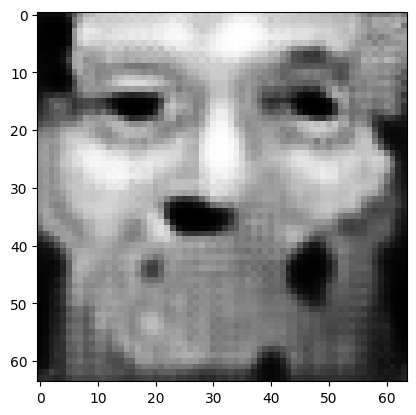

tensor([[5.4386e-03, 3.8168e-04, 5.3354e-02, 2.4023e-02, 9.2370e-02, 4.1544e-01,
         1.3758e-02, 8.4668e-03, 2.6108e-03, 1.8174e-02, 1.9716e-03, 1.4818e-03,
         4.9551e-02, 1.7910e-03, 4.2999e-04, 6.5951e-02, 7.2274e-03, 1.2113e-03,
         2.2409e-04, 3.8915e-04, 4.0635e-04, 1.0880e-02, 5.4769e-02, 6.9173e-05,
         5.2605e-03, 1.7791e-03, 9.3795e-04, 1.0769e-03, 8.6944e-04, 1.5959e-03,
         4.6328e-04, 2.0488e-02, 2.7781e-02, 1.3776e-03, 1.2699e-03, 5.0961e-03,
         4.0885e-03, 9.5984e-02, 2.9311e-04, 1.2707e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8784208297729492
tensor([[5.4390e-03, 3.8166e-04, 5.3345e-02, 2.4021e-02, 9.2359e-02, 4.1551e-01,
         1.3757e-02, 8.4671e-03, 2.6102e-03, 1.8172e-02, 1.9712e-03, 1.4815e-03,
         4.9545e-02, 1.7906e-03, 4.2992e-04, 6.5944e-02, 7.2262e-03, 1.2112e-03,
         2.2406e-04, 3.8912e-04, 4.0624e-04, 1.0878e-02, 5.4763e-02, 6.9161e-05,
         5.2593e-03, 1.7789e-03, 9.3776e-04

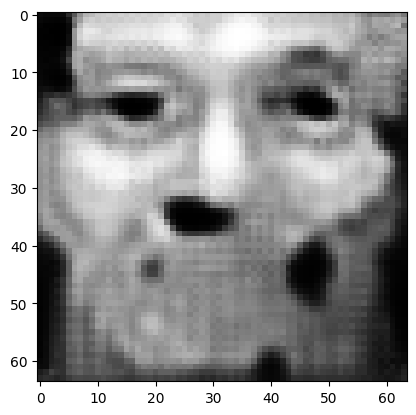

tensor([[5.4407e-03, 3.8155e-04, 5.3308e-02, 2.4013e-02, 9.2319e-02, 4.1578e-01,
         1.3753e-02, 8.4679e-03, 2.6081e-03, 1.8162e-02, 1.9699e-03, 1.4806e-03,
         4.9517e-02, 1.7892e-03, 4.2963e-04, 6.5916e-02, 7.2215e-03, 1.2109e-03,
         2.2396e-04, 3.8900e-04, 4.0579e-04, 1.0872e-02, 5.4735e-02, 6.9115e-05,
         5.2543e-03, 1.7781e-03, 9.3699e-04, 1.0757e-03, 8.6879e-04, 1.5946e-03,
         4.6276e-04, 2.0478e-02, 2.7768e-02, 1.3765e-03, 1.2689e-03, 5.0949e-03,
         4.0862e-03, 9.5930e-02, 2.9285e-04, 1.2696e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8775933980941772
tensor([[5.4411e-03, 3.8152e-04, 5.3299e-02, 2.4011e-02, 9.2309e-02, 4.1585e-01,
         1.3752e-02, 8.4682e-03, 2.6075e-03, 1.8160e-02, 1.9696e-03, 1.4804e-03,
         4.9511e-02, 1.7889e-03, 4.2956e-04, 6.5909e-02, 7.2203e-03, 1.2108e-03,
         2.2394e-04, 3.8897e-04, 4.0568e-04, 1.0870e-02, 5.4728e-02, 6.9104e-05,
         5.2531e-03, 1.7780e-03, 9.3681e-04

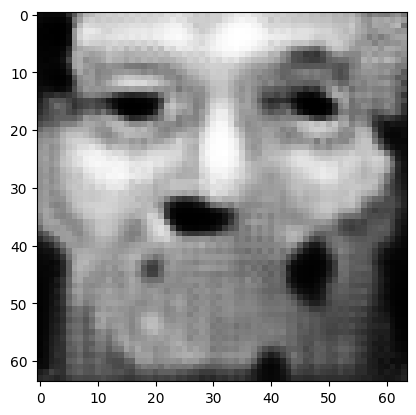

tensor([[5.4427e-03, 3.8142e-04, 5.3264e-02, 2.4003e-02, 9.2270e-02, 4.1611e-01,
         1.3748e-02, 8.4690e-03, 2.6055e-03, 1.8151e-02, 1.9683e-03, 1.4795e-03,
         4.9485e-02, 1.7876e-03, 4.2928e-04, 6.5882e-02, 7.2159e-03, 1.2105e-03,
         2.2384e-04, 3.8886e-04, 4.0526e-04, 1.0864e-02, 5.4702e-02, 6.9060e-05,
         5.2484e-03, 1.7773e-03, 9.3609e-04, 1.0746e-03, 8.6817e-04, 1.5934e-03,
         4.6226e-04, 2.0468e-02, 2.7756e-02, 1.3755e-03, 1.2680e-03, 5.0937e-03,
         4.0839e-03, 9.5878e-02, 2.9261e-04, 1.2685e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8768085241317749
tensor([[5.4431e-03, 3.8139e-04, 5.3256e-02, 2.4001e-02, 9.2261e-02, 4.1617e-01,
         1.3747e-02, 8.4693e-03, 2.6050e-03, 1.8149e-02, 1.9680e-03, 1.4792e-03,
         4.9479e-02, 1.7872e-03, 4.2922e-04, 6.5876e-02, 7.2148e-03, 1.2104e-03,
         2.2382e-04, 3.8883e-04, 4.0515e-04, 1.0863e-02, 5.4695e-02, 6.9050e-05,
         5.2472e-03, 1.7771e-03, 9.3592e-04

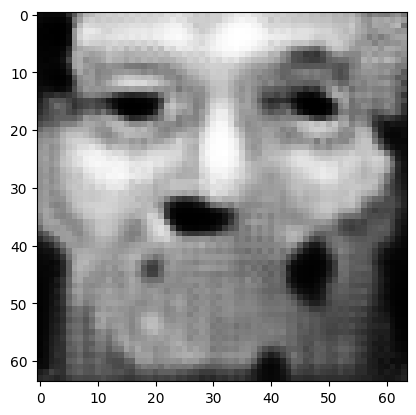

tensor([[5.4446e-03, 3.8129e-04, 5.3222e-02, 2.3993e-02, 9.2224e-02, 4.1642e-01,
         1.3743e-02, 8.4701e-03, 2.6030e-03, 1.8141e-02, 1.9668e-03, 1.4784e-03,
         4.9454e-02, 1.7860e-03, 4.2895e-04, 6.5850e-02, 7.2106e-03, 1.2102e-03,
         2.2373e-04, 3.8872e-04, 4.0475e-04, 1.0857e-02, 5.4671e-02, 6.9008e-05,
         5.2427e-03, 1.7764e-03, 9.3523e-04, 1.0735e-03, 8.6759e-04, 1.5923e-03,
         4.6179e-04, 2.0459e-02, 2.7745e-02, 1.3745e-03, 1.2672e-03, 5.0926e-03,
         4.0818e-03, 9.5830e-02, 2.9238e-04, 1.2675e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8760631680488586
tensor([[5.4449e-03, 3.8127e-04, 5.3214e-02, 2.3991e-02, 9.2215e-02, 4.1648e-01,
         1.3742e-02, 8.4703e-03, 2.6026e-03, 1.8139e-02, 1.9665e-03, 1.4782e-03,
         4.9449e-02, 1.7857e-03, 4.2889e-04, 6.5844e-02, 7.2095e-03, 1.2101e-03,
         2.2371e-04, 3.8870e-04, 4.0465e-04, 1.0855e-02, 5.4664e-02, 6.8998e-05,
         5.2417e-03, 1.7762e-03, 9.3506e-04

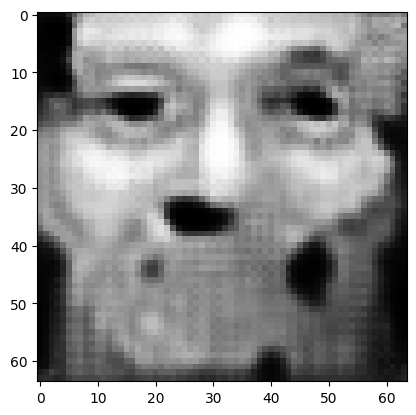

tensor([[5.4464e-03, 3.8117e-04, 5.3183e-02, 2.3984e-02, 9.2181e-02, 4.1671e-01,
         1.3739e-02, 8.4710e-03, 2.6007e-03, 1.8131e-02, 1.9654e-03, 1.4773e-03,
         4.9425e-02, 1.7845e-03, 4.2864e-04, 6.5818e-02, 7.2055e-03, 1.2098e-03,
         2.2362e-04, 3.8860e-04, 4.0427e-04, 1.0850e-02, 5.4641e-02, 6.8958e-05,
         5.2374e-03, 1.7756e-03, 9.3441e-04, 1.0725e-03, 8.6703e-04, 1.5912e-03,
         4.6134e-04, 2.0450e-02, 2.7734e-02, 1.3736e-03, 1.2663e-03, 5.0916e-03,
         4.0797e-03, 9.5784e-02, 2.9217e-04, 1.2666e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8753540515899658
tensor([[5.4467e-03, 3.8115e-04, 5.3175e-02, 2.3983e-02, 9.2173e-02, 4.1677e-01,
         1.3738e-02, 8.4712e-03, 2.6002e-03, 1.8129e-02, 1.9651e-03, 1.4771e-03,
         4.9419e-02, 1.7842e-03, 4.2858e-04, 6.5813e-02, 7.2045e-03, 1.2098e-03,
         2.2360e-04, 3.8857e-04, 4.0418e-04, 1.0849e-02, 5.4634e-02, 6.8949e-05,
         5.2363e-03, 1.7755e-03, 9.3424e-04

In [142]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=5)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.795828342437744


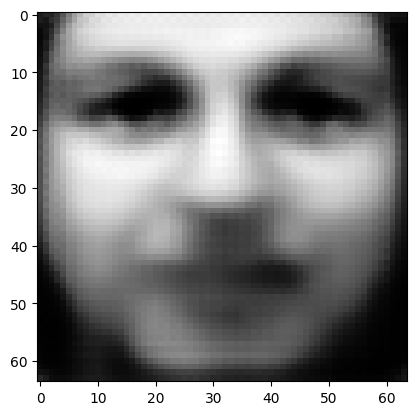

tensor([[1.4472e-04, 2.2724e-04, 1.6684e-02, 4.1956e-03, 1.3920e-03, 1.1612e-05,
         6.2911e-02, 2.3105e-04, 1.8887e-01, 8.6122e-03, 5.8774e-03, 8.7944e-03,
         1.6928e-02, 3.4268e-03, 2.7891e-03, 5.8965e-04, 3.0018e-02, 8.4383e-04,
         2.9499e-03, 9.6780e-04, 3.6819e-02, 2.8801e-02, 9.8398e-03, 1.0377e-02,
         1.6438e-01, 8.0851e-04, 3.9793e-03, 4.2777e-02, 3.7112e-02, 5.7738e-03,
         2.5652e-02, 3.4222e-04, 1.9844e-02, 3.0350e-03, 5.3705e-02, 8.7193e-04,
         1.7908e-02, 9.0611e-02, 5.8283e-02, 3.2618e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.766035795211792
tensor([[1.1886e-04, 1.8500e-04, 1.6493e-02, 4.6985e-03, 1.0173e-03, 1.1115e-05,
         1.1223e-01, 2.1108e-04, 1.9471e-01, 6.7626e-03, 5.0543e-03, 6.6789e-03,
         1.5314e-02, 2.8497e-03, 1.9084e-03, 5.3395e-04, 3.2911e-02, 7.8380e-04,
         3.0760e-03, 8.3278e-04, 2.3833e-02, 2.8522e-02, 7.7738e-03, 1.0186e-02,
         1.6489e-01, 7.1229e-04, 3.4823e-03,

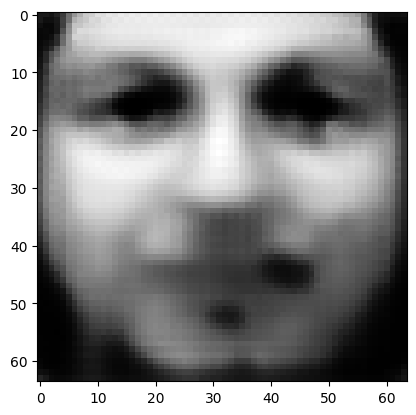

tensor([[5.5082e-05, 9.5378e-05, 1.1875e-02, 5.0443e-03, 2.8484e-04, 7.2801e-06,
         4.0161e-01, 1.3779e-04, 1.4147e-01, 2.5644e-03, 2.8818e-03, 2.4254e-03,
         8.0598e-03, 1.3596e-03, 5.6830e-04, 3.4533e-04, 3.4574e-02, 4.9629e-04,
         2.9712e-03, 4.4511e-04, 6.0519e-03, 2.2875e-02, 2.8402e-03, 8.1963e-03,
         1.1778e-01, 3.6583e-04, 1.9412e-03, 3.3031e-02, 2.9510e-02, 1.1037e-03,
         9.9637e-03, 2.8491e-04, 1.6408e-02, 9.9031e-04, 2.4940e-02, 4.3699e-04,
         1.0094e-02, 5.5040e-02, 3.3077e-02, 7.7996e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.912265956401825
tensor([[4.6055e-05, 8.2088e-05, 1.0530e-02, 4.8092e-03, 2.1890e-04, 6.3783e-06,
         4.6727e-01, 1.2313e-04, 1.2522e-01, 2.0698e-03, 2.5239e-03, 1.9694e-03,
         6.7361e-03, 1.1421e-03, 4.4622e-04, 3.0283e-04, 3.3724e-02, 4.3116e-04,
         2.8291e-03, 3.7931e-04, 4.6069e-03, 2.1305e-02, 2.2751e-03, 7.5890e-03,
         1.0479e-01, 3.1715e-04, 1.6719e-03,

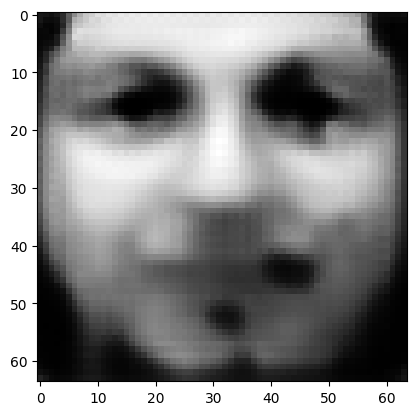

tensor([[2.5530e-05, 4.9927e-05, 6.9782e-03, 3.8392e-03, 1.0145e-04, 4.1908e-06,
         6.4578e-01, 8.1852e-05, 8.1098e-02, 1.0878e-03, 1.6236e-03, 1.0082e-03,
         3.8052e-03, 6.3197e-04, 2.0787e-04, 1.9982e-04, 2.8586e-02, 2.5017e-04,
         2.2851e-03, 2.2722e-04, 1.9132e-03, 1.6425e-02, 1.1333e-03, 5.4918e-03,
         6.9816e-02, 1.9924e-04, 1.0276e-03, 2.1821e-02, 1.8484e-02, 3.7077e-04,
         4.8870e-03, 2.0893e-04, 1.0376e-02, 4.5707e-04, 1.2694e-02, 2.4110e-04,
         5.8575e-03, 2.9143e-02, 1.8850e-02, 2.7283e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4372923672199249
tensor([[2.2771e-05, 4.5392e-05, 6.4124e-03, 3.6692e-03, 8.7968e-05, 3.8535e-06,
         6.7418e-01, 7.5010e-05, 7.4225e-02, 9.6354e-04, 1.4834e-03, 8.8928e-04,
         3.4043e-03, 5.6264e-04, 1.7968e-04, 1.8422e-04, 2.7393e-02, 2.2319e-04,
         2.1853e-03, 2.0551e-04, 1.6214e-03, 1.5530e-02, 9.9170e-04, 5.1289e-03,
         6.4160e-02, 1.8256e-04, 9.3745e-04

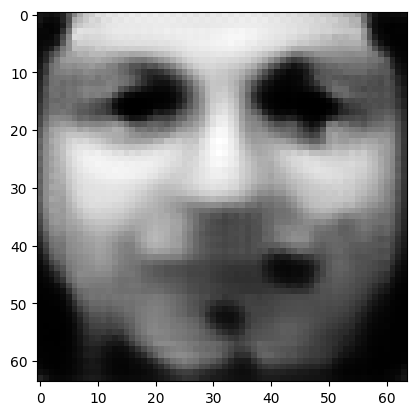

tensor([[1.5857e-05, 3.3194e-05, 4.8183e-03, 3.1089e-03, 5.6277e-05, 2.9250e-06,
         7.5375e-01, 5.5903e-05, 5.4899e-02, 6.4758e-04, 1.0871e-03, 5.9493e-04,
         2.3937e-03, 3.8637e-04, 1.1151e-04, 1.4086e-04, 2.3447e-02, 1.5397e-04,
         1.8569e-03, 1.4671e-04, 9.5116e-04, 1.2750e-02, 6.3679e-04, 4.0703e-03,
         4.8444e-02, 1.3708e-04, 6.9061e-04, 1.6320e-02, 1.2811e-02, 1.9057e-04,
         3.1423e-03, 1.6641e-04, 7.3395e-03, 2.8051e-04, 7.7994e-03, 1.6469e-04,
         3.9935e-03, 1.8515e-02, 1.2422e-02, 1.4710e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2826966941356659
tensor([[1.4758e-05, 3.1121e-05, 4.5339e-03, 2.9986e-03, 5.1571e-05, 2.7637e-06,
         7.6768e-01, 5.2531e-05, 5.1562e-02, 5.9733e-04, 1.0164e-03, 5.4973e-04,
         2.2305e-03, 3.5779e-04, 1.0119e-04, 1.3321e-04, 2.2623e-02, 1.4287e-04,
         1.7923e-03, 1.3675e-04, 8.5456e-04, 1.2211e-02, 5.8175e-04, 3.8808e-03,
         4.5726e-02, 1.2941e-04, 6.4803e-04

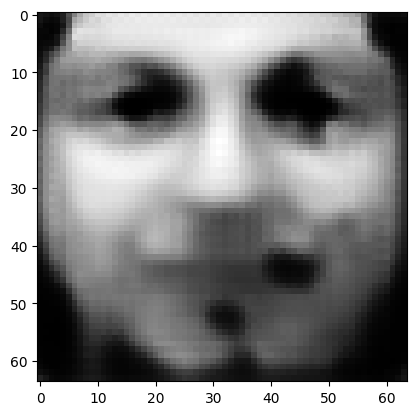

tensor([[1.1537e-05, 2.4831e-05, 3.6595e-03, 2.6362e-03, 3.8365e-05, 2.2708e-06,
         8.1037e-01, 4.2106e-05, 4.1572e-02, 4.5267e-04, 8.0142e-04, 4.1940e-04,
         1.7520e-03, 2.7384e-04, 7.2261e-05, 1.0985e-04, 1.9886e-02, 1.1059e-04,
         1.5764e-03, 1.0704e-04, 5.9117e-04, 1.0471e-02, 4.2648e-04, 3.2786e-03,
         3.7261e-02, 1.0560e-04, 5.1914e-04, 1.3095e-02, 9.7038e-03, 1.2127e-04,
         2.3329e-03, 1.4048e-04, 5.7213e-03, 1.9824e-04, 5.5163e-03, 1.2630e-04,
         3.0002e-03, 1.3353e-02, 9.1498e-03, 9.7362e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2102699875831604
tensor([[1.0925e-05, 2.3597e-05, 3.4891e-03, 2.5577e-03, 3.5907e-05, 2.1721e-06,
         8.1880e-01, 4.0060e-05, 3.9630e-02, 4.2566e-04, 7.5926e-04, 3.9493e-04,
         1.6622e-03, 2.5805e-04, 6.6979e-05, 1.0537e-04, 1.9290e-02, 1.0447e-04,
         1.5298e-03, 1.0129e-04, 5.4478e-04, 1.0103e-02, 3.9732e-04, 3.1570e-03,
         3.5587e-02, 1.0070e-04, 4.9413e-04

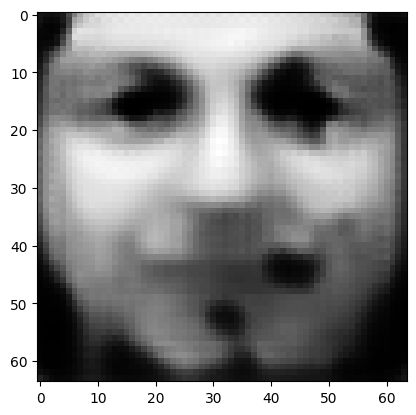

tensor([[9.0095e-06, 1.9697e-05, 2.9433e-03, 2.2885e-03, 2.8488e-05, 1.8578e-06,
         8.4591e-01, 3.3616e-05, 3.3364e-02, 3.4161e-04, 6.2591e-04, 3.1958e-04,
         1.3793e-03, 2.0942e-04, 5.1006e-05, 9.1099e-05, 1.7319e-02, 8.5418e-05,
         1.3715e-03, 8.3174e-05, 4.0829e-04, 8.8809e-03, 3.0812e-04, 2.7553e-03,
         3.0199e-02, 8.5029e-05, 4.1402e-04, 1.0896e-02, 7.7776e-03, 8.5798e-05,
         1.8443e-03, 1.2170e-04, 4.7126e-03, 1.5042e-04, 4.1920e-03, 1.0222e-04,
         2.3704e-03, 1.0349e-02, 7.1554e-03, 7.1345e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.16733956336975098
tensor([[8.6308e-06, 1.8902e-05, 2.8326e-03, 2.2313e-03, 2.7019e-05, 1.7943e-06,
         8.5145e-01, 3.2321e-05, 3.2100e-02, 3.2498e-04, 5.9879e-04, 3.0453e-04,
         1.3220e-03, 1.9975e-04, 4.7898e-05, 8.8146e-05, 1.6885e-02, 8.1654e-05,
         1.3371e-03, 7.9504e-05, 3.8248e-04, 8.6182e-03, 2.9074e-04, 2.6688e-03,
         2.9098e-02, 8.1776e-05, 3.9758e-0

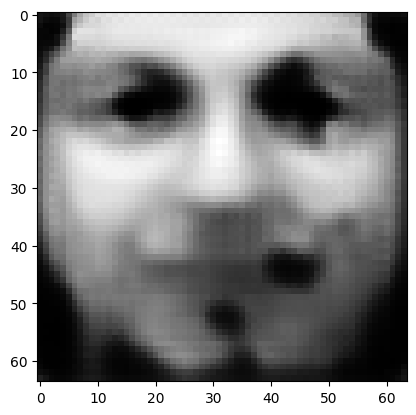

tensor([[7.4199e-06, 1.6338e-05, 2.4720e-03, 2.0400e-03, 2.2428e-05, 1.5849e-06,
         8.6967e-01, 2.8133e-05, 2.7965e-02, 2.7248e-04, 5.1112e-04, 2.5723e-04,
         1.1365e-03, 1.6887e-04, 3.8349e-05, 7.8448e-05, 1.5400e-02, 6.9637e-05,
         1.2230e-03, 6.7822e-05, 3.0407e-04, 7.7387e-03, 2.3635e-04, 2.3866e-03,
         2.5454e-02, 7.1292e-05, 3.4440e-04, 9.3373e-03, 6.5149e-03, 6.5215e-05,
         1.5201e-03, 1.0772e-04, 4.0456e-03, 1.2009e-04, 3.3631e-03, 8.5909e-05,
         1.9528e-03, 8.4982e-03, 5.8507e-03, 5.6143e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13964685797691345
tensor([[7.1755e-06, 1.5813e-05, 2.3967e-03, 1.9984e-03, 2.1519e-05, 1.5413e-06,
         8.7347e-01, 2.7268e-05, 2.7097e-02, 2.6186e-04, 4.9300e-04, 2.4777e-04,
         1.0986e-03, 1.6264e-04, 3.6474e-05, 7.6400e-05, 1.5078e-02, 6.7204e-05,
         1.1986e-03, 6.5419e-05, 2.8881e-04, 7.5513e-03, 2.2556e-04, 2.3272e-03,
         2.4700e-02, 6.9152e-05, 3.3340e-0

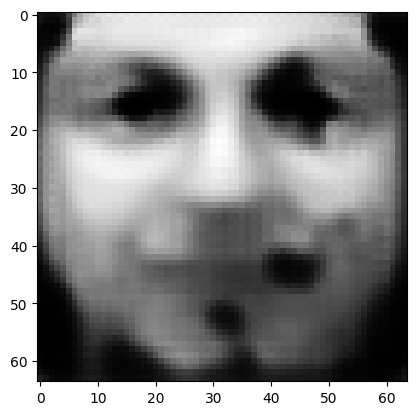

tensor([[6.3390e-06, 1.3998e-05, 2.1394e-03, 1.8504e-03, 1.8426e-05, 1.3909e-06,
         8.8660e-01, 2.4311e-05, 2.4123e-02, 2.2612e-04, 4.3129e-04, 2.1533e-04,
         9.6981e-04, 1.4143e-04, 3.0261e-05, 6.9383e-05, 1.3922e-02, 5.8940e-05,
         1.1106e-03, 5.7247e-05, 2.3866e-04, 6.8863e-03, 1.8943e-04, 2.1185e-03,
         2.2097e-02, 6.1572e-05, 2.9545e-04, 8.1928e-03, 5.6235e-03, 5.2099e-05,
         1.2949e-03, 9.7176e-05, 3.5671e-03, 9.9611e-05, 2.8039e-03, 7.4392e-05,
         1.6598e-03, 7.2276e-03, 4.9468e-03, 4.6271e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.120359405875206
tensor([[6.1602e-06, 1.3602e-05, 2.0840e-03, 1.8166e-03, 1.7760e-05, 1.3584e-06,
         8.8943e-01, 2.3677e-05, 2.3486e-02, 2.1856e-04, 4.1812e-04, 2.0820e-04,
         9.4258e-04, 1.3689e-04, 2.8970e-05, 6.7853e-05, 1.3662e-02, 5.7173e-05,
         1.0902e-03, 5.5485e-05, 2.2818e-04, 6.7380e-03, 1.8187e-04, 2.0715e-03,
         2.1543e-02, 5.9864e-05, 2.8719e-04,

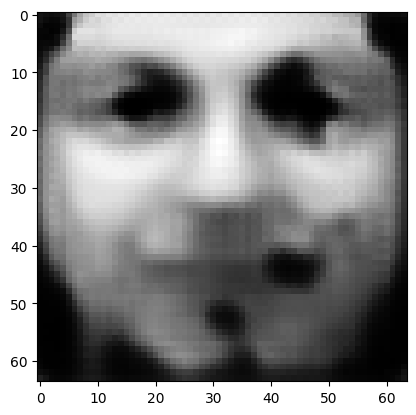

tensor([[5.5560e-06, 1.2252e-05, 1.8919e-03, 1.6950e-03, 1.5573e-05, 1.2455e-06,
         8.9923e-01, 2.1475e-05, 2.1286e-02, 1.9307e-04, 3.7260e-04, 1.8467e-04,
         8.5092e-04, 1.2164e-04, 2.4680e-05, 6.2591e-05, 1.2740e-02, 5.1164e-05,
         1.0181e-03, 4.9483e-05, 1.9386e-04, 6.2199e-03, 1.5655e-04, 1.9102e-03,
         1.9627e-02, 5.4063e-05, 2.5892e-04, 7.3174e-03, 4.9692e-03, 4.3182e-05,
         1.1290e-03, 8.8617e-05, 3.2116e-03, 8.4881e-05, 2.4035e-03, 6.5823e-05,
         1.4425e-03, 6.3138e-03, 4.2847e-03, 3.9385e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10621196031570435
tensor([[5.4250e-06, 1.1954e-05, 1.8501e-03, 1.6669e-03, 1.5110e-05, 1.2202e-06,
         9.0139e-01, 2.0985e-05, 2.0810e-02, 1.8763e-04, 3.6252e-04, 1.7969e-04,
         8.3101e-04, 1.1836e-04, 2.3762e-05, 6.1421e-05, 1.2533e-02, 4.9837e-05,
         1.0016e-03, 4.8173e-05, 1.8668e-04, 6.1053e-03, 1.5114e-04, 1.8743e-03,
         1.9199e-02, 5.2788e-05, 2.5274e-0

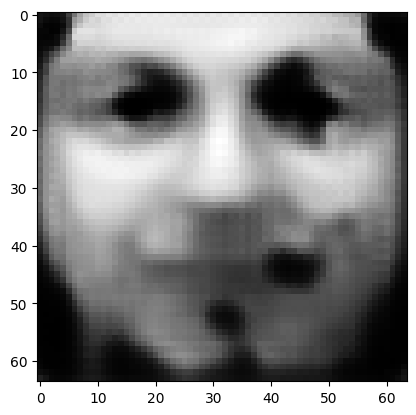

tensor([[4.9706e-06, 1.0910e-05, 1.7024e-03, 1.5668e-03, 1.3538e-05, 1.1315e-06,
         9.0900e-01, 1.9268e-05, 1.9140e-02, 1.6889e-04, 3.2720e-04, 1.6265e-04,
         7.6158e-04, 1.0699e-04, 2.0662e-05, 5.7217e-05, 1.1788e-02, 4.5236e-05,
         9.4267e-04, 4.3589e-05, 1.6241e-04, 5.6970e-03, 1.3291e-04, 1.7472e-03,
         1.7698e-02, 4.8415e-05, 2.3116e-04, 6.6354e-03, 4.4531e-03, 3.6790e-05,
         1.0078e-03, 8.1665e-05, 2.9320e-03, 7.3932e-05, 2.1052e-03, 5.9198e-05,
         1.2773e-03, 5.6084e-03, 3.7830e-03, 3.4372e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09540870785713196
tensor([[4.8688e-06, 1.0679e-05, 1.6696e-03, 1.5441e-03, 1.3199e-05, 1.1116e-06,
         9.1069e-01, 1.8886e-05, 1.8766e-02, 1.6478e-04, 3.1950e-04, 1.5894e-04,
         7.4604e-04, 1.0452e-04, 2.0005e-05, 5.6278e-05, 1.1622e-02, 4.4215e-05,
         9.2944e-04, 4.2575e-05, 1.5724e-04, 5.6062e-03, 1.2899e-04, 1.7190e-03,
         1.7373e-02, 4.7463e-05, 2.2640e-0

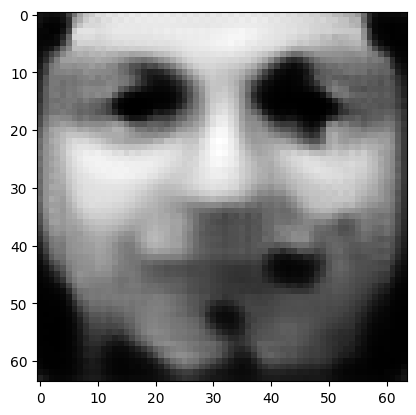

tensor([[4.5131e-06, 9.8584e-06, 1.5534e-03, 1.4612e-03, 1.2022e-05, 1.0413e-06,
         9.1670e-01, 1.7531e-05, 1.7437e-02, 1.5037e-04, 2.9206e-04, 1.4587e-04,
         6.9158e-04, 9.5808e-05, 1.7714e-05, 5.2894e-05, 1.1023e-02, 4.0605e-05,
         8.8090e-04, 3.8994e-05, 1.3938e-04, 5.2782e-03, 1.1535e-04, 1.6165e-03,
         1.6207e-02, 4.4099e-05, 2.0943e-04, 6.0962e-03, 4.0393e-03, 3.2010e-05,
         9.1505e-04, 7.6165e-05, 2.7067e-03, 6.5631e-05, 1.8779e-03, 5.3998e-05,
         1.1500e-03, 5.0520e-03, 3.3957e-03, 3.0539e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08697731047868729
tensor([[4.4347e-06, 9.6793e-06, 1.5275e-03, 1.4431e-03, 1.1761e-05, 1.0255e-06,
         9.1804e-01, 1.7230e-05, 1.7141e-02, 1.4719e-04, 2.8605e-04, 1.4301e-04,
         6.7945e-04, 9.3902e-05, 1.7224e-05, 5.2131e-05, 1.0887e-02, 3.9813e-05,
         8.7018e-04, 3.8207e-05, 1.3556e-04, 5.2049e-03, 1.1240e-04, 1.5937e-03,
         1.5946e-02, 4.3360e-05, 2.0571e-0

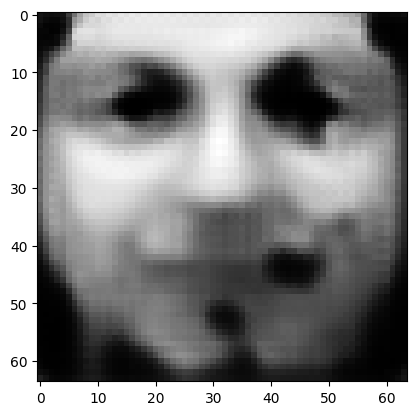

tensor([[4.1531e-06, 9.0358e-06, 1.4348e-03, 1.3765e-03, 1.0865e-05, 9.6952e-07,
         9.2281e-01, 1.6169e-05, 1.6092e-02, 1.3608e-04, 2.6471e-04, 1.3305e-04,
         6.3604e-04, 8.7143e-05, 1.5525e-05, 4.9400e-05, 1.0396e-02, 3.7031e-05,
         8.3161e-04, 3.5419e-05, 1.2231e-04, 4.9402e-03, 1.0218e-04, 1.5124e-03,
         1.5024e-02, 4.0767e-05, 1.9237e-04, 5.6639e-03, 3.7098e-03, 2.8393e-05,
         8.4217e-04, 7.1766e-05, 2.5256e-03, 5.9225e-05, 1.7022e-03, 4.9889e-05,
         1.0503e-03, 4.6171e-03, 3.0936e-03, 2.7595e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08033254742622375
tensor([[4.0898e-06, 8.8927e-06, 1.4139e-03, 1.3618e-03, 1.0664e-05, 9.5680e-07,
         9.2388e-01, 1.5931e-05, 1.5856e-02, 1.3360e-04, 2.5996e-04, 1.3083e-04,
         6.2627e-04, 8.5639e-05, 1.5154e-05, 4.8779e-05, 1.0284e-02, 3.6411e-05,
         8.2296e-04, 3.4796e-05, 1.1942e-04, 4.8802e-03, 9.9928e-05, 1.4942e-03,
         1.4816e-02, 4.0187e-05, 1.8941e-0

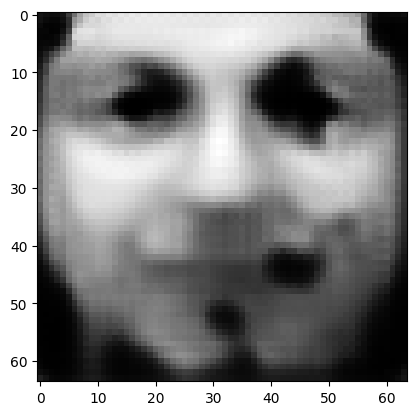

tensor([[3.8634e-06, 8.3754e-06, 1.3384e-03, 1.3070e-03, 9.9532e-06, 9.1088e-07,
         9.2779e-01, 1.5073e-05, 1.4999e-02, 1.2473e-04, 2.4282e-04, 1.2290e-04,
         5.9099e-04, 8.0228e-05, 1.3839e-05, 4.6529e-05, 9.8737e-03, 3.4188e-05,
         7.9127e-04, 3.2565e-05, 1.0920e-04, 4.6614e-03, 9.1902e-05, 1.4277e-03,
         1.4057e-02, 3.8095e-05, 1.7861e-04, 5.3085e-03, 3.4419e-03, 2.5573e-05,
         7.8338e-04, 6.8149e-05, 2.3770e-03, 5.4140e-05, 1.5624e-03, 4.6558e-05,
         9.7005e-04, 4.2677e-03, 2.8519e-03, 2.5259e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07494939118623734
tensor([[3.8120e-06, 8.2591e-06, 1.3212e-03, 1.2947e-03, 9.7917e-06, 9.0031e-07,
         9.2868e-01, 1.4877e-05, 1.4803e-02, 1.2271e-04, 2.3896e-04, 1.2111e-04,
         5.8295e-04, 7.9010e-05, 1.3547e-05, 4.6008e-05, 9.7800e-03, 3.3681e-05,
         7.8410e-04, 3.2061e-05, 1.0694e-04, 4.6117e-03, 9.0115e-05, 1.4126e-03,
         1.3883e-02, 3.7626e-05, 1.7619e-0

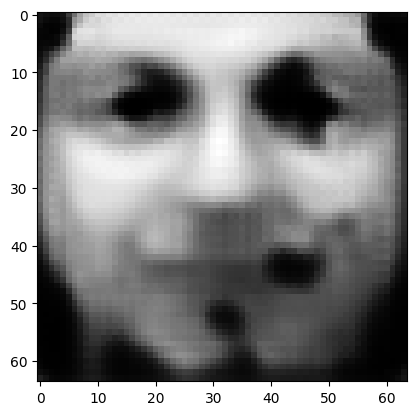

tensor([[3.6239e-06, 7.8301e-06, 1.2585e-03, 1.2484e-03, 9.2124e-06, 8.6170e-07,
         9.3195e-01, 1.4157e-05, 1.4090e-02, 1.1546e-04, 2.2482e-04, 1.1459e-04,
         5.5358e-04, 7.4541e-05, 1.2494e-05, 4.4101e-05, 9.4315e-03, 3.1831e-05,
         7.5725e-04, 3.0226e-05, 9.8781e-05, 4.4277e-03, 8.3654e-05, 1.3562e-03,
         1.3245e-02, 3.5903e-05, 1.6728e-04, 5.0125e-03, 3.2187e-03, 2.3303e-05,
         7.3508e-04, 6.5094e-05, 2.2514e-03, 4.9993e-05, 1.4473e-03, 4.3776e-05,
         9.0403e-04, 3.9784e-03, 2.6525e-03, 2.3351e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07047908753156662
tensor([[3.5805e-06, 7.7320e-06, 1.2440e-03, 1.2379e-03, 9.0775e-06, 8.5268e-07,
         9.3270e-01, 1.3990e-05, 1.3925e-02, 1.1378e-04, 2.2158e-04, 1.1310e-04,
         5.4679e-04, 7.3524e-05, 1.2256e-05, 4.3650e-05, 9.3504e-03, 3.1404e-05,
         7.5104e-04, 2.9803e-05, 9.6943e-05, 4.3850e-03, 8.2191e-05, 1.3431e-03,
         1.3097e-02, 3.5510e-05, 1.6525e-0

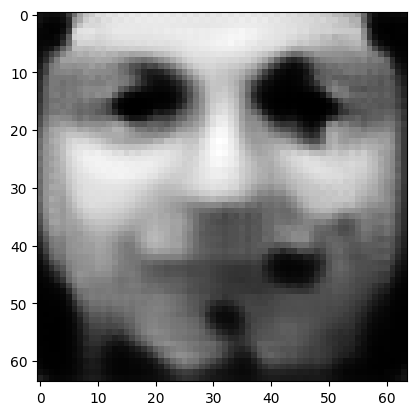

tensor([[3.4224e-06, 7.3730e-06, 1.1908e-03, 1.1986e-03, 8.5934e-06, 8.1979e-07,
         9.3548e-01, 1.3380e-05, 1.3318e-02, 1.0770e-04, 2.0976e-04, 1.0765e-04,
         5.2201e-04, 6.9805e-05, 1.1401e-05, 4.2007e-05, 9.0516e-03, 2.9855e-05,
         7.2804e-04, 2.8265e-05, 9.0320e-05, 4.2275e-03, 7.6894e-05, 1.2950e-03,
         1.2555e-02, 3.4067e-05, 1.5777e-04, 4.7611e-03, 3.0303e-03, 2.1427e-05,
         6.9437e-04, 6.2489e-05, 2.1436e-03, 4.6549e-05, 1.3509e-03, 4.1401e-05,
         8.4885e-04, 3.7354e-03, 2.4854e-03, 2.1754e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06670055538415909
tensor([[3.3860e-06, 7.2909e-06, 1.1786e-03, 1.1894e-03, 8.4854e-06, 8.1226e-07,
         9.3611e-01, 1.3241e-05, 1.3179e-02, 1.0633e-04, 2.0708e-04, 1.0642e-04,
         5.1630e-04, 6.8951e-05, 1.1208e-05, 4.1637e-05, 8.9824e-03, 2.9503e-05,
         7.2277e-04, 2.7919e-05, 8.8829e-05, 4.1913e-03, 7.5694e-05, 1.2841e-03,
         1.2429e-02, 3.3735e-05, 1.5605e-0

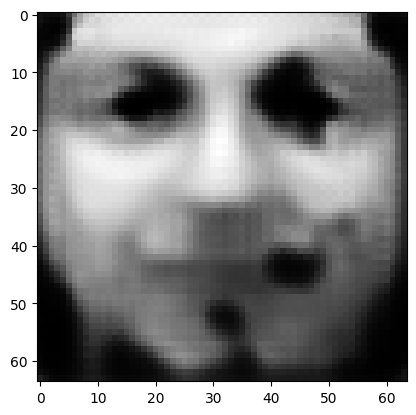

tensor([[3.2526e-06, 6.9888e-06, 1.1332e-03, 1.1557e-03, 8.0819e-06, 7.8414e-07,
         9.3848e-01, 1.2724e-05, 1.2661e-02, 1.0122e-04, 1.9714e-04, 1.0186e-04,
         4.9527e-04, 6.5826e-05, 1.0507e-05, 4.0228e-05, 8.7239e-03, 2.8202e-05,
         7.0314e-04, 2.6629e-05, 8.3400e-05, 4.0559e-03, 7.1305e-05, 1.2431e-03,
         1.1965e-02, 3.2519e-05, 1.4972e-04, 4.5460e-03, 2.8696e-03, 1.9885e-05,
         6.6009e-04, 6.0267e-05, 2.0514e-03, 4.3676e-05, 1.2703e-03, 3.9406e-05,
         8.0221e-04, 3.5296e-03, 2.3452e-03, 2.0423e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06349151581525803
tensor([[3.2219e-06, 6.9187e-06, 1.1226e-03, 1.1478e-03, 7.9898e-06, 7.7763e-07,
         9.3903e-01, 1.2604e-05, 1.2541e-02, 1.0004e-04, 1.9484e-04, 1.0081e-04,
         4.9040e-04, 6.5102e-05, 1.0346e-05, 3.9902e-05, 8.6634e-03, 2.7902e-05,
         6.9853e-04, 2.6332e-05, 8.2157e-05, 4.0243e-03, 7.0296e-05, 1.2336e-03,
         1.1856e-02, 3.2235e-05, 1.4825e-0

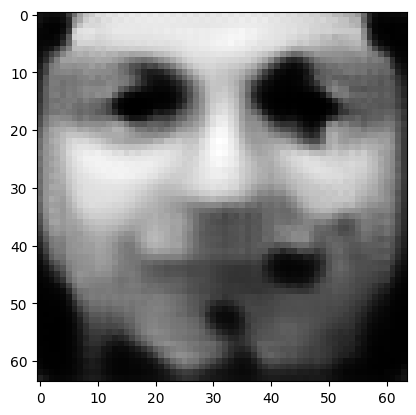

tensor([[3.1068e-06, 6.6596e-06, 1.0832e-03, 1.1183e-03, 7.6455e-06, 7.5314e-07,
         9.4109e-01, 1.2158e-05, 1.2091e-02, 9.5674e-05, 1.8634e-04, 9.6903e-05,
         4.7222e-04, 6.2420e-05, 9.7585e-06, 3.8684e-05, 8.4357e-03, 2.6787e-05,
         6.8146e-04, 2.5232e-05, 7.7601e-05, 3.9060e-03, 6.6575e-05, 1.1981e-03,
         1.1450e-02, 3.1179e-05, 1.4280e-04, 4.3589e-03, 2.7310e-03, 1.8584e-05,
         6.3053e-04, 5.8323e-05, 1.9709e-03, 4.1228e-05, 1.2012e-03, 3.7684e-05,
         7.6209e-04, 3.3523e-03, 2.2249e-03, 1.9291e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060713812708854675
tensor([[3.0801e-06, 6.5991e-06, 1.0740e-03, 1.1113e-03, 7.5659e-06, 7.4742e-07,
         9.4157e-01, 1.2054e-05, 1.1986e-02, 9.4662e-05, 1.8435e-04, 9.5993e-05,
         4.6801e-04, 6.1795e-05, 9.6226e-06, 3.8401e-05, 8.3823e-03, 2.6528e-05,
         6.7741e-04, 2.4976e-05, 7.6549e-05, 3.8782e-03, 6.5711e-05, 1.1898e-03,
         1.1355e-02, 3.0930e-05, 1.4152e-

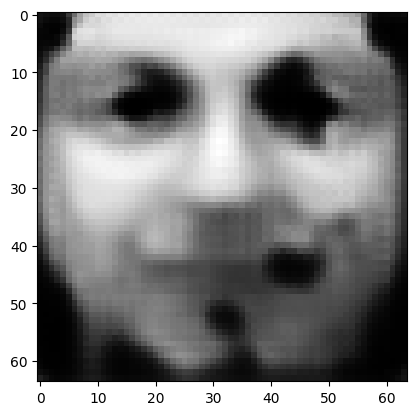

tensor([[2.9800e-06, 6.3740e-06, 1.0396e-03, 1.0854e-03, 7.2678e-06, 7.2586e-07,
         9.4338e-01, 1.1662e-05, 1.1594e-02, 9.0884e-05, 1.7698e-04, 9.2608e-05,
         4.5225e-04, 5.9475e-05, 9.1223e-06, 3.7331e-05, 8.1806e-03, 2.5558e-05,
         6.6231e-04, 2.4023e-05, 7.2679e-05, 3.7740e-03, 6.2526e-05, 1.1587e-03,
         1.0999e-02, 3.0006e-05, 1.3679e-04, 4.1953e-03, 2.6104e-03, 1.7471e-05,
         6.0473e-04, 5.6602e-05, 1.9001e-03, 3.9118e-05, 1.1413e-03, 3.6176e-05,
         7.2727e-04, 3.1981e-03, 2.1207e-03, 1.8313e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05828887224197388
tensor([[2.9566e-06, 6.3212e-06, 1.0316e-03, 1.0792e-03, 7.1986e-06, 7.2080e-07,
         9.4380e-01, 1.1571e-05, 1.1502e-02, 9.0009e-05, 1.7526e-04, 9.1818e-05,
         4.4857e-04, 5.8934e-05, 9.0062e-06, 3.7080e-05, 8.1327e-03, 2.5331e-05,
         6.5872e-04, 2.3802e-05, 7.1784e-05, 3.7495e-03, 6.1786e-05, 1.1513e-03,
         1.0915e-02, 2.9789e-05, 1.3568e-0

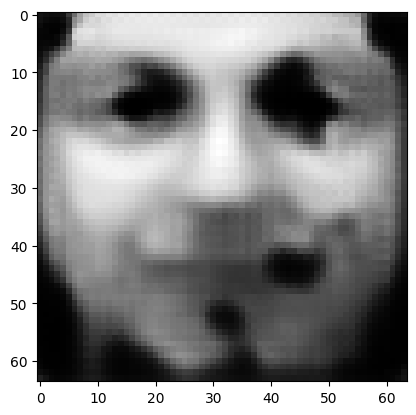

tensor([[2.8690e-06, 6.1253e-06, 1.0014e-03, 1.0561e-03, 6.9413e-06, 7.0180e-07,
         9.4538e-01, 1.1230e-05, 1.1159e-02, 8.6753e-05, 1.6888e-04, 8.8889e-05,
         4.3471e-04, 5.6914e-05, 8.5813e-06, 3.6142e-05, 7.9525e-03, 2.4492e-05,
         6.4548e-04, 2.2977e-05, 6.8481e-05, 3.6578e-03, 5.9055e-05, 1.1241e-03,
         1.0604e-02, 2.8978e-05, 1.3154e-04, 4.0513e-03, 2.5050e-03, 1.6521e-05,
         5.8228e-04, 5.5077e-05, 1.8378e-03, 3.7294e-05, 1.0895e-03, 3.4861e-05,
         6.9683e-04, 3.0636e-03, 2.0300e-03, 1.7472e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056168340146541595
tensor([[2.8485e-06, 6.0791e-06, 9.9430e-04, 1.0505e-03, 6.8815e-06, 6.9734e-07,
         9.4575e-01, 1.1150e-05, 1.1078e-02, 8.5992e-05, 1.6738e-04, 8.8203e-05,
         4.3147e-04, 5.6441e-05, 8.4819e-06, 3.5923e-05, 7.9099e-03, 2.4295e-05,
         6.4231e-04, 2.2783e-05, 6.7711e-05, 3.6361e-03, 5.8415e-05, 1.1176e-03,
         1.0531e-02, 2.8786e-05, 1.3056e-

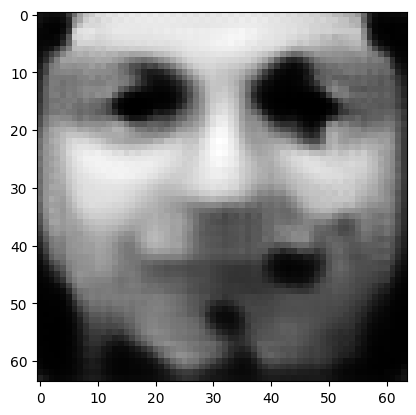

tensor([[2.7714e-06, 5.9065e-06, 9.6764e-04, 1.0299e-03, 6.6548e-06, 6.8044e-07,
         9.4715e-01, 1.0850e-05, 1.0775e-02, 8.3138e-05, 1.6179e-04, 8.5619e-05,
         4.1926e-04, 5.4663e-05, 8.1140e-06, 3.5092e-05, 7.7480e-03, 2.3558e-05,
         6.3049e-04, 2.2061e-05, 6.4851e-05, 3.5543e-03, 5.6031e-05, 1.0935e-03,
         1.0255e-02, 2.8062e-05, 1.2691e-04, 3.9232e-03, 2.4123e-03, 1.5698e-05,
         5.6239e-04, 5.3711e-05, 1.7826e-03, 3.5697e-05, 1.0442e-03, 3.3700e-05,
         6.6997e-04, 2.9454e-03, 1.9504e-03, 1.6737e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05429309234023094
tensor([[2.7533e-06, 5.8662e-06, 9.6141e-04, 1.0251e-03, 6.6015e-06, 6.7645e-07,
         9.4748e-01, 1.0779e-05, 1.0703e-02, 8.2469e-05, 1.6048e-04, 8.5016e-05,
         4.1638e-04, 5.4249e-05, 8.0289e-06, 3.4895e-05, 7.7097e-03, 2.3385e-05,
         6.2774e-04, 2.1892e-05, 6.4190e-05, 3.5351e-03, 5.5478e-05, 1.0878e-03,
         1.0190e-02, 2.7894e-05, 1.2606e-0

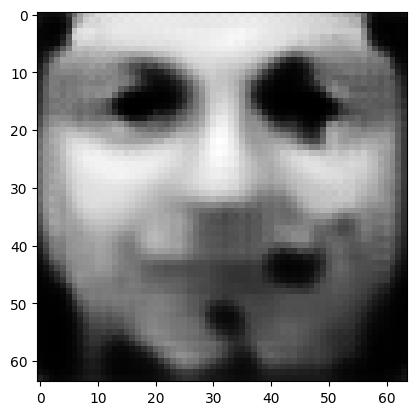

tensor([[2.6849e-06, 5.7138e-06, 9.3779e-04, 1.0066e-03, 6.4022e-06, 6.6144e-07,
         9.4873e-01, 1.0514e-05, 1.0433e-02, 7.9960e-05, 1.5556e-04, 8.2732e-05,
         4.0555e-04, 5.2681e-05, 7.7090e-06, 3.4161e-05, 7.5643e-03, 2.2734e-05,
         6.1717e-04, 2.1256e-05, 6.1702e-05, 3.4620e-03, 5.3393e-05, 1.0662e-03,
         9.9439e-03, 2.7249e-05, 1.2282e-04, 3.8095e-03, 2.3304e-03, 1.4980e-05,
         5.4473e-04, 5.2494e-05, 1.7332e-03, 3.4297e-05, 1.0041e-03, 3.2669e-05,
         6.4627e-04, 2.8410e-03, 1.8801e-03, 1.6092e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05263024568557739
tensor([[2.6688e-06, 5.6778e-06, 9.3222e-04, 1.0021e-03, 6.3558e-06, 6.5792e-07,
         9.4903e-01, 1.0452e-05, 1.0369e-02, 7.9371e-05, 1.5440e-04, 8.2193e-05,
         4.0300e-04, 5.2312e-05, 7.6339e-06, 3.3989e-05, 7.5298e-03, 2.2581e-05,
         6.1464e-04, 2.1106e-05, 6.1118e-05, 3.4446e-03, 5.2903e-05, 1.0611e-03,
         9.8859e-03, 2.7096e-05, 1.2205e-0

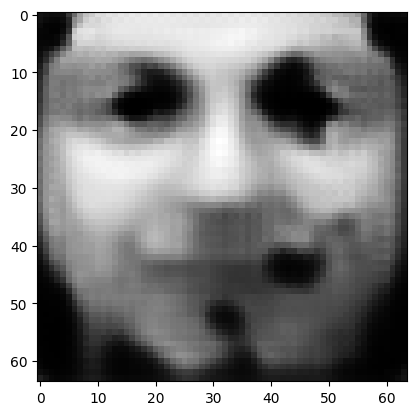

tensor([[2.6079e-06, 5.5427e-06, 9.1117e-04, 9.8547e-04, 6.1792e-06, 6.4448e-07,
         9.5014e-01, 1.0215e-05, 1.0126e-02, 7.7134e-05, 1.5003e-04, 8.0159e-05,
         3.9339e-04, 5.0930e-05, 7.3529e-06, 3.3332e-05, 7.3989e-03, 2.2001e-05,
         6.0510e-04, 2.0540e-05, 5.8940e-05, 3.3789e-03, 5.1060e-05, 1.0416e-03,
         9.6671e-03, 2.6523e-05, 1.1917e-04, 3.7074e-03, 2.2571e-03, 1.4350e-05,
         5.2901e-04, 5.1406e-05, 1.6892e-03, 3.3059e-05, 9.6852e-04, 3.1752e-05,
         6.2516e-04, 2.7484e-03, 1.8176e-03, 1.5521e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05114417150616646
tensor([[2.5935e-06, 5.5107e-06, 9.0618e-04, 9.8147e-04, 6.1380e-06, 6.4132e-07,
         9.5041e-01, 1.0159e-05, 1.0069e-02, 7.6607e-05, 1.4900e-04, 7.9678e-05,
         3.9114e-04, 5.0604e-05, 7.2869e-06, 3.3176e-05, 7.3678e-03, 2.1864e-05,
         6.0281e-04, 2.0406e-05, 5.8427e-05, 3.3632e-03, 5.0628e-05, 1.0370e-03,
         9.6154e-03, 2.6387e-05, 1.1849e-0

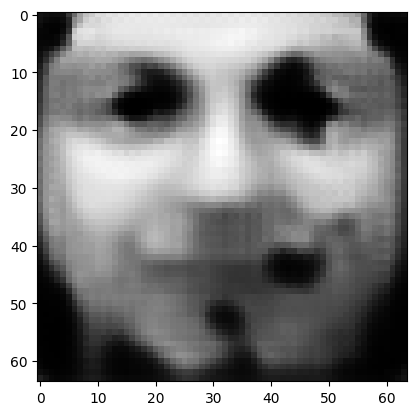

tensor([[2.5388e-06, 5.3896e-06, 8.8731e-04, 9.6641e-04, 5.9802e-06, 6.2923e-07,
         9.5141e-01, 9.9469e-06, 9.8508e-03, 7.4609e-05, 1.4510e-04, 7.7854e-05,
         3.8250e-04, 4.9369e-05, 7.0389e-06, 3.2583e-05, 7.2490e-03, 2.1345e-05,
         5.9418e-04, 1.9900e-05, 5.6502e-05, 3.3038e-03, 4.8996e-05, 1.0194e-03,
         9.4185e-03, 2.5871e-05, 1.1591e-04, 3.6156e-03, 2.1914e-03, 1.3792e-05,
         5.1490e-04, 5.0425e-05, 1.6494e-03, 3.1956e-05, 9.3671e-04, 3.0927e-05,
         6.0629e-04, 2.6658e-03, 1.7617e-03, 1.5013e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04981071129441261
tensor([[2.5257e-06, 5.3612e-06, 8.8281e-04, 9.6288e-04, 5.9430e-06, 6.2635e-07,
         9.5165e-01, 9.8965e-06, 9.7991e-03, 7.4138e-05, 1.4419e-04, 7.7427e-05,
         3.8044e-04, 4.9076e-05, 6.9813e-06, 3.2444e-05, 7.2207e-03, 2.1224e-05,
         5.9218e-04, 1.9781e-05, 5.6051e-05, 3.2897e-03, 4.8613e-05, 1.0153e-03,
         9.3718e-03, 2.5749e-05, 1.1530e-0

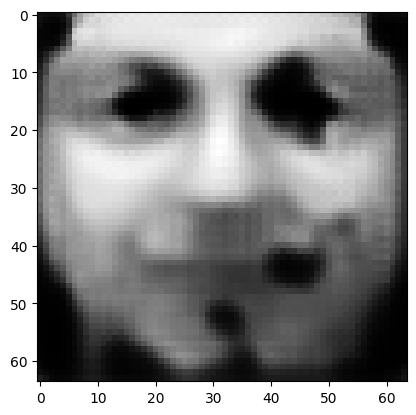

tensor([[2.4766e-06, 5.2526e-06, 8.6575e-04, 9.4921e-04, 5.8013e-06, 6.1542e-07,
         9.5255e-01, 9.7053e-06, 9.6026e-03, 7.2349e-05, 1.4071e-04, 7.5783e-05,
         3.7267e-04, 4.7966e-05, 6.7617e-06, 3.1907e-05, 7.1126e-03, 2.0759e-05,
         5.8436e-04, 1.9330e-05, 5.4341e-05, 3.2359e-03, 4.7160e-05, 9.9937e-04,
         9.1940e-03, 2.5282e-05, 1.1298e-04, 3.5329e-03, 2.1326e-03, 1.3296e-05,
         5.0216e-04, 4.9535e-05, 1.6134e-03, 3.0972e-05, 9.0823e-04, 3.0184e-05,
         5.8935e-04, 2.5916e-03, 1.7115e-03, 1.4558e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04860958456993103
tensor([[2.4649e-06, 5.2268e-06, 8.6169e-04, 9.4592e-04, 5.7683e-06, 6.1284e-07,
         9.5277e-01, 9.6602e-06, 9.5562e-03, 7.1928e-05, 1.3989e-04, 7.5396e-05,
         3.7082e-04, 4.7703e-05, 6.7101e-06, 3.1780e-05, 7.0869e-03, 2.0650e-05,
         5.8250e-04, 1.9223e-05, 5.3939e-05, 3.2231e-03, 4.6818e-05, 9.9561e-04,
         9.1519e-03, 2.5171e-05, 1.1242e-0

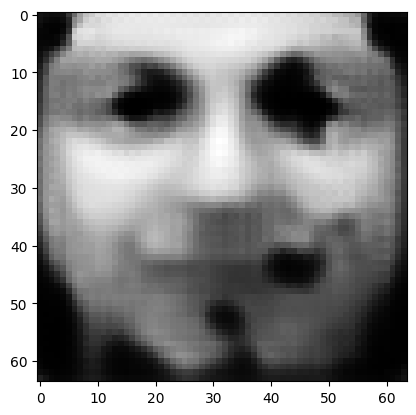

tensor([[2.4199e-06, 5.1283e-06, 8.4631e-04, 9.3348e-04, 5.6419e-06, 6.0293e-07,
         9.5358e-01, 9.4892e-06, 9.3805e-03, 7.0339e-05, 1.3679e-04, 7.3923e-05,
         3.6372e-04, 4.6698e-05, 6.5170e-06, 3.1298e-05, 6.9879e-03, 2.0236e-05,
         5.7549e-04, 1.8820e-05, 5.2421e-05, 3.1744e-03, 4.5530e-05, 9.8139e-04,
         8.9925e-03, 2.4748e-05, 1.1032e-04, 3.4578e-03, 2.0796e-03, 1.2857e-05,
         4.9067e-04, 4.8723e-05, 1.5810e-03, 3.0088e-05, 8.8297e-04, 2.9520e-05,
         5.7399e-04, 2.5248e-03, 1.6666e-03, 1.4153e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047528769820928574
tensor([[2.4092e-06, 5.1051e-06, 8.4264e-04, 9.3054e-04, 5.6116e-06, 6.0057e-07,
         9.5378e-01, 9.4484e-06, 9.3386e-03, 6.9959e-05, 1.3605e-04, 7.3572e-05,
         3.6203e-04, 4.6459e-05, 6.4714e-06, 3.1183e-05, 6.9644e-03, 2.0137e-05,
         5.7383e-04, 1.8724e-05, 5.2063e-05, 3.1628e-03, 4.5225e-05, 9.7800e-04,
         8.9545e-03, 2.4647e-05, 1.0982e-

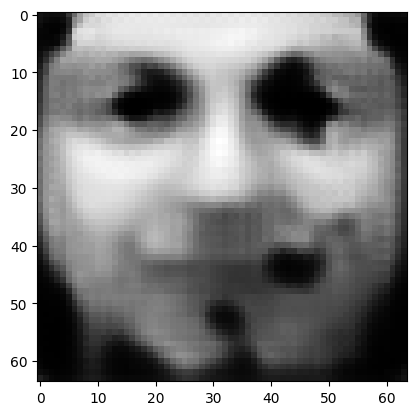

tensor([[2.3684e-06, 5.0157e-06, 8.2866e-04, 9.1911e-04, 5.4982e-06, 5.9159e-07,
         9.5452e-01, 9.2933e-06, 9.1791e-03, 6.8524e-05, 1.3325e-04, 7.2240e-05,
         3.5560e-04, 4.5550e-05, 6.2982e-06, 3.0744e-05, 6.8742e-03, 1.9763e-05,
         5.6741e-04, 1.8360e-05, 5.0702e-05, 3.1183e-03, 4.4068e-05, 9.6500e-04,
         8.8094e-03, 2.4263e-05, 1.0791e-04, 3.3894e-03, 2.0316e-03, 1.2465e-05,
         4.8025e-04, 4.7983e-05, 1.5516e-03, 2.9291e-05, 8.6020e-04, 2.8918e-05,
         5.6008e-04, 2.4645e-03, 1.6260e-03, 1.3787e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04654817655682564
tensor([[2.3587e-06, 4.9944e-06, 8.2529e-04, 9.1631e-04, 5.4705e-06, 5.8940e-07,
         9.5470e-01, 9.2561e-06, 9.1410e-03, 6.8180e-05, 1.3258e-04, 7.1922e-05,
         3.5406e-04, 4.5334e-05, 6.2567e-06, 3.0638e-05, 6.8529e-03, 1.9673e-05,
         5.6587e-04, 1.8272e-05, 5.0377e-05, 3.1076e-03, 4.3791e-05, 9.6191e-04,
         8.7751e-03, 2.4170e-05, 1.0745e-0

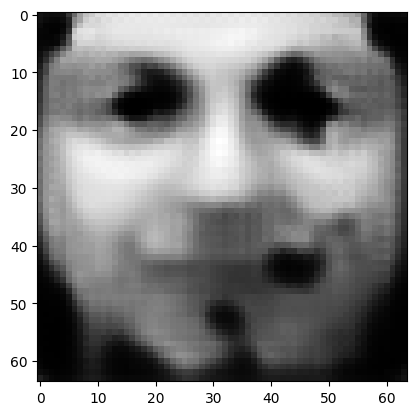

tensor([[2.3216e-06, 4.9124e-06, 8.1247e-04, 9.0554e-04, 5.3659e-06, 5.8111e-07,
         9.5537e-01, 9.1141e-06, 8.9955e-03, 6.6872e-05, 1.3003e-04, 7.0709e-05,
         3.4820e-04, 4.4508e-05, 6.0994e-06, 3.0233e-05, 6.7709e-03, 1.9331e-05,
         5.5991e-04, 1.7936e-05, 4.9142e-05, 3.0665e-03, 4.2742e-05, 9.5000e-04,
         8.6440e-03, 2.3818e-05, 1.0572e-04, 3.3271e-03, 1.9879e-03, 1.2108e-05,
         4.7077e-04, 4.7297e-05, 1.5244e-03, 2.8563e-05, 8.3954e-04, 2.8362e-05,
         5.4743e-04, 2.4095e-03, 1.5891e-03, 1.3453e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045655570924282074
tensor([[2.3127e-06, 4.8930e-06, 8.0940e-04, 9.0298e-04, 5.3407e-06, 5.7911e-07,
         9.5553e-01, 9.0802e-06, 8.9606e-03, 6.6558e-05, 1.2942e-04, 7.0421e-05,
         3.4679e-04, 4.4311e-05, 6.0620e-06, 3.0136e-05, 6.7513e-03, 1.9249e-05,
         5.5850e-04, 1.7855e-05, 4.8849e-05, 3.0566e-03, 4.2492e-05, 9.4717e-04,
         8.6126e-03, 2.3734e-05, 1.0531e-

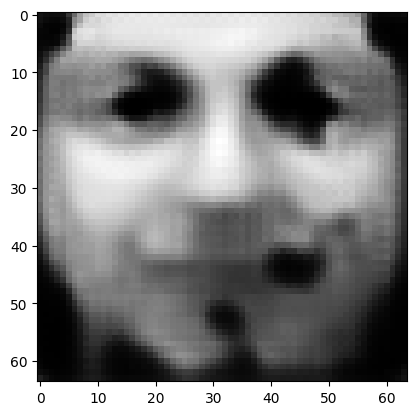

tensor([[2.2788e-06, 4.8181e-06, 7.9764e-04, 8.9306e-04, 5.2457e-06, 5.7152e-07,
         9.5615e-01, 8.9500e-06, 8.8274e-03, 6.5364e-05, 1.2710e-04, 6.9314e-05,
         3.4145e-04, 4.3559e-05, 5.9198e-06, 2.9764e-05, 6.6759e-03, 1.8938e-05,
         5.5300e-04, 1.7548e-05, 4.7731e-05, 3.0188e-03, 4.1542e-05, 9.3622e-04,
         8.4926e-03, 2.3412e-05, 1.0372e-04, 3.2699e-03, 1.9480e-03, 1.1784e-05,
         4.6211e-04, 4.6669e-05, 1.4995e-03, 2.7901e-05, 8.2071e-04, 2.7854e-05,
         5.3587e-04, 2.3593e-03, 1.5555e-03, 1.3149e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04483865201473236
tensor([[2.2707e-06, 4.8000e-06, 7.9483e-04, 8.9062e-04, 5.2232e-06, 5.6971e-07,
         9.5630e-01, 8.9188e-06, 8.7954e-03, 6.5079e-05, 1.2654e-04, 6.9050e-05,
         3.4018e-04, 4.3380e-05, 5.8857e-06, 2.9675e-05, 6.6579e-03, 1.8863e-05,
         5.5166e-04, 1.7474e-05, 4.7464e-05, 3.0097e-03, 4.1315e-05, 9.3358e-04,
         8.4641e-03, 2.3335e-05, 1.0333e-0

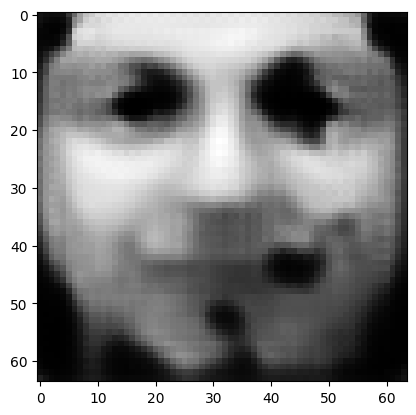

tensor([[2.2396e-06, 4.7312e-06, 7.8404e-04, 8.8142e-04, 5.1367e-06, 5.6273e-07,
         9.5687e-01, 8.7992e-06, 8.6725e-03, 6.3985e-05, 1.2440e-04, 6.8034e-05,
         3.3528e-04, 4.2693e-05, 5.7564e-06, 2.9333e-05, 6.5884e-03, 1.8577e-05,
         5.4656e-04, 1.7193e-05, 4.6448e-05, 2.9748e-03, 4.0450e-05, 9.2347e-04,
         8.3542e-03, 2.3039e-05, 1.0187e-04, 3.2172e-03, 1.9111e-03, 1.1490e-05,
         4.5421e-04, 4.6093e-05, 1.4766e-03, 2.7296e-05, 8.0352e-04, 2.7390e-05,
         5.2528e-04, 2.3132e-03, 1.5246e-03, 1.2872e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04408859461545944
tensor([[2.2321e-06, 4.7150e-06, 7.8147e-04, 8.7933e-04, 5.1161e-06, 5.6107e-07,
         9.5701e-01, 8.7705e-06, 8.6432e-03, 6.3722e-05, 1.2390e-04, 6.7792e-05,
         3.3411e-04, 4.2530e-05, 5.7260e-06, 2.9250e-05, 6.5717e-03, 1.8509e-05,
         5.4535e-04, 1.7126e-05, 4.6209e-05, 2.9666e-03, 4.0246e-05, 9.2105e-04,
         8.3275e-03, 2.2969e-05, 1.0152e-0

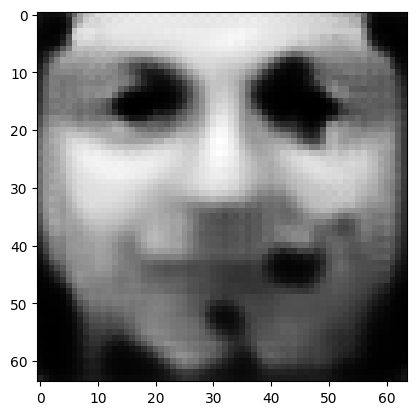

tensor([[2.2035e-06, 4.6517e-06, 7.7155e-04, 8.7078e-04, 5.0365e-06, 5.5463e-07,
         9.5753e-01, 8.6606e-06, 8.5301e-03, 6.2721e-05, 1.2194e-04, 6.6861e-05,
         3.2963e-04, 4.1901e-05, 5.6080e-06, 2.8935e-05, 6.5077e-03, 1.8246e-05,
         5.4063e-04, 1.6867e-05, 4.5283e-05, 2.9343e-03, 3.9455e-05, 9.1174e-04,
         8.2268e-03, 2.2697e-05, 1.0018e-04, 3.1689e-03, 1.8773e-03, 1.1221e-05,
         4.4693e-04, 4.5562e-05, 1.4554e-03, 2.6742e-05, 7.8773e-04, 2.6961e-05,
         5.1559e-04, 2.2709e-03, 1.4964e-03, 1.2617e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.043399274349212646
tensor([[2.1967e-06, 4.6367e-06, 7.6920e-04, 8.6880e-04, 5.0180e-06, 5.5313e-07,
         9.5765e-01, 8.6344e-06, 8.5031e-03, 6.2483e-05, 1.2148e-04, 6.6639e-05,
         3.2856e-04, 4.1750e-05, 5.5802e-06, 2.8860e-05, 6.4922e-03, 1.8184e-05,
         5.3950e-04, 1.6806e-05, 4.5065e-05, 2.9267e-03, 3.9268e-05, 9.0949e-04,
         8.2022e-03, 2.2632e-05, 9.9860e-

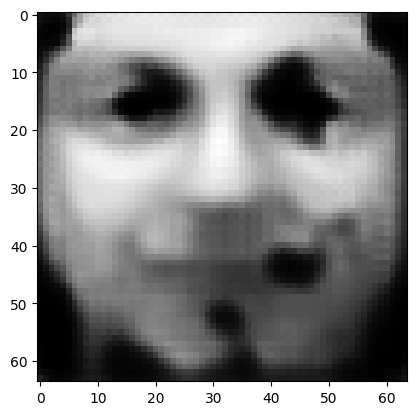

tensor([[2.1713e-06, 4.5802e-06, 7.6014e-04, 8.6102e-04, 4.9449e-06, 5.4730e-07,
         9.5813e-01, 8.5353e-06, 8.3987e-03, 6.1570e-05, 1.1971e-04, 6.5791e-05,
         3.2444e-04, 4.1184e-05, 5.4735e-06, 2.8573e-05, 6.4337e-03, 1.7948e-05,
         5.3520e-04, 1.6570e-05, 4.4224e-05, 2.8971e-03, 3.8552e-05, 9.0098e-04,
         8.1101e-03, 2.2383e-05, 9.8645e-05, 3.1244e-03, 1.8465e-03, 1.0977e-05,
         4.4022e-04, 4.5085e-05, 1.4361e-03, 2.6241e-05, 7.7336e-04, 2.6570e-05,
         5.0675e-04, 2.2329e-03, 1.4705e-03, 1.2384e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0427679605782032
tensor([[2.1652e-06, 4.5667e-06, 7.5794e-04, 8.5915e-04, 4.9272e-06, 5.4589e-07,
         9.5825e-01, 8.5114e-06, 8.3736e-03, 6.1350e-05, 1.1929e-04, 6.5587e-05,
         3.2344e-04, 4.1047e-05, 5.4480e-06, 2.8504e-05, 6.4197e-03, 1.7891e-05,
         5.3417e-04, 1.6513e-05, 4.4023e-05, 2.8900e-03, 3.8380e-05, 8.9894e-04,
         8.0880e-03, 2.2323e-05, 9.8354e-05

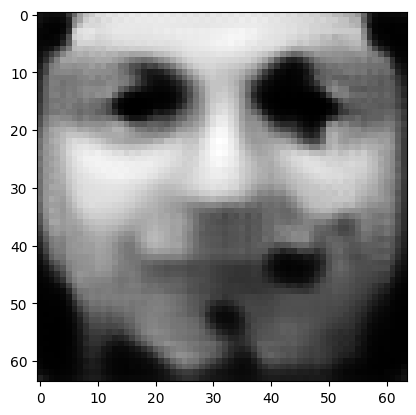

tensor([[2.1418e-06, 4.5147e-06, 7.4956e-04, 8.5196e-04, 4.8601e-06, 5.4051e-07,
         9.5869e-01, 8.4199e-06, 8.2773e-03, 6.0511e-05, 1.1767e-04, 6.4806e-05,
         3.1964e-04, 4.0525e-05, 5.3504e-06, 2.8239e-05, 6.3655e-03, 1.7674e-05,
         5.3018e-04, 1.6296e-05, 4.3253e-05, 2.8626e-03, 3.7724e-05, 8.9106e-04,
         8.0028e-03, 2.2093e-05, 9.7234e-05, 3.0834e-03, 1.8182e-03, 1.0753e-05,
         4.3401e-04, 4.4645e-05, 1.4182e-03, 2.5780e-05, 7.6013e-04, 2.6208e-05,
         4.9862e-04, 2.1979e-03, 1.4468e-03, 1.2170e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04218607768416405
tensor([[2.1362e-06, 4.5021e-06, 7.4755e-04, 8.5019e-04, 4.8441e-06, 5.3922e-07,
         9.5880e-01, 8.3979e-06, 8.2542e-03, 6.0311e-05, 1.1727e-04, 6.4619e-05,
         3.1873e-04, 4.0399e-05, 5.3269e-06, 2.8175e-05, 6.3524e-03, 1.7622e-05,
         5.2921e-04, 1.6244e-05, 4.3068e-05, 2.8560e-03, 3.7566e-05, 8.8915e-04,
         7.9824e-03, 2.2037e-05, 9.6962e-0

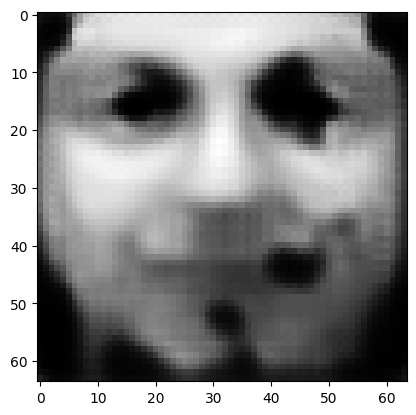

tensor([[2.1144e-06, 4.4533e-06, 7.3977e-04, 8.4336e-04, 4.7817e-06, 5.3419e-07,
         9.5921e-01, 8.3127e-06, 8.1640e-03, 5.9532e-05, 1.1576e-04, 6.3892e-05,
         3.1521e-04, 3.9914e-05, 5.2364e-06, 2.7925e-05, 6.3016e-03, 1.7418e-05,
         5.2546e-04, 1.6040e-05, 4.2356e-05, 2.8304e-03, 3.6958e-05, 8.8176e-04,
         7.9040e-03, 2.1824e-05, 9.5917e-05, 3.0452e-03, 1.7918e-03, 1.0545e-05,
         4.2825e-04, 4.4231e-05, 1.4015e-03, 2.5352e-05, 7.4791e-04, 2.5871e-05,
         4.9108e-04, 2.1653e-03, 1.4247e-03, 1.1972e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04164502024650574
tensor([[2.1091e-06, 4.4417e-06, 7.3793e-04, 8.4181e-04, 4.7668e-06, 5.3299e-07,
         9.5931e-01, 8.2921e-06, 8.1422e-03, 5.9344e-05, 1.1540e-04, 6.3718e-05,
         3.1436e-04, 3.9799e-05, 5.2150e-06, 2.7865e-05, 6.2893e-03, 1.7369e-05,
         5.2457e-04, 1.5992e-05, 4.2187e-05, 2.8243e-03, 3.6814e-05, 8.7997e-04,
         7.8848e-03, 2.1774e-05, 9.5667e-0

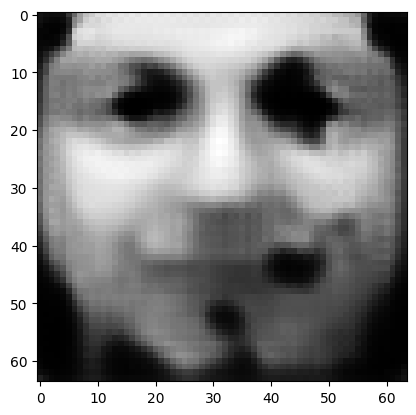

tensor([[2.0890e-06, 4.3966e-06, 7.3072e-04, 8.3545e-04, 4.7091e-06, 5.2832e-07,
         9.5969e-01, 8.2130e-06, 8.0585e-03, 5.8624e-05, 1.1400e-04, 6.3043e-05,
         3.1110e-04, 3.9349e-05, 5.1317e-06, 2.7633e-05, 6.2420e-03, 1.7179e-05,
         5.2107e-04, 1.5804e-05, 4.1530e-05, 2.8005e-03, 3.6254e-05, 8.7308e-04,
         7.8120e-03, 2.1576e-05, 9.4697e-05, 3.0098e-03, 1.7673e-03, 1.0354e-05,
         4.2292e-04, 4.3847e-05, 1.3859e-03, 2.4958e-05, 7.3656e-04, 2.5558e-05,
         4.8413e-04, 2.1351e-03, 1.4042e-03, 1.1788e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04114256799221039
tensor([[2.0841e-06, 4.3857e-06, 7.2898e-04, 8.3390e-04, 4.6954e-06, 5.2720e-07,
         9.5978e-01, 8.1941e-06, 8.0383e-03, 5.8452e-05, 1.1366e-04, 6.2882e-05,
         3.1031e-04, 3.9241e-05, 5.1117e-06, 2.7577e-05, 6.2306e-03, 1.7134e-05,
         5.2023e-04, 1.5759e-05, 4.1373e-05, 2.7948e-03, 3.6119e-05, 8.7143e-04,
         7.7945e-03, 2.1528e-05, 9.4463e-0

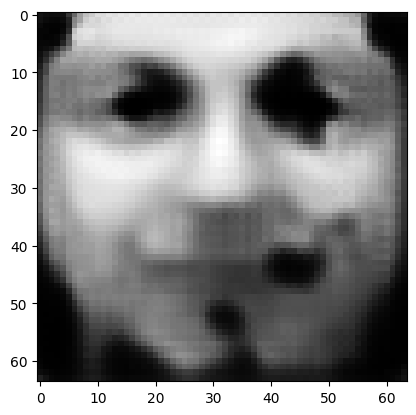

tensor([[2.0654e-06, 4.3440e-06, 7.2232e-04, 8.2807e-04, 4.6422e-06, 5.2287e-07,
         9.6014e-01, 8.1207e-06, 7.9606e-03, 5.7786e-05, 1.1236e-04, 6.2257e-05,
         3.0729e-04, 3.8826e-05, 5.0353e-06, 2.7362e-05, 6.1864e-03, 1.6959e-05,
         5.1699e-04, 1.5586e-05, 4.0771e-05, 2.7728e-03, 3.5604e-05, 8.6502e-04,
         7.7265e-03, 2.1345e-05, 9.3565e-05, 2.9769e-03, 1.7446e-03, 1.0177e-05,
         4.1797e-04, 4.3490e-05, 1.3714e-03, 2.4593e-05, 7.2607e-04, 2.5269e-05,
         4.7768e-04, 2.1071e-03, 1.3853e-03, 1.1618e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040675804018974304
tensor([[2.0609e-06, 4.3340e-06, 7.2071e-04, 8.2667e-04, 4.6293e-06, 5.2182e-07,
         9.6023e-01, 8.1030e-06, 7.9418e-03, 5.7625e-05, 1.1205e-04, 6.2106e-05,
         3.0656e-04, 3.8726e-05, 5.0169e-06, 2.7310e-05, 6.1758e-03, 1.6917e-05,
         5.1621e-04, 1.5544e-05, 4.0626e-05, 2.7674e-03, 3.5480e-05, 8.6348e-04,
         7.7101e-03, 2.1301e-05, 9.3351e-

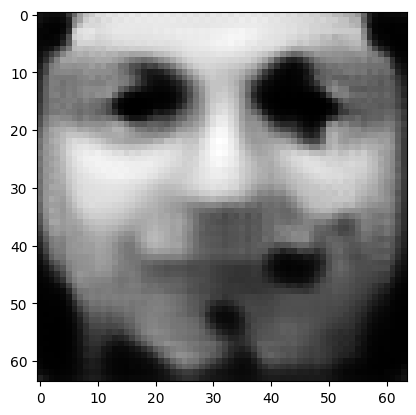

tensor([[2.0435e-06, 4.2951e-06, 7.1451e-04, 8.2120e-04, 4.5798e-06, 5.1779e-07,
         9.6056e-01, 8.0349e-06, 7.8697e-03, 5.7008e-05, 1.1085e-04, 6.1526e-05,
         3.0375e-04, 3.8340e-05, 4.9462e-06, 2.7110e-05, 6.1347e-03, 1.6754e-05,
         5.1318e-04, 1.5383e-05, 4.0068e-05, 2.7469e-03, 3.5003e-05, 8.5752e-04,
         7.6471e-03, 2.1130e-05, 9.2518e-05, 2.9463e-03, 1.7235e-03, 1.0014e-05,
         4.1336e-04, 4.3156e-05, 1.3580e-03, 2.4255e-05, 7.1633e-04, 2.4998e-05,
         4.7169e-04, 2.0811e-03, 1.3677e-03, 1.1461e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04024248942732811
tensor([[2.0393e-06, 4.2859e-06, 7.1303e-04, 8.1991e-04, 4.5682e-06, 5.1684e-07,
         9.6064e-01, 8.0186e-06, 7.8523e-03, 5.6860e-05, 1.1057e-04, 6.1387e-05,
         3.0307e-04, 3.8247e-05, 4.9294e-06, 2.7062e-05, 6.1247e-03, 1.6715e-05,
         5.1246e-04, 1.5345e-05, 3.9936e-05, 2.7420e-03, 3.4889e-05, 8.5608e-04,
         7.6316e-03, 2.1089e-05, 9.2315e-0

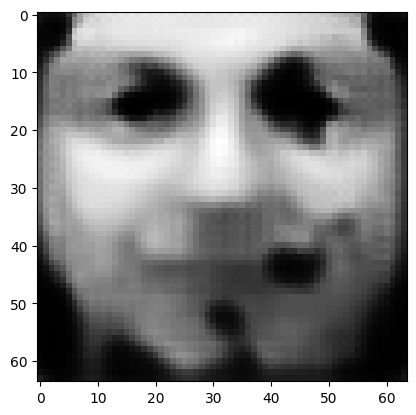

tensor([[2.0231e-06, 4.2498e-06, 7.0725e-04, 8.1480e-04, 4.5223e-06, 5.1309e-07,
         9.6094e-01, 7.9552e-06, 7.7851e-03, 5.6287e-05, 1.0945e-04, 6.0848e-05,
         3.0046e-04, 3.7889e-05, 4.8640e-06, 2.6875e-05, 6.0863e-03, 1.6564e-05,
         5.0964e-04, 1.5195e-05, 3.9420e-05, 2.7228e-03, 3.4447e-05, 8.5052e-04,
         7.5728e-03, 2.0930e-05, 9.1541e-05, 2.9178e-03, 1.7039e-03, 9.8630e-06,
         4.0908e-04, 4.2845e-05, 1.3454e-03, 2.3941e-05, 7.0729e-04, 2.4748e-05,
         4.6612e-04, 2.0570e-03, 1.3513e-03, 1.1315e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03983888402581215
tensor([[2.0192e-06, 4.2411e-06, 7.0586e-04, 8.1359e-04, 4.5111e-06, 5.1218e-07,
         9.6102e-01, 7.9399e-06, 7.7689e-03, 5.6149e-05, 1.0918e-04, 6.0718e-05,
         2.9983e-04, 3.7802e-05, 4.8484e-06, 2.6830e-05, 6.0770e-03, 1.6528e-05,
         5.0896e-04, 1.5159e-05, 3.9296e-05, 2.7182e-03, 3.4342e-05, 8.4919e-04,
         7.5586e-03, 2.0892e-05, 9.1355e-0

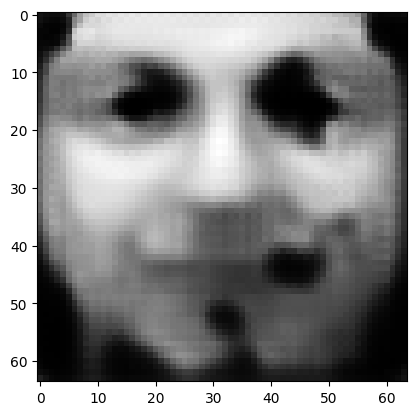

tensor([[2.0041e-06, 4.2077e-06, 7.0049e-04, 8.0887e-04, 4.4687e-06, 5.0869e-07,
         9.6131e-01, 7.8809e-06, 7.7065e-03, 5.5617e-05, 1.0815e-04, 6.0218e-05,
         2.9739e-04, 3.7469e-05, 4.7881e-06, 2.6657e-05, 6.0411e-03, 1.6388e-05,
         5.0634e-04, 1.5021e-05, 3.8820e-05, 2.7003e-03, 3.3934e-05, 8.4401e-04,
         7.5036e-03, 2.0744e-05, 9.0634e-05, 2.8913e-03, 1.6857e-03, 9.7230e-06,
         4.0509e-04, 4.2555e-05, 1.3337e-03, 2.3650e-05, 6.9888e-04, 2.4515e-05,
         4.6096e-04, 2.0345e-03, 1.3362e-03, 1.1180e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03946307674050331
tensor([[2.0005e-06, 4.1995e-06, 6.9920e-04, 8.0771e-04, 4.4585e-06, 5.0785e-07,
         9.6137e-01, 7.8667e-06, 7.6914e-03, 5.5489e-05, 1.0790e-04, 6.0097e-05,
         2.9681e-04, 3.7389e-05, 4.7735e-06, 2.6615e-05, 6.0324e-03, 1.6354e-05,
         5.0570e-04, 1.4988e-05, 3.8705e-05, 2.6960e-03, 3.3835e-05, 8.4275e-04,
         7.4903e-03, 2.0709e-05, 9.0459e-0

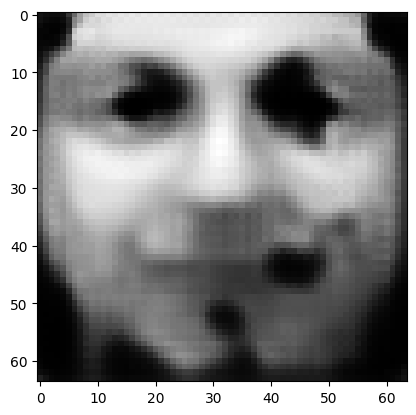

tensor([[1.9865e-06, 4.1683e-06, 6.9421e-04, 8.0331e-04, 4.4189e-06, 5.0460e-07,
         9.6164e-01, 7.8116e-06, 7.6332e-03, 5.4995e-05, 1.0694e-04, 5.9630e-05,
         2.9454e-04, 3.7079e-05, 4.7175e-06, 2.6452e-05, 5.9988e-03, 1.6223e-05,
         5.0324e-04, 1.4859e-05, 3.8264e-05, 2.6793e-03, 3.3457e-05, 8.3790e-04,
         7.4390e-03, 2.0571e-05, 8.9788e-05, 2.8665e-03, 1.6687e-03, 9.5931e-06,
         4.0136e-04, 4.2283e-05, 1.3228e-03, 2.3379e-05, 6.9105e-04, 2.4297e-05,
         4.5614e-04, 2.0137e-03, 1.3220e-03, 1.1054e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039112694561481476
tensor([[1.9831e-06, 4.1608e-06, 6.9299e-04, 8.0225e-04, 4.4093e-06, 5.0381e-07,
         9.6171e-01, 7.7983e-06, 7.6191e-03, 5.4875e-05, 1.0670e-04, 5.9517e-05,
         2.9400e-04, 3.7004e-05, 4.7041e-06, 2.6413e-05, 5.9907e-03, 1.6192e-05,
         5.0265e-04, 1.4828e-05, 3.8158e-05, 2.6753e-03, 3.3365e-05, 8.3673e-04,
         7.4266e-03, 2.0538e-05, 8.9627e-

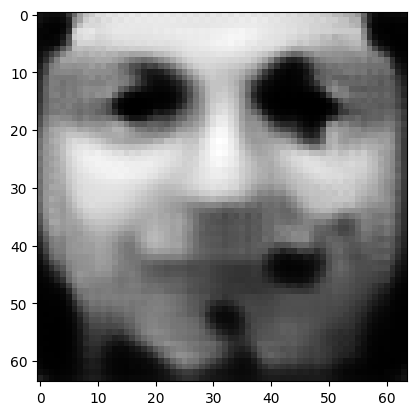

tensor([[1.9699e-06, 4.1315e-06, 6.8832e-04, 7.9810e-04, 4.3723e-06, 5.0076e-07,
         9.6196e-01, 7.7468e-06, 7.5648e-03, 5.4414e-05, 1.0581e-04, 5.9081e-05,
         2.9188e-04, 3.6714e-05, 4.6520e-06, 2.6261e-05, 5.9592e-03, 1.6070e-05,
         5.0034e-04, 1.4707e-05, 3.7746e-05, 2.6596e-03, 3.3013e-05, 8.3219e-04,
         7.3788e-03, 2.0408e-05, 8.9000e-05, 2.8434e-03, 1.6529e-03, 9.4720e-06,
         3.9788e-04, 4.2028e-05, 1.3126e-03, 2.3126e-05, 6.8374e-04, 2.4093e-05,
         4.5164e-04, 1.9941e-03, 1.3088e-03, 1.0936e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03878546878695488
tensor([[1.9668e-06, 4.1245e-06, 6.8719e-04, 7.9708e-04, 4.3635e-06, 5.0003e-07,
         9.6202e-01, 7.7344e-06, 7.5516e-03, 5.4304e-05, 1.0559e-04, 5.8977e-05,
         2.9137e-04, 3.6644e-05, 4.6395e-06, 2.6225e-05, 5.9516e-03, 1.6040e-05,
         4.9978e-04, 1.4678e-05, 3.7647e-05, 2.6559e-03, 3.2928e-05, 8.3110e-04,
         7.3673e-03, 2.0377e-05, 8.8849e-0

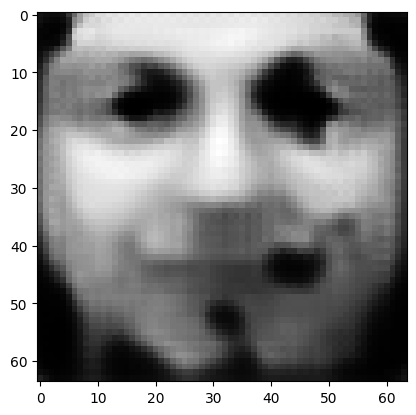

tensor([[1.9547e-06, 4.0976e-06, 6.8291e-04, 7.9331e-04, 4.3295e-06, 4.9722e-07,
         9.6225e-01, 7.6874e-06, 7.5011e-03, 5.3879e-05, 1.0476e-04, 5.8575e-05,
         2.8942e-04, 3.6377e-05, 4.5916e-06, 2.6086e-05, 5.9227e-03, 1.5928e-05,
         4.9767e-04, 1.4568e-05, 3.7272e-05, 2.6415e-03, 3.2602e-05, 8.2693e-04,
         7.3225e-03, 2.0258e-05, 8.8270e-05, 2.8218e-03, 1.6383e-03, 9.3608e-06,
         3.9465e-04, 4.1793e-05, 1.3032e-03, 2.2893e-05, 6.7701e-04, 2.3905e-05,
         4.4749e-04, 1.9761e-03, 1.2966e-03, 1.0828e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03848199546337128
tensor([[1.9518e-06, 4.0911e-06, 6.8188e-04, 7.9240e-04, 4.3211e-06, 4.9654e-07,
         9.6230e-01, 7.6760e-06, 7.4889e-03, 5.3777e-05, 1.0456e-04, 5.8477e-05,
         2.8895e-04, 3.6312e-05, 4.5800e-06, 2.6052e-05, 5.9157e-03, 1.5900e-05,
         4.9716e-04, 1.4542e-05, 3.7181e-05, 2.6380e-03, 3.2524e-05, 8.2592e-04,
         7.3117e-03, 2.0229e-05, 8.8132e-0

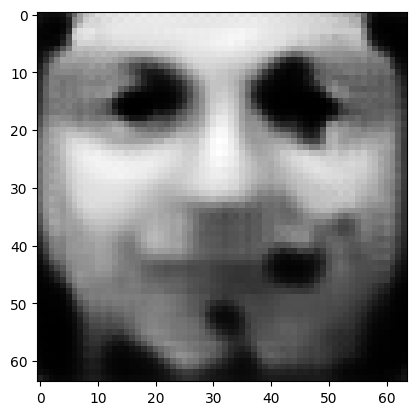

tensor([[1.9405e-06, 4.0661e-06, 6.7787e-04, 7.8887e-04, 4.2894e-06, 4.9392e-07,
         9.6252e-01, 7.6319e-06, 7.4415e-03, 5.3380e-05, 1.0379e-04, 5.8102e-05,
         2.8712e-04, 3.6062e-05, 4.5355e-06, 2.5923e-05, 5.8885e-03, 1.5795e-05,
         4.9518e-04, 1.4439e-05, 3.6832e-05, 2.6245e-03, 3.2221e-05, 8.2201e-04,
         7.2698e-03, 2.0118e-05, 8.7591e-05, 2.8017e-03, 1.6246e-03, 9.2570e-06,
         3.9162e-04, 4.1572e-05, 1.2944e-03, 2.2676e-05, 6.7071e-04, 2.3728e-05,
         4.4362e-04, 1.9593e-03, 1.2852e-03, 1.0726e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03819885104894638
tensor([[1.9378e-06, 4.0600e-06, 6.7690e-04, 7.8800e-04, 4.2817e-06, 4.9328e-07,
         9.6257e-01, 7.6213e-06, 7.4301e-03, 5.3285e-05, 1.0360e-04, 5.8011e-05,
         2.8668e-04, 3.6002e-05, 4.5247e-06, 2.5891e-05, 5.8820e-03, 1.5769e-05,
         4.9470e-04, 1.4414e-05, 3.6747e-05, 2.6213e-03, 3.2147e-05, 8.2107e-04,
         7.2596e-03, 2.0091e-05, 8.7460e-0

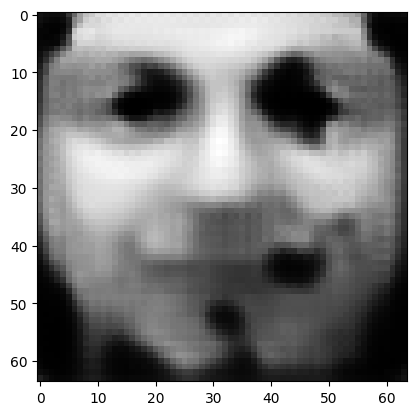

tensor([[1.9271e-06, 4.0365e-06, 6.7314e-04, 7.8467e-04, 4.2517e-06, 4.9080e-07,
         9.6278e-01, 7.5800e-06, 7.3858e-03, 5.2912e-05, 1.0288e-04, 5.7659e-05,
         2.8497e-04, 3.5769e-05, 4.4831e-06, 2.5769e-05, 5.8565e-03, 1.5671e-05,
         4.9284e-04, 1.4317e-05, 3.6420e-05, 2.6086e-03, 3.1863e-05, 8.1741e-04,
         7.2206e-03, 1.9986e-05, 8.6956e-05, 2.7829e-03, 1.6119e-03, 9.1600e-06,
         3.8879e-04, 4.1365e-05, 1.2861e-03, 2.2473e-05, 6.6482e-04, 2.3562e-05,
         4.3999e-04, 1.9436e-03, 1.2746e-03, 1.0632e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03793342038989067
tensor([[1.9246e-06, 4.0308e-06, 6.7224e-04, 7.8388e-04, 4.2447e-06, 4.9022e-07,
         9.6283e-01, 7.5700e-06, 7.3751e-03, 5.2823e-05, 1.0270e-04, 5.7574e-05,
         2.8456e-04, 3.5712e-05, 4.4731e-06, 2.5740e-05, 5.8503e-03, 1.5647e-05,
         4.9239e-04, 1.4294e-05, 3.6342e-05, 2.6055e-03, 3.1795e-05, 8.1651e-04,
         7.2110e-03, 1.9961e-05, 8.6833e-0

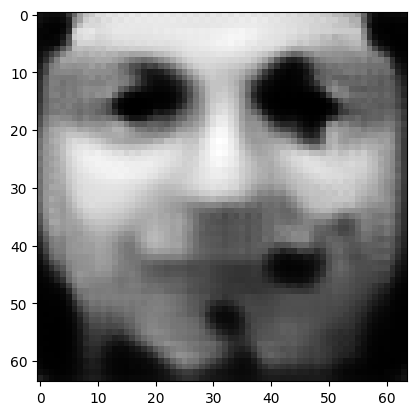

tensor([[1.9146e-06, 4.0088e-06, 6.6871e-04, 7.8075e-04, 4.2166e-06, 4.8790e-07,
         9.6302e-01, 7.5312e-06, 7.3335e-03, 5.2474e-05, 1.0203e-04, 5.7244e-05,
         2.8295e-04, 3.5494e-05, 4.4343e-06, 2.5625e-05, 5.8263e-03, 1.5554e-05,
         4.9064e-04, 1.4204e-05, 3.6037e-05, 2.5936e-03, 3.1530e-05, 8.1307e-04,
         7.1744e-03, 1.9863e-05, 8.6360e-05, 2.7653e-03, 1.5999e-03, 9.0695e-06,
         3.8613e-04, 4.1171e-05, 1.2783e-03, 2.2283e-05, 6.5931e-04, 2.3407e-05,
         4.3660e-04, 1.9289e-03, 1.2646e-03, 1.0543e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03768467903137207
tensor([[1.9122e-06, 4.0035e-06, 6.6786e-04, 7.7997e-04, 4.2100e-06, 4.8734e-07,
         9.6306e-01, 7.5219e-06, 7.3235e-03, 5.2391e-05, 1.0186e-04, 5.7165e-05,
         2.8257e-04, 3.5441e-05, 4.4249e-06, 2.5598e-05, 5.8206e-03, 1.5532e-05,
         4.9022e-04, 1.4182e-05, 3.5963e-05, 2.5907e-03, 3.1466e-05, 8.1224e-04,
         7.1655e-03, 1.9839e-05, 8.6245e-0

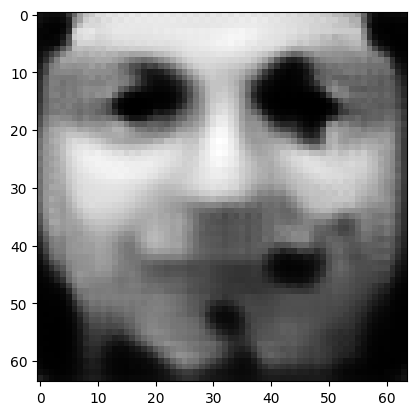

tensor([[1.9028e-06, 3.9828e-06, 6.6455e-04, 7.7706e-04, 4.1839e-06, 4.8517e-07,
         9.6324e-01, 7.4854e-06, 7.2848e-03, 5.2066e-05, 1.0123e-04, 5.6858e-05,
         2.8106e-04, 3.5236e-05, 4.3889e-06, 2.5490e-05, 5.7981e-03, 1.5446e-05,
         4.8858e-04, 1.4097e-05, 3.5680e-05, 2.5796e-03, 3.1221e-05, 8.0902e-04,
         7.1313e-03, 1.9748e-05, 8.5802e-05, 2.7487e-03, 1.5887e-03, 8.9851e-06,
         3.8365e-04, 4.0990e-05, 1.2710e-03, 2.2106e-05, 6.5418e-04, 2.3262e-05,
         4.3342e-04, 1.9151e-03, 1.2553e-03, 1.0461e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03745206445455551
tensor([[1.9006e-06, 3.9778e-06, 6.6374e-04, 7.7632e-04, 4.1777e-06, 4.8465e-07,
         9.6328e-01, 7.4766e-06, 7.2754e-03, 5.1988e-05, 1.0108e-04, 5.6783e-05,
         2.8069e-04, 3.5186e-05, 4.3801e-06, 2.5463e-05, 5.7927e-03, 1.5425e-05,
         4.8818e-04, 1.4077e-05, 3.5611e-05, 2.5769e-03, 3.1162e-05, 8.0823e-04,
         7.1230e-03, 1.9726e-05, 8.5693e-0

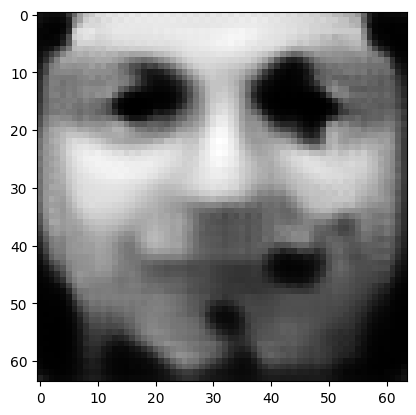

tensor([[1.8918e-06, 3.9583e-06, 6.6063e-04, 7.7356e-04, 4.1534e-06, 4.8262e-07,
         9.6345e-01, 7.4424e-06, 7.2391e-03, 5.1684e-05, 1.0049e-04, 5.6495e-05,
         2.7928e-04, 3.4994e-05, 4.3464e-06, 2.5362e-05, 5.7716e-03, 1.5345e-05,
         4.8664e-04, 1.3998e-05, 3.5346e-05, 2.5664e-03, 3.0933e-05, 8.0520e-04,
         7.0908e-03, 1.9640e-05, 8.5276e-05, 2.7331e-03, 1.5781e-03, 8.9062e-06,
         3.8133e-04, 4.0819e-05, 1.2642e-03, 2.1939e-05, 6.4938e-04, 2.3126e-05,
         4.3043e-04, 1.9022e-03, 1.2466e-03, 1.0384e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037233754992485046
tensor([[1.8897e-06, 3.9536e-06, 6.5988e-04, 7.7290e-04, 4.1474e-06, 4.8212e-07,
         9.6349e-01, 7.4341e-06, 7.2303e-03, 5.1610e-05, 1.0034e-04, 5.6426e-05,
         2.7893e-04, 3.4947e-05, 4.3383e-06, 2.5337e-05, 5.7665e-03, 1.5325e-05,
         4.8626e-04, 1.3978e-05, 3.5281e-05, 2.5638e-03, 3.0877e-05, 8.0447e-04,
         7.0830e-03, 1.9619e-05, 8.5175e-

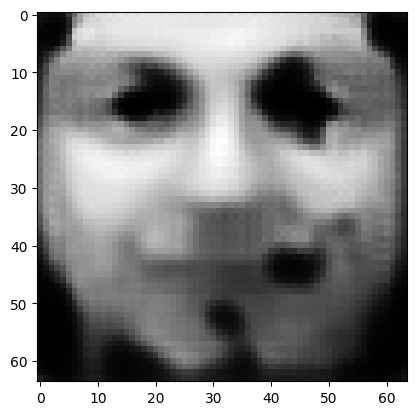

tensor([[1.8814e-06, 3.9354e-06, 6.5694e-04, 7.7027e-04, 4.1245e-06, 4.8020e-07,
         9.6365e-01, 7.4019e-06, 7.1961e-03, 5.1324e-05, 9.9785e-05, 5.6155e-05,
         2.7760e-04, 3.4766e-05, 4.3066e-06, 2.5242e-05, 5.7467e-03, 1.5249e-05,
         4.8481e-04, 1.3904e-05, 3.5032e-05, 2.5539e-03, 3.0662e-05, 8.0162e-04,
         7.0528e-03, 1.9538e-05, 8.4783e-05, 2.7185e-03, 1.5682e-03, 8.8319e-06,
         3.7914e-04, 4.0657e-05, 1.2577e-03, 2.1782e-05, 6.4486e-04, 2.2998e-05,
         4.2763e-04, 1.8900e-03, 1.2383e-03, 1.0311e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03702837601304054
tensor([[1.8794e-06, 3.9310e-06, 6.5624e-04, 7.6967e-04, 4.1190e-06, 4.7974e-07,
         9.6369e-01, 7.3941e-06, 7.1878e-03, 5.1255e-05, 9.9651e-05, 5.6089e-05,
         2.7728e-04, 3.4723e-05, 4.2991e-06, 2.5219e-05, 5.7418e-03, 1.5231e-05,
         4.8446e-04, 1.3886e-05, 3.4972e-05, 2.5516e-03, 3.0610e-05, 8.0093e-04,
         7.0454e-03, 1.9519e-05, 8.4688e-0

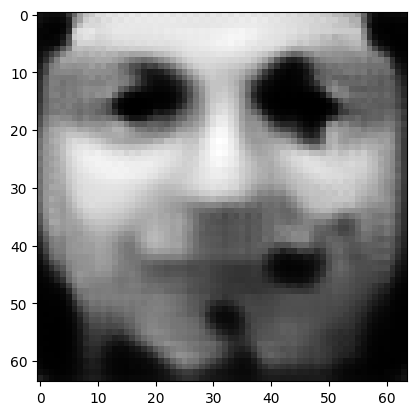

tensor([[1.8716e-06, 3.9138e-06, 6.5348e-04, 7.6720e-04, 4.0975e-06, 4.7793e-07,
         9.6384e-01, 7.3638e-06, 7.1557e-03, 5.0986e-05, 9.9127e-05, 5.5835e-05,
         2.7603e-04, 3.4553e-05, 4.2693e-06, 2.5129e-05, 5.7231e-03, 1.5160e-05,
         4.8309e-04, 1.3816e-05, 3.4739e-05, 2.5422e-03, 3.0408e-05, 7.9824e-04,
         7.0169e-03, 1.9443e-05, 8.4319e-05, 2.7047e-03, 1.5589e-03, 8.7624e-06,
         3.7708e-04, 4.0506e-05, 1.2517e-03, 2.1635e-05, 6.4061e-04, 2.2877e-05,
         4.2499e-04, 1.8786e-03, 1.2306e-03, 1.0243e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036835137754678726
tensor([[1.8697e-06, 3.9096e-06, 6.5281e-04, 7.6661e-04, 4.0922e-06, 4.7749e-07,
         9.6387e-01, 7.3565e-06, 7.1479e-03, 5.0921e-05, 9.9000e-05, 5.5773e-05,
         2.7572e-04, 3.4512e-05, 4.2622e-06, 2.5107e-05, 5.7186e-03, 1.5142e-05,
         4.8276e-04, 1.3799e-05, 3.4682e-05, 2.5400e-03, 3.0359e-05, 7.9759e-04,
         7.0100e-03, 1.9425e-05, 8.4230e-

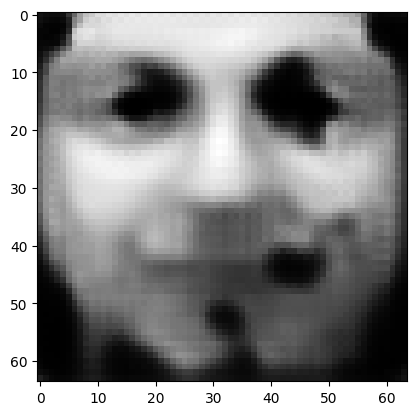

tensor([[1.8624e-06, 3.8935e-06, 6.5022e-04, 7.6431e-04, 4.0721e-06, 4.7580e-07,
         9.6401e-01, 7.3280e-06, 7.1177e-03, 5.0669e-05, 9.8509e-05, 5.5534e-05,
         2.7455e-04, 3.4352e-05, 4.2344e-06, 2.5022e-05, 5.7010e-03, 1.5076e-05,
         4.8147e-04, 1.3733e-05, 3.4464e-05, 2.5312e-03, 3.0170e-05, 7.9507e-04,
         6.9832e-03, 1.9353e-05, 8.3883e-05, 2.6917e-03, 1.5502e-03, 8.6971e-06,
         3.7514e-04, 4.0364e-05, 1.2460e-03, 2.1498e-05, 6.3662e-04, 2.2764e-05,
         4.2252e-04, 1.8679e-03, 1.2234e-03, 1.0179e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036653582006692886
tensor([[1.8607e-06, 3.8896e-06, 6.4960e-04, 7.6375e-04, 4.0671e-06, 4.7538e-07,
         9.6404e-01, 7.3211e-06, 7.1103e-03, 5.0608e-05, 9.8390e-05, 5.5476e-05,
         2.7426e-04, 3.4314e-05, 4.2277e-06, 2.5002e-05, 5.6967e-03, 1.5059e-05,
         4.8116e-04, 1.3717e-05, 3.4411e-05, 2.5291e-03, 3.0124e-05, 7.9445e-04,
         6.9767e-03, 1.9336e-05, 8.3800e-

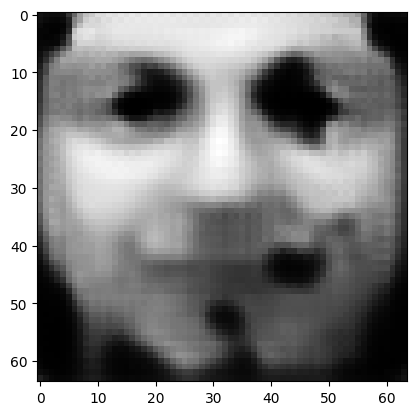

tensor([[1.8538e-06, 3.8744e-06, 6.4716e-04, 7.6158e-04, 4.0482e-06, 4.7379e-07,
         9.6418e-01, 7.2943e-06, 7.0819e-03, 5.0371e-05, 9.7927e-05, 5.5251e-05,
         2.7316e-04, 3.4163e-05, 4.2017e-06, 2.4922e-05, 5.6800e-03, 1.4996e-05,
         4.7994e-04, 1.3656e-05, 3.4205e-05, 2.5209e-03, 2.9946e-05, 7.9207e-04,
         6.9514e-03, 1.9269e-05, 8.3473e-05, 2.6795e-03, 1.5420e-03, 8.6358e-06,
         3.7332e-04, 4.0229e-05, 1.2406e-03, 2.1368e-05, 6.3287e-04, 2.2657e-05,
         4.2019e-04, 1.8578e-03, 1.2165e-03, 1.0119e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03648233786225319
tensor([[1.8521e-06, 3.8707e-06, 6.4657e-04, 7.6106e-04, 4.0435e-06, 4.7340e-07,
         9.6421e-01, 7.2878e-06, 7.0750e-03, 5.0313e-05, 9.7816e-05, 5.5197e-05,
         2.7289e-04, 3.4127e-05, 4.1954e-06, 2.4902e-05, 5.6760e-03, 1.4981e-05,
         4.7965e-04, 1.3641e-05, 3.4156e-05, 2.5189e-03, 2.9903e-05, 7.9150e-04,
         6.9452e-03, 1.9252e-05, 8.3394e-0

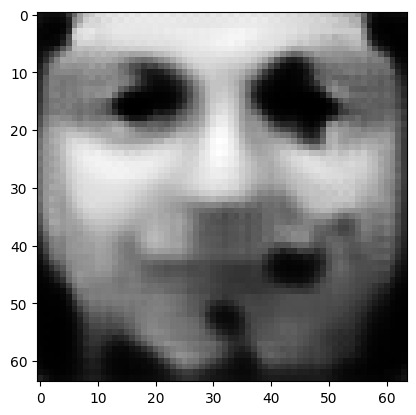

tensor([[1.8457e-06, 3.8564e-06, 6.4426e-04, 7.5899e-04, 4.0256e-06, 4.7189e-07,
         9.6433e-01, 7.2625e-06, 7.0481e-03, 5.0090e-05, 9.7380e-05, 5.4984e-05,
         2.7185e-04, 3.3985e-05, 4.1708e-06, 2.4827e-05, 5.6603e-03, 1.4922e-05,
         4.7850e-04, 1.3582e-05, 3.3962e-05, 2.5110e-03, 2.9736e-05, 7.8925e-04,
         6.9215e-03, 1.9189e-05, 8.3086e-05, 2.6680e-03, 1.5342e-03, 8.5781e-06,
         3.7160e-04, 4.0102e-05, 1.2355e-03, 2.1245e-05, 6.2933e-04, 2.2556e-05,
         4.1799e-04, 1.8482e-03, 1.2101e-03, 1.0062e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03632118180394173
tensor([[1.8441e-06, 3.8529e-06, 6.4370e-04, 7.5850e-04, 4.0213e-06, 4.7152e-07,
         9.6436e-01, 7.2563e-06, 7.0416e-03, 5.0035e-05, 9.7274e-05, 5.4933e-05,
         2.7159e-04, 3.3951e-05, 4.1649e-06, 2.4809e-05, 5.6565e-03, 1.4907e-05,
         4.7822e-04, 1.3568e-05, 3.3916e-05, 2.5092e-03, 2.9695e-05, 7.8871e-04,
         6.9157e-03, 1.9173e-05, 8.3012e-0

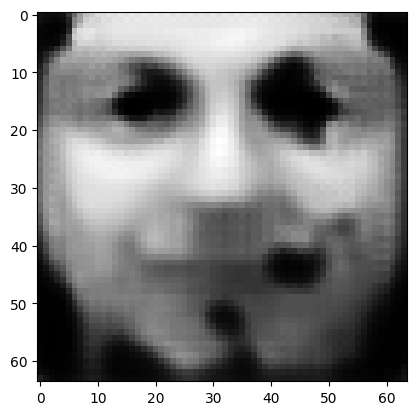

tensor([[1.8380e-06, 3.8395e-06, 6.4154e-04, 7.5657e-04, 4.0045e-06, 4.7011e-07,
         9.6448e-01, 7.2325e-06, 7.0164e-03, 4.9825e-05, 9.6864e-05, 5.4733e-05,
         2.7061e-04, 3.3818e-05, 4.1419e-06, 2.4738e-05, 5.6417e-03, 1.4851e-05,
         4.7714e-04, 1.3514e-05, 3.3734e-05, 2.5018e-03, 2.9538e-05, 7.8659e-04,
         6.8931e-03, 1.9114e-05, 8.2722e-05, 2.6572e-03, 1.5269e-03, 8.5239e-06,
         3.6998e-04, 3.9982e-05, 1.2308e-03, 2.1131e-05, 6.2600e-04, 2.2461e-05,
         4.1592e-04, 1.8393e-03, 1.2041e-03, 1.0009e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03616885095834732
tensor([[1.8365e-06, 3.8362e-06, 6.4101e-04, 7.5609e-04, 4.0004e-06, 4.6977e-07,
         9.6451e-01, 7.2268e-06, 7.0102e-03, 4.9774e-05, 9.6765e-05, 5.4685e-05,
         2.7037e-04, 3.3786e-05, 4.1363e-06, 2.4721e-05, 5.6381e-03, 1.4838e-05,
         4.7687e-04, 1.3500e-05, 3.3690e-05, 2.5000e-03, 2.9500e-05, 7.8607e-04,
         6.8877e-03, 1.9099e-05, 8.2652e-0

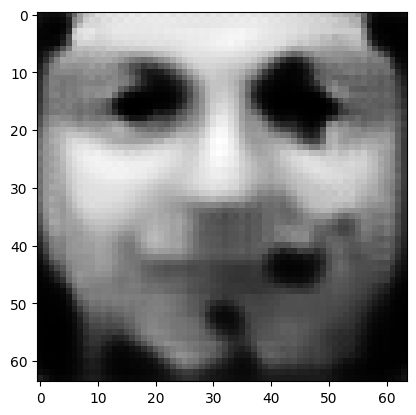

tensor([[1.8307e-06, 3.8235e-06, 6.3897e-04, 7.5428e-04, 3.9845e-06, 4.6842e-07,
         9.6462e-01, 7.2043e-06, 6.9864e-03, 4.9576e-05, 9.6379e-05, 5.4497e-05,
         2.6945e-04, 3.3660e-05, 4.1147e-06, 2.4654e-05, 5.6241e-03, 1.4785e-05,
         4.7585e-04, 1.3449e-05, 3.3520e-05, 2.4931e-03, 2.9353e-05, 7.8407e-04,
         6.8664e-03, 1.9043e-05, 8.2379e-05, 2.6469e-03, 1.5200e-03, 8.4729e-06,
         3.6845e-04, 3.9869e-05, 1.2262e-03, 2.1022e-05, 6.2287e-04, 2.2372e-05,
         4.1397e-04, 1.8308e-03, 1.1984e-03, 9.9588e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03602546826004982
tensor([[1.8293e-06, 3.8204e-06, 6.3847e-04, 7.5383e-04, 3.9807e-06, 4.6810e-07,
         9.6464e-01, 7.1988e-06, 6.9806e-03, 4.9528e-05, 9.6285e-05, 5.4451e-05,
         2.6922e-04, 3.3630e-05, 4.1094e-06, 2.4638e-05, 5.6207e-03, 1.4773e-05,
         4.7560e-04, 1.3436e-05, 3.3478e-05, 2.4914e-03, 2.9317e-05, 7.8358e-04,
         6.8613e-03, 1.9029e-05, 8.2312e-0

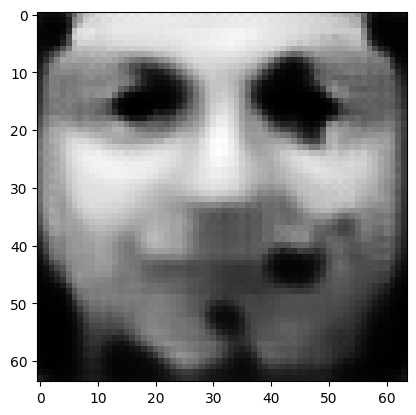

tensor([[1.8239e-06, 3.8084e-06, 6.3654e-04, 7.5210e-04, 3.9657e-06, 4.6683e-07,
         9.6475e-01, 7.1776e-06, 6.9581e-03, 4.9341e-05, 9.5921e-05, 5.4273e-05,
         2.6835e-04, 3.3511e-05, 4.0890e-06, 2.4574e-05, 5.6075e-03, 1.4723e-05,
         4.7464e-04, 1.3387e-05, 3.3318e-05, 2.4849e-03, 2.9177e-05, 7.8170e-04,
         6.8413e-03, 1.8976e-05, 8.2055e-05, 2.6373e-03, 1.5135e-03, 8.4248e-06,
         3.6701e-04, 3.9762e-05, 1.2220e-03, 2.0920e-05, 6.1991e-04, 2.2287e-05,
         4.1213e-04, 1.8229e-03, 1.1930e-03, 9.9114e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03589034453034401
tensor([[1.8226e-06, 3.8055e-06, 6.3608e-04, 7.5170e-04, 3.9622e-06, 4.6653e-07,
         9.6477e-01, 7.1725e-06, 6.9527e-03, 4.9296e-05, 9.5833e-05, 5.4230e-05,
         2.6814e-04, 3.3483e-05, 4.0841e-06, 2.4559e-05, 5.6042e-03, 1.4711e-05,
         4.7441e-04, 1.3376e-05, 3.3279e-05, 2.4833e-03, 2.9144e-05, 7.8124e-04,
         6.8364e-03, 1.8963e-05, 8.1992e-0

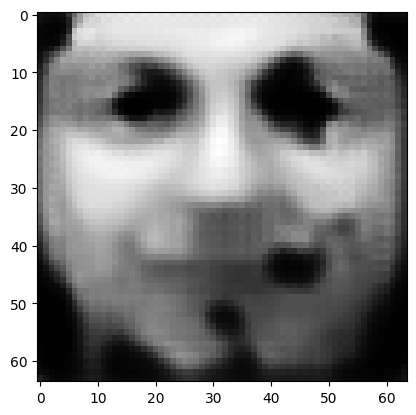

tensor([[1.8175e-06, 3.7942e-06, 6.3425e-04, 7.5007e-04, 3.9480e-06, 4.6533e-07,
         9.6487e-01, 7.1525e-06, 6.9315e-03, 4.9120e-05, 9.5490e-05, 5.4063e-05,
         2.6731e-04, 3.3371e-05, 4.0650e-06, 2.4500e-05, 5.5918e-03, 1.4664e-05,
         4.7350e-04, 1.3330e-05, 3.3128e-05, 2.4771e-03, 2.9013e-05, 7.7946e-04,
         6.8175e-03, 1.8913e-05, 8.1749e-05, 2.6282e-03, 1.5074e-03, 8.3796e-06,
         3.6565e-04, 3.9661e-05, 1.2180e-03, 2.0824e-05, 6.1713e-04, 2.2207e-05,
         4.1040e-04, 1.8153e-03, 1.1879e-03, 9.8669e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03576267883181572
tensor([[1.8162e-06, 3.7915e-06, 6.3381e-04, 7.4966e-04, 3.9446e-06, 4.6504e-07,
         9.6489e-01, 7.1477e-06, 6.9263e-03, 4.9077e-05, 9.5407e-05, 5.4022e-05,
         2.6711e-04, 3.3344e-05, 4.0603e-06, 2.4485e-05, 5.5887e-03, 1.4653e-05,
         4.7327e-04, 1.3319e-05, 3.3091e-05, 2.4756e-03, 2.8981e-05, 7.7903e-04,
         6.8129e-03, 1.8900e-05, 8.1690e-0

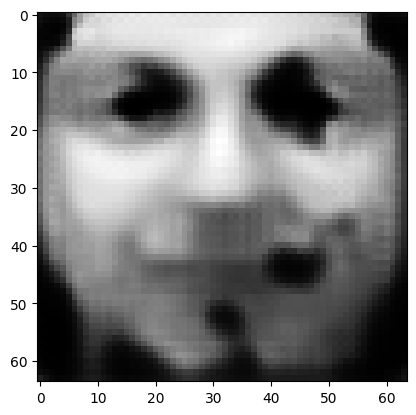

tensor([[1.8114e-06, 3.7808e-06, 6.3209e-04, 7.4814e-04, 3.9313e-06, 4.6392e-07,
         9.6499e-01, 7.1287e-06, 6.9063e-03, 4.8911e-05, 9.5083e-05, 5.3864e-05,
         2.6633e-04, 3.3239e-05, 4.0423e-06, 2.4429e-05, 5.5769e-03, 1.4609e-05,
         4.7242e-04, 1.3276e-05, 3.2948e-05, 2.4698e-03, 2.8857e-05, 7.7735e-04,
         6.7951e-03, 1.8853e-05, 8.1461e-05, 2.6196e-03, 1.5016e-03, 8.3370e-06,
         3.6437e-04, 3.9566e-05, 1.2142e-03, 2.0733e-05, 6.1450e-04, 2.2132e-05,
         4.0877e-04, 1.8083e-03, 1.1831e-03, 9.8248e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035642243921756744
tensor([[1.8102e-06, 3.7782e-06, 6.3167e-04, 7.4776e-04, 3.9281e-06, 4.6364e-07,
         9.6501e-01, 7.1242e-06, 6.9014e-03, 4.8871e-05, 9.5005e-05, 5.3826e-05,
         2.6614e-04, 3.3213e-05, 4.0379e-06, 2.4415e-05, 5.5740e-03, 1.4598e-05,
         4.7221e-04, 1.3265e-05, 3.2914e-05, 2.4684e-03, 2.8827e-05, 7.7694e-04,
         6.7907e-03, 1.8841e-05, 8.1405e-

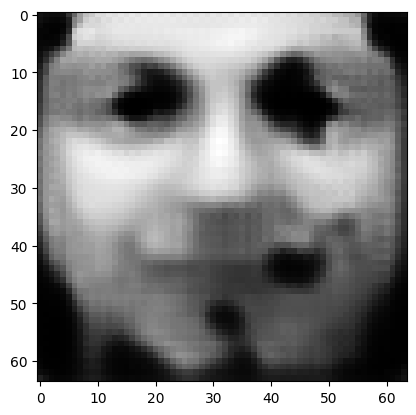

tensor([[1.8056e-06, 3.7682e-06, 6.3005e-04, 7.4632e-04, 3.9155e-06, 4.6258e-07,
         9.6510e-01, 7.1064e-06, 6.8826e-03, 4.8714e-05, 9.4700e-05, 5.3677e-05,
         2.6541e-04, 3.3114e-05, 4.0209e-06, 2.4362e-05, 5.5629e-03, 1.4556e-05,
         4.7140e-04, 1.3225e-05, 3.2780e-05, 2.4629e-03, 2.8711e-05, 7.7535e-04,
         6.7738e-03, 1.8797e-05, 8.1189e-05, 2.6114e-03, 1.4962e-03, 8.2969e-06,
         3.6316e-04, 3.9476e-05, 1.2106e-03, 2.0648e-05, 6.1202e-04, 2.2061e-05,
         4.0722e-04, 1.8016e-03, 1.1786e-03, 9.7851e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03552846610546112
tensor([[1.8045e-06, 3.7657e-06, 6.2966e-04, 7.4596e-04, 3.9125e-06, 4.6232e-07,
         9.6512e-01, 7.1020e-06, 6.8780e-03, 4.8677e-05, 9.4626e-05, 5.3641e-05,
         2.6523e-04, 3.3090e-05, 4.0168e-06, 2.4349e-05, 5.5602e-03, 1.4546e-05,
         4.7120e-04, 1.3215e-05, 3.2747e-05, 2.4615e-03, 2.8683e-05, 7.7496e-04,
         6.7698e-03, 1.8786e-05, 8.1136e-0

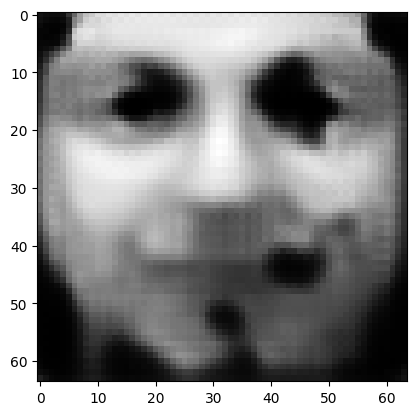

tensor([[1.8002e-06, 3.7562e-06, 6.2812e-04, 7.4457e-04, 3.9007e-06, 4.6132e-07,
         9.6520e-01, 7.0852e-06, 6.8601e-03, 4.8529e-05, 9.4338e-05, 5.3500e-05,
         2.6453e-04, 3.2996e-05, 4.0007e-06, 2.4299e-05, 5.5496e-03, 1.4507e-05,
         4.7043e-04, 1.3176e-05, 3.2620e-05, 2.4563e-03, 2.8573e-05, 7.7346e-04,
         6.7539e-03, 1.8743e-05, 8.0931e-05, 2.6037e-03, 1.4910e-03, 8.2591e-06,
         3.6201e-04, 3.9391e-05, 1.2072e-03, 2.0567e-05, 6.0968e-04, 2.1994e-05,
         4.0576e-04, 1.7953e-03, 1.1743e-03, 9.7477e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035420890897512436
tensor([[1.7991e-06, 3.7539e-06, 6.2775e-04, 7.4424e-04, 3.8978e-06, 4.6107e-07,
         9.6522e-01, 7.0811e-06, 6.8558e-03, 4.8493e-05, 9.4268e-05, 5.3465e-05,
         2.6436e-04, 3.2973e-05, 3.9968e-06, 2.4286e-05, 5.5470e-03, 1.4497e-05,
         4.7024e-04, 1.3167e-05, 3.2589e-05, 2.4550e-03, 2.8546e-05, 7.7309e-04,
         6.7500e-03, 1.8733e-05, 8.0881e-

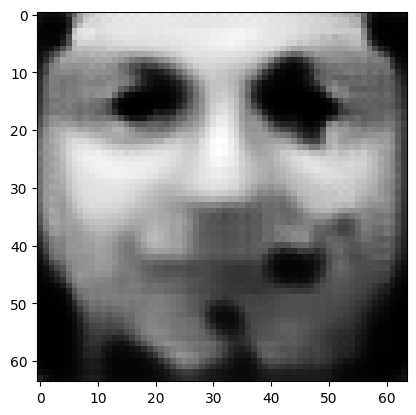

tensor([[1.7951e-06, 3.7449e-06, 6.2630e-04, 7.4295e-04, 3.8866e-06, 4.6012e-07,
         9.6530e-01, 7.0652e-06, 6.8389e-03, 4.8353e-05, 9.3996e-05, 5.3332e-05,
         2.6371e-04, 3.2884e-05, 3.9817e-06, 2.4239e-05, 5.5370e-03, 1.4460e-05,
         4.6951e-04, 1.3130e-05, 3.2470e-05, 2.4501e-03, 2.8443e-05, 7.7167e-04,
         6.7349e-03, 1.8693e-05, 8.0688e-05, 2.5965e-03, 1.4861e-03, 8.2233e-06,
         3.6093e-04, 3.9310e-05, 1.2040e-03, 2.0491e-05, 6.0747e-04, 2.1931e-05,
         4.0438e-04, 1.7893e-03, 1.1703e-03, 9.7123e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03531917184591293
tensor([[1.7941e-06, 3.7427e-06, 6.2594e-04, 7.4263e-04, 3.8839e-06, 4.5989e-07,
         9.6532e-01, 7.0613e-06, 6.8348e-03, 4.8319e-05, 9.3929e-05, 5.3300e-05,
         2.6355e-04, 3.2862e-05, 3.9780e-06, 2.4227e-05, 5.5346e-03, 1.4451e-05,
         4.6933e-04, 1.3121e-05, 3.2441e-05, 2.4489e-03, 2.8417e-05, 7.7132e-04,
         6.7312e-03, 1.8683e-05, 8.0640e-0

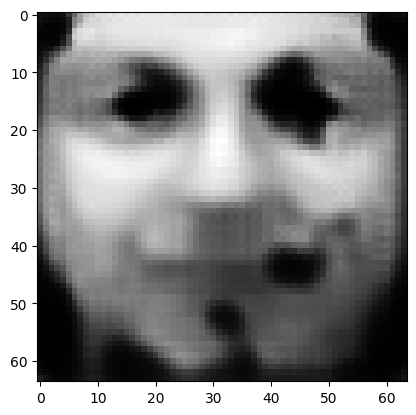

tensor([[1.7902e-06, 3.7342e-06, 6.2457e-04, 7.4139e-04, 3.8734e-06, 4.5899e-07,
         9.6539e-01, 7.0462e-06, 6.8187e-03, 4.8187e-05, 9.3671e-05, 5.3173e-05,
         2.6293e-04, 3.2779e-05, 3.9637e-06, 2.4182e-05, 5.5252e-03, 1.4416e-05,
         4.6864e-04, 1.3087e-05, 3.2328e-05, 2.4442e-03, 2.8319e-05, 7.6997e-04,
         6.7170e-03, 1.8645e-05, 8.0457e-05, 2.5896e-03, 1.4815e-03, 8.1894e-06,
         3.5991e-04, 3.9234e-05, 1.2010e-03, 2.0419e-05, 6.0538e-04, 2.1871e-05,
         4.0308e-04, 1.7836e-03, 1.1665e-03, 9.6787e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035222966223955154
tensor([[1.7892e-06, 3.7321e-06, 6.2424e-04, 7.4109e-04, 3.8708e-06, 4.5877e-07,
         9.6541e-01, 7.0425e-06, 6.8149e-03, 4.8155e-05, 9.3609e-05, 5.3143e-05,
         2.6278e-04, 3.2758e-05, 3.9602e-06, 2.4171e-05, 5.5229e-03, 1.4407e-05,
         4.6847e-04, 1.3079e-05, 3.2300e-05, 2.4431e-03, 2.8296e-05, 7.6965e-04,
         6.7136e-03, 1.8636e-05, 8.0412e-

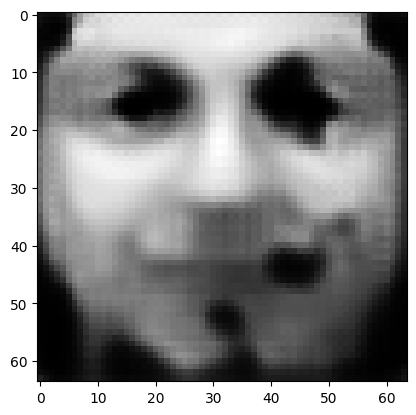

tensor([[1.7856e-06, 3.7241e-06, 6.2295e-04, 7.3992e-04, 3.8608e-06, 4.5792e-07,
         9.6548e-01, 7.0285e-06, 6.7998e-03, 4.8031e-05, 9.3368e-05, 5.3023e-05,
         2.6219e-04, 3.2679e-05, 3.9467e-06, 2.4129e-05, 5.5140e-03, 1.4374e-05,
         4.6782e-04, 1.3046e-05, 3.2194e-05, 2.4387e-03, 2.8203e-05, 7.6838e-04,
         6.7001e-03, 1.8600e-05, 8.0239e-05, 2.5832e-03, 1.4771e-03, 8.1576e-06,
         3.5894e-04, 3.9162e-05, 1.1981e-03, 2.0351e-05, 6.0340e-04, 2.1815e-05,
         4.0185e-04, 1.7782e-03, 1.1629e-03, 9.6470e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035132162272930145
tensor([[1.7846e-06, 3.7221e-06, 6.2264e-04, 7.3965e-04, 3.8584e-06, 4.5771e-07,
         9.6549e-01, 7.0250e-06, 6.7961e-03, 4.8001e-05, 9.3310e-05, 5.2994e-05,
         2.6205e-04, 3.2660e-05, 3.9435e-06, 2.4119e-05, 5.5118e-03, 1.4365e-05,
         4.6766e-04, 1.3039e-05, 3.2168e-05, 2.4376e-03, 2.8181e-05, 7.6807e-04,
         6.6968e-03, 1.8592e-05, 8.0198e-

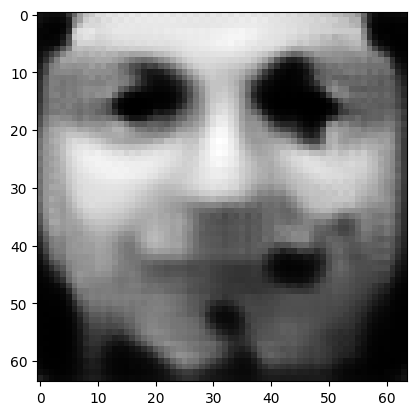

tensor([[1.7812e-06, 3.7145e-06, 6.2142e-04, 7.3854e-04, 3.8490e-06, 4.5691e-07,
         9.6556e-01, 7.0117e-06, 6.7819e-03, 4.7884e-05, 9.3082e-05, 5.2881e-05,
         2.6150e-04, 3.2584e-05, 3.9308e-06, 2.4079e-05, 5.5034e-03, 1.4334e-05,
         4.6704e-04, 1.3008e-05, 3.2067e-05, 2.4335e-03, 2.8093e-05, 7.6688e-04,
         6.6841e-03, 1.8558e-05, 8.0034e-05, 2.5771e-03, 1.4730e-03, 8.1276e-06,
         3.5803e-04, 3.9094e-05, 1.1954e-03, 2.0287e-05, 6.0154e-04, 2.1761e-05,
         4.0068e-04, 1.7732e-03, 1.1595e-03, 9.6170e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0350465290248394
tensor([[1.7803e-06, 3.7127e-06, 6.2112e-04, 7.3828e-04, 3.8467e-06, 4.5671e-07,
         9.6558e-01, 7.0085e-06, 6.7784e-03, 4.7855e-05, 9.3026e-05, 5.2853e-05,
         2.6136e-04, 3.2566e-05, 3.9277e-06, 2.4070e-05, 5.5013e-03, 1.4326e-05,
         4.6689e-04, 1.3001e-05, 3.2043e-05, 2.4325e-03, 2.8072e-05, 7.6659e-04,
         6.6810e-03, 1.8550e-05, 7.9995e-05

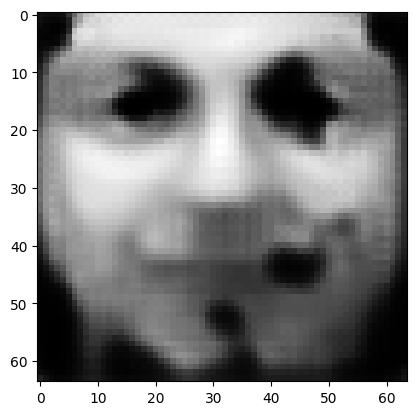

tensor([[1.7770e-06, 3.7055e-06, 6.1997e-04, 7.3724e-04, 3.8378e-06, 4.5596e-07,
         9.6564e-01, 6.9958e-06, 6.7649e-03, 4.7744e-05, 9.2811e-05, 5.2746e-05,
         2.6084e-04, 3.2495e-05, 3.9157e-06, 2.4032e-05, 5.4934e-03, 1.4296e-05,
         4.6631e-04, 1.2972e-05, 3.1948e-05, 2.4286e-03, 2.7989e-05, 7.6545e-04,
         6.6689e-03, 1.8518e-05, 7.9840e-05, 2.5713e-03, 1.4691e-03, 8.0992e-06,
         3.5716e-04, 3.9029e-05, 1.1929e-03, 2.0226e-05, 5.9978e-04, 2.1711e-05,
         3.9958e-04, 1.7684e-03, 1.1563e-03, 9.5887e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03496537730097771
tensor([[1.7762e-06, 3.7037e-06, 6.1969e-04, 7.3698e-04, 3.8356e-06, 4.5577e-07,
         9.6565e-01, 6.9928e-06, 6.7617e-03, 4.7717e-05, 9.2759e-05, 5.2720e-05,
         2.6071e-04, 3.2478e-05, 3.9128e-06, 2.4023e-05, 5.4914e-03, 1.4289e-05,
         4.6617e-04, 1.2965e-05, 3.1925e-05, 2.4276e-03, 2.7969e-05, 7.6518e-04,
         6.6660e-03, 1.8510e-05, 7.9802e-0

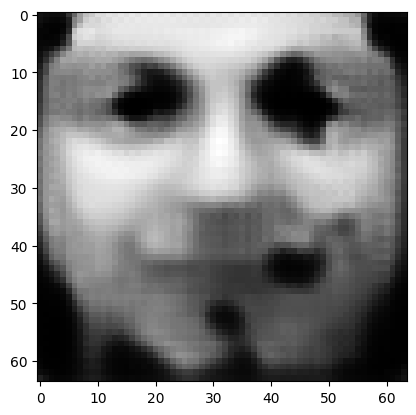

tensor([[1.7731e-06, 3.6970e-06, 6.1860e-04, 7.3600e-04, 3.8274e-06, 4.5506e-07,
         9.6571e-01, 6.9810e-06, 6.7489e-03, 4.7613e-05, 9.2555e-05, 5.2620e-05,
         2.6022e-04, 3.2411e-05, 3.9015e-06, 2.3988e-05, 5.4839e-03, 1.4261e-05,
         4.6562e-04, 1.2938e-05, 3.1835e-05, 2.4239e-03, 2.7891e-05, 7.6411e-04,
         6.6547e-03, 1.8480e-05, 7.9656e-05, 2.5658e-03, 1.4655e-03, 8.0727e-06,
         3.5635e-04, 3.8968e-05, 1.1905e-03, 2.0169e-05, 5.9812e-04, 2.1664e-05,
         3.9854e-04, 1.7638e-03, 1.1533e-03, 9.5622e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03488871082663536
tensor([[1.7724e-06, 3.6953e-06, 6.1833e-04, 7.3576e-04, 3.8253e-06, 4.5489e-07,
         9.6573e-01, 6.9782e-06, 6.7458e-03, 4.7588e-05, 9.2506e-05, 5.2595e-05,
         2.6010e-04, 3.2395e-05, 3.8988e-06, 2.3979e-05, 5.4820e-03, 1.4254e-05,
         4.6548e-04, 1.2931e-05, 3.1813e-05, 2.4230e-03, 2.7872e-05, 7.6385e-04,
         6.6519e-03, 1.8472e-05, 7.9620e-0

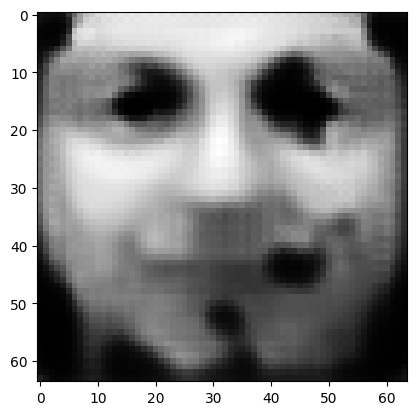

tensor([[1.7695e-06, 3.6889e-06, 6.1730e-04, 7.3482e-04, 3.8175e-06, 4.5421e-07,
         9.6578e-01, 6.9670e-06, 6.7338e-03, 4.7490e-05, 9.2312e-05, 5.2500e-05,
         2.5963e-04, 3.2331e-05, 3.8880e-06, 2.3946e-05, 5.4748e-03, 1.4227e-05,
         4.6496e-04, 1.2905e-05, 3.1728e-05, 2.4195e-03, 2.7798e-05, 7.6284e-04,
         6.6412e-03, 1.8444e-05, 7.9482e-05, 2.5607e-03, 1.4620e-03, 8.0475e-06,
         3.5558e-04, 3.8910e-05, 1.1882e-03, 2.0114e-05, 5.9656e-04, 2.1619e-05,
         3.9755e-04, 1.7595e-03, 1.1505e-03, 9.5372e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03481617942452431
tensor([[1.7688e-06, 3.6873e-06, 6.1705e-04, 7.3459e-04, 3.8155e-06, 4.5405e-07,
         9.6580e-01, 6.9643e-06, 6.7308e-03, 4.7466e-05, 9.2265e-05, 5.2477e-05,
         2.5951e-04, 3.2316e-05, 3.8854e-06, 2.3938e-05, 5.4731e-03, 1.4221e-05,
         4.6483e-04, 1.2899e-05, 3.1707e-05, 2.4187e-03, 2.7780e-05, 7.6259e-04,
         6.6386e-03, 1.8437e-05, 7.9448e-0

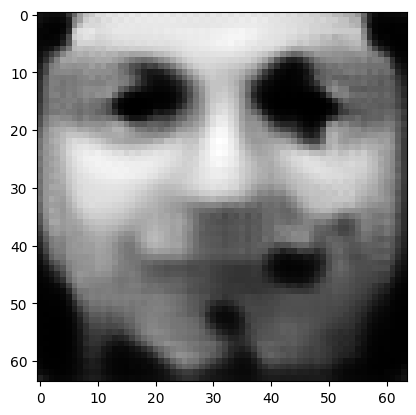

tensor([[1.7660e-06, 3.6812e-06, 6.1607e-04, 7.3371e-04, 3.8081e-06, 4.5341e-07,
         9.6585e-01, 6.9537e-06, 6.7194e-03, 4.7373e-05, 9.2083e-05, 5.2387e-05,
         2.5907e-04, 3.2256e-05, 3.8753e-06, 2.3906e-05, 5.4663e-03, 1.4195e-05,
         4.6434e-04, 1.2875e-05, 3.1627e-05, 2.4153e-03, 2.7710e-05, 7.6163e-04,
         6.6284e-03, 1.8409e-05, 7.9317e-05, 2.5558e-03, 1.4587e-03, 8.0237e-06,
         3.5485e-04, 3.8856e-05, 1.1860e-03, 2.0063e-05, 5.9508e-04, 2.1576e-05,
         3.9662e-04, 1.7555e-03, 1.1478e-03, 9.5135e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03474779054522514
tensor([[1.7654e-06, 3.6797e-06, 6.1583e-04, 7.3349e-04, 3.8063e-06, 4.5326e-07,
         9.6586e-01, 6.9512e-06, 6.7166e-03, 4.7350e-05, 9.2039e-05, 5.2365e-05,
         2.5896e-04, 3.2241e-05, 3.8728e-06, 2.3898e-05, 5.4646e-03, 1.4189e-05,
         4.6422e-04, 1.2869e-05, 3.1607e-05, 2.4145e-03, 2.7693e-05, 7.6140e-04,
         6.6259e-03, 1.8403e-05, 7.9285e-0

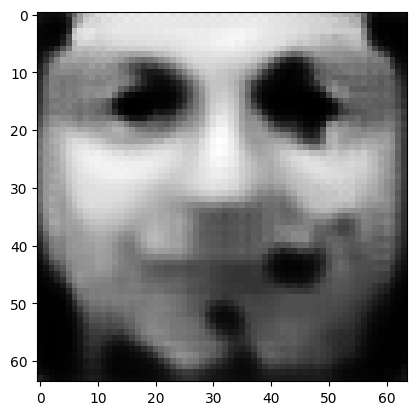

tensor([[1.7627e-06, 3.6740e-06, 6.1491e-04, 7.3266e-04, 3.7993e-06, 4.5265e-07,
         9.6591e-01, 6.9412e-06, 6.7058e-03, 4.7262e-05, 9.1866e-05, 5.2280e-05,
         2.5854e-04, 3.2184e-05, 3.8633e-06, 2.3868e-05, 5.4582e-03, 1.4165e-05,
         4.6375e-04, 1.2846e-05, 3.1532e-05, 2.4114e-03, 2.7627e-05, 7.6049e-04,
         6.6162e-03, 1.8377e-05, 7.9161e-05, 2.5511e-03, 1.4555e-03, 8.0013e-06,
         3.5417e-04, 3.8803e-05, 1.1840e-03, 2.0015e-05, 5.9368e-04, 2.1536e-05,
         3.9574e-04, 1.7517e-03, 1.1452e-03, 9.4911e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0346825048327446
tensor([[1.7621e-06, 3.6726e-06, 6.1468e-04, 7.3245e-04, 3.7976e-06, 4.5250e-07,
         9.6592e-01, 6.9387e-06, 6.7032e-03, 4.7241e-05, 9.1824e-05, 5.2259e-05,
         2.5844e-04, 3.2170e-05, 3.8609e-06, 2.3861e-05, 5.4566e-03, 1.4159e-05,
         4.6364e-04, 1.2840e-05, 3.1513e-05, 2.4106e-03, 2.7611e-05, 7.6027e-04,
         6.6139e-03, 1.8371e-05, 7.9131e-05

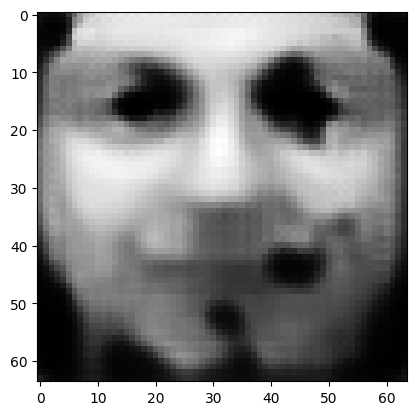

tensor([[1.7596e-06, 3.6671e-06, 6.1380e-04, 7.3166e-04, 3.7909e-06, 4.5193e-07,
         9.6597e-01, 6.9293e-06, 6.6929e-03, 4.7157e-05, 9.1660e-05, 5.2178e-05,
         2.5804e-04, 3.2116e-05, 3.8519e-06, 2.3833e-05, 5.4505e-03, 1.4137e-05,
         4.6319e-04, 1.2818e-05, 3.1441e-05, 2.4077e-03, 2.7549e-05, 7.5941e-04,
         6.6048e-03, 1.8346e-05, 7.9013e-05, 2.5467e-03, 1.4526e-03, 7.9800e-06,
         3.5351e-04, 3.8754e-05, 1.1821e-03, 1.9969e-05, 5.9235e-04, 2.1498e-05,
         3.9490e-04, 1.7480e-03, 1.1428e-03, 9.4699e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034620899707078934
tensor([[1.7590e-06, 3.6658e-06, 6.1359e-04, 7.3146e-04, 3.7893e-06, 4.5179e-07,
         9.6598e-01, 6.9269e-06, 6.6904e-03, 4.7137e-05, 9.1621e-05, 5.2158e-05,
         2.5795e-04, 3.2103e-05, 3.8497e-06, 2.3826e-05, 5.4491e-03, 1.4131e-05,
         4.6309e-04, 1.2813e-05, 3.1424e-05, 2.4069e-03, 2.7533e-05, 7.5920e-04,
         6.6026e-03, 1.8341e-05, 7.8985e-

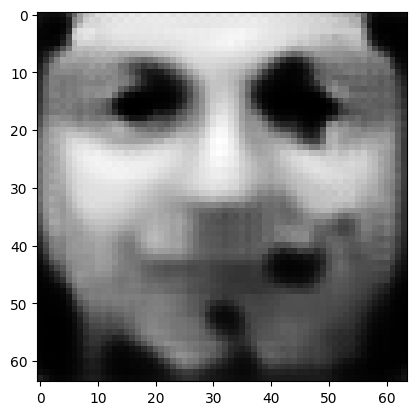

tensor([[1.7567e-06, 3.6607e-06, 6.1276e-04, 7.3071e-04, 3.7830e-06, 4.5125e-07,
         9.6603e-01, 6.9180e-06, 6.6807e-03, 4.7058e-05, 9.1466e-05, 5.2082e-05,
         2.5757e-04, 3.2052e-05, 3.8411e-06, 2.3799e-05, 5.4433e-03, 1.4110e-05,
         4.6267e-04, 1.2792e-05, 3.1356e-05, 2.4041e-03, 2.7474e-05, 7.5839e-04,
         6.5939e-03, 1.8318e-05, 7.8873e-05, 2.5426e-03, 1.4498e-03, 7.9599e-06,
         3.5290e-04, 3.8708e-05, 1.1802e-03, 1.9925e-05, 5.9110e-04, 2.1462e-05,
         3.9411e-04, 1.7446e-03, 1.1405e-03, 9.4499e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034562744200229645
tensor([[1.7561e-06, 3.6594e-06, 6.1256e-04, 7.3053e-04, 3.7815e-06, 4.5112e-07,
         9.6604e-01, 6.9158e-06, 6.6783e-03, 4.7039e-05, 9.1428e-05, 5.2063e-05,
         2.5748e-04, 3.2040e-05, 3.8390e-06, 2.3792e-05, 5.4419e-03, 1.4104e-05,
         4.6257e-04, 1.2787e-05, 3.1339e-05, 2.4034e-03, 2.7460e-05, 7.5819e-04,
         6.5918e-03, 1.8312e-05, 7.8846e-

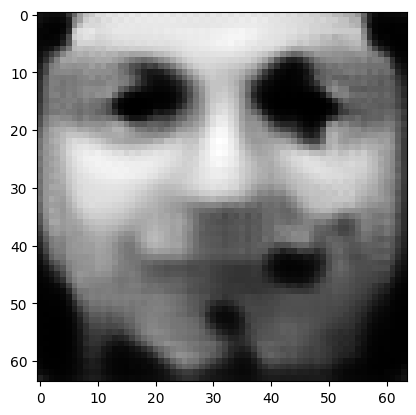

tensor([[1.7539e-06, 3.6545e-06, 6.1177e-04, 7.2982e-04, 3.7756e-06, 4.5060e-07,
         9.6608e-01, 6.9073e-06, 6.6691e-03, 4.6964e-05, 9.1282e-05, 5.1991e-05,
         2.5712e-04, 3.1992e-05, 3.8309e-06, 2.3767e-05, 5.4364e-03, 1.4084e-05,
         4.6217e-04, 1.2768e-05, 3.1275e-05, 2.4008e-03, 2.7404e-05, 7.5742e-04,
         6.5835e-03, 1.8290e-05, 7.8741e-05, 2.5386e-03, 1.4471e-03, 7.9409e-06,
         3.5231e-04, 3.8663e-05, 1.1785e-03, 1.9884e-05, 5.8991e-04, 2.1428e-05,
         3.9336e-04, 1.7413e-03, 1.1383e-03, 9.4308e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034507352858781815
tensor([[1.7534e-06, 3.6534e-06, 6.1158e-04, 7.2964e-04, 3.7741e-06, 4.5048e-07,
         9.6609e-01, 6.9052e-06, 6.6669e-03, 4.6946e-05, 9.1246e-05, 5.1974e-05,
         2.5703e-04, 3.1980e-05, 3.8289e-06, 2.3761e-05, 5.4350e-03, 1.4079e-05,
         4.6207e-04, 1.2763e-05, 3.1259e-05, 2.4001e-03, 2.7390e-05, 7.5723e-04,
         6.5815e-03, 1.8285e-05, 7.8715e-

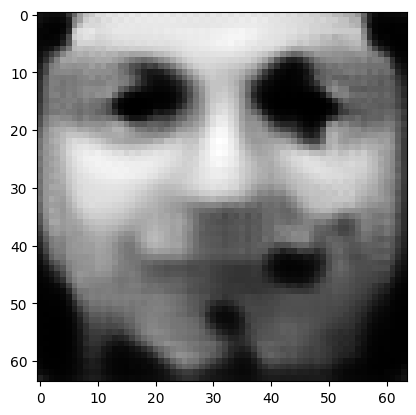

tensor([[1.7513e-06, 3.6487e-06, 6.1083e-04, 7.2896e-04, 3.7684e-06, 4.4999e-07,
         9.6613e-01, 6.8972e-06, 6.6582e-03, 4.6875e-05, 9.1107e-05, 5.1905e-05,
         2.5670e-04, 3.1934e-05, 3.8212e-06, 2.3736e-05, 5.4298e-03, 1.4060e-05,
         4.6169e-04, 1.2745e-05, 3.1198e-05, 2.3976e-03, 2.7337e-05, 7.5650e-04,
         6.5738e-03, 1.8264e-05, 7.8615e-05, 2.5349e-03, 1.4446e-03, 7.9228e-06,
         3.5176e-04, 3.8621e-05, 1.1768e-03, 1.9845e-05, 5.8878e-04, 2.1396e-05,
         3.9265e-04, 1.7382e-03, 1.1362e-03, 9.4129e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034454721957445145
tensor([[1.7508e-06, 3.6476e-06, 6.1065e-04, 7.2880e-04, 3.7671e-06, 4.4987e-07,
         9.6614e-01, 6.8952e-06, 6.6560e-03, 4.6858e-05, 9.1073e-05, 5.1888e-05,
         2.5661e-04, 3.1923e-05, 3.8194e-06, 2.3731e-05, 5.4286e-03, 1.4055e-05,
         4.6160e-04, 1.2740e-05, 3.1184e-05, 2.3970e-03, 2.7324e-05, 7.5632e-04,
         6.5719e-03, 1.8259e-05, 7.8591e-

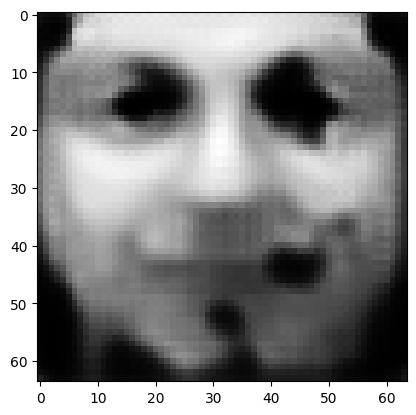

tensor([[1.7488e-06, 3.6432e-06, 6.0995e-04, 7.2816e-04, 3.7617e-06, 4.4941e-07,
         9.6618e-01, 6.8876e-06, 6.6478e-03, 4.6790e-05, 9.0941e-05, 5.1823e-05,
         2.5629e-04, 3.1880e-05, 3.8121e-06, 2.3708e-05, 5.4237e-03, 1.4037e-05,
         4.6124e-04, 1.2722e-05, 3.1126e-05, 2.3946e-03, 2.7274e-05, 7.5563e-04,
         6.5645e-03, 1.8239e-05, 7.8496e-05, 2.5313e-03, 1.4422e-03, 7.9057e-06,
         3.5123e-04, 3.8582e-05, 1.1753e-03, 1.9808e-05, 5.8771e-04, 2.1365e-05,
         3.9197e-04, 1.7353e-03, 1.1343e-03, 9.3958e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034405194222927094
tensor([[1.7483e-06, 3.6421e-06, 6.0977e-04, 7.2800e-04, 3.7604e-06, 4.4929e-07,
         9.6619e-01, 6.8857e-06, 6.6458e-03, 4.6774e-05, 9.0909e-05, 5.1807e-05,
         2.5622e-04, 3.1869e-05, 3.8103e-06, 2.3702e-05, 5.4224e-03, 1.4032e-05,
         4.6116e-04, 1.2718e-05, 3.1112e-05, 2.3940e-03, 2.7262e-05, 7.5546e-04,
         6.5627e-03, 1.8235e-05, 7.8473e-

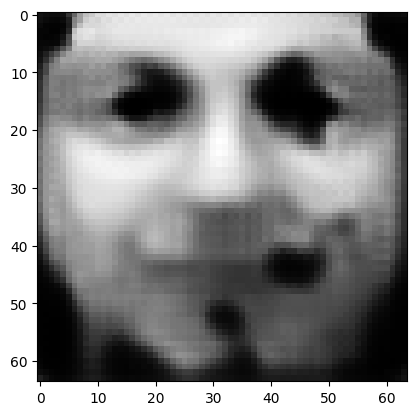

tensor([[1.7464e-06, 3.6380e-06, 6.0910e-04, 7.2740e-04, 3.7553e-06, 4.4886e-07,
         9.6623e-01, 6.8785e-06, 6.6379e-03, 4.6710e-05, 9.0785e-05, 5.1746e-05,
         2.5591e-04, 3.1828e-05, 3.8035e-06, 2.3680e-05, 5.4178e-03, 1.4015e-05,
         4.6082e-04, 1.2702e-05, 3.1057e-05, 2.3917e-03, 2.7214e-05, 7.5480e-04,
         6.5557e-03, 1.8216e-05, 7.8383e-05, 2.5280e-03, 1.4400e-03, 7.8895e-06,
         3.5073e-04, 3.8544e-05, 1.1738e-03, 1.9773e-05, 5.8670e-04, 2.1336e-05,
         3.9134e-04, 1.7325e-03, 1.1324e-03, 9.3796e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03435808792710304
tensor([[1.7459e-06, 3.6370e-06, 6.0894e-04, 7.2725e-04, 3.7541e-06, 4.4875e-07,
         9.6623e-01, 6.8767e-06, 6.6360e-03, 4.6695e-05, 9.0754e-05, 5.1731e-05,
         2.5584e-04, 3.1818e-05, 3.8018e-06, 2.3675e-05, 5.4166e-03, 1.4011e-05,
         4.6073e-04, 1.2697e-05, 3.1044e-05, 2.3912e-03, 2.7203e-05, 7.5464e-04,
         6.5540e-03, 1.8211e-05, 7.8361e-0

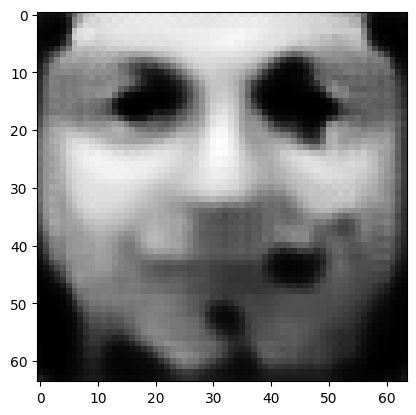

tensor([[1.7442e-06, 3.6330e-06, 6.0830e-04, 7.2667e-04, 3.7493e-06, 4.4833e-07,
         9.6627e-01, 6.8698e-06, 6.6286e-03, 4.6634e-05, 9.0636e-05, 5.1672e-05,
         2.5555e-04, 3.1779e-05, 3.7953e-06, 2.3654e-05, 5.4122e-03, 1.3994e-05,
         4.6041e-04, 1.2682e-05, 3.0992e-05, 2.3890e-03, 2.7157e-05, 7.5402e-04,
         6.5473e-03, 1.8194e-05, 7.8276e-05, 2.5248e-03, 1.4378e-03, 7.8741e-06,
         3.5026e-04, 3.8508e-05, 1.1724e-03, 1.9740e-05, 5.8574e-04, 2.1309e-05,
         3.9073e-04, 1.7299e-03, 1.1307e-03, 9.3643e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03431328013539314
tensor([[1.7437e-06, 3.6321e-06, 6.0815e-04, 7.2653e-04, 3.7481e-06, 4.4823e-07,
         9.6628e-01, 6.8682e-06, 6.6268e-03, 4.6620e-05, 9.0607e-05, 5.1658e-05,
         2.5548e-04, 3.1770e-05, 3.7937e-06, 2.3649e-05, 5.4111e-03, 1.3990e-05,
         4.6033e-04, 1.2678e-05, 3.0980e-05, 2.3885e-03, 2.7146e-05, 7.5386e-04,
         6.5457e-03, 1.8190e-05, 7.8255e-0

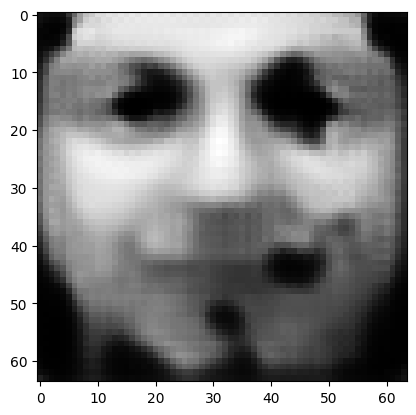

tensor([[1.7420e-06, 3.6283e-06, 6.0754e-04, 7.2598e-04, 3.7436e-06, 4.4784e-07,
         9.6631e-01, 6.8617e-06, 6.6197e-03, 4.6563e-05, 9.0495e-05, 5.1603e-05,
         2.5521e-04, 3.1733e-05, 3.7875e-06, 2.3630e-05, 5.4069e-03, 1.3975e-05,
         4.6003e-04, 1.2663e-05, 3.0930e-05, 2.3864e-03, 2.7104e-05, 7.5327e-04,
         6.5394e-03, 1.8173e-05, 7.8174e-05, 2.5218e-03, 1.4358e-03, 7.8596e-06,
         3.4981e-04, 3.8474e-05, 1.1711e-03, 1.9708e-05, 5.8483e-04, 2.1282e-05,
         3.9016e-04, 1.7274e-03, 1.1290e-03, 9.3497e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0342710055410862
tensor([[1.7416e-06, 3.6274e-06, 6.0740e-04, 7.2586e-04, 3.7425e-06, 4.4774e-07,
         9.6632e-01, 6.8601e-06, 6.6180e-03, 4.6549e-05, 9.0468e-05, 5.1589e-05,
         2.5514e-04, 3.1724e-05, 3.7860e-06, 2.3625e-05, 5.4059e-03, 1.3971e-05,
         4.5996e-04, 1.2659e-05, 3.0919e-05, 2.3859e-03, 2.7093e-05, 7.5313e-04,
         6.5379e-03, 1.8169e-05, 7.8155e-05

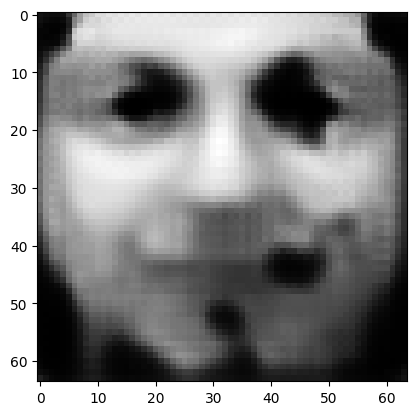

tensor([[1.7400e-06, 3.6239e-06, 6.0682e-04, 7.2533e-04, 3.7381e-06, 4.4737e-07,
         9.6635e-01, 6.8539e-06, 6.6113e-03, 4.6494e-05, 9.0361e-05, 5.1537e-05,
         2.5488e-04, 3.1689e-05, 3.7801e-06, 2.3607e-05, 5.4019e-03, 1.3956e-05,
         4.5966e-04, 1.2645e-05, 3.0872e-05, 2.3840e-03, 2.7053e-05, 7.5257e-04,
         6.5319e-03, 1.8153e-05, 7.8078e-05, 2.5189e-03, 1.4338e-03, 7.8458e-06,
         3.4938e-04, 3.8442e-05, 1.1698e-03, 1.9678e-05, 5.8397e-04, 2.1258e-05,
         3.8961e-04, 1.7250e-03, 1.1274e-03, 9.3359e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034230802208185196
tensor([[1.7396e-06, 3.6230e-06, 6.0668e-04, 7.2520e-04, 3.7371e-06, 4.4728e-07,
         9.6636e-01, 6.8524e-06, 6.6097e-03, 4.6481e-05, 9.0335e-05, 5.1524e-05,
         2.5482e-04, 3.1680e-05, 3.7787e-06, 2.3602e-05, 5.4009e-03, 1.3953e-05,
         4.5959e-04, 1.2642e-05, 3.0861e-05, 2.3835e-03, 2.7043e-05, 7.5243e-04,
         6.5305e-03, 1.8149e-05, 7.8059e-

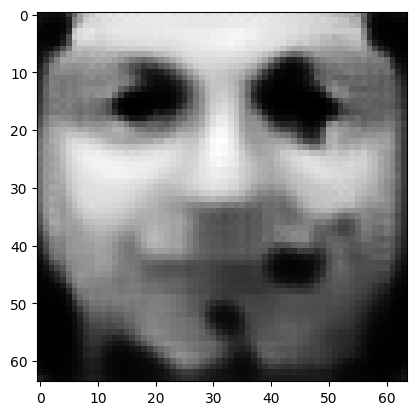

tensor([[1.7381e-06, 3.6196e-06, 6.0614e-04, 7.2472e-04, 3.7330e-06, 4.4692e-07,
         9.6639e-01, 6.8465e-06, 6.6033e-03, 4.6430e-05, 9.0234e-05, 5.1474e-05,
         2.5457e-04, 3.1647e-05, 3.7731e-06, 2.3584e-05, 5.3971e-03, 1.3939e-05,
         4.5932e-04, 1.2628e-05, 3.0817e-05, 2.3817e-03, 2.7004e-05, 7.5190e-04,
         6.5248e-03, 1.8134e-05, 7.7987e-05, 2.5162e-03, 1.4320e-03, 7.8327e-06,
         3.4898e-04, 3.8411e-05, 1.1686e-03, 1.9650e-05, 5.8315e-04, 2.1234e-05,
         3.8910e-04, 1.7227e-03, 1.1259e-03, 9.3228e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03419255465269089
tensor([[1.7377e-06, 3.6188e-06, 6.0601e-04, 7.2459e-04, 3.7320e-06, 4.4684e-07,
         9.6639e-01, 6.8451e-06, 6.6018e-03, 4.6417e-05, 9.0210e-05, 5.1462e-05,
         2.5451e-04, 3.1639e-05, 3.7718e-06, 2.3580e-05, 5.3962e-03, 1.3935e-05,
         4.5925e-04, 1.2625e-05, 3.0806e-05, 2.3812e-03, 2.6995e-05, 7.5177e-04,
         6.5234e-03, 1.8130e-05, 7.7969e-0

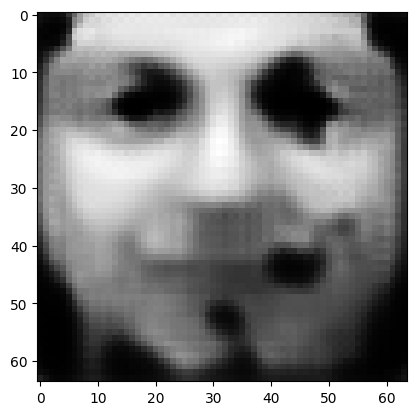

tensor([[1.7362e-06, 3.6156e-06, 6.0549e-04, 7.2413e-04, 3.7281e-06, 4.4650e-07,
         9.6642e-01, 6.8395e-06, 6.5958e-03, 4.6368e-05, 9.0114e-05, 5.1415e-05,
         2.5428e-04, 3.1607e-05, 3.7665e-06, 2.3563e-05, 5.3926e-03, 1.3922e-05,
         4.5899e-04, 1.2612e-05, 3.0764e-05, 2.3795e-03, 2.6959e-05, 7.5126e-04,
         6.5180e-03, 1.8116e-05, 7.7900e-05, 2.5136e-03, 1.4303e-03, 7.8203e-06,
         3.4860e-04, 3.8382e-05, 1.1675e-03, 1.9623e-05, 5.8237e-04, 2.1212e-05,
         3.8860e-04, 1.7206e-03, 1.1245e-03, 9.3104e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03415638208389282
tensor([[1.7359e-06, 3.6148e-06, 6.0537e-04, 7.2401e-04, 3.7271e-06, 4.4642e-07,
         9.6643e-01, 6.8382e-06, 6.5943e-03, 4.6356e-05, 9.0091e-05, 5.1403e-05,
         2.5422e-04, 3.1599e-05, 3.7652e-06, 2.3559e-05, 5.3917e-03, 1.3919e-05,
         4.5893e-04, 1.2609e-05, 3.0754e-05, 2.3790e-03, 2.6950e-05, 7.5114e-04,
         6.5167e-03, 1.8112e-05, 7.7883e-0

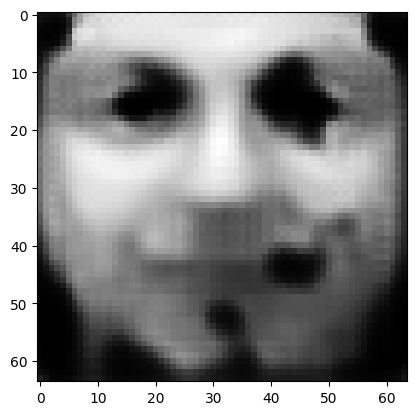

tensor([[1.7345e-06, 3.6118e-06, 6.0488e-04, 7.2357e-04, 3.7234e-06, 4.4610e-07,
         9.6645e-01, 6.8329e-06, 6.5886e-03, 4.6310e-05, 9.0000e-05, 5.1358e-05,
         2.5400e-04, 3.1570e-05, 3.7602e-06, 2.3543e-05, 5.3883e-03, 1.3906e-05,
         4.5868e-04, 1.2597e-05, 3.0714e-05, 2.3774e-03, 2.6915e-05, 7.5066e-04,
         6.5116e-03, 1.8099e-05, 7.7818e-05, 2.5111e-03, 1.4286e-03, 7.8085e-06,
         3.4823e-04, 3.8355e-05, 1.1664e-03, 1.9598e-05, 5.8163e-04, 2.1191e-05,
         3.8814e-04, 1.7186e-03, 1.1232e-03, 9.2987e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03412216529250145
tensor([[1.7342e-06, 3.6111e-06, 6.0476e-04, 7.2346e-04, 3.7225e-06, 4.4602e-07,
         9.6646e-01, 6.8316e-06, 6.5872e-03, 4.6299e-05, 8.9978e-05, 5.1347e-05,
         2.5395e-04, 3.1562e-05, 3.7590e-06, 2.3540e-05, 5.3875e-03, 1.3903e-05,
         4.5862e-04, 1.2594e-05, 3.0704e-05, 2.3770e-03, 2.6907e-05, 7.5054e-04,
         6.5104e-03, 1.8096e-05, 7.7802e-0

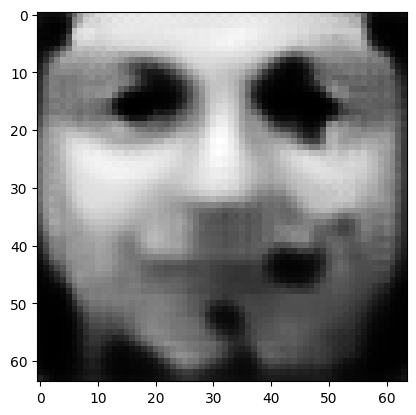

tensor([[1.7329e-06, 3.6082e-06, 6.0430e-04, 7.2304e-04, 3.7191e-06, 4.4571e-07,
         9.6649e-01, 6.8266e-06, 6.5817e-03, 4.6255e-05, 8.9891e-05, 5.1305e-05,
         2.5373e-04, 3.1534e-05, 3.7542e-06, 2.3524e-05, 5.3842e-03, 1.3891e-05,
         4.5838e-04, 1.2582e-05, 3.0667e-05, 2.3754e-03, 2.6874e-05, 7.5008e-04,
         6.5055e-03, 1.8083e-05, 7.7740e-05, 2.5088e-03, 1.4271e-03, 7.7974e-06,
         3.4789e-04, 3.8329e-05, 1.1654e-03, 1.9573e-05, 5.8093e-04, 2.1171e-05,
         3.8770e-04, 1.7167e-03, 1.1219e-03, 9.2875e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03408932685852051
tensor([[1.7326e-06, 3.6075e-06, 6.0418e-04, 7.2294e-04, 3.7182e-06, 4.4564e-07,
         9.6649e-01, 6.8254e-06, 6.5804e-03, 4.6244e-05, 8.9871e-05, 5.1294e-05,
         2.5368e-04, 3.1527e-05, 3.7531e-06, 2.3521e-05, 5.3834e-03, 1.3888e-05,
         4.5833e-04, 1.2580e-05, 3.0658e-05, 2.3750e-03, 2.6866e-05, 7.4998e-04,
         6.5044e-03, 1.8080e-05, 7.7725e-0

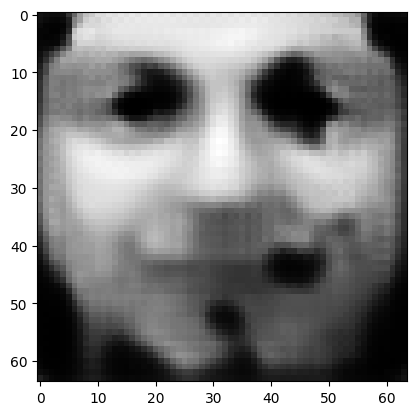

tensor([[1.7313e-06, 3.6048e-06, 6.0374e-04, 7.2254e-04, 3.7149e-06, 4.4535e-07,
         9.6651e-01, 6.8206e-06, 6.5753e-03, 4.6202e-05, 8.9789e-05, 5.1254e-05,
         2.5348e-04, 3.1500e-05, 3.7486e-06, 2.3507e-05, 5.3803e-03, 1.3877e-05,
         4.5810e-04, 1.2569e-05, 3.0622e-05, 2.3735e-03, 2.6835e-05, 7.4954e-04,
         6.4997e-03, 1.8067e-05, 7.7665e-05, 2.5066e-03, 1.4256e-03, 7.7868e-06,
         3.4756e-04, 3.8304e-05, 1.1644e-03, 1.9551e-05, 5.8027e-04, 2.1151e-05,
         3.8728e-04, 1.7148e-03, 1.1207e-03, 9.2769e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03405856713652611
tensor([[1.7310e-06, 3.6041e-06, 6.0363e-04, 7.2244e-04, 3.7141e-06, 4.4528e-07,
         9.6652e-01, 6.8195e-06, 6.5740e-03, 4.6192e-05, 8.9769e-05, 5.1244e-05,
         2.5344e-04, 3.1493e-05, 3.7475e-06, 2.3503e-05, 5.3796e-03, 1.3874e-05,
         4.5805e-04, 1.2566e-05, 3.0613e-05, 2.3732e-03, 2.6827e-05, 7.4944e-04,
         6.4986e-03, 1.8064e-05, 7.7651e-0

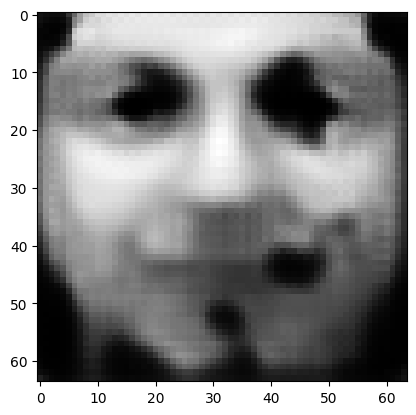

tensor([[1.7299e-06, 3.6015e-06, 6.0322e-04, 7.2206e-04, 3.7109e-06, 4.4501e-07,
         9.6654e-01, 6.8150e-06, 6.5692e-03, 4.6153e-05, 8.9691e-05, 5.1206e-05,
         2.5325e-04, 3.1468e-05, 3.7432e-06, 2.3490e-05, 5.3767e-03, 1.3863e-05,
         4.5784e-04, 1.2556e-05, 3.0579e-05, 2.3717e-03, 2.6798e-05, 7.4903e-04,
         6.4943e-03, 1.8053e-05, 7.7595e-05, 2.5045e-03, 1.4242e-03, 7.7768e-06,
         3.4725e-04, 3.8280e-05, 1.1635e-03, 1.9529e-05, 5.7964e-04, 2.1133e-05,
         3.8688e-04, 1.7131e-03, 1.1195e-03, 9.2669e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034029070287942886
tensor([[1.7296e-06, 3.6009e-06, 6.0311e-04, 7.2197e-04, 3.7101e-06, 4.4494e-07,
         9.6655e-01, 6.8139e-06, 6.5680e-03, 4.6143e-05, 8.9672e-05, 5.1196e-05,
         2.5320e-04, 3.1462e-05, 3.7422e-06, 2.3486e-05, 5.3760e-03, 1.3861e-05,
         4.5779e-04, 1.2553e-05, 3.0571e-05, 2.3714e-03, 2.6791e-05, 7.4893e-04,
         6.4932e-03, 1.8050e-05, 7.7582e-

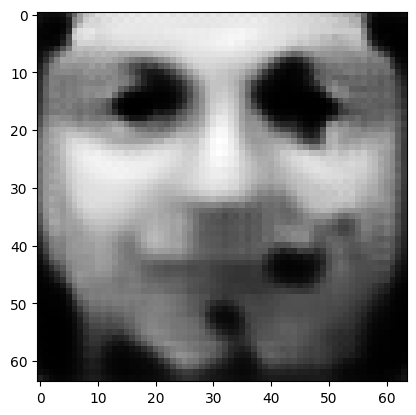

tensor([[1.7284e-06, 3.5984e-06, 6.0272e-04, 7.2161e-04, 3.7072e-06, 4.4468e-07,
         9.6657e-01, 6.8096e-06, 6.5633e-03, 4.6105e-05, 8.9599e-05, 5.1160e-05,
         2.5302e-04, 3.1437e-05, 3.7382e-06, 2.3473e-05, 5.3732e-03, 1.3851e-05,
         4.5759e-04, 1.2543e-05, 3.0539e-05, 2.3700e-03, 2.6763e-05, 7.4854e-04,
         6.4891e-03, 1.8039e-05, 7.7529e-05, 2.5025e-03, 1.4228e-03, 7.7672e-06,
         3.4695e-04, 3.8258e-05, 1.1626e-03, 1.9508e-05, 5.7905e-04, 2.1116e-05,
         3.8651e-04, 1.7115e-03, 1.1184e-03, 9.2573e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034001417458057404
tensor([[1.7282e-06, 3.5978e-06, 6.0262e-04, 7.2152e-04, 3.7064e-06, 4.4462e-07,
         9.6658e-01, 6.8085e-06, 6.5622e-03, 4.6096e-05, 8.9581e-05, 5.1151e-05,
         2.5298e-04, 3.1431e-05, 3.7372e-06, 2.3470e-05, 5.3725e-03, 1.3848e-05,
         4.5754e-04, 1.2541e-05, 3.0531e-05, 2.3697e-03, 2.6756e-05, 7.4844e-04,
         6.4881e-03, 1.8036e-05, 7.7515e-

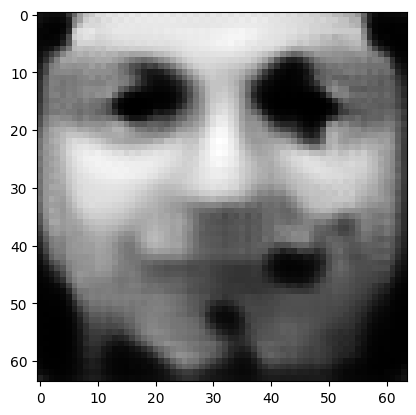

tensor([[1.7271e-06, 3.5955e-06, 6.0224e-04, 7.2118e-04, 3.7036e-06, 4.4437e-07,
         9.6660e-01, 6.8045e-06, 6.5578e-03, 4.6061e-05, 8.9511e-05, 5.1117e-05,
         2.5281e-04, 3.1408e-05, 3.7333e-06, 2.3458e-05, 5.3699e-03, 1.3838e-05,
         4.5735e-04, 1.2532e-05, 3.0501e-05, 2.3684e-03, 2.6729e-05, 7.4807e-04,
         6.4841e-03, 1.8026e-05, 7.7465e-05, 2.5006e-03, 1.4216e-03, 7.7582e-06,
         3.4667e-04, 3.8237e-05, 1.1618e-03, 1.9488e-05, 5.7848e-04, 2.1100e-05,
         3.8615e-04, 1.7099e-03, 1.1174e-03, 9.2483e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03397468477487564
tensor([[1.7269e-06, 3.5949e-06, 6.0215e-04, 7.2110e-04, 3.7029e-06, 4.4431e-07,
         9.6660e-01, 6.8035e-06, 6.5567e-03, 4.6052e-05, 8.9494e-05, 5.1108e-05,
         2.5276e-04, 3.1403e-05, 3.7324e-06, 2.3455e-05, 5.3692e-03, 1.3836e-05,
         4.5730e-04, 1.2529e-05, 3.0493e-05, 2.3681e-03, 2.6723e-05, 7.4798e-04,
         6.4832e-03, 1.8023e-05, 7.7453e-0

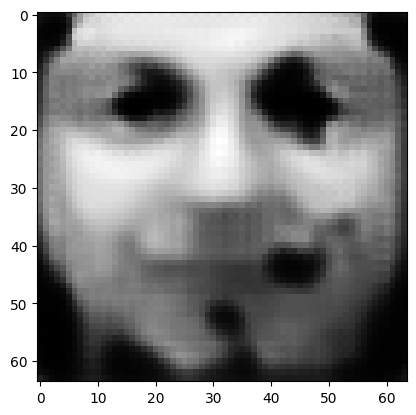

tensor([[1.7258e-06, 3.5927e-06, 6.0179e-04, 7.2078e-04, 3.7002e-06, 4.4408e-07,
         9.6662e-01, 6.7996e-06, 6.5525e-03, 4.6018e-05, 8.9427e-05, 5.1075e-05,
         2.5260e-04, 3.1381e-05, 3.7288e-06, 2.3443e-05, 5.3667e-03, 1.3827e-05,
         4.5712e-04, 1.2521e-05, 3.0465e-05, 2.3669e-03, 2.6698e-05, 7.4763e-04,
         6.4794e-03, 1.8013e-05, 7.7405e-05, 2.4988e-03, 1.4204e-03, 7.7496e-06,
         3.4641e-04, 3.8217e-05, 1.1610e-03, 1.9470e-05, 5.7794e-04, 2.1084e-05,
         3.8581e-04, 1.7084e-03, 1.1164e-03, 9.2397e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033949680626392365
tensor([[1.7256e-06, 3.5922e-06, 6.0171e-04, 7.2070e-04, 3.6995e-06, 4.4402e-07,
         9.6662e-01, 6.7987e-06, 6.5515e-03, 4.6010e-05, 8.9411e-05, 5.1067e-05,
         2.5256e-04, 3.1376e-05, 3.7279e-06, 2.3440e-05, 5.3661e-03, 1.3825e-05,
         4.5707e-04, 1.2518e-05, 3.0457e-05, 2.3666e-03, 2.6691e-05, 7.4754e-04,
         6.4785e-03, 1.8011e-05, 7.7393e-

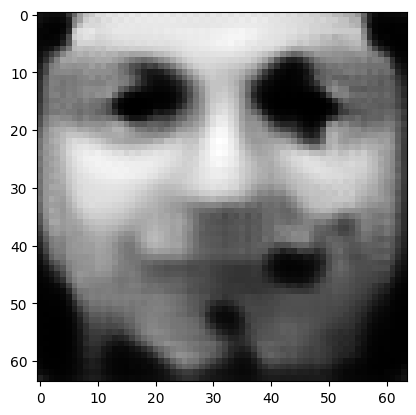

tensor([[1.7246e-06, 3.5901e-06, 6.0137e-04, 7.2039e-04, 3.6969e-06, 4.4380e-07,
         9.6664e-01, 6.7950e-06, 6.5476e-03, 4.5978e-05, 8.9348e-05, 5.1036e-05,
         2.5241e-04, 3.1355e-05, 3.7244e-06, 2.3429e-05, 5.3637e-03, 1.3816e-05,
         4.5690e-04, 1.2510e-05, 3.0430e-05, 2.3654e-03, 2.6667e-05, 7.4721e-04,
         6.4750e-03, 1.8002e-05, 7.7348e-05, 2.4971e-03, 1.4192e-03, 7.7414e-06,
         3.4615e-04, 3.8198e-05, 1.1602e-03, 1.9452e-05, 5.7743e-04, 2.1069e-05,
         3.8549e-04, 1.7070e-03, 1.1155e-03, 9.2315e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03392571210861206
tensor([[1.7244e-06, 3.5895e-06, 6.0128e-04, 7.2032e-04, 3.6963e-06, 4.4374e-07,
         9.6665e-01, 6.7941e-06, 6.5466e-03, 4.5970e-05, 8.9333e-05, 5.1028e-05,
         2.5237e-04, 3.1350e-05, 3.7236e-06, 2.3427e-05, 5.3631e-03, 1.3814e-05,
         4.5686e-04, 1.2508e-05, 3.0423e-05, 2.3652e-03, 2.6662e-05, 7.4713e-04,
         6.4741e-03, 1.7999e-05, 7.7337e-0

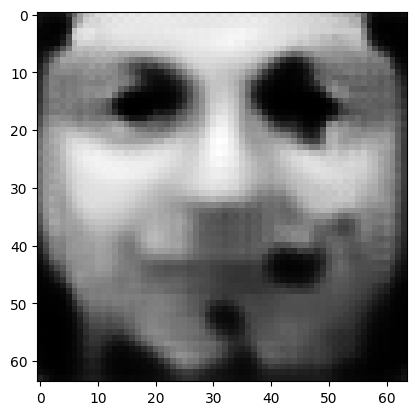

tensor([[1.7235e-06, 3.5876e-06, 6.0096e-04, 7.2003e-04, 3.6939e-06, 4.4353e-07,
         9.6667e-01, 6.7906e-06, 6.5428e-03, 4.5939e-05, 8.9273e-05, 5.0999e-05,
         2.5222e-04, 3.1330e-05, 3.7203e-06, 2.3416e-05, 5.3609e-03, 1.3805e-05,
         4.5670e-04, 1.2500e-05, 3.0397e-05, 2.3641e-03, 2.6639e-05, 7.4681e-04,
         6.4707e-03, 1.7990e-05, 7.7294e-05, 2.4955e-03, 1.4181e-03, 7.7336e-06,
         3.4591e-04, 3.8179e-05, 1.1595e-03, 1.9435e-05, 5.7694e-04, 2.1055e-05,
         3.8518e-04, 1.7057e-03, 1.1146e-03, 9.2237e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033903010189533234
tensor([[1.7233e-06, 3.5871e-06, 6.0088e-04, 7.1996e-04, 3.6933e-06, 4.4348e-07,
         9.6667e-01, 6.7898e-06, 6.5419e-03, 4.5931e-05, 8.9258e-05, 5.0992e-05,
         2.5219e-04, 3.1325e-05, 3.7195e-06, 2.3414e-05, 5.3603e-03, 1.3803e-05,
         4.5666e-04, 1.2498e-05, 3.0391e-05, 2.3638e-03, 2.6633e-05, 7.4673e-04,
         6.4699e-03, 1.7988e-05, 7.7283e-

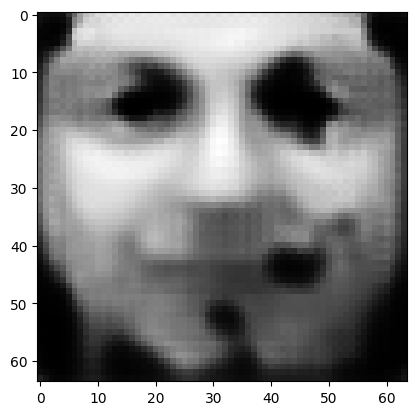

tensor([[1.7224e-06, 3.5852e-06, 6.0058e-04, 7.1968e-04, 3.6909e-06, 4.4328e-07,
         9.6669e-01, 6.7864e-06, 6.5383e-03, 4.5902e-05, 8.9202e-05, 5.0963e-05,
         2.5205e-04, 3.1306e-05, 3.7164e-06, 2.3404e-05, 5.3581e-03, 1.3795e-05,
         4.5650e-04, 1.2490e-05, 3.0366e-05, 2.3628e-03, 2.6612e-05, 7.4643e-04,
         6.4667e-03, 1.7980e-05, 7.7243e-05, 2.4940e-03, 1.4171e-03, 7.7262e-06,
         3.4568e-04, 3.8162e-05, 1.1588e-03, 1.9419e-05, 5.7647e-04, 2.1042e-05,
         3.8489e-04, 1.7044e-03, 1.1137e-03, 9.2163e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033881690353155136
tensor([[1.7222e-06, 3.5847e-06, 6.0050e-04, 7.1962e-04, 3.6904e-06, 4.4323e-07,
         9.6669e-01, 6.7856e-06, 6.5374e-03, 4.5895e-05, 8.9188e-05, 5.0957e-05,
         2.5201e-04, 3.1302e-05, 3.7156e-06, 2.3401e-05, 5.3576e-03, 1.3793e-05,
         4.5647e-04, 1.2488e-05, 3.0360e-05, 2.3625e-03, 2.6606e-05, 7.4636e-04,
         6.4659e-03, 1.7978e-05, 7.7233e-

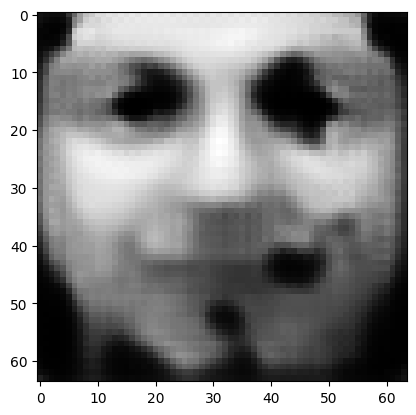

tensor([[1.7214e-06, 3.5829e-06, 6.0021e-04, 7.1935e-04, 3.6882e-06, 4.4304e-07,
         9.6671e-01, 6.7825e-06, 6.5340e-03, 4.5868e-05, 8.9134e-05, 5.0930e-05,
         2.5188e-04, 3.1284e-05, 3.7127e-06, 2.3392e-05, 5.3556e-03, 1.3786e-05,
         4.5632e-04, 1.2481e-05, 3.0337e-05, 2.3615e-03, 2.6586e-05, 7.4608e-04,
         6.4629e-03, 1.7969e-05, 7.7194e-05, 2.4925e-03, 1.4161e-03, 7.7192e-06,
         3.4547e-04, 3.8146e-05, 1.1582e-03, 1.9404e-05, 5.7603e-04, 2.1029e-05,
         3.8461e-04, 1.7032e-03, 1.1129e-03, 9.2093e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033861178904771805
tensor([[1.7212e-06, 3.5825e-06, 6.0014e-04, 7.1929e-04, 3.6876e-06, 4.4299e-07,
         9.6671e-01, 6.7817e-06, 6.5332e-03, 4.5861e-05, 8.9121e-05, 5.0923e-05,
         2.5185e-04, 3.1280e-05, 3.7119e-06, 2.3389e-05, 5.3551e-03, 1.3784e-05,
         4.5628e-04, 1.2480e-05, 3.0331e-05, 2.3613e-03, 2.6581e-05, 7.4601e-04,
         6.4622e-03, 1.7967e-05, 7.7185e-

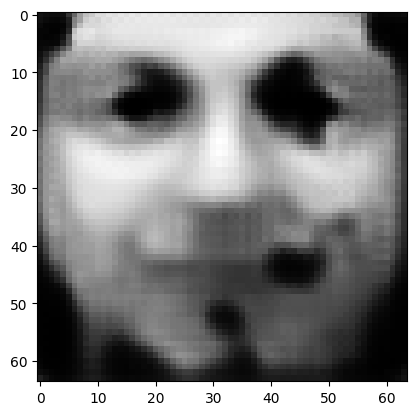

tensor([[1.7204e-06, 3.5808e-06, 5.9986e-04, 7.1904e-04, 3.6855e-06, 4.4281e-07,
         9.6672e-01, 6.7787e-06, 6.5300e-03, 4.5835e-05, 8.9070e-05, 5.0898e-05,
         2.5172e-04, 3.1263e-05, 3.7091e-06, 2.3380e-05, 5.3531e-03, 1.3777e-05,
         4.5614e-04, 1.2473e-05, 3.0309e-05, 2.3603e-03, 2.6562e-05, 7.4573e-04,
         6.4593e-03, 1.7960e-05, 7.7148e-05, 2.4911e-03, 1.4152e-03, 7.7126e-06,
         3.4526e-04, 3.8130e-05, 1.1576e-03, 1.9390e-05, 5.7562e-04, 2.1017e-05,
         3.8435e-04, 1.7021e-03, 1.1122e-03, 9.2027e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033841703087091446
tensor([[1.7202e-06, 3.5804e-06, 5.9980e-04, 7.1898e-04, 3.6850e-06, 4.4276e-07,
         9.6673e-01, 6.7780e-06, 6.5292e-03, 4.5828e-05, 8.9057e-05, 5.0892e-05,
         2.5169e-04, 3.1259e-05, 3.7084e-06, 2.3378e-05, 5.3527e-03, 1.3775e-05,
         4.5611e-04, 1.2471e-05, 3.0303e-05, 2.3601e-03, 2.6557e-05, 7.4567e-04,
         6.4586e-03, 1.7958e-05, 7.7139e-

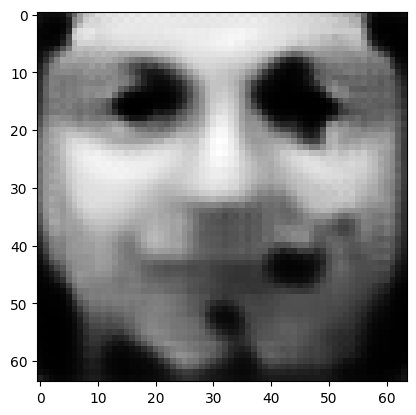

tensor([[1.7195e-06, 3.5787e-06, 5.9953e-04, 7.1875e-04, 3.6830e-06, 4.4259e-07,
         9.6674e-01, 6.7752e-06, 6.5261e-03, 4.5804e-05, 8.9009e-05, 5.0868e-05,
         2.5157e-04, 3.1243e-05, 3.7058e-06, 2.3370e-05, 5.3508e-03, 1.3768e-05,
         4.5598e-04, 1.2465e-05, 3.0282e-05, 2.3592e-03, 2.6538e-05, 7.4541e-04,
         6.4558e-03, 1.7951e-05, 7.7104e-05, 2.4898e-03, 1.4143e-03, 7.7062e-06,
         3.4507e-04, 3.8115e-05, 1.1570e-03, 1.9376e-05, 5.7522e-04, 2.1006e-05,
         3.8410e-04, 1.7010e-03, 1.1114e-03, 9.1963e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03382314741611481
tensor([[1.7193e-06, 3.5783e-06, 5.9947e-04, 7.1869e-04, 3.6825e-06, 4.4255e-07,
         9.6675e-01, 6.7745e-06, 6.5254e-03, 4.5798e-05, 8.8997e-05, 5.0862e-05,
         2.5155e-04, 3.1239e-05, 3.7051e-06, 2.3367e-05, 5.3504e-03, 1.3767e-05,
         4.5595e-04, 1.2463e-05, 3.0277e-05, 2.3590e-03, 2.6534e-05, 7.4535e-04,
         6.4551e-03, 1.7949e-05, 7.7095e-0

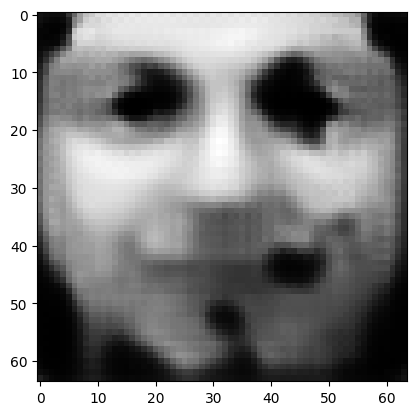

tensor([[1.7186e-06, 3.5768e-06, 5.9922e-04, 7.1846e-04, 3.6807e-06, 4.4239e-07,
         9.6676e-01, 6.7718e-06, 6.5225e-03, 4.5774e-05, 8.8951e-05, 5.0839e-05,
         2.5143e-04, 3.1224e-05, 3.7026e-06, 2.3359e-05, 5.3486e-03, 1.3760e-05,
         4.5582e-04, 1.2457e-05, 3.0257e-05, 2.3581e-03, 2.6516e-05, 7.4510e-04,
         6.4526e-03, 1.7942e-05, 7.7062e-05, 2.4886e-03, 1.4135e-03, 7.7003e-06,
         3.4488e-04, 3.8101e-05, 1.1564e-03, 1.9363e-05, 5.7484e-04, 2.0995e-05,
         3.8387e-04, 1.7000e-03, 1.1108e-03, 9.1903e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03380574658513069
tensor([[1.7184e-06, 3.5764e-06, 5.9916e-04, 7.1841e-04, 3.6802e-06, 4.4235e-07,
         9.6676e-01, 6.7711e-06, 6.5218e-03, 4.5768e-05, 8.8939e-05, 5.0834e-05,
         2.5141e-04, 3.1220e-05, 3.7020e-06, 2.3357e-05, 5.3482e-03, 1.3759e-05,
         4.5579e-04, 1.2455e-05, 3.0252e-05, 2.3579e-03, 2.6512e-05, 7.4504e-04,
         6.4519e-03, 1.7940e-05, 7.7054e-0

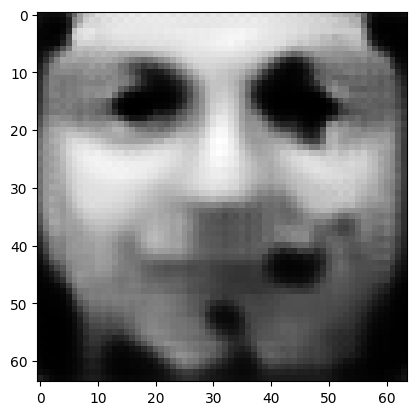

tensor([[1.7177e-06, 3.5750e-06, 5.9892e-04, 7.1819e-04, 3.6784e-06, 4.4219e-07,
         9.6678e-01, 6.7686e-06, 6.5190e-03, 4.5746e-05, 8.8895e-05, 5.0812e-05,
         2.5130e-04, 3.1205e-05, 3.6996e-06, 2.3350e-05, 5.3465e-03, 1.3753e-05,
         4.5567e-04, 1.2449e-05, 3.0233e-05, 2.3571e-03, 2.6495e-05, 7.4481e-04,
         6.4494e-03, 1.7934e-05, 7.7022e-05, 2.4874e-03, 1.4127e-03, 7.6946e-06,
         3.4470e-04, 3.8088e-05, 1.1559e-03, 1.9351e-05, 5.7449e-04, 2.0985e-05,
         3.8364e-04, 1.6990e-03, 1.1101e-03, 9.1846e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03378903493285179
tensor([[1.7176e-06, 3.5746e-06, 5.9886e-04, 7.1814e-04, 3.6780e-06, 4.4215e-07,
         9.6678e-01, 6.7679e-06, 6.5183e-03, 4.5740e-05, 8.8885e-05, 5.0806e-05,
         2.5127e-04, 3.1202e-05, 3.6990e-06, 2.3348e-05, 5.3461e-03, 1.3751e-05,
         4.5564e-04, 1.2448e-05, 3.0228e-05, 2.3569e-03, 2.6491e-05, 7.4475e-04,
         6.4488e-03, 1.7932e-05, 7.7014e-0

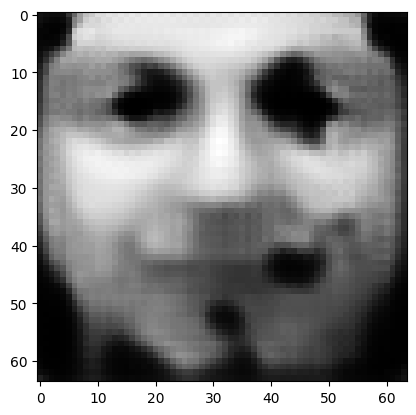

tensor([[1.7169e-06, 3.5732e-06, 5.9864e-04, 7.1794e-04, 3.6763e-06, 4.4200e-07,
         9.6679e-01, 6.7655e-06, 6.5157e-03, 4.5719e-05, 8.8843e-05, 5.0786e-05,
         2.5117e-04, 3.1188e-05, 3.6967e-06, 2.3340e-05, 5.3445e-03, 1.3745e-05,
         4.5553e-04, 1.2442e-05, 3.0210e-05, 2.3562e-03, 2.6476e-05, 7.4453e-04,
         6.4465e-03, 1.7926e-05, 7.6985e-05, 2.4863e-03, 1.4119e-03, 7.6891e-06,
         3.4454e-04, 3.8075e-05, 1.1554e-03, 1.9339e-05, 5.7415e-04, 2.0975e-05,
         3.8343e-04, 1.6980e-03, 1.1095e-03, 9.1792e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03377336263656616
tensor([[1.7168e-06, 3.5729e-06, 5.9858e-04, 7.1789e-04, 3.6758e-06, 4.4197e-07,
         9.6679e-01, 6.7649e-06, 6.5150e-03, 4.5714e-05, 8.8833e-05, 5.0781e-05,
         2.5114e-04, 3.1185e-05, 3.6962e-06, 2.3339e-05, 5.3441e-03, 1.3744e-05,
         4.5550e-04, 1.2441e-05, 3.0205e-05, 2.3560e-03, 2.6472e-05, 7.4448e-04,
         6.4459e-03, 1.7924e-05, 7.6977e-0

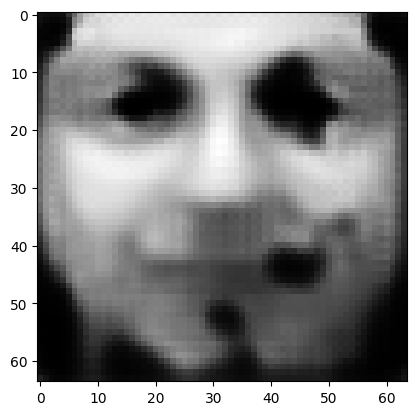

tensor([[1.7162e-06, 3.5715e-06, 5.9837e-04, 7.1770e-04, 3.6742e-06, 4.4183e-07,
         9.6681e-01, 6.7626e-06, 6.5125e-03, 4.5693e-05, 8.8793e-05, 5.0761e-05,
         2.5105e-04, 3.1172e-05, 3.6940e-06, 2.3332e-05, 5.3426e-03, 1.3738e-05,
         4.5539e-04, 1.2436e-05, 3.0188e-05, 2.3553e-03, 2.6457e-05, 7.4427e-04,
         6.4437e-03, 1.7918e-05, 7.6949e-05, 2.4852e-03, 1.4112e-03, 7.6840e-06,
         3.4438e-04, 3.8063e-05, 1.1549e-03, 1.9328e-05, 5.7382e-04, 2.0965e-05,
         3.8323e-04, 1.6972e-03, 1.1089e-03, 9.1741e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033758148550987244
tensor([[1.7160e-06, 3.5712e-06, 5.9832e-04, 7.1765e-04, 3.6738e-06, 4.4179e-07,
         9.6681e-01, 6.7620e-06, 6.5119e-03, 4.5688e-05, 8.8784e-05, 5.0756e-05,
         2.5102e-04, 3.1168e-05, 3.6935e-06, 2.3330e-05, 5.3423e-03, 1.3737e-05,
         4.5537e-04, 1.2434e-05, 3.0184e-05, 2.3551e-03, 2.6453e-05, 7.4422e-04,
         6.4431e-03, 1.7917e-05, 7.6942e-

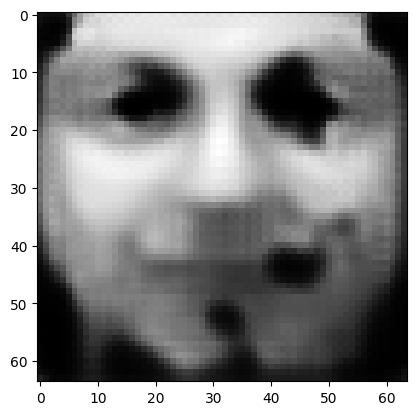

tensor([[1.7155e-06, 3.5700e-06, 5.9812e-04, 7.1747e-04, 3.6723e-06, 4.4166e-07,
         9.6682e-01, 6.7598e-06, 6.5096e-03, 4.5669e-05, 8.8746e-05, 5.0738e-05,
         2.5093e-04, 3.1156e-05, 3.6914e-06, 2.3323e-05, 5.3408e-03, 1.3732e-05,
         4.5526e-04, 1.2429e-05, 3.0168e-05, 2.3544e-03, 2.6439e-05, 7.4402e-04,
         6.4410e-03, 1.7911e-05, 7.6915e-05, 2.4842e-03, 1.4105e-03, 7.6791e-06,
         3.4423e-04, 3.8051e-05, 1.1545e-03, 1.9318e-05, 5.7352e-04, 2.0957e-05,
         3.8304e-04, 1.6963e-03, 1.1083e-03, 9.1692e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033743973821401596
tensor([[1.7153e-06, 3.5697e-06, 5.9806e-04, 7.1742e-04, 3.6719e-06, 4.4163e-07,
         9.6682e-01, 6.7593e-06, 6.5090e-03, 4.5664e-05, 8.8737e-05, 5.0733e-05,
         2.5091e-04, 3.1153e-05, 3.6909e-06, 2.3322e-05, 5.3405e-03, 1.3731e-05,
         4.5524e-04, 1.2428e-05, 3.0164e-05, 2.3542e-03, 2.6435e-05, 7.4397e-04,
         6.4405e-03, 1.7910e-05, 7.6908e-

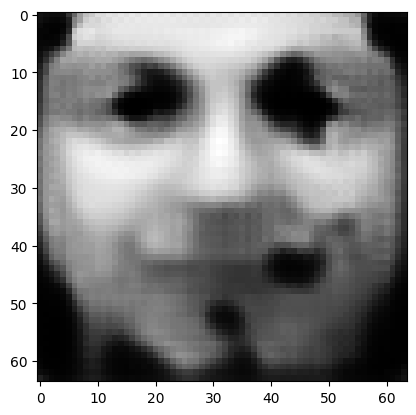

tensor([[1.7148e-06, 3.5685e-06, 5.9787e-04, 7.1725e-04, 3.6704e-06, 4.4150e-07,
         9.6683e-01, 6.7572e-06, 6.5067e-03, 4.5646e-05, 8.8701e-05, 5.0715e-05,
         2.5082e-04, 3.1141e-05, 3.6889e-06, 2.3315e-05, 5.3391e-03, 1.3726e-05,
         4.5514e-04, 1.2423e-05, 3.0148e-05, 2.3536e-03, 2.6422e-05, 7.4378e-04,
         6.4385e-03, 1.7905e-05, 7.6882e-05, 2.4832e-03, 1.4099e-03, 7.6745e-06,
         3.4408e-04, 3.8040e-05, 1.1541e-03, 1.9308e-05, 5.7322e-04, 2.0948e-05,
         3.8285e-04, 1.6955e-03, 1.1078e-03, 9.1646e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03373037278652191
tensor([[1.7146e-06, 3.5682e-06, 5.9783e-04, 7.1721e-04, 3.6701e-06, 4.4147e-07,
         9.6683e-01, 6.7567e-06, 6.5062e-03, 4.5642e-05, 8.8692e-05, 5.0711e-05,
         2.5080e-04, 3.1138e-05, 3.6884e-06, 2.3314e-05, 5.3388e-03, 1.3724e-05,
         4.5512e-04, 1.2422e-05, 3.0144e-05, 2.3534e-03, 2.6418e-05, 7.4373e-04,
         6.4380e-03, 1.7903e-05, 7.6876e-0

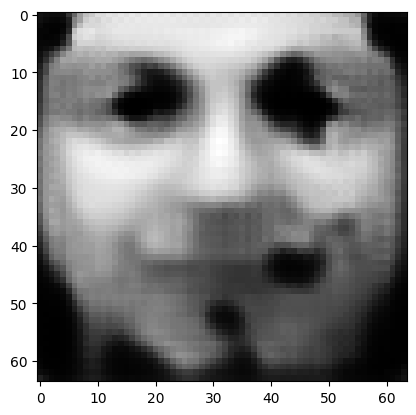

tensor([[1.7141e-06, 3.5670e-06, 5.9764e-04, 7.1704e-04, 3.6687e-06, 4.4135e-07,
         9.6684e-01, 6.7547e-06, 6.5040e-03, 4.5624e-05, 8.8658e-05, 5.0694e-05,
         2.5071e-04, 3.1127e-05, 3.6866e-06, 2.3308e-05, 5.3375e-03, 1.3720e-05,
         4.5502e-04, 1.2418e-05, 3.0129e-05, 2.3528e-03, 2.6405e-05, 7.4355e-04,
         6.4360e-03, 1.7898e-05, 7.6851e-05, 2.4823e-03, 1.4093e-03, 7.6701e-06,
         3.4394e-04, 3.8030e-05, 1.1537e-03, 1.9298e-05, 5.7295e-04, 2.0940e-05,
         3.8268e-04, 1.6948e-03, 1.1073e-03, 9.1601e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03371746465563774
tensor([[1.7140e-06, 3.5668e-06, 5.9760e-04, 7.1700e-04, 3.6683e-06, 4.4132e-07,
         9.6685e-01, 6.7542e-06, 6.5035e-03, 4.5620e-05, 8.8650e-05, 5.0690e-05,
         2.5069e-04, 3.1124e-05, 3.6861e-06, 2.3307e-05, 5.3372e-03, 1.3718e-05,
         4.5500e-04, 1.2417e-05, 3.0126e-05, 2.3526e-03, 2.6402e-05, 7.4351e-04,
         6.4356e-03, 1.7897e-05, 7.6845e-0

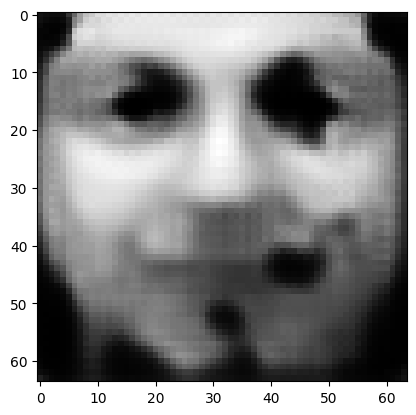

tensor([[1.7135e-06, 3.5657e-06, 5.9742e-04, 7.1684e-04, 3.6670e-06, 4.4120e-07,
         9.6686e-01, 6.7524e-06, 6.5015e-03, 4.5604e-05, 8.8618e-05, 5.0674e-05,
         2.5062e-04, 3.1114e-05, 3.6844e-06, 2.3301e-05, 5.3360e-03, 1.3714e-05,
         4.5491e-04, 1.2412e-05, 3.0112e-05, 2.3520e-03, 2.6390e-05, 7.4334e-04,
         6.4338e-03, 1.7892e-05, 7.6822e-05, 2.4814e-03, 1.4087e-03, 7.6659e-06,
         3.4381e-04, 3.8020e-05, 1.1533e-03, 1.9289e-05, 5.7268e-04, 2.0933e-05,
         3.8251e-04, 1.6940e-03, 1.1068e-03, 9.1560e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033705245703458786
tensor([[1.7134e-06, 3.5654e-06, 5.9738e-04, 7.1681e-04, 3.6667e-06, 4.4117e-07,
         9.6686e-01, 6.7519e-06, 6.5010e-03, 4.5600e-05, 8.8611e-05, 5.0670e-05,
         2.5060e-04, 3.1111e-05, 3.6840e-06, 2.3300e-05, 5.3357e-03, 1.3713e-05,
         4.5489e-04, 1.2411e-05, 3.0109e-05, 2.3519e-03, 2.6387e-05, 7.4330e-04,
         6.4333e-03, 1.7891e-05, 7.6817e-

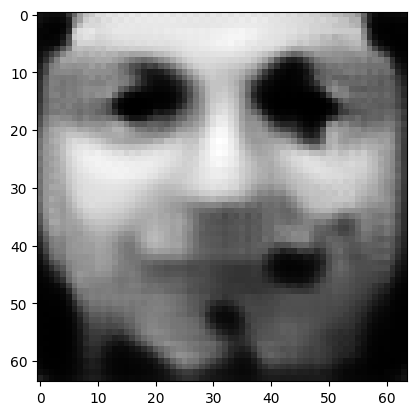

tensor([[1.7129e-06, 3.5644e-06, 5.9722e-04, 7.1666e-04, 3.6654e-06, 4.4106e-07,
         9.6687e-01, 6.7501e-06, 6.4990e-03, 4.5584e-05, 8.8580e-05, 5.0655e-05,
         2.5052e-04, 3.1101e-05, 3.6823e-06, 2.3294e-05, 5.3345e-03, 1.3709e-05,
         4.5481e-04, 1.2407e-05, 3.0095e-05, 2.3513e-03, 2.6375e-05, 7.4313e-04,
         6.4316e-03, 1.7886e-05, 7.6794e-05, 2.4806e-03, 1.4081e-03, 7.6619e-06,
         3.4369e-04, 3.8011e-05, 1.1529e-03, 1.9280e-05, 5.7243e-04, 2.0925e-05,
         3.8235e-04, 1.6933e-03, 1.1064e-03, 9.1520e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033693719655275345
tensor([[1.7128e-06, 3.5641e-06, 5.9718e-04, 7.1662e-04, 3.6651e-06, 4.4104e-07,
         9.6687e-01, 6.7497e-06, 6.4986e-03, 4.5580e-05, 8.8572e-05, 5.0651e-05,
         2.5050e-04, 3.1098e-05, 3.6818e-06, 2.3293e-05, 5.3342e-03, 1.3708e-05,
         4.5479e-04, 1.2406e-05, 3.0092e-05, 2.3512e-03, 2.6372e-05, 7.4309e-04,
         6.4311e-03, 1.7885e-05, 7.6789e-

In [143]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=6)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.542433738708496


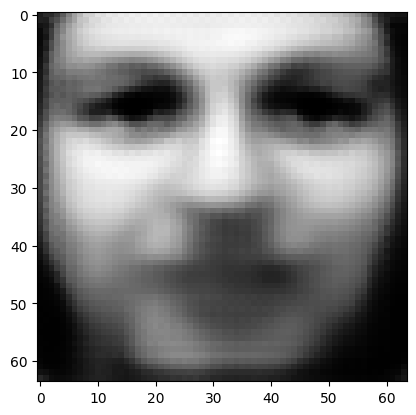

tensor([[2.6172e-04, 3.7376e-04, 2.3951e-02, 4.4100e-03, 1.5400e-03, 1.4559e-05,
         2.4007e-02, 6.8179e-04, 1.3361e-01, 1.7829e-02, 9.8968e-03, 1.0691e-02,
         1.5507e-02, 3.5042e-03, 5.4886e-03, 1.1712e-03, 2.4069e-02, 9.6809e-04,
         4.2671e-03, 1.8182e-03, 6.7480e-02, 3.3097e-02, 1.0037e-02, 1.4664e-02,
         1.1421e-01, 6.2479e-04, 5.2669e-03, 3.0346e-02, 5.5318e-02, 1.2986e-02,
         1.6408e-02, 3.0175e-04, 2.2688e-02, 4.8252e-03, 7.8270e-02, 1.1746e-03,
         2.1389e-02, 1.0876e-01, 7.6579e-02, 4.1512e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.290792942047119
tensor([[3.5071e-04, 4.6280e-04, 3.1872e-02, 4.6296e-03, 1.1813e-03, 1.6302e-05,
         2.0486e-02, 1.4325e-03, 9.8202e-02, 2.2992e-02, 1.2824e-02, 9.7750e-03,
         1.2685e-02, 3.2823e-03, 5.5994e-03, 1.8044e-03, 2.3180e-02, 9.3148e-04,
         5.7019e-03, 2.3204e-03, 7.0347e-02, 3.5587e-02, 7.1426e-03, 1.7690e-02,
         9.1149e-02, 4.8276e-04, 5.8370e-03,

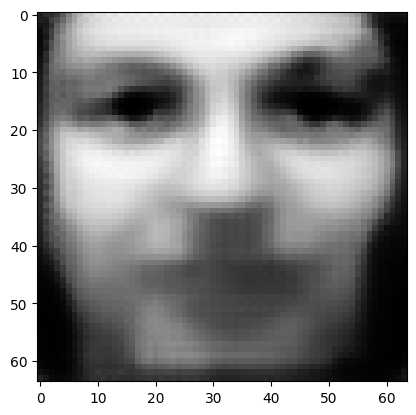

tensor([[5.3593e-04, 5.8335e-04, 6.1579e-02, 3.8283e-03, 5.0266e-04, 1.8640e-05,
         1.4173e-02, 9.1854e-03, 3.9315e-02, 3.7471e-02, 2.0374e-02, 6.1127e-03,
         6.5301e-03, 2.3666e-03, 4.3410e-03, 4.1032e-03, 1.9214e-02, 6.0256e-04,
         8.5322e-03, 3.6022e-03, 6.2222e-02, 3.6550e-02, 2.6205e-03, 2.3215e-02,
         5.2834e-02, 2.5635e-04, 5.0622e-03, 1.4178e-02, 1.0918e-01, 2.0160e-02,
         3.2398e-03, 1.7515e-04, 2.4019e-02, 5.5258e-03, 1.1537e-01, 1.0422e-03,
         2.2390e-02, 1.2714e-01, 9.8737e-02, 3.3113e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.690140724182129
tensor([[5.5683e-04, 5.8786e-04, 6.8599e-02, 3.6756e-03, 4.0618e-04, 1.8726e-05,
         1.3191e-02, 1.3556e-02, 3.2455e-02, 4.1404e-02, 2.2105e-02, 5.2953e-03,
         5.4822e-03, 2.0703e-03, 4.0600e-03, 4.7272e-03, 1.7657e-02, 5.3367e-04,
         9.2346e-03, 3.9746e-03, 5.8032e-02, 3.6019e-02, 2.0752e-03, 2.4566e-02,
         4.5902e-02, 2.2004e-04, 4.7241e-03,

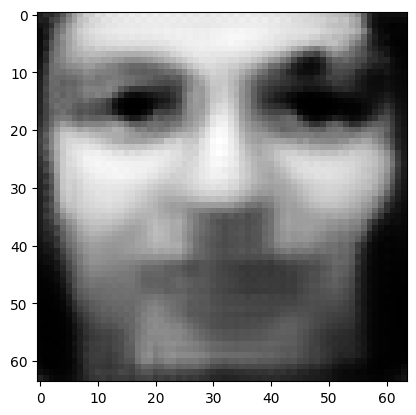

tensor([[6.5032e-04, 5.4457e-04, 9.3071e-02, 3.0188e-03, 1.9195e-04, 1.8392e-05,
         9.7807e-03, 5.1547e-02, 1.5849e-02, 5.4344e-02, 2.4870e-02, 3.1473e-03,
         3.0481e-03, 1.2453e-03, 2.7295e-03, 6.6259e-03, 1.3090e-02, 3.1472e-04,
         1.0569e-02, 4.6913e-03, 4.2872e-02, 3.2212e-02, 8.7593e-04, 2.7278e-02,
         2.7760e-02, 1.3885e-04, 3.4055e-03, 7.8449e-03, 1.3231e-01, 1.9801e-02,
         9.1357e-04, 8.8988e-05, 2.0746e-02, 4.2616e-03, 1.2358e-01, 7.5139e-04,
         1.8028e-02, 1.0813e-01, 1.0646e-01, 2.3192e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.965252637863159
tensor([[6.8874e-04, 5.3942e-04, 9.8576e-02, 2.8648e-03, 1.6909e-04, 1.8530e-05,
         8.9693e-03, 6.7749e-02, 1.3246e-02, 5.7449e-02, 2.4796e-02, 2.8885e-03,
         2.7147e-03, 1.1278e-03, 2.4476e-03, 7.1259e-03, 1.2240e-02, 2.7475e-04,
         1.0796e-02, 4.6929e-03, 4.0314e-02, 3.1125e-02, 7.2655e-04, 2.7422e-02,
         2.5281e-02, 1.2968e-04, 3.1986e-03,

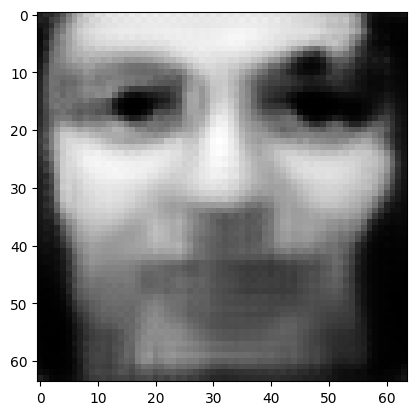

tensor([[8.2298e-04, 4.9959e-04, 1.1047e-01, 2.2377e-03, 1.0404e-04, 1.8321e-05,
         6.4122e-03, 1.6890e-01, 6.5940e-03, 6.6767e-02, 2.2859e-02, 2.0520e-03,
         1.7225e-03, 7.5101e-04, 1.5568e-03, 8.4618e-03, 8.9946e-03, 1.5579e-04,
         1.1058e-02, 4.2271e-03, 2.9220e-02, 2.6215e-02, 3.6203e-04, 2.6386e-02,
         1.8010e-02, 1.0178e-04, 2.4808e-03, 4.6740e-03, 1.1681e-01, 1.6112e-02,
         3.7027e-04, 5.9133e-05, 1.5808e-02, 3.0945e-03, 1.0669e-01, 5.2572e-04,
         1.4109e-02, 8.5155e-02, 9.1916e-02, 1.7233e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.7784528732299805
tensor([[8.5682e-04, 4.8999e-04, 1.1008e-01, 2.0864e-03, 9.3067e-05, 1.8091e-05,
         5.8963e-03, 2.0235e-01, 5.5261e-03, 6.7260e-02, 2.1966e-02, 1.8937e-03,
         1.5491e-03, 6.8552e-04, 1.3836e-03, 8.5998e-03, 8.2727e-03, 1.3619e-04,
         1.0916e-02, 4.0162e-03, 2.6723e-02, 2.4877e-02, 3.0637e-04, 2.5737e-02,
         1.6654e-02, 9.6391e-05, 2.3167e-03

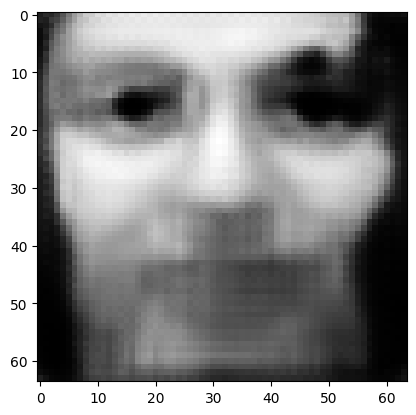

tensor([[9.5573e-04, 4.4961e-04, 9.8402e-02, 1.5520e-03, 5.9506e-05, 1.6267e-05,
         4.1632e-03, 3.5112e-01, 2.7837e-03, 6.3734e-02, 1.8080e-02, 1.3774e-03,
         1.0411e-03, 4.8343e-04, 8.7086e-04, 8.6014e-03, 5.8075e-03, 8.1987e-05,
         9.7876e-03, 3.1425e-03, 1.8371e-02, 1.9516e-02, 1.6140e-04, 2.2526e-02,
         1.2060e-02, 7.6357e-05, 1.7563e-03, 2.8165e-03, 8.8206e-02, 1.1331e-02,
         1.7576e-04, 4.1912e-05, 1.1103e-02, 2.1818e-03, 8.0648e-02, 3.5772e-04,
         1.0508e-02, 6.2320e-02, 7.1151e-02, 1.2187e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0466387271881104
tensor([[9.6347e-04, 4.3670e-04, 9.4590e-02, 1.4372e-03, 5.3313e-05, 1.5618e-05,
         3.7940e-03, 3.8860e-01, 2.3537e-03, 6.1734e-02, 1.7051e-02, 1.2670e-03,
         9.4730e-04, 4.4390e-04, 7.7641e-04, 8.4581e-03, 5.3070e-03, 7.2376e-05,
         9.4035e-03, 2.9347e-03, 1.6774e-02, 1.8268e-02, 1.3798e-04, 2.1565e-02,
         1.1065e-02, 7.1778e-05, 1.6329e-03

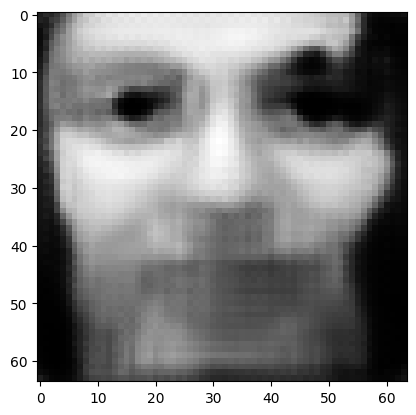

tensor([[9.6480e-04, 3.8121e-04, 7.7876e-02, 1.0734e-03, 3.5431e-05, 1.3211e-05,
         2.7275e-03, 5.1981e-01, 1.2987e-03, 5.2693e-02, 1.3384e-02, 9.2552e-04,
         6.6291e-04, 3.2192e-04, 5.0285e-04, 7.6435e-03, 3.8175e-03, 4.6585e-05,
         7.8985e-03, 2.1946e-03, 1.1706e-02, 1.3971e-02, 7.8849e-05, 1.7919e-02,
         8.0515e-03, 5.6340e-05, 1.2339e-03, 1.7493e-03, 6.3526e-02, 7.6133e-03,
         9.3246e-05, 3.0290e-05, 7.6387e-03, 1.5143e-03, 5.7217e-02, 2.4043e-04,
         7.6035e-03, 4.4378e-02, 5.2869e-02, 8.2350e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6542841792106628
tensor([[9.6285e-04, 3.6894e-04, 7.3980e-02, 1.0011e-03, 3.2426e-05, 1.2698e-05,
         2.5382e-03, 5.4669e-01, 1.1406e-03, 5.0547e-02, 1.2639e-02, 8.6523e-04,
         6.1102e-04, 3.0022e-04, 4.5609e-04, 7.4362e-03, 3.5479e-03, 4.2485e-05,
         7.5738e-03, 2.0416e-03, 1.0760e-02, 1.3106e-02, 6.9870e-05, 1.7126e-02,
         7.5225e-03, 5.3309e-05, 1.1581e-03

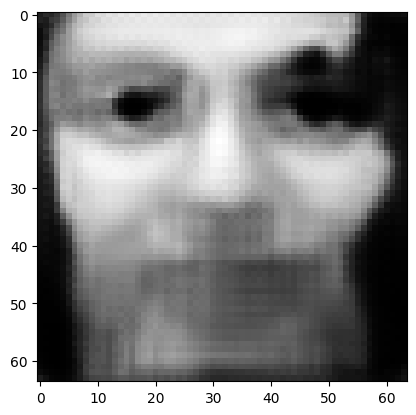

tensor([[9.4270e-04, 3.2642e-04, 6.0941e-02, 7.8050e-04, 2.3540e-05, 1.0922e-05,
         1.9524e-03, 6.3485e-01, 7.1595e-04, 4.2885e-02, 1.0195e-02, 6.7434e-04,
         4.5437e-04, 2.3345e-04, 3.1946e-04, 6.6590e-03, 2.7257e-03, 3.0254e-05,
         6.4411e-03, 1.5616e-03, 7.9107e-03, 1.0385e-02, 4.5355e-05, 1.4351e-02,
         5.8473e-03, 4.3500e-05, 9.1802e-04, 1.1829e-03, 4.7038e-02, 5.3510e-03,
         5.6910e-05, 2.3642e-05, 5.5252e-03, 1.1071e-03, 4.2439e-02, 1.7285e-04,
         5.7490e-03, 3.3393e-02, 3.9849e-02, 5.8911e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4543713331222534
tensor([[9.3392e-04, 3.1687e-04, 5.8277e-02, 7.3830e-04, 2.1883e-05, 1.0542e-05,
         1.8393e-03, 6.5264e-01, 6.4626e-04, 4.1251e-02, 9.7099e-03, 6.3626e-04,
         4.2482e-04, 2.2039e-04, 2.9499e-04, 6.4884e-03, 2.5711e-03, 2.7996e-05,
         6.1975e-03, 1.4688e-03, 7.3746e-03, 9.8466e-03, 4.1213e-05, 1.3762e-02,
         5.5158e-03, 4.1469e-05, 8.7131e-04

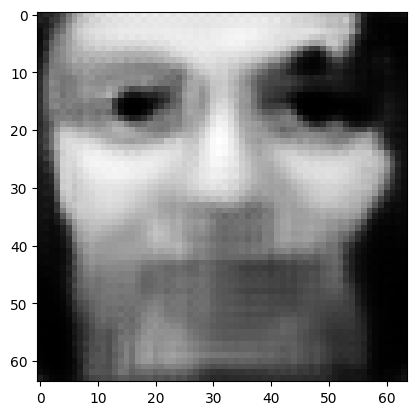

tensor([[8.9444e-04, 2.8391e-04, 4.9398e-02, 6.0290e-04, 1.6901e-05, 9.2715e-06,
         1.4865e-03, 7.1085e-01, 4.4859e-04, 3.5730e-02, 8.1485e-03, 5.1513e-04,
         3.3281e-04, 1.7909e-04, 2.2114e-04, 5.9048e-03, 2.0806e-03, 2.1193e-05,
         5.3722e-03, 1.1791e-03, 5.6920e-03, 8.1278e-03, 2.9244e-05, 1.1759e-02,
         4.4625e-03, 3.4808e-05, 7.1992e-04, 8.6461e-04, 3.6386e-02, 3.9786e-03,
         3.8353e-05, 1.9303e-05, 4.2045e-03, 8.5592e-04, 3.2732e-02, 1.3161e-04,
         4.5242e-03, 2.6113e-02, 3.1228e-02, 4.4179e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34128689765930176
tensor([[8.8366e-04, 2.7649e-04, 4.7403e-02, 5.7385e-04, 1.5913e-05, 8.9829e-06,
         1.4118e-03, 7.2327e-01, 4.1181e-04, 3.4466e-02, 7.8156e-03, 4.9003e-04,
         3.1420e-04, 1.7066e-04, 2.0688e-04, 5.7557e-03, 1.9770e-03, 1.9840e-05,
         5.1814e-03, 1.1196e-03, 5.3566e-03, 7.7684e-03, 2.6995e-05, 1.1318e-02,
         4.2459e-03, 3.3440e-05, 6.8699e-0

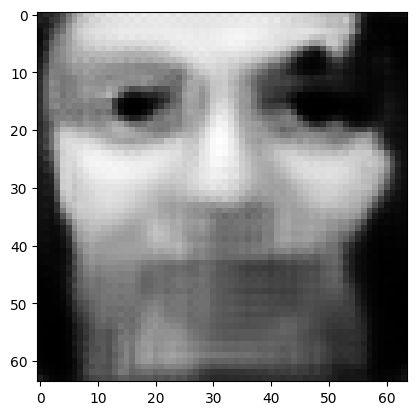

tensor([[8.4977e-04, 2.5165e-04, 4.0795e-02, 4.8187e-04, 1.2878e-05, 8.0601e-06,
         1.1819e-03, 7.6302e-01, 3.0611e-04, 3.0275e-02, 6.7355e-03, 4.1111e-04,
         2.5781e-04, 1.4419e-04, 1.6419e-04, 5.2382e-03, 1.6551e-03, 1.5900e-05,
         4.5527e-03, 9.2845e-04, 4.3121e-03, 6.6123e-03, 2.0592e-05, 9.8780e-03,
         3.5792e-03, 2.8962e-05, 5.8166e-04, 6.6678e-04, 2.9193e-02, 3.1002e-03,
         2.7942e-05, 1.6251e-05, 3.3447e-03, 6.9224e-04, 2.6481e-02, 1.0534e-04,
         3.7050e-03, 2.1289e-02, 2.5611e-02, 3.4732e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2704756259918213
tensor([[8.4181e-04, 2.4610e-04, 3.9423e-02, 4.6319e-04, 1.2278e-05, 7.8685e-06,
         1.1371e-03, 7.7112e-01, 2.8691e-04, 2.9411e-02, 6.5119e-03, 3.9525e-04,
         2.4664e-04, 1.3874e-04, 1.5592e-04, 5.1245e-03, 1.5902e-03, 1.5143e-05,
         4.4223e-03, 8.8967e-04, 4.1033e-03, 6.3759e-03, 1.9407e-05, 9.5784e-03,
         3.4489e-03, 2.8031e-05, 5.6024e-04

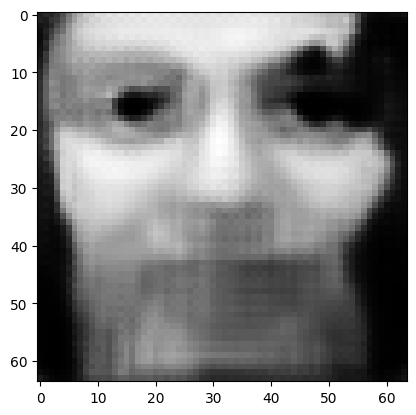

tensor([[8.1323e-04, 2.2688e-04, 3.4811e-02, 4.0134e-04, 1.0357e-05, 7.2164e-06,
         9.8998e-04, 7.9819e-01, 2.2739e-04, 2.6436e-02, 5.7650e-03, 3.4317e-04,
         2.1003e-04, 1.2089e-04, 1.2947e-04, 4.7285e-03, 1.3791e-03, 1.2743e-05,
         3.9804e-03, 7.6123e-04, 3.4320e-03, 5.5844e-03, 1.5700e-05, 8.5625e-03,
         3.0206e-03, 2.4929e-05, 4.8929e-04, 5.4072e-04, 2.4475e-02, 2.5342e-03,
         2.1696e-05, 1.4158e-05, 2.7872e-03, 5.8111e-04, 2.2396e-02, 8.8242e-05,
         3.1474e-03, 1.8139e-02, 2.1741e-02, 2.8578e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22540482878684998
tensor([[8.0682e-04, 2.2270e-04, 3.3837e-02, 3.8839e-04, 9.9707e-06, 7.0774e-06,
         9.5975e-04, 8.0387e-01, 2.1580e-04, 2.5801e-02, 5.6077e-03, 3.3240e-04,
         2.0252e-04, 1.1719e-04, 1.2410e-04, 4.6429e-03, 1.3354e-03, 1.2261e-05,
         3.8862e-03, 7.3461e-04, 3.2953e-03, 5.4182e-03, 1.4964e-05, 8.3456e-03,
         2.9326e-03, 2.4274e-05, 4.7451e-0

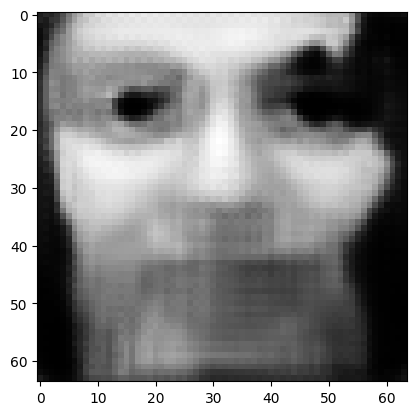

tensor([[7.8210e-04, 2.0790e-04, 3.0495e-02, 3.4469e-04, 8.6584e-06, 6.5789e-06,
         8.5630e-04, 8.2342e-01, 1.7820e-04, 2.3593e-02, 5.0677e-03, 2.9534e-04,
         1.7699e-04, 1.0445e-04, 1.0627e-04, 4.3455e-03, 1.1869e-03, 1.0633e-05,
         3.5611e-03, 6.4499e-04, 2.8381e-03, 4.8504e-03, 1.2546e-05, 7.5957e-03,
         2.6261e-03, 2.1963e-05, 4.2406e-04, 4.5463e-04, 2.1155e-02, 2.1455e-03,
         1.7603e-05, 1.2637e-05, 2.3970e-03, 5.0198e-04, 1.9481e-02, 7.6226e-05,
         2.7450e-03, 1.5892e-02, 1.8922e-02, 2.4358e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19428551197052002
tensor([[7.7636e-04, 2.0462e-04, 2.9771e-02, 3.3525e-04, 8.3846e-06, 6.4690e-06,
         8.3409e-04, 8.2764e-01, 1.7054e-04, 2.3111e-02, 4.9509e-03, 2.8738e-04,
         1.7158e-04, 1.0171e-04, 1.0254e-04, 4.2795e-03, 1.1551e-03, 1.0291e-05,
         3.4896e-03, 6.2592e-04, 2.7422e-03, 4.7283e-03, 1.2046e-05, 7.4313e-03,
         2.5607e-03, 2.1460e-05, 4.1318e-0

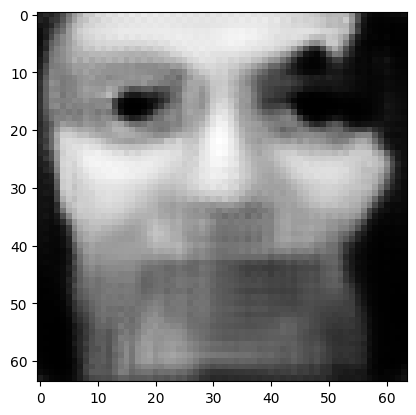

tensor([[7.5539e-04, 1.9290e-04, 2.7260e-02, 3.0296e-04, 7.4437e-06, 6.0800e-06,
         7.5764e-04, 8.4232e-01, 1.4519e-04, 2.1411e-02, 4.5422e-03, 2.6001e-04,
         1.5302e-04, 9.2294e-05, 8.9906e-05, 4.0412e-03, 1.0458e-03, 9.1206e-06,
         3.2398e-03, 5.6027e-04, 2.4164e-03, 4.3045e-03, 1.0388e-05, 6.8538e-03,
         2.3333e-03, 1.9722e-05, 3.7564e-04, 3.9275e-04, 1.8703e-02, 1.8637e-03,
         1.4761e-05, 1.1471e-05, 2.1095e-03, 4.4345e-04, 1.7307e-02, 6.7324e-05,
         2.4454e-03, 1.4207e-02, 1.6797e-02, 2.1290e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.17159153521060944
tensor([[7.5064e-04, 1.9029e-04, 2.6706e-02, 2.9595e-04, 7.2413e-06, 5.9934e-06,
         7.4099e-04, 8.4554e-01, 1.3990e-04, 2.1033e-02, 4.4527e-03, 2.5404e-04,
         1.4901e-04, 9.0248e-05, 8.7223e-05, 3.9874e-03, 1.0222e-03, 8.8701e-06,
         3.1843e-03, 5.4610e-04, 2.3467e-03, 4.2120e-03, 1.0041e-05, 6.7265e-03,
         2.2833e-03, 1.9340e-05, 3.6742e-0

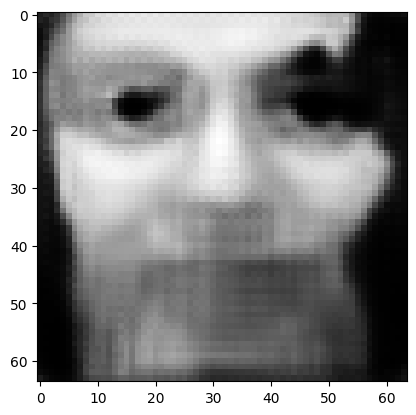

tensor([[7.3224e-04, 1.8077e-04, 2.4767e-02, 2.7126e-04, 6.5378e-06, 5.6835e-06,
         6.8301e-04, 8.5690e-01, 1.2201e-04, 1.9691e-02, 4.1370e-03, 2.3308e-04,
         1.3495e-04, 8.3016e-05, 7.7918e-05, 3.7956e-03, 9.3911e-04, 7.9985e-06,
         2.9881e-03, 4.9668e-04, 2.1039e-03, 3.8859e-03, 8.8456e-06, 6.2717e-03,
         2.1076e-03, 1.7985e-05, 3.3856e-04, 3.4665e-04, 1.6829e-02, 1.6518e-03,
         1.2701e-05, 1.0561e-05, 1.8908e-03, 3.9871e-04, 1.5638e-02, 6.0524e-05,
         2.2152e-03, 1.2907e-02, 1.5156e-02, 1.8951e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15443302690982819
tensor([[7.2768e-04, 1.7859e-04, 2.4335e-02, 2.6580e-04, 6.3811e-06, 5.6126e-06,
         6.7017e-04, 8.5944e-01, 1.1818e-04, 1.9386e-02, 4.0668e-03, 2.2837e-04,
         1.3183e-04, 8.1404e-05, 7.5886e-05, 3.7519e-03, 9.2074e-04, 7.8059e-06,
         2.9439e-03, 4.8580e-04, 2.0506e-03, 3.8133e-03, 8.5863e-06, 6.1695e-03,
         2.0682e-03, 1.7680e-05, 3.3214e-0

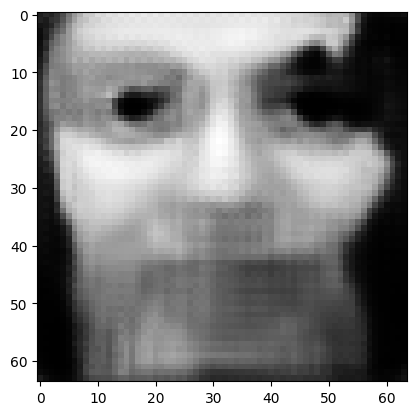

tensor([[7.1064e-04, 1.7064e-04, 2.2808e-02, 2.4660e-04, 5.8322e-06, 5.3568e-06,
         6.2464e-04, 8.6854e-01, 1.0492e-04, 1.8295e-02, 3.8144e-03, 2.1167e-04,
         1.2080e-04, 7.5640e-05, 6.8724e-05, 3.5954e-03, 8.5495e-04, 7.1250e-06,
         2.7861e-03, 4.4733e-04, 1.8630e-03, 3.5553e-03, 7.6825e-06, 5.8006e-03,
         1.9270e-03, 1.6587e-05, 3.0934e-04, 3.1106e-04, 1.5344e-02, 1.4852e-03,
         1.1132e-05, 9.8240e-06, 1.7180e-03, 3.6319e-04, 1.4291e-02, 5.5118e-05,
         2.0303e-03, 1.1859e-02, 1.3840e-02, 1.7109e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14094305038452148
tensor([[7.0632e-04, 1.6876e-04, 2.2466e-02, 2.4235e-04, 5.7079e-06, 5.2976e-06,
         6.1450e-04, 8.7058e-01, 1.0207e-04, 1.8051e-02, 3.7577e-03, 2.0787e-04,
         1.1834e-04, 7.4316e-05, 6.7149e-05, 3.5602e-03, 8.4034e-04, 6.9720e-06,
         2.7505e-03, 4.3883e-04, 1.8213e-03, 3.4973e-03, 7.4857e-06, 5.7183e-03,
         1.8949e-03, 1.6335e-05, 3.0425e-0

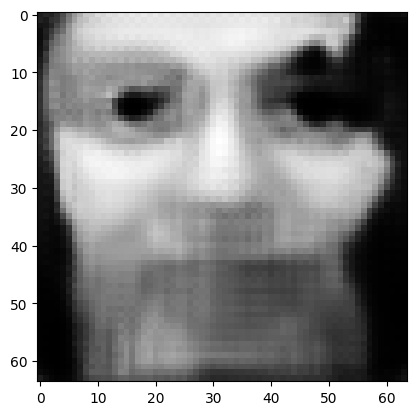

tensor([[6.8976e-04, 1.6190e-04, 2.1217e-02, 2.2683e-04, 5.2675e-06, 5.0813e-06,
         5.7742e-04, 8.7800e-01, 9.2021e-05, 1.7169e-02, 3.5541e-03, 1.9405e-04,
         1.0946e-04, 6.9501e-05, 6.1552e-05, 3.4305e-03, 7.8676e-04, 6.4235e-06,
         2.6201e-03, 4.0841e-04, 1.6714e-03, 3.2877e-03, 6.7854e-06, 5.4150e-03,
         1.7793e-03, 1.5413e-05, 2.8570e-04, 2.8299e-04, 1.4156e-02, 1.3524e-03,
         9.8980e-06, 9.1993e-06, 1.5785e-03, 3.3413e-04, 1.3188e-02, 5.0739e-05,
         1.8768e-03, 1.0986e-02, 1.2764e-02, 1.5630e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13010750710964203
tensor([[6.8593e-04, 1.6033e-04, 2.0935e-02, 2.2337e-04, 5.1689e-06, 5.0321e-06,
         5.6909e-04, 8.7968e-01, 8.9824e-05, 1.6968e-02, 3.5079e-03, 1.9096e-04,
         1.0748e-04, 6.8423e-05, 6.0313e-05, 3.4005e-03, 7.7483e-04, 6.3018e-06,
         2.5906e-03, 4.0154e-04, 1.6382e-03, 3.2404e-03, 6.6325e-06, 5.3463e-03,
         1.7533e-03, 1.5206e-05, 2.8154e-0

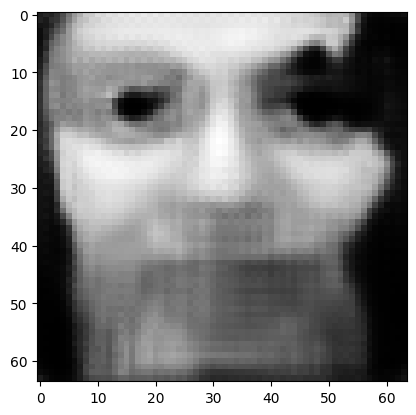

tensor([[6.7152e-04, 1.5449e-04, 1.9896e-02, 2.1070e-04, 4.8139e-06, 4.8505e-06,
         5.3877e-04, 8.8582e-01, 8.1983e-05, 1.6226e-02, 3.3386e-03, 1.7967e-04,
         1.0026e-04, 6.4477e-05, 5.5837e-05, 3.2891e-03, 7.3114e-04, 5.8627e-06,
         2.4818e-03, 3.7659e-04, 1.5176e-03, 3.0672e-03, 6.0831e-06, 5.0931e-03,
         1.6586e-03, 1.4445e-05, 2.6629e-04, 2.6026e-04, 1.3181e-02, 1.2444e-03,
         8.9191e-06, 8.6822e-06, 1.4645e-03, 3.1021e-04, 1.2283e-02, 4.7146e-05,
         1.7505e-03, 1.0270e-02, 1.1876e-02, 1.4424e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12124554812908173
tensor([[6.6823e-04, 1.5315e-04, 1.9658e-02, 2.0779e-04, 4.7339e-06, 4.8086e-06,
         5.3190e-04, 8.8722e-01, 8.0238e-05, 1.6055e-02, 3.2998e-03, 1.7714e-04,
         9.8650e-05, 6.3588e-05, 5.4825e-05, 3.2635e-03, 7.2123e-04, 5.7647e-06,
         2.4567e-03, 3.7091e-04, 1.4906e-03, 3.0274e-03, 5.9599e-06, 5.0356e-03,
         1.6373e-03, 1.4272e-05, 2.6284e-0

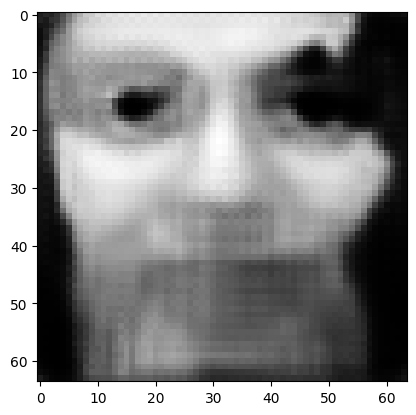

tensor([[6.5583e-04, 1.4817e-04, 1.8779e-02, 1.9727e-04, 4.4432e-06, 4.6537e-06,
         5.0672e-04, 8.9237e-01, 7.3981e-05, 1.5423e-02, 3.1569e-03, 1.6784e-04,
         9.2756e-05, 6.0320e-05, 5.1189e-05, 3.1676e-03, 6.8502e-04, 5.4095e-06,
         2.3648e-03, 3.5020e-04, 1.3925e-03, 2.8821e-03, 5.5191e-06, 4.8239e-03,
         1.5585e-03, 1.3635e-05, 2.5016e-04, 2.4153e-04, 1.2368e-02, 1.1553e-03,
         8.1312e-06, 8.2490e-06, 1.3699e-03, 2.9028e-04, 1.1529e-02, 4.4162e-05,
         1.6450e-03, 9.6732e-03, 1.1137e-02, 1.3431e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11387860029935837
tensor([[6.5282e-04, 1.4701e-04, 1.8575e-02, 1.9486e-04, 4.3766e-06, 4.6174e-06,
         5.0095e-04, 8.9355e-01, 7.2575e-05, 1.5277e-02, 3.1240e-03, 1.6569e-04,
         9.1401e-05, 5.9562e-05, 5.0364e-05, 3.1452e-03, 6.7670e-04, 5.3279e-06,
         2.3436e-03, 3.4547e-04, 1.3701e-03, 2.8487e-03, 5.4192e-06, 4.7750e-03,
         1.5403e-03, 1.3487e-05, 2.4723e-0

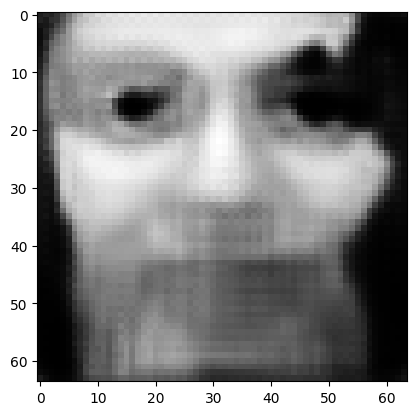

tensor([[6.4114e-04, 1.4261e-04, 1.7815e-02, 1.8595e-04, 4.1331e-06, 4.4812e-06,
         4.7946e-04, 8.9796e-01, 6.7475e-05, 1.4730e-02, 3.0017e-03, 1.5776e-04,
         8.6464e-05, 5.6755e-05, 4.7364e-05, 3.0616e-03, 6.4562e-04, 5.0316e-06,
         2.2642e-03, 3.2822e-04, 1.2885e-03, 2.7245e-03, 5.0545e-06, 4.5951e-03,
         1.4728e-03, 1.2937e-05, 2.3635e-04, 2.2577e-04, 1.1678e-02, 1.0808e-03,
         7.4792e-06, 7.8719e-06, 1.2901e-03, 2.7335e-04, 1.0888e-02, 4.1651e-05,
         1.5542e-03, 9.1599e-03, 1.0515e-02, 1.2594e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10763152688741684
tensor([[6.3835e-04, 1.4159e-04, 1.7639e-02, 1.8388e-04, 4.0772e-06, 4.4491e-06,
         4.7452e-04, 8.9897e-01, 6.6319e-05, 1.4603e-02, 2.9737e-03, 1.5593e-04,
         8.5327e-05, 5.6110e-05, 4.6680e-05, 3.0420e-03, 6.3841e-04, 4.9637e-06,
         2.2459e-03, 3.2428e-04, 1.2699e-03, 2.6959e-03, 4.9713e-06, 4.5535e-03,
         1.4573e-03, 1.2810e-05, 2.3384e-0

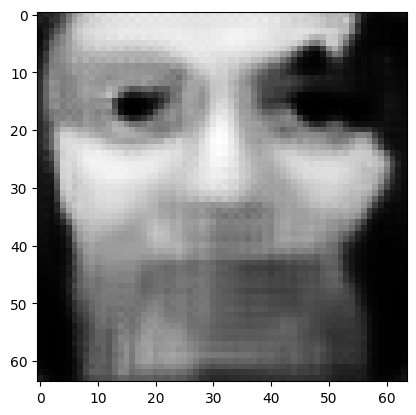

tensor([[6.2745e-04, 1.3769e-04, 1.6982e-02, 1.7627e-04, 3.8698e-06, 4.3283e-06,
         4.5607e-04, 9.0277e-01, 6.2102e-05, 1.4129e-02, 2.8684e-03, 1.4910e-04,
         8.1105e-05, 5.3677e-05, 4.4163e-05, 2.9676e-03, 6.1169e-04, 4.7113e-06,
         2.1772e-03, 3.0969e-04, 1.2010e-03, 2.5894e-03, 4.6675e-06, 4.3980e-03,
         1.3987e-03, 1.2333e-05, 2.2444e-04, 2.1241e-04, 1.1087e-02, 1.0176e-03,
         6.9330e-06, 7.5399e-06, 1.2218e-03, 2.5885e-04, 1.0340e-02, 3.9505e-05,
         1.4758e-03, 8.7147e-03, 9.9851e-03, 1.1884e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10228847712278366
tensor([[6.2475e-04, 1.3677e-04, 1.6829e-02, 1.7449e-04, 3.8214e-06, 4.2996e-06,
         4.5174e-04, 9.0365e-01, 6.1138e-05, 1.4018e-02, 2.8440e-03, 1.4749e-04,
         8.0125e-05, 5.3107e-05, 4.3587e-05, 2.9500e-03, 6.0546e-04, 4.6524e-06,
         2.1610e-03, 3.0633e-04, 1.1850e-03, 2.5646e-03, 4.5978e-06, 4.3615e-03,
         1.3850e-03, 1.2220e-05, 2.2224e-0

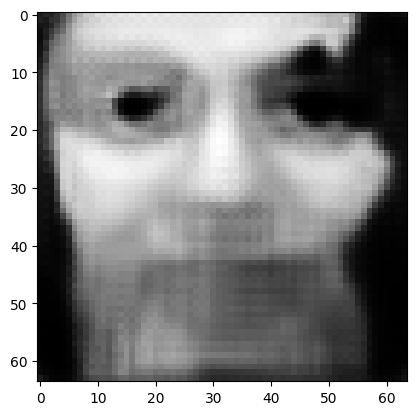

tensor([[6.1477e-04, 1.3330e-04, 1.6258e-02, 1.6785e-04, 3.6443e-06, 4.1923e-06,
         4.3558e-04, 9.0695e-01, 5.7606e-05, 1.3606e-02, 2.7526e-03, 1.4157e-04,
         7.6517e-05, 5.0993e-05, 4.1456e-05, 2.8842e-03, 5.8229e-04, 4.4359e-06,
         2.1003e-03, 2.9385e-04, 1.1265e-03, 2.4722e-03, 4.3418e-06, 4.2254e-03,
         1.3339e-03, 1.1802e-05, 2.1406e-04, 2.0096e-04, 1.0577e-02, 9.6363e-04,
         6.4703e-06, 7.2452e-06, 1.1626e-03, 2.4632e-04, 9.8652e-03, 3.7650e-05,
         1.4076e-03, 8.3243e-03, 9.5287e-03, 1.1272e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09767089784145355
tensor([[6.1238e-04, 1.3248e-04, 1.6126e-02, 1.6631e-04, 3.6028e-06, 4.1671e-06,
         4.3182e-04, 9.0771e-01, 5.6798e-05, 1.3510e-02, 2.7313e-03, 1.4018e-04,
         7.5681e-05, 5.0502e-05, 4.0964e-05, 2.8687e-03, 5.7692e-04, 4.3856e-06,
         2.0861e-03, 2.9095e-04, 1.1129e-03, 2.4506e-03, 4.2830e-06, 4.1935e-03,
         1.3221e-03, 1.1704e-05, 2.1217e-0

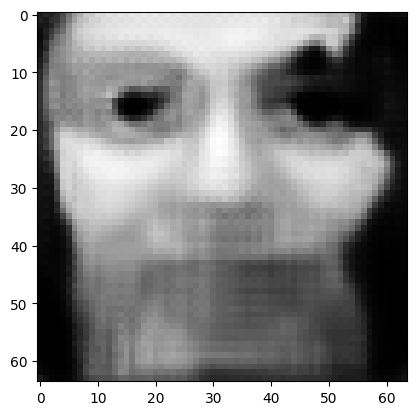

tensor([[6.0334e-04, 1.2939e-04, 1.5630e-02, 1.6052e-04, 3.4496e-06, 4.0720e-06,
         4.1781e-04, 9.1058e-01, 5.3822e-05, 1.3152e-02, 2.6517e-03, 1.3504e-04,
         7.2562e-05, 4.8660e-05, 3.9143e-05, 2.8104e-03, 5.5681e-04, 4.1990e-06,
         2.0331e-03, 2.8013e-04, 1.0626e-03, 2.3701e-03, 4.0659e-06, 4.0744e-03,
         1.2781e-03, 1.1337e-05, 2.0509e-04, 1.9110e-04, 1.0136e-02, 9.1715e-04,
         6.0762e-06, 6.9867e-06, 1.1112e-03, 2.3542e-04, 9.4513e-03, 3.6036e-05,
         1.3481e-03, 7.9847e-03, 9.1301e-03, 1.0743e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09367276728153229
tensor([[6.0113e-04, 1.2866e-04, 1.5514e-02, 1.5918e-04, 3.4134e-06, 4.0493e-06,
         4.1454e-04, 9.1125e-01, 5.3139e-05, 1.3068e-02, 2.6331e-03, 1.3383e-04,
         7.1831e-05, 4.8224e-05, 3.8723e-05, 2.7965e-03, 5.5211e-04, 4.1553e-06,
         2.0208e-03, 2.7764e-04, 1.0509e-03, 2.3513e-03, 4.0160e-06, 4.0468e-03,
         1.2677e-03, 1.1250e-05, 2.0344e-0

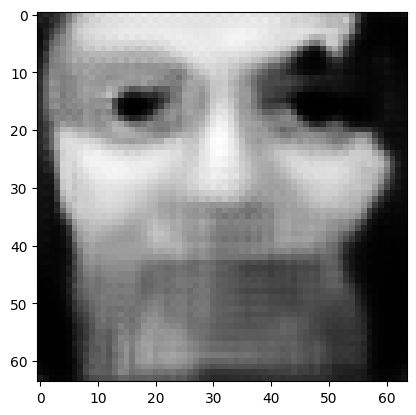

tensor([[5.9259e-04, 1.2589e-04, 1.5077e-02, 1.5410e-04, 3.2788e-06, 3.9633e-06,
         4.0214e-04, 9.1377e-01, 5.0593e-05, 1.2754e-02, 2.5637e-03, 1.2927e-04,
         6.9086e-05, 4.6585e-05, 3.7157e-05, 2.7449e-03, 5.3425e-04, 3.9924e-06,
         1.9743e-03, 2.6837e-04, 1.0072e-03, 2.2802e-03, 3.8284e-06, 3.9422e-03,
         1.2285e-03, 1.0920e-05, 1.9720e-04, 1.8253e-04, 9.7508e-03, 8.7689e-04,
         5.7342e-06, 6.7531e-06, 1.0659e-03, 2.2587e-04, 9.0883e-03, 3.4627e-05,
         1.2953e-03, 7.6820e-03, 8.7804e-03, 1.0284e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09017504751682281
tensor([[5.9057e-04, 1.2525e-04, 1.4974e-02, 1.5293e-04, 3.2478e-06, 3.9433e-06,
         3.9925e-04, 9.1436e-01, 5.0006e-05, 1.2681e-02, 2.5476e-03, 1.2821e-04,
         6.8447e-05, 4.6201e-05, 3.6795e-05, 2.7328e-03, 5.3009e-04, 3.9547e-06,
         1.9635e-03, 2.6622e-04, 9.9710e-04, 2.2638e-03, 3.7851e-06, 3.9177e-03,
         1.2194e-03, 1.0843e-05, 1.9575e-0

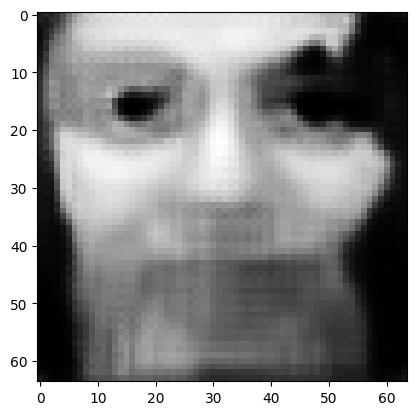

tensor([[5.8303e-04, 1.2283e-04, 1.4589e-02, 1.4855e-04, 3.1329e-06, 3.8683e-06,
         3.8844e-04, 9.1656e-01, 4.7840e-05, 1.2411e-02, 2.4869e-03, 1.2426e-04,
         6.6089e-05, 4.4765e-05, 3.5452e-05, 2.6876e-03, 5.1453e-04, 3.8159e-06,
         1.9228e-03, 2.5822e-04, 9.5951e-04, 2.2022e-03, 3.6257e-06, 3.8263e-03,
         1.1852e-03, 1.0554e-05, 1.9032e-04, 1.7509e-04, 9.4138e-03, 8.4234e-04,
         5.4399e-06, 6.5499e-06, 1.0266e-03, 2.1757e-04, 8.7698e-03, 3.3410e-05,
         1.2488e-03, 7.4164e-03, 8.4736e-03, 9.8889e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08712635934352875
tensor([[5.8122e-04, 1.2226e-04, 1.4499e-02, 1.4753e-04, 3.1061e-06, 3.8506e-06,
         3.8590e-04, 9.1708e-01, 4.7337e-05, 1.2347e-02, 2.4727e-03, 1.2333e-04,
         6.5535e-05, 4.4427e-05, 3.5139e-05, 2.6769e-03, 5.1087e-04, 3.7834e-06,
         1.9133e-03, 2.5635e-04, 9.5074e-04, 2.1878e-03, 3.5887e-06, 3.8048e-03,
         1.1771e-03, 1.0486e-05, 1.8905e-0

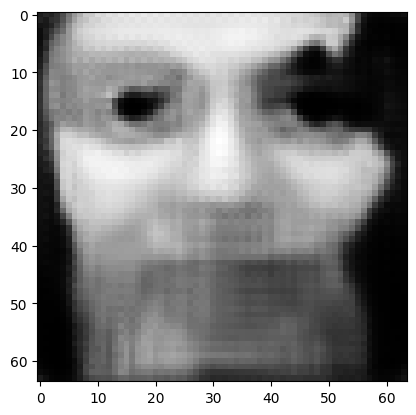

tensor([[5.7435e-04, 1.2008e-04, 1.4157e-02, 1.4364e-04, 3.0048e-06, 3.7832e-06,
         3.7630e-04, 9.1904e-01, 4.5449e-05, 1.2105e-02, 2.4185e-03, 1.1982e-04,
         6.3452e-05, 4.3157e-05, 3.3957e-05, 2.6360e-03, 4.9706e-04, 3.6612e-06,
         1.8767e-03, 2.4925e-04, 9.1770e-04, 2.1329e-03, 3.4495e-06, 3.7228e-03,
         1.1467e-03, 1.0228e-05, 1.8423e-04, 1.6853e-04, 9.1148e-03, 8.1186e-04,
         5.1829e-06, 6.3690e-06, 9.9196e-04, 2.1021e-04, 8.4873e-03, 3.2331e-05,
         1.2076e-03, 7.1812e-03, 8.2006e-03, 9.5394e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08442512899637222
tensor([[5.7272e-04, 1.1957e-04, 1.4076e-02, 1.4271e-04, 2.9809e-06, 3.7672e-06,
         3.7403e-04, 9.1950e-01, 4.5008e-05, 1.2047e-02, 2.4058e-03, 1.1900e-04,
         6.2964e-05, 4.2859e-05, 3.3680e-05, 2.6263e-03, 4.9382e-04, 3.6326e-06,
         1.8681e-03, 2.4758e-04, 9.0994e-04, 2.1199e-03, 3.4170e-06, 3.7035e-03,
         1.1396e-03, 1.0167e-05, 1.8310e-0

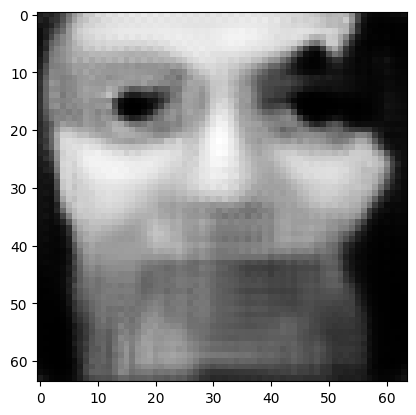

tensor([[5.6652e-04, 1.1761e-04, 1.3767e-02, 1.3925e-04, 2.8913e-06, 3.7064e-06,
         3.6542e-04, 9.2126e-01, 4.3346e-05, 1.1828e-02, 2.3571e-03, 1.1588e-04,
         6.1114e-05, 4.1729e-05, 3.2636e-05, 2.5892e-03, 4.8149e-04, 3.5246e-06,
         1.8353e-03, 2.4124e-04, 8.8078e-04, 2.0708e-03, 3.2947e-06, 3.6300e-03,
         1.1124e-03, 9.9365e-06, 1.7878e-04, 1.6269e-04, 8.8474e-03, 7.8473e-04,
         4.9569e-06, 6.2072e-06, 9.6096e-04, 2.0366e-04, 8.2351e-03, 3.1368e-05,
         1.1708e-03, 6.9708e-03, 7.9566e-03, 9.2282e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08200996369123459
tensor([[5.6505e-04, 1.1715e-04, 1.3694e-02, 1.3842e-04, 2.8702e-06, 3.6920e-06,
         3.6338e-04, 9.2168e-01, 4.2955e-05, 1.1776e-02, 2.3455e-03, 1.1515e-04,
         6.0677e-05, 4.1462e-05, 3.2389e-05, 2.5804e-03, 4.7856e-04, 3.4991e-06,
         1.8274e-03, 2.3974e-04, 8.7389e-04, 2.0592e-03, 3.2659e-06, 3.6124e-03,
         1.1060e-03, 9.8817e-06, 1.7776e-0

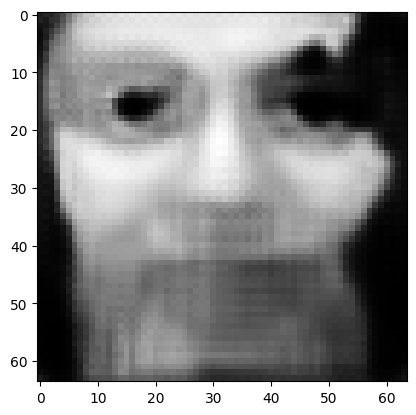

tensor([[5.5940e-04, 1.1537e-04, 1.3416e-02, 1.3529e-04, 2.7901e-06, 3.6368e-06,
         3.5564e-04, 9.2327e-01, 4.1485e-05, 1.1577e-02, 2.3015e-03, 1.1235e-04,
         5.9025e-05, 4.0451e-05, 3.1456e-05, 2.5465e-03, 4.6750e-04, 3.4029e-06,
         1.7976e-03, 2.3403e-04, 8.4788e-04, 2.0148e-03, 3.1576e-06, 3.5457e-03,
         1.0816e-03, 9.6741e-06, 1.7388e-04, 1.5746e-04, 8.6065e-03, 7.6042e-04,
         4.7564e-06, 6.0614e-06, 9.3313e-04, 1.9776e-04, 8.0083e-03, 3.0502e-05,
         1.1377e-03, 6.7824e-03, 7.7363e-03, 8.9493e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07983651012182236
tensor([[5.5803e-04, 1.1494e-04, 1.3350e-02, 1.3455e-04, 2.7711e-06, 3.6237e-06,
         3.5381e-04, 9.2364e-01, 4.1140e-05, 1.1529e-02, 2.2911e-03, 1.1169e-04,
         5.8633e-05, 4.0211e-05, 3.1237e-05, 2.5384e-03, 4.6489e-04, 3.3801e-06,
         1.7905e-03, 2.3268e-04, 8.4174e-04, 2.0043e-03, 3.1321e-06, 3.5299e-03,
         1.0758e-03, 9.6249e-06, 1.7296e-0

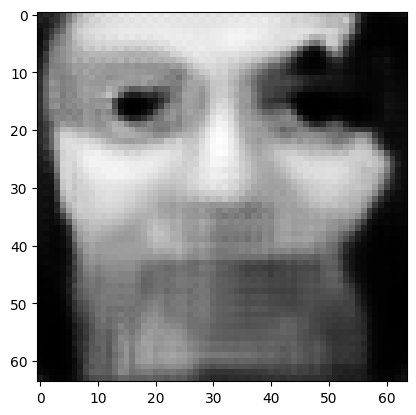

tensor([[5.5289e-04, 1.1333e-04, 1.3098e-02, 1.3173e-04, 2.6996e-06, 3.5736e-06,
         3.4683e-04, 9.2508e-01, 3.9836e-05, 1.1348e-02, 2.2512e-03, 1.0918e-04,
         5.7153e-05, 3.9303e-05, 3.0404e-05, 2.5073e-03, 4.5495e-04, 3.2942e-06,
         1.7634e-03, 2.2752e-04, 8.1853e-04, 1.9643e-03, 3.0361e-06, 3.4695e-03,
         1.0539e-03, 9.4381e-06, 1.6947e-04, 1.5277e-04, 8.3893e-03, 7.3854e-04,
         4.5781e-06, 5.9299e-06, 9.0809e-04, 1.9246e-04, 7.8042e-03, 2.9720e-05,
         1.1080e-03, 6.6127e-03, 7.5378e-03, 8.6977e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07787813246250153
tensor([[5.5166e-04, 1.1294e-04, 1.3038e-02, 1.3106e-04, 2.6826e-06, 3.5617e-06,
         3.4518e-04, 9.2542e-01, 3.9530e-05, 1.1305e-02, 2.2417e-03, 1.0859e-04,
         5.6802e-05, 3.9087e-05, 3.0207e-05, 2.5000e-03, 4.5260e-04, 3.2738e-06,
         1.7570e-03, 2.2630e-04, 8.1304e-04, 1.9548e-03, 3.0134e-06, 3.4552e-03,
         1.0487e-03, 9.3936e-06, 1.6864e-0

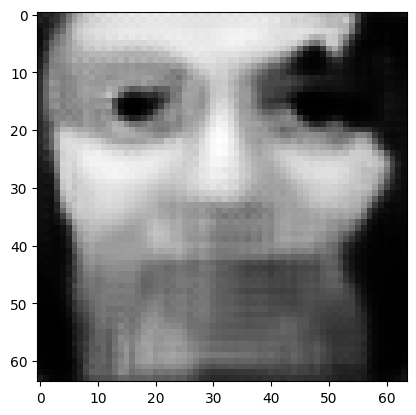

tensor([[5.4694e-04, 1.1146e-04, 1.2811e-02, 1.2852e-04, 2.6184e-06, 3.5162e-06,
         3.3887e-04, 9.2672e-01, 3.8367e-05, 1.1140e-02, 2.2055e-03, 1.0633e-04,
         5.5472e-05, 3.8270e-05, 2.9457e-05, 2.4716e-03, 4.4361e-04, 3.1967e-06,
         1.7323e-03, 2.2164e-04, 7.9222e-04, 1.9185e-03, 2.9277e-06, 3.4001e-03,
         1.0289e-03, 9.2247e-06, 1.6548e-04, 1.4854e-04, 8.1927e-03, 7.1882e-04,
         4.4188e-06, 5.8110e-06, 8.8548e-04, 1.8766e-04, 7.6194e-03, 2.9012e-05,
         1.0811e-03, 6.4597e-03, 7.3576e-03, 8.4711e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07610759884119034
tensor([[5.4582e-04, 1.1111e-04, 1.2756e-02, 1.2791e-04, 2.6032e-06, 3.5053e-06,
         3.3736e-04, 9.2703e-01, 3.8092e-05, 1.1102e-02, 2.1968e-03, 1.0579e-04,
         5.5156e-05, 3.8074e-05, 2.9281e-05, 2.4648e-03, 4.4147e-04, 3.1784e-06,
         1.7264e-03, 2.2054e-04, 7.8729e-04, 1.9099e-03, 2.9075e-06, 3.3870e-03,
         1.0241e-03, 9.1843e-06, 1.6473e-0

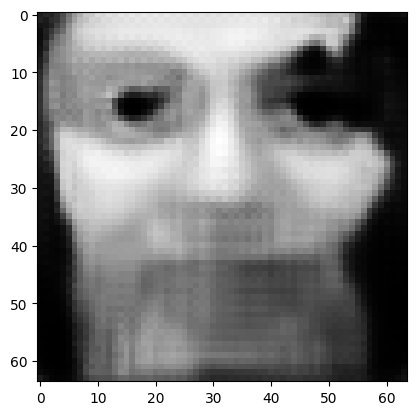

tensor([[5.4146e-04, 1.0976e-04, 1.2549e-02, 1.2561e-04, 2.5453e-06, 3.4637e-06,
         3.3162e-04, 9.2821e-01, 3.7052e-05, 1.0952e-02, 2.1637e-03, 1.0374e-04,
         5.3952e-05, 3.7331e-05, 2.8607e-05, 2.4388e-03, 4.3336e-04, 3.1088e-06,
         1.7038e-03, 2.1634e-04, 7.6858e-04, 1.8770e-03, 2.8311e-06, 3.3371e-03,
         1.0060e-03, 9.0306e-06, 1.6185e-04, 1.4472e-04, 8.0140e-03, 7.0101e-04,
         4.2758e-06, 5.7019e-06, 8.6497e-04, 1.8332e-04, 7.4522e-03, 2.8371e-05,
         1.0567e-03, 6.3204e-03, 7.1941e-03, 8.2653e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07450223714113235
tensor([[5.4043e-04, 1.0943e-04, 1.2500e-02, 1.2507e-04, 2.5316e-06, 3.4539e-06,
         3.3025e-04, 9.2849e-01, 3.6805e-05, 1.0916e-02, 2.1558e-03, 1.0325e-04,
         5.3666e-05, 3.7154e-05, 2.8448e-05, 2.4326e-03, 4.3144e-04, 3.0923e-06,
         1.6984e-03, 2.1534e-04, 7.6415e-04, 1.8692e-03, 2.8131e-06, 3.3252e-03,
         1.0018e-03, 8.9942e-06, 1.6116e-0

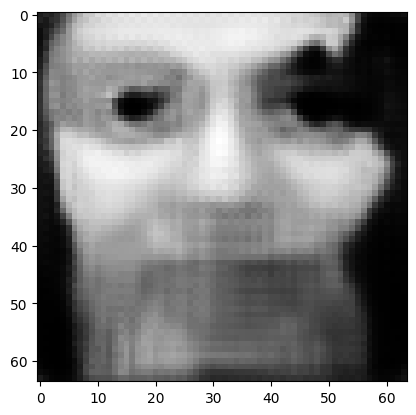

tensor([[5.3647e-04, 1.0819e-04, 1.2311e-02, 1.2296e-04, 2.4795e-06, 3.4159e-06,
         3.2502e-04, 9.2956e-01, 3.5869e-05, 1.0780e-02, 2.1255e-03, 1.0139e-04,
         5.2575e-05, 3.6480e-05, 2.7840e-05, 2.4086e-03, 4.2405e-04, 3.0295e-06,
         1.6776e-03, 2.1151e-04, 7.4725e-04, 1.8393e-03, 2.7444e-06, 3.2794e-03,
         9.8536e-04, 8.8545e-06, 1.5852e-04, 1.4125e-04, 7.8509e-03, 6.8492e-04,
         4.1473e-06, 5.6025e-06, 8.4638e-04, 1.7937e-04, 7.3011e-03, 2.7788e-05,
         1.0346e-03, 6.1941e-03, 7.0449e-03, 8.0791e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07304190844297409
tensor([[5.3551e-04, 1.0790e-04, 1.2266e-02, 1.2246e-04, 2.4669e-06, 3.4067e-06,
         3.2376e-04, 9.2982e-01, 3.5646e-05, 1.0747e-02, 2.1182e-03, 1.0095e-04,
         5.2314e-05, 3.6318e-05, 2.7694e-05, 2.4028e-03, 4.2229e-04, 3.0144e-06,
         1.6726e-03, 2.1060e-04, 7.4323e-04, 1.8321e-03, 2.7280e-06, 3.2685e-03,
         9.8143e-04, 8.8209e-06, 1.5790e-0

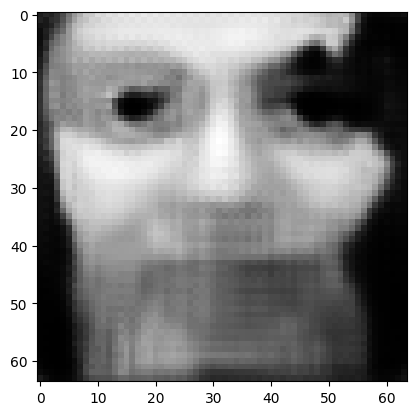

tensor([[5.3183e-04, 1.0675e-04, 1.2093e-02, 1.2054e-04, 2.4195e-06, 3.3717e-06,
         3.1896e-04, 9.3081e-01, 3.4798e-05, 1.0621e-02, 2.0904e-03, 9.9251e-05,
         5.1323e-05, 3.5703e-05, 2.7141e-05, 2.3806e-03, 4.1555e-04, 2.9571e-06,
         1.6534e-03, 2.0710e-04, 7.2793e-04, 1.8046e-03, 2.6659e-06, 3.2265e-03,
         9.6638e-04, 8.6931e-06, 1.5549e-04, 1.3808e-04, 7.7019e-03, 6.7020e-04,
         4.0309e-06, 5.5112e-06, 8.2936e-04, 1.7577e-04, 7.1622e-03, 2.7252e-05,
         1.0143e-03, 6.0784e-03, 6.9085e-03, 7.9084e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07170528173446655
tensor([[5.3095e-04, 1.0648e-04, 1.2051e-02, 1.2008e-04, 2.4080e-06, 3.3632e-06,
         3.1781e-04, 9.3104e-01, 3.4596e-05, 1.0591e-02, 2.0837e-03, 9.8846e-05,
         5.1086e-05, 3.5556e-05, 2.7009e-05, 2.3753e-03, 4.1394e-04, 2.9434e-06,
         1.6489e-03, 2.0627e-04, 7.2428e-04, 1.7981e-03, 2.6511e-06, 3.2165e-03,
         9.6277e-04, 8.6623e-06, 1.5491e-0

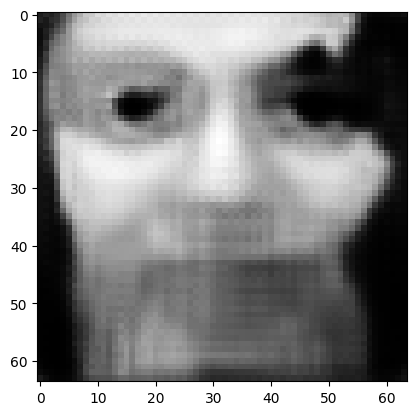

tensor([[5.2751e-04, 1.0542e-04, 1.1892e-02, 1.1832e-04, 2.3650e-06, 3.3309e-06,
         3.1340e-04, 9.3194e-01, 3.3831e-05, 1.0477e-02, 2.0583e-03, 9.7297e-05,
         5.0178e-05, 3.4992e-05, 2.6508e-05, 2.3549e-03, 4.0777e-04, 2.8915e-06,
         1.6313e-03, 2.0309e-04, 7.1039e-04, 1.7730e-03, 2.5949e-06, 3.1780e-03,
         9.4900e-04, 8.5446e-06, 1.5270e-04, 1.3519e-04, 7.5657e-03, 6.5684e-04,
         3.9252e-06, 5.4271e-06, 8.1382e-04, 1.7247e-04, 7.0361e-03, 2.6765e-05,
         9.9581e-04, 5.9723e-03, 6.7839e-03, 7.7532e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07048474997282028
tensor([[5.2668e-04, 1.0516e-04, 1.1854e-02, 1.1790e-04, 2.3546e-06, 3.3231e-06,
         3.1235e-04, 9.3216e-01, 3.3649e-05, 1.0449e-02, 2.0522e-03, 9.6926e-05,
         4.9961e-05, 3.4857e-05, 2.6388e-05, 2.3500e-03, 4.0630e-04, 2.8790e-06,
         1.6271e-03, 2.0233e-04, 7.0706e-04, 1.7669e-03, 2.5816e-06, 3.1688e-03,
         9.4571e-04, 8.5162e-06, 1.5217e-0

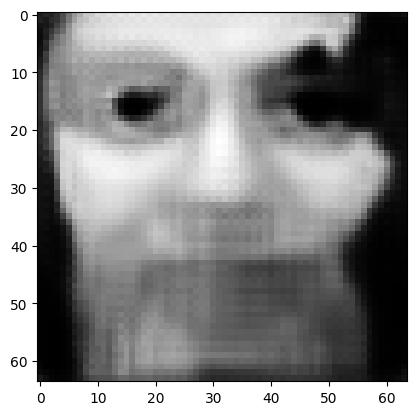

tensor([[5.2348e-04, 1.0419e-04, 1.1708e-02, 1.1627e-04, 2.3153e-06, 3.2933e-06,
         3.0830e-04, 9.3299e-01, 3.2954e-05, 1.0343e-02, 2.0288e-03, 9.5508e-05,
         4.9131e-05, 3.4341e-05, 2.5930e-05, 2.3311e-03, 4.0067e-04, 2.8316e-06,
         1.6109e-03, 1.9941e-04, 6.9441e-04, 1.7438e-03, 2.5304e-06, 3.1335e-03,
         9.3308e-04, 8.4079e-06, 1.5015e-04, 1.3254e-04, 7.4407e-03, 6.4464e-04,
         3.8292e-06, 5.3499e-06, 7.9959e-04, 1.6945e-04, 6.9208e-03, 2.6318e-05,
         9.7878e-04, 5.8750e-03, 6.6697e-03, 7.6112e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06936582922935486
tensor([[5.2270e-04, 1.0395e-04, 1.1674e-02, 1.1588e-04, 2.3060e-06, 3.2861e-06,
         3.0733e-04, 9.3318e-01, 3.2788e-05, 1.0318e-02, 2.0232e-03, 9.5168e-05,
         4.8933e-05, 3.4218e-05, 2.5820e-05, 2.3266e-03, 3.9931e-04, 2.8202e-06,
         1.6069e-03, 1.9871e-04, 6.9138e-04, 1.7383e-03, 2.5182e-06, 3.1249e-03,
         9.3006e-04, 8.3820e-06, 1.4966e-0

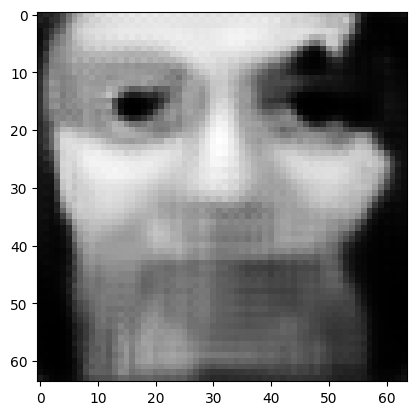

tensor([[5.1972e-04, 1.0305e-04, 1.1539e-02, 1.1439e-04, 2.2699e-06, 3.2584e-06,
         3.0359e-04, 9.3395e-01, 3.2152e-05, 1.0219e-02, 2.0016e-03, 9.3862e-05,
         4.8170e-05, 3.3744e-05, 2.5400e-05, 2.3091e-03, 3.9412e-04, 2.7766e-06,
         1.5919e-03, 1.9603e-04, 6.7977e-04, 1.7170e-03, 2.4714e-06, 3.0921e-03,
         9.1842e-04, 8.2819e-06, 1.4779e-04, 1.3010e-04, 7.3255e-03, 6.3345e-04,
         3.7415e-06, 5.2785e-06, 7.8650e-04, 1.6668e-04, 6.8146e-03, 2.5906e-05,
         9.6309e-04, 5.7855e-03, 6.5644e-03, 7.4813e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06833506375551224
tensor([[5.1899e-04, 1.0283e-04, 1.1507e-02, 1.1403e-04, 2.2613e-06, 3.2518e-06,
         3.0269e-04, 9.3413e-01, 3.2000e-05, 1.0196e-02, 1.9964e-03, 9.3548e-05,
         4.7987e-05, 3.3631e-05, 2.5300e-05, 2.3049e-03, 3.9287e-04, 2.7661e-06,
         1.5883e-03, 1.9539e-04, 6.7701e-04, 1.7119e-03, 2.4602e-06, 3.0842e-03,
         9.1559e-04, 8.2580e-06, 1.4734e-0

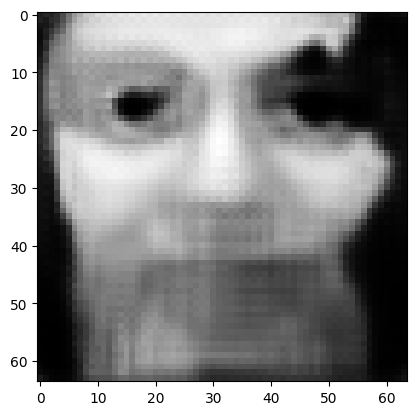

tensor([[5.1621e-04, 1.0200e-04, 1.1385e-02, 1.1267e-04, 2.2283e-06, 3.2264e-06,
         2.9924e-04, 9.3483e-01, 3.1420e-05, 1.0105e-02, 1.9765e-03, 9.2349e-05,
         4.7289e-05, 3.3197e-05, 2.4916e-05, 2.2887e-03, 3.8809e-04, 2.7262e-06,
         1.5744e-03, 1.9294e-04, 6.6647e-04, 1.6924e-03, 2.4177e-06, 3.0539e-03,
         9.0480e-04, 8.1667e-06, 1.4562e-04, 1.2787e-04, 7.2195e-03, 6.2316e-04,
         3.6613e-06, 5.2127e-06, 7.7448e-04, 1.6414e-04, 6.7166e-03, 2.5526e-05,
         9.4872e-04, 5.7031e-03, 6.4676e-03, 7.3616e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06738781929016113
tensor([[5.1555e-04, 1.0180e-04, 1.1355e-02, 1.1234e-04, 2.2205e-06, 3.2203e-06,
         2.9841e-04, 9.3500e-01, 3.1282e-05, 1.0083e-02, 1.9718e-03, 9.2062e-05,
         4.7122e-05, 3.3094e-05, 2.4825e-05, 2.2848e-03, 3.8694e-04, 2.7167e-06,
         1.5711e-03, 1.9235e-04, 6.6395e-04, 1.6877e-03, 2.4075e-06, 3.0466e-03,
         9.0221e-04, 8.1447e-06, 1.4521e-0

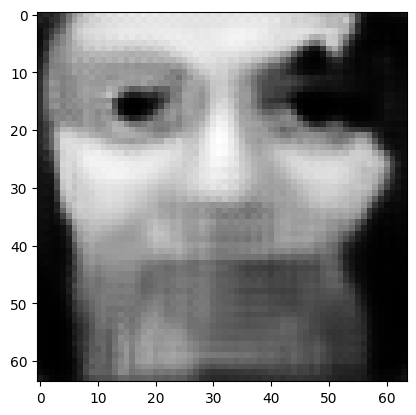

tensor([[5.1295e-04, 1.0102e-04, 1.1241e-02, 1.1109e-04, 2.1901e-06, 3.1966e-06,
         2.9522e-04, 9.3565e-01, 3.0750e-05, 9.9993e-03, 1.9534e-03, 9.0955e-05,
         4.6478e-05, 3.2694e-05, 2.4472e-05, 2.2697e-03, 3.8252e-04, 2.6799e-06,
         1.5582e-03, 1.9009e-04, 6.5425e-04, 1.6697e-03, 2.3684e-06, 3.0185e-03,
         8.9224e-04, 8.0601e-06, 1.4362e-04, 1.2581e-04, 7.1216e-03, 6.1369e-04,
         3.5878e-06, 5.1518e-06, 7.6339e-04, 1.6179e-04, 6.6262e-03, 2.5176e-05,
         9.3544e-04, 5.6270e-03, 6.3782e-03, 7.2516e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06651274114847183
tensor([[5.1232e-04, 1.0084e-04, 1.1214e-02, 1.1078e-04, 2.1829e-06, 3.1909e-06,
         2.9446e-04, 9.3581e-01, 3.0623e-05, 9.9791e-03, 1.9490e-03, 9.0688e-05,
         4.6323e-05, 3.2597e-05, 2.4387e-05, 2.2661e-03, 3.8146e-04, 2.6711e-06,
         1.5551e-03, 1.8955e-04, 6.5191e-04, 1.6653e-03, 2.3590e-06, 3.0117e-03,
         8.8985e-04, 8.0396e-06, 1.4324e-0

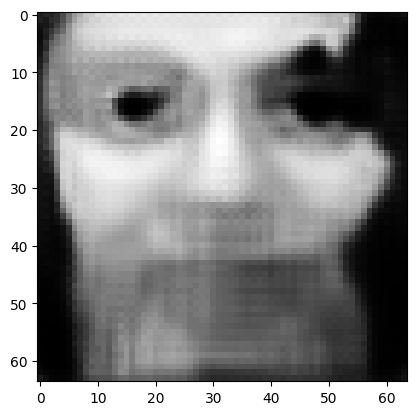

tensor([[5.0989e-04, 1.0012e-04, 1.1108e-02, 1.0961e-04, 2.1547e-06, 3.1686e-06,
         2.9147e-04, 9.3641e-01, 3.0131e-05, 9.9004e-03, 1.9318e-03, 8.9657e-05,
         4.5728e-05, 3.2226e-05, 2.4060e-05, 2.2519e-03, 3.7735e-04, 2.6369e-06,
         1.5430e-03, 1.8746e-04, 6.4297e-04, 1.6485e-03, 2.3228e-06, 2.9856e-03,
         8.8054e-04, 7.9604e-06, 1.4176e-04, 1.2390e-04, 7.0310e-03, 6.0490e-04,
         3.5199e-06, 5.0948e-06, 7.5308e-04, 1.5961e-04, 6.5419e-03, 2.4850e-05,
         9.2313e-04, 5.5560e-03, 6.2951e-03, 7.1497e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06569929420948029
tensor([[5.0931e-04, 9.9943e-05, 1.1082e-02, 1.0933e-04, 2.1480e-06, 3.1632e-06,
         2.9074e-04, 9.3656e-01, 3.0012e-05, 9.8813e-03, 1.9276e-03, 8.9407e-05,
         4.5585e-05, 3.2137e-05, 2.3981e-05, 2.2485e-03, 3.7635e-04, 2.6287e-06,
         1.5401e-03, 1.8695e-04, 6.4083e-04, 1.6445e-03, 2.3140e-06, 2.9793e-03,
         8.7829e-04, 7.9413e-06, 1.4140e-0

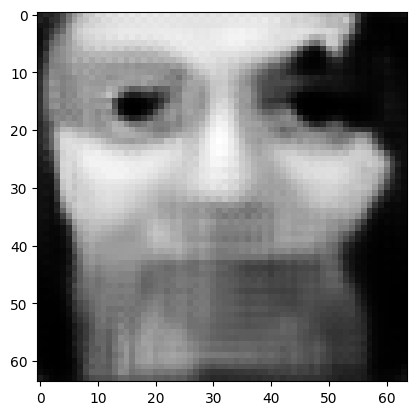

tensor([[5.0707e-04, 9.9276e-05, 1.0983e-02, 1.0824e-04, 2.1221e-06, 3.1424e-06,
         2.8796e-04, 9.3712e-01, 2.9557e-05, 9.8082e-03, 1.9116e-03, 8.8453e-05,
         4.5035e-05, 3.1793e-05, 2.3679e-05, 2.2353e-03, 3.7254e-04, 2.5971e-06,
         1.5288e-03, 1.8501e-04, 6.3261e-04, 1.6289e-03, 2.2808e-06, 2.9550e-03,
         8.6966e-04, 7.8676e-06, 1.4002e-04, 1.2213e-04, 6.9470e-03, 5.9679e-04,
         3.4575e-06, 5.0417e-06, 7.4353e-04, 1.5760e-04, 6.4639e-03, 2.4547e-05,
         9.1171e-04, 5.4900e-03, 6.2182e-03, 7.0558e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06494339555501938
tensor([[5.0654e-04, 9.9115e-05, 1.0960e-02, 1.0797e-04, 2.1159e-06, 3.1374e-06,
         2.8728e-04, 9.3726e-01, 2.9448e-05, 9.7906e-03, 1.9078e-03, 8.8225e-05,
         4.4903e-05, 3.1711e-05, 2.3606e-05, 2.2321e-03, 3.7162e-04, 2.5896e-06,
         1.5261e-03, 1.8454e-04, 6.3064e-04, 1.6251e-03, 2.2728e-06, 2.9491e-03,
         8.6761e-04, 7.8500e-06, 1.3969e-0

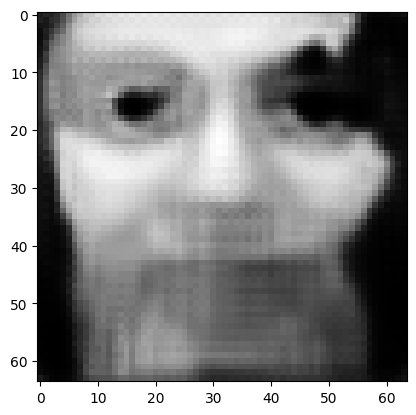

tensor([[5.0443e-04, 9.8491e-05, 1.0868e-02, 1.0696e-04, 2.0919e-06, 3.1180e-06,
         2.8469e-04, 9.3778e-01, 2.9029e-05, 9.7226e-03, 1.8929e-03, 8.7339e-05,
         4.4393e-05, 3.1393e-05, 2.3328e-05, 2.2197e-03, 3.6808e-04, 2.5604e-06,
         1.5156e-03, 1.8274e-04, 6.2303e-04, 1.6106e-03, 2.2421e-06, 2.9265e-03,
         8.5960e-04, 7.7815e-06, 1.3841e-04, 1.2049e-04, 6.8690e-03, 5.8928e-04,
         3.3998e-06, 4.9924e-06, 7.3468e-04, 1.5573e-04, 6.3915e-03, 2.4267e-05,
         9.0112e-04, 5.4289e-03, 6.1467e-03, 6.9687e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06424259394407272
tensor([[5.0393e-04, 9.8340e-05, 1.0846e-02, 1.0671e-04, 2.0861e-06, 3.1134e-06,
         2.8407e-04, 9.3790e-01, 2.8929e-05, 9.7063e-03, 1.8893e-03, 8.7127e-05,
         4.4270e-05, 3.1316e-05, 2.3260e-05, 2.2168e-03, 3.6723e-04, 2.5534e-06,
         1.5130e-03, 1.8230e-04, 6.2119e-04, 1.6071e-03, 2.2347e-06, 2.9210e-03,
         8.5769e-04, 7.7649e-06, 1.3810e-0

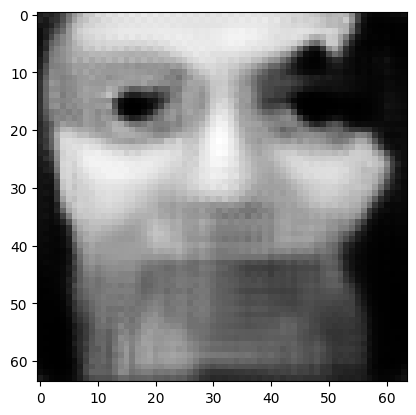

tensor([[5.0196e-04, 9.7758e-05, 1.0760e-02, 1.0577e-04, 2.0639e-06, 3.0953e-06,
         2.8166e-04, 9.3839e-01, 2.8542e-05, 9.6430e-03, 1.8755e-03, 8.6305e-05,
         4.3797e-05, 3.1020e-05, 2.3002e-05, 2.2052e-03, 3.6394e-04, 2.5264e-06,
         1.5032e-03, 1.8063e-04, 6.1415e-04, 1.5936e-03, 2.2064e-06, 2.8999e-03,
         8.5023e-04, 7.7011e-06, 1.3692e-04, 1.1897e-04, 6.7966e-03, 5.8232e-04,
         3.3465e-06, 4.9464e-06, 7.2645e-04, 1.5399e-04, 6.3243e-03, 2.4006e-05,
         8.9127e-04, 5.3720e-03, 6.0803e-03, 6.8880e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06359130144119263
tensor([[5.0147e-04, 9.7616e-05, 1.0740e-02, 1.0554e-04, 2.0585e-06, 3.0909e-06,
         2.8108e-04, 9.3851e-01, 2.8450e-05, 9.6278e-03, 1.8722e-03, 8.6106e-05,
         4.3683e-05, 3.0948e-05, 2.2940e-05, 2.2024e-03, 3.6315e-04, 2.5198e-06,
         1.5009e-03, 1.8023e-04, 6.1245e-04, 1.5904e-03, 2.1996e-06, 2.8948e-03,
         8.4844e-04, 7.6858e-06, 1.3663e-0

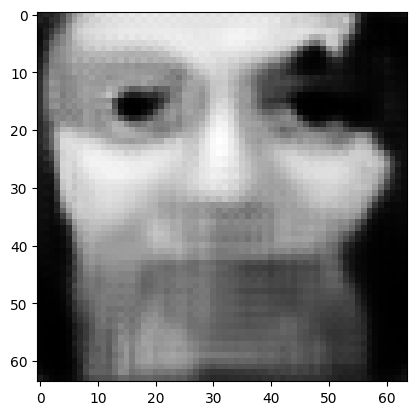

tensor([[4.9961e-04, 9.7069e-05, 1.0660e-02, 1.0467e-04, 2.0378e-06, 3.0740e-06,
         2.7882e-04, 9.3896e-01, 2.8091e-05, 9.5684e-03, 1.8593e-03, 8.5337e-05,
         4.3242e-05, 3.0672e-05, 2.2700e-05, 2.1916e-03, 3.6008e-04, 2.4946e-06,
         1.4917e-03, 1.7867e-04, 6.0590e-04, 1.5778e-03, 2.1733e-06, 2.8751e-03,
         8.4148e-04, 7.6262e-06, 1.3552e-04, 1.1755e-04, 6.7291e-03, 5.7582e-04,
         3.2969e-06, 4.9033e-06, 7.1877e-04, 1.5237e-04, 6.2616e-03, 2.3762e-05,
         8.8209e-04, 5.3188e-03, 6.0184e-03, 6.8122e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06298302114009857
tensor([[4.9915e-04, 9.6936e-05, 1.0640e-02, 1.0445e-04, 2.0328e-06, 3.0698e-06,
         2.7826e-04, 9.3907e-01, 2.8003e-05, 9.5539e-03, 1.8561e-03, 8.5150e-05,
         4.3136e-05, 3.0605e-05, 2.2642e-05, 2.1889e-03, 3.5932e-04, 2.4885e-06,
         1.4894e-03, 1.7829e-04, 6.0432e-04, 1.5747e-03, 2.1669e-06, 2.8703e-03,
         8.3977e-04, 7.6117e-06, 1.3525e-0

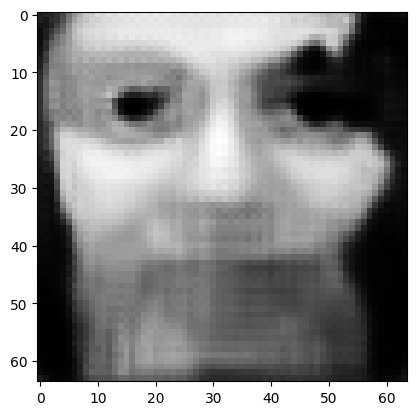

tensor([[4.9736e-04, 9.6418e-05, 1.0565e-02, 1.0362e-04, 2.0134e-06, 3.0536e-06,
         2.7611e-04, 9.3950e-01, 2.7665e-05, 9.4976e-03, 1.8439e-03, 8.4424e-05,
         4.2724e-05, 3.0345e-05, 2.2415e-05, 2.1786e-03, 3.5643e-04, 2.4646e-06,
         1.4806e-03, 1.7683e-04, 5.9823e-04, 1.5629e-03, 2.1421e-06, 2.8516e-03,
         8.3315e-04, 7.5555e-06, 1.3419e-04, 1.1621e-04, 6.6653e-03, 5.6972e-04,
         3.2506e-06, 4.8624e-06, 7.1155e-04, 1.5084e-04, 6.2020e-03, 2.3532e-05,
         8.7342e-04, 5.2684e-03, 5.9605e-03, 6.7412e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06240864470601082
tensor([[4.9692e-04, 9.6291e-05, 1.0547e-02, 1.0342e-04, 2.0087e-06, 3.0496e-06,
         2.7560e-04, 9.3960e-01, 2.7584e-05, 9.4840e-03, 1.8409e-03, 8.4248e-05,
         4.2625e-05, 3.0282e-05, 2.2361e-05, 2.1761e-03, 3.5573e-04, 2.4588e-06,
         1.4785e-03, 1.7648e-04, 5.9676e-04, 1.5600e-03, 2.1361e-06, 2.8471e-03,
         8.3154e-04, 7.5419e-06, 1.3394e-0

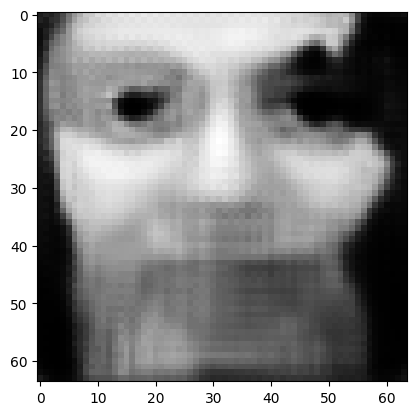

tensor([[4.9526e-04, 9.5806e-05, 1.0477e-02, 1.0265e-04, 1.9906e-06, 3.0345e-06,
         2.7359e-04, 9.4000e-01, 2.7271e-05, 9.4314e-03, 1.8294e-03, 8.3574e-05,
         4.2241e-05, 3.0040e-05, 2.2150e-05, 2.1664e-03, 3.5304e-04, 2.4366e-06,
         1.4703e-03, 1.7511e-04, 5.9109e-04, 1.5489e-03, 2.1131e-06, 2.8297e-03,
         8.2538e-04, 7.4895e-06, 1.3296e-04, 1.1497e-04, 6.6058e-03, 5.6401e-04,
         3.2075e-06, 4.8241e-06, 7.0480e-04, 1.4941e-04, 6.1465e-03, 2.3316e-05,
         8.6535e-04, 5.2213e-03, 5.9064e-03, 6.6746e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.061873044818639755
tensor([[4.9485e-04, 9.5688e-05, 1.0460e-02, 1.0246e-04, 1.9863e-06, 3.0308e-06,
         2.7311e-04, 9.4010e-01, 2.7196e-05, 9.4187e-03, 1.8266e-03, 8.3410e-05,
         4.2148e-05, 2.9981e-05, 2.2100e-05, 2.1640e-03, 3.5239e-04, 2.4312e-06,
         1.4683e-03, 1.7478e-04, 5.8972e-04, 1.5462e-03, 2.1076e-06, 2.8254e-03,
         8.2389e-04, 7.4768e-06, 1.3272e-

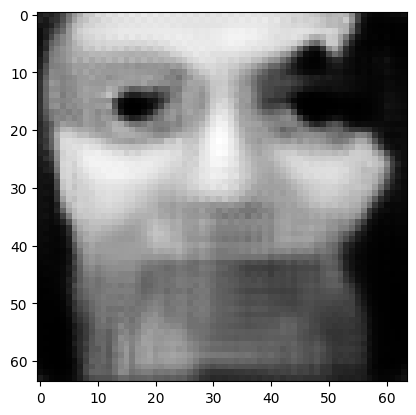

tensor([[4.9328e-04, 9.5234e-05, 1.0395e-02, 1.0174e-04, 1.9694e-06, 3.0166e-06,
         2.7124e-04, 9.4047e-01, 2.6905e-05, 9.3694e-03, 1.8159e-03, 8.2779e-05,
         4.1790e-05, 2.9755e-05, 2.1904e-05, 2.1549e-03, 3.4987e-04, 2.4105e-06,
         1.4607e-03, 1.7351e-04, 5.8444e-04, 1.5359e-03, 2.0862e-06, 2.8092e-03,
         8.1813e-04, 7.4278e-06, 1.3181e-04, 1.1381e-04, 6.5503e-03, 5.5870e-04,
         3.1675e-06, 4.7883e-06, 6.9850e-04, 1.4808e-04, 6.0946e-03, 2.3115e-05,
         8.5780e-04, 5.1773e-03, 5.8559e-03, 6.6127e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.061372920870780945
tensor([[4.9290e-04, 9.5123e-05, 1.0379e-02, 1.0156e-04, 1.9653e-06, 3.0131e-06,
         2.7079e-04, 9.4056e-01, 2.6835e-05, 9.3575e-03, 1.8133e-03, 8.2627e-05,
         4.1704e-05, 2.9700e-05, 2.1857e-05, 2.1527e-03, 3.4926e-04, 2.4054e-06,
         1.4588e-03, 1.7320e-04, 5.8316e-04, 1.5334e-03, 2.0810e-06, 2.8052e-03,
         8.1673e-04, 7.4160e-06, 1.3159e-

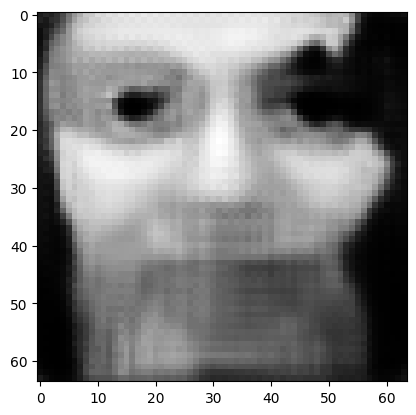

tensor([[4.9142e-04, 9.4697e-05, 1.0318e-02, 1.0089e-04, 1.9496e-06, 2.9998e-06,
         2.6905e-04, 9.4091e-01, 2.6564e-05, 9.3115e-03, 1.8033e-03, 8.2039e-05,
         4.1369e-05, 2.9489e-05, 2.1674e-05, 2.1442e-03, 3.4691e-04, 2.3862e-06,
         1.4517e-03, 1.7201e-04, 5.7824e-04, 1.5237e-03, 2.0611e-06, 2.7900e-03,
         8.1135e-04, 7.3702e-06, 1.3073e-04, 1.1273e-04, 6.4985e-03, 5.5374e-04,
         3.1302e-06, 4.7547e-06, 6.9262e-04, 1.4684e-04, 6.0462e-03, 2.2927e-05,
         8.5076e-04, 5.1362e-03, 5.8087e-03, 6.5549e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060905635356903076
tensor([[4.9106e-04, 9.4594e-05, 1.0303e-02, 1.0073e-04, 1.9458e-06, 2.9966e-06,
         2.6863e-04, 9.4100e-01, 2.6499e-05, 9.3004e-03, 1.8009e-03, 8.1896e-05,
         4.1289e-05, 2.9437e-05, 2.1630e-05, 2.1421e-03, 3.4633e-04, 2.3815e-06,
         1.4499e-03, 1.7173e-04, 5.7704e-04, 1.5214e-03, 2.0563e-06, 2.7863e-03,
         8.1005e-04, 7.3591e-06, 1.3052e-

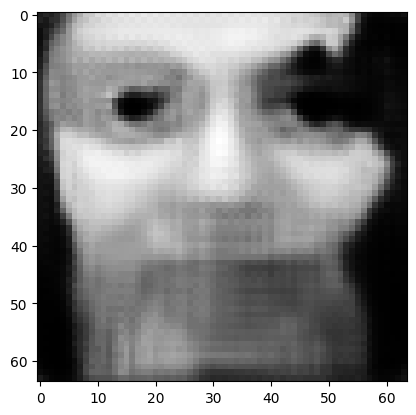

tensor([[4.8967e-04, 9.4195e-05, 1.0245e-02, 1.0010e-04, 1.9311e-06, 2.9841e-06,
         2.6700e-04, 9.4132e-01, 2.6247e-05, 9.2572e-03, 1.7915e-03, 8.1345e-05,
         4.0976e-05, 2.9240e-05, 2.1460e-05, 2.1341e-03, 3.4413e-04, 2.3635e-06,
         1.4432e-03, 1.7062e-04, 5.7244e-04, 1.5124e-03, 2.0377e-06, 2.7720e-03,
         8.0501e-04, 7.3162e-06, 1.2972e-04, 1.1171e-04, 6.4499e-03, 5.4910e-04,
         3.0954e-06, 4.7233e-06, 6.8712e-04, 1.4567e-04, 6.0009e-03, 2.2752e-05,
         8.4416e-04, 5.0978e-03, 5.7645e-03, 6.5010e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060467980802059174
tensor([[4.8933e-04, 9.4097e-05, 1.0232e-02, 9.9943e-05, 1.9275e-06, 2.9811e-06,
         2.6660e-04, 9.4140e-01, 2.6186e-05, 9.2467e-03, 1.7892e-03, 8.1211e-05,
         4.0900e-05, 2.9192e-05, 2.1418e-05, 2.1322e-03, 3.4360e-04, 2.3591e-06,
         1.4416e-03, 1.7035e-04, 5.7133e-04, 1.5102e-03, 2.0332e-06, 2.7685e-03,
         8.0379e-04, 7.3058e-06, 1.2953e-

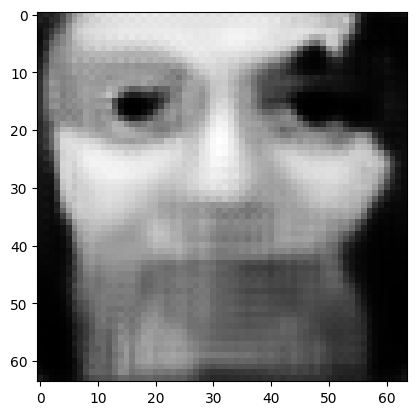

tensor([[4.8803e-04, 9.3721e-05, 1.0178e-02, 9.9351e-05, 1.9137e-06, 2.9693e-06,
         2.6507e-04, 9.4171e-01, 2.5951e-05, 9.2061e-03, 1.7804e-03, 8.0696e-05,
         4.0608e-05, 2.9007e-05, 2.1259e-05, 2.1246e-03, 3.4153e-04, 2.3422e-06,
         1.4353e-03, 1.6931e-04, 5.6702e-04, 1.5017e-03, 2.0159e-06, 2.7551e-03,
         7.9906e-04, 7.2656e-06, 1.2878e-04, 1.1077e-04, 6.4044e-03, 5.4475e-04,
         3.0629e-06, 4.6938e-06, 6.8195e-04, 1.4458e-04, 5.9584e-03, 2.2587e-05,
         8.3798e-04, 5.0617e-03, 5.7231e-03, 6.4503e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0600578673183918
tensor([[4.8770e-04, 9.3630e-05, 1.0165e-02, 9.9209e-05, 1.9104e-06, 2.9665e-06,
         2.6470e-04, 9.4178e-01, 2.5894e-05, 9.1963e-03, 1.7783e-03, 8.0571e-05,
         4.0537e-05, 2.8962e-05, 2.1220e-05, 2.1228e-03, 3.4104e-04, 2.3381e-06,
         1.4338e-03, 1.6906e-04, 5.6598e-04, 1.4996e-03, 2.0117e-06, 2.7519e-03,
         7.9791e-04, 7.2558e-06, 1.2860e-04

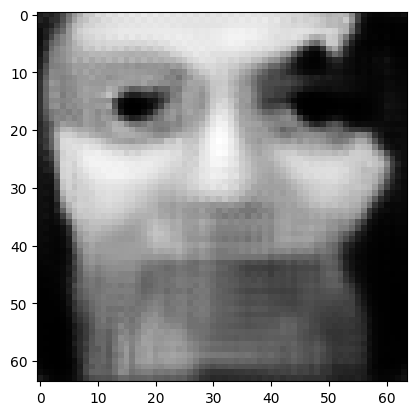

tensor([[4.8647e-04, 9.3277e-05, 1.0114e-02, 9.8656e-05, 1.8975e-06, 2.9554e-06,
         2.6327e-04, 9.4207e-01, 2.5675e-05, 9.1582e-03, 1.7700e-03, 8.0087e-05,
         4.0263e-05, 2.8788e-05, 2.1071e-05, 2.1157e-03, 3.3910e-04, 2.3223e-06,
         1.4279e-03, 1.6808e-04, 5.6196e-04, 1.4917e-03, 1.9955e-06, 2.7393e-03,
         7.9349e-04, 7.2181e-06, 1.2789e-04, 1.0988e-04, 6.3618e-03, 5.4068e-04,
         3.0325e-06, 4.6661e-06, 6.7712e-04, 1.4356e-04, 5.9185e-03, 2.2432e-05,
         8.3218e-04, 5.0280e-03, 5.6842e-03, 6.4029e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05967341363430023
tensor([[4.8617e-04, 9.3192e-05, 1.0102e-02, 9.8520e-05, 1.8944e-06, 2.9528e-06,
         2.6293e-04, 9.4214e-01, 2.5622e-05, 9.1489e-03, 1.7680e-03, 7.9970e-05,
         4.0197e-05, 2.8746e-05, 2.1035e-05, 2.1140e-03, 3.3863e-04, 2.3185e-06,
         1.4265e-03, 1.6785e-04, 5.6098e-04, 1.4897e-03, 1.9916e-06, 2.7363e-03,
         7.9242e-04, 7.2089e-06, 1.2772e-0

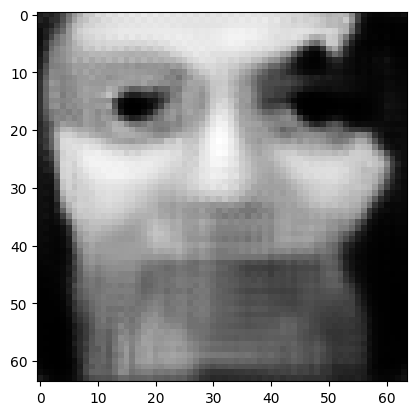

tensor([[4.8500e-04, 9.2859e-05, 1.0055e-02, 9.8001e-05, 1.8824e-06, 2.9424e-06,
         2.6158e-04, 9.4241e-01, 2.5417e-05, 9.1132e-03, 1.7603e-03, 7.9517e-05,
         3.9940e-05, 2.8583e-05, 2.0896e-05, 2.1074e-03, 3.3681e-04, 2.3038e-06,
         1.4209e-03, 1.6693e-04, 5.5721e-04, 1.4823e-03, 1.9765e-06, 2.7245e-03,
         7.8827e-04, 7.1735e-06, 1.2706e-04, 1.0905e-04, 6.3218e-03, 5.3687e-04,
         3.0041e-06, 4.6401e-06, 6.7259e-04, 1.4260e-04, 5.8812e-03, 2.2288e-05,
         8.2673e-04, 4.9963e-03, 5.6477e-03, 6.3586e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.059313077479600906
tensor([[4.8473e-04, 9.2778e-05, 1.0043e-02, 9.7874e-05, 1.8795e-06, 2.9399e-06,
         2.6126e-04, 9.4248e-01, 2.5368e-05, 9.1047e-03, 1.7584e-03, 7.9409e-05,
         3.9878e-05, 2.8543e-05, 2.0863e-05, 2.1057e-03, 3.3638e-04, 2.3002e-06,
         1.4196e-03, 1.6671e-04, 5.5631e-04, 1.4805e-03, 1.9729e-06, 2.7216e-03,
         7.8728e-04, 7.1649e-06, 1.2690e-

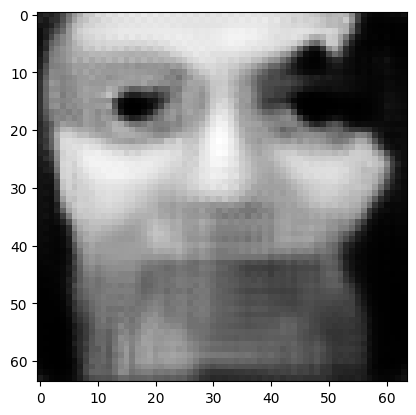

tensor([[4.8364e-04, 9.2465e-05, 9.9987e-03, 9.7384e-05, 1.8682e-06, 2.9302e-06,
         2.5999e-04, 9.4273e-01, 2.5177e-05, 9.0715e-03, 1.7512e-03, 7.8986e-05,
         3.9638e-05, 2.8391e-05, 2.0733e-05, 2.0994e-03, 3.3468e-04, 2.2865e-06,
         1.4144e-03, 1.6586e-04, 5.5279e-04, 1.4735e-03, 1.9589e-06, 2.7106e-03,
         7.8342e-04, 7.1317e-06, 1.2628e-04, 1.0827e-04, 6.2844e-03, 5.3333e-04,
         2.9777e-06, 4.6156e-06, 6.6835e-04, 1.4170e-04, 5.8467e-03, 2.2153e-05,
         8.2165e-04, 4.9666e-03, 5.6137e-03, 6.3172e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05897654965519905
tensor([[4.8337e-04, 9.2390e-05, 9.9879e-03, 9.7267e-05, 1.8655e-06, 2.9278e-06,
         2.5969e-04, 9.4279e-01, 2.5131e-05, 9.0635e-03, 1.7494e-03, 7.8883e-05,
         3.9580e-05, 2.8354e-05, 2.0702e-05, 2.0979e-03, 3.3427e-04, 2.2831e-06,
         1.4131e-03, 1.6565e-04, 5.5194e-04, 1.4718e-03, 1.9555e-06, 2.7079e-03,
         7.8248e-04, 7.1236e-06, 1.2613e-0

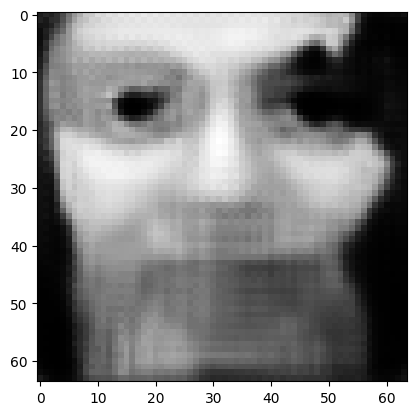

tensor([[4.8235e-04, 9.2095e-05, 9.9460e-03, 9.6806e-05, 1.8550e-06, 2.9187e-06,
         2.5850e-04, 9.4303e-01, 2.4953e-05, 9.0323e-03, 1.7426e-03, 7.8487e-05,
         3.9355e-05, 2.8210e-05, 2.0580e-05, 2.0920e-03, 3.3267e-04, 2.2703e-06,
         1.4082e-03, 1.6485e-04, 5.4864e-04, 1.4652e-03, 1.9424e-06, 2.6975e-03,
         7.7884e-04, 7.0924e-06, 1.2555e-04, 1.0754e-04, 6.2493e-03, 5.3000e-04,
         2.9529e-06, 4.5926e-06, 6.6437e-04, 1.4086e-04, 5.8142e-03, 2.2026e-05,
         8.1687e-04, 4.9387e-03, 5.5818e-03, 6.2783e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05866025760769844
tensor([[4.8210e-04, 9.2023e-05, 9.9358e-03, 9.6694e-05, 1.8524e-06, 2.9164e-06,
         2.5821e-04, 9.4308e-01, 2.4909e-05, 9.0247e-03, 1.7409e-03, 7.8390e-05,
         3.9300e-05, 2.8175e-05, 2.0551e-05, 2.0906e-03, 3.3228e-04, 2.2671e-06,
         1.4070e-03, 1.6466e-04, 5.4784e-04, 1.4636e-03, 1.9392e-06, 2.6950e-03,
         7.7796e-04, 7.0848e-06, 1.2541e-0

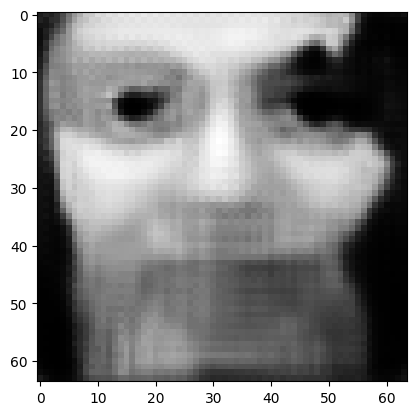

tensor([[4.8114e-04, 9.1746e-05, 9.8964e-03, 9.6260e-05, 1.8425e-06, 2.9078e-06,
         2.5709e-04, 9.4331e-01, 2.4742e-05, 8.9953e-03, 1.7345e-03, 7.8017e-05,
         3.9088e-05, 2.8040e-05, 2.0436e-05, 2.0850e-03, 3.3078e-04, 2.2550e-06,
         1.4024e-03, 1.6390e-04, 5.4474e-04, 1.4574e-03, 1.9269e-06, 2.6852e-03,
         7.7455e-04, 7.0554e-06, 1.2486e-04, 1.0686e-04, 6.2162e-03, 5.2687e-04,
         2.9296e-06, 4.5710e-06, 6.6063e-04, 1.4007e-04, 5.7836e-03, 2.1907e-05,
         8.1237e-04, 4.9125e-03, 5.5516e-03, 6.2418e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05836230516433716
tensor([[4.8090e-04, 9.1678e-05, 9.8868e-03, 9.6155e-05, 1.8401e-06, 2.9057e-06,
         2.5682e-04, 9.4336e-01, 2.4701e-05, 8.9881e-03, 1.7329e-03, 7.7927e-05,
         3.9037e-05, 2.8008e-05, 2.0409e-05, 2.0836e-03, 3.3042e-04, 2.2520e-06,
         1.4013e-03, 1.6372e-04, 5.4399e-04, 1.4559e-03, 1.9239e-06, 2.6828e-03,
         7.7372e-04, 7.0483e-06, 1.2473e-0

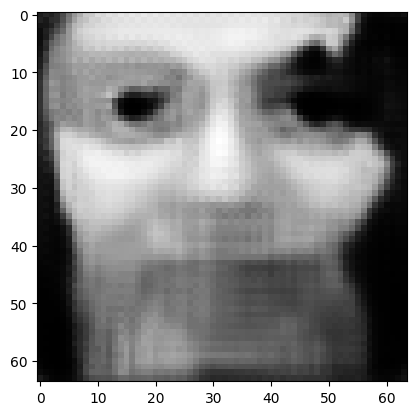

tensor([[4.7999e-04, 9.1416e-05, 9.8497e-03, 9.5749e-05, 1.8308e-06, 2.8976e-06,
         2.5577e-04, 9.4357e-01, 2.4544e-05, 8.9604e-03, 1.7269e-03, 7.7576e-05,
         3.8838e-05, 2.7880e-05, 2.0301e-05, 2.0783e-03, 3.2901e-04, 2.2406e-06,
         1.3969e-03, 1.6301e-04, 5.4108e-04, 1.4501e-03, 1.9123e-06, 2.6736e-03,
         7.7050e-04, 7.0206e-06, 1.2421e-04, 1.0621e-04, 6.1851e-03, 5.2392e-04,
         2.9077e-06, 4.5506e-06, 6.5711e-04, 1.3932e-04, 5.7548e-03, 2.1795e-05,
         8.0814e-04, 4.8877e-03, 5.5232e-03, 6.2074e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05808181315660477
tensor([[4.7978e-04, 9.1353e-05, 9.8406e-03, 9.5649e-05, 1.8286e-06, 2.8956e-06,
         2.5551e-04, 9.4362e-01, 2.4506e-05, 8.9537e-03, 1.7254e-03, 7.7491e-05,
         3.8790e-05, 2.7850e-05, 2.0275e-05, 2.0770e-03, 3.2866e-04, 2.2379e-06,
         1.3959e-03, 1.6283e-04, 5.4037e-04, 1.4487e-03, 1.9095e-06, 2.6713e-03,
         7.6972e-04, 7.0140e-06, 1.2409e-0

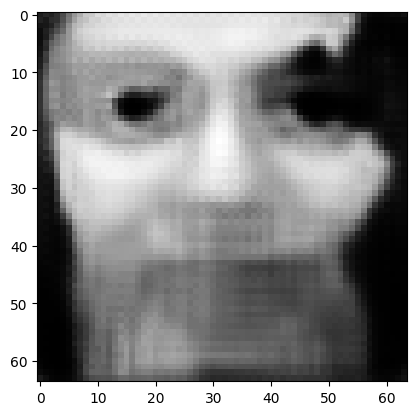

tensor([[4.7892e-04, 9.1105e-05, 9.8057e-03, 9.5266e-05, 1.8198e-06, 2.8880e-06,
         2.5453e-04, 9.4382e-01, 2.4358e-05, 8.9275e-03, 1.7197e-03, 7.7161e-05,
         3.8603e-05, 2.7730e-05, 2.0174e-05, 2.0721e-03, 3.2733e-04, 2.2271e-06,
         1.3918e-03, 1.6217e-04, 5.3763e-04, 1.4432e-03, 1.8987e-06, 2.6626e-03,
         7.6669e-04, 6.9879e-06, 1.2360e-04, 1.0561e-04, 6.1558e-03, 5.2115e-04,
         2.8872e-06, 4.5314e-06, 6.5379e-04, 1.3862e-04, 5.7278e-03, 2.1689e-05,
         8.0416e-04, 4.8645e-03, 5.4965e-03, 6.1750e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05781777948141098
tensor([[4.7870e-04, 9.1045e-05, 9.7972e-03, 9.5173e-05, 1.8177e-06, 2.8861e-06,
         2.5429e-04, 9.4387e-01, 2.4322e-05, 8.9212e-03, 1.7183e-03, 7.7080e-05,
         3.8557e-05, 2.7701e-05, 2.0150e-05, 2.0709e-03, 3.2701e-04, 2.2245e-06,
         1.3908e-03, 1.6200e-04, 5.3697e-04, 1.4419e-03, 1.8960e-06, 2.6605e-03,
         7.6595e-04, 6.9816e-06, 1.2348e-0

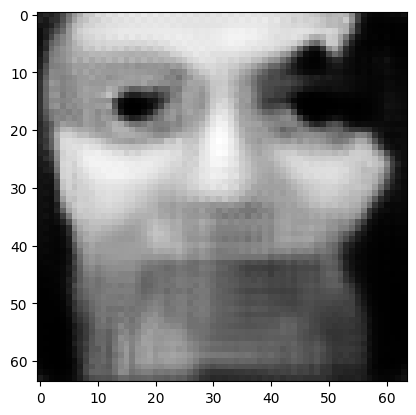

tensor([[4.7789e-04, 9.0812e-05, 9.7642e-03, 9.4811e-05, 1.8094e-06, 2.8789e-06,
         2.5335e-04, 9.4406e-01, 2.4183e-05, 8.8965e-03, 1.7129e-03, 7.6770e-05,
         3.8381e-05, 2.7589e-05, 2.0055e-05, 2.0661e-03, 3.2576e-04, 2.2144e-06,
         1.3869e-03, 1.6137e-04, 5.3439e-04, 1.4367e-03, 1.8858e-06, 2.6523e-03,
         7.6310e-04, 6.9571e-06, 1.2303e-04, 1.0503e-04, 6.1281e-03, 5.1854e-04,
         2.8679e-06, 4.5133e-06, 6.5066e-04, 1.3796e-04, 5.7022e-03, 2.1589e-05,
         8.0040e-04, 4.8426e-03, 5.4713e-03, 6.1444e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05756887421011925
tensor([[4.7770e-04, 9.0755e-05, 9.7562e-03, 9.4724e-05, 1.8074e-06, 2.8771e-06,
         2.5312e-04, 9.4410e-01, 2.4150e-05, 8.8905e-03, 1.7116e-03, 7.6694e-05,
         3.8338e-05, 2.7561e-05, 2.0032e-05, 2.0650e-03, 3.2546e-04, 2.2120e-06,
         1.3859e-03, 1.6122e-04, 5.3377e-04, 1.4355e-03, 1.8833e-06, 2.6503e-03,
         7.6241e-04, 6.9512e-06, 1.2291e-0

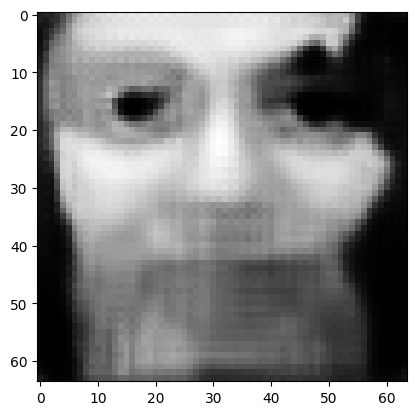

tensor([[4.7693e-04, 9.0534e-05, 9.7251e-03, 9.4382e-05, 1.7997e-06, 2.8703e-06,
         2.5224e-04, 9.4428e-01, 2.4019e-05, 8.8671e-03, 1.7065e-03, 7.6402e-05,
         3.8172e-05, 2.7455e-05, 1.9942e-05, 2.0605e-03, 3.2428e-04, 2.2025e-06,
         1.3823e-03, 1.6062e-04, 5.3134e-04, 1.4306e-03, 1.8738e-06, 2.6425e-03,
         7.5971e-04, 6.9281e-06, 1.2248e-04, 1.0450e-04, 6.1021e-03, 5.1607e-04,
         2.8497e-06, 4.4963e-06, 6.4771e-04, 1.3733e-04, 5.6782e-03, 2.1495e-05,
         7.9686e-04, 4.8220e-03, 5.4475e-03, 6.1155e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.057334087789058685
tensor([[4.7675e-04, 9.0481e-05, 9.7175e-03, 9.4299e-05, 1.7978e-06, 2.8686e-06,
         2.5203e-04, 9.4432e-01, 2.3988e-05, 8.8615e-03, 1.7053e-03, 7.6331e-05,
         3.8132e-05, 2.7430e-05, 1.9920e-05, 2.0595e-03, 3.2399e-04, 2.2002e-06,
         1.3814e-03, 1.6048e-04, 5.3075e-04, 1.4294e-03, 1.8714e-06, 2.6407e-03,
         7.5907e-04, 6.9225e-06, 1.2238e-

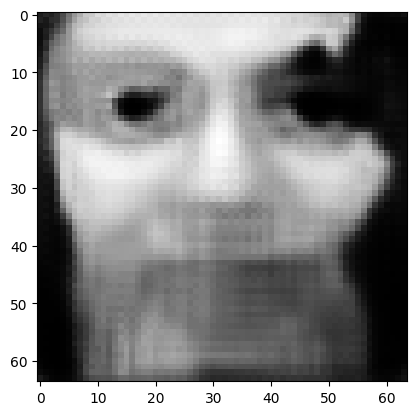

tensor([[4.7602e-04, 9.0272e-05, 9.6881e-03, 9.3977e-05, 1.7905e-06, 2.8622e-06,
         2.5120e-04, 9.4449e-01, 2.3865e-05, 8.8395e-03, 1.7005e-03, 7.6055e-05,
         3.7975e-05, 2.7330e-05, 1.9836e-05, 2.0553e-03, 3.2288e-04, 2.1912e-06,
         1.3779e-03, 1.5991e-04, 5.2846e-04, 1.4248e-03, 1.8624e-06, 2.6333e-03,
         7.5653e-04, 6.9007e-06, 1.2197e-04, 1.0399e-04, 6.0774e-03, 5.1375e-04,
         2.8326e-06, 4.4802e-06, 6.4494e-04, 1.3674e-04, 5.6555e-03, 2.1406e-05,
         7.9352e-04, 4.8025e-03, 5.4251e-03, 6.0885e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.057112641632556915
tensor([[4.7585e-04, 9.0222e-05, 9.6810e-03, 9.3899e-05, 1.7887e-06, 2.8606e-06,
         2.5100e-04, 9.4453e-01, 2.3835e-05, 8.8341e-03, 1.6993e-03, 7.5988e-05,
         3.7937e-05, 2.7305e-05, 1.9815e-05, 2.0542e-03, 3.2261e-04, 2.1890e-06,
         1.3771e-03, 1.5978e-04, 5.2791e-04, 1.4237e-03, 1.8602e-06, 2.6316e-03,
         7.5592e-04, 6.8954e-06, 1.2187e-

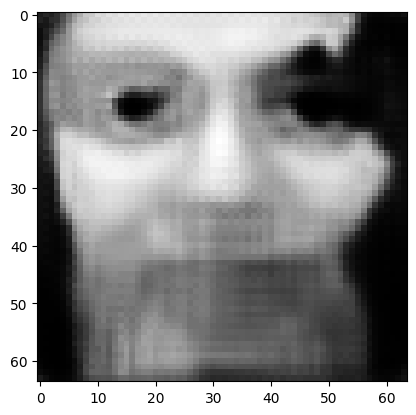

tensor([[4.7516e-04, 9.0025e-05, 9.6532e-03, 9.3595e-05, 1.7818e-06, 2.8545e-06,
         2.5022e-04, 9.4469e-01, 2.3720e-05, 8.8133e-03, 1.6948e-03, 7.5728e-05,
         3.7790e-05, 2.7211e-05, 1.9736e-05, 2.0502e-03, 3.2156e-04, 2.1806e-06,
         1.3738e-03, 1.5925e-04, 5.2576e-04, 1.4193e-03, 1.8517e-06, 2.6246e-03,
         7.5353e-04, 6.8748e-06, 1.2149e-04, 1.0351e-04, 6.0542e-03, 5.1156e-04,
         2.8165e-06, 4.4650e-06, 6.4232e-04, 1.3619e-04, 5.6341e-03, 2.1323e-05,
         7.9038e-04, 4.7842e-03, 5.4040e-03, 6.0628e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0569036491215229
tensor([[4.7499e-04, 8.9977e-05, 9.6465e-03, 9.3522e-05, 1.7801e-06, 2.8530e-06,
         2.5002e-04, 9.4472e-01, 2.3691e-05, 8.8082e-03, 1.6936e-03, 7.5664e-05,
         3.7754e-05, 2.7188e-05, 1.9717e-05, 2.0493e-03, 3.2131e-04, 2.1785e-06,
         1.3730e-03, 1.5912e-04, 5.2523e-04, 1.4183e-03, 1.8496e-06, 2.6230e-03,
         7.5294e-04, 6.8699e-06, 1.2139e-04

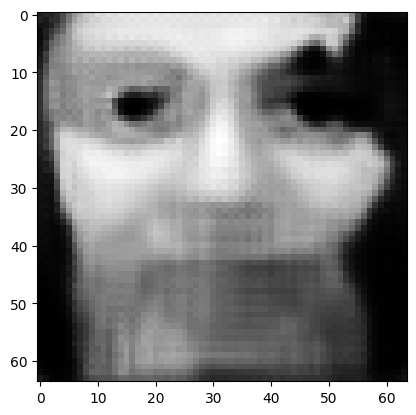

tensor([[4.7435e-04, 8.9791e-05, 9.6204e-03, 9.3236e-05, 1.7736e-06, 2.8473e-06,
         2.4929e-04, 9.4487e-01, 2.3583e-05, 8.7885e-03, 1.6894e-03, 7.5419e-05,
         3.7615e-05, 2.7100e-05, 1.9642e-05, 2.0455e-03, 3.2032e-04, 2.1706e-06,
         1.3699e-03, 1.5861e-04, 5.2320e-04, 1.4142e-03, 1.8416e-06, 2.6164e-03,
         7.5069e-04, 6.8505e-06, 1.2103e-04, 1.0306e-04, 6.0323e-03, 5.0949e-04,
         2.8014e-06, 4.4507e-06, 6.3984e-04, 1.3566e-04, 5.6139e-03, 2.1243e-05,
         7.8741e-04, 4.7668e-03, 5.3840e-03, 6.0386e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056706443428993225
tensor([[4.7419e-04, 8.9746e-05, 9.6140e-03, 9.3166e-05, 1.7721e-06, 2.8459e-06,
         2.4911e-04, 9.4491e-01, 2.3556e-05, 8.7838e-03, 1.6883e-03, 7.5359e-05,
         3.7581e-05, 2.7078e-05, 1.9623e-05, 2.0446e-03, 3.2007e-04, 2.1687e-06,
         1.3692e-03, 1.5849e-04, 5.2271e-04, 1.4132e-03, 1.8397e-06, 2.6148e-03,
         7.5014e-04, 6.8458e-06, 1.2094e-

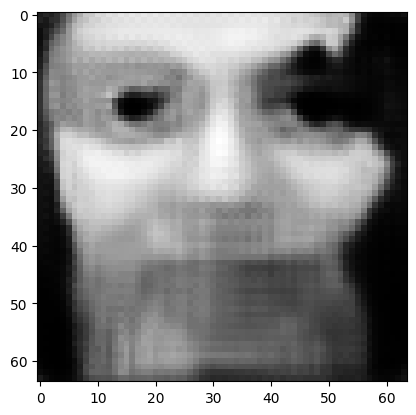

tensor([[4.7358e-04, 8.9572e-05, 9.5895e-03, 9.2899e-05, 1.7660e-06, 2.8405e-06,
         2.4841e-04, 9.4505e-01, 2.3454e-05, 8.7651e-03, 1.6843e-03, 7.5129e-05,
         3.7450e-05, 2.6995e-05, 1.9553e-05, 2.0410e-03, 3.1914e-04, 2.1612e-06,
         1.3663e-03, 1.5803e-04, 5.2081e-04, 1.4093e-03, 1.8321e-06, 2.6087e-03,
         7.4800e-04, 6.8276e-06, 1.2060e-04, 1.0263e-04, 6.0116e-03, 5.0755e-04,
         2.7871e-06, 4.4372e-06, 6.3752e-04, 1.3517e-04, 5.5948e-03, 2.1169e-05,
         7.8462e-04, 4.7506e-03, 5.3652e-03, 6.0158e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05652068555355072
tensor([[4.7342e-04, 8.9529e-05, 9.5836e-03, 9.2835e-05, 1.7645e-06, 2.8392e-06,
         2.4824e-04, 9.4508e-01, 2.3429e-05, 8.7606e-03, 1.6833e-03, 7.5072e-05,
         3.7418e-05, 2.6974e-05, 1.9536e-05, 2.0402e-03, 3.1891e-04, 2.1594e-06,
         1.3656e-03, 1.5791e-04, 5.2036e-04, 1.4084e-03, 1.8303e-06, 2.6072e-03,
         7.4747e-04, 6.8232e-06, 1.2052e-0

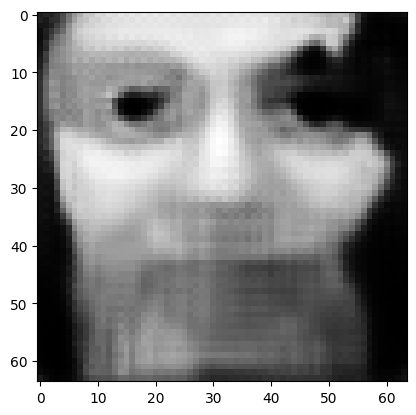

tensor([[4.7284e-04, 8.9364e-05, 9.5605e-03, 9.2584e-05, 1.7588e-06, 2.8341e-06,
         2.4758e-04, 9.4521e-01, 2.3332e-05, 8.7430e-03, 1.6795e-03, 7.4854e-05,
         3.7295e-05, 2.6896e-05, 1.9470e-05, 2.0368e-03, 3.1803e-04, 2.1524e-06,
         1.3628e-03, 1.5747e-04, 5.1857e-04, 1.4048e-03, 1.8232e-06, 2.6014e-03,
         7.4544e-04, 6.8061e-06, 1.2020e-04, 1.0223e-04, 5.9922e-03, 5.0571e-04,
         2.7737e-06, 4.4245e-06, 6.3533e-04, 1.3471e-04, 5.5768e-03, 2.1099e-05,
         7.8199e-04, 4.7352e-03, 5.3475e-03, 5.9942e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05634571239352226
tensor([[4.7270e-04, 8.9324e-05, 9.5550e-03, 9.2523e-05, 1.7574e-06, 2.8329e-06,
         2.4742e-04, 9.4524e-01, 2.3309e-05, 8.7387e-03, 1.6786e-03, 7.4802e-05,
         3.7265e-05, 2.6877e-05, 1.9454e-05, 2.0360e-03, 3.1782e-04, 2.1507e-06,
         1.3622e-03, 1.5737e-04, 5.1814e-04, 1.4039e-03, 1.8215e-06, 2.5999e-03,
         7.4495e-04, 6.8019e-06, 1.2012e-0

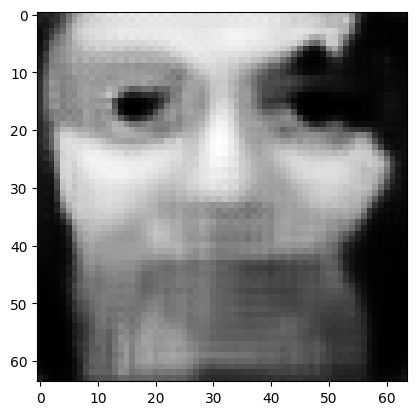

tensor([[4.7214e-04, 8.9168e-05, 9.5332e-03, 9.2286e-05, 1.7520e-06, 2.8281e-06,
         2.4680e-04, 9.4537e-01, 2.3218e-05, 8.7220e-03, 1.6750e-03, 7.4595e-05,
         3.7148e-05, 2.6803e-05, 1.9392e-05, 2.0328e-03, 3.1699e-04, 2.1441e-06,
         1.3596e-03, 1.5695e-04, 5.1645e-04, 1.4005e-03, 1.8148e-06, 2.5944e-03,
         7.4303e-04, 6.7858e-06, 1.1982e-04, 1.0185e-04, 5.9738e-03, 5.0398e-04,
         2.7610e-06, 4.4125e-06, 6.3326e-04, 1.3427e-04, 5.5598e-03, 2.1032e-05,
         7.7950e-04, 4.7207e-03, 5.3308e-03, 5.9739e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05618005990982056
tensor([[4.7201e-04, 8.9131e-05, 9.5279e-03, 9.2229e-05, 1.7507e-06, 2.8269e-06,
         2.4665e-04, 9.4540e-01, 2.3196e-05, 8.7179e-03, 1.6742e-03, 7.4546e-05,
         3.7120e-05, 2.6785e-05, 1.9377e-05, 2.0321e-03, 3.1678e-04, 2.1425e-06,
         1.3589e-03, 1.5685e-04, 5.1605e-04, 1.3996e-03, 1.8132e-06, 2.5931e-03,
         7.4257e-04, 6.7819e-06, 1.1974e-0

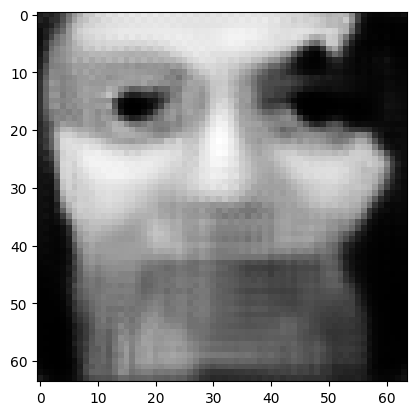

tensor([[4.7148e-04, 8.8984e-05, 9.5074e-03, 9.2006e-05, 1.7455e-06, 2.8224e-06,
         2.4606e-04, 9.4552e-01, 2.3110e-05, 8.7022e-03, 1.6708e-03, 7.4351e-05,
         3.7010e-05, 2.6715e-05, 1.9318e-05, 2.0291e-03, 3.1600e-04, 2.1362e-06,
         1.3565e-03, 1.5646e-04, 5.1446e-04, 1.3964e-03, 1.8069e-06, 2.5879e-03,
         7.4075e-04, 6.7666e-06, 1.1945e-04, 1.0150e-04, 5.9564e-03, 5.0235e-04,
         2.7491e-06, 4.4012e-06, 6.3131e-04, 1.3386e-04, 5.5437e-03, 2.0970e-05,
         7.7716e-04, 4.7070e-03, 5.3150e-03, 5.9546e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056023962795734406
tensor([[4.7136e-04, 8.8948e-05, 9.5024e-03, 9.1951e-05, 1.7443e-06, 2.8213e-06,
         2.4592e-04, 9.4555e-01, 2.3090e-05, 8.6983e-03, 1.6699e-03, 7.4304e-05,
         3.6983e-05, 2.6698e-05, 1.9304e-05, 2.0284e-03, 3.1581e-04, 2.1347e-06,
         1.3559e-03, 1.5636e-04, 5.1408e-04, 1.3956e-03, 1.8054e-06, 2.5866e-03,
         7.4031e-04, 6.7629e-06, 1.1938e-

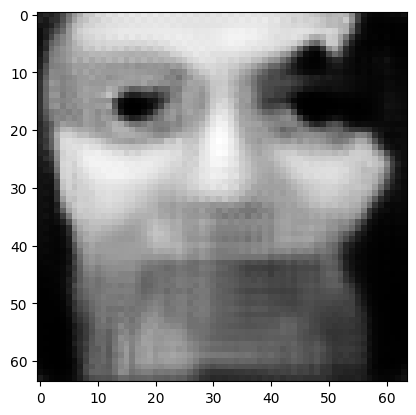

tensor([[4.7086e-04, 8.8809e-05, 9.4830e-03, 9.1740e-05, 1.7395e-06, 2.8170e-06,
         2.4536e-04, 9.4566e-01, 2.3009e-05, 8.6834e-03, 1.6667e-03, 7.4120e-05,
         3.6879e-05, 2.6632e-05, 1.9248e-05, 2.0255e-03, 3.1506e-04, 2.1288e-06,
         1.3536e-03, 1.5599e-04, 5.1258e-04, 1.3925e-03, 1.7995e-06, 2.5817e-03,
         7.3860e-04, 6.7485e-06, 1.1911e-04, 1.0116e-04, 5.9399e-03, 5.0080e-04,
         2.7378e-06, 4.3905e-06, 6.2946e-04, 1.3347e-04, 5.5285e-03, 2.0910e-05,
         7.7494e-04, 4.6941e-03, 5.3001e-03, 5.9364e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05587618425488472
tensor([[4.7074e-04, 8.8774e-05, 9.4782e-03, 9.1689e-05, 1.7383e-06, 2.8160e-06,
         2.4523e-04, 9.4568e-01, 2.2989e-05, 8.6798e-03, 1.6660e-03, 7.4076e-05,
         3.6854e-05, 2.6616e-05, 1.9234e-05, 2.0248e-03, 3.1488e-04, 2.1274e-06,
         1.3530e-03, 1.5590e-04, 5.1221e-04, 1.3918e-03, 1.7980e-06, 2.5805e-03,
         7.3818e-04, 6.7449e-06, 1.1905e-0

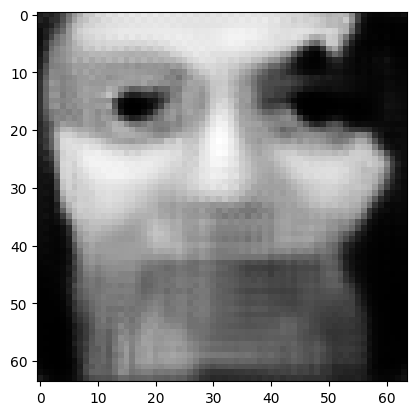

tensor([[4.7027e-04, 8.8643e-05, 9.4598e-03, 9.1489e-05, 1.7337e-06, 2.8119e-06,
         2.4470e-04, 9.4579e-01, 2.2912e-05, 8.6656e-03, 1.6629e-03, 7.3902e-05,
         3.6756e-05, 2.6554e-05, 1.9182e-05, 2.0221e-03, 3.1418e-04, 2.1218e-06,
         1.3508e-03, 1.5555e-04, 5.1079e-04, 1.3889e-03, 1.7924e-06, 2.5758e-03,
         7.3656e-04, 6.7313e-06, 1.1879e-04, 1.0084e-04, 5.9244e-03, 4.9934e-04,
         2.7271e-06, 4.3804e-06, 6.2772e-04, 1.3310e-04, 5.5142e-03, 2.0854e-05,
         7.7284e-04, 4.6819e-03, 5.2859e-03, 5.9193e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05573638901114464
tensor([[4.7016e-04, 8.8611e-05, 9.4554e-03, 9.1440e-05, 1.7326e-06, 2.8109e-06,
         2.4458e-04, 9.4581e-01, 2.2894e-05, 8.6622e-03, 1.6622e-03, 7.3860e-05,
         3.6732e-05, 2.6539e-05, 1.9169e-05, 2.0215e-03, 3.1401e-04, 2.1205e-06,
         1.3503e-03, 1.5546e-04, 5.1045e-04, 1.3882e-03, 1.7910e-06, 2.5747e-03,
         7.3617e-04, 6.7280e-06, 1.1873e-0

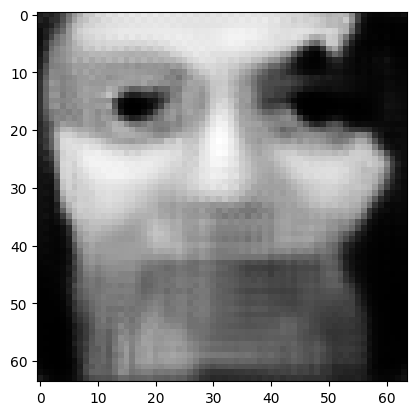

tensor([[4.6971e-04, 8.8486e-05, 9.4380e-03, 9.1251e-05, 1.7283e-06, 2.8071e-06,
         2.4408e-04, 9.4591e-01, 2.2822e-05, 8.6488e-03, 1.6593e-03, 7.3696e-05,
         3.6639e-05, 2.6480e-05, 1.9120e-05, 2.0189e-03, 3.1334e-04, 2.1152e-06,
         1.3482e-03, 1.5513e-04, 5.0911e-04, 1.3854e-03, 1.7857e-06, 2.5703e-03,
         7.3463e-04, 6.7151e-06, 1.1848e-04, 1.0053e-04, 5.9097e-03, 4.9796e-04,
         2.7170e-06, 4.3709e-06, 6.2607e-04, 1.3275e-04, 5.5006e-03, 2.0801e-05,
         7.7086e-04, 4.6703e-03, 5.2725e-03, 5.9030e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0556042417883873
tensor([[4.6960e-04, 8.8456e-05, 9.4338e-03, 9.1205e-05, 1.7272e-06, 2.8062e-06,
         2.4396e-04, 9.4594e-01, 2.2804e-05, 8.6455e-03, 1.6586e-03, 7.3656e-05,
         3.6617e-05, 2.6466e-05, 1.9107e-05, 2.0183e-03, 3.1318e-04, 2.1139e-06,
         1.3477e-03, 1.5505e-04, 5.0879e-04, 1.3848e-03, 1.7844e-06, 2.5692e-03,
         7.3426e-04, 6.7119e-06, 1.1843e-04

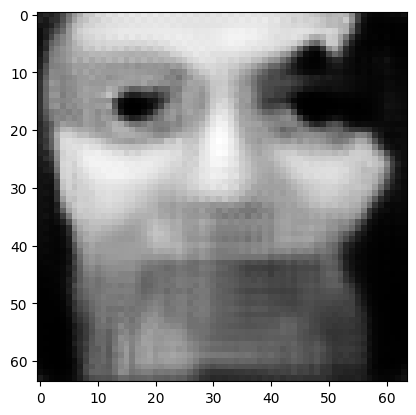

tensor([[4.6918e-04, 8.8337e-05, 9.4173e-03, 9.1027e-05, 1.7232e-06, 2.8025e-06,
         2.4349e-04, 9.4603e-01, 2.2736e-05, 8.6328e-03, 1.6559e-03, 7.3500e-05,
         3.6529e-05, 2.6410e-05, 1.9061e-05, 2.0159e-03, 3.1255e-04, 2.1089e-06,
         1.3457e-03, 1.5474e-04, 5.0752e-04, 1.3822e-03, 1.7794e-06, 2.5651e-03,
         7.3281e-04, 6.6997e-06, 1.1820e-04, 1.0025e-04, 5.8958e-03, 4.9665e-04,
         2.7075e-06, 4.3618e-06, 6.2451e-04, 1.3242e-04, 5.4877e-03, 2.0751e-05,
         7.6899e-04, 4.6594e-03, 5.2599e-03, 5.8876e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055479180067777634
tensor([[4.6908e-04, 8.8309e-05, 9.4133e-03, 9.0983e-05, 1.7222e-06, 2.8016e-06,
         2.4337e-04, 9.4605e-01, 2.2719e-05, 8.6298e-03, 1.6552e-03, 7.3463e-05,
         3.6508e-05, 2.6396e-05, 1.9049e-05, 2.0153e-03, 3.1240e-04, 2.1077e-06,
         1.3453e-03, 1.5466e-04, 5.0721e-04, 1.3815e-03, 1.7782e-06, 2.5640e-03,
         7.3246e-04, 6.6967e-06, 1.1814e-

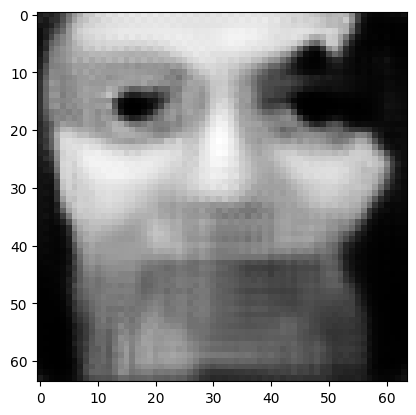

tensor([[4.6868e-04, 8.8197e-05, 9.3977e-03, 9.0813e-05, 1.7183e-06, 2.7982e-06,
         2.4293e-04, 9.4614e-01, 2.2655e-05, 8.6177e-03, 1.6527e-03, 7.3316e-05,
         3.6425e-05, 2.6343e-05, 1.9005e-05, 2.0130e-03, 3.1181e-04, 2.1030e-06,
         1.3434e-03, 1.5436e-04, 5.0601e-04, 1.3791e-03, 1.7735e-06, 2.5601e-03,
         7.3109e-04, 6.6852e-06, 1.1792e-04, 9.9978e-05, 5.8826e-03, 4.9541e-04,
         2.6985e-06, 4.3532e-06, 6.2303e-04, 1.3211e-04, 5.4755e-03, 2.0704e-05,
         7.6721e-04, 4.6490e-03, 5.2479e-03, 5.8731e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055360645055770874
tensor([[4.6858e-04, 8.8169e-05, 9.3939e-03, 9.0772e-05, 1.7174e-06, 2.7973e-06,
         2.4282e-04, 9.4617e-01, 2.2639e-05, 8.6148e-03, 1.6520e-03, 7.3280e-05,
         3.6404e-05, 2.6330e-05, 1.8994e-05, 2.0125e-03, 3.1166e-04, 2.1019e-06,
         1.3429e-03, 1.5429e-04, 5.0572e-04, 1.3785e-03, 1.7723e-06, 2.5591e-03,
         7.3075e-04, 6.6823e-06, 1.1787e-

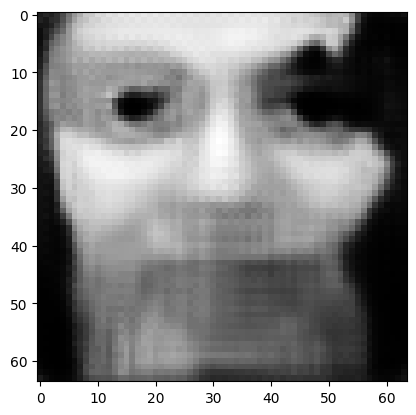

tensor([[4.6820e-04, 8.8063e-05, 9.3791e-03, 9.0612e-05, 1.7137e-06, 2.7941e-06,
         2.4240e-04, 9.4625e-01, 2.2578e-05, 8.6034e-03, 1.6496e-03, 7.3141e-05,
         3.6326e-05, 2.6280e-05, 1.8952e-05, 2.0103e-03, 3.1110e-04, 2.0974e-06,
         1.3412e-03, 1.5401e-04, 5.0458e-04, 1.3762e-03, 1.7678e-06, 2.5554e-03,
         7.2945e-04, 6.6714e-06, 1.1766e-04, 9.9722e-05, 5.8701e-03, 4.9424e-04,
         2.6900e-06, 4.3451e-06, 6.2163e-04, 1.3181e-04, 5.4640e-03, 2.0659e-05,
         7.6553e-04, 4.6392e-03, 5.2366e-03, 5.8593e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05524841323494911
tensor([[4.6812e-04, 8.8038e-05, 9.3755e-03, 9.0572e-05, 1.7128e-06, 2.7933e-06,
         2.4230e-04, 9.4627e-01, 2.2563e-05, 8.6007e-03, 1.6490e-03, 7.3107e-05,
         3.6307e-05, 2.6268e-05, 1.8942e-05, 2.0098e-03, 3.1096e-04, 2.0964e-06,
         1.3407e-03, 1.5394e-04, 5.0431e-04, 1.3756e-03, 1.7667e-06, 2.5545e-03,
         7.2914e-04, 6.6687e-06, 1.1761e-0

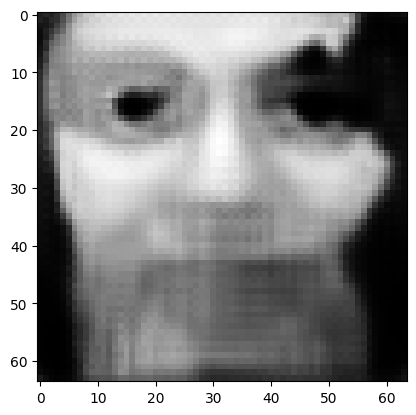

tensor([[4.6775e-04, 8.7937e-05, 9.3615e-03, 9.0421e-05, 1.7094e-06, 2.7902e-06,
         2.4190e-04, 9.4635e-01, 2.2506e-05, 8.5899e-03, 1.6467e-03, 7.2976e-05,
         3.6232e-05, 2.6221e-05, 1.8902e-05, 2.0077e-03, 3.1043e-04, 2.0921e-06,
         1.3391e-03, 1.5368e-04, 5.0324e-04, 1.3734e-03, 1.7625e-06, 2.5509e-03,
         7.2791e-04, 6.6584e-06, 1.1742e-04, 9.9480e-05, 5.8583e-03, 4.9313e-04,
         2.6820e-06, 4.3375e-06, 6.2031e-04, 1.3154e-04, 5.4531e-03, 2.0616e-05,
         7.6394e-04, 4.6300e-03, 5.2258e-03, 5.8462e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05514237657189369
tensor([[4.6767e-04, 8.7912e-05, 9.3581e-03, 9.0384e-05, 1.7085e-06, 2.7894e-06,
         2.4180e-04, 9.4637e-01, 2.2492e-05, 8.5873e-03, 1.6461e-03, 7.2943e-05,
         3.6214e-05, 2.6209e-05, 1.8892e-05, 2.0072e-03, 3.1030e-04, 2.0911e-06,
         1.3387e-03, 1.5361e-04, 5.0297e-04, 1.3729e-03, 1.7615e-06, 2.5501e-03,
         7.2761e-04, 6.6558e-06, 1.1737e-0

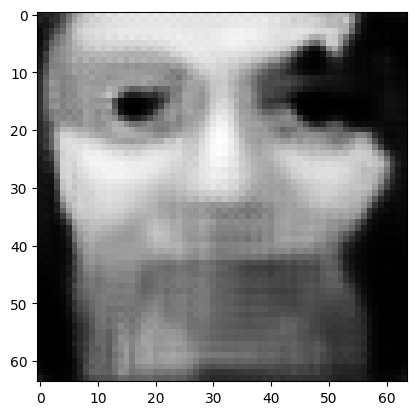

tensor([[4.6733e-04, 8.7817e-05, 9.3448e-03, 9.0240e-05, 1.7052e-06, 2.7865e-06,
         2.4142e-04, 9.4645e-01, 2.2437e-05, 8.5771e-03, 1.6440e-03, 7.2819e-05,
         3.6144e-05, 2.6165e-05, 1.8855e-05, 2.0053e-03, 3.0979e-04, 2.0871e-06,
         1.3371e-03, 1.5336e-04, 5.0196e-04, 1.3708e-03, 1.7575e-06, 2.5467e-03,
         7.2644e-04, 6.6460e-06, 1.1719e-04, 9.9251e-05, 5.8471e-03, 4.9208e-04,
         2.6743e-06, 4.3302e-06, 6.1905e-04, 1.3127e-04, 5.4428e-03, 2.0576e-05,
         7.6243e-04, 4.6212e-03, 5.2157e-03, 5.8338e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055041853338479996
tensor([[4.6724e-04, 8.7794e-05, 9.3416e-03, 9.0205e-05, 1.7045e-06, 2.7858e-06,
         2.4133e-04, 9.4646e-01, 2.2424e-05, 8.5746e-03, 1.6434e-03, 7.2789e-05,
         3.6127e-05, 2.6154e-05, 1.8846e-05, 2.0048e-03, 3.0967e-04, 2.0862e-06,
         1.3367e-03, 1.5330e-04, 5.0171e-04, 1.3703e-03, 1.7565e-06, 2.5459e-03,
         7.2616e-04, 6.6436e-06, 1.1714e-

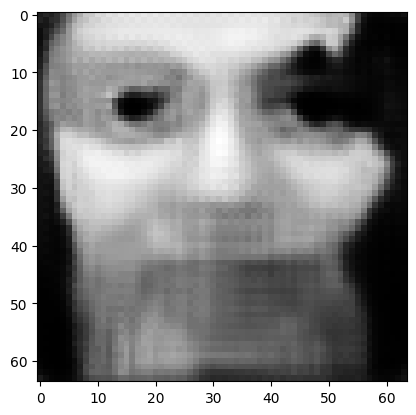

tensor([[4.6692e-04, 8.7704e-05, 9.3290e-03, 9.0069e-05, 1.7014e-06, 2.7830e-06,
         2.4097e-04, 9.4654e-01, 2.2372e-05, 8.5649e-03, 1.6414e-03, 7.2671e-05,
         3.6060e-05, 2.6111e-05, 1.8810e-05, 2.0030e-03, 3.0919e-04, 2.0824e-06,
         1.3352e-03, 1.5306e-04, 5.0075e-04, 1.3683e-03, 1.7527e-06, 2.5427e-03,
         7.2506e-04, 6.6343e-06, 1.1697e-04, 9.9033e-05, 5.8365e-03, 4.9109e-04,
         2.6671e-06, 4.3233e-06, 6.1786e-04, 1.3102e-04, 5.4330e-03, 2.0538e-05,
         7.6100e-04, 4.6129e-03, 5.2061e-03, 5.8222e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05494651198387146
tensor([[4.6684e-04, 8.7682e-05, 9.3259e-03, 9.0036e-05, 1.7006e-06, 2.7823e-06,
         2.4089e-04, 9.4655e-01, 2.2360e-05, 8.5626e-03, 1.6408e-03, 7.2642e-05,
         3.6044e-05, 2.6101e-05, 1.8801e-05, 2.0025e-03, 3.0908e-04, 2.0815e-06,
         1.3348e-03, 1.5300e-04, 5.0052e-04, 1.3678e-03, 1.7518e-06, 2.5419e-03,
         7.2479e-04, 6.6321e-06, 1.1692e-0

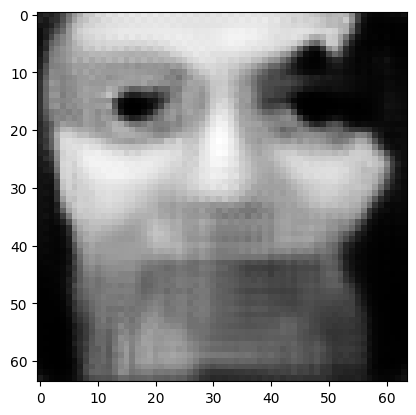

tensor([[4.6654e-04, 8.7597e-05, 9.3140e-03, 8.9907e-05, 1.6977e-06, 2.7797e-06,
         2.4055e-04, 9.4662e-01, 2.2311e-05, 8.5534e-03, 1.6389e-03, 7.2531e-05,
         3.5981e-05, 2.6061e-05, 1.8768e-05, 2.0008e-03, 3.0862e-04, 2.0779e-06,
         1.3334e-03, 1.5277e-04, 4.9961e-04, 1.3659e-03, 1.7482e-06, 2.5389e-03,
         7.2375e-04, 6.6232e-06, 1.1676e-04, 9.8827e-05, 5.8265e-03, 4.9015e-04,
         2.6603e-06, 4.3168e-06, 6.1674e-04, 1.3078e-04, 5.4237e-03, 2.0501e-05,
         7.5965e-04, 4.6050e-03, 5.1969e-03, 5.8111e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05485623702406883
tensor([[4.6646e-04, 8.7576e-05, 9.3111e-03, 8.9875e-05, 1.6969e-06, 2.7791e-06,
         2.4047e-04, 9.4664e-01, 2.2299e-05, 8.5511e-03, 1.6384e-03, 7.2503e-05,
         3.5965e-05, 2.6051e-05, 1.8759e-05, 2.0003e-03, 3.0851e-04, 2.0770e-06,
         1.3331e-03, 1.5272e-04, 4.9938e-04, 1.3655e-03, 1.7473e-06, 2.5382e-03,
         7.2349e-04, 6.6211e-06, 1.1672e-0

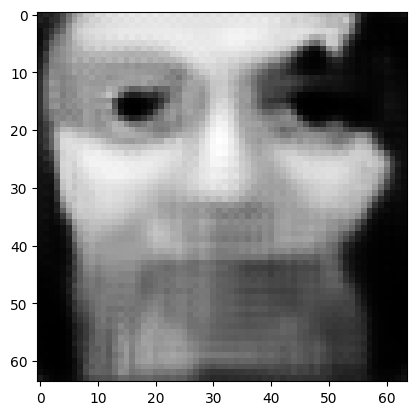

tensor([[4.6618e-04, 8.7494e-05, 9.2998e-03, 8.9752e-05, 1.6942e-06, 2.7766e-06,
         2.4015e-04, 9.4670e-01, 2.2253e-05, 8.5424e-03, 1.6365e-03, 7.2397e-05,
         3.5905e-05, 2.6013e-05, 1.8727e-05, 1.9987e-03, 3.0808e-04, 2.0737e-06,
         1.3317e-03, 1.5250e-04, 4.9852e-04, 1.3637e-03, 1.7439e-06, 2.5353e-03,
         7.2251e-04, 6.6127e-06, 1.1656e-04, 9.8632e-05, 5.8169e-03, 4.8926e-04,
         2.6539e-06, 4.3105e-06, 6.1567e-04, 1.3055e-04, 5.4149e-03, 2.0467e-05,
         7.5836e-04, 4.5975e-03, 5.1883e-03, 5.8006e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054770585149526596
tensor([[4.6611e-04, 8.7475e-05, 9.2970e-03, 8.9722e-05, 1.6935e-06, 2.7760e-06,
         2.4007e-04, 9.4672e-01, 2.2241e-05, 8.5403e-03, 1.6361e-03, 7.2371e-05,
         3.5891e-05, 2.6004e-05, 1.8720e-05, 1.9983e-03, 3.0798e-04, 2.0728e-06,
         1.3314e-03, 1.5245e-04, 4.9831e-04, 1.3633e-03, 1.7430e-06, 2.5346e-03,
         7.2227e-04, 6.6107e-06, 1.1652e-

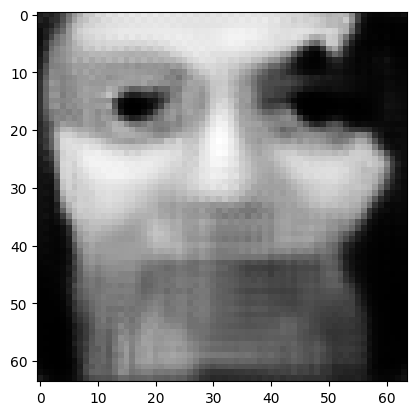

tensor([[4.6583e-04, 8.7398e-05, 9.2863e-03, 8.9607e-05, 1.6909e-06, 2.7736e-06,
         2.3976e-04, 9.4678e-01, 2.2197e-05, 8.5321e-03, 1.6343e-03, 7.2271e-05,
         3.5834e-05, 2.5968e-05, 1.8689e-05, 1.9967e-03, 3.0757e-04, 2.0696e-06,
         1.3301e-03, 1.5225e-04, 4.9749e-04, 1.3616e-03, 1.7398e-06, 2.5319e-03,
         7.2133e-04, 6.6027e-06, 1.1637e-04, 9.8447e-05, 5.8079e-03, 4.8841e-04,
         2.6477e-06, 4.3047e-06, 6.1466e-04, 1.3034e-04, 5.4066e-03, 2.0435e-05,
         7.5715e-04, 4.5904e-03, 5.1801e-03, 5.7906e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0546894371509552
tensor([[4.6576e-04, 8.7379e-05, 9.2837e-03, 8.9579e-05, 1.6902e-06, 2.7730e-06,
         2.3969e-04, 9.4679e-01, 2.2187e-05, 8.5301e-03, 1.6339e-03, 7.2247e-05,
         3.5820e-05, 2.5959e-05, 1.8682e-05, 1.9963e-03, 3.0747e-04, 2.0688e-06,
         1.3298e-03, 1.5220e-04, 4.9729e-04, 1.3612e-03, 1.7390e-06, 2.5313e-03,
         7.2110e-04, 6.6008e-06, 1.1634e-04

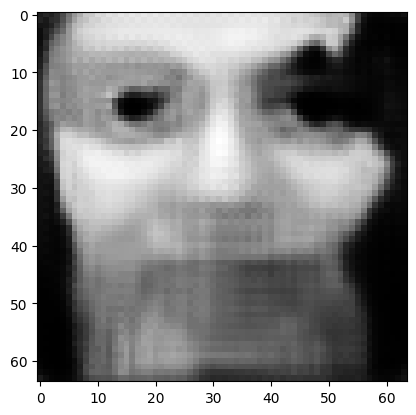

tensor([[4.6551e-04, 8.7306e-05, 9.2736e-03, 8.9469e-05, 1.6877e-06, 2.7708e-06,
         2.3940e-04, 9.4685e-01, 2.2145e-05, 8.5222e-03, 1.6322e-03, 7.2152e-05,
         3.5767e-05, 2.5925e-05, 1.8653e-05, 1.9948e-03, 3.0709e-04, 2.0658e-06,
         1.3286e-03, 1.5200e-04, 4.9652e-04, 1.3596e-03, 1.7360e-06, 2.5287e-03,
         7.2022e-04, 6.5933e-06, 1.1620e-04, 9.8272e-05, 5.7994e-03, 4.8761e-04,
         2.6420e-06, 4.2991e-06, 6.1371e-04, 1.3014e-04, 5.3987e-03, 2.0404e-05,
         7.5599e-04, 4.5837e-03, 5.1723e-03, 5.7813e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054612912237644196
tensor([[4.6544e-04, 8.7288e-05, 9.2712e-03, 8.9443e-05, 1.6871e-06, 2.7703e-06,
         2.3933e-04, 9.4687e-01, 2.2136e-05, 8.5203e-03, 1.6318e-03, 7.2130e-05,
         3.5754e-05, 2.5917e-05, 1.8647e-05, 1.9945e-03, 3.0700e-04, 2.0651e-06,
         1.3283e-03, 1.5196e-04, 4.9634e-04, 1.3592e-03, 1.7353e-06, 2.5281e-03,
         7.2000e-04, 6.5915e-06, 1.1616e-

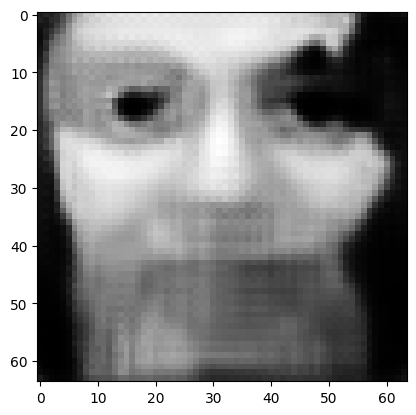

tensor([[4.6520e-04, 8.7221e-05, 9.2617e-03, 8.9343e-05, 1.6848e-06, 2.7683e-06,
         2.3906e-04, 9.4692e-01, 2.2097e-05, 8.5128e-03, 1.6302e-03, 7.2043e-05,
         3.5706e-05, 2.5886e-05, 1.8620e-05, 1.9931e-03, 3.0664e-04, 2.0624e-06,
         1.3272e-03, 1.5178e-04, 4.9562e-04, 1.3577e-03, 1.7325e-06, 2.5257e-03,
         7.1918e-04, 6.5845e-06, 1.1603e-04, 9.8107e-05, 5.7914e-03, 4.8687e-04,
         2.6366e-06, 4.2941e-06, 6.1282e-04, 1.2995e-04, 5.3913e-03, 2.0375e-05,
         7.5492e-04, 4.5777e-03, 5.1651e-03, 5.7725e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05454123392701149
tensor([[4.6515e-04, 8.7205e-05, 9.2595e-03, 8.9319e-05, 1.6843e-06, 2.7678e-06,
         2.3900e-04, 9.4693e-01, 2.2088e-05, 8.5110e-03, 1.6299e-03, 7.2022e-05,
         3.5694e-05, 2.5878e-05, 1.8614e-05, 1.9928e-03, 3.0656e-04, 2.0617e-06,
         1.3269e-03, 1.5173e-04, 4.9545e-04, 1.3573e-03, 1.7318e-06, 2.5251e-03,
         7.1899e-04, 6.5828e-06, 1.1600e-0

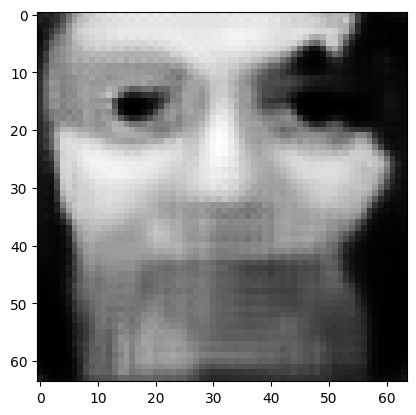

tensor([[4.6491e-04, 8.7140e-05, 9.2505e-03, 8.9224e-05, 1.6821e-06, 2.7659e-06,
         2.3874e-04, 9.4698e-01, 2.2051e-05, 8.5039e-03, 1.6284e-03, 7.1938e-05,
         3.5647e-05, 2.5849e-05, 1.8589e-05, 1.9915e-03, 3.0622e-04, 2.0591e-06,
         1.3258e-03, 1.5156e-04, 4.9477e-04, 1.3559e-03, 1.7291e-06, 2.5228e-03,
         7.1820e-04, 6.5762e-06, 1.1588e-04, 9.7950e-05, 5.7838e-03, 4.8616e-04,
         2.6315e-06, 4.2893e-06, 6.1199e-04, 1.2977e-04, 5.3843e-03, 2.0348e-05,
         7.5390e-04, 4.5719e-03, 5.1583e-03, 5.7642e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05447305366396904
tensor([[4.6485e-04, 8.7124e-05, 9.2483e-03, 8.9200e-05, 1.6816e-06, 2.7655e-06,
         2.3868e-04, 9.4700e-01, 2.2043e-05, 8.5021e-03, 1.6280e-03, 7.1918e-05,
         3.5636e-05, 2.5842e-05, 1.8583e-05, 1.9912e-03, 3.0613e-04, 2.0584e-06,
         1.3255e-03, 1.5152e-04, 4.9460e-04, 1.3556e-03, 1.7285e-06, 2.5223e-03,
         7.1801e-04, 6.5746e-06, 1.1584e-0

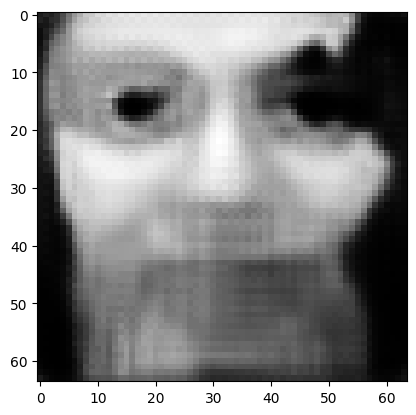

tensor([[4.6463e-04, 8.7063e-05, 9.2397e-03, 8.9110e-05, 1.6795e-06, 2.7636e-06,
         2.3843e-04, 9.4705e-01, 2.2008e-05, 8.4953e-03, 1.6266e-03, 7.1839e-05,
         3.5592e-05, 2.5814e-05, 1.8559e-05, 1.9899e-03, 3.0581e-04, 2.0559e-06,
         1.3245e-03, 1.5135e-04, 4.9396e-04, 1.3542e-03, 1.7260e-06, 2.5201e-03,
         7.1726e-04, 6.5683e-06, 1.1573e-04, 9.7800e-05, 5.7765e-03, 4.8549e-04,
         2.6266e-06, 4.2847e-06, 6.1119e-04, 1.2960e-04, 5.3776e-03, 2.0322e-05,
         7.5293e-04, 4.5663e-03, 5.1519e-03, 5.7562e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054408252239227295
tensor([[4.6457e-04, 8.7047e-05, 9.2376e-03, 8.9088e-05, 1.6790e-06, 2.7632e-06,
         2.3837e-04, 9.4706e-01, 2.2000e-05, 8.4936e-03, 1.6262e-03, 7.1819e-05,
         3.5581e-05, 2.5807e-05, 1.8553e-05, 1.9896e-03, 3.0573e-04, 2.0553e-06,
         1.3242e-03, 1.5131e-04, 4.9380e-04, 1.3539e-03, 1.7253e-06, 2.5196e-03,
         7.1708e-04, 6.5667e-06, 1.1570e-

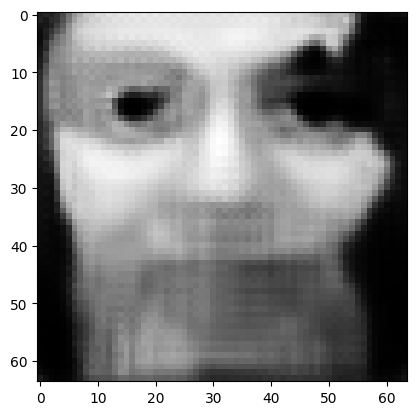

tensor([[4.6436e-04, 8.6989e-05, 9.2295e-03, 8.9002e-05, 1.6770e-06, 2.7615e-06,
         2.3814e-04, 9.4710e-01, 2.1967e-05, 8.4871e-03, 1.6249e-03, 7.1744e-05,
         3.5539e-05, 2.5780e-05, 1.8530e-05, 1.9885e-03, 3.0543e-04, 2.0529e-06,
         1.3232e-03, 1.5116e-04, 4.9318e-04, 1.3526e-03, 1.7229e-06, 2.5175e-03,
         7.1637e-04, 6.5607e-06, 1.1558e-04, 9.7658e-05, 5.7696e-03, 4.8485e-04,
         2.6220e-06, 4.2803e-06, 6.1043e-04, 1.2944e-04, 5.3713e-03, 2.0297e-05,
         7.5200e-04, 4.5611e-03, 5.1458e-03, 5.7486e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05434638261795044
tensor([[4.6431e-04, 8.6975e-05, 9.2275e-03, 8.8981e-05, 1.6765e-06, 2.7611e-06,
         2.3808e-04, 9.4712e-01, 2.1959e-05, 8.4856e-03, 1.6246e-03, 7.1725e-05,
         3.5529e-05, 2.5774e-05, 1.8525e-05, 1.9882e-03, 3.0535e-04, 2.0524e-06,
         1.3230e-03, 1.5112e-04, 4.9303e-04, 1.3523e-03, 1.7223e-06, 2.5170e-03,
         7.1619e-04, 6.5592e-06, 1.1556e-0

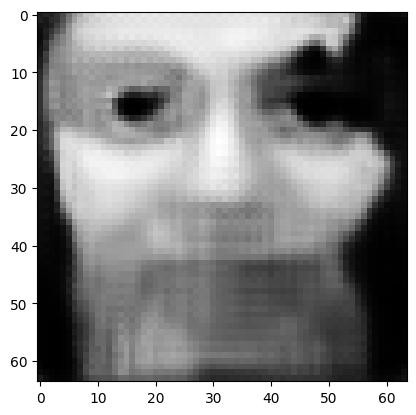

tensor([[4.6411e-04, 8.6919e-05, 9.2198e-03, 8.8899e-05, 1.6746e-06, 2.7594e-06,
         2.3786e-04, 9.4716e-01, 2.1927e-05, 8.4794e-03, 1.6233e-03, 7.1654e-05,
         3.5489e-05, 2.5748e-05, 1.8504e-05, 1.9871e-03, 3.0506e-04, 2.0501e-06,
         1.3221e-03, 1.5097e-04, 4.9245e-04, 1.3511e-03, 1.7201e-06, 2.5151e-03,
         7.1552e-04, 6.5535e-06, 1.1545e-04, 9.7524e-05, 5.7631e-03, 4.8424e-04,
         2.6176e-06, 4.2762e-06, 6.0971e-04, 1.2929e-04, 5.3652e-03, 2.0273e-05,
         7.5112e-04, 4.5561e-03, 5.1399e-03, 5.7415e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054287783801555634
tensor([[4.6406e-04, 8.6905e-05, 9.2179e-03, 8.8879e-05, 1.6742e-06, 2.7590e-06,
         2.3781e-04, 9.4717e-01, 2.1920e-05, 8.4779e-03, 1.6230e-03, 7.1637e-05,
         3.5480e-05, 2.5742e-05, 1.8498e-05, 1.9868e-03, 3.0499e-04, 2.0496e-06,
         1.3218e-03, 1.5093e-04, 4.9231e-04, 1.3508e-03, 1.7195e-06, 2.5146e-03,
         7.1536e-04, 6.5522e-06, 1.1542e-

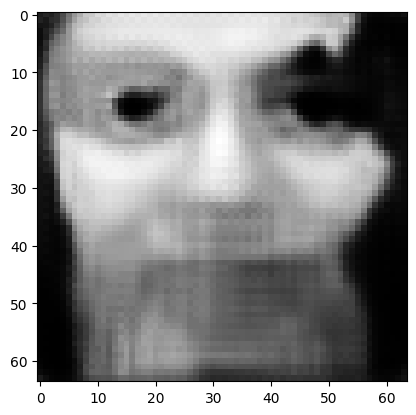

tensor([[4.6387e-04, 8.6853e-05, 9.2105e-03, 8.8802e-05, 1.6724e-06, 2.7575e-06,
         2.3760e-04, 9.4721e-01, 2.1890e-05, 8.4721e-03, 1.6218e-03, 7.1569e-05,
         3.5442e-05, 2.5718e-05, 1.8478e-05, 1.9857e-03, 3.0472e-04, 2.0474e-06,
         1.3209e-03, 1.5079e-04, 4.9176e-04, 1.3496e-03, 1.7173e-06, 2.5127e-03,
         7.1472e-04, 6.5468e-06, 1.1532e-04, 9.7396e-05, 5.7569e-03, 4.8366e-04,
         2.6134e-06, 4.2723e-06, 6.0903e-04, 1.2915e-04, 5.3595e-03, 2.0251e-05,
         7.5029e-04, 4.5514e-03, 5.1344e-03, 5.7347e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05423245579004288
tensor([[4.6382e-04, 8.6840e-05, 9.2088e-03, 8.8783e-05, 1.6720e-06, 2.7571e-06,
         2.3755e-04, 9.4722e-01, 2.1883e-05, 8.4707e-03, 1.6215e-03, 7.1552e-05,
         3.5433e-05, 2.5712e-05, 1.8473e-05, 1.9855e-03, 3.0465e-04, 2.0469e-06,
         1.3207e-03, 1.5076e-04, 4.9162e-04, 1.3493e-03, 1.7168e-06, 2.5123e-03,
         7.1456e-04, 6.5454e-06, 1.1530e-0

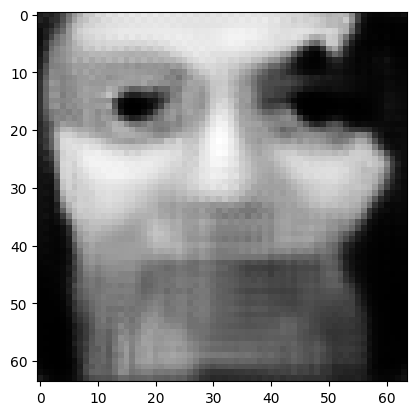

tensor([[4.6364e-04, 8.6790e-05, 9.2018e-03, 8.8710e-05, 1.6703e-06, 2.7556e-06,
         2.3735e-04, 9.4726e-01, 2.1855e-05, 8.4651e-03, 1.6203e-03, 7.1488e-05,
         3.5397e-05, 2.5690e-05, 1.8454e-05, 1.9845e-03, 3.0439e-04, 2.0449e-06,
         1.3199e-03, 1.5063e-04, 4.9110e-04, 1.3482e-03, 1.7148e-06, 2.5105e-03,
         7.1396e-04, 6.5403e-06, 1.1520e-04, 9.7275e-05, 5.7510e-03, 4.8312e-04,
         2.6095e-06, 4.2686e-06, 6.0838e-04, 1.2901e-04, 5.3541e-03, 2.0230e-05,
         7.4950e-04, 4.5469e-03, 5.1292e-03, 5.7282e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05417949706315994
tensor([[4.6360e-04, 8.6777e-05, 9.2001e-03, 8.8692e-05, 1.6699e-06, 2.7553e-06,
         2.3730e-04, 9.4727e-01, 2.1848e-05, 8.4638e-03, 1.6200e-03, 7.1473e-05,
         3.5388e-05, 2.5684e-05, 1.8449e-05, 1.9842e-03, 3.0433e-04, 2.0444e-06,
         1.3197e-03, 1.5060e-04, 4.9097e-04, 1.3480e-03, 1.7143e-06, 2.5101e-03,
         7.1381e-04, 6.5391e-06, 1.1518e-0

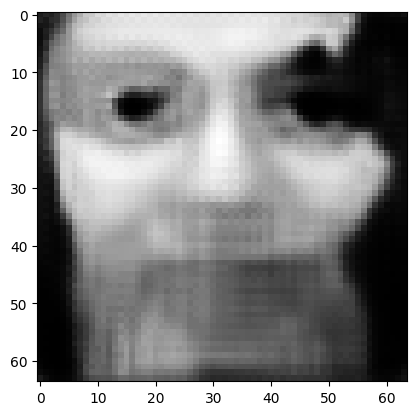

tensor([[4.6342e-04, 8.6730e-05, 9.1935e-03, 8.8622e-05, 1.6683e-06, 2.7539e-06,
         2.3711e-04, 9.4731e-01, 2.1822e-05, 8.4585e-03, 1.6189e-03, 7.1412e-05,
         3.5354e-05, 2.5662e-05, 1.8431e-05, 1.9833e-03, 3.0408e-04, 2.0425e-06,
         1.3189e-03, 1.5047e-04, 4.9048e-04, 1.3469e-03, 1.7123e-06, 2.5084e-03,
         7.1323e-04, 6.5342e-06, 1.1509e-04, 9.7160e-05, 5.7454e-03, 4.8260e-04,
         2.6058e-06, 4.2650e-06, 6.0777e-04, 1.2888e-04, 5.3490e-03, 2.0210e-05,
         7.4875e-04, 4.5426e-03, 5.1243e-03, 5.7221e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05412980914115906
tensor([[4.6338e-04, 8.6718e-05, 9.1919e-03, 8.8605e-05, 1.6679e-06, 2.7535e-06,
         2.3707e-04, 9.4732e-01, 2.1815e-05, 8.4572e-03, 1.6187e-03, 7.1397e-05,
         3.5346e-05, 2.5657e-05, 1.8426e-05, 1.9830e-03, 3.0402e-04, 2.0420e-06,
         1.3187e-03, 1.5044e-04, 4.9036e-04, 1.3467e-03, 1.7118e-06, 2.5080e-03,
         7.1309e-04, 6.5330e-06, 1.1506e-0

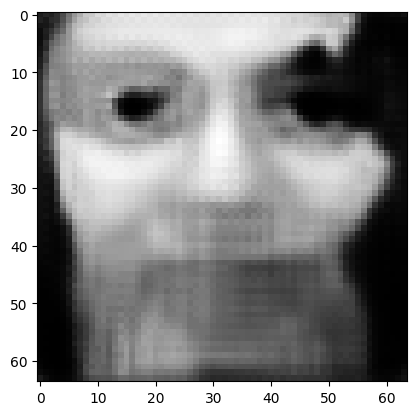

tensor([[4.6322e-04, 8.6673e-05, 9.1857e-03, 8.8539e-05, 1.6664e-06, 2.7522e-06,
         2.3689e-04, 9.4735e-01, 2.1790e-05, 8.4523e-03, 1.6176e-03, 7.1339e-05,
         3.5314e-05, 2.5637e-05, 1.8409e-05, 1.9821e-03, 3.0378e-04, 2.0402e-06,
         1.3179e-03, 1.5032e-04, 4.8989e-04, 1.3457e-03, 1.7100e-06, 2.5064e-03,
         7.1255e-04, 6.5284e-06, 1.1498e-04, 9.7052e-05, 5.7401e-03, 4.8211e-04,
         2.6022e-06, 4.2617e-06, 6.0719e-04, 1.2875e-04, 5.3441e-03, 2.0191e-05,
         7.4805e-04, 4.5386e-03, 5.1196e-03, 5.7163e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054082490503787994
tensor([[4.6318e-04, 8.6662e-05, 9.1842e-03, 8.8523e-05, 1.6660e-06, 2.7519e-06,
         2.3684e-04, 9.4736e-01, 2.1784e-05, 8.4511e-03, 1.6174e-03, 7.1325e-05,
         3.5306e-05, 2.5632e-05, 1.8405e-05, 1.9819e-03, 3.0373e-04, 2.0397e-06,
         1.3177e-03, 1.5029e-04, 4.8977e-04, 1.3455e-03, 1.7096e-06, 2.5060e-03,
         7.1242e-04, 6.5273e-06, 1.1496e-

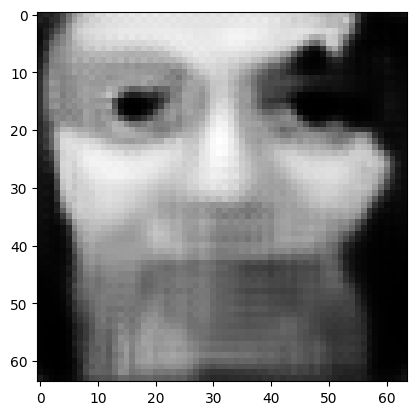

tensor([[4.6302e-04, 8.6619e-05, 9.1782e-03, 8.8460e-05, 1.6646e-06, 2.7506e-06,
         2.3667e-04, 9.4740e-01, 2.1760e-05, 8.4464e-03, 1.6164e-03, 7.1270e-05,
         3.5276e-05, 2.5612e-05, 1.8389e-05, 1.9810e-03, 3.0350e-04, 2.0380e-06,
         1.3170e-03, 1.5018e-04, 4.8933e-04, 1.3445e-03, 1.7078e-06, 2.5045e-03,
         7.1190e-04, 6.5229e-06, 1.1487e-04, 9.6948e-05, 5.7351e-03, 4.8164e-04,
         2.5989e-06, 4.2585e-06, 6.0664e-04, 1.2864e-04, 5.3395e-03, 2.0173e-05,
         7.4737e-04, 4.5348e-03, 5.1151e-03, 5.7108e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054037656635046005
tensor([[4.6298e-04, 8.6608e-05, 9.1768e-03, 8.8445e-05, 1.6642e-06, 2.7503e-06,
         2.3663e-04, 9.4740e-01, 2.1754e-05, 8.4452e-03, 1.6162e-03, 7.1257e-05,
         3.5268e-05, 2.5608e-05, 1.8385e-05, 1.9808e-03, 3.0345e-04, 2.0376e-06,
         1.3168e-03, 1.5015e-04, 4.8922e-04, 1.3443e-03, 1.7074e-06, 2.5042e-03,
         7.1177e-04, 6.5219e-06, 1.1485e-

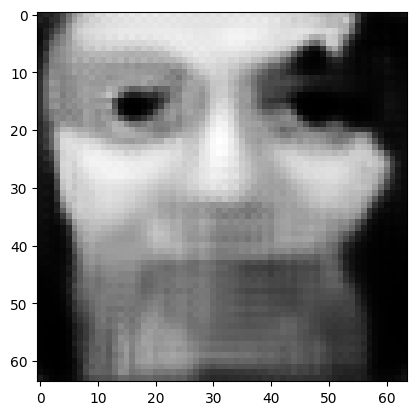

tensor([[4.6284e-04, 8.6568e-05, 9.1712e-03, 8.8386e-05, 1.6629e-06, 2.7492e-06,
         2.3647e-04, 9.4744e-01, 2.1732e-05, 8.4408e-03, 1.6152e-03, 7.1205e-05,
         3.5240e-05, 2.5589e-05, 1.8369e-05, 1.9800e-03, 3.0324e-04, 2.0360e-06,
         1.3161e-03, 1.5004e-04, 4.8880e-04, 1.3434e-03, 1.7058e-06, 2.5027e-03,
         7.1129e-04, 6.5178e-06, 1.1478e-04, 9.6851e-05, 5.7303e-03, 4.8120e-04,
         2.5957e-06, 4.2555e-06, 6.0612e-04, 1.2853e-04, 5.3351e-03, 2.0156e-05,
         7.4674e-04, 4.5311e-03, 5.1109e-03, 5.7056e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05399496480822563
tensor([[4.6280e-04, 8.6558e-05, 9.1698e-03, 8.8371e-05, 1.6625e-06, 2.7489e-06,
         2.3643e-04, 9.4744e-01, 2.1726e-05, 8.4397e-03, 1.6150e-03, 7.1192e-05,
         3.5233e-05, 2.5585e-05, 1.8365e-05, 1.9798e-03, 3.0319e-04, 2.0356e-06,
         1.3160e-03, 1.5001e-04, 4.8869e-04, 1.3432e-03, 1.7054e-06, 2.5024e-03,
         7.1117e-04, 6.5167e-06, 1.1476e-0

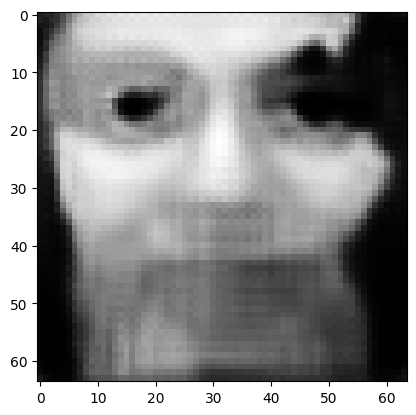

tensor([[4.6266e-04, 8.6519e-05, 9.1645e-03, 8.8315e-05, 1.6612e-06, 2.7477e-06,
         2.3628e-04, 9.4748e-01, 2.1705e-05, 8.4355e-03, 1.6141e-03, 7.1143e-05,
         3.5205e-05, 2.5567e-05, 1.8350e-05, 1.9790e-03, 3.0299e-04, 2.0340e-06,
         1.3153e-03, 1.4991e-04, 4.8829e-04, 1.3424e-03, 1.7038e-06, 2.5010e-03,
         7.1070e-04, 6.5128e-06, 1.1468e-04, 9.6758e-05, 5.7258e-03, 4.8078e-04,
         2.5927e-06, 4.2526e-06, 6.0562e-04, 1.2842e-04, 5.3310e-03, 2.0139e-05,
         7.4613e-04, 4.5277e-03, 5.1069e-03, 5.7006e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053954530507326126
tensor([[4.6263e-04, 8.6510e-05, 9.1632e-03, 8.8301e-05, 1.6609e-06, 2.7475e-06,
         2.3624e-04, 9.4748e-01, 2.1700e-05, 8.4344e-03, 1.6139e-03, 7.1131e-05,
         3.5199e-05, 2.5563e-05, 1.8347e-05, 1.9788e-03, 3.0294e-04, 2.0336e-06,
         1.3152e-03, 1.4989e-04, 4.8819e-04, 1.3421e-03, 1.7034e-06, 2.5007e-03,
         7.1059e-04, 6.5118e-06, 1.1466e-

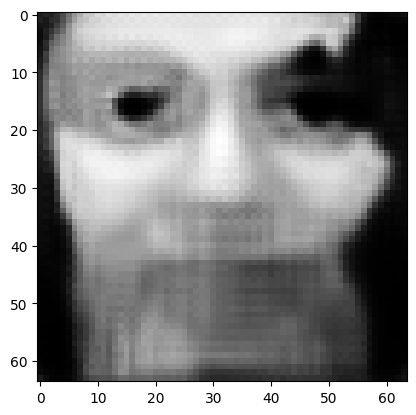

tensor([[4.6250e-04, 8.6473e-05, 9.1581e-03, 8.8247e-05, 1.6597e-06, 2.7464e-06,
         2.3610e-04, 9.4751e-01, 2.1679e-05, 8.4304e-03, 1.6131e-03, 7.1084e-05,
         3.5173e-05, 2.5546e-05, 1.8333e-05, 1.9781e-03, 3.0275e-04, 2.0322e-06,
         1.3145e-03, 1.4979e-04, 4.8781e-04, 1.3413e-03, 1.7019e-06, 2.4994e-03,
         7.1015e-04, 6.5081e-06, 1.1459e-04, 9.6670e-05, 5.7215e-03, 4.8038e-04,
         2.5898e-06, 4.2499e-06, 6.0515e-04, 1.2832e-04, 5.3270e-03, 2.0124e-05,
         7.4555e-04, 4.5244e-03, 5.1030e-03, 5.6959e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05391612648963928
tensor([[4.6246e-04, 8.6464e-05, 9.1569e-03, 8.8234e-05, 1.6594e-06, 2.7461e-06,
         2.3606e-04, 9.4752e-01, 2.1675e-05, 8.4295e-03, 1.6129e-03, 7.1073e-05,
         3.5166e-05, 2.5542e-05, 1.8329e-05, 1.9779e-03, 3.0270e-04, 2.0318e-06,
         1.3144e-03, 1.4977e-04, 4.8772e-04, 1.3412e-03, 1.7016e-06, 2.4991e-03,
         7.1004e-04, 6.5072e-06, 1.1458e-0

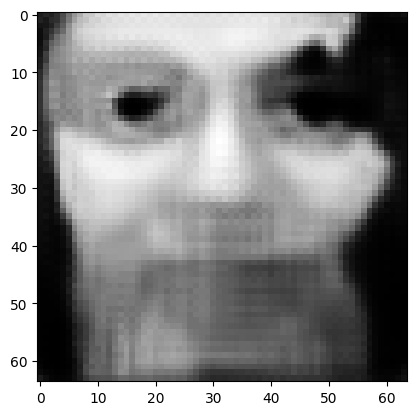

tensor([[4.6234e-04, 8.6429e-05, 9.1520e-03, 8.8183e-05, 1.6582e-06, 2.7451e-06,
         2.3593e-04, 9.4755e-01, 2.1655e-05, 8.4256e-03, 1.6121e-03, 7.1029e-05,
         3.5141e-05, 2.5527e-05, 1.8316e-05, 1.9772e-03, 3.0252e-04, 2.0304e-06,
         1.3138e-03, 1.4967e-04, 4.8736e-04, 1.3404e-03, 1.7002e-06, 2.4979e-03,
         7.0962e-04, 6.5037e-06, 1.1451e-04, 9.6586e-05, 5.7174e-03, 4.8000e-04,
         2.5871e-06, 4.2473e-06, 6.0470e-04, 1.2823e-04, 5.3233e-03, 2.0109e-05,
         7.4501e-04, 4.5213e-03, 5.0994e-03, 5.6914e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05387986823916435
tensor([[4.6231e-04, 8.6421e-05, 9.1509e-03, 8.8171e-05, 1.6580e-06, 2.7449e-06,
         2.3589e-04, 9.4755e-01, 2.1651e-05, 8.4247e-03, 1.6119e-03, 7.1018e-05,
         3.5135e-05, 2.5523e-05, 1.8313e-05, 1.9770e-03, 3.0248e-04, 2.0301e-06,
         1.3137e-03, 1.4965e-04, 4.8727e-04, 1.3402e-03, 1.6998e-06, 2.4976e-03,
         7.0952e-04, 6.5028e-06, 1.1449e-0

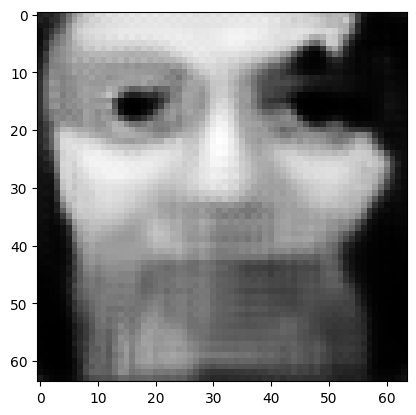

tensor([[4.6219e-04, 8.6388e-05, 9.1463e-03, 8.8123e-05, 1.6569e-06, 2.7439e-06,
         2.3576e-04, 9.4758e-01, 2.1632e-05, 8.4211e-03, 1.6111e-03, 7.0976e-05,
         3.5112e-05, 2.5508e-05, 1.8300e-05, 1.9764e-03, 3.0231e-04, 2.0288e-06,
         1.3131e-03, 1.4956e-04, 4.8693e-04, 1.3395e-03, 1.6985e-06, 2.4964e-03,
         7.0913e-04, 6.4995e-06, 1.1443e-04, 9.6507e-05, 5.7136e-03, 4.7965e-04,
         2.5845e-06, 4.2449e-06, 6.0428e-04, 1.2813e-04, 5.3197e-03, 2.0095e-05,
         7.4449e-04, 4.5184e-03, 5.0960e-03, 5.6872e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05384541675448418
tensor([[4.6216e-04, 8.6380e-05, 9.1452e-03, 8.8111e-05, 1.6566e-06, 2.7437e-06,
         2.3573e-04, 9.4758e-01, 2.1628e-05, 8.4202e-03, 1.6109e-03, 7.0966e-05,
         3.5106e-05, 2.5504e-05, 1.8297e-05, 1.9762e-03, 3.0227e-04, 2.0284e-06,
         1.3130e-03, 1.4954e-04, 4.8684e-04, 1.3393e-03, 1.6982e-06, 2.4962e-03,
         7.0903e-04, 6.4986e-06, 1.1442e-0

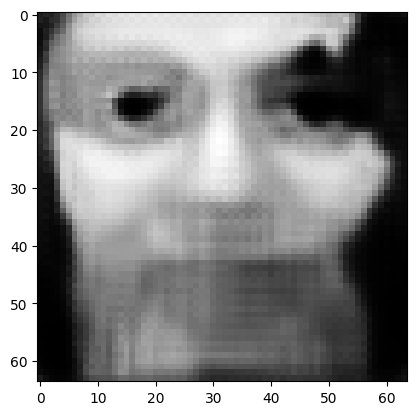

tensor([[4.6205e-04, 8.6348e-05, 9.1409e-03, 8.8065e-05, 1.6555e-06, 2.7427e-06,
         2.3561e-04, 9.4761e-01, 2.1610e-05, 8.4168e-03, 1.6102e-03, 7.0926e-05,
         3.5084e-05, 2.5490e-05, 1.8285e-05, 1.9756e-03, 3.0210e-04, 2.0272e-06,
         1.3124e-03, 1.4946e-04, 4.8651e-04, 1.3386e-03, 1.6969e-06, 2.4951e-03,
         7.0865e-04, 6.4955e-06, 1.1436e-04, 9.6432e-05, 5.7099e-03, 4.7930e-04,
         2.5821e-06, 4.2426e-06, 6.0387e-04, 1.2805e-04, 5.3164e-03, 2.0082e-05,
         7.4400e-04, 4.5156e-03, 5.0927e-03, 5.6831e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05381231755018234
tensor([[4.6202e-04, 8.6340e-05, 9.1398e-03, 8.8053e-05, 1.6553e-06, 2.7425e-06,
         2.3558e-04, 9.4762e-01, 2.1606e-05, 8.4159e-03, 1.6100e-03, 7.0916e-05,
         3.5079e-05, 2.5487e-05, 1.8282e-05, 1.9754e-03, 3.0206e-04, 2.0269e-06,
         1.3123e-03, 1.4944e-04, 4.8643e-04, 1.3385e-03, 1.6966e-06, 2.4948e-03,
         7.0856e-04, 6.4947e-06, 1.1434e-0

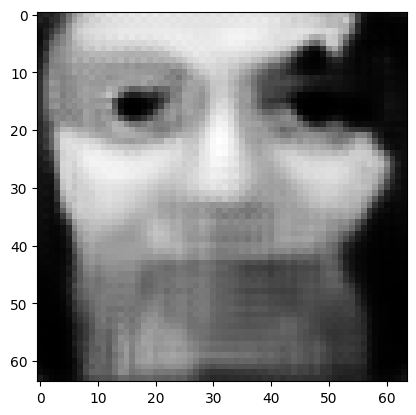

tensor([[4.6191e-04, 8.6310e-05, 9.1357e-03, 8.8010e-05, 1.6543e-06, 2.7416e-06,
         2.3546e-04, 9.4764e-01, 2.1590e-05, 8.4126e-03, 1.6093e-03, 7.0878e-05,
         3.5057e-05, 2.5473e-05, 1.8271e-05, 1.9748e-03, 3.0191e-04, 2.0257e-06,
         1.3118e-03, 1.4936e-04, 4.8612e-04, 1.3378e-03, 1.6954e-06, 2.4937e-03,
         7.0820e-04, 6.4916e-06, 1.1428e-04, 9.6360e-05, 5.7064e-03, 4.7898e-04,
         2.5798e-06, 4.2404e-06, 6.0349e-04, 1.2797e-04, 5.3132e-03, 2.0070e-05,
         7.4353e-04, 4.5129e-03, 5.0896e-03, 5.6793e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053781140595674515
tensor([[4.6189e-04, 8.6303e-05, 9.1347e-03, 8.7999e-05, 1.6541e-06, 2.7414e-06,
         2.3543e-04, 9.4764e-01, 2.1586e-05, 8.4119e-03, 1.6092e-03, 7.0869e-05,
         3.5052e-05, 2.5470e-05, 1.8268e-05, 1.9747e-03, 3.0187e-04, 2.0254e-06,
         1.3117e-03, 1.4934e-04, 4.8605e-04, 1.3377e-03, 1.6951e-06, 2.4935e-03,
         7.0812e-04, 6.4909e-06, 1.1427e-

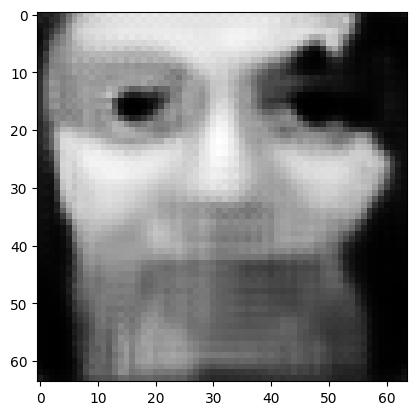

tensor([[4.6178e-04, 8.6275e-05, 9.1308e-03, 8.7959e-05, 1.6531e-06, 2.7406e-06,
         2.3532e-04, 9.4767e-01, 2.1570e-05, 8.4088e-03, 1.6085e-03, 7.0833e-05,
         3.5032e-05, 2.5457e-05, 1.8257e-05, 1.9741e-03, 3.0173e-04, 2.0243e-06,
         1.3112e-03, 1.4927e-04, 4.8576e-04, 1.3371e-03, 1.6940e-06, 2.4925e-03,
         7.0778e-04, 6.4881e-06, 1.1422e-04, 9.6293e-05, 5.7031e-03, 4.7867e-04,
         2.5776e-06, 4.2383e-06, 6.0313e-04, 1.2789e-04, 5.3102e-03, 2.0058e-05,
         7.4309e-04, 4.5104e-03, 5.0867e-03, 5.6757e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053751882165670395
tensor([[4.6176e-04, 8.6268e-05, 9.1298e-03, 8.7948e-05, 1.6529e-06, 2.7404e-06,
         2.3529e-04, 9.4767e-01, 2.1566e-05, 8.4080e-03, 1.6084e-03, 7.0824e-05,
         3.5028e-05, 2.5454e-05, 1.8255e-05, 1.9740e-03, 3.0169e-04, 2.0240e-06,
         1.3111e-03, 1.4925e-04, 4.8569e-04, 1.3369e-03, 1.6937e-06, 2.4923e-03,
         7.0770e-04, 6.4873e-06, 1.1420e-

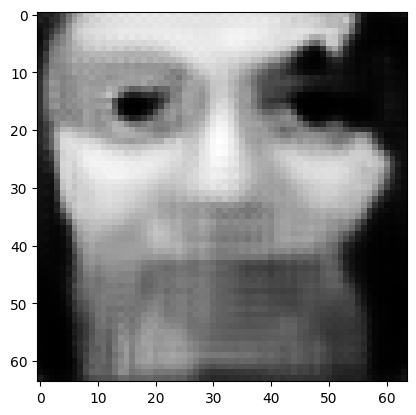

tensor([[4.6166e-04, 8.6241e-05, 9.1262e-03, 8.7910e-05, 1.6520e-06, 2.7396e-06,
         2.3519e-04, 9.4769e-01, 2.1552e-05, 8.4051e-03, 1.6078e-03, 7.0790e-05,
         3.5009e-05, 2.5442e-05, 1.8245e-05, 1.9734e-03, 3.0155e-04, 2.0229e-06,
         1.3106e-03, 1.4918e-04, 4.8541e-04, 1.3363e-03, 1.6926e-06, 2.4913e-03,
         7.0738e-04, 6.4847e-06, 1.1415e-04, 9.6229e-05, 5.7000e-03, 4.7838e-04,
         2.5755e-06, 4.2363e-06, 6.0278e-04, 1.2782e-04, 5.3073e-03, 2.0047e-05,
         7.4267e-04, 4.5080e-03, 5.0839e-03, 5.6722e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05372375249862671
tensor([[4.6164e-04, 8.6234e-05, 9.1253e-03, 8.7901e-05, 1.6518e-06, 2.7394e-06,
         2.3516e-04, 9.4770e-01, 2.1548e-05, 8.4044e-03, 1.6076e-03, 7.0782e-05,
         3.5004e-05, 2.5439e-05, 1.8242e-05, 1.9733e-03, 3.0152e-04, 2.0227e-06,
         1.3105e-03, 1.4916e-04, 4.8534e-04, 1.3362e-03, 1.6924e-06, 2.4911e-03,
         7.0730e-04, 6.4840e-06, 1.1414e-0

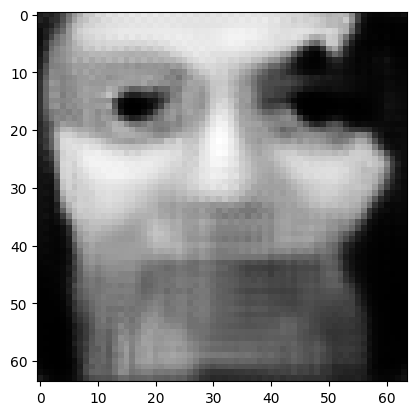

tensor([[4.6155e-04, 8.6208e-05, 9.1218e-03, 8.7864e-05, 1.6509e-06, 2.7387e-06,
         2.3506e-04, 9.4772e-01, 2.1534e-05, 8.4016e-03, 1.6070e-03, 7.0749e-05,
         3.4986e-05, 2.5428e-05, 1.8233e-05, 1.9728e-03, 3.0138e-04, 2.0217e-06,
         1.3101e-03, 1.4909e-04, 4.8508e-04, 1.3356e-03, 1.6914e-06, 2.4902e-03,
         7.0700e-04, 6.4814e-06, 1.1409e-04, 9.6169e-05, 5.6970e-03, 4.7810e-04,
         2.5735e-06, 4.2344e-06, 6.0246e-04, 1.2775e-04, 5.3046e-03, 2.0036e-05,
         7.4227e-04, 4.5057e-03, 5.0813e-03, 5.6689e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05369720235466957
tensor([[4.6152e-04, 8.6202e-05, 9.1209e-03, 8.7855e-05, 1.6507e-06, 2.7385e-06,
         2.3504e-04, 9.4772e-01, 2.1531e-05, 8.4009e-03, 1.6069e-03, 7.0741e-05,
         3.4982e-05, 2.5425e-05, 1.8230e-05, 1.9726e-03, 3.0135e-04, 2.0214e-06,
         1.3100e-03, 1.4908e-04, 4.8501e-04, 1.3355e-03, 1.6911e-06, 2.4900e-03,
         7.0693e-04, 6.4808e-06, 1.1408e-0

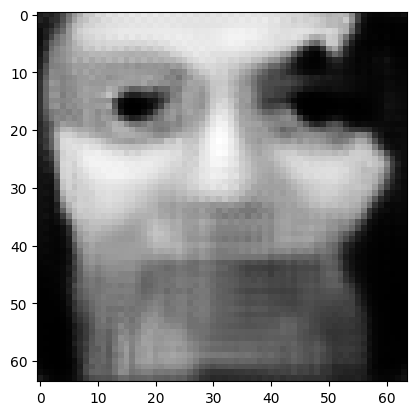

tensor([[4.6143e-04, 8.6178e-05, 9.1176e-03, 8.7820e-05, 1.6499e-06, 2.7378e-06,
         2.3494e-04, 9.4774e-01, 2.1518e-05, 8.3983e-03, 1.6063e-03, 7.0711e-05,
         3.4965e-05, 2.5414e-05, 1.8221e-05, 1.9721e-03, 3.0123e-04, 2.0205e-06,
         1.3096e-03, 1.4901e-04, 4.8476e-04, 1.3350e-03, 1.6901e-06, 2.4891e-03,
         7.0664e-04, 6.4784e-06, 1.1403e-04, 9.6111e-05, 5.6942e-03, 4.7784e-04,
         2.5716e-06, 4.2327e-06, 6.0215e-04, 1.2768e-04, 5.3020e-03, 2.0026e-05,
         7.4189e-04, 4.5035e-03, 5.0788e-03, 5.6658e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05367189645767212
tensor([[4.6141e-04, 8.6172e-05, 9.1168e-03, 8.7812e-05, 1.6497e-06, 2.7377e-06,
         2.3492e-04, 9.4775e-01, 2.1514e-05, 8.3976e-03, 1.6062e-03, 7.0703e-05,
         3.4961e-05, 2.5411e-05, 1.8219e-05, 1.9720e-03, 3.0119e-04, 2.0202e-06,
         1.3095e-03, 1.4900e-04, 4.8470e-04, 1.3348e-03, 1.6899e-06, 2.4889e-03,
         7.0657e-04, 6.4778e-06, 1.1402e-0

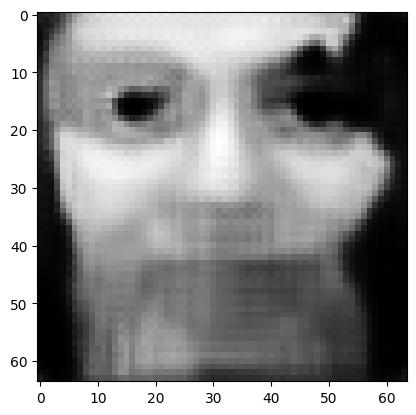

tensor([[4.6133e-04, 8.6149e-05, 9.1136e-03, 8.7779e-05, 1.6490e-06, 2.7370e-06,
         2.3483e-04, 9.4777e-01, 2.1502e-05, 8.3951e-03, 1.6057e-03, 7.0674e-05,
         3.4944e-05, 2.5401e-05, 1.8210e-05, 1.9716e-03, 3.0108e-04, 2.0193e-06,
         1.3091e-03, 1.4893e-04, 4.8446e-04, 1.3343e-03, 1.6890e-06, 2.4881e-03,
         7.0630e-04, 6.4754e-06, 1.1398e-04, 9.6057e-05, 5.6915e-03, 4.7759e-04,
         2.5698e-06, 4.2310e-06, 6.0185e-04, 1.2762e-04, 5.2996e-03, 2.0016e-05,
         7.4153e-04, 4.5015e-03, 5.0764e-03, 5.6629e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05364794284105301
tensor([[4.6131e-04, 8.6143e-05, 9.1128e-03, 8.7771e-05, 1.6488e-06, 2.7368e-06,
         2.3481e-04, 9.4777e-01, 2.1499e-05, 8.3945e-03, 1.6056e-03, 7.0667e-05,
         3.4940e-05, 2.5398e-05, 1.8208e-05, 1.9714e-03, 3.0105e-04, 2.0191e-06,
         1.3090e-03, 1.4892e-04, 4.8440e-04, 1.3342e-03, 1.6888e-06, 2.4879e-03,
         7.0623e-04, 6.4749e-06, 1.1397e-0

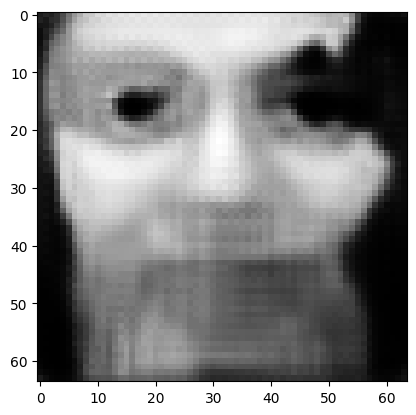

tensor([[4.6123e-04, 8.6121e-05, 9.1098e-03, 8.7739e-05, 1.6481e-06, 2.7362e-06,
         2.3472e-04, 9.4779e-01, 2.1487e-05, 8.3921e-03, 1.6051e-03, 7.0639e-05,
         3.4925e-05, 2.5389e-05, 1.8200e-05, 1.9710e-03, 3.0093e-04, 2.0182e-06,
         1.3086e-03, 1.4886e-04, 4.8418e-04, 1.3337e-03, 1.6879e-06, 2.4872e-03,
         7.0597e-04, 6.4727e-06, 1.1392e-04, 9.6005e-05, 5.6890e-03, 4.7735e-04,
         2.5681e-06, 4.2294e-06, 6.0157e-04, 1.2756e-04, 5.2972e-03, 2.0007e-05,
         7.4119e-04, 4.4995e-03, 5.0742e-03, 5.6601e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053625233471393585
tensor([[4.6121e-04, 8.6116e-05, 9.1091e-03, 8.7731e-05, 1.6479e-06, 2.7360e-06,
         2.3470e-04, 9.4779e-01, 2.1484e-05, 8.3915e-03, 1.6049e-03, 7.0632e-05,
         3.4921e-05, 2.5386e-05, 1.8198e-05, 1.9709e-03, 3.0090e-04, 2.0180e-06,
         1.3085e-03, 1.4885e-04, 4.8412e-04, 1.3336e-03, 1.6877e-06, 2.4870e-03,
         7.0591e-04, 6.4721e-06, 1.1391e-

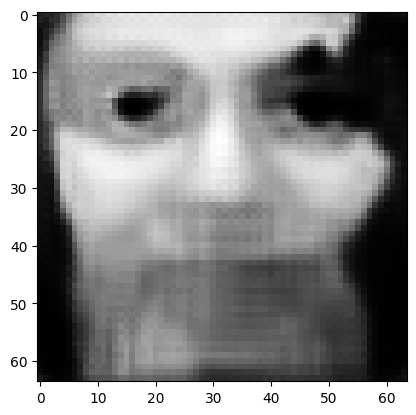

tensor([[4.6114e-04, 8.6095e-05, 9.1062e-03, 8.7701e-05, 1.6472e-06, 2.7354e-06,
         2.3462e-04, 9.4781e-01, 2.1472e-05, 8.3892e-03, 1.6045e-03, 7.0606e-05,
         3.4907e-05, 2.5377e-05, 1.8190e-05, 1.9705e-03, 3.0080e-04, 2.0172e-06,
         1.3082e-03, 1.4879e-04, 4.8391e-04, 1.3332e-03, 1.6869e-06, 2.4863e-03,
         7.0566e-04, 6.4700e-06, 1.1387e-04, 9.5955e-05, 5.6866e-03, 4.7712e-04,
         2.5665e-06, 4.2278e-06, 6.0131e-04, 1.2750e-04, 5.2950e-03, 1.9998e-05,
         7.4087e-04, 4.4977e-03, 5.0720e-03, 5.6574e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053603652864694595
tensor([[4.6112e-04, 8.6090e-05, 9.1055e-03, 8.7694e-05, 1.6470e-06, 2.7353e-06,
         2.3460e-04, 9.4781e-01, 2.1470e-05, 8.3887e-03, 1.6043e-03, 7.0600e-05,
         3.4903e-05, 2.5374e-05, 1.8188e-05, 1.9704e-03, 3.0077e-04, 2.0170e-06,
         1.3081e-03, 1.4878e-04, 4.8386e-04, 1.3331e-03, 1.6867e-06, 2.4861e-03,
         7.0560e-04, 6.4695e-06, 1.1386e-

In [144]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=7)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7157e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.9743413925170898


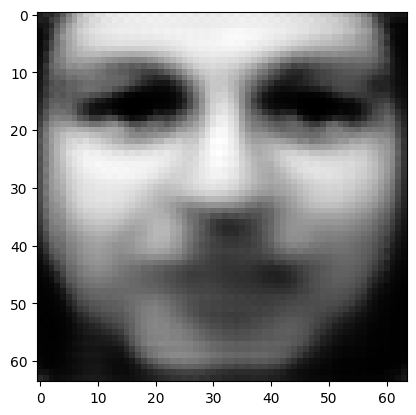

tensor([[1.0938e-04, 1.6373e-04, 1.7227e-02, 3.8480e-03, 1.5699e-03, 1.0094e-05,
         2.7476e-02, 1.8971e-04, 2.8090e-01, 1.3787e-02, 6.0934e-03, 9.1343e-03,
         1.5523e-02, 2.3917e-03, 4.9524e-03, 4.9497e-04, 1.9717e-02, 8.1044e-04,
         2.3678e-03, 1.4329e-03, 5.1555e-02, 2.6642e-02, 1.7561e-02, 9.1284e-03,
         1.1005e-01, 6.3381e-04, 3.5104e-03, 3.9770e-02, 4.0398e-02, 8.8857e-03,
         2.2501e-02, 1.7734e-04, 1.8341e-02, 3.0276e-03, 5.8377e-02, 8.3379e-04,
         1.5636e-02, 7.4285e-02, 5.5515e-02, 3.4970e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2697561979293823
tensor([[7.6473e-05, 1.0654e-04, 1.6085e-02, 3.4619e-03, 1.1605e-03, 8.2964e-06,
         2.6547e-02, 1.4691e-04, 3.7670e-01, 1.4931e-02, 5.3983e-03, 7.2525e-03,
         1.2550e-02, 1.5293e-03, 4.5738e-03, 4.0361e-04, 1.5767e-02, 7.1841e-04,
         2.1054e-03, 1.4977e-03, 3.9949e-02, 2.3130e-02, 1.8301e-02, 8.0748e-03,
         8.7262e-02, 4.4454e-04, 2.8521e-03

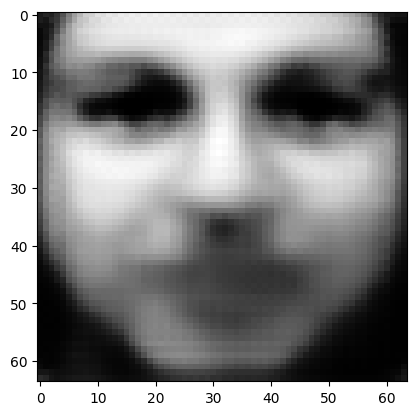

tensor([[2.4495e-05, 3.4236e-05, 1.0989e-02, 2.0249e-03, 4.6816e-04, 4.3736e-06,
         2.0067e-02, 6.8948e-05, 6.0880e-01, 1.3704e-02, 3.7014e-03, 3.4094e-03,
         6.2433e-03, 4.7842e-04, 3.2807e-03, 2.1873e-04, 8.0152e-03, 4.5462e-04,
         1.2860e-03, 1.3185e-03, 1.8345e-02, 1.3496e-02, 1.5495e-02, 4.9990e-03,
         4.8412e-02, 1.6415e-04, 1.5164e-03, 2.7088e-02, 3.6660e-02, 6.4021e-03,
         8.3038e-03, 2.9889e-05, 1.1222e-02, 9.5644e-04, 3.5297e-02, 3.8187e-04,
         5.2901e-03, 3.5717e-02, 2.7469e-02, 1.8160e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.49625927209854126
tensor([[1.9595e-05, 2.7848e-05, 1.0111e-02, 1.7980e-03, 3.9701e-04, 3.8628e-06,
         1.8616e-02, 5.9672e-05, 6.4427e-01, 1.3187e-02, 3.4331e-03, 2.9407e-03,
         5.4273e-03, 3.8770e-04, 3.0641e-03, 1.9550e-04, 7.0500e-03, 4.1237e-04,
         1.1561e-03, 1.2655e-03, 1.5830e-02, 1.2105e-02, 1.4711e-02, 4.5133e-03,
         4.3070e-02, 1.3599e-04, 1.3406e-0

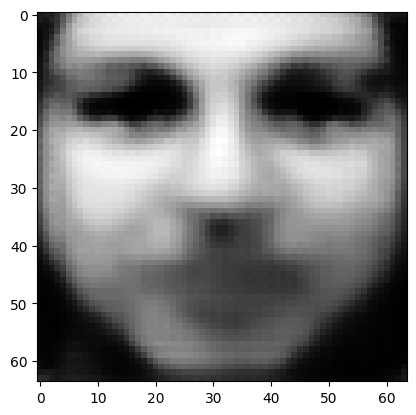

tensor([[9.8096e-06, 1.4637e-05, 7.6414e-03, 1.2054e-03, 2.3414e-04, 2.6190e-06,
         1.4382e-02, 3.7329e-05, 7.3990e-01, 1.1232e-02, 2.6401e-03, 1.8139e-03,
         3.5013e-03, 2.0256e-04, 2.3745e-03, 1.3748e-04, 4.6967e-03, 2.9992e-04,
         7.9952e-04, 1.0667e-03, 9.7400e-03, 8.4634e-03, 1.2039e-02, 3.1586e-03,
         2.9354e-02, 7.3573e-05, 9.0099e-04, 1.9012e-02, 2.9811e-02, 4.9941e-03,
         4.7032e-03, 1.2013e-05, 7.7703e-03, 5.0367e-04, 2.3799e-02, 2.2949e-04,
         2.7201e-03, 2.2150e-02, 1.7210e-02, 1.1166e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3012416660785675
tensor([[8.4965e-06, 1.2787e-05, 7.1826e-03, 1.1029e-03, 2.0872e-04, 2.4162e-06,
         1.3599e-02, 3.3745e-05, 7.5693e-01, 1.0780e-02, 2.4864e-03, 1.6275e-03,
         3.1890e-03, 1.7667e-04, 2.2298e-03, 1.2775e-04, 4.3110e-03, 2.7992e-04,
         7.3492e-04, 1.0212e-03, 8.7409e-03, 7.8311e-03, 1.1454e-02, 2.9086e-03,
         2.7042e-02, 6.4200e-05, 8.2524e-04

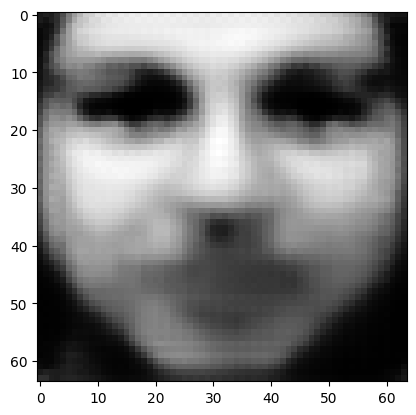

tensor([[5.2536e-06, 8.0881e-06, 5.7078e-03, 8.0376e-04, 1.4245e-04, 1.8405e-06,
         1.1131e-02, 2.3741e-05, 8.0825e-01, 9.2959e-03, 1.9941e-03, 1.1251e-03,
         2.3102e-03, 1.1014e-04, 1.7818e-03, 9.9453e-05, 3.2126e-03, 2.2030e-04,
         5.4594e-04, 8.6983e-04, 6.0062e-03, 5.9848e-03, 9.5511e-03, 2.1810e-03,
         2.0265e-02, 4.0040e-05, 6.0576e-04, 1.4074e-02, 2.5225e-02, 4.1245e-03,
         3.1076e-03, 6.4045e-06, 5.9792e-03, 3.1549e-04, 1.7521e-02, 1.5717e-04,
         1.6773e-03, 1.5961e-02, 1.1961e-02, 7.6206e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21288903057575226
tensor([[4.7620e-06, 7.3563e-06, 5.4395e-03, 7.5266e-04, 1.3158e-04, 1.7407e-06,
         1.0670e-02, 2.2080e-05, 8.1753e-01, 9.0060e-03, 1.9025e-03, 1.0419e-03,
         2.1622e-03, 9.9861e-05, 1.6992e-03, 9.4452e-05, 3.0215e-03, 2.0964e-04,
         5.1297e-04, 8.4023e-04, 5.5537e-03, 5.6541e-03, 9.1926e-03, 2.0534e-03,
         1.9062e-02, 3.6301e-05, 5.6784e-0

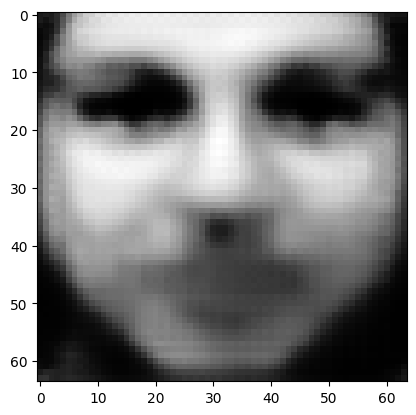

tensor([[3.4262e-06, 5.3473e-06, 4.6003e-03, 6.0211e-04, 1.0090e-04, 1.4412e-06,
         9.2221e-03, 1.7229e-05, 8.4583e-01, 8.0624e-03, 1.6182e-03, 8.0515e-04,
         1.7335e-03, 7.1886e-05, 1.4466e-03, 7.9184e-05, 2.4576e-03, 1.7756e-04,
         4.1456e-04, 7.4461e-04, 4.2630e-03, 4.6566e-03, 8.0731e-03, 1.6741e-03,
         1.5473e-02, 2.6103e-05, 4.5630e-04, 1.1284e-02, 2.2195e-02, 3.5739e-03,
         2.3200e-03, 4.1575e-06, 4.9352e-03, 2.2630e-04, 1.3988e-02, 1.2024e-04,
         1.1923e-03, 1.2591e-02, 9.2054e-03, 5.7506e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1674417108297348
tensor([[3.1910e-06, 4.9854e-06, 4.4289e-03, 5.7259e-04, 9.5078e-05, 1.3831e-06,
         8.9198e-03, 1.6303e-05, 8.5146e-01, 7.8648e-03, 1.5603e-03, 7.5933e-04,
         1.6538e-03, 6.6832e-05, 1.3953e-03, 7.6213e-05, 2.3480e-03, 1.7115e-04,
         3.9469e-04, 7.2444e-04, 4.0180e-03, 4.4592e-03, 7.8406e-03, 1.5981e-03,
         1.4766e-02, 2.4214e-05, 4.3447e-04

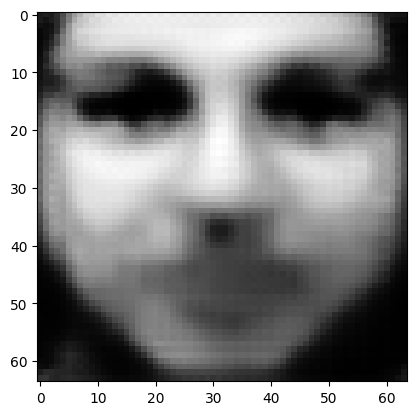

tensor([[2.4756e-06, 3.8949e-06, 3.8749e-03, 4.7901e-04, 7.7179e-05, 1.1954e-06,
         7.9132e-03, 1.3408e-05, 8.6979e-01, 7.1885e-03, 1.3720e-03, 6.1791e-04,
         1.4000e-03, 5.1752e-05, 1.2280e-03, 6.6539e-05, 1.9981e-03, 1.5020e-04,
         3.3184e-04, 6.5757e-04, 3.2624e-03, 3.8241e-03, 7.0593e-03, 1.3554e-03,
         1.2510e-02, 1.8603e-05, 3.6571e-04, 9.4750e-03, 2.0122e-02, 3.2009e-03,
         1.8496e-03, 2.9795e-06, 4.2529e-03, 1.7526e-04, 1.1707e-02, 9.7694e-05,
         9.1614e-04, 1.0490e-02, 7.5022e-03, 4.5955e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13950304687023163
tensor([[2.3442e-06, 3.6927e-06, 3.7660e-03, 4.6105e-04, 7.3763e-05, 1.1580e-06,
         7.7125e-03, 1.2860e-05, 8.7343e-01, 7.0517e-03, 1.3348e-03, 5.9126e-04,
         1.3503e-03, 4.8991e-05, 1.1947e-03, 6.4569e-05, 1.9297e-03, 1.4602e-04,
         3.1980e-04, 6.4393e-04, 3.1191e-03, 3.6983e-03, 6.9031e-03, 1.3088e-03,
         1.2069e-02, 1.7591e-05, 3.5244e-0

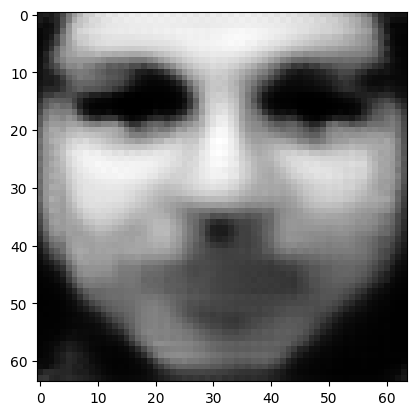

tensor([[1.9426e-06, 3.0611e-06, 3.4065e-03, 4.0331e-04, 6.2808e-05, 1.0361e-06,
         7.0577e-03, 1.1130e-05, 8.8535e-01, 6.6026e-03, 1.2124e-03, 5.0672e-04,
         1.1902e-03, 4.0413e-05, 1.0842e-03, 5.8049e-05, 1.7081e-03, 1.3240e-04,
         2.8094e-04, 5.9709e-04, 2.6568e-03, 3.2840e-03, 6.3993e-03, 1.1589e-03,
         1.0644e-02, 1.4466e-05, 3.0968e-04, 8.3315e-03, 1.8634e-02, 2.9225e-03,
         1.5530e-03, 2.3181e-06, 3.7832e-03, 1.4401e-04, 1.0221e-02, 8.3343e-05,
         7.4995e-04, 9.0993e-03, 6.4257e-03, 3.8695e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1217678040266037
tensor([[1.8606e-06, 2.9307e-06, 3.3292e-03, 3.9089e-04, 6.0478e-05, 1.0101e-06,
         6.9120e-03, 1.0764e-05, 8.8794e-01, 6.5039e-03, 1.1857e-03, 4.8840e-04,
         1.1572e-03, 3.8645e-05, 1.0598e-03, 5.6657e-05, 1.6604e-03, 1.2936e-04,
         2.7241e-04, 5.8669e-04, 2.5586e-03, 3.1945e-03, 6.2876e-03, 1.1260e-03,
         1.0335e-02, 1.3811e-05, 3.0050e-04

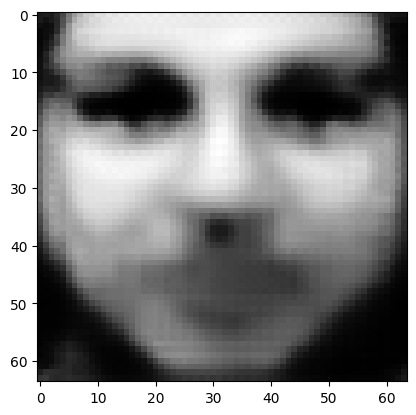

tensor([[1.5918e-06, 2.5020e-06, 3.0616e-03, 3.4857e-04, 5.2703e-05, 9.2092e-07,
         6.4085e-03, 9.5207e-06, 8.9685e-01, 6.1471e-03, 1.0925e-03, 4.2732e-04,
         1.0462e-03, 3.2885e-05, 9.7377e-04, 5.1861e-05, 1.4975e-03, 1.1896e-04,
         2.4321e-04, 5.4959e-04, 2.2304e-03, 2.8866e-03, 5.8895e-03, 1.0129e-03,
         9.2900e-03, 1.1672e-05, 2.6945e-04, 7.4873e-03, 1.7520e-02, 2.7071e-03,
         1.3392e-03, 1.8770e-06, 3.4325e-03, 1.2213e-04, 9.0981e-03, 7.2946e-05,
         6.3448e-04, 8.0965e-03, 5.6343e-03, 3.3452e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10886510461568832
tensor([[1.5362e-06, 2.4132e-06, 3.0032e-03, 3.3958e-04, 5.1102e-05, 9.0166e-07,
         6.2993e-03, 9.2567e-06, 8.9879e-01, 6.0677e-03, 1.0720e-03, 4.1470e-04,
         1.0221e-03, 3.1701e-05, 9.5481e-04, 5.0805e-05, 1.4628e-03, 1.1668e-04,
         2.3702e-04, 5.4127e-04, 2.1618e-03, 2.8206e-03, 5.8024e-03, 9.8869e-04,
         9.0687e-03, 1.1241e-05, 2.6281e-0

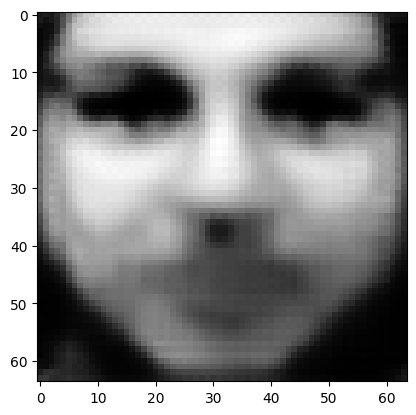

tensor([[1.3477e-06, 2.1114e-06, 2.7978e-03, 3.0858e-04, 4.5606e-05, 8.3378e-07,
         5.9138e-03, 8.3457e-06, 9.0561e-01, 5.7823e-03, 9.9918e-04, 3.7141e-04,
         9.3833e-04, 2.7704e-05, 8.8794e-04, 4.7057e-05, 1.3420e-03, 1.0867e-04,
         2.1552e-04, 5.1151e-04, 1.9276e-03, 2.5893e-03, 5.4945e-03, 9.0472e-04,
         8.2959e-03, 9.7964e-06, 2.3973e-04, 6.8500e-03, 1.6583e-02, 2.5308e-03,
         1.1848e-03, 1.5750e-06, 3.1594e-03, 1.0622e-04, 8.2490e-03, 6.5154e-05,
         5.5162e-04, 7.3324e-03, 5.0442e-03, 2.9642e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09915132075548172
tensor([[1.3067e-06, 2.0460e-06, 2.7514e-03, 3.0159e-04, 4.4404e-05, 8.1854e-07,
         5.8240e-03, 8.1441e-06, 9.0714e-01, 5.7179e-03, 9.8289e-04, 3.6181e-04,
         9.1973e-04, 2.6837e-05, 8.7298e-04, 4.6222e-05, 1.3149e-03, 1.0684e-04,
         2.1069e-04, 5.0478e-04, 1.8762e-03, 2.5376e-03, 5.4244e-03, 8.8583e-04,
         8.1230e-03, 9.4807e-06, 2.3458e-0

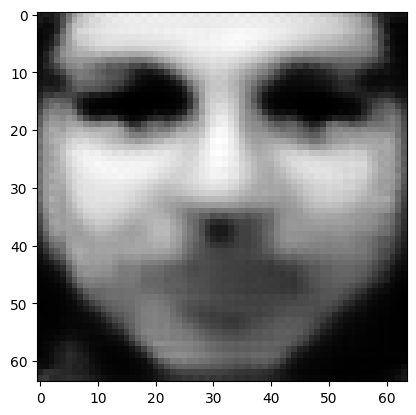

tensor([[1.1627e-06, 1.8169e-06, 2.5804e-03, 2.7644e-04, 4.0191e-05, 7.6336e-07,
         5.4927e-03, 7.4206e-06, 9.1272e-01, 5.4831e-03, 9.2347e-04, 3.2788e-04,
         8.5255e-04, 2.3785e-05, 8.1911e-04, 4.3213e-05, 1.2176e-03, 1.0024e-04,
         1.9336e-04, 4.8028e-04, 1.6948e-03, 2.3510e-03, 5.1695e-03, 8.1829e-04,
         7.5000e-03, 8.3740e-06, 2.1604e-04, 6.3267e-03, 1.5791e-02, 2.3890e-03,
         1.0634e-03, 1.3482e-06, 2.9347e-03, 9.3914e-05, 7.5642e-03, 5.9014e-05,
         4.8690e-04, 6.7079e-03, 4.5727e-03, 2.6646e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09132447093725204
tensor([[1.1318e-06, 1.7675e-06, 2.5415e-03, 2.7090e-04, 3.9278e-05, 7.5108e-07,
         5.4181e-03, 7.2610e-06, 9.1397e-01, 5.4296e-03, 9.1003e-04, 3.2051e-04,
         8.3762e-04, 2.3126e-05, 8.0712e-04, 4.2541e-05, 1.1960e-03, 9.8778e-05,
         1.8954e-04, 4.7470e-04, 1.6553e-03, 2.3095e-03, 5.1121e-03, 8.0338e-04,
         7.3618e-03, 8.1365e-06, 2.1193e-0

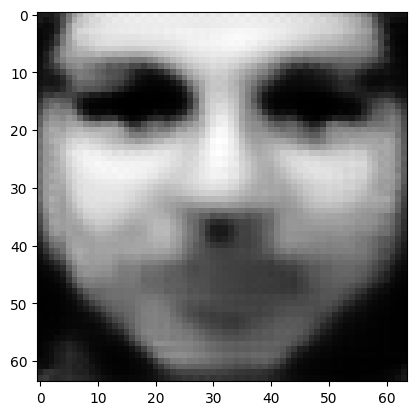

tensor([[1.0223e-06, 1.5953e-06, 2.4018e-03, 2.5110e-04, 3.6072e-05, 7.0722e-07,
         5.1472e-03, 6.6924e-06, 9.1850e-01, 5.2287e-03, 8.6175e-04, 2.9456e-04,
         7.8401e-04, 2.0841e-05, 7.6377e-04, 4.0120e-05, 1.1190e-03, 9.3560e-05,
         1.7590e-04, 4.5442e-04, 1.5160e-03, 2.1606e-03, 4.9009e-03, 7.4966e-04,
         6.8692e-03, 7.3122e-06, 1.9731e-04, 5.8994e-03, 1.5107e-02, 2.2717e-03,
         9.6927e-04, 1.1795e-06, 2.7508e-03, 8.4373e-05, 7.0121e-03, 5.4140e-05,
         4.3655e-04, 6.2036e-03, 4.1979e-03, 2.4286e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08501361310482025
tensor([[9.9824e-07, 1.5579e-06, 2.3702e-03, 2.4673e-04, 3.5371e-05, 6.9742e-07,
         5.0861e-03, 6.5668e-06, 9.1952e-01, 5.1824e-03, 8.5092e-04, 2.8888e-04,
         7.7191e-04, 2.0344e-05, 7.5409e-04, 3.9578e-05, 1.1018e-03, 9.2400e-05,
         1.7289e-04, 4.4986e-04, 1.4855e-03, 2.1273e-03, 4.8526e-03, 7.3776e-04,
         6.7594e-03, 7.1343e-06, 1.9407e-0

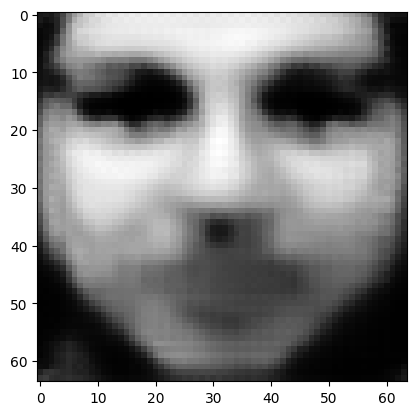

tensor([[9.1340e-07, 1.4256e-06, 2.2560e-03, 2.3112e-04, 3.2881e-05, 6.6200e-07,
         4.8639e-03, 6.1210e-06, 9.2322e-01, 5.0144e-03, 8.1161e-04, 2.6880e-04,
         7.2769e-04, 1.8588e-05, 7.1900e-04, 3.7626e-05, 1.0401e-03, 8.8191e-05,
         1.6223e-04, 4.3317e-04, 1.3772e-03, 2.0073e-03, 4.6753e-03, 6.9525e-04,
         6.3642e-03, 6.5101e-06, 1.8244e-04, 5.5485e-03, 1.4516e-02, 2.1739e-03,
         8.9488e-04, 1.0514e-06, 2.5990e-03, 7.6863e-05, 6.5648e-03, 5.0221e-05,
         3.9683e-04, 5.7937e-03, 3.8978e-03, 2.2413e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07988482713699341
tensor([[8.9454e-07, 1.3963e-06, 2.2303e-03, 2.2761e-04, 3.2328e-05, 6.5398e-07,
         4.8135e-03, 6.0215e-06, 9.2406e-01, 4.9755e-03, 8.0270e-04, 2.6436e-04,
         7.1769e-04, 1.8203e-05, 7.1099e-04, 3.7182e-05, 1.0262e-03, 8.7239e-05,
         1.5985e-04, 4.2931e-04, 1.3531e-03, 1.9801e-03, 4.6348e-03, 6.8566e-04,
         6.2755e-03, 6.3735e-06, 1.7983e-0

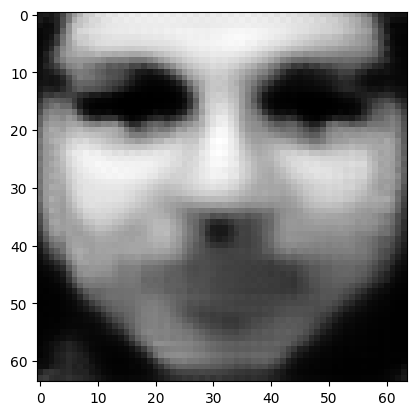

tensor([[8.2698e-07, 1.2911e-06, 2.1345e-03, 2.1497e-04, 3.0317e-05, 6.2441e-07,
         4.6287e-03, 5.6601e-06, 9.2716e-01, 4.8331e-03, 7.6965e-04, 2.4828e-04,
         6.8069e-04, 1.6804e-05, 6.8154e-04, 3.5562e-05, 9.7517e-04, 8.3725e-05,
         1.5125e-04, 4.1522e-04, 1.2660e-03, 1.8809e-03, 4.4836e-03, 6.5107e-04,
         5.9493e-03, 5.8826e-06, 1.7029e-04, 5.2553e-03, 1.4004e-02, 2.0898e-03,
         8.3378e-04, 9.5056e-07, 2.4715e-03, 7.0768e-05, 6.1940e-03, 4.6990e-05,
         3.6467e-04, 5.4522e-03, 3.6499e-03, 2.0901e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07562758773565292
tensor([[8.1166e-07, 1.2674e-06, 2.1125e-03, 2.1210e-04, 2.9860e-05, 6.1756e-07,
         4.5862e-03, 5.5776e-06, 9.2788e-01, 4.8000e-03, 7.6207e-04, 2.4462e-04,
         6.7213e-04, 1.6488e-05, 6.7477e-04, 3.5191e-05, 9.6340e-04, 8.2913e-05,
         1.4931e-04, 4.1201e-04, 1.2463e-03, 1.8582e-03, 4.4480e-03, 6.4320e-04,
         5.8742e-03, 5.7722e-06, 1.6811e-0

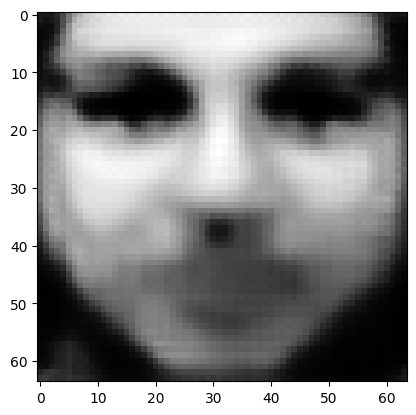

tensor([[7.5725e-07, 1.1823e-06, 2.0326e-03, 2.0181e-04, 2.8212e-05, 5.9262e-07,
         4.4342e-03, 5.2814e-06, 9.3047e-01, 4.6802e-03, 7.3439e-04, 2.3161e-04,
         6.4112e-04, 1.5363e-05, 6.5008e-04, 3.3819e-05, 9.2092e-04, 7.9948e-05,
         1.4234e-04, 4.0002e-04, 1.1752e-03, 1.7756e-03, 4.3224e-03, 6.1488e-04,
         5.6029e-03, 5.3834e-06, 1.6024e-04, 5.0116e-03, 1.3560e-02, 2.0160e-03,
         7.8282e-04, 8.6949e-07, 2.3624e-03, 6.5747e-05, 5.8830e-03, 4.4306e-05,
         3.3828e-04, 5.1618e-03, 3.4428e-03, 1.9664e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07206185162067413
tensor([[7.4481e-07, 1.1630e-06, 2.0143e-03, 1.9945e-04, 2.7837e-05, 5.8688e-07,
         4.3990e-03, 5.2132e-06, 9.3108e-01, 4.6515e-03, 7.2801e-04, 2.2864e-04,
         6.3402e-04, 1.5111e-05, 6.4430e-04, 3.3502e-05, 9.1119e-04, 7.9267e-05,
         1.4073e-04, 3.9721e-04, 1.1589e-03, 1.7565e-03, 4.2929e-03, 6.0831e-04,
         5.5407e-03, 5.2956e-06, 1.5845e-0

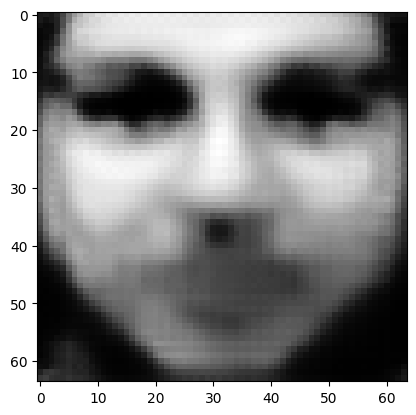

tensor([[6.9988e-07, 1.0929e-06, 1.9457e-03, 1.9080e-04, 2.6472e-05, 5.6569e-07,
         4.2687e-03, 4.9645e-06, 9.3331e-01, 4.5457e-03, 7.0414e-04, 2.1783e-04,
         6.0767e-04, 1.4189e-05, 6.2301e-04, 3.2331e-05, 8.7532e-04, 7.6746e-05,
         1.3485e-04, 3.8673e-04, 1.0998e-03, 1.6864e-03, 4.1830e-03, 5.8434e-04,
         5.3120e-03, 4.9783e-06, 1.5182e-04, 4.8028e-03, 1.3166e-02, 1.9514e-03,
         7.4022e-04, 8.0370e-07, 2.2690e-03, 6.1559e-05, 5.6173e-03, 4.2030e-05,
         3.1631e-04, 4.9158e-03, 3.2676e-03, 1.8621e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06902076303958893
tensor([[6.8969e-07, 1.0769e-06, 1.9296e-03, 1.8882e-04, 2.6159e-05, 5.6079e-07,
         4.2384e-03, 4.9075e-06, 9.3383e-01, 4.5212e-03, 6.9854e-04, 2.1535e-04,
         6.0153e-04, 1.3978e-05, 6.1809e-04, 3.2059e-05, 8.6701e-04, 7.6161e-05,
         1.3350e-04, 3.8429e-04, 1.0863e-03, 1.6701e-03, 4.1576e-03, 5.7886e-04,
         5.2591e-03, 4.9063e-06, 1.5028e-0

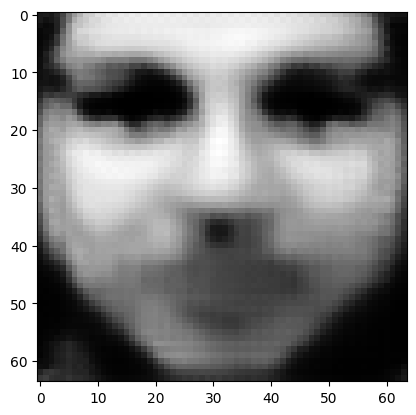

tensor([[6.5204e-07, 1.0182e-06, 1.8699e-03, 1.8145e-04, 2.5009e-05, 5.4253e-07,
         4.1253e-03, 4.6955e-06, 9.3577e-01, 4.4275e-03, 6.7766e-04, 2.0623e-04,
         5.7883e-04, 1.3207e-05, 5.9952e-04, 3.1046e-05, 8.3632e-04, 7.3982e-05,
         1.2847e-04, 3.7505e-04, 1.0364e-03, 1.6098e-03, 4.0609e-03, 5.5829e-04,
         5.0632e-03, 4.6423e-06, 1.4460e-04, 4.6213e-03, 1.2815e-02, 1.8944e-03,
         7.0392e-04, 7.4909e-07, 2.1879e-03, 5.7999e-05, 5.3881e-03, 4.0070e-05,
         2.9769e-04, 4.7033e-03, 3.1171e-03, 1.7727e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06639048457145691
tensor([[6.4337e-07, 1.0048e-06, 1.8561e-03, 1.7973e-04, 2.4743e-05, 5.3828e-07,
         4.0987e-03, 4.6461e-06, 9.3622e-01, 4.4050e-03, 6.7280e-04, 2.0412e-04,
         5.7361e-04, 1.3032e-05, 5.9515e-04, 3.0810e-05, 8.2921e-04, 7.3476e-05,
         1.2730e-04, 3.7288e-04, 1.0249e-03, 1.5957e-03, 4.0380e-03, 5.5347e-04,
         5.0176e-03, 4.5816e-06, 1.4329e-0

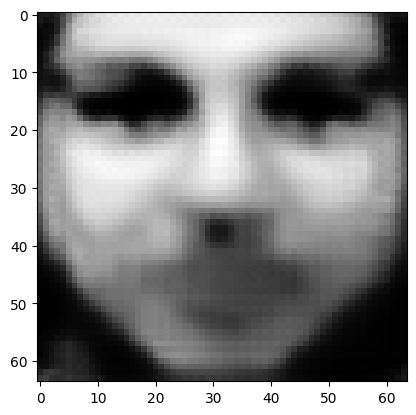

tensor([[6.1138e-07, 9.5486e-07, 1.8031e-03, 1.7332e-04, 2.3754e-05, 5.2229e-07,
         3.9985e-03, 4.4628e-06, 9.3792e-01, 4.3213e-03, 6.5435e-04, 1.9626e-04,
         5.5375e-04, 1.2376e-05, 5.7886e-04, 2.9918e-05, 8.0239e-04, 7.1571e-05,
         1.2292e-04, 3.6468e-04, 9.8193e-04, 1.5430e-03, 3.9521e-03, 5.3556e-04,
         4.8472e-03, 4.3571e-06, 1.3833e-04, 4.4612e-03, 1.2501e-02, 1.8439e-03,
         6.7262e-04, 7.0280e-07, 2.1164e-03, 5.4940e-05, 5.1878e-03, 3.8364e-05,
         2.8170e-04, 4.5181e-03, 2.9863e-03, 1.6954e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06408528983592987
tensor([[6.0385e-07, 9.4322e-07, 1.7907e-03, 1.7180e-04, 2.3523e-05, 5.1850e-07,
         3.9744e-03, 4.4196e-06, 9.3833e-01, 4.3013e-03, 6.5004e-04, 1.9442e-04,
         5.4908e-04, 1.2224e-05, 5.7504e-04, 2.9707e-05, 7.9610e-04, 7.1122e-05,
         1.2189e-04, 3.6273e-04, 9.7198e-04, 1.5306e-03, 3.9318e-03, 5.3133e-04,
         4.8071e-03, 4.3049e-06, 1.3717e-0

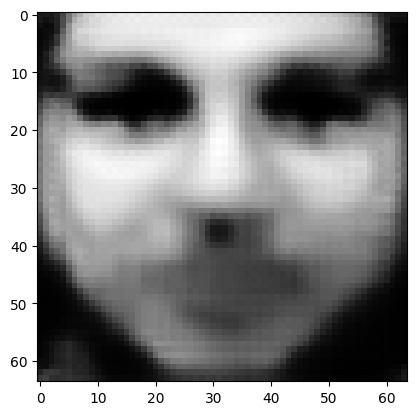

tensor([[5.7637e-07, 9.0025e-07, 1.7443e-03, 1.6622e-04, 2.2667e-05, 5.0433e-07,
         3.8860e-03, 4.2606e-06, 9.3983e-01, 4.2276e-03, 6.3386e-04, 1.8764e-04,
         5.3168e-04, 1.1663e-05, 5.6076e-04, 2.8914e-05, 7.7266e-04, 6.9440e-05,
         1.1810e-04, 3.5544e-04, 9.3506e-04, 1.4844e-03, 3.8569e-03, 5.1581e-04,
         4.6579e-03, 4.1141e-06, 1.3286e-04, 4.3210e-03, 1.2218e-02, 1.7986e-03,
         6.4525e-04, 6.6317e-07, 2.0526e-03, 5.2284e-05, 5.0120e-03, 3.6875e-05,
         2.6784e-04, 4.3531e-03, 2.8717e-03, 1.6279e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.062054671347141266
tensor([[5.6991e-07, 8.9030e-07, 1.7331e-03, 1.6489e-04, 2.2466e-05, 5.0093e-07,
         3.8649e-03, 4.2232e-06, 9.4019e-01, 4.2105e-03, 6.3010e-04, 1.8605e-04,
         5.2747e-04, 1.1531e-05, 5.5742e-04, 2.8729e-05, 7.6713e-04, 6.9038e-05,
         1.1721e-04, 3.5374e-04, 9.2643e-04, 1.4736e-03, 3.8392e-03, 5.1220e-04,
         4.6228e-03, 4.0696e-06, 1.3185e-

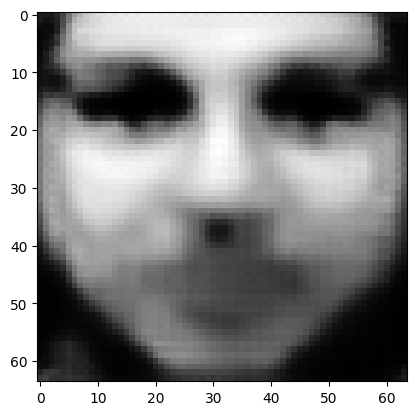

tensor([[5.4580e-07, 8.5322e-07, 1.6911e-03, 1.5990e-04, 2.1719e-05, 4.8813e-07,
         3.7851e-03, 4.0825e-06, 9.4153e-01, 4.1448e-03, 6.1591e-04, 1.8013e-04,
         5.1174e-04, 1.1044e-05, 5.4481e-04, 2.8030e-05, 7.4641e-04, 6.7530e-05,
         1.1387e-04, 3.4728e-04, 8.9434e-04, 1.4330e-03, 3.7724e-03, 4.9859e-04,
         4.4913e-03, 3.9042e-06, 1.2805e-04, 4.1984e-03, 1.1962e-02, 1.7580e-03,
         6.2131e-04, 6.2904e-07, 1.9949e-03, 4.9977e-05, 4.8573e-03, 3.5571e-05,
         2.5571e-04, 4.2039e-03, 2.7702e-03, 1.5692e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060253068804740906
tensor([[5.4022e-07, 8.4459e-07, 1.6810e-03, 1.5874e-04, 2.1545e-05, 4.8511e-07,
         3.7664e-03, 4.0496e-06, 9.4184e-01, 4.1293e-03, 6.1252e-04, 1.7875e-04,
         5.0803e-04, 1.0930e-05, 5.4182e-04, 2.7866e-05, 7.4153e-04, 6.7175e-05,
         1.1309e-04, 3.4575e-04, 8.8679e-04, 1.4234e-03, 3.7565e-03, 4.9542e-04,
         4.4605e-03, 3.8657e-06, 1.2715e-

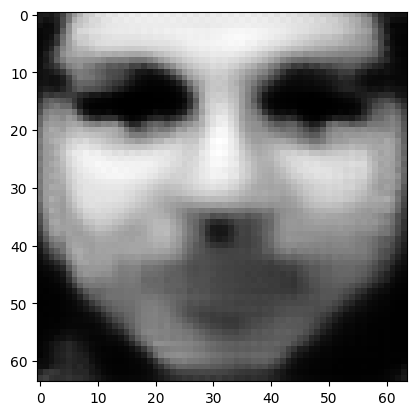

tensor([[5.1922e-07, 8.1238e-07, 1.6434e-03, 1.5436e-04, 2.0891e-05, 4.7375e-07,
         3.6956e-03, 3.9254e-06, 9.4304e-01, 4.0693e-03, 5.9977e-04, 1.7357e-04,
         4.9409e-04, 1.0508e-05, 5.3051e-04, 2.7245e-05, 7.2318e-04, 6.5836e-05,
         1.1014e-04, 3.3991e-04, 8.5864e-04, 1.3874e-03, 3.6959e-03, 4.8340e-04,
         4.3445e-03, 3.7225e-06, 1.2381e-04, 4.0887e-03, 1.1728e-02, 1.7212e-03,
         6.0029e-04, 5.9953e-07, 1.9434e-03, 4.7949e-05, 4.7190e-03, 3.4415e-05,
         2.4505e-04, 4.0715e-03, 2.6802e-03, 1.5173e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05864519253373146
tensor([[5.1430e-07, 8.0485e-07, 1.6345e-03, 1.5333e-04, 2.0738e-05, 4.7105e-07,
         3.6787e-03, 3.8962e-06, 9.4332e-01, 4.0549e-03, 5.9677e-04, 1.7236e-04,
         4.9080e-04, 1.0409e-05, 5.2786e-04, 2.7098e-05, 7.1886e-04, 6.5519e-05,
         1.0944e-04, 3.3852e-04, 8.5207e-04, 1.3789e-03, 3.6815e-03, 4.8056e-04,
         4.3173e-03, 3.6891e-06, 1.2303e-0

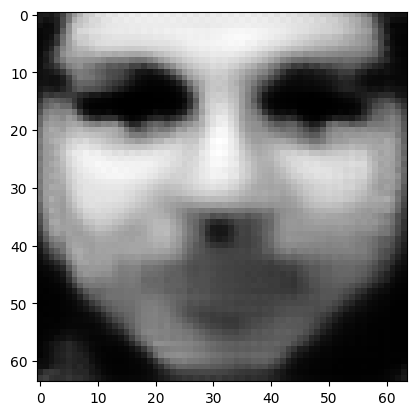

tensor([[4.9593e-07, 7.7665e-07, 1.6008e-03, 1.4943e-04, 2.0157e-05, 4.6088e-07,
         3.6150e-03, 3.7864e-06, 9.4440e-01, 4.0004e-03, 5.8536e-04, 1.6777e-04,
         4.7836e-04, 1.0040e-05, 5.1773e-04, 2.6538e-05, 7.0249e-04, 6.4319e-05,
         1.0682e-04, 3.3327e-04, 8.2716e-04, 1.3468e-03, 3.6266e-03, 4.6984e-04,
         4.2146e-03, 3.5635e-06, 1.2006e-04, 3.9905e-03, 1.1517e-02, 1.6881e-03,
         5.8168e-04, 5.7369e-07, 1.8973e-03, 4.6161e-05, 4.5953e-03, 3.3381e-05,
         2.3567e-04, 3.9539e-03, 2.6004e-03, 1.4711e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05720901861786842
tensor([[4.9163e-07, 7.7005e-07, 1.5929e-03, 1.4852e-04, 2.0023e-05, 4.5849e-07,
         3.6001e-03, 3.7605e-06, 9.4465e-01, 3.9874e-03, 5.8266e-04, 1.6669e-04,
         4.7544e-04, 9.9539e-06, 5.1534e-04, 2.6405e-05, 6.9867e-04, 6.4034e-05,
         1.0621e-04, 3.3202e-04, 8.2134e-04, 1.3393e-03, 3.6137e-03, 4.6731e-04,
         4.1905e-03, 3.5345e-06, 1.1936e-0

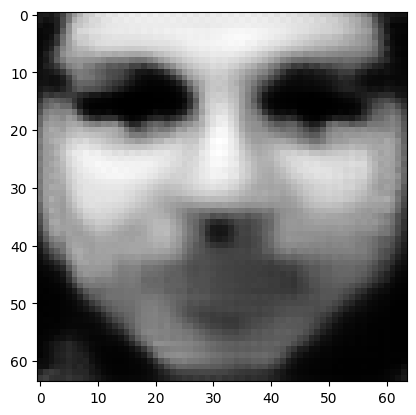

tensor([[4.7544e-07, 7.4512e-07, 1.5625e-03, 1.4506e-04, 1.9514e-05, 4.4937e-07,
         3.5437e-03, 3.6617e-06, 9.4562e-01, 3.9370e-03, 5.7229e-04, 1.6261e-04,
         4.6430e-04, 9.6284e-06, 5.0619e-04, 2.5892e-05, 6.8421e-04, 6.2942e-05,
         1.0387e-04, 3.2718e-04, 7.9912e-04, 1.3108e-03, 3.5647e-03, 4.5764e-04,
         4.0985e-03, 3.4253e-06, 1.1669e-04, 3.9026e-03, 1.1321e-02, 1.6578e-03,
         5.6533e-04, 5.5115e-07, 1.8559e-03, 4.4577e-05, 4.4845e-03, 3.2463e-05,
         2.2743e-04, 3.8488e-03, 2.5292e-03, 1.4292e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05591721832752228
tensor([[4.7161e-07, 7.3925e-07, 1.5552e-03, 1.4425e-04, 1.9393e-05, 4.4720e-07,
         3.5302e-03, 3.6383e-06, 9.4585e-01, 3.9249e-03, 5.6982e-04, 1.6164e-04,
         4.6164e-04, 9.5518e-06, 5.0403e-04, 2.5770e-05, 6.8077e-04, 6.2683e-05,
         1.0332e-04, 3.2603e-04, 7.9388e-04, 1.3041e-03, 3.5530e-03, 4.5535e-04,
         4.0767e-03, 3.3997e-06, 1.1606e-0

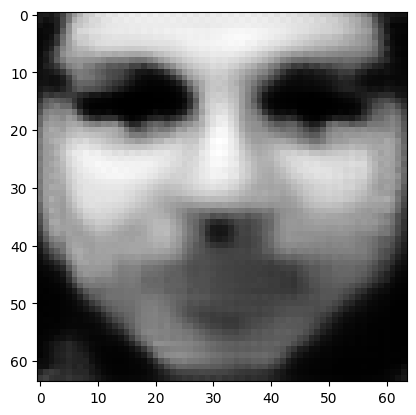

tensor([[4.5720e-07, 7.1698e-07, 1.5272e-03, 1.4111e-04, 1.8935e-05, 4.3889e-07,
         3.4785e-03, 3.5490e-06, 9.4673e-01, 3.8788e-03, 5.6032e-04, 1.5798e-04,
         4.5161e-04, 9.2602e-06, 4.9576e-04, 2.5302e-05, 6.6761e-04, 6.1697e-05,
         1.0120e-04, 3.2162e-04, 7.7393e-04, 1.2782e-03, 3.5084e-03, 4.4665e-04,
         3.9932e-03, 3.3018e-06, 1.1364e-04, 3.8225e-03, 1.1142e-02, 1.6301e-03,
         5.5061e-04, 5.3100e-07, 1.8181e-03, 4.3153e-05, 4.3840e-03, 3.1634e-05,
         2.2002e-04, 3.7529e-03, 2.4648e-03, 1.3913e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05474225804209709
tensor([[4.5375e-07, 7.1167e-07, 1.5205e-03, 1.4036e-04, 1.8827e-05, 4.3689e-07,
         3.4658e-03, 3.5275e-06, 9.4694e-01, 3.8677e-03, 5.5805e-04, 1.5710e-04,
         4.4920e-04, 9.1908e-06, 4.9380e-04, 2.5190e-05, 6.6445e-04, 6.1460e-05,
         1.0069e-04, 3.2057e-04, 7.6919e-04, 1.2720e-03, 3.4979e-03, 4.4455e-04,
         3.9731e-03, 3.2784e-06, 1.1306e-0

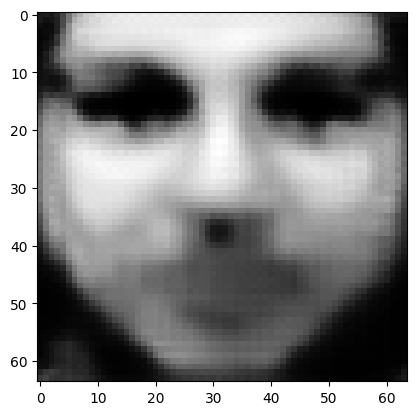

tensor([[4.4076e-07, 6.9157e-07, 1.4947e-03, 1.3748e-04, 1.8415e-05, 4.2928e-07,
         3.4174e-03, 3.4461e-06, 9.4775e-01, 3.8259e-03, 5.4940e-04, 1.5378e-04,
         4.4005e-04, 8.9279e-06, 4.8634e-04, 2.4762e-05, 6.5241e-04, 6.0559e-05,
         9.8752e-05, 3.1652e-04, 7.5123e-04, 1.2482e-03, 3.4579e-03, 4.3660e-04,
         3.8969e-03, 3.1898e-06, 1.1085e-04, 3.7488e-03, 1.0976e-02, 1.6050e-03,
         5.3720e-04, 5.1277e-07, 1.7833e-03, 4.1863e-05, 4.2928e-03, 3.0882e-05,
         2.1329e-04, 3.6645e-03, 2.4061e-03, 1.3571e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.053667377680540085
tensor([[4.3768e-07, 6.8681e-07, 1.4886e-03, 1.3679e-04, 1.8316e-05, 4.2747e-07,
         3.4057e-03, 3.4267e-06, 9.4794e-01, 3.8158e-03, 5.4734e-04, 1.5298e-04,
         4.3791e-04, 8.8661e-06, 4.8455e-04, 2.4660e-05, 6.4954e-04, 6.0345e-05,
         9.8286e-05, 3.1555e-04, 7.4693e-04, 1.2426e-03, 3.4483e-03, 4.3469e-04,
         3.8787e-03, 3.1686e-06, 1.1032e-

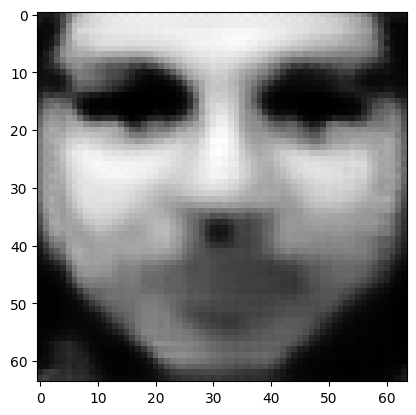

tensor([[4.2603e-07, 6.6880e-07, 1.4652e-03, 1.3417e-04, 1.7943e-05, 4.2053e-07,
         3.3615e-03, 3.3531e-06, 9.4867e-01, 3.7774e-03, 5.3949e-04, 1.4997e-04,
         4.2961e-04, 8.6304e-06, 4.7775e-04, 2.4271e-05, 6.3859e-04, 5.9524e-05,
         9.6529e-05, 3.1187e-04, 7.3067e-04, 1.2210e-03, 3.4114e-03, 4.2747e-04,
         3.8094e-03, 3.0888e-06, 1.0832e-04, 3.6816e-03, 1.0825e-02, 1.5821e-03,
         5.2504e-04, 4.9638e-07, 1.7516e-03, 4.0702e-05, 4.2098e-03, 3.0202e-05,
         2.0722e-04, 3.5843e-03, 2.3528e-03, 1.3260e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05268961936235428
tensor([[4.2327e-07, 6.6452e-07, 1.4595e-03, 1.3355e-04, 1.7854e-05, 4.1887e-07,
         3.3510e-03, 3.3356e-06, 9.4885e-01, 3.7682e-03, 5.3760e-04, 1.4926e-04,
         4.2761e-04, 8.5739e-06, 4.7612e-04, 2.4178e-05, 6.3597e-04, 5.9327e-05,
         9.6113e-05, 3.1099e-04, 7.2677e-04, 1.2159e-03, 3.4025e-03, 4.2575e-04,
         3.7930e-03, 3.0698e-06, 1.0784e-0

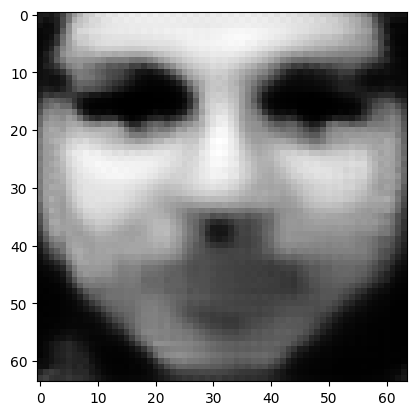

tensor([[4.1266e-07, 6.4825e-07, 1.4382e-03, 1.3117e-04, 1.7514e-05, 4.1253e-07,
         3.3102e-03, 3.2682e-06, 9.4953e-01, 3.7320e-03, 5.3041e-04, 1.4652e-04,
         4.2007e-04, 8.3629e-06, 4.6989e-04, 2.3821e-05, 6.2597e-04, 5.8580e-05,
         9.4501e-05, 3.0761e-04, 7.1210e-04, 1.1962e-03, 3.3684e-03, 4.1912e-04,
         3.7292e-03, 2.9978e-06, 1.0602e-04, 3.6200e-03, 1.0685e-02, 1.5609e-03,
         5.1398e-04, 4.8162e-07, 1.7225e-03, 3.9650e-05, 4.1335e-03, 2.9579e-05,
         2.0171e-04, 3.5110e-03, 2.3042e-03, 1.2977e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05179206654429436
tensor([[4.1012e-07, 6.4440e-07, 1.4332e-03, 1.3061e-04, 1.7434e-05, 4.1103e-07,
         3.3003e-03, 3.2521e-06, 9.4969e-01, 3.7232e-03, 5.2870e-04, 1.4587e-04,
         4.1829e-04, 8.3135e-06, 4.6841e-04, 2.3736e-05, 6.2360e-04, 5.8402e-05,
         9.4115e-05, 3.0681e-04, 7.0867e-04, 1.1915e-03, 3.3603e-03, 4.1753e-04,
         3.7139e-03, 2.9808e-06, 1.0559e-0

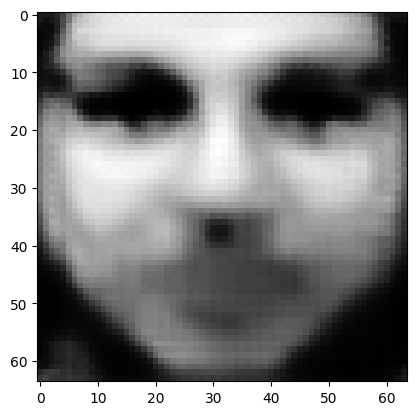

tensor([[4.0045e-07, 6.2970e-07, 1.4139e-03, 1.2846e-04, 1.7124e-05, 4.0523e-07,
         3.2627e-03, 3.1907e-06, 9.5031e-01, 3.6895e-03, 5.2215e-04, 1.4337e-04,
         4.1140e-04, 8.1231e-06, 4.6271e-04, 2.3411e-05, 6.1442e-04, 5.7715e-05,
         9.2647e-05, 3.0376e-04, 6.9540e-04, 1.1735e-03, 3.3286e-03, 4.1145e-04,
         3.6551e-03, 2.9156e-06, 1.0393e-04, 3.5634e-03, 1.0556e-02, 1.5415e-03,
         5.0393e-04, 4.6828e-07, 1.6958e-03, 3.8702e-05, 4.0627e-03, 2.9007e-05,
         1.9671e-04, 3.4440e-03, 2.2600e-03, 1.2718e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05096791312098503
tensor([[3.9813e-07, 6.2621e-07, 1.4093e-03, 1.2794e-04, 1.7050e-05, 4.0384e-07,
         3.2537e-03, 3.1759e-06, 9.5046e-01, 3.6812e-03, 5.2059e-04, 1.4277e-04,
         4.0977e-04, 8.0783e-06, 4.6134e-04, 2.3334e-05, 6.1223e-04, 5.7552e-05,
         9.2295e-05, 3.0303e-04, 6.9224e-04, 1.1692e-03, 3.3208e-03, 4.0999e-04,
         3.6410e-03, 2.9000e-06, 1.0354e-0

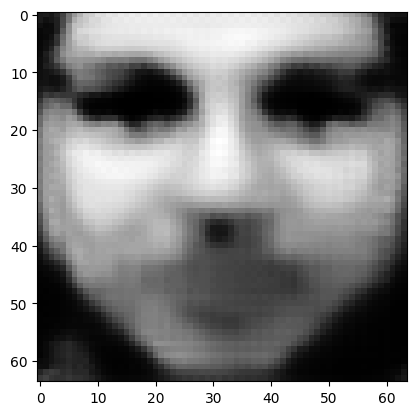

tensor([[3.8932e-07, 6.1288e-07, 1.3916e-03, 1.2598e-04, 1.6766e-05, 3.9852e-07,
         3.2190e-03, 3.1196e-06, 9.5103e-01, 3.6496e-03, 5.1455e-04, 1.4048e-04,
         4.0351e-04, 7.9059e-06, 4.5611e-04, 2.3036e-05, 6.0379e-04, 5.6923e-05,
         9.0945e-05, 3.0023e-04, 6.8015e-04, 1.1527e-03, 3.2913e-03, 4.0441e-04,
         3.5868e-03, 2.8406e-06, 1.0203e-04, 3.5112e-03, 1.0437e-02, 1.5237e-03,
         4.9473e-04, 4.5616e-07, 1.6712e-03, 3.7838e-05, 3.9971e-03, 2.8484e-05,
         1.9214e-04, 3.3826e-03, 2.2194e-03, 1.2480e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05020827054977417
tensor([[3.8722e-07, 6.0971e-07, 1.3873e-03, 1.2551e-04, 1.6699e-05, 3.9725e-07,
         3.2107e-03, 3.1063e-06, 9.5117e-01, 3.6420e-03, 5.1310e-04, 1.3994e-04,
         4.0200e-04, 7.8649e-06, 4.5484e-04, 2.2965e-05, 6.0178e-04, 5.6772e-05,
         9.0624e-05, 2.9956e-04, 6.7725e-04, 1.1488e-03, 3.2842e-03, 4.0308e-04,
         3.5740e-03, 2.8265e-06, 1.0167e-0

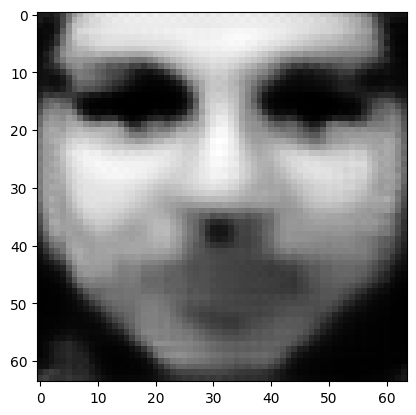

tensor([[3.7922e-07, 5.9763e-07, 1.3710e-03, 1.2371e-04, 1.6440e-05, 3.9238e-07,
         3.1789e-03, 3.0548e-06, 9.5170e-01, 3.6126e-03, 5.0755e-04, 1.3786e-04,
         3.9628e-04, 7.7091e-06, 4.5001e-04, 2.2692e-05, 5.9407e-04, 5.6196e-05,
         8.9389e-05, 2.9697e-04, 6.6624e-04, 1.1336e-03, 3.2569e-03, 3.9796e-04,
         3.5245e-03, 2.7727e-06, 1.0029e-04, 3.4632e-03, 1.0326e-02, 1.5071e-03,
         4.8634e-04, 4.4519e-07, 1.6487e-03, 3.7050e-05, 3.9368e-03, 2.8003e-05,
         1.8798e-04, 3.3263e-03, 2.1822e-03, 1.2262e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.049510110169649124
tensor([[3.7734e-07, 5.9474e-07, 1.3671e-03, 1.2329e-04, 1.6378e-05, 3.9122e-07,
         3.1713e-03, 3.0425e-06, 9.5182e-01, 3.6057e-03, 5.0620e-04, 1.3735e-04,
         3.9490e-04, 7.6713e-06, 4.4886e-04, 2.2626e-05, 5.9221e-04, 5.6057e-05,
         8.9093e-05, 2.9634e-04, 6.6359e-04, 1.1300e-03, 3.2503e-03, 3.9674e-04,
         3.5126e-03, 2.7597e-06, 9.9952e-

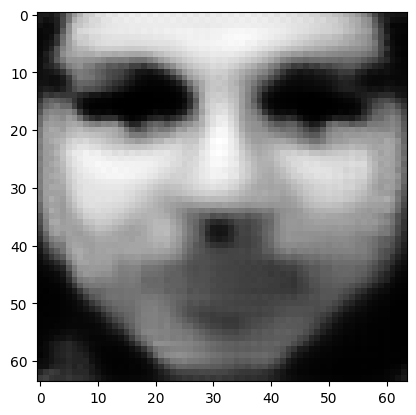

tensor([[3.7004e-07, 5.8373e-07, 1.3520e-03, 1.2164e-04, 1.6142e-05, 3.8674e-07,
         3.1419e-03, 2.9954e-06, 9.5231e-01, 3.5782e-03, 5.0107e-04, 1.3545e-04,
         3.8964e-04, 7.5296e-06, 4.4439e-04, 2.2374e-05, 5.8511e-04, 5.5527e-05,
         8.7956e-05, 2.9393e-04, 6.5350e-04, 1.1160e-03, 3.2250e-03, 3.9203e-04,
         3.4673e-03, 2.7107e-06, 9.8686e-05, 3.4189e-03, 1.0223e-02, 1.4918e-03,
         4.7862e-04, 4.3518e-07, 1.6278e-03, 3.6328e-05, 3.8812e-03, 2.7561e-05,
         1.8417e-04, 3.2745e-03, 2.1480e-03, 1.2061e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04886584356427193
tensor([[3.6830e-07, 5.8109e-07, 1.3484e-03, 1.2124e-04, 1.6084e-05, 3.8566e-07,
         3.1348e-03, 2.9841e-06, 9.5243e-01, 3.5717e-03, 4.9982e-04, 1.3498e-04,
         3.8838e-04, 7.4953e-06, 4.4332e-04, 2.2313e-05, 5.8340e-04, 5.5399e-05,
         8.7682e-05, 2.9335e-04, 6.5107e-04, 1.1127e-03, 3.2189e-03, 3.9089e-04,
         3.4563e-03, 2.6989e-06, 9.8379e-0

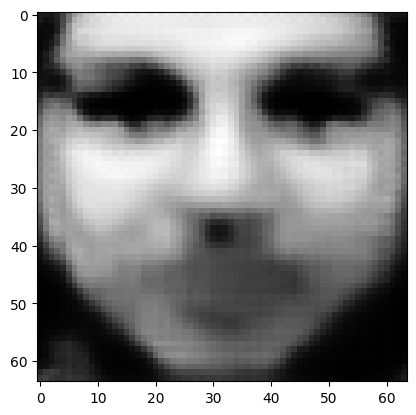

tensor([[3.6164e-07, 5.7101e-07, 1.3345e-03, 1.1973e-04, 1.5867e-05, 3.8153e-07,
         3.1077e-03, 2.9408e-06, 9.5288e-01, 3.5462e-03, 4.9506e-04, 1.3323e-04,
         3.8353e-04, 7.3653e-06, 4.3918e-04, 2.2080e-05, 5.7685e-04, 5.4909e-05,
         8.6634e-05, 2.9111e-04, 6.4180e-04, 1.0998e-03, 3.1954e-03, 3.8655e-04,
         3.4145e-03, 2.6541e-06, 9.7210e-05, 3.3779e-03, 1.0128e-02, 1.4774e-03,
         4.7151e-04, 4.2603e-07, 1.6086e-03, 3.5663e-05, 3.8296e-03, 2.7151e-05,
         1.8067e-04, 3.2268e-03, 2.1164e-03, 1.1876e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.048270002007484436
tensor([[3.6004e-07, 5.6859e-07, 1.3311e-03, 1.1936e-04, 1.5814e-05, 3.8053e-07,
         3.1011e-03, 2.9304e-06, 9.5299e-01, 3.5400e-03, 4.9391e-04, 1.3281e-04,
         3.8238e-04, 7.3343e-06, 4.3819e-04, 2.2024e-05, 5.7527e-04, 5.4791e-05,
         8.6380e-05, 2.9057e-04, 6.3957e-04, 1.0967e-03, 3.1897e-03, 3.8549e-04,
         3.4044e-03, 2.6433e-06, 9.6929e-

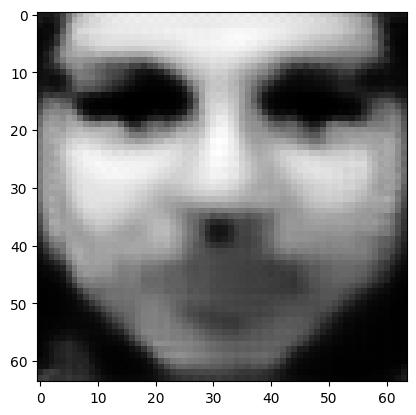

tensor([[3.5387e-07, 5.5927e-07, 1.3181e-03, 1.1795e-04, 1.5613e-05, 3.7668e-07,
         3.0755e-03, 2.8901e-06, 9.5341e-01, 3.5162e-03, 4.8947e-04, 1.3118e-04,
         3.7785e-04, 7.2140e-06, 4.3435e-04, 2.1807e-05, 5.6917e-04, 5.4334e-05,
         8.5406e-05, 2.8848e-04, 6.3098e-04, 1.0847e-03, 3.1678e-03, 3.8145e-04,
         3.3656e-03, 2.6017e-06, 9.5840e-05, 3.3396e-03, 1.0038e-02, 1.4641e-03,
         4.6491e-04, 4.1760e-07, 1.5905e-03, 3.5049e-05, 3.7817e-03, 2.6771e-05,
         1.7743e-04, 3.1824e-03, 2.0871e-03, 1.1704e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047715067863464355
tensor([[3.5240e-07, 5.5704e-07, 1.3149e-03, 1.1761e-04, 1.5564e-05, 3.7575e-07,
         3.0694e-03, 2.8805e-06, 9.5351e-01, 3.5106e-03, 4.8840e-04, 1.3079e-04,
         3.7674e-04, 7.1849e-06, 4.3342e-04, 2.1754e-05, 5.6770e-04, 5.4223e-05,
         8.5173e-05, 2.8798e-04, 6.2891e-04, 1.0818e-03, 3.1625e-03, 3.8049e-04,
         3.3562e-03, 2.5918e-06, 9.5576e-

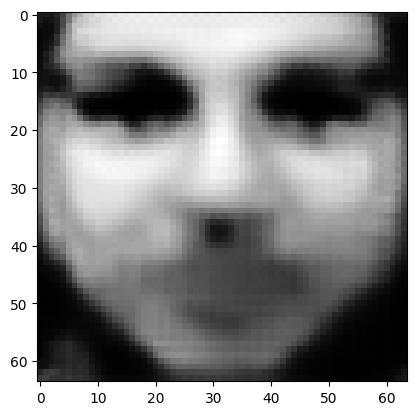

tensor([[3.4666e-07, 5.4846e-07, 1.3029e-03, 1.1632e-04, 1.5379e-05, 3.7219e-07,
         3.0453e-03, 2.8430e-06, 9.5390e-01, 3.4879e-03, 4.8428e-04, 1.2928e-04,
         3.7257e-04, 7.0750e-06, 4.2989e-04, 2.1551e-05, 5.6200e-04, 5.3803e-05,
         8.4261e-05, 2.8607e-04, 6.2106e-04, 1.0707e-03, 3.1422e-03, 3.7670e-04,
         3.3195e-03, 2.5536e-06, 9.4566e-05, 3.3038e-03, 9.9544e-03, 1.4517e-03,
         4.5880e-04, 4.0981e-07, 1.5738e-03, 3.4484e-05, 3.7369e-03, 2.6418e-05,
         1.7443e-04, 3.1411e-03, 2.0599e-03, 1.1544e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04719734936952591
tensor([[3.4528e-07, 5.4640e-07, 1.3001e-03, 1.1601e-04, 1.5334e-05, 3.7133e-07,
         3.0395e-03, 2.8339e-06, 9.5399e-01, 3.4824e-03, 4.8329e-04, 1.2891e-04,
         3.7156e-04, 7.0489e-06, 4.2904e-04, 2.1503e-05, 5.6064e-04, 5.3702e-05,
         8.4042e-05, 2.8561e-04, 6.1919e-04, 1.0680e-03, 3.1373e-03, 3.7578e-04,
         3.3107e-03, 2.5445e-06, 9.4325e-0

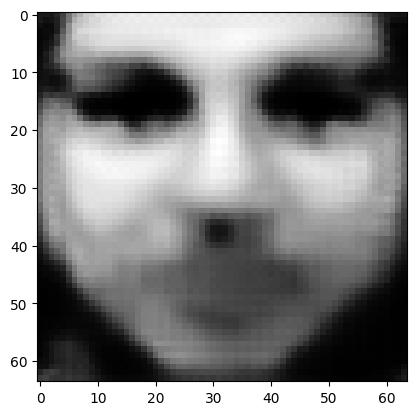

tensor([[3.3998e-07, 5.3848e-07, 1.2890e-03, 1.1481e-04, 1.5162e-05, 3.6802e-07,
         3.0169e-03, 2.7990e-06, 9.5436e-01, 3.4611e-03, 4.7946e-04, 1.2751e-04,
         3.6769e-04, 6.9475e-06, 4.2576e-04, 2.1314e-05, 5.5534e-04, 5.3311e-05,
         8.3194e-05, 2.8384e-04, 6.1195e-04, 1.0577e-03, 3.1184e-03, 3.7225e-04,
         3.2764e-03, 2.5091e-06, 9.3388e-05, 3.2703e-03, 9.8759e-03, 1.4402e-03,
         4.5314e-04, 4.0263e-07, 1.5583e-03, 3.3963e-05, 3.6950e-03, 2.6090e-05,
         1.7166e-04, 3.1028e-03, 2.0346e-03, 1.1396e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046714406460523605
tensor([[3.3870e-07, 5.3659e-07, 1.2863e-03, 1.1452e-04, 1.5121e-05, 3.6722e-07,
         3.0115e-03, 2.7906e-06, 9.5445e-01, 3.4559e-03, 4.7854e-04, 1.2718e-04,
         3.6676e-04, 6.9234e-06, 4.2497e-04, 2.1269e-05, 5.5406e-04, 5.3218e-05,
         8.2990e-05, 2.8341e-04, 6.1022e-04, 1.0552e-03, 3.1138e-03, 3.7140e-04,
         3.2682e-03, 2.5007e-06, 9.3164e-

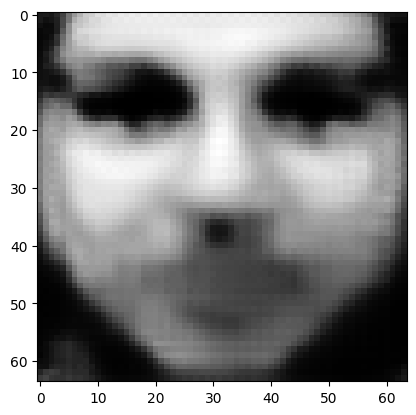

tensor([[3.3383e-07, 5.2927e-07, 1.2759e-03, 1.1340e-04, 1.4962e-05, 3.6415e-07,
         2.9905e-03, 2.7584e-06, 9.5479e-01, 3.4362e-03, 4.7496e-04, 1.2588e-04,
         3.6315e-04, 6.8294e-06, 4.2191e-04, 2.1093e-05, 5.4914e-04, 5.2854e-05,
         8.2203e-05, 2.8175e-04, 6.0349e-04, 1.0456e-03, 3.0962e-03, 3.6813e-04,
         3.2365e-03, 2.4681e-06, 9.2290e-05, 3.2391e-03, 9.8024e-03, 1.4295e-03,
         4.4789e-04, 3.9600e-07, 1.5437e-03, 3.3479e-05, 3.6562e-03, 2.5785e-05,
         1.6909e-04, 3.0672e-03, 2.0112e-03, 1.1258e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046265147626399994
tensor([[3.3265e-07, 5.2752e-07, 1.2734e-03, 1.1314e-04, 1.4924e-05, 3.6341e-07,
         2.9854e-03, 2.7506e-06, 9.5487e-01, 3.4314e-03, 4.7410e-04, 1.2557e-04,
         3.6228e-04, 6.8071e-06, 4.2118e-04, 2.1051e-05, 5.4796e-04, 5.2766e-05,
         8.2014e-05, 2.8135e-04, 6.0188e-04, 1.0432e-03, 3.0919e-03, 3.6734e-04,
         3.2289e-03, 2.4603e-06, 9.2082e-

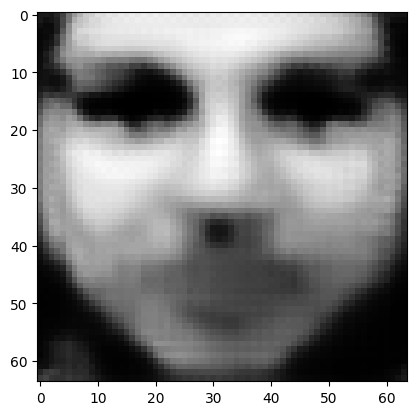

tensor([[3.2815e-07, 5.2076e-07, 1.2637e-03, 1.1210e-04, 1.4776e-05, 3.6055e-07,
         2.9659e-03, 2.7207e-06, 9.5519e-01, 3.4128e-03, 4.7075e-04, 1.2437e-04,
         3.5893e-04, 6.7205e-06, 4.1832e-04, 2.0887e-05, 5.4338e-04, 5.2428e-05,
         8.1282e-05, 2.7980e-04, 5.9565e-04, 1.0343e-03, 3.0754e-03, 3.6429e-04,
         3.1995e-03, 2.4302e-06, 9.1272e-05, 3.2101e-03, 9.7336e-03, 1.4194e-03,
         4.4302e-04, 3.8988e-07, 1.5302e-03, 3.3031e-05, 3.6199e-03, 2.5500e-05,
         1.6671e-04, 3.0342e-03, 1.9893e-03, 1.1130e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04584620147943497
tensor([[3.2706e-07, 5.1914e-07, 1.2614e-03, 1.1185e-04, 1.4741e-05, 3.5986e-07,
         2.9612e-03, 2.7134e-06, 9.5527e-01, 3.4082e-03, 4.6995e-04, 1.2408e-04,
         3.5813e-04, 6.7000e-06, 4.1762e-04, 2.0847e-05, 5.4228e-04, 5.2347e-05,
         8.1106e-05, 2.7942e-04, 5.9415e-04, 1.0321e-03, 3.0714e-03, 3.6355e-04,
         3.1924e-03, 2.4230e-06, 9.1078e-0

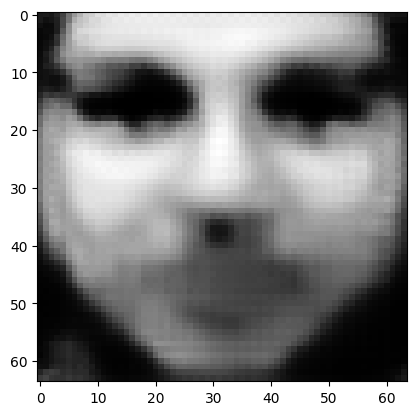

tensor([[3.2292e-07, 5.1291e-07, 1.2525e-03, 1.1090e-04, 1.4604e-05, 3.5720e-07,
         2.9431e-03, 2.6860e-06, 9.5556e-01, 3.3913e-03, 4.6688e-04, 1.2296e-04,
         3.5504e-04, 6.6202e-06, 4.1500e-04, 2.0696e-05, 5.3805e-04, 5.2031e-05,
         8.0434e-05, 2.7799e-04, 5.8840e-04, 1.0239e-03, 3.0562e-03, 3.6075e-04,
         3.1651e-03, 2.3954e-06, 9.0332e-05, 3.1834e-03, 9.6699e-03, 1.4100e-03,
         4.3849e-04, 3.8423e-07, 1.5176e-03, 3.2617e-05, 3.5863e-03, 2.5238e-05,
         1.6452e-04, 3.0034e-03, 1.9692e-03, 1.1011e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04545886442065239
tensor([[3.2193e-07, 5.1142e-07, 1.2504e-03, 1.1068e-04, 1.4571e-05, 3.5657e-07,
         2.9388e-03, 2.6795e-06, 9.5563e-01, 3.3872e-03, 4.6616e-04, 1.2270e-04,
         3.5430e-04, 6.6013e-06, 4.1437e-04, 2.0659e-05, 5.3704e-04, 5.1956e-05,
         8.0274e-05, 2.7764e-04, 5.8704e-04, 1.0219e-03, 3.0526e-03, 3.6008e-04,
         3.1586e-03, 2.3889e-06, 9.0156e-0

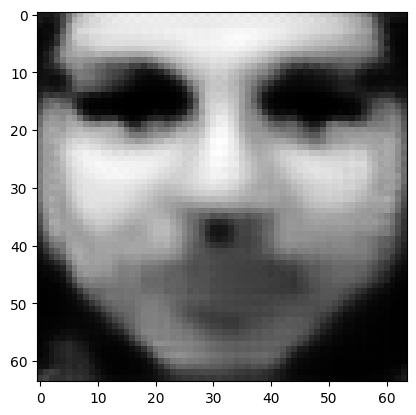

tensor([[3.1814e-07, 5.0567e-07, 1.2422e-03, 1.0980e-04, 1.4445e-05, 3.5411e-07,
         2.9223e-03, 2.6543e-06, 9.5590e-01, 3.3716e-03, 4.6332e-04, 1.2168e-04,
         3.5146e-04, 6.5280e-06, 4.1194e-04, 2.0519e-05, 5.3313e-04, 5.1664e-05,
         7.9657e-05, 2.7631e-04, 5.8172e-04, 1.0143e-03, 3.0387e-03, 3.5751e-04,
         3.1333e-03, 2.3636e-06, 8.9468e-05, 3.1589e-03, 9.6109e-03, 1.4012e-03,
         4.3429e-04, 3.7905e-07, 1.5060e-03, 3.2235e-05, 3.5553e-03, 2.4997e-05,
         1.6250e-04, 2.9749e-03, 1.9506e-03, 1.0901e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045101914554834366
tensor([[3.1722e-07, 5.0429e-07, 1.2402e-03, 1.0959e-04, 1.4414e-05, 3.5352e-07,
         2.9183e-03, 2.6483e-06, 9.5597e-01, 3.3678e-03, 4.6264e-04, 1.2143e-04,
         3.5077e-04, 6.5105e-06, 4.1135e-04, 2.0485e-05, 5.3219e-04, 5.1593e-05,
         7.9507e-05, 2.7598e-04, 5.8045e-04, 1.0124e-03, 3.0353e-03, 3.5689e-04,
         3.1272e-03, 2.3576e-06, 8.9304e-

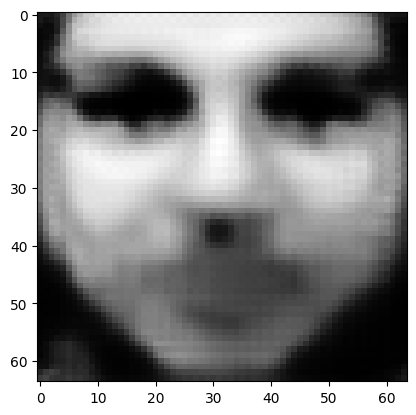

tensor([[3.1370e-07, 4.9895e-07, 1.2326e-03, 1.0877e-04, 1.4297e-05, 3.5122e-07,
         2.9028e-03, 2.6249e-06, 9.5622e-01, 3.3532e-03, 4.5998e-04, 1.2048e-04,
         3.4812e-04, 6.4423e-06, 4.0907e-04, 2.0353e-05, 5.2855e-04, 5.1320e-05,
         7.8932e-05, 2.7473e-04, 5.7550e-04, 1.0053e-03, 3.0224e-03, 3.5449e-04,
         3.1037e-03, 2.3341e-06, 8.8662e-05, 3.1361e-03, 9.5555e-03, 1.3929e-03,
         4.3037e-04, 3.7423e-07, 1.4950e-03, 3.1879e-05, 3.5263e-03, 2.4772e-05,
         1.6063e-04, 2.9483e-03, 1.9333e-03, 1.0799e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044768549501895905
tensor([[3.1285e-07, 4.9767e-07, 1.2307e-03, 1.0858e-04, 1.4268e-05, 3.5067e-07,
         2.8991e-03, 2.6192e-06, 9.5628e-01, 3.3496e-03, 4.5935e-04, 1.2025e-04,
         3.4747e-04, 6.4260e-06, 4.0853e-04, 2.0321e-05, 5.2767e-04, 5.1254e-05,
         7.8793e-05, 2.7443e-04, 5.7431e-04, 1.0036e-03, 3.0192e-03, 3.5391e-04,
         3.0981e-03, 2.3285e-06, 8.8508e-

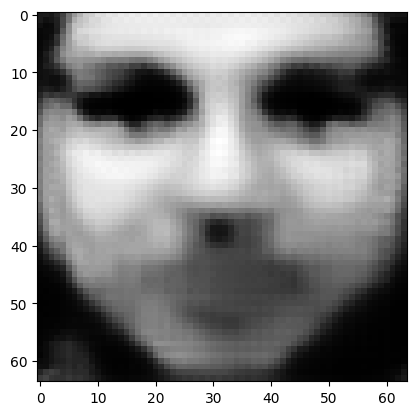

tensor([[3.0958e-07, 4.9272e-07, 1.2236e-03, 1.0782e-04, 1.4159e-05, 3.4853e-07,
         2.8847e-03, 2.5974e-06, 9.5652e-01, 3.3359e-03, 4.5686e-04, 1.1937e-04,
         3.4500e-04, 6.3629e-06, 4.0640e-04, 2.0199e-05, 5.2427e-04, 5.0999e-05,
         7.8257e-05, 2.7325e-04, 5.6970e-04, 9.9691e-04, 3.0070e-03, 3.5168e-04,
         3.0762e-03, 2.3068e-06, 8.7912e-05, 3.1147e-03, 9.5036e-03, 1.3852e-03,
         4.2673e-04, 3.6977e-07, 1.4848e-03, 3.1548e-05, 3.4992e-03, 2.4562e-05,
         1.5888e-04, 2.9235e-03, 1.9171e-03, 1.0703e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04445696622133255
tensor([[3.0879e-07, 4.9152e-07, 1.2219e-03, 1.0763e-04, 1.4132e-05, 3.4801e-07,
         2.8812e-03, 2.5921e-06, 9.5657e-01, 3.3326e-03, 4.5627e-04, 1.1915e-04,
         3.4441e-04, 6.3477e-06, 4.0588e-04, 2.0169e-05, 5.2344e-04, 5.0938e-05,
         7.8126e-05, 2.7297e-04, 5.6859e-04, 9.9529e-04, 3.0041e-03, 3.5113e-04,
         3.0709e-03, 2.3015e-06, 8.7768e-0

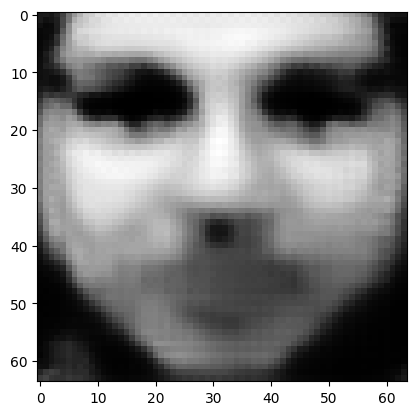

tensor([[3.0575e-07, 4.8690e-07, 1.2151e-03, 1.0692e-04, 1.4030e-05, 3.4601e-07,
         2.8677e-03, 2.5718e-06, 9.5680e-01, 3.3197e-03, 4.5394e-04, 1.1832e-04,
         3.4210e-04, 6.2888e-06, 4.0389e-04, 2.0054e-05, 5.2026e-04, 5.0699e-05,
         7.7625e-05, 2.7187e-04, 5.6429e-04, 9.8907e-04, 2.9927e-03, 3.4904e-04,
         3.0504e-03, 2.2812e-06, 8.7209e-05, 3.0947e-03, 9.4550e-03, 1.3779e-03,
         4.2331e-04, 3.6560e-07, 1.4753e-03, 3.1239e-05, 3.4739e-03, 2.4366e-05,
         1.5726e-04, 2.9002e-03, 1.9020e-03, 1.0613e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044165246188640594
tensor([[3.0501e-07, 4.8579e-07, 1.2135e-03, 1.0675e-04, 1.4005e-05, 3.4552e-07,
         2.8644e-03, 2.5669e-06, 9.5685e-01, 3.3166e-03, 4.5338e-04, 1.1812e-04,
         3.4154e-04, 6.2748e-06, 4.0340e-04, 2.0026e-05, 5.1950e-04, 5.0641e-05,
         7.7504e-05, 2.7160e-04, 5.6325e-04, 9.8756e-04, 2.9899e-03, 3.4854e-04,
         3.0455e-03, 2.2764e-06, 8.7075e-

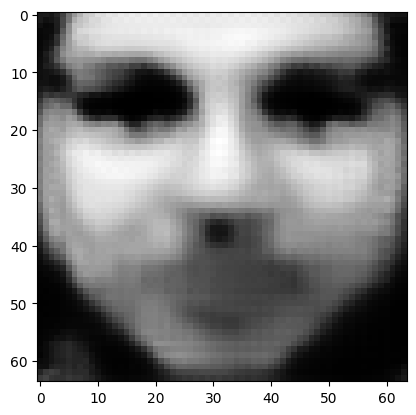

tensor([[3.0218e-07, 4.8149e-07, 1.2072e-03, 1.0609e-04, 1.3909e-05, 3.4365e-07,
         2.8518e-03, 2.5478e-06, 9.5706e-01, 3.3044e-03, 4.5119e-04, 1.1735e-04,
         3.3937e-04, 6.2199e-06, 4.0153e-04, 1.9918e-05, 5.1652e-04, 5.0418e-05,
         7.7034e-05, 2.7056e-04, 5.5922e-04, 9.8173e-04, 2.9791e-03, 3.4657e-04,
         3.0264e-03, 2.2575e-06, 8.6553e-05, 3.0760e-03, 9.4090e-03, 1.3711e-03,
         4.2012e-04, 3.6173e-07, 1.4663e-03, 3.0950e-05, 3.4501e-03, 2.4182e-05,
         1.5573e-04, 2.8785e-03, 1.8878e-03, 1.0530e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04389146715402603
tensor([[3.0150e-07, 4.8045e-07, 1.2057e-03, 1.0593e-04, 1.3886e-05, 3.4320e-07,
         2.8488e-03, 2.5433e-06, 9.5711e-01, 3.3015e-03, 4.5066e-04, 1.1716e-04,
         3.3885e-04, 6.2066e-06, 4.0108e-04, 1.9892e-05, 5.1580e-04, 5.0364e-05,
         7.6922e-05, 2.7031e-04, 5.5825e-04, 9.8032e-04, 2.9766e-03, 3.4611e-04,
         3.0218e-03, 2.2530e-06, 8.6426e-0

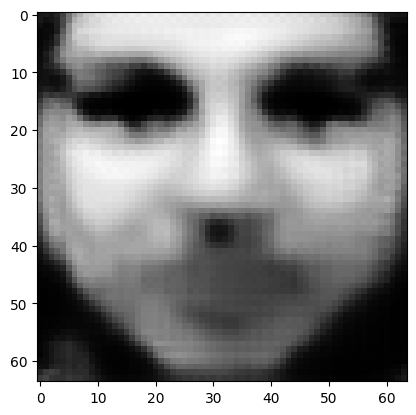

tensor([[2.9886e-07, 4.7644e-07, 1.1998e-03, 1.0531e-04, 1.3797e-05, 3.4145e-07,
         2.8370e-03, 2.5255e-06, 9.5730e-01, 3.2902e-03, 4.4861e-04, 1.1644e-04,
         3.3683e-04, 6.1555e-06, 3.9932e-04, 1.9791e-05, 5.1301e-04, 5.0154e-05,
         7.6484e-05, 2.6933e-04, 5.5449e-04, 9.7487e-04, 2.9665e-03, 3.4428e-04,
         3.0039e-03, 2.2354e-06, 8.5938e-05, 3.0585e-03, 9.3660e-03, 1.3646e-03,
         4.1713e-04, 3.5812e-07, 1.4579e-03, 3.0679e-05, 3.4279e-03, 2.4010e-05,
         1.5432e-04, 2.8581e-03, 1.8746e-03, 1.0451e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04363541677594185
tensor([[2.9822e-07, 4.7547e-07, 1.1984e-03, 1.0516e-04, 1.3775e-05, 3.4102e-07,
         2.8341e-03, 2.5212e-06, 9.5735e-01, 3.2874e-03, 4.4812e-04, 1.1627e-04,
         3.3634e-04, 6.1433e-06, 3.9889e-04, 1.9766e-05, 5.1234e-04, 5.0103e-05,
         7.6378e-05, 2.6909e-04, 5.5358e-04, 9.7355e-04, 2.9641e-03, 3.4383e-04,
         2.9996e-03, 2.2312e-06, 8.5821e-0

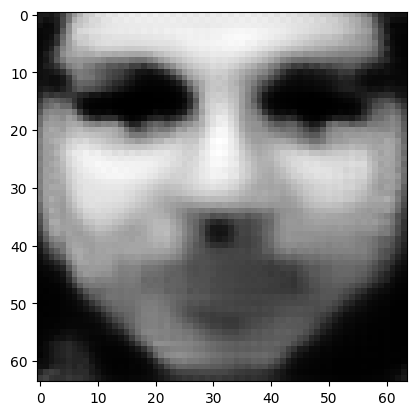

tensor([[2.9577e-07, 4.7173e-07, 1.1929e-03, 1.0458e-04, 1.3692e-05, 3.3938e-07,
         2.8231e-03, 2.5047e-06, 9.5753e-01, 3.2767e-03, 4.4620e-04, 1.1560e-04,
         3.3444e-04, 6.0956e-06, 3.9724e-04, 1.9672e-05, 5.0974e-04, 4.9907e-05,
         7.5969e-05, 2.6817e-04, 5.5007e-04, 9.6844e-04, 2.9546e-03, 3.4212e-04,
         2.9829e-03, 2.2148e-06, 8.5364e-05, 3.0420e-03, 9.3255e-03, 1.3586e-03,
         4.1434e-04, 3.5476e-07, 1.4500e-03, 3.0426e-05, 3.4070e-03, 2.3849e-05,
         1.5299e-04, 2.8391e-03, 1.8622e-03, 1.0378e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0433955080807209
tensor([[2.9517e-07, 4.7083e-07, 1.1916e-03, 1.0444e-04, 1.3672e-05, 3.3898e-07,
         2.8204e-03, 2.5007e-06, 9.5758e-01, 3.2741e-03, 4.4574e-04, 1.1543e-04,
         3.3399e-04, 6.0842e-06, 3.9684e-04, 1.9649e-05, 5.0910e-04, 4.9860e-05,
         7.5869e-05, 2.6795e-04, 5.4923e-04, 9.6721e-04, 2.9524e-03, 3.4170e-04,
         2.9788e-03, 2.2108e-06, 8.5254e-05

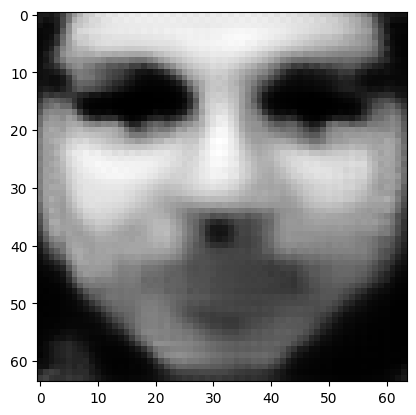

tensor([[2.9289e-07, 4.6735e-07, 1.1864e-03, 1.0390e-04, 1.3594e-05, 3.3745e-07,
         2.8101e-03, 2.4852e-06, 9.5775e-01, 3.2641e-03, 4.4394e-04, 1.1481e-04,
         3.3223e-04, 6.0400e-06, 3.9529e-04, 1.9560e-05, 5.0667e-04, 4.9677e-05,
         7.5485e-05, 2.6709e-04, 5.4595e-04, 9.6243e-04, 2.9435e-03, 3.4010e-04,
         2.9632e-03, 2.1956e-06, 8.4828e-05, 3.0267e-03, 9.2876e-03, 1.3529e-03,
         4.1174e-04, 3.5162e-07, 1.4426e-03, 3.0191e-05, 3.3875e-03, 2.3698e-05,
         1.5176e-04, 2.8213e-03, 1.8506e-03, 1.0310e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04317107051610947
tensor([[2.9234e-07, 4.6651e-07, 1.1851e-03, 1.0377e-04, 1.3575e-05, 3.3708e-07,
         2.8076e-03, 2.4815e-06, 9.5779e-01, 3.2617e-03, 4.4350e-04, 1.1466e-04,
         3.3180e-04, 6.0292e-06, 3.9492e-04, 1.9539e-05, 5.0608e-04, 4.9633e-05,
         7.5393e-05, 2.6688e-04, 5.4516e-04, 9.6128e-04, 2.9414e-03, 3.3972e-04,
         2.9594e-03, 2.1919e-06, 8.4724e-0

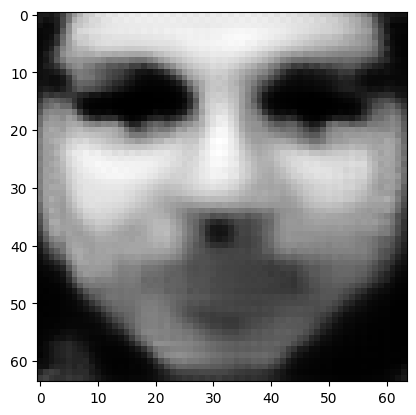

tensor([[2.9022e-07, 4.6328e-07, 1.1803e-03, 1.0327e-04, 1.3502e-05, 3.3565e-07,
         2.7979e-03, 2.4670e-06, 9.5795e-01, 3.2523e-03, 4.4181e-04, 1.1407e-04,
         3.3016e-04, 5.9881e-06, 3.9347e-04, 1.9456e-05, 5.0381e-04, 4.9462e-05,
         7.5035e-05, 2.6608e-04, 5.4210e-04, 9.5682e-04, 2.9330e-03, 3.3823e-04,
         2.9448e-03, 2.1777e-06, 8.4325e-05, 3.0123e-03, 9.2520e-03, 1.3476e-03,
         4.0932e-04, 3.4871e-07, 1.4358e-03, 2.9971e-05, 3.3693e-03, 2.3557e-05,
         1.5060e-04, 2.8047e-03, 1.8398e-03, 1.0246e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042961087077856064
tensor([[2.8971e-07, 4.6250e-07, 1.1791e-03, 1.0314e-04, 1.3485e-05, 3.3530e-07,
         2.7956e-03, 2.4635e-06, 9.5799e-01, 3.2500e-03, 4.4140e-04, 1.1393e-04,
         3.2976e-04, 5.9781e-06, 3.9312e-04, 1.9436e-05, 5.0325e-04, 4.9421e-05,
         7.4947e-05, 2.6588e-04, 5.4137e-04, 9.5574e-04, 2.9310e-03, 3.3787e-04,
         2.9413e-03, 2.1743e-06, 8.4229e-

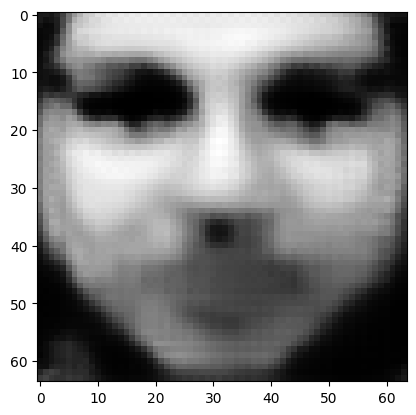

tensor([[2.8773e-07, 4.5948e-07, 1.1745e-03, 1.0267e-04, 1.3417e-05, 3.3396e-07,
         2.7865e-03, 2.4500e-06, 9.5814e-01, 3.2411e-03, 4.3981e-04, 1.1338e-04,
         3.2822e-04, 5.9396e-06, 3.9176e-04, 1.9359e-05, 5.0111e-04, 4.9261e-05,
         7.4610e-05, 2.6512e-04, 5.3850e-04, 9.5155e-04, 2.9232e-03, 3.3646e-04,
         2.9275e-03, 2.1610e-06, 8.3854e-05, 2.9987e-03, 9.2185e-03, 1.3426e-03,
         4.0704e-04, 3.4598e-07, 1.4293e-03, 2.9765e-05, 3.3521e-03, 2.3425e-05,
         1.4953e-04, 2.7892e-03, 1.8296e-03, 1.0186e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0427638478577137
tensor([[2.8725e-07, 4.5875e-07, 1.1734e-03, 1.0256e-04, 1.3400e-05, 3.3363e-07,
         2.7842e-03, 2.4467e-06, 9.5817e-01, 3.2389e-03, 4.3943e-04, 1.1325e-04,
         3.2786e-04, 5.9303e-06, 3.9143e-04, 1.9340e-05, 5.0060e-04, 4.9221e-05,
         7.4527e-05, 2.6494e-04, 5.3780e-04, 9.5054e-04, 2.9213e-03, 3.3612e-04,
         2.9242e-03, 2.1578e-06, 8.3763e-05

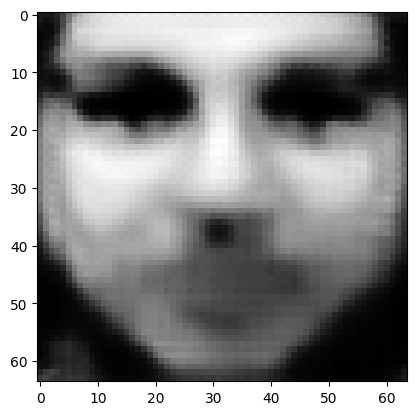

tensor([[2.8539e-07, 4.5590e-07, 1.1691e-03, 1.0211e-04, 1.3336e-05, 3.3236e-07,
         2.7757e-03, 2.4340e-06, 9.5832e-01, 3.2306e-03, 4.3793e-04, 1.1273e-04,
         3.2640e-04, 5.8940e-06, 3.9015e-04, 1.9266e-05, 4.9858e-04, 4.9069e-05,
         7.4211e-05, 2.6422e-04, 5.3511e-04, 9.4660e-04, 2.9140e-03, 3.3480e-04,
         2.9113e-03, 2.1453e-06, 8.3410e-05, 2.9860e-03, 9.1870e-03, 1.3378e-03,
         4.0490e-04, 3.4341e-07, 1.4232e-03, 2.9572e-05, 3.3360e-03, 2.3301e-05,
         1.4851e-04, 2.7746e-03, 1.8201e-03, 1.0129e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04257822409272194
tensor([[2.8494e-07, 4.5522e-07, 1.1681e-03, 1.0200e-04, 1.3320e-05, 3.3205e-07,
         2.7736e-03, 2.4309e-06, 9.5835e-01, 3.2286e-03, 4.3757e-04, 1.1261e-04,
         3.2605e-04, 5.8853e-06, 3.8984e-04, 1.9248e-05, 4.9809e-04, 4.9032e-05,
         7.4134e-05, 2.6404e-04, 5.3445e-04, 9.4564e-04, 2.9123e-03, 3.3447e-04,
         2.9082e-03, 2.1423e-06, 8.3325e-0

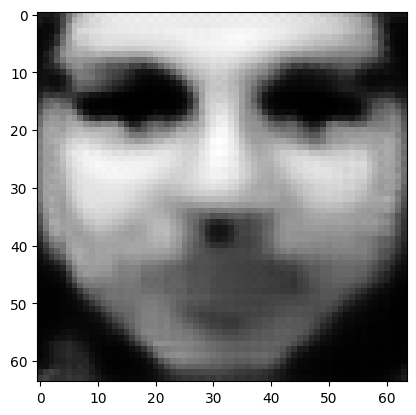

tensor([[2.8319e-07, 4.5254e-07, 1.1640e-03, 1.0158e-04, 1.3260e-05, 3.3085e-07,
         2.7654e-03, 2.4189e-06, 9.5848e-01, 3.2207e-03, 4.3617e-04, 1.1212e-04,
         3.2467e-04, 5.8511e-06, 3.8864e-04, 1.9178e-05, 4.9617e-04, 4.8888e-05,
         7.3835e-05, 2.6337e-04, 5.3190e-04, 9.4192e-04, 2.9054e-03, 3.3322e-04,
         2.8961e-03, 2.1305e-06, 8.2991e-05, 2.9741e-03, 9.1573e-03, 1.3334e-03,
         4.0287e-04, 3.4099e-07, 1.4174e-03, 2.9390e-05, 3.3208e-03, 2.3184e-05,
         1.4756e-04, 2.7608e-03, 1.8111e-03, 1.0076e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04240342229604721
tensor([[2.8277e-07, 4.5189e-07, 1.1630e-03, 1.0148e-04, 1.3245e-05, 3.3056e-07,
         2.7634e-03, 2.4160e-06, 9.5852e-01, 3.2189e-03, 4.3583e-04, 1.1200e-04,
         3.2434e-04, 5.8428e-06, 3.8835e-04, 1.9161e-05, 4.9571e-04, 4.8853e-05,
         7.3763e-05, 2.6320e-04, 5.3129e-04, 9.4102e-04, 2.9037e-03, 3.3292e-04,
         2.8932e-03, 2.1277e-06, 8.2910e-0

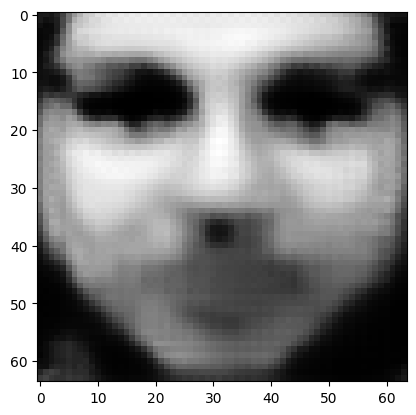

tensor([[2.8112e-07, 4.4939e-07, 1.1592e-03, 1.0108e-04, 1.3188e-05, 3.2943e-07,
         2.7557e-03, 2.4048e-06, 9.5864e-01, 3.2114e-03, 4.3451e-04, 1.1154e-04,
         3.2305e-04, 5.8109e-06, 3.8722e-04, 1.9096e-05, 4.9391e-04, 4.8717e-05,
         7.3482e-05, 2.6256e-04, 5.2890e-04, 9.3752e-04, 2.8972e-03, 3.3175e-04,
         2.8818e-03, 2.1167e-06, 8.2598e-05, 2.9628e-03, 9.1292e-03, 1.3292e-03,
         4.0097e-04, 3.3872e-07, 1.4120e-03, 2.9219e-05, 3.3065e-03, 2.3074e-05,
         1.4667e-04, 2.7478e-03, 1.8026e-03, 1.0026e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04223853349685669
tensor([[2.8073e-07, 4.4878e-07, 1.1582e-03, 1.0098e-04, 1.3174e-05, 3.2916e-07,
         2.7539e-03, 2.4021e-06, 9.5867e-01, 3.2097e-03, 4.3419e-04, 1.1143e-04,
         3.2273e-04, 5.8030e-06, 3.8695e-04, 1.9080e-05, 4.9347e-04, 4.8684e-05,
         7.3414e-05, 2.6241e-04, 5.2831e-04, 9.3667e-04, 2.8956e-03, 3.3146e-04,
         2.8790e-03, 2.1140e-06, 8.2522e-0

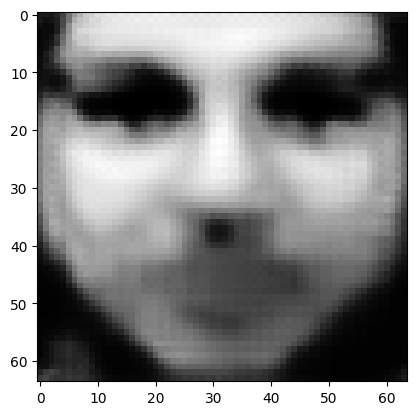

tensor([[2.7917e-07, 4.4641e-07, 1.1546e-03, 1.0061e-04, 1.3120e-05, 3.2809e-07,
         2.7465e-03, 2.3915e-06, 9.5879e-01, 3.2028e-03, 4.3296e-04, 1.1099e-04,
         3.2152e-04, 5.7727e-06, 3.8588e-04, 1.9019e-05, 4.9177e-04, 4.8555e-05,
         7.3148e-05, 2.6182e-04, 5.2605e-04, 9.3337e-04, 2.8894e-03, 3.3035e-04,
         2.8681e-03, 2.1035e-06, 8.2226e-05, 2.9522e-03, 9.1030e-03, 1.3253e-03,
         3.9916e-04, 3.3657e-07, 1.4069e-03, 2.9058e-05, 3.2930e-03, 2.2971e-05,
         1.4582e-04, 2.7355e-03, 1.7946e-03, 9.9793e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04208321496844292
tensor([[2.7879e-07, 4.4584e-07, 1.1537e-03, 1.0051e-04, 1.3107e-05, 3.2783e-07,
         2.7448e-03, 2.3890e-06, 9.5882e-01, 3.2011e-03, 4.3266e-04, 1.1089e-04,
         3.2122e-04, 5.7653e-06, 3.8562e-04, 1.9004e-05, 4.9135e-04, 4.8523e-05,
         7.3084e-05, 2.6167e-04, 5.2549e-04, 9.3257e-04, 2.8879e-03, 3.3008e-04,
         2.8655e-03, 2.1009e-06, 8.2154e-0

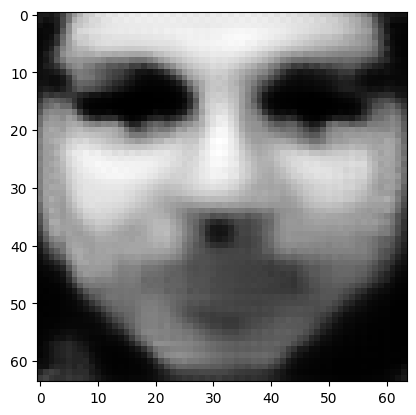

tensor([[2.7733e-07, 4.4361e-07, 1.1503e-03, 1.0016e-04, 1.3056e-05, 3.2682e-07,
         2.7379e-03, 2.3790e-06, 9.5893e-01, 3.1946e-03, 4.3149e-04, 1.1048e-04,
         3.2007e-04, 5.7367e-06, 3.8462e-04, 1.8946e-05, 4.8974e-04, 4.8401e-05,
         7.2833e-05, 2.6111e-04, 5.2336e-04, 9.2945e-04, 2.8820e-03, 3.2904e-04,
         2.8553e-03, 2.0910e-06, 8.1875e-05, 2.9422e-03, 9.0783e-03, 1.3216e-03,
         3.9745e-04, 3.3454e-07, 1.4020e-03, 2.8907e-05, 3.2802e-03, 2.2873e-05,
         1.4502e-04, 2.7239e-03, 1.7871e-03, 9.9348e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04193656146526337
tensor([[2.7698e-07, 4.4307e-07, 1.1495e-03, 1.0008e-04, 1.3043e-05, 3.2658e-07,
         2.7362e-03, 2.3766e-06, 9.5896e-01, 3.1930e-03, 4.3121e-04, 1.1038e-04,
         3.1980e-04, 5.7298e-06, 3.8438e-04, 1.8932e-05, 4.8935e-04, 4.8371e-05,
         7.2772e-05, 2.6097e-04, 5.2284e-04, 9.2870e-04, 2.8806e-03, 3.2878e-04,
         2.8528e-03, 2.0886e-06, 8.1808e-0

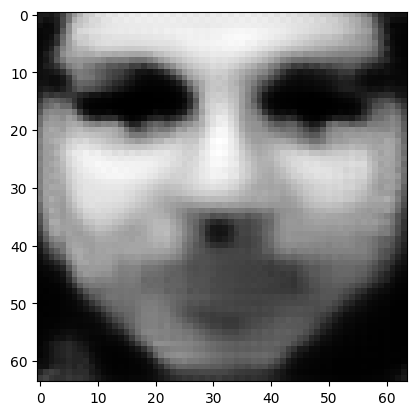

tensor([[2.7560e-07, 4.4098e-07, 1.1463e-03, 9.9743e-05, 1.2995e-05, 3.2563e-07,
         2.7297e-03, 2.3672e-06, 9.5906e-01, 3.1868e-03, 4.3011e-04, 1.0999e-04,
         3.1871e-04, 5.7030e-06, 3.8342e-04, 1.8878e-05, 4.8784e-04, 4.8256e-05,
         7.2536e-05, 2.6044e-04, 5.2083e-04, 9.2576e-04, 2.8751e-03, 3.2779e-04,
         2.8432e-03, 2.0794e-06, 8.1544e-05, 2.9327e-03, 9.0548e-03, 1.3181e-03,
         3.9584e-04, 3.3264e-07, 1.3974e-03, 2.8764e-05, 3.2681e-03, 2.2781e-05,
         1.4427e-04, 2.7129e-03, 1.7800e-03, 9.8929e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04179789125919342
tensor([[2.7527e-07, 4.4047e-07, 1.1455e-03, 9.9661e-05, 1.2984e-05, 3.2540e-07,
         2.7281e-03, 2.3650e-06, 9.5909e-01, 3.1853e-03, 4.2984e-04, 1.0989e-04,
         3.1845e-04, 5.6964e-06, 3.8319e-04, 1.8865e-05, 4.8747e-04, 4.8227e-05,
         7.2479e-05, 2.6031e-04, 5.2034e-04, 9.2505e-04, 2.8738e-03, 3.2755e-04,
         2.8408e-03, 2.0771e-06, 8.1480e-0

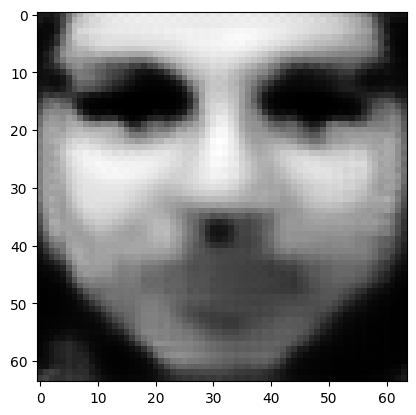

tensor([[2.7397e-07, 4.3850e-07, 1.1425e-03, 9.9346e-05, 1.2938e-05, 3.2450e-07,
         2.7219e-03, 2.3561e-06, 9.5919e-01, 3.1795e-03, 4.2880e-04, 1.0953e-04,
         3.1743e-04, 5.6712e-06, 3.8229e-04, 1.8813e-05, 4.8604e-04, 4.8118e-05,
         7.2255e-05, 2.5981e-04, 5.1845e-04, 9.2227e-04, 2.8685e-03, 3.2662e-04,
         2.8317e-03, 2.0683e-06, 8.1232e-05, 2.9238e-03, 9.0326e-03, 1.3148e-03,
         3.9432e-04, 3.3084e-07, 1.3931e-03, 2.8629e-05, 3.2567e-03, 2.2694e-05,
         1.4356e-04, 2.7025e-03, 1.7733e-03, 9.8534e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04166697338223457
tensor([[2.7366e-07, 4.3802e-07, 1.1417e-03, 9.9270e-05, 1.2927e-05, 3.2428e-07,
         2.7204e-03, 2.3540e-06, 9.5921e-01, 3.1781e-03, 4.2854e-04, 1.0944e-04,
         3.1718e-04, 5.6649e-06, 3.8207e-04, 1.8800e-05, 4.8569e-04, 4.8091e-05,
         7.2202e-05, 2.5969e-04, 5.1798e-04, 9.2160e-04, 2.8673e-03, 3.2639e-04,
         2.8295e-03, 2.0662e-06, 8.1171e-0

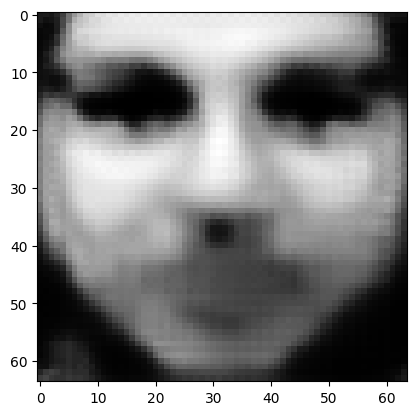

tensor([[2.7244e-07, 4.3616e-07, 1.1389e-03, 9.8973e-05, 1.2885e-05, 3.2344e-07,
         2.7146e-03, 2.3456e-06, 9.5931e-01, 3.1725e-03, 4.2756e-04, 1.0909e-04,
         3.1622e-04, 5.6412e-06, 3.8123e-04, 1.8752e-05, 4.8433e-04, 4.7989e-05,
         7.1990e-05, 2.5921e-04, 5.1619e-04, 9.1898e-04, 2.8623e-03, 3.2551e-04,
         2.8210e-03, 2.0580e-06, 8.0937e-05, 2.9154e-03, 9.0116e-03, 1.3117e-03,
         3.9289e-04, 3.2914e-07, 1.3890e-03, 2.8502e-05, 3.2460e-03, 2.2612e-05,
         1.4290e-04, 2.6928e-03, 1.7670e-03, 9.8161e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041543588042259216
tensor([[2.7214e-07, 4.3571e-07, 1.1382e-03, 9.8900e-05, 1.2874e-05, 3.2323e-07,
         2.7132e-03, 2.3436e-06, 9.5933e-01, 3.1712e-03, 4.2732e-04, 1.0901e-04,
         3.1598e-04, 5.6354e-06, 3.8102e-04, 1.8740e-05, 4.8401e-04, 4.7964e-05,
         7.1939e-05, 2.5910e-04, 5.1576e-04, 9.1834e-04, 2.8611e-03, 3.2529e-04,
         2.8189e-03, 2.0560e-06, 8.0880e-

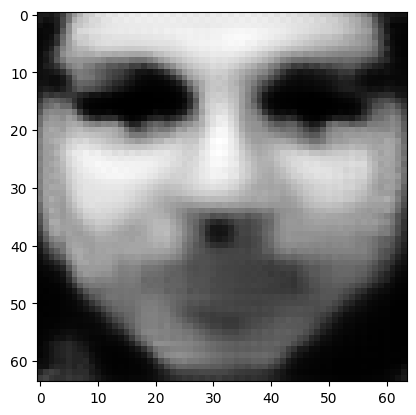

tensor([[2.7099e-07, 4.3396e-07, 1.1355e-03, 9.8619e-05, 1.2834e-05, 3.2244e-07,
         2.7077e-03, 2.3358e-06, 9.5942e-01, 3.1660e-03, 4.2640e-04, 1.0868e-04,
         3.1507e-04, 5.6130e-06, 3.8022e-04, 1.8694e-05, 4.8273e-04, 4.7866e-05,
         7.1740e-05, 2.5865e-04, 5.1407e-04, 9.1587e-04, 2.8565e-03, 3.2446e-04,
         2.8109e-03, 2.0482e-06, 8.0659e-05, 2.9074e-03, 8.9917e-03, 1.3087e-03,
         3.9154e-04, 3.2755e-07, 1.3851e-03, 2.8382e-05, 3.2359e-03, 2.2535e-05,
         1.4227e-04, 2.6835e-03, 1.7610e-03, 9.7811e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041426822543144226
tensor([[2.7071e-07, 4.3353e-07, 1.1348e-03, 9.8552e-05, 1.2824e-05, 3.2224e-07,
         2.7063e-03, 2.3338e-06, 9.5944e-01, 3.1647e-03, 4.2617e-04, 1.0860e-04,
         3.1485e-04, 5.6075e-06, 3.8002e-04, 1.8683e-05, 4.8242e-04, 4.7843e-05,
         7.1692e-05, 2.5854e-04, 5.1366e-04, 9.1527e-04, 2.8553e-03, 3.2426e-04,
         2.8089e-03, 2.0463e-06, 8.0605e-

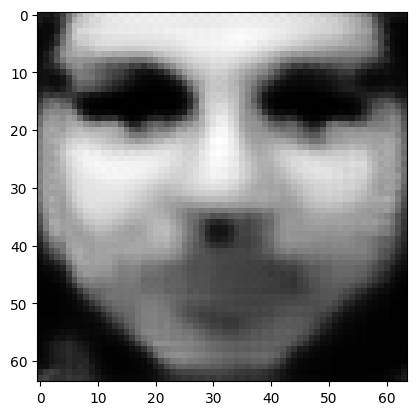

tensor([[2.6963e-07, 4.3188e-07, 1.1323e-03, 9.8287e-05, 1.2787e-05, 3.2149e-07,
         2.7012e-03, 2.3264e-06, 9.5953e-01, 3.1598e-03, 4.2529e-04, 1.0830e-04,
         3.1400e-04, 5.5864e-06, 3.7926e-04, 1.8640e-05, 4.8121e-04, 4.7751e-05,
         7.1504e-05, 2.5811e-04, 5.1207e-04, 9.1294e-04, 2.8509e-03, 3.2347e-04,
         2.8013e-03, 2.0390e-06, 8.0396e-05, 2.8999e-03, 8.9729e-03, 1.3059e-03,
         3.9026e-04, 3.2605e-07, 1.3815e-03, 2.8269e-05, 3.2263e-03, 2.2462e-05,
         1.4167e-04, 2.6748e-03, 1.7553e-03, 9.7480e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041316792368888855
tensor([[2.6937e-07, 4.3148e-07, 1.1316e-03, 9.8222e-05, 1.2777e-05, 3.2131e-07,
         2.6999e-03, 2.3246e-06, 9.5955e-01, 3.1586e-03, 4.2508e-04, 1.0822e-04,
         3.1379e-04, 5.5812e-06, 3.7908e-04, 1.8629e-05, 4.8092e-04, 4.7729e-05,
         7.1458e-05, 2.5801e-04, 5.1168e-04, 9.1237e-04, 2.8499e-03, 3.2328e-04,
         2.7994e-03, 2.0372e-06, 8.0345e-

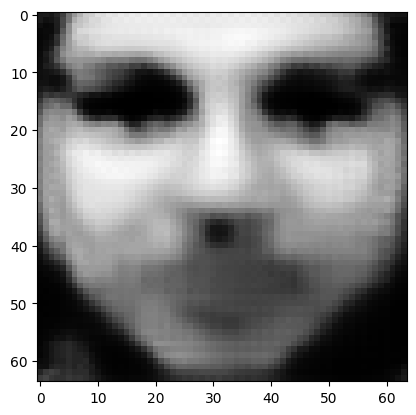

tensor([[2.6835e-07, 4.2993e-07, 1.1292e-03, 9.7973e-05, 1.2742e-05, 3.2060e-07,
         2.6950e-03, 2.3177e-06, 9.5962e-01, 3.1539e-03, 4.2425e-04, 1.0793e-04,
         3.1298e-04, 5.5613e-06, 3.7836e-04, 1.8588e-05, 4.7978e-04, 4.7642e-05,
         7.1281e-05, 2.5761e-04, 5.1018e-04, 9.1017e-04, 2.8457e-03, 3.2254e-04,
         2.7922e-03, 2.0304e-06, 8.0149e-05, 2.8928e-03, 8.9552e-03, 1.3033e-03,
         3.8906e-04, 3.2463e-07, 1.3780e-03, 2.8162e-05, 3.2172e-03, 2.2393e-05,
         1.4111e-04, 2.6666e-03, 1.7500e-03, 9.7167e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04121292382478714
tensor([[2.6810e-07, 4.2955e-07, 1.1286e-03, 9.7913e-05, 1.2733e-05, 3.2042e-07,
         2.6938e-03, 2.3160e-06, 9.5964e-01, 3.1528e-03, 4.2405e-04, 1.0786e-04,
         3.1278e-04, 5.5565e-06, 3.7819e-04, 1.8578e-05, 4.7950e-04, 4.7621e-05,
         7.1238e-05, 2.5751e-04, 5.0982e-04, 9.0964e-04, 2.8447e-03, 3.2236e-04,
         2.7905e-03, 2.0287e-06, 8.0101e-0

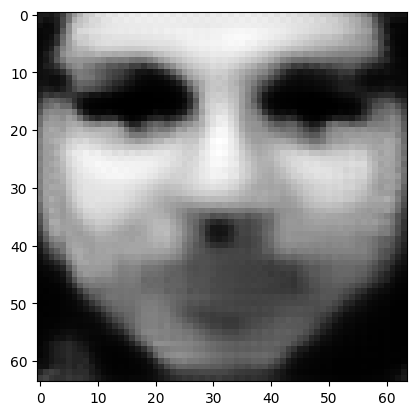

tensor([[2.6714e-07, 4.2808e-07, 1.1264e-03, 9.7677e-05, 1.2699e-05, 3.1975e-07,
         2.6892e-03, 2.3094e-06, 9.5972e-01, 3.1484e-03, 4.2326e-04, 1.0759e-04,
         3.1202e-04, 5.5377e-06, 3.7751e-04, 1.8539e-05, 4.7843e-04, 4.7539e-05,
         7.1071e-05, 2.5713e-04, 5.0840e-04, 9.0756e-04, 2.8407e-03, 3.2166e-04,
         2.7837e-03, 2.0222e-06, 7.9915e-05, 2.8861e-03, 8.9384e-03, 1.3008e-03,
         3.8792e-04, 3.2330e-07, 1.3748e-03, 2.8061e-05, 3.2087e-03, 2.2328e-05,
         1.4059e-04, 2.6589e-03, 1.7450e-03, 9.6873e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04111453890800476
tensor([[2.6691e-07, 4.2773e-07, 1.1258e-03, 9.7620e-05, 1.2691e-05, 3.1959e-07,
         2.6881e-03, 2.3077e-06, 9.5974e-01, 3.1473e-03, 4.2307e-04, 1.0752e-04,
         3.1184e-04, 5.5332e-06, 3.7735e-04, 1.8530e-05, 4.7817e-04, 4.7519e-05,
         7.1030e-05, 2.5704e-04, 5.0806e-04, 9.0706e-04, 2.8398e-03, 3.2149e-04,
         2.7821e-03, 2.0206e-06, 7.9871e-0

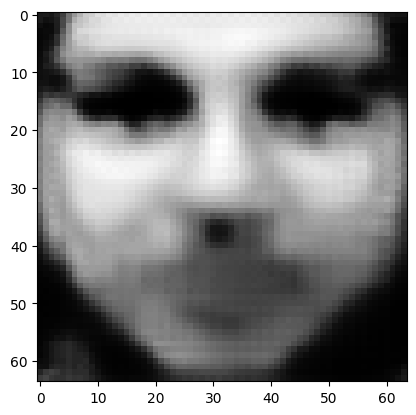

tensor([[2.6600e-07, 4.2634e-07, 1.1236e-03, 9.7397e-05, 1.2659e-05, 3.1895e-07,
         2.6837e-03, 2.3015e-06, 9.5981e-01, 3.1431e-03, 4.2233e-04, 1.0727e-04,
         3.1112e-04, 5.5155e-06, 3.7670e-04, 1.8494e-05, 4.7715e-04, 4.7441e-05,
         7.0871e-05, 2.5668e-04, 5.0672e-04, 9.0509e-04, 2.8360e-03, 3.2082e-04,
         2.7756e-03, 2.0145e-06, 7.9695e-05, 2.8797e-03, 8.9225e-03, 1.2984e-03,
         3.8685e-04, 3.2203e-07, 1.3717e-03, 2.7966e-05, 3.2005e-03, 2.2266e-05,
         1.4009e-04, 2.6515e-03, 1.7402e-03, 9.6594e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04102140665054321
tensor([[2.6578e-07, 4.2601e-07, 1.1231e-03, 9.7342e-05, 1.2651e-05, 3.1880e-07,
         2.6826e-03, 2.3000e-06, 9.5983e-01, 3.1421e-03, 4.2215e-04, 1.0720e-04,
         3.1094e-04, 5.5112e-06, 3.7655e-04, 1.8485e-05, 4.7690e-04, 4.7422e-05,
         7.0833e-05, 2.5659e-04, 5.0639e-04, 9.0461e-04, 2.8351e-03, 3.2066e-04,
         2.7741e-03, 2.0130e-06, 7.9652e-0

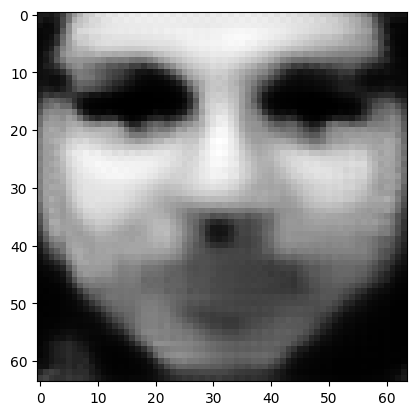

tensor([[2.6493e-07, 4.2471e-07, 1.1211e-03, 9.7132e-05, 1.2621e-05, 3.1820e-07,
         2.6785e-03, 2.2941e-06, 9.5989e-01, 3.1382e-03, 4.2145e-04, 1.0696e-04,
         3.1026e-04, 5.4945e-06, 3.7594e-04, 1.8450e-05, 4.7594e-04, 4.7349e-05,
         7.0684e-05, 2.5625e-04, 5.0513e-04, 9.0276e-04, 2.8316e-03, 3.2004e-04,
         2.7680e-03, 2.0072e-06, 7.9486e-05, 2.8737e-03, 8.9075e-03, 1.2962e-03,
         3.8584e-04, 3.2085e-07, 1.3688e-03, 2.7877e-05, 3.1929e-03, 2.2208e-05,
         1.3962e-04, 2.6446e-03, 1.7357e-03, 9.6331e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040933758020401
tensor([[2.6472e-07, 4.2439e-07, 1.1206e-03, 9.7081e-05, 1.2614e-05, 3.1805e-07,
         2.6774e-03, 2.2927e-06, 9.5991e-01, 3.1372e-03, 4.2128e-04, 1.0690e-04,
         3.1010e-04, 5.4904e-06, 3.7579e-04, 1.8442e-05, 4.7571e-04, 4.7331e-05,
         7.0647e-05, 2.5617e-04, 5.0482e-04, 9.0230e-04, 2.8307e-03, 3.1988e-04,
         2.7665e-03, 2.0057e-06, 7.9446e-05,

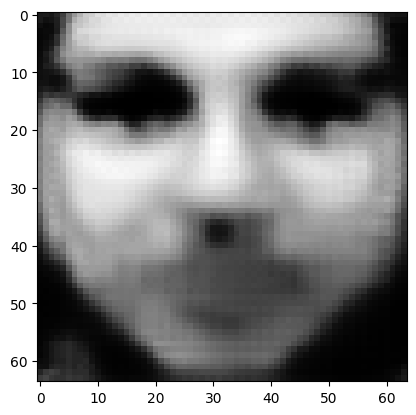

tensor([[2.6391e-07, 4.2316e-07, 1.1186e-03, 9.6882e-05, 1.2586e-05, 3.1749e-07,
         2.6735e-03, 2.2871e-06, 9.5997e-01, 3.1335e-03, 4.2061e-04, 1.0667e-04,
         3.0945e-04, 5.4746e-06, 3.7522e-04, 1.8409e-05, 4.7480e-04, 4.7262e-05,
         7.0506e-05, 2.5584e-04, 5.0362e-04, 9.0055e-04, 2.8274e-03, 3.1929e-04,
         2.7608e-03, 2.0003e-06, 7.9289e-05, 2.8681e-03, 8.8932e-03, 1.2941e-03,
         3.8488e-04, 3.1972e-07, 1.3661e-03, 2.7792e-05, 3.1856e-03, 2.2153e-05,
         1.3917e-04, 2.6381e-03, 1.7315e-03, 9.6082e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040850453078746796
tensor([[2.6372e-07, 4.2286e-07, 1.1182e-03, 9.6834e-05, 1.2579e-05, 3.1735e-07,
         2.6726e-03, 2.2858e-06, 9.5999e-01, 3.1325e-03, 4.2045e-04, 1.0661e-04,
         3.0930e-04, 5.4708e-06, 3.7508e-04, 1.8401e-05, 4.7458e-04, 4.7245e-05,
         7.0471e-05, 2.5577e-04, 5.0333e-04, 9.0012e-04, 2.8265e-03, 3.1915e-04,
         2.7594e-03, 1.9989e-06, 7.9251e-

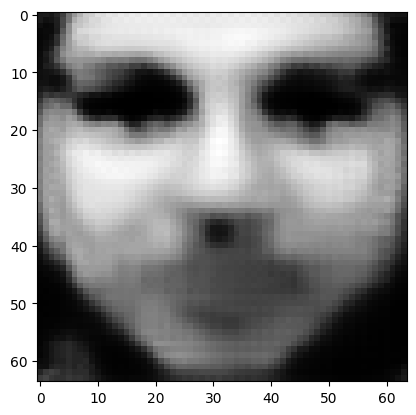

tensor([[2.6296e-07, 4.2169e-07, 1.1163e-03, 9.6645e-05, 1.2552e-05, 3.1681e-07,
         2.6689e-03, 2.2805e-06, 9.6005e-01, 3.1290e-03, 4.1982e-04, 1.0640e-04,
         3.0869e-04, 5.4559e-06, 3.7453e-04, 1.8370e-05, 4.7372e-04, 4.7180e-05,
         7.0337e-05, 2.5546e-04, 5.0220e-04, 8.9846e-04, 2.8234e-03, 3.1859e-04,
         2.7540e-03, 1.9938e-06, 7.9102e-05, 2.8627e-03, 8.8797e-03, 1.2921e-03,
         3.8397e-04, 3.1866e-07, 1.3635e-03, 2.7712e-05, 3.1788e-03, 2.2101e-05,
         1.3875e-04, 2.6319e-03, 1.7275e-03, 9.5847e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04077183082699776
tensor([[2.6277e-07, 4.2141e-07, 1.1159e-03, 9.6599e-05, 1.2545e-05, 3.1668e-07,
         2.6680e-03, 2.2792e-06, 9.6006e-01, 3.1281e-03, 4.1967e-04, 1.0634e-04,
         3.0854e-04, 5.4522e-06, 3.7440e-04, 1.8363e-05, 4.7351e-04, 4.7164e-05,
         7.0305e-05, 2.5539e-04, 5.0192e-04, 8.9805e-04, 2.8226e-03, 3.1845e-04,
         2.7527e-03, 1.9925e-06, 7.9066e-0

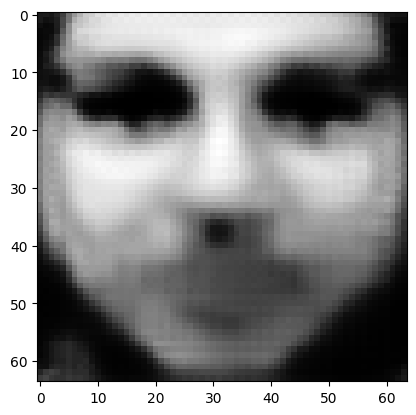

tensor([[2.6205e-07, 4.2031e-07, 1.1142e-03, 9.6421e-05, 1.2520e-05, 3.1617e-07,
         2.6645e-03, 2.2742e-06, 9.6012e-01, 3.1247e-03, 4.1907e-04, 1.0614e-04,
         3.0796e-04, 5.4381e-06, 3.7389e-04, 1.8333e-05, 4.7269e-04, 4.7102e-05,
         7.0178e-05, 2.5510e-04, 5.0085e-04, 8.9648e-04, 2.8196e-03, 3.1792e-04,
         2.7476e-03, 1.9876e-06, 7.8926e-05, 2.8576e-03, 8.8669e-03, 1.2902e-03,
         3.8312e-04, 3.1766e-07, 1.3610e-03, 2.7636e-05, 3.1723e-03, 2.2051e-05,
         1.3835e-04, 2.6260e-03, 1.7236e-03, 9.5624e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040697209537029266
tensor([[2.6187e-07, 4.2004e-07, 1.1137e-03, 9.6378e-05, 1.2514e-05, 3.1605e-07,
         2.6636e-03, 2.2730e-06, 9.6013e-01, 3.1239e-03, 4.1893e-04, 1.0609e-04,
         3.0782e-04, 5.4347e-06, 3.7376e-04, 1.8326e-05, 4.7249e-04, 4.7086e-05,
         7.0147e-05, 2.5503e-04, 5.0059e-04, 8.9610e-04, 2.8188e-03, 3.1779e-04,
         2.7463e-03, 1.9864e-06, 7.8891e-

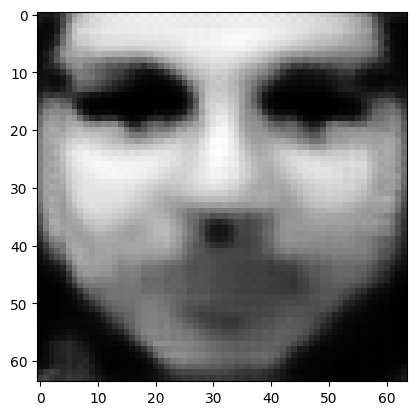

tensor([[2.6118e-07, 4.1900e-07, 1.1121e-03, 9.6208e-05, 1.2489e-05, 3.1556e-07,
         2.6602e-03, 2.2683e-06, 9.6019e-01, 3.1207e-03, 4.1837e-04, 1.0589e-04,
         3.0727e-04, 5.4213e-06, 3.7327e-04, 1.8299e-05, 4.7172e-04, 4.7027e-05,
         7.0027e-05, 2.5475e-04, 4.9958e-04, 8.9460e-04, 2.8160e-03, 3.1729e-04,
         2.7414e-03, 1.9818e-06, 7.8759e-05, 2.8528e-03, 8.8548e-03, 1.2884e-03,
         3.8230e-04, 3.1670e-07, 1.3586e-03, 2.7564e-05, 3.1661e-03, 2.2005e-05,
         1.3797e-04, 2.6204e-03, 1.7200e-03, 9.5412e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04062635824084282
tensor([[2.6102e-07, 4.1875e-07, 1.1117e-03, 9.6167e-05, 1.2484e-05, 3.1545e-07,
         2.6594e-03, 2.2672e-06, 9.6020e-01, 3.1200e-03, 4.1823e-04, 1.0584e-04,
         3.0714e-04, 5.4180e-06, 3.7316e-04, 1.8292e-05, 4.7153e-04, 4.7013e-05,
         6.9998e-05, 2.5469e-04, 4.9933e-04, 8.9424e-04, 2.8153e-03, 3.1717e-04,
         2.7402e-03, 1.9806e-06, 7.8726e-0

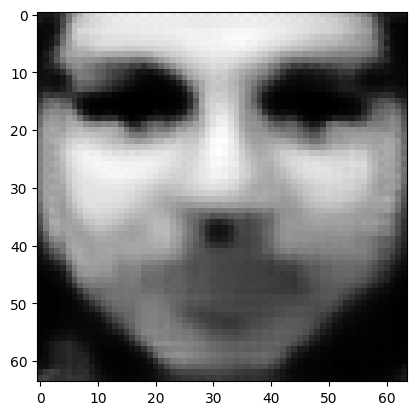

tensor([[2.6037e-07, 4.1776e-07, 1.1101e-03, 9.6007e-05, 1.2461e-05, 3.1499e-07,
         2.6563e-03, 2.2627e-06, 9.6025e-01, 3.1170e-03, 4.1770e-04, 1.0566e-04,
         3.0662e-04, 5.4053e-06, 3.7270e-04, 1.8266e-05, 4.7080e-04, 4.6956e-05,
         6.9885e-05, 2.5443e-04, 4.9837e-04, 8.9283e-04, 2.8125e-03, 3.1669e-04,
         2.7356e-03, 1.9762e-06, 7.8600e-05, 2.8482e-03, 8.8434e-03, 1.2867e-03,
         3.8153e-04, 3.1580e-07, 1.3564e-03, 2.7496e-05, 3.1603e-03, 2.1961e-05,
         1.3762e-04, 2.6151e-03, 1.7166e-03, 9.5212e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040559396147727966
tensor([[2.6021e-07, 4.1752e-07, 1.1098e-03, 9.5968e-05, 1.2455e-05, 3.1488e-07,
         2.6555e-03, 2.2616e-06, 9.6026e-01, 3.1162e-03, 4.1757e-04, 1.0561e-04,
         3.0649e-04, 5.4022e-06, 3.7258e-04, 1.8260e-05, 4.7062e-04, 4.6942e-05,
         6.9856e-05, 2.5437e-04, 4.9813e-04, 8.9249e-04, 2.8119e-03, 3.1658e-04,
         2.7345e-03, 1.9751e-06, 7.8569e-

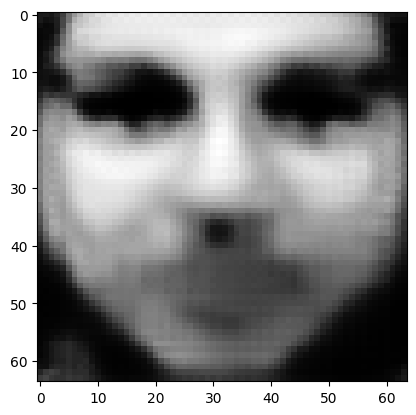

tensor([[2.5960e-07, 4.1659e-07, 1.1083e-03, 9.5816e-05, 1.2433e-05, 3.1444e-07,
         2.6525e-03, 2.2574e-06, 9.6031e-01, 3.1134e-03, 4.1707e-04, 1.0543e-04,
         3.0600e-04, 5.3902e-06, 3.7215e-04, 1.8235e-05, 4.6993e-04, 4.6889e-05,
         6.9749e-05, 2.5413e-04, 4.9722e-04, 8.9115e-04, 2.8093e-03, 3.1612e-04,
         2.7301e-03, 1.9710e-06, 7.8450e-05, 2.8439e-03, 8.8325e-03, 1.2851e-03,
         3.8080e-04, 3.1495e-07, 1.3543e-03, 2.7431e-05, 3.1547e-03, 2.1919e-05,
         1.3728e-04, 2.6101e-03, 1.7134e-03, 9.5022e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0404958613216877
tensor([[2.5945e-07, 4.1636e-07, 1.1079e-03, 9.5779e-05, 1.2428e-05, 3.1434e-07,
         2.6517e-03, 2.2564e-06, 9.6033e-01, 3.1127e-03, 4.1695e-04, 1.0539e-04,
         3.0588e-04, 5.3873e-06, 3.7204e-04, 1.8229e-05, 4.6976e-04, 4.6876e-05,
         6.9723e-05, 2.5407e-04, 4.9700e-04, 8.9082e-04, 2.8086e-03, 3.1602e-04,
         2.7290e-03, 1.9700e-06, 7.8421e-05

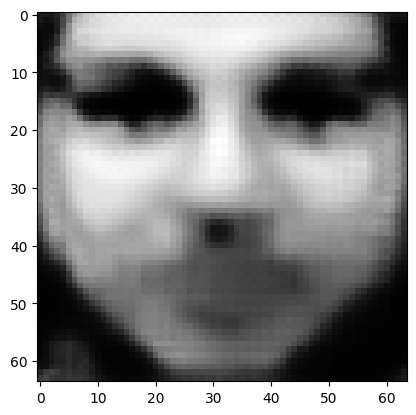

tensor([[2.5886e-07, 4.1548e-07, 1.1065e-03, 9.5635e-05, 1.2408e-05, 3.1393e-07,
         2.6489e-03, 2.2524e-06, 9.6037e-01, 3.1100e-03, 4.1647e-04, 1.0522e-04,
         3.0542e-04, 5.3759e-06, 3.7162e-04, 1.8205e-05, 4.6910e-04, 4.6826e-05,
         6.9621e-05, 2.5383e-04, 4.9613e-04, 8.8956e-04, 2.8062e-03, 3.1559e-04,
         2.7249e-03, 1.9660e-06, 7.8307e-05, 2.8398e-03, 8.8221e-03, 1.2835e-03,
         3.8011e-04, 3.1414e-07, 1.3523e-03, 2.7370e-05, 3.1495e-03, 2.1879e-05,
         1.3695e-04, 2.6053e-03, 1.7103e-03, 9.4842e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04043553024530411
tensor([[2.5872e-07, 4.1526e-07, 1.1062e-03, 9.5601e-05, 1.2403e-05, 3.1383e-07,
         2.6482e-03, 2.2514e-06, 9.6038e-01, 3.1093e-03, 4.1635e-04, 1.0518e-04,
         3.0530e-04, 5.3732e-06, 3.7153e-04, 1.8200e-05, 4.6894e-04, 4.6813e-05,
         6.9596e-05, 2.5378e-04, 4.9593e-04, 8.8925e-04, 2.8056e-03, 3.1549e-04,
         2.7239e-03, 1.9651e-06, 7.8280e-0

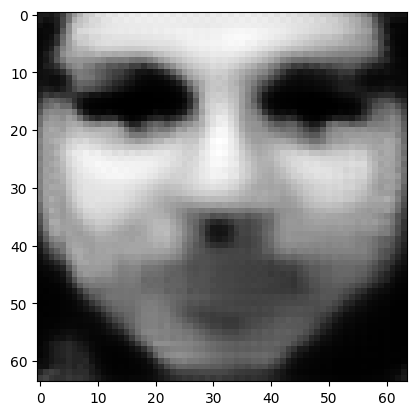

tensor([[2.5817e-07, 4.1443e-07, 1.1049e-03, 9.5465e-05, 1.2383e-05, 3.1344e-07,
         2.6455e-03, 2.2476e-06, 9.6043e-01, 3.1068e-03, 4.1590e-04, 1.0503e-04,
         3.0486e-04, 5.3624e-06, 3.7113e-04, 1.8178e-05, 4.6832e-04, 4.6766e-05,
         6.9500e-05, 2.5356e-04, 4.9511e-04, 8.8805e-04, 2.8033e-03, 3.1508e-04,
         2.7199e-03, 1.9613e-06, 7.8173e-05, 2.8359e-03, 8.8124e-03, 1.2821e-03,
         3.7945e-04, 3.1338e-07, 1.3504e-03, 2.7313e-05, 3.1445e-03, 2.1842e-05,
         1.3665e-04, 2.6008e-03, 1.7074e-03, 9.4672e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0403786301612854
tensor([[2.5804e-07, 4.1422e-07, 1.1045e-03, 9.5432e-05, 1.2378e-05, 3.1334e-07,
         2.6448e-03, 2.2467e-06, 9.6044e-01, 3.1061e-03, 4.1579e-04, 1.0499e-04,
         3.0475e-04, 5.3598e-06, 3.7104e-04, 1.8172e-05, 4.6816e-04, 4.6754e-05,
         6.9476e-05, 2.5351e-04, 4.9491e-04, 8.8776e-04, 2.8027e-03, 3.1498e-04,
         2.7190e-03, 1.9604e-06, 7.8146e-05

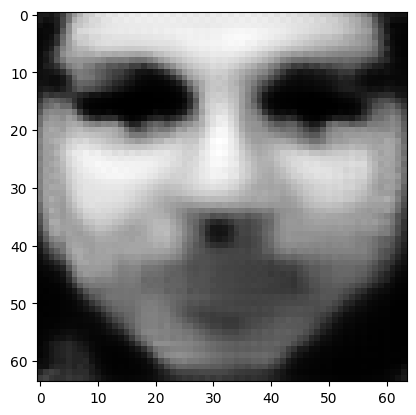

tensor([[2.5752e-07, 4.1343e-07, 1.1033e-03, 9.5303e-05, 1.2360e-05, 3.1298e-07,
         2.6423e-03, 2.2432e-06, 9.6048e-01, 3.1037e-03, 4.1536e-04, 1.0484e-04,
         3.0433e-04, 5.3496e-06, 3.7067e-04, 1.8151e-05, 4.6758e-04, 4.6709e-05,
         6.9385e-05, 2.5330e-04, 4.9414e-04, 8.8662e-04, 2.8005e-03, 3.1460e-04,
         2.7153e-03, 1.9569e-06, 7.8045e-05, 2.8322e-03, 8.8031e-03, 1.2807e-03,
         3.7883e-04, 3.1266e-07, 1.3487e-03, 2.7258e-05, 3.1398e-03, 2.1806e-05,
         1.3636e-04, 2.5966e-03, 1.7047e-03, 9.4511e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040324702858924866
tensor([[2.5739e-07, 4.1324e-07, 1.1030e-03, 9.5272e-05, 1.2356e-05, 3.1289e-07,
         2.6416e-03, 2.2423e-06, 9.6049e-01, 3.1031e-03, 4.1526e-04, 1.0480e-04,
         3.0423e-04, 5.3471e-06, 3.7058e-04, 1.8146e-05, 4.6743e-04, 4.6698e-05,
         6.9362e-05, 2.5325e-04, 4.9395e-04, 8.8634e-04, 2.8000e-03, 3.1451e-04,
         2.7143e-03, 1.9560e-06, 7.8020e-

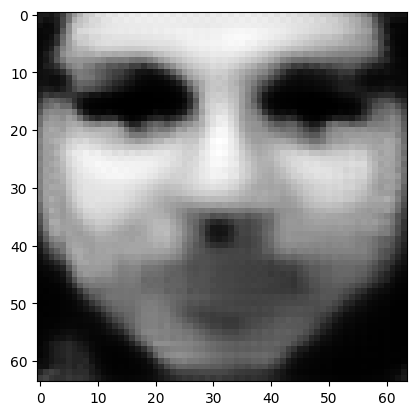

tensor([[2.5690e-07, 4.1249e-07, 1.1018e-03, 9.5149e-05, 1.2338e-05, 3.1254e-07,
         2.6392e-03, 2.2389e-06, 9.6053e-01, 3.1008e-03, 4.1485e-04, 1.0466e-04,
         3.0384e-04, 5.3375e-06, 3.7023e-04, 1.8126e-05, 4.6687e-04, 4.6655e-05,
         6.9276e-05, 2.5305e-04, 4.9322e-04, 8.8527e-04, 2.7979e-03, 3.1415e-04,
         2.7108e-03, 1.9527e-06, 7.7924e-05, 2.8287e-03, 8.7942e-03, 1.2794e-03,
         3.7824e-04, 3.1197e-07, 1.3470e-03, 2.7206e-05, 3.1353e-03, 2.1772e-05,
         1.3609e-04, 2.5925e-03, 1.7021e-03, 9.4357e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04027329012751579
tensor([[2.5678e-07, 4.1231e-07, 1.1015e-03, 9.5120e-05, 1.2334e-05, 3.1245e-07,
         2.6386e-03, 2.2381e-06, 9.6054e-01, 3.1003e-03, 4.1475e-04, 1.0463e-04,
         3.0374e-04, 5.3351e-06, 3.7014e-04, 1.8121e-05, 4.6673e-04, 4.6645e-05,
         6.9255e-05, 2.5300e-04, 4.9304e-04, 8.8500e-04, 2.7974e-03, 3.1406e-04,
         2.7100e-03, 1.9518e-06, 7.7901e-0

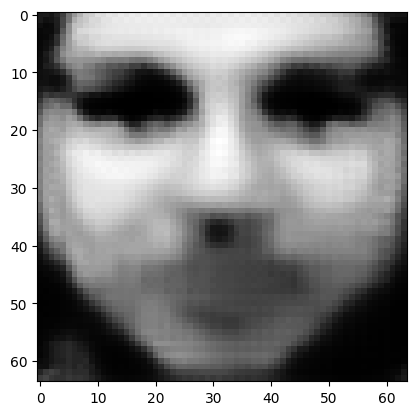

tensor([[2.5631e-07, 4.1160e-07, 1.1004e-03, 9.5004e-05, 1.2317e-05, 3.1212e-07,
         2.6363e-03, 2.2349e-06, 9.6057e-01, 3.0981e-03, 4.1437e-04, 1.0449e-04,
         3.0337e-04, 5.3260e-06, 3.6981e-04, 1.8103e-05, 4.6620e-04, 4.6604e-05,
         6.9173e-05, 2.5282e-04, 4.9235e-04, 8.8398e-04, 2.7954e-03, 3.1372e-04,
         2.7066e-03, 1.9487e-06, 7.7810e-05, 2.8254e-03, 8.7859e-03, 1.2782e-03,
         3.7768e-04, 3.1132e-07, 1.3453e-03, 2.7157e-05, 3.1311e-03, 2.1741e-05,
         1.3583e-04, 2.5887e-03, 1.6996e-03, 9.4212e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04022473841905594
tensor([[2.5620e-07, 4.1143e-07, 1.1001e-03, 9.4976e-05, 1.2313e-05, 3.1204e-07,
         2.6357e-03, 2.2341e-06, 9.6058e-01, 3.0976e-03, 4.1428e-04, 1.0446e-04,
         3.0327e-04, 5.3238e-06, 3.6973e-04, 1.8098e-05, 4.6607e-04, 4.6594e-05,
         6.9153e-05, 2.5277e-04, 4.9218e-04, 8.8373e-04, 2.7949e-03, 3.1363e-04,
         2.7058e-03, 1.9479e-06, 7.7787e-0

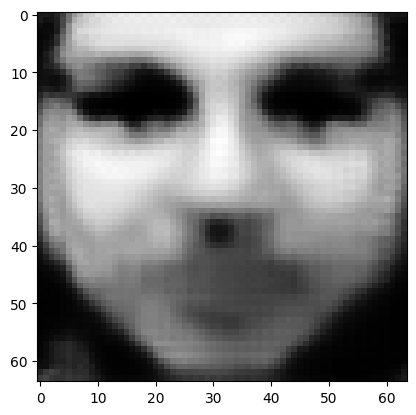

tensor([[2.5575e-07, 4.1075e-07, 1.0990e-03, 9.4866e-05, 1.2298e-05, 3.1173e-07,
         2.6335e-03, 2.2310e-06, 9.6062e-01, 3.0955e-03, 4.1391e-04, 1.0433e-04,
         3.0292e-04, 5.3151e-06, 3.6941e-04, 1.8080e-05, 4.6557e-04, 4.6556e-05,
         6.9074e-05, 2.5259e-04, 4.9152e-04, 8.8276e-04, 2.7930e-03, 3.1330e-04,
         2.7026e-03, 1.9449e-06, 7.7701e-05, 2.8222e-03, 8.7780e-03, 1.2770e-03,
         3.7715e-04, 3.1071e-07, 1.3438e-03, 2.7111e-05, 3.1271e-03, 2.1710e-05,
         1.3558e-04, 2.5851e-03, 1.6973e-03, 9.4075e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04017859324812889
tensor([[2.5565e-07, 4.1059e-07, 1.0988e-03, 9.4839e-05, 1.2294e-05, 3.1165e-07,
         2.6330e-03, 2.2303e-06, 9.6063e-01, 3.0950e-03, 4.1382e-04, 1.0430e-04,
         3.0283e-04, 5.3130e-06, 3.6934e-04, 1.8076e-05, 4.6545e-04, 4.6546e-05,
         6.9055e-05, 2.5255e-04, 4.9136e-04, 8.8253e-04, 2.7926e-03, 3.1323e-04,
         2.7019e-03, 1.9442e-06, 7.7680e-0

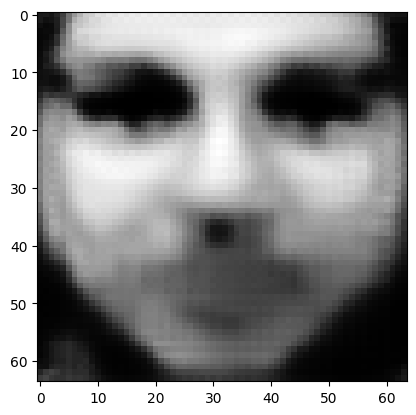

tensor([[2.5523e-07, 4.0995e-07, 1.0977e-03, 9.4735e-05, 1.2279e-05, 3.1135e-07,
         2.6309e-03, 2.2274e-06, 9.6066e-01, 3.0930e-03, 4.1347e-04, 1.0418e-04,
         3.0249e-04, 5.3048e-06, 3.6903e-04, 1.8059e-05, 4.6497e-04, 4.6510e-05,
         6.8982e-05, 2.5238e-04, 4.9074e-04, 8.8161e-04, 2.7908e-03, 3.1292e-04,
         2.6989e-03, 1.9413e-06, 7.7598e-05, 2.8192e-03, 8.7704e-03, 1.2759e-03,
         3.7665e-04, 3.1013e-07, 1.3424e-03, 2.7067e-05, 3.1233e-03, 2.1682e-05,
         1.3535e-04, 2.5816e-03, 1.6951e-03, 9.3944e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04013484716415405
tensor([[2.5512e-07, 4.0980e-07, 1.0975e-03, 9.4710e-05, 1.2276e-05, 3.1128e-07,
         2.6304e-03, 2.2267e-06, 9.6067e-01, 3.0925e-03, 4.1339e-04, 1.0415e-04,
         3.0241e-04, 5.3028e-06, 3.6896e-04, 1.8055e-05, 4.6486e-04, 4.6501e-05,
         6.8964e-05, 2.5234e-04, 4.9059e-04, 8.8139e-04, 2.7903e-03, 3.1284e-04,
         2.6981e-03, 1.9406e-06, 7.7578e-0

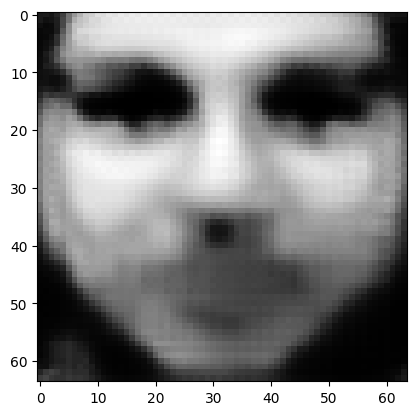

tensor([[2.5473e-07, 4.0919e-07, 1.0965e-03, 9.4611e-05, 1.2262e-05, 3.1100e-07,
         2.6284e-03, 2.2239e-06, 9.6070e-01, 3.0907e-03, 4.1306e-04, 1.0404e-04,
         3.0209e-04, 5.2950e-06, 3.6868e-04, 1.8038e-05, 4.6440e-04, 4.6466e-05,
         6.8894e-05, 2.5218e-04, 4.8999e-04, 8.8051e-04, 2.7886e-03, 3.1255e-04,
         2.6953e-03, 1.9379e-06, 7.7500e-05, 2.8164e-03, 8.7633e-03, 1.2749e-03,
         3.7617e-04, 3.0958e-07, 1.3410e-03, 2.7025e-05, 3.1197e-03, 2.1654e-05,
         1.3513e-04, 2.5784e-03, 1.6930e-03, 9.3820e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04009350389242172
tensor([[2.5463e-07, 4.0905e-07, 1.0963e-03, 9.4587e-05, 1.2258e-05, 3.1093e-07,
         2.6280e-03, 2.2233e-06, 9.6071e-01, 3.0902e-03, 4.1298e-04, 1.0401e-04,
         3.0201e-04, 5.2931e-06, 3.6861e-04, 1.8035e-05, 4.6429e-04, 4.6458e-05,
         6.8876e-05, 2.5214e-04, 4.8985e-04, 8.8030e-04, 2.7882e-03, 3.1248e-04,
         2.6946e-03, 1.9372e-06, 7.7481e-0

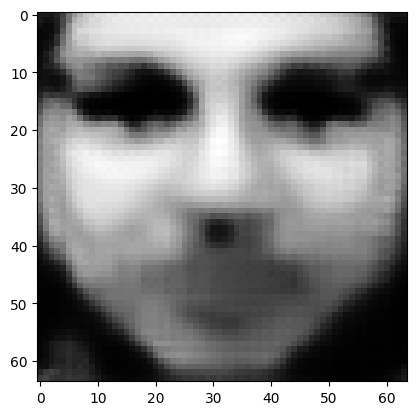

tensor([[2.5425e-07, 4.0848e-07, 1.0954e-03, 9.4493e-05, 1.2245e-05, 3.1066e-07,
         2.6261e-03, 2.2207e-06, 9.6074e-01, 3.0884e-03, 4.1267e-04, 1.0390e-04,
         3.0171e-04, 5.2858e-06, 3.6834e-04, 1.8019e-05, 4.6386e-04, 4.6425e-05,
         6.8810e-05, 2.5199e-04, 4.8929e-04, 8.7947e-04, 2.7866e-03, 3.1220e-04,
         2.6919e-03, 1.9347e-06, 7.7407e-05, 2.8137e-03, 8.7565e-03, 1.2739e-03,
         3.7572e-04, 3.0905e-07, 1.3397e-03, 2.6985e-05, 3.1162e-03, 2.1629e-05,
         1.3492e-04, 2.5753e-03, 1.6910e-03, 9.3703e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040053993463516235
tensor([[2.5416e-07, 4.0834e-07, 1.0952e-03, 9.4470e-05, 1.2242e-05, 3.1060e-07,
         2.6256e-03, 2.2200e-06, 9.6074e-01, 3.0880e-03, 4.1259e-04, 1.0387e-04,
         3.0164e-04, 5.2840e-06, 3.6827e-04, 1.8016e-05, 4.6376e-04, 4.6417e-05,
         6.8794e-05, 2.5195e-04, 4.8915e-04, 8.7927e-04, 2.7862e-03, 3.1213e-04,
         2.6912e-03, 1.9341e-06, 7.7389e-

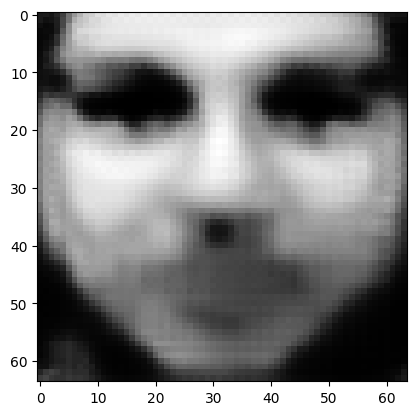

tensor([[2.5380e-07, 4.0779e-07, 1.0943e-03, 9.4381e-05, 1.2229e-05, 3.1034e-07,
         2.6239e-03, 2.2176e-06, 9.6077e-01, 3.0863e-03, 4.1230e-04, 1.0377e-04,
         3.0135e-04, 5.2770e-06, 3.6802e-04, 1.8001e-05, 4.6335e-04, 4.6386e-05,
         6.8731e-05, 2.5181e-04, 4.8862e-04, 8.7849e-04, 2.7847e-03, 3.1187e-04,
         2.6887e-03, 1.9316e-06, 7.7319e-05, 2.8111e-03, 8.7501e-03, 1.2729e-03,
         3.7529e-04, 3.0856e-07, 1.3385e-03, 2.6947e-05, 3.1130e-03, 2.1604e-05,
         1.3472e-04, 2.5723e-03, 1.6891e-03, 9.3592e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04001665487885475
tensor([[2.5372e-07, 4.0766e-07, 1.0941e-03, 9.4360e-05, 1.2226e-05, 3.1028e-07,
         2.6234e-03, 2.2170e-06, 9.6078e-01, 3.0859e-03, 4.1222e-04, 1.0375e-04,
         3.0128e-04, 5.2753e-06, 3.6795e-04, 1.7998e-05, 4.6325e-04, 4.6379e-05,
         6.8716e-05, 2.5177e-04, 4.8849e-04, 8.7830e-04, 2.7843e-03, 3.1180e-04,
         2.6881e-03, 1.9310e-06, 7.7302e-0

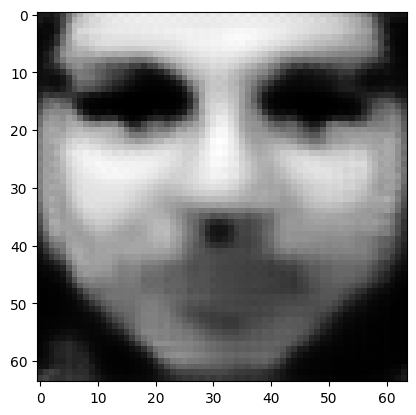

tensor([[2.5338e-07, 4.0715e-07, 1.0933e-03, 9.4276e-05, 1.2214e-05, 3.1004e-07,
         2.6218e-03, 2.2146e-06, 9.6081e-01, 3.0843e-03, 4.1194e-04, 1.0365e-04,
         3.0100e-04, 5.2687e-06, 3.6771e-04, 1.7984e-05, 4.6287e-04, 4.6349e-05,
         6.8656e-05, 2.5163e-04, 4.8799e-04, 8.7755e-04, 2.7829e-03, 3.1155e-04,
         2.6856e-03, 1.9287e-06, 7.7236e-05, 2.8087e-03, 8.7440e-03, 1.2720e-03,
         3.7489e-04, 3.0809e-07, 1.3373e-03, 2.6912e-05, 3.1099e-03, 2.1581e-05,
         1.3454e-04, 2.5695e-03, 1.6873e-03, 9.3486e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03998137637972832
tensor([[2.5330e-07, 4.0702e-07, 1.0931e-03, 9.4255e-05, 1.2211e-05, 3.0998e-07,
         2.6213e-03, 2.2141e-06, 9.6081e-01, 3.0839e-03, 4.1188e-04, 1.0363e-04,
         3.0094e-04, 5.2671e-06, 3.6765e-04, 1.7981e-05, 4.6277e-04, 4.6342e-05,
         6.8641e-05, 2.5160e-04, 4.8787e-04, 8.7737e-04, 2.7825e-03, 3.1149e-04,
         2.6850e-03, 1.9282e-06, 7.7220e-0

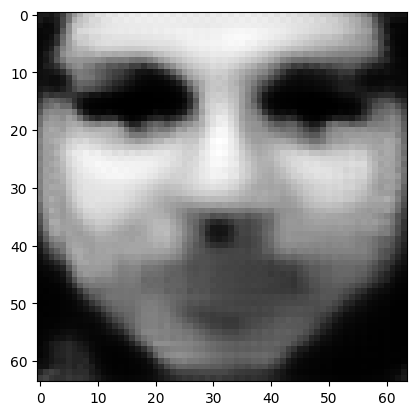

tensor([[2.5298e-07, 4.0653e-07, 1.0923e-03, 9.4175e-05, 1.2200e-05, 3.0975e-07,
         2.6198e-03, 2.2119e-06, 9.6084e-01, 3.0824e-03, 4.1161e-04, 1.0353e-04,
         3.0068e-04, 5.2608e-06, 3.6742e-04, 1.7967e-05, 4.6241e-04, 4.6314e-05,
         6.8584e-05, 2.5147e-04, 4.8739e-04, 8.7667e-04, 2.7812e-03, 3.1126e-04,
         2.6827e-03, 1.9260e-06, 7.7157e-05, 2.8064e-03, 8.7381e-03, 1.2712e-03,
         3.7450e-04, 3.0765e-07, 1.3362e-03, 2.6878e-05, 3.1070e-03, 2.1559e-05,
         1.3436e-04, 2.5669e-03, 1.6856e-03, 9.3386e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03994781896471977
tensor([[2.5290e-07, 4.0641e-07, 1.0921e-03, 9.4156e-05, 1.2197e-05, 3.0970e-07,
         2.6194e-03, 2.2113e-06, 9.6085e-01, 3.0820e-03, 4.1154e-04, 1.0351e-04,
         3.0062e-04, 5.2592e-06, 3.6737e-04, 1.7964e-05, 4.6232e-04, 4.6307e-05,
         6.8570e-05, 2.5144e-04, 4.8727e-04, 8.7649e-04, 2.7808e-03, 3.1120e-04,
         2.6822e-03, 1.9255e-06, 7.7141e-0

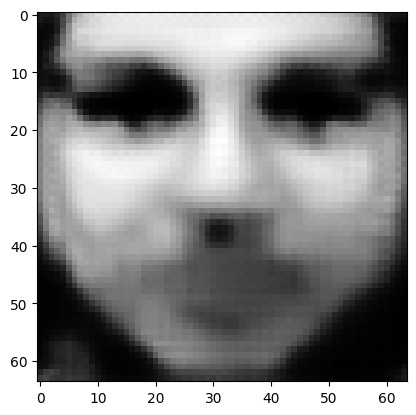

tensor([[2.5259e-07, 4.0595e-07, 1.0913e-03, 9.4080e-05, 1.2186e-05, 3.0948e-07,
         2.6178e-03, 2.2092e-06, 9.6087e-01, 3.0806e-03, 4.1129e-04, 1.0342e-04,
         3.0037e-04, 5.2533e-06, 3.6715e-04, 1.7952e-05, 4.6197e-04, 4.6280e-05,
         6.8517e-05, 2.5131e-04, 4.8682e-04, 8.7582e-04, 2.7795e-03, 3.1097e-04,
         2.6800e-03, 1.9234e-06, 7.7082e-05, 2.8042e-03, 8.7326e-03, 1.2704e-03,
         3.7414e-04, 3.0722e-07, 1.3351e-03, 2.6846e-05, 3.1042e-03, 2.1538e-05,
         1.3419e-04, 2.5644e-03, 1.6840e-03, 9.3291e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03991585969924927
tensor([[2.5252e-07, 4.0584e-07, 1.0911e-03, 9.4061e-05, 1.2183e-05, 3.0943e-07,
         2.6175e-03, 2.2087e-06, 9.6088e-01, 3.0802e-03, 4.1123e-04, 1.0340e-04,
         3.0031e-04, 5.2518e-06, 3.6709e-04, 1.7949e-05, 4.6188e-04, 4.6274e-05,
         6.8503e-05, 2.5128e-04, 4.8670e-04, 8.7566e-04, 2.7792e-03, 3.1092e-04,
         2.6794e-03, 1.9229e-06, 7.7067e-0

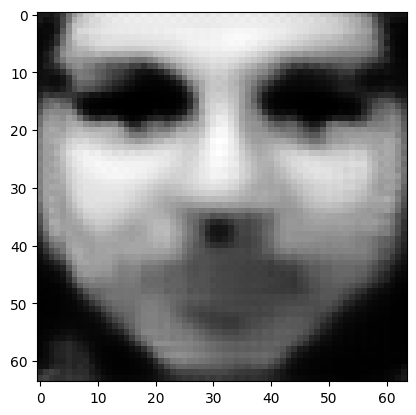

tensor([[2.5223e-07, 4.0540e-07, 1.0904e-03, 9.3990e-05, 1.2173e-05, 3.0922e-07,
         2.6160e-03, 2.2067e-06, 9.6090e-01, 3.0789e-03, 4.1099e-04, 1.0332e-04,
         3.0008e-04, 5.2462e-06, 3.6689e-04, 1.7937e-05, 4.6156e-04, 4.6249e-05,
         6.8452e-05, 2.5117e-04, 4.8628e-04, 8.7503e-04, 2.7780e-03, 3.1070e-04,
         2.6774e-03, 1.9209e-06, 7.7011e-05, 2.8022e-03, 8.7274e-03, 1.2696e-03,
         3.7379e-04, 3.0682e-07, 1.3341e-03, 2.6815e-05, 3.1015e-03, 2.1518e-05,
         1.3403e-04, 2.5620e-03, 1.6824e-03, 9.3200e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0398855060338974
tensor([[2.5216e-07, 4.0529e-07, 1.0903e-03, 9.3972e-05, 1.2171e-05, 3.0917e-07,
         2.6157e-03, 2.2062e-06, 9.6091e-01, 3.0785e-03, 4.1093e-04, 1.0330e-04,
         3.0002e-04, 5.2448e-06, 3.6683e-04, 1.7934e-05, 4.6148e-04, 4.6242e-05,
         6.8440e-05, 2.5114e-04, 4.8617e-04, 8.7487e-04, 2.7777e-03, 3.1065e-04,
         2.6769e-03, 1.9205e-06, 7.6997e-05

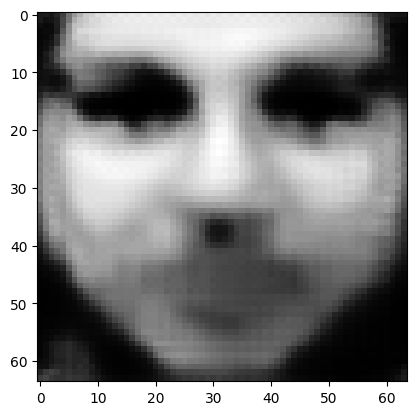

tensor([[2.5189e-07, 4.0487e-07, 1.0896e-03, 9.3904e-05, 1.2161e-05, 3.0897e-07,
         2.6143e-03, 2.2043e-06, 9.6093e-01, 3.0772e-03, 4.1070e-04, 1.0322e-04,
         2.9980e-04, 5.2394e-06, 3.6664e-04, 1.7923e-05, 4.6116e-04, 4.6218e-05,
         6.8391e-05, 2.5103e-04, 4.8576e-04, 8.7426e-04, 2.7765e-03, 3.1045e-04,
         2.6749e-03, 1.9186e-06, 7.6943e-05, 2.8002e-03, 8.7224e-03, 1.2689e-03,
         3.7346e-04, 3.0644e-07, 1.3332e-03, 2.6786e-05, 3.0990e-03, 2.1499e-05,
         1.3387e-04, 2.5597e-03, 1.6810e-03, 9.3115e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03985675424337387
tensor([[2.5182e-07, 4.0477e-07, 1.0894e-03, 9.3887e-05, 1.2159e-05, 3.0893e-07,
         2.6140e-03, 2.2039e-06, 9.6093e-01, 3.0769e-03, 4.1064e-04, 1.0320e-04,
         2.9974e-04, 5.2381e-06, 3.6659e-04, 1.7920e-05, 4.6108e-04, 4.6213e-05,
         6.8380e-05, 2.5100e-04, 4.8566e-04, 8.7412e-04, 2.7762e-03, 3.1040e-04,
         2.6744e-03, 1.9181e-06, 7.6930e-0

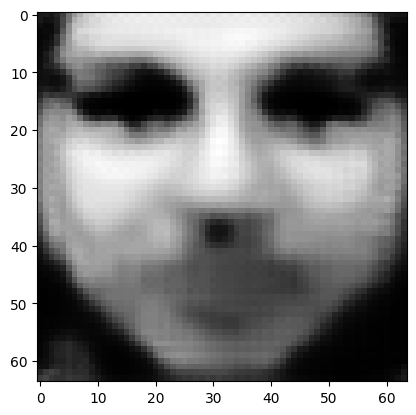

tensor([[2.5156e-07, 4.0438e-07, 1.0888e-03, 9.3822e-05, 1.2149e-05, 3.0874e-07,
         2.6127e-03, 2.2021e-06, 9.6095e-01, 3.0757e-03, 4.1043e-04, 1.0313e-04,
         2.9953e-04, 5.2330e-06, 3.6640e-04, 1.7910e-05, 4.6079e-04, 4.6190e-05,
         6.8334e-05, 2.5089e-04, 4.8527e-04, 8.7354e-04, 2.7751e-03, 3.1021e-04,
         2.6725e-03, 1.9164e-06, 7.6878e-05, 2.7983e-03, 8.7177e-03, 1.2682e-03,
         3.7315e-04, 3.0608e-07, 1.3323e-03, 2.6759e-05, 3.0967e-03, 2.1481e-05,
         1.3373e-04, 2.5576e-03, 1.6796e-03, 9.3033e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039829377084970474
tensor([[2.5150e-07, 4.0428e-07, 1.0887e-03, 9.3807e-05, 1.2147e-05, 3.0870e-07,
         2.6124e-03, 2.2016e-06, 9.6096e-01, 3.0754e-03, 4.1037e-04, 1.0311e-04,
         2.9948e-04, 5.2318e-06, 3.6636e-04, 1.7907e-05, 4.6072e-04, 4.6184e-05,
         6.8322e-05, 2.5087e-04, 4.8518e-04, 8.7341e-04, 2.7748e-03, 3.1016e-04,
         2.6721e-03, 1.9159e-06, 7.6866e-

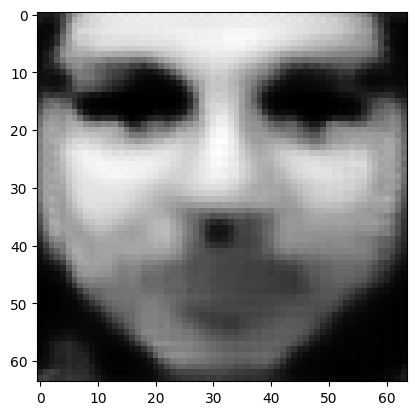

tensor([[2.5125e-07, 4.0391e-07, 1.0880e-03, 9.3745e-05, 1.2138e-05, 3.0852e-07,
         2.6111e-03, 2.1999e-06, 9.6098e-01, 3.0742e-03, 4.1017e-04, 1.0304e-04,
         2.9928e-04, 5.2270e-06, 3.6618e-04, 1.7897e-05, 4.6043e-04, 4.6163e-05,
         6.8279e-05, 2.5077e-04, 4.8481e-04, 8.7286e-04, 2.7738e-03, 3.0998e-04,
         2.6703e-03, 1.9143e-06, 7.6818e-05, 2.7966e-03, 8.7132e-03, 1.2675e-03,
         3.7285e-04, 3.0574e-07, 1.3314e-03, 2.6733e-05, 3.0944e-03, 2.1464e-05,
         1.3359e-04, 2.5556e-03, 1.6783e-03, 9.2956e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039803601801395416
tensor([[2.5119e-07, 4.0381e-07, 1.0879e-03, 9.3730e-05, 1.2136e-05, 3.0848e-07,
         2.6108e-03, 2.1995e-06, 9.6098e-01, 3.0739e-03, 4.1012e-04, 1.0302e-04,
         2.9923e-04, 5.2258e-06, 3.6613e-04, 1.7895e-05, 4.6036e-04, 4.6157e-05,
         6.8268e-05, 2.5074e-04, 4.8472e-04, 8.7273e-04, 2.7735e-03, 3.0993e-04,
         2.6699e-03, 1.9139e-06, 7.6806e-

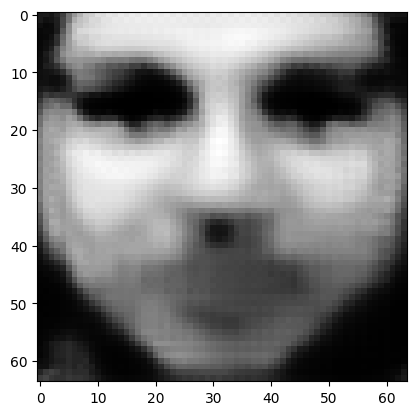

tensor([[2.5095e-07, 4.0346e-07, 1.0873e-03, 9.3672e-05, 1.2128e-05, 3.0831e-07,
         2.6097e-03, 2.1979e-06, 9.6100e-01, 3.0728e-03, 4.0992e-04, 1.0295e-04,
         2.9904e-04, 5.2212e-06, 3.6596e-04, 1.7885e-05, 4.6010e-04, 4.6137e-05,
         6.8226e-05, 2.5065e-04, 4.8437e-04, 8.7221e-04, 2.7725e-03, 3.0976e-04,
         2.6682e-03, 1.9123e-06, 7.6760e-05, 2.7949e-03, 8.7089e-03, 1.2669e-03,
         3.7257e-04, 3.0542e-07, 1.3306e-03, 2.6708e-05, 3.0923e-03, 2.1448e-05,
         1.3346e-04, 2.5536e-03, 1.6770e-03, 9.2882e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039778854697942734
tensor([[2.5090e-07, 4.0337e-07, 1.0872e-03, 9.3657e-05, 1.2126e-05, 3.0827e-07,
         2.6094e-03, 2.1975e-06, 9.6101e-01, 3.0725e-03, 4.0987e-04, 1.0293e-04,
         2.9900e-04, 5.2201e-06, 3.6592e-04, 1.7883e-05, 4.6003e-04, 4.6132e-05,
         6.8216e-05, 2.5062e-04, 4.8429e-04, 8.7208e-04, 2.7723e-03, 3.0972e-04,
         2.6678e-03, 1.9119e-06, 7.6749e-

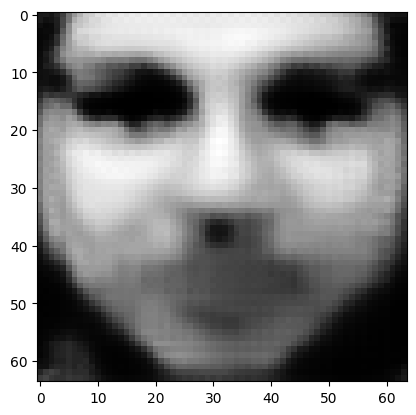

tensor([[2.5068e-07, 4.0303e-07, 1.0866e-03, 9.3602e-05, 1.2118e-05, 3.0811e-07,
         2.6083e-03, 2.1960e-06, 9.6102e-01, 3.0715e-03, 4.0969e-04, 1.0287e-04,
         2.9882e-04, 5.2158e-06, 3.6576e-04, 1.7874e-05, 4.5978e-04, 4.6112e-05,
         6.8177e-05, 2.5053e-04, 4.8395e-04, 8.7159e-04, 2.7713e-03, 3.0955e-04,
         2.6662e-03, 1.9104e-06, 7.6705e-05, 2.7933e-03, 8.7049e-03, 1.2663e-03,
         3.7230e-04, 3.0511e-07, 1.3298e-03, 2.6685e-05, 3.0902e-03, 2.1433e-05,
         1.3334e-04, 2.5518e-03, 1.6758e-03, 9.2813e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039755601435899734
tensor([[2.5062e-07, 4.0295e-07, 1.0865e-03, 9.3588e-05, 1.2116e-05, 3.0807e-07,
         2.6080e-03, 2.1956e-06, 9.6103e-01, 3.0712e-03, 4.0964e-04, 1.0285e-04,
         2.9877e-04, 5.2147e-06, 3.6572e-04, 1.7871e-05, 4.5971e-04, 4.6108e-05,
         6.8167e-05, 2.5051e-04, 4.8387e-04, 8.7147e-04, 2.7711e-03, 3.0951e-04,
         2.6658e-03, 1.9100e-06, 7.6694e-

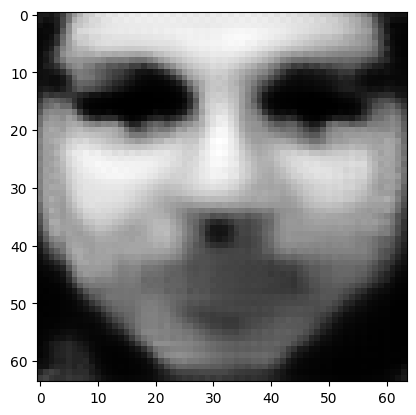

tensor([[2.5041e-07, 4.0263e-07, 1.0860e-03, 9.3536e-05, 1.2109e-05, 3.0792e-07,
         2.6070e-03, 2.1941e-06, 9.6105e-01, 3.0702e-03, 4.0947e-04, 1.0279e-04,
         2.9860e-04, 5.2106e-06, 3.6557e-04, 1.7863e-05, 4.5947e-04, 4.6089e-05,
         6.8130e-05, 2.5043e-04, 4.8356e-04, 8.7101e-04, 2.7702e-03, 3.0935e-04,
         2.6643e-03, 1.9086e-06, 7.6653e-05, 2.7918e-03, 8.7011e-03, 1.2657e-03,
         3.7205e-04, 3.0481e-07, 1.3291e-03, 2.6662e-05, 3.0883e-03, 2.1418e-05,
         1.3322e-04, 2.5500e-03, 1.6747e-03, 9.2747e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03973326086997986
tensor([[2.5036e-07, 4.0255e-07, 1.0859e-03, 9.3523e-05, 1.2107e-05, 3.0788e-07,
         2.6067e-03, 2.1938e-06, 9.6105e-01, 3.0700e-03, 4.0942e-04, 1.0278e-04,
         2.9856e-04, 5.2096e-06, 3.6553e-04, 1.7861e-05, 4.5941e-04, 4.6085e-05,
         6.8121e-05, 2.5040e-04, 4.8348e-04, 8.7089e-04, 2.7699e-03, 3.0932e-04,
         2.6639e-03, 1.9082e-06, 7.6642e-0

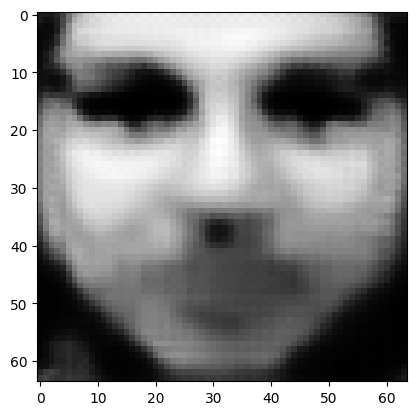

tensor([[2.5016e-07, 4.0225e-07, 1.0854e-03, 9.3473e-05, 1.2100e-05, 3.0774e-07,
         2.6057e-03, 2.1924e-06, 9.6107e-01, 3.0690e-03, 4.0926e-04, 1.0272e-04,
         2.9840e-04, 5.2056e-06, 3.6539e-04, 1.7853e-05, 4.5918e-04, 4.6067e-05,
         6.8085e-05, 2.5032e-04, 4.8318e-04, 8.7045e-04, 2.7691e-03, 3.0917e-04,
         2.6625e-03, 1.9069e-06, 7.6603e-05, 2.7903e-03, 8.6974e-03, 1.2652e-03,
         3.7180e-04, 3.0454e-07, 1.3284e-03, 2.6641e-05, 3.0864e-03, 2.1405e-05,
         1.3311e-04, 2.5484e-03, 1.6736e-03, 9.2684e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03971217945218086
tensor([[2.5011e-07, 4.0217e-07, 1.0853e-03, 9.3460e-05, 1.2098e-05, 3.0770e-07,
         2.6055e-03, 2.1920e-06, 9.6107e-01, 3.0688e-03, 4.0921e-04, 1.0271e-04,
         2.9836e-04, 5.2047e-06, 3.6535e-04, 1.7851e-05, 4.5913e-04, 4.6063e-05,
         6.8076e-05, 2.5030e-04, 4.8311e-04, 8.7034e-04, 2.7689e-03, 3.0913e-04,
         2.6621e-03, 1.9065e-06, 7.6593e-0

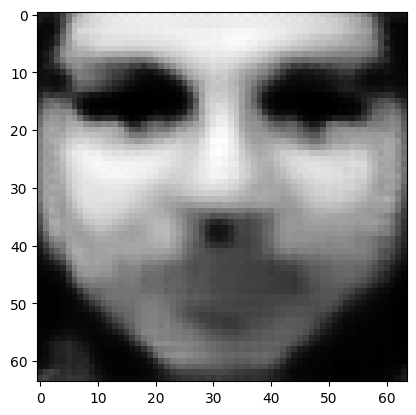

tensor([[2.4992e-07, 4.0188e-07, 1.0848e-03, 9.3413e-05, 1.2091e-05, 3.0757e-07,
         2.6045e-03, 2.1907e-06, 9.6109e-01, 3.0679e-03, 4.0906e-04, 1.0265e-04,
         2.9821e-04, 5.2010e-06, 3.6522e-04, 1.7843e-05, 4.5891e-04, 4.6046e-05,
         6.8043e-05, 2.5022e-04, 4.8282e-04, 8.6992e-04, 2.7680e-03, 3.0899e-04,
         2.6607e-03, 1.9052e-06, 7.6556e-05, 2.7889e-03, 8.6939e-03, 1.2647e-03,
         3.7158e-04, 3.0427e-07, 1.3277e-03, 2.6621e-05, 3.0847e-03, 2.1391e-05,
         1.3300e-04, 2.5468e-03, 1.6726e-03, 9.2624e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03969212993979454
tensor([[2.4987e-07, 4.0181e-07, 1.0847e-03, 9.3401e-05, 1.2090e-05, 3.0754e-07,
         2.6043e-03, 2.1904e-06, 9.6109e-01, 3.0677e-03, 4.0902e-04, 1.0264e-04,
         2.9817e-04, 5.2001e-06, 3.6518e-04, 1.7841e-05, 4.5886e-04, 4.6042e-05,
         6.8035e-05, 2.5021e-04, 4.8275e-04, 8.6982e-04, 2.7678e-03, 3.0896e-04,
         2.6604e-03, 1.9049e-06, 7.6547e-0

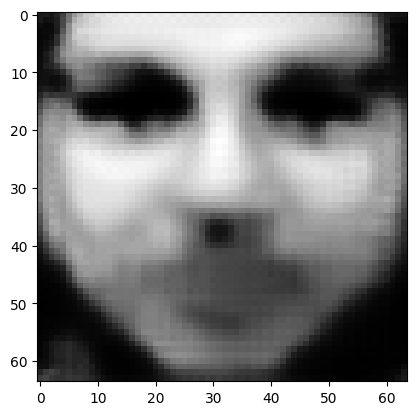

tensor([[2.4969e-07, 4.0154e-07, 1.0842e-03, 9.3356e-05, 1.2083e-05, 3.0741e-07,
         2.6034e-03, 2.1892e-06, 9.6110e-01, 3.0668e-03, 4.0887e-04, 1.0259e-04,
         2.9802e-04, 5.1965e-06, 3.6505e-04, 1.7834e-05, 4.5865e-04, 4.6026e-05,
         6.8002e-05, 2.5013e-04, 4.8248e-04, 8.6942e-04, 2.7671e-03, 3.0882e-04,
         2.6591e-03, 1.9037e-06, 7.6511e-05, 2.7876e-03, 8.6906e-03, 1.2642e-03,
         3.7136e-04, 3.0402e-07, 1.3271e-03, 2.6602e-05, 3.0830e-03, 2.1379e-05,
         1.3290e-04, 2.5453e-03, 1.6716e-03, 9.2567e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03967311233282089
tensor([[2.4965e-07, 4.0147e-07, 1.0841e-03, 9.3345e-05, 1.2082e-05, 3.0737e-07,
         2.6032e-03, 2.1888e-06, 9.6111e-01, 3.0666e-03, 4.0883e-04, 1.0257e-04,
         2.9799e-04, 5.1956e-06, 3.6502e-04, 1.7832e-05, 4.5860e-04, 4.6022e-05,
         6.7994e-05, 2.5011e-04, 4.8242e-04, 8.6932e-04, 2.7669e-03, 3.0879e-04,
         2.6588e-03, 1.9034e-06, 7.6502e-0

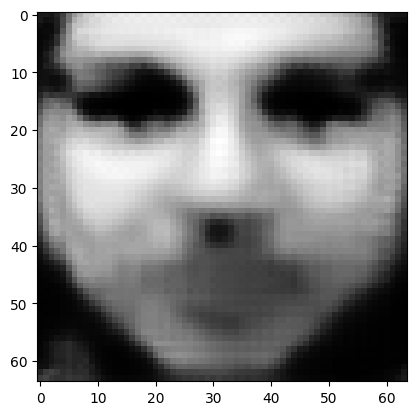

tensor([[2.4948e-07, 4.0121e-07, 1.0837e-03, 9.3302e-05, 1.2076e-05, 3.0725e-07,
         2.6023e-03, 2.1877e-06, 9.6112e-01, 3.0658e-03, 4.0868e-04, 1.0252e-04,
         2.9785e-04, 5.1923e-06, 3.6489e-04, 1.7825e-05, 4.5840e-04, 4.6007e-05,
         6.7964e-05, 2.5004e-04, 4.8216e-04, 8.6894e-04, 2.7661e-03, 3.0866e-04,
         2.6575e-03, 1.9022e-06, 7.6469e-05, 2.7864e-03, 8.6875e-03, 1.2637e-03,
         3.7115e-04, 3.0379e-07, 1.3265e-03, 2.6584e-05, 3.0815e-03, 2.1367e-05,
         1.3281e-04, 2.5439e-03, 1.6707e-03, 9.2513e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03965500742197037
tensor([[2.4944e-07, 4.0115e-07, 1.0836e-03, 9.3292e-05, 1.2074e-05, 3.0722e-07,
         2.6021e-03, 2.1874e-06, 9.6112e-01, 3.0656e-03, 4.0865e-04, 1.0251e-04,
         2.9781e-04, 5.1915e-06, 3.6486e-04, 1.7823e-05, 4.5836e-04, 4.6003e-05,
         6.7957e-05, 2.5003e-04, 4.8210e-04, 8.6885e-04, 2.7660e-03, 3.0863e-04,
         2.6572e-03, 1.9019e-06, 7.6460e-0

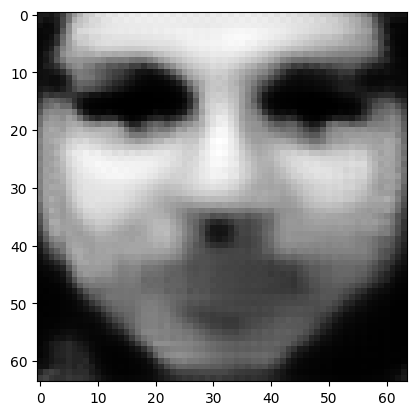

tensor([[2.4927e-07, 4.0090e-07, 1.0832e-03, 9.3251e-05, 1.2068e-05, 3.0711e-07,
         2.6013e-03, 2.1862e-06, 9.6114e-01, 3.0648e-03, 4.0851e-04, 1.0247e-04,
         2.9768e-04, 5.1883e-06, 3.6475e-04, 1.7816e-05, 4.5817e-04, 4.5989e-05,
         6.7928e-05, 2.4996e-04, 4.8185e-04, 8.6849e-04, 2.7652e-03, 3.0851e-04,
         2.6561e-03, 1.9008e-06, 7.6428e-05, 2.7852e-03, 8.6845e-03, 1.2633e-03,
         3.7095e-04, 3.0356e-07, 1.3259e-03, 2.6566e-05, 3.0800e-03, 2.1356e-05,
         1.3272e-04, 2.5425e-03, 1.6699e-03, 9.2462e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03963782265782356
tensor([[2.4923e-07, 4.0084e-07, 1.0831e-03, 9.3241e-05, 1.2067e-05, 3.0708e-07,
         2.6011e-03, 2.1860e-06, 9.6114e-01, 3.0646e-03, 4.0848e-04, 1.0245e-04,
         2.9765e-04, 5.1875e-06, 3.6472e-04, 1.7815e-05, 4.5812e-04, 4.5986e-05,
         6.7921e-05, 2.4994e-04, 4.8180e-04, 8.6840e-04, 2.7651e-03, 3.0848e-04,
         2.6558e-03, 1.9006e-06, 7.6421e-0

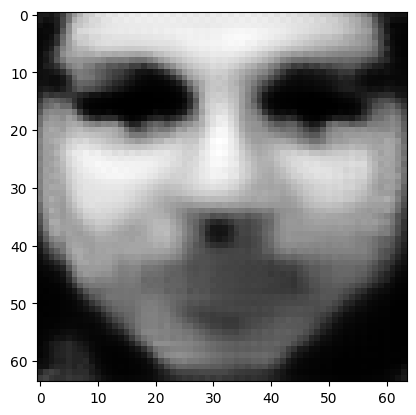

tensor([[2.4908e-07, 4.0060e-07, 1.0827e-03, 9.3202e-05, 1.2061e-05, 3.0697e-07,
         2.6003e-03, 2.1849e-06, 9.6115e-01, 3.0638e-03, 4.0835e-04, 1.0241e-04,
         2.9752e-04, 5.1845e-06, 3.6460e-04, 1.7808e-05, 4.5794e-04, 4.5972e-05,
         6.7893e-05, 2.4988e-04, 4.8156e-04, 8.6806e-04, 2.7644e-03, 3.0836e-04,
         2.6547e-03, 1.8995e-06, 7.6390e-05, 2.7841e-03, 8.6817e-03, 1.2629e-03,
         3.7077e-04, 3.0334e-07, 1.3254e-03, 2.6550e-05, 3.0785e-03, 2.1345e-05,
         1.3263e-04, 2.5413e-03, 1.6690e-03, 9.2414e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039621323347091675
tensor([[2.4904e-07, 4.0054e-07, 1.0826e-03, 9.3193e-05, 1.2060e-05, 3.0694e-07,
         2.6001e-03, 2.1846e-06, 9.6116e-01, 3.0637e-03, 4.0832e-04, 1.0240e-04,
         2.9749e-04, 5.1838e-06, 3.6458e-04, 1.7807e-05, 4.5790e-04, 4.5969e-05,
         6.7886e-05, 2.4986e-04, 4.8151e-04, 8.6797e-04, 2.7642e-03, 3.0834e-04,
         2.6544e-03, 1.8992e-06, 7.6382e-

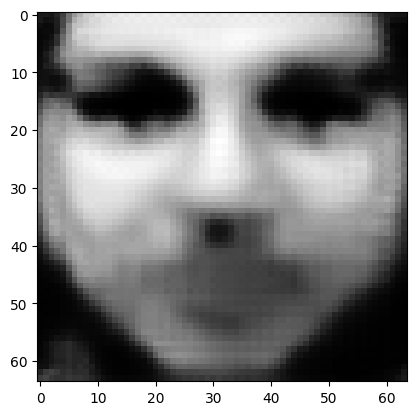

tensor([[2.4889e-07, 4.0032e-07, 1.0823e-03, 9.3156e-05, 1.2055e-05, 3.0683e-07,
         2.5994e-03, 2.1836e-06, 9.6117e-01, 3.0630e-03, 4.0819e-04, 1.0236e-04,
         2.9737e-04, 5.1809e-06, 3.6447e-04, 1.7801e-05, 4.5773e-04, 4.5956e-05,
         6.7860e-05, 2.4980e-04, 4.8129e-04, 8.6765e-04, 2.7636e-03, 3.0823e-04,
         2.6533e-03, 1.8982e-06, 7.6353e-05, 2.7830e-03, 8.6790e-03, 1.2625e-03,
         3.7059e-04, 3.0314e-07, 1.3249e-03, 2.6535e-05, 3.0772e-03, 2.1335e-05,
         1.3255e-04, 2.5400e-03, 1.6682e-03, 9.2368e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039605967700481415
tensor([[2.4886e-07, 4.0027e-07, 1.0822e-03, 9.3147e-05, 1.2054e-05, 3.0681e-07,
         2.5992e-03, 2.1834e-06, 9.6117e-01, 3.0628e-03, 4.0816e-04, 1.0235e-04,
         2.9734e-04, 5.1801e-06, 3.6445e-04, 1.7799e-05, 4.5769e-04, 4.5953e-05,
         6.7854e-05, 2.4979e-04, 4.8123e-04, 8.6757e-04, 2.7635e-03, 3.0820e-04,
         2.6531e-03, 1.8980e-06, 7.6346e-

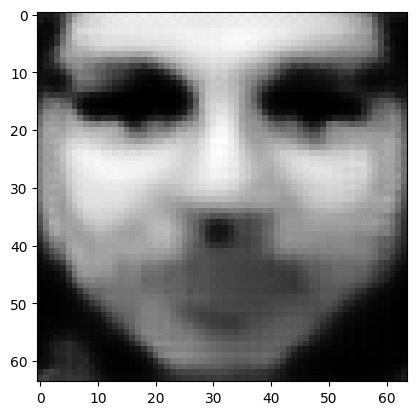

tensor([[2.4872e-07, 4.0005e-07, 1.0818e-03, 9.3113e-05, 1.2049e-05, 3.0671e-07,
         2.5985e-03, 2.1824e-06, 9.6118e-01, 3.0621e-03, 4.0805e-04, 1.0231e-04,
         2.9723e-04, 5.1774e-06, 3.6434e-04, 1.7794e-05, 4.5753e-04, 4.5941e-05,
         6.7829e-05, 2.4973e-04, 4.8103e-04, 8.6726e-04, 2.7628e-03, 3.0810e-04,
         2.6521e-03, 1.8970e-06, 7.6319e-05, 2.7820e-03, 8.6764e-03, 1.2621e-03,
         3.7042e-04, 3.0295e-07, 1.3244e-03, 2.6520e-05, 3.0759e-03, 2.1325e-05,
         1.3247e-04, 2.5389e-03, 1.6675e-03, 9.2324e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03959130123257637
tensor([[2.4868e-07, 4.0000e-07, 1.0817e-03, 9.3104e-05, 1.2047e-05, 3.0668e-07,
         2.5983e-03, 2.1822e-06, 9.6119e-01, 3.0620e-03, 4.0802e-04, 1.0230e-04,
         2.9720e-04, 5.1768e-06, 3.6432e-04, 1.7792e-05, 4.5749e-04, 4.5938e-05,
         6.7823e-05, 2.4972e-04, 4.8097e-04, 8.6719e-04, 2.7627e-03, 3.0807e-04,
         2.6518e-03, 1.8968e-06, 7.6312e-0

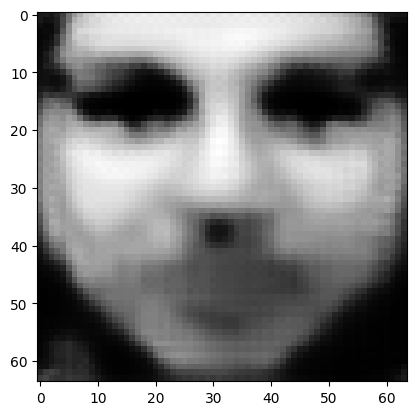

tensor([[2.4855e-07, 3.9980e-07, 1.0814e-03, 9.3071e-05, 1.2043e-05, 3.0659e-07,
         2.5977e-03, 2.1812e-06, 9.6120e-01, 3.0613e-03, 4.0791e-04, 1.0226e-04,
         2.9710e-04, 5.1742e-06, 3.6422e-04, 1.7787e-05, 4.5734e-04, 4.5926e-05,
         6.7799e-05, 2.4966e-04, 4.8078e-04, 8.6689e-04, 2.7621e-03, 3.0797e-04,
         2.6509e-03, 1.8959e-06, 7.6286e-05, 2.7811e-03, 8.6740e-03, 1.2618e-03,
         3.7026e-04, 3.0276e-07, 1.3239e-03, 2.6506e-05, 3.0747e-03, 2.1316e-05,
         1.3240e-04, 2.5378e-03, 1.6668e-03, 9.2282e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03957720845937729
tensor([[2.4852e-07, 3.9975e-07, 1.0813e-03, 9.3063e-05, 1.2041e-05, 3.0656e-07,
         2.5975e-03, 2.1810e-06, 9.6120e-01, 3.0612e-03, 4.0788e-04, 1.0225e-04,
         2.9707e-04, 5.1735e-06, 3.6420e-04, 1.7785e-05, 4.5730e-04, 4.5923e-05,
         6.7793e-05, 2.4965e-04, 4.8073e-04, 8.6682e-04, 2.7620e-03, 3.0795e-04,
         2.6506e-03, 1.8957e-06, 7.6279e-0

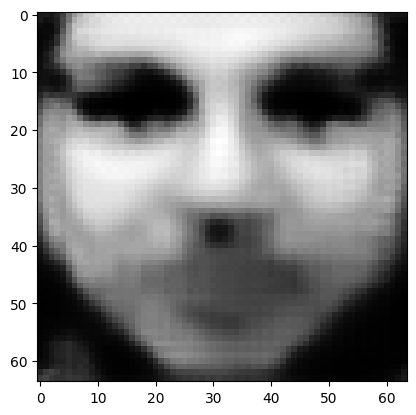

tensor([[2.4839e-07, 3.9956e-07, 1.0810e-03, 9.3031e-05, 1.2037e-05, 3.0647e-07,
         2.5969e-03, 2.1801e-06, 9.6121e-01, 3.0606e-03, 4.0777e-04, 1.0221e-04,
         2.9697e-04, 5.1711e-06, 3.6411e-04, 1.7780e-05, 4.5716e-04, 4.5912e-05,
         6.7771e-05, 2.4960e-04, 4.8054e-04, 8.6654e-04, 2.7614e-03, 3.0786e-04,
         2.6497e-03, 1.8948e-06, 7.6255e-05, 2.7802e-03, 8.6717e-03, 1.2614e-03,
         3.7011e-04, 3.0259e-07, 1.3235e-03, 2.6492e-05, 3.0735e-03, 2.1307e-05,
         1.3233e-04, 2.5367e-03, 1.6661e-03, 9.2242e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03956391662359238
tensor([[2.4836e-07, 3.9951e-07, 1.0810e-03, 9.3023e-05, 1.2036e-05, 3.0645e-07,
         2.5967e-03, 2.1799e-06, 9.6121e-01, 3.0604e-03, 4.0775e-04, 1.0220e-04,
         2.9694e-04, 5.1705e-06, 3.6409e-04, 1.7779e-05, 4.5712e-04, 4.5909e-05,
         6.7766e-05, 2.4959e-04, 4.8049e-04, 8.6647e-04, 2.7613e-03, 3.0783e-04,
         2.6495e-03, 1.8946e-06, 7.6249e-0

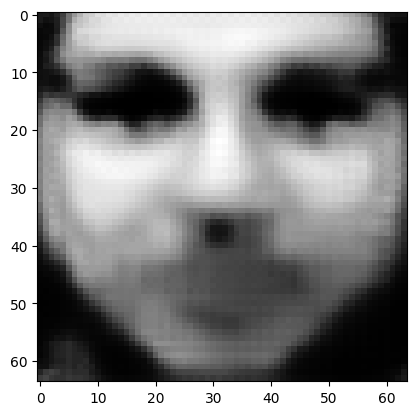

tensor([[2.4824e-07, 3.9933e-07, 1.0807e-03, 9.2994e-05, 1.2032e-05, 3.0637e-07,
         2.5961e-03, 2.1791e-06, 9.6122e-01, 3.0598e-03, 4.0765e-04, 1.0217e-04,
         2.9685e-04, 5.1681e-06, 3.6400e-04, 1.7774e-05, 4.5698e-04, 4.5899e-05,
         6.7744e-05, 2.4954e-04, 4.8032e-04, 8.6621e-04, 2.7608e-03, 3.0774e-04,
         2.6486e-03, 1.8938e-06, 7.6225e-05, 2.7793e-03, 8.6695e-03, 1.2611e-03,
         3.6997e-04, 3.0242e-07, 1.3231e-03, 2.6480e-05, 3.0724e-03, 2.1299e-05,
         1.3226e-04, 2.5357e-03, 1.6655e-03, 9.2205e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03955131396651268
tensor([[2.4821e-07, 3.9929e-07, 1.0806e-03, 9.2987e-05, 1.2031e-05, 3.0634e-07,
         2.5960e-03, 2.1789e-06, 9.6122e-01, 3.0597e-03, 4.0762e-04, 1.0216e-04,
         2.9682e-04, 5.1675e-06, 3.6398e-04, 1.7773e-05, 4.5695e-04, 4.5896e-05,
         6.7739e-05, 2.4952e-04, 4.8027e-04, 8.6614e-04, 2.7606e-03, 3.0772e-04,
         2.6484e-03, 1.8936e-06, 7.6219e-0

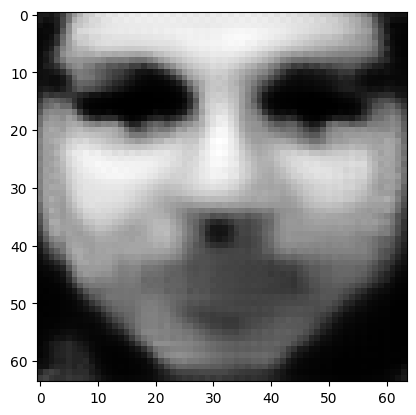

tensor([[2.4810e-07, 3.9911e-07, 1.0803e-03, 9.2958e-05, 1.2027e-05, 3.0626e-07,
         2.5954e-03, 2.1781e-06, 9.6123e-01, 3.0591e-03, 4.0752e-04, 1.0213e-04,
         2.9673e-04, 5.1653e-06, 3.6390e-04, 1.7768e-05, 4.5682e-04, 4.5886e-05,
         6.7719e-05, 2.4948e-04, 4.8010e-04, 8.6589e-04, 2.7601e-03, 3.0764e-04,
         2.6476e-03, 1.8928e-06, 7.6197e-05, 2.7785e-03, 8.6674e-03, 1.2608e-03,
         3.6983e-04, 3.0226e-07, 1.3227e-03, 2.6468e-05, 3.0714e-03, 2.1291e-05,
         1.3220e-04, 2.5348e-03, 1.6649e-03, 9.2169e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03953905031085014
tensor([[2.4807e-07, 3.9907e-07, 1.0802e-03, 9.2951e-05, 1.2026e-05, 3.0624e-07,
         2.5952e-03, 2.1779e-06, 9.6123e-01, 3.0590e-03, 4.0750e-04, 1.0212e-04,
         2.9671e-04, 5.1648e-06, 3.6388e-04, 1.7767e-05, 4.5679e-04, 4.5884e-05,
         6.7714e-05, 2.4947e-04, 4.8006e-04, 8.6583e-04, 2.7600e-03, 3.0762e-04,
         2.6474e-03, 1.8926e-06, 7.6191e-0

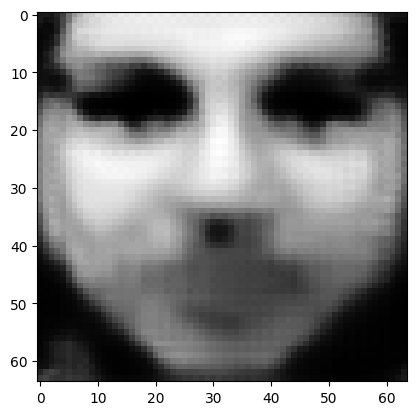

tensor([[2.4796e-07, 3.9891e-07, 1.0800e-03, 9.2924e-05, 1.2022e-05, 3.0616e-07,
         2.5947e-03, 2.1771e-06, 9.6124e-01, 3.0585e-03, 4.0741e-04, 1.0209e-04,
         2.9662e-04, 5.1626e-06, 3.6380e-04, 1.7763e-05, 4.5666e-04, 4.5874e-05,
         6.7695e-05, 2.4942e-04, 4.7990e-04, 8.6559e-04, 2.7595e-03, 3.0754e-04,
         2.6466e-03, 1.8919e-06, 7.6170e-05, 2.7777e-03, 8.6655e-03, 1.2605e-03,
         3.6970e-04, 3.0211e-07, 1.3223e-03, 2.6456e-05, 3.0704e-03, 2.1284e-05,
         1.3214e-04, 2.5339e-03, 1.6643e-03, 9.2135e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03952770680189133
tensor([[2.4794e-07, 3.9887e-07, 1.0799e-03, 9.2917e-05, 1.2021e-05, 3.0615e-07,
         2.5946e-03, 2.1770e-06, 9.6125e-01, 3.0584e-03, 4.0739e-04, 1.0208e-04,
         2.9660e-04, 5.1621e-06, 3.6378e-04, 1.7762e-05, 4.5663e-04, 4.5872e-05,
         6.7690e-05, 2.4941e-04, 4.7986e-04, 8.6553e-04, 2.7594e-03, 3.0752e-04,
         2.6464e-03, 1.8917e-06, 7.6165e-0

In [145]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=8)

tensor([[1.3059e-04, 3.2574e-04, 1.5846e-02, 2.5673e-03, 1.6369e-03, 1.0019e-05,
         2.2464e-02, 1.9502e-04, 1.3885e-01, 6.9743e-03, 8.0878e-03, 1.0040e-02,
         1.8132e-02, 6.0507e-03, 4.5249e-03, 5.6224e-04, 2.4317e-02, 8.5398e-04,
         2.1980e-03, 9.3658e-04, 6.5179e-02, 2.4650e-02, 9.7158e-03, 7.8400e-03,
         1.8619e-01, 8.7364e-04, 4.9612e-03, 3.9059e-02, 3.4169e-02, 9.4592e-03,
         3.7185e-02, 3.8520e-04, 1.6319e-02, 5.0482e-03, 5.2183e-02, 8.5612e-04,
         1.9634e-02, 1.1080e-01, 6.5685e-02, 4.5109e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.965518474578857


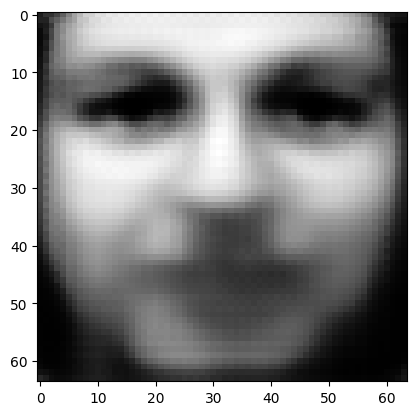

tensor([[2.0361e-04, 2.4713e-04, 1.9376e-02, 3.7657e-03, 2.0072e-03, 1.2062e-05,
         1.9971e-02, 3.5902e-04, 2.0605e-01, 2.6902e-02, 7.9586e-03, 1.1386e-02,
         1.5924e-02, 2.2217e-03, 6.3607e-03, 8.7508e-04, 1.9772e-02, 6.9744e-04,
         3.6256e-03, 1.8332e-03, 5.9180e-02, 3.2206e-02, 1.7409e-02, 1.2667e-02,
         1.1508e-01, 6.0730e-04, 4.6190e-03, 3.8240e-02, 4.7338e-02, 1.3494e-02,
         2.0067e-02, 1.9598e-04, 1.8497e-02, 3.8295e-03, 7.1866e-02, 1.2587e-03,
         1.7375e-02, 6.8752e-02, 5.9122e-02, 4.8646e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.615572452545166
tensor([[1.8902e-04, 2.3191e-04, 2.1614e-02, 3.3375e-03, 1.8987e-03, 1.1988e-05,
         1.4878e-02, 4.7888e-04, 2.0975e-01, 4.7973e-02, 1.0317e-02, 9.7454e-03,
         1.2935e-02, 1.4306e-03, 8.3273e-03, 1.1705e-03, 1.5680e-02, 5.3348e-04,
         4.5258e-03, 2.4806e-03, 5.2531e-02, 3.4038e-02, 1.8838e-02, 1.3802e-02,
         1.0320e-01, 4.3440e-04, 4.9087e-03,

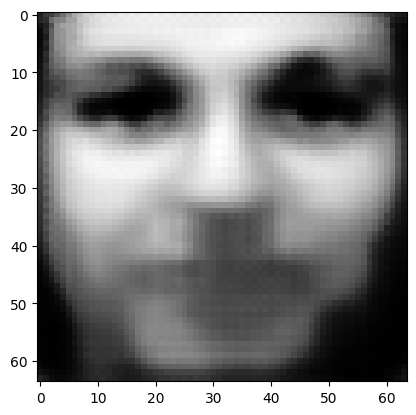

tensor([[1.2541e-04, 1.2549e-04, 2.5926e-02, 1.8864e-03, 1.2641e-03, 9.3893e-06,
         5.1228e-03, 9.0319e-04, 1.8252e-01, 2.3070e-01, 1.4705e-02, 4.8342e-03,
         5.9178e-03, 2.7868e-04, 1.1851e-02, 1.9562e-03, 6.6483e-03, 1.4890e-04,
         5.8305e-03, 4.4285e-03, 2.8338e-02, 3.2867e-02, 2.0358e-02, 1.2917e-02,
         5.7286e-02, 1.4742e-04, 4.1547e-03, 2.9438e-02, 6.1918e-02, 3.6776e-02,
         4.9381e-03, 3.7971e-05, 1.0782e-02, 2.6950e-03, 7.1043e-02, 2.0274e-03,
         7.5558e-03, 1.9862e-02, 3.1795e-02, 5.9873e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.4666202068328857
tensor([[1.1468e-04, 1.0356e-04, 2.5218e-02, 1.6136e-03, 1.1301e-03, 8.5869e-06,
         4.0820e-03, 9.4920e-04, 1.7045e-01, 2.9127e-01, 1.4170e-02, 4.1229e-03,
         4.9880e-03, 1.9665e-04, 1.1463e-02, 1.9746e-03, 5.5220e-03, 1.1187e-04,
         5.5979e-03, 4.4762e-03, 2.3812e-02, 3.0773e-02, 2.0208e-02, 1.1919e-02,
         4.8794e-02, 1.1856e-04, 3.7322e-03

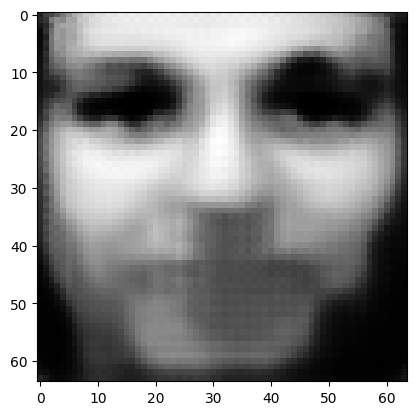

tensor([[8.5944e-05, 4.9474e-05, 2.0051e-02, 8.6694e-04, 7.3348e-04, 5.9293e-06,
         1.8526e-03, 9.4495e-04, 1.1902e-01, 5.1341e-01, 1.0069e-02, 2.2564e-03,
         2.9513e-03, 6.1017e-05, 8.5453e-03, 1.6986e-03, 2.8874e-03, 4.1028e-05,
         3.9943e-03, 3.6937e-03, 1.2095e-02, 2.2022e-02, 1.8327e-02, 7.9176e-03,
         2.7053e-02, 5.5598e-05, 2.3045e-03, 1.8705e-02, 4.4804e-02, 3.2407e-02,
         1.6601e-03, 1.0154e-05, 5.4380e-03, 1.2464e-03, 4.8303e-02, 1.5519e-03,
         3.5959e-03, 6.5506e-03, 1.4246e-02, 3.8485e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6666747331619263
tensor([[8.0307e-05, 4.1677e-05, 1.8614e-02, 7.4017e-04, 6.5728e-04, 5.4074e-06,
         1.5546e-03, 9.1143e-04, 1.0869e-01, 5.5717e-01, 9.1022e-03, 1.9394e-03,
         2.6682e-03, 4.7368e-05, 7.8514e-03, 1.6037e-03, 2.4874e-03, 3.3151e-05,
         3.5821e-03, 3.4510e-03, 1.0252e-02, 2.0067e-02, 1.7670e-02, 7.0673e-03,
         2.3500e-02, 4.6099e-05, 2.0275e-03

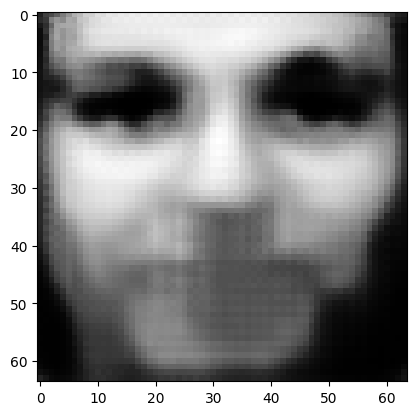

tensor([[6.3829e-05, 2.3918e-05, 1.4275e-02, 4.4646e-04, 4.6733e-04, 3.9555e-06,
         8.9179e-04, 7.8615e-04, 7.8862e-02, 6.7971e-01, 6.3189e-03, 1.2327e-03,
         1.8687e-03, 2.1631e-05, 5.7181e-03, 1.2874e-03, 1.5405e-03, 1.6931e-05,
         2.5121e-03, 2.6514e-03, 6.0765e-03, 1.4536e-02, 1.5157e-02, 4.8710e-03,
         1.4900e-02, 2.6261e-05, 1.3292e-03, 1.2115e-02, 3.1670e-02, 2.5001e-02,
         7.7410e-04, 3.9653e-06, 3.1496e-03, 6.6190e-04, 3.3019e-02, 1.1401e-03,
         2.0383e-03, 2.9321e-03, 7.5011e-03, 2.4394e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3860825300216675
tensor([[6.0551e-05, 2.1333e-05, 1.3457e-02, 4.0209e-04, 4.3591e-04, 3.6968e-06,
         7.9627e-04, 7.5970e-04, 7.3520e-02, 7.0121e-01, 5.8445e-03, 1.1260e-03,
         1.7235e-03, 1.8467e-05, 5.3281e-03, 1.2254e-03, 1.3955e-03, 1.4759e-05,
         2.3349e-03, 2.5000e-03, 5.4610e-03, 1.3567e-02, 1.4574e-02, 4.5098e-03,
         1.3567e-02, 2.3521e-05, 1.2166e-03

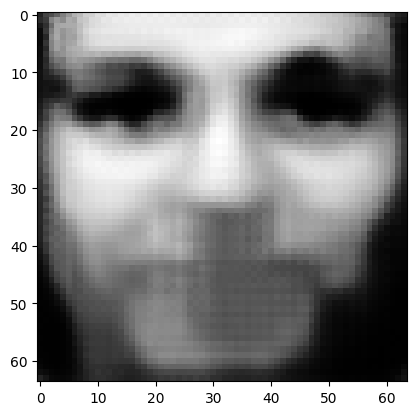

tensor([[5.0506e-05, 1.4550e-05, 1.0926e-02, 2.8383e-04, 3.4538e-04, 2.9386e-06,
         5.4603e-04, 6.7328e-04, 5.7556e-02, 7.6489e-01, 4.4660e-03, 8.3514e-04,
         1.3066e-03, 1.0964e-05, 4.1677e-03, 1.0286e-03, 1.0042e-03, 9.2887e-06,
         1.8155e-03, 2.0204e-03, 3.8137e-03, 1.0716e-02, 1.2719e-02, 3.4815e-03,
         1.0002e-02, 1.6555e-05, 9.0567e-04, 8.8370e-03, 2.3502e-02, 1.9734e-02,
         4.6627e-04, 2.1773e-06, 2.1136e-03, 4.2254e-04, 2.4890e-02, 8.8674e-04,
         1.3575e-03, 1.6760e-03, 4.7834e-03, 1.7716e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2680177092552185
tensor([[4.8440e-05, 1.3404e-05, 1.0441e-02, 2.6331e-04, 3.2757e-04, 2.7909e-06,
         5.0297e-04, 6.5527e-04, 5.4512e-02, 7.7702e-01, 4.2152e-03, 7.8209e-04,
         1.2275e-03, 9.8033e-06, 3.9450e-03, 9.9076e-04, 9.3418e-04, 8.4005e-06,
         1.7200e-03, 1.9297e-03, 3.5277e-03, 1.0172e-02, 1.2291e-02, 3.2919e-03,
         9.3452e-03, 1.5320e-05, 8.4978e-04

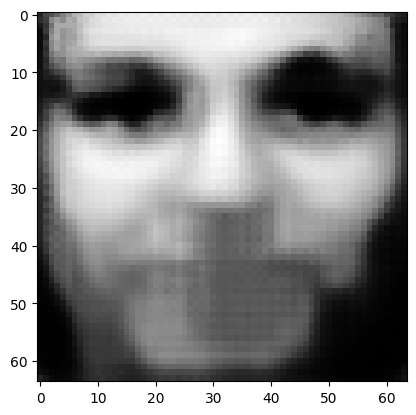

tensor([[4.1429e-05, 1.0001e-05, 8.8734e-03, 2.0149e-04, 2.7103e-04, 2.3268e-06,
         3.7762e-04, 5.9321e-04, 4.4846e-02, 8.1562e-01, 3.4344e-03, 6.1367e-04,
         9.8534e-04, 6.5925e-06, 3.2287e-03, 8.6821e-04, 7.2622e-04, 5.8439e-06,
         1.4113e-03, 1.6324e-03, 2.6534e-03, 8.4528e-03, 1.0832e-02, 2.6843e-03,
         7.3659e-03, 1.1606e-05, 6.7578e-04, 6.9444e-03, 1.8550e-02, 1.6221e-02,
         3.1636e-04, 1.3944e-06, 1.5500e-03, 2.9973e-04, 1.9732e-02, 7.2405e-04,
         9.8705e-04, 1.0921e-03, 3.3891e-03, 1.3764e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2038036584854126
tensor([[4.0046e-05, 9.3828e-06, 8.5574e-03, 1.9007e-04, 2.6038e-04, 2.2381e-06,
         3.5513e-04, 5.7989e-04, 4.2933e-02, 8.2320e-01, 3.2813e-03, 5.8194e-04,
         9.4012e-04, 6.0500e-06, 3.0890e-03, 8.4300e-04, 6.8787e-04, 5.3993e-06,
         1.3505e-03, 1.5711e-03, 2.4918e-03, 8.1166e-03, 1.0537e-02, 2.5660e-03,
         7.0012e-03, 1.0938e-05, 6.4249e-04

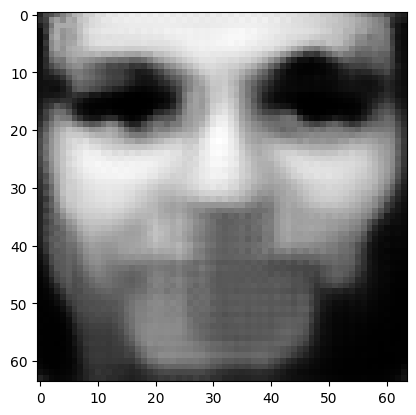

tensor([[3.5343e-05, 7.4617e-06, 7.4962e-03, 1.5388e-04, 2.2472e-04, 1.9394e-06,
         2.8494e-04, 5.3275e-04, 3.6673e-02, 8.4805e-01, 2.7856e-03, 4.8054e-04,
         7.9062e-04, 4.4410e-06, 2.6274e-03, 7.5833e-04, 5.6576e-04, 4.0704e-06,
         1.1548e-03, 1.3698e-03, 1.9860e-03, 7.0033e-03, 9.4782e-03, 2.1840e-03,
         5.8169e-03, 8.8095e-06, 5.3486e-04, 5.7422e-03, 1.5312e-02, 1.3830e-02,
         2.3476e-04, 9.9260e-07, 1.2148e-03, 2.2870e-04, 1.6402e-02, 6.1744e-04,
         7.6779e-04, 7.7836e-04, 2.5825e-03, 1.1271e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.16481171548366547
tensor([[3.4340e-05, 7.0874e-06, 7.2754e-03, 1.4674e-04, 2.1726e-04, 1.8765e-06,
         2.7130e-04, 5.2208e-04, 3.5398e-02, 8.5313e-01, 2.6857e-03, 4.6026e-04,
         7.6020e-04, 4.1446e-06, 2.5332e-03, 7.4003e-04, 5.4184e-04, 3.8190e-06,
         1.1149e-03, 1.3283e-03, 1.8873e-03, 6.7736e-03, 9.2510e-03, 2.1063e-03,
         5.5806e-03, 8.3953e-06, 5.1311e-0

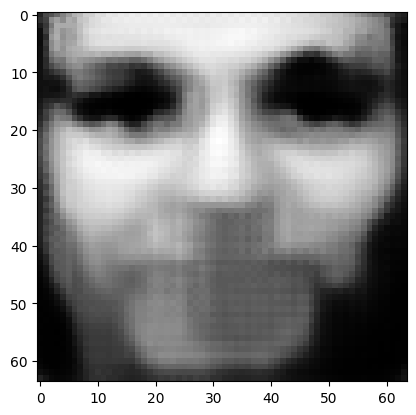

tensor([[3.1000e-05, 5.8994e-06, 6.5222e-03, 1.2370e-04, 1.9260e-04, 1.6670e-06,
         2.2805e-04, 4.8514e-04, 3.1196e-02, 8.6992e-01, 2.3544e-03, 3.9440e-04,
         6.6166e-04, 3.2371e-06, 2.2212e-03, 6.7781e-04, 4.6514e-04, 3.0470e-06,
         9.8272e-04, 1.1883e-03, 1.5714e-03, 6.0108e-03, 8.4759e-03, 1.8519e-03,
         4.8156e-03, 7.0604e-06, 4.4205e-04, 4.9335e-03, 1.3118e-02, 1.2156e-02,
         1.8519e-04, 7.5541e-07, 9.9723e-04, 1.8393e-04, 1.4164e-02, 5.4232e-04,
         6.2674e-04, 5.9313e-04, 2.0798e-03, 9.5870e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13935518264770508
tensor([[3.0317e-05, 5.6618e-06, 6.3596e-03, 1.1903e-04, 1.8744e-04, 1.6230e-06,
         2.1926e-04, 4.7714e-04, 3.0306e-02, 8.7346e-01, 2.2843e-03, 3.8101e-04,
         6.4134e-04, 3.0620e-06, 2.1555e-03, 6.6440e-04, 4.4944e-04, 2.8958e-06,
         9.5496e-04, 1.1584e-03, 1.5081e-03, 5.8504e-03, 8.3072e-03, 1.7991e-03,
         4.6572e-03, 6.7913e-06, 4.2735e-0

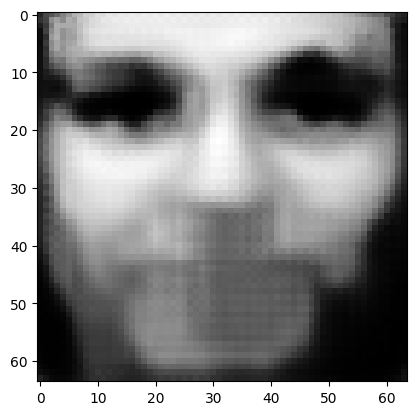

tensor([[2.7908e-05, 4.8681e-06, 5.7973e-03, 1.0322e-04, 1.6984e-04, 1.4710e-06,
         1.8997e-04, 4.4856e-04, 2.7232e-02, 8.8568e-01, 2.0444e-03, 3.3556e-04,
         5.7181e-04, 2.4983e-06, 1.9292e-03, 6.1783e-04, 3.9641e-04, 2.4007e-06,
         8.5945e-04, 1.0535e-03, 1.2957e-03, 5.2984e-03, 7.7068e-03, 1.6172e-03,
         4.1262e-03, 5.8889e-06, 3.7755e-04, 4.3491e-03, 1.1526e-02, 1.0912e-02,
         1.5259e-04, 6.0518e-07, 8.4779e-04, 1.5376e-04, 1.2551e-02, 4.8711e-04,
         5.3047e-04, 4.7408e-04, 1.7395e-03, 8.3791e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12139897048473358
tensor([[2.7384e-05, 4.7028e-06, 5.6749e-03, 9.9911e-05, 1.6589e-04, 1.4378e-06,
         1.8374e-04, 4.4226e-04, 2.6575e-02, 8.8832e-01, 1.9931e-03, 3.2591e-04,
         5.5677e-04, 2.3844e-06, 1.8805e-03, 6.0748e-04, 3.8507e-04, 2.3003e-06,
         8.3887e-04, 1.0311e-03, 1.2516e-03, 5.1778e-03, 7.5727e-03, 1.5782e-03,
         4.0103e-03, 5.6972e-06, 3.6697e-0

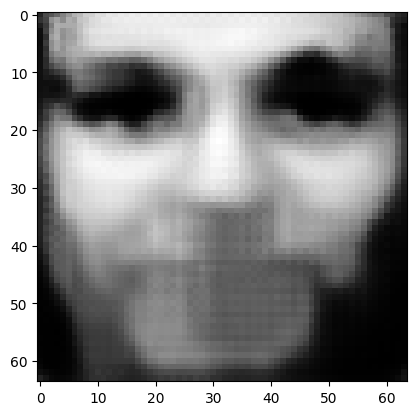

tensor([[2.5448e-05, 4.1341e-06, 5.2375e-03, 8.8519e-05, 1.5201e-04, 1.3186e-06,
         1.6254e-04, 4.1904e-04, 2.4238e-02, 8.9764e-01, 1.8133e-03, 2.9188e-04,
         5.0358e-04, 2.0007e-06, 1.7108e-03, 5.7105e-04, 3.4553e-04, 1.9584e-06,
         7.6759e-04, 9.5253e-04, 1.1000e-03, 4.7558e-03, 7.0768e-03, 1.4427e-03,
         3.6090e-03, 5.0333e-06, 3.2984e-04, 3.9031e-03, 1.0330e-02, 9.9499e-03,
         1.2919e-04, 5.0012e-07, 7.3792e-04, 1.3200e-04, 1.1317e-02, 4.4390e-04,
         4.5918e-04, 3.9123e-04, 1.4938e-03, 7.4704e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10799145698547363
tensor([[2.5016e-05, 4.0132e-06, 5.1404e-03, 8.6081e-05, 1.4885e-04, 1.2919e-06,
         1.5790e-04, 4.1377e-04, 2.3727e-02, 8.9968e-01, 1.7742e-03, 2.8451e-04,
         4.9178e-04, 1.9209e-06, 1.6738e-03, 5.6290e-04, 3.3677e-04, 1.8876e-06,
         7.5209e-04, 9.3558e-04, 1.0679e-03, 4.6616e-03, 6.9645e-03, 1.4130e-03,
         3.5186e-03, 4.8873e-06, 3.2178e-0

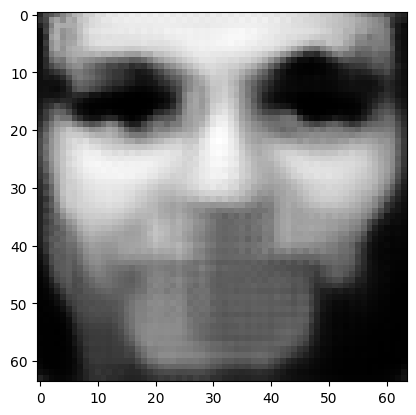

tensor([[2.3470e-05, 3.5896e-06, 4.7918e-03, 7.7465e-05, 1.3784e-04, 1.1978e-06,
         1.4196e-04, 3.9428e-04, 2.1926e-02, 9.0695e-01, 1.6347e-03, 2.5866e-04,
         4.5048e-04, 1.6505e-06, 1.5414e-03, 5.3336e-04, 3.0649e-04, 1.6449e-06,
         6.9631e-04, 8.7352e-04, 9.5483e-04, 4.3270e-03, 6.5648e-03, 1.3069e-03,
         3.2076e-03, 4.3821e-06, 2.9330e-04, 3.5501e-03, 9.4037e-03, 9.1907e-03,
         1.1175e-04, 4.2354e-07, 6.5431e-04, 1.1560e-04, 1.0339e-02, 4.0930e-04,
         4.0463e-04, 3.3139e-04, 1.3083e-03, 6.7717e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09766300767660141
tensor([[2.3117e-05, 3.4972e-06, 4.7137e-03, 7.5579e-05, 1.3540e-04, 1.1769e-06,
         1.3848e-04, 3.8984e-04, 2.1525e-02, 9.0857e-01, 1.6039e-03, 2.5294e-04,
         4.4145e-04, 1.5933e-06, 1.5125e-03, 5.2665e-04, 2.9982e-04, 1.5926e-06,
         6.8375e-04, 8.5954e-04, 9.3017e-04, 4.2523e-03, 6.4767e-03, 1.2833e-03,
         3.1403e-03, 4.2728e-06, 2.8707e-0

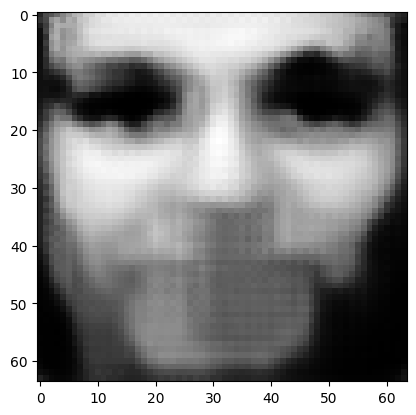

tensor([[2.1869e-05, 3.1720e-06, 4.4296e-03, 6.8911e-05, 1.2667e-04, 1.1018e-06,
         1.2619e-04, 3.7344e-04, 2.0093e-02, 9.1440e-01, 1.4920e-03, 2.3278e-04,
         4.0901e-04, 1.3959e-06, 1.4067e-03, 5.0238e-04, 2.7623e-04, 1.4126e-06,
         6.3874e-04, 8.0859e-04, 8.4317e-04, 3.9834e-03, 6.1517e-03, 1.1982e-03,
         2.8972e-03, 3.8836e-06, 2.6468e-04, 3.2682e-03, 8.6579e-03, 8.5699e-03,
         9.8548e-05, 3.6676e-07, 5.8921e-04, 1.0291e-04, 9.5506e-03, 3.8126e-04,
         3.6235e-04, 2.8672e-04, 1.1649e-03, 6.2099e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08948560804128647
tensor([[2.1591e-05, 3.1009e-06, 4.3654e-03, 6.7443e-05, 1.2468e-04, 1.0847e-06,
         1.2346e-04, 3.6974e-04, 1.9771e-02, 9.1571e-01, 1.4669e-03, 2.2836e-04,
         4.0176e-04, 1.3534e-06, 1.3830e-03, 4.9689e-04, 2.7093e-04, 1.3739e-06,
         6.2873e-04, 7.9713e-04, 8.2423e-04, 3.9224e-03, 6.0765e-03, 1.1794e-03,
         2.8425e-03, 3.7975e-06, 2.5972e-0

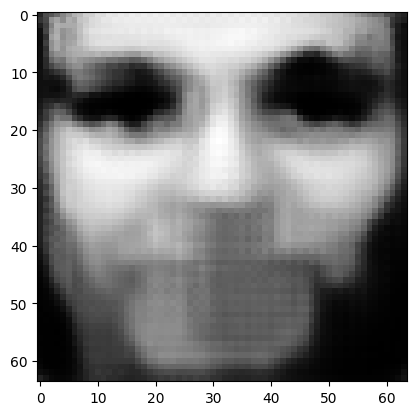

tensor([[2.0568e-05, 2.8453e-06, 4.1323e-03, 6.2182e-05, 1.1760e-04, 1.0234e-06,
         1.1383e-04, 3.5601e-04, 1.8602e-02, 9.2048e-01, 1.3752e-03, 2.1236e-04,
         3.7570e-04, 1.2046e-06, 1.2967e-03, 4.7659e-04, 2.5207e-04, 1.2363e-06,
         5.9234e-04, 7.5485e-04, 7.5591e-04, 3.7034e-03, 5.8030e-03, 1.1108e-03,
         2.6495e-03, 3.4932e-06, 2.4179e-04, 3.0361e-03, 8.0476e-03, 8.0546e-03,
         8.8247e-05, 3.2325e-07, 5.3748e-04, 9.2850e-05, 8.9059e-03, 3.5811e-04,
         3.2866e-04, 2.5251e-04, 1.0515e-03, 5.7554e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08286402374505997
tensor([[2.0332e-05, 2.7883e-06, 4.0791e-03, 6.1001e-05, 1.1599e-04, 1.0094e-06,
         1.1169e-04, 3.5282e-04, 1.8337e-02, 9.2156e-01, 1.3545e-03, 2.0876e-04,
         3.6976e-04, 1.1720e-06, 1.2770e-03, 4.7192e-04, 2.4781e-04, 1.2059e-06,
         5.8414e-04, 7.4526e-04, 7.4062e-04, 3.6537e-03, 5.7395e-03, 1.0953e-03,
         2.6060e-03, 3.4250e-06, 2.3774e-0

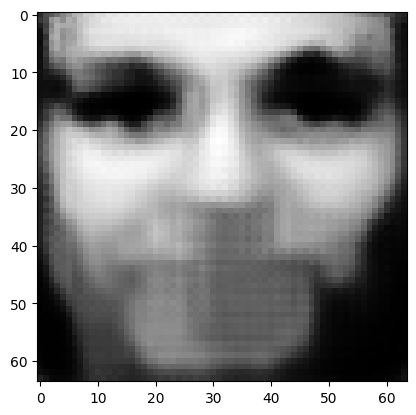

tensor([[1.9457e-05, 2.5822e-06, 3.8831e-03, 5.6752e-05, 1.1010e-04, 9.5825e-07,
         1.0387e-04, 3.4089e-04, 1.7370e-02, 9.2552e-01, 1.2788e-03, 1.9566e-04,
         3.4816e-04, 1.0563e-06, 1.2060e-03, 4.5449e-04, 2.3228e-04, 1.0978e-06,
         5.5390e-04, 7.1015e-04, 6.8570e-04, 3.4706e-03, 5.5099e-03, 1.0381e-03,
         2.4466e-03, 3.1793e-06, 2.2299e-04, 2.8434e-03, 7.5374e-03, 7.6203e-03,
         8.0002e-05, 2.8883e-07, 4.9520e-04, 8.4709e-05, 8.3670e-03, 3.3869e-04,
         3.0122e-04, 2.2541e-04, 9.5961e-04, 5.3809e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07740028947591782
tensor([[1.9260e-05, 2.5363e-06, 3.8387e-03, 5.5803e-05, 1.0876e-04, 9.4662e-07,
         1.0211e-04, 3.3813e-04, 1.7150e-02, 9.2642e-01, 1.2615e-03, 1.9276e-04,
         3.4324e-04, 1.0308e-06, 1.1898e-03, 4.5051e-04, 2.2876e-04, 1.0741e-06,
         5.4714e-04, 7.0223e-04, 6.7354e-04, 3.4289e-03, 5.4560e-03, 1.0252e-03,
         2.4099e-03, 3.1240e-06, 2.1968e-0

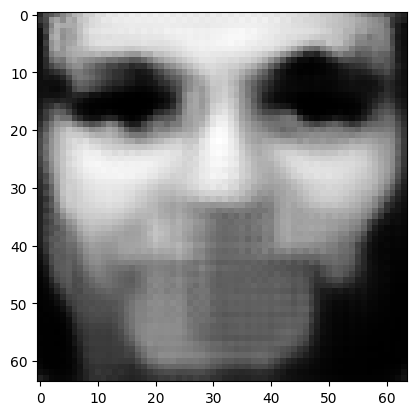

tensor([[1.8528e-05, 2.3695e-06, 3.6768e-03, 5.2396e-05, 1.0386e-04, 9.0479e-07,
         9.5847e-05, 3.2795e-04, 1.6348e-02, 9.2972e-01, 1.1983e-03, 1.8207e-04,
         3.2557e-04, 9.3989e-07, 1.1311e-03, 4.3587e-04, 2.1594e-04, 9.8947e-07,
         5.2235e-04, 6.7319e-04, 6.2919e-04, 3.2767e-03, 5.2602e-03, 9.7787e-04,
         2.2784e-03, 2.9254e-06, 2.0764e-04, 2.6818e-03, 7.1120e-03, 7.2560e-03,
         7.3326e-05, 2.6146e-07, 4.6063e-04, 7.8086e-05, 7.9129e-03, 3.2253e-04,
         2.7874e-04, 2.0397e-04, 8.8490e-04, 5.0699e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07287268340587616
tensor([[1.8362e-05, 2.3317e-06, 3.6399e-03, 5.1620e-05, 1.0270e-04, 8.9510e-07,
         9.4426e-05, 3.2565e-04, 1.6164e-02, 9.3048e-01, 1.1839e-03, 1.7965e-04,
         3.2150e-04, 9.1968e-07, 1.1175e-03, 4.3250e-04, 2.1303e-04, 9.7074e-07,
         5.1671e-04, 6.6652e-04, 6.1918e-04, 3.2415e-03, 5.2138e-03, 9.6713e-04,
         2.2478e-03, 2.8797e-06, 2.0490e-0

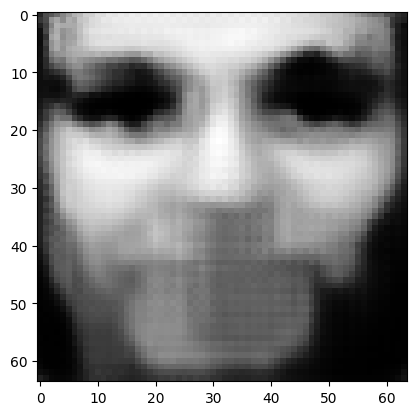

tensor([[1.7716e-05, 2.1923e-06, 3.4999e-03, 4.8773e-05, 9.8430e-05, 8.5871e-07,
         8.9207e-05, 3.1667e-04, 1.5489e-02, 9.3328e-01, 1.1305e-03, 1.7058e-04,
         3.0629e-04, 8.4561e-07, 1.0679e-03, 4.1981e-04, 2.0220e-04, 9.0183e-07,
         4.9574e-04, 6.4212e-04, 5.8228e-04, 3.1110e-03, 5.0417e-03, 9.2729e-04,
         2.1354e-03, 2.7112e-06, 1.9469e-04, 2.5437e-03, 6.7540e-03, 6.9443e-03,
         6.7747e-05, 2.3887e-07, 4.3168e-04, 7.2546e-05, 7.5266e-03, 3.0862e-04,
         2.5982e-04, 1.8643e-04, 8.2293e-04, 4.8055e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06904879957437515
tensor([[1.7564e-05, 2.1603e-06, 3.4670e-03, 4.8110e-05, 9.7415e-05, 8.5004e-07,
         8.7991e-05, 3.1450e-04, 1.5334e-02, 9.3393e-01, 1.1182e-03, 1.6848e-04,
         3.0271e-04, 8.2871e-07, 1.0563e-03, 4.1687e-04, 1.9967e-04, 8.8628e-07,
         4.9091e-04, 6.3657e-04, 5.7385e-04, 3.0803e-03, 4.9999e-03, 9.1812e-04,
         2.1087e-03, 2.6712e-06, 1.9233e-0

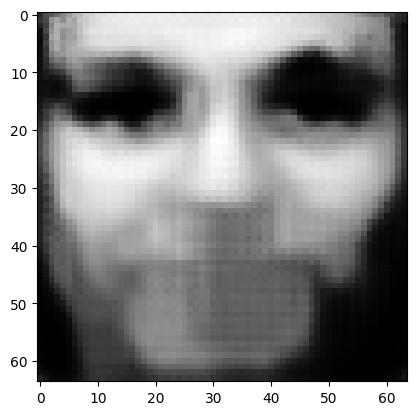

tensor([[1.6993e-05, 2.0424e-06, 3.3442e-03, 4.5694e-05, 9.3683e-05, 8.1814e-07,
         8.3585e-05, 3.0649e-04, 1.4760e-02, 9.3634e-01, 1.0725e-03, 1.6071e-04,
         2.8958e-04, 7.6743e-07, 1.0140e-03, 4.0577e-04, 1.9039e-04, 8.2948e-07,
         4.7294e-04, 6.1587e-04, 5.4279e-04, 2.9672e-03, 4.8477e-03, 8.8426e-04,
         2.0120e-03, 2.5267e-06, 1.8357e-04, 2.4238e-03, 6.4479e-03, 6.6776e-03,
         6.3029e-05, 2.1986e-07, 4.0706e-04, 6.7842e-05, 7.1935e-03, 2.9657e-04,
         2.4355e-04, 1.7176e-04, 7.7065e-04, 4.5799e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0657767653465271
tensor([[1.6862e-05, 2.0153e-06, 3.3157e-03, 4.5135e-05, 9.2821e-05, 8.1074e-07,
         8.2576e-05, 3.0461e-04, 1.4626e-02, 9.3690e-01, 1.0619e-03, 1.5892e-04,
         2.8653e-04, 7.5357e-07, 1.0041e-03, 4.0318e-04, 1.8826e-04, 8.1654e-07,
         4.6877e-04, 6.1101e-04, 5.3565e-04, 2.9409e-03, 4.8119e-03, 8.7639e-04,
         1.9896e-03, 2.4935e-06, 1.8155e-04

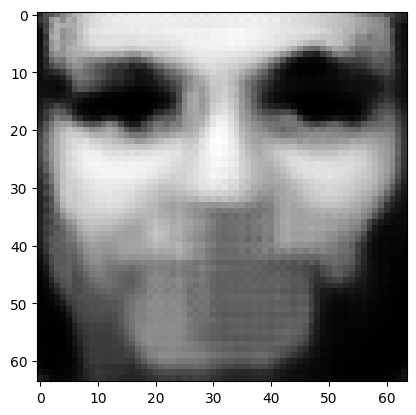

tensor([[1.6372e-05, 1.9151e-06, 3.2095e-03, 4.3084e-05, 8.9583e-05, 7.8310e-07,
         7.8852e-05, 2.9768e-04, 1.4126e-02, 9.3899e-01, 1.0220e-03, 1.5229e-04,
         2.7526e-04, 7.0291e-07, 9.6717e-04, 3.9327e-04, 1.8033e-04, 7.6902e-07,
         4.5321e-04, 5.9275e-04, 5.0928e-04, 2.8430e-03, 4.6785e-03, 8.4713e-04,
         1.9069e-03, 2.3717e-06, 1.7401e-04, 2.3199e-03, 6.1821e-03, 6.4415e-03,
         5.9040e-05, 2.0398e-07, 3.8606e-04, 6.3830e-05, 6.9065e-03, 2.8600e-04,
         2.2979e-04, 1.5950e-04, 7.2627e-04, 4.3828e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06294653564691544
tensor([[1.6258e-05, 1.8919e-06, 3.1847e-03, 4.2606e-05, 8.8830e-05, 7.7666e-07,
         7.7991e-05, 2.9606e-04, 1.4009e-02, 9.3948e-01, 1.0127e-03, 1.5076e-04,
         2.7265e-04, 6.9134e-07, 9.5848e-04, 3.9095e-04, 1.7850e-04, 7.5814e-07,
         4.4956e-04, 5.8845e-04, 5.0318e-04, 2.8201e-03, 4.6470e-03, 8.4033e-04,
         1.8877e-03, 2.3435e-06, 1.7226e-0

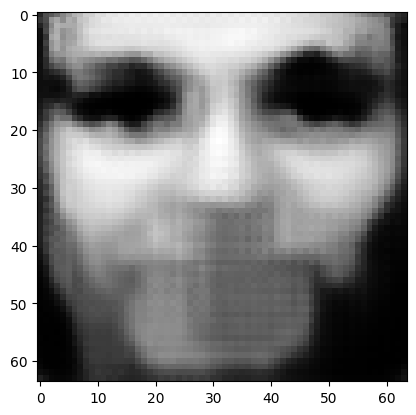

tensor([[1.5833e-05, 1.8060e-06, 3.0918e-03, 4.0842e-05, 8.6015e-05, 7.5259e-07,
         7.4805e-05, 2.9001e-04, 1.3573e-02, 9.4131e-01, 9.7788e-04, 1.4504e-04,
         2.6286e-04, 6.4899e-07, 9.2613e-04, 3.8214e-04, 1.7170e-04, 7.1807e-07,
         4.3595e-04, 5.7234e-04, 4.8060e-04, 2.7350e-03, 4.5291e-03, 8.1488e-04,
         1.8163e-03, 2.2395e-06, 1.6571e-04, 2.2287e-03, 5.9498e-03, 6.2326e-03,
         5.5632e-05, 1.9055e-07, 3.6800e-04, 6.0379e-05, 6.6579e-03, 2.7668e-04,
         2.1800e-04, 1.4914e-04, 6.8833e-04, 4.2091e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060481224209070206
tensor([[1.5732e-05, 1.7858e-06, 3.0699e-03, 4.0425e-05, 8.5361e-05, 7.4695e-07,
         7.4069e-05, 2.8857e-04, 1.3471e-02, 9.4174e-01, 9.6966e-04, 1.4369e-04,
         2.6058e-04, 6.3921e-07, 9.1847e-04, 3.8006e-04, 1.7013e-04, 7.0870e-07,
         4.3271e-04, 5.6851e-04, 4.7529e-04, 2.7150e-03, 4.5011e-03, 8.0888e-04,
         1.7998e-03, 2.2153e-06, 1.6418e-

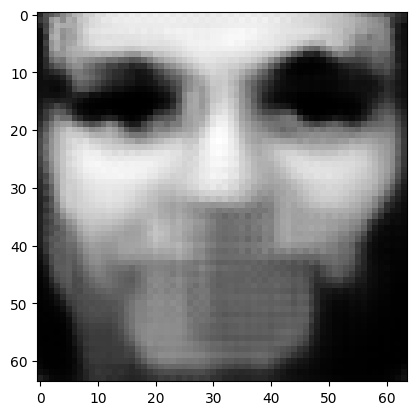

tensor([[1.5355e-05, 1.7120e-06, 2.9882e-03, 3.8899e-05, 8.2894e-05, 7.2579e-07,
         7.1331e-05, 2.8323e-04, 1.3088e-02, 9.4335e-01, 9.3909e-04, 1.3878e-04,
         2.5198e-04, 6.0343e-07, 8.8997e-04, 3.7236e-04, 1.6425e-04, 6.7453e-07,
         4.2090e-04, 5.5436e-04, 4.5584e-04, 2.6407e-03, 4.3949e-03, 7.8684e-04,
         1.7375e-03, 2.1258e-06, 1.5848e-04, 2.1488e-03, 5.7447e-03, 6.0475e-03,
         5.2717e-05, 1.7911e-07, 3.5228e-04, 5.7389e-05, 6.4387e-03, 2.6842e-04,
         2.0775e-04, 1.4025e-04, 6.5554e-04, 4.0560e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05831800028681755
tensor([[1.5267e-05, 1.6950e-06, 2.9689e-03, 3.8548e-05, 8.2330e-05, 7.2087e-07,
         7.0708e-05, 2.8198e-04, 1.2999e-02, 9.4373e-01, 9.3193e-04, 1.3766e-04,
         2.4997e-04, 5.9522e-07, 8.8332e-04, 3.7057e-04, 1.6290e-04, 6.6668e-07,
         4.1819e-04, 5.5104e-04, 4.5134e-04, 2.6235e-03, 4.3699e-03, 7.8181e-04,
         1.7232e-03, 2.1056e-06, 1.5715e-0

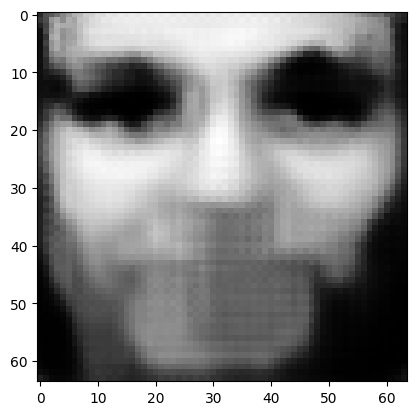

tensor([[1.4935e-05, 1.6317e-06, 2.8969e-03, 3.7241e-05, 8.0168e-05, 7.0222e-07,
         6.8345e-05, 2.7727e-04, 1.2661e-02, 9.4515e-01, 9.0499e-04, 1.3346e-04,
         2.4239e-04, 5.6490e-07, 8.5813e-04, 3.6383e-04, 1.5780e-04, 6.3757e-07,
         4.0805e-04, 5.3864e-04, 4.3464e-04, 2.5585e-03, 4.2744e-03, 7.6279e-04,
         1.6681e-03, 2.0290e-06, 1.5220e-04, 2.0784e-03, 5.5635e-03, 5.8822e-03,
         5.0214e-05, 1.6943e-07, 3.3857e-04, 5.4792e-05, 6.2437e-03, 2.6107e-04,
         1.9879e-04, 1.3260e-04, 6.2710e-04, 3.9221e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05641399323940277
tensor([[1.4857e-05, 1.6168e-06, 2.8798e-03, 3.6933e-05, 7.9665e-05, 6.9784e-07,
         6.7795e-05, 2.7615e-04, 1.2581e-02, 9.4548e-01, 8.9863e-04, 1.3248e-04,
         2.4061e-04, 5.5785e-07, 8.5217e-04, 3.6225e-04, 1.5661e-04, 6.3077e-07,
         4.0565e-04, 5.3569e-04, 4.3071e-04, 2.5432e-03, 4.2517e-03, 7.5832e-04,
         1.6552e-03, 2.0111e-06, 1.5103e-0

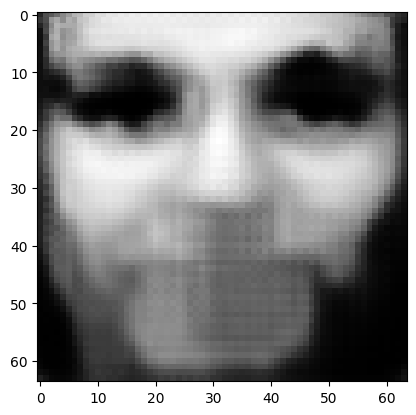

tensor([[1.4561e-05, 1.5613e-06, 2.8155e-03, 3.5783e-05, 7.7745e-05, 6.8127e-07,
         6.5717e-05, 2.7193e-04, 1.2279e-02, 9.4675e-01, 8.7468e-04, 1.2877e-04,
         2.3389e-04, 5.3169e-07, 8.2974e-04, 3.5620e-04, 1.5211e-04, 6.0540e-07,
         3.9660e-04, 5.2457e-04, 4.1603e-04, 2.4852e-03, 4.1661e-03, 7.4138e-04,
         1.6066e-03, 1.9441e-06, 1.4666e-04, 2.0157e-03, 5.4017e-03, 5.7335e-03,
         4.8018e-05, 1.6102e-07, 3.2643e-04, 5.2507e-05, 6.0693e-03, 2.5449e-04,
         1.9091e-04, 1.2594e-04, 6.0207e-04, 3.8027e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05471742898225784
tensor([[1.4491e-05, 1.5482e-06, 2.8001e-03, 3.5513e-05, 7.7297e-05, 6.7737e-07,
         6.5234e-05, 2.7092e-04, 1.2208e-02, 9.4705e-01, 8.6899e-04, 1.2789e-04,
         2.3233e-04, 5.2559e-07, 8.2444e-04, 3.5475e-04, 1.5105e-04, 5.9943e-07,
         3.9445e-04, 5.2191e-04, 4.1256e-04, 2.4716e-03, 4.1459e-03, 7.3738e-04,
         1.5953e-03, 1.9284e-06, 1.4562e-0

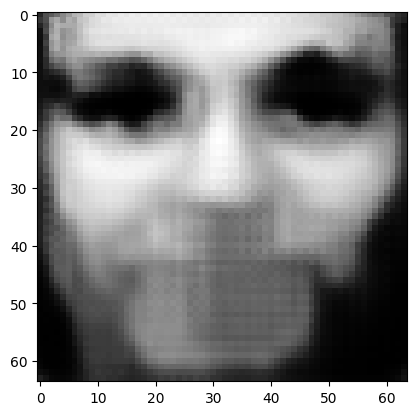

tensor([[1.4227e-05, 1.4990e-06, 2.7419e-03, 3.4491e-05, 7.5591e-05, 6.6255e-07,
         6.3397e-05, 2.6709e-04, 1.1937e-02, 9.4819e-01, 8.4743e-04, 1.2459e-04,
         2.2643e-04, 5.0278e-07, 8.0444e-04, 3.4925e-04, 1.4706e-04, 5.7713e-07,
         3.8628e-04, 5.1181e-04, 3.9955e-04, 2.4197e-03, 4.0692e-03, 7.2226e-04,
         1.5525e-03, 1.8694e-06, 1.4172e-04, 1.9599e-03, 5.2563e-03, 5.5991e-03,
         4.6092e-05, 1.5365e-07, 3.1566e-04, 5.0485e-05, 5.9130e-03, 2.4860e-04,
         1.8396e-04, 1.2008e-04, 5.7993e-04, 3.6952e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0531996414065361
tensor([[1.4166e-05, 1.4874e-06, 2.7279e-03, 3.4247e-05, 7.5187e-05, 6.5902e-07,
         6.2961e-05, 2.6617e-04, 1.1872e-02, 9.4846e-01, 8.4229e-04, 1.2382e-04,
         2.2503e-04, 4.9745e-07, 7.9965e-04, 3.4793e-04, 1.4611e-04, 5.7191e-07,
         3.8434e-04, 5.0938e-04, 3.9647e-04, 2.4074e-03, 4.0507e-03, 7.1866e-04,
         1.5423e-03, 1.8553e-06, 1.4080e-04

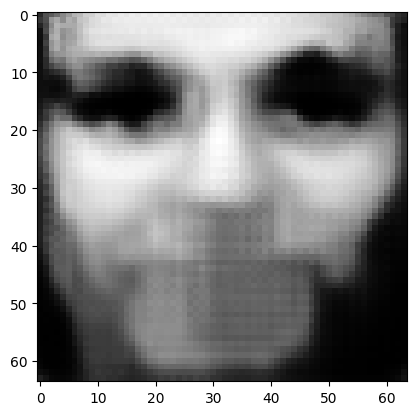

tensor([[1.3929e-05, 1.4436e-06, 2.6746e-03, 3.3327e-05, 7.3660e-05, 6.4563e-07,
         6.1314e-05, 2.6264e-04, 1.1627e-02, 9.4949e-01, 8.2281e-04, 1.2087e-04,
         2.1974e-04, 4.7740e-07, 7.8172e-04, 3.4289e-04, 1.4252e-04, 5.5223e-07,
         3.7693e-04, 5.0017e-04, 3.8485e-04, 2.3604e-03, 3.9816e-03, 7.0500e-04,
         1.5041e-03, 1.8026e-06, 1.3728e-04, 1.9093e-03, 5.1250e-03, 5.4777e-03,
         4.4384e-05, 1.4713e-07, 3.0599e-04, 4.8679e-05, 5.7725e-03, 2.4330e-04,
         1.7774e-04, 1.1489e-04, 5.6017e-04, 3.5988e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.051831796765327454
tensor([[1.3873e-05, 1.4333e-06, 2.6619e-03, 3.3112e-05, 7.3302e-05, 6.4247e-07,
         6.0926e-05, 2.6180e-04, 1.1569e-02, 9.4973e-01, 8.1820e-04, 1.2016e-04,
         2.1849e-04, 4.7270e-07, 7.7750e-04, 3.4168e-04, 1.4168e-04, 5.4759e-07,
         3.7518e-04, 4.9798e-04, 3.8210e-04, 2.3494e-03, 3.9653e-03, 7.0176e-04,
         1.4951e-03, 1.7902e-06, 1.3645e-

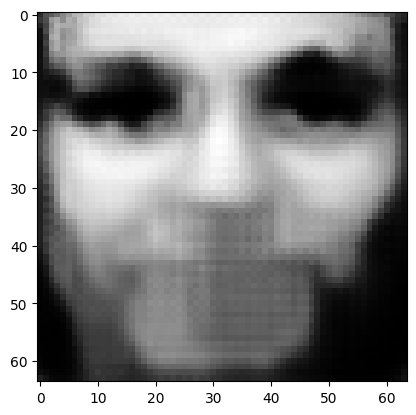

tensor([[1.3659e-05, 1.3942e-06, 2.6135e-03, 3.2290e-05, 7.1924e-05, 6.3036e-07,
         5.9451e-05, 2.5859e-04, 1.1348e-02, 9.5066e-01, 8.0064e-04, 1.1751e-04,
         2.1373e-04, 4.5504e-07, 7.6135e-04, 3.3709e-04, 1.3846e-04, 5.3014e-07,
         3.6849e-04, 4.8963e-04, 3.7174e-04, 2.3070e-03, 3.9026e-03, 6.8946e-04,
         1.4608e-03, 1.7432e-06, 1.3329e-04, 1.8637e-03, 5.0061e-03, 5.3672e-03,
         4.2859e-05, 1.4136e-07, 2.9731e-04, 4.7065e-05, 5.6456e-03, 2.3849e-04,
         1.7219e-04, 1.1029e-04, 5.4251e-04, 3.5113e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05059706047177315
tensor([[1.3608e-05, 1.3850e-06, 2.6018e-03, 3.2095e-05, 7.1590e-05, 6.2745e-07,
         5.9094e-05, 2.5782e-04, 1.1295e-02, 9.5088e-01, 7.9647e-04, 1.1689e-04,
         2.1258e-04, 4.5089e-07, 7.5752e-04, 3.3599e-04, 1.3769e-04, 5.2608e-07,
         3.6690e-04, 4.8765e-04, 3.6931e-04, 2.2967e-03, 3.8876e-03, 6.8656e-04,
         1.4525e-03, 1.7319e-06, 1.3254e-0

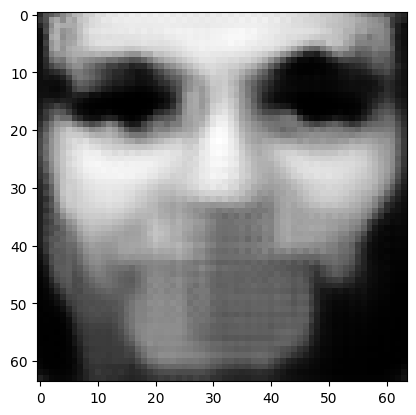

tensor([[1.3414e-05, 1.3497e-06, 2.5571e-03, 3.1347e-05, 7.0347e-05, 6.1638e-07,
         5.7752e-05, 2.5484e-04, 1.1093e-02, 9.5173e-01, 7.8047e-04, 1.1450e-04,
         2.0825e-04, 4.3517e-07, 7.4291e-04, 3.3173e-04, 1.3477e-04, 5.1052e-07,
         3.6078e-04, 4.7996e-04, 3.5997e-04, 2.2580e-03, 3.8307e-03, 6.7533e-04,
         1.4214e-03, 1.6894e-06, 1.2967e-04, 1.8218e-03, 4.8978e-03, 5.2666e-03,
         4.1490e-05, 1.3619e-07, 2.8944e-04, 4.5606e-05, 5.5305e-03, 2.3410e-04,
         1.6716e-04, 1.0617e-04, 5.2656e-04, 3.4322e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.049474600702524185
tensor([[1.3367e-05, 1.3414e-06, 2.5465e-03, 3.1170e-05, 7.0049e-05, 6.1375e-07,
         5.7432e-05, 2.5412e-04, 1.1045e-02, 9.5193e-01, 7.7666e-04, 1.1394e-04,
         2.0721e-04, 4.3145e-07, 7.3943e-04, 3.3071e-04, 1.3408e-04, 5.0683e-07,
         3.5931e-04, 4.7813e-04, 3.5775e-04, 2.2487e-03, 3.8171e-03, 6.7264e-04,
         1.4140e-03, 1.6793e-06, 1.2899e-

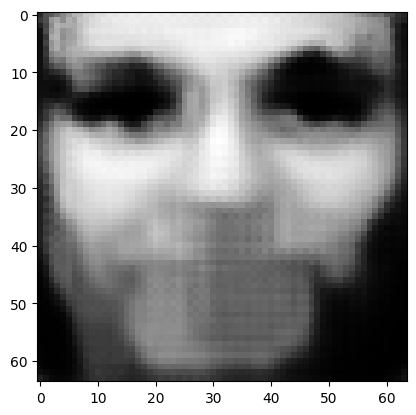

tensor([[1.3190e-05, 1.3102e-06, 2.5064e-03, 3.0505e-05, 6.8909e-05, 6.0391e-07,
         5.6214e-05, 2.5143e-04, 1.0863e-02, 9.5270e-01, 7.6252e-04, 1.1176e-04,
         2.0329e-04, 4.1761e-07, 7.2625e-04, 3.2689e-04, 1.3145e-04, 4.9291e-07,
         3.5375e-04, 4.7126e-04, 3.4941e-04, 2.2138e-03, 3.7652e-03, 6.6242e-04,
         1.3860e-03, 1.6412e-06, 1.2643e-04, 1.7843e-03, 4.8001e-03, 5.1753e-03,
         4.0257e-05, 1.3158e-07, 2.8231e-04, 4.4302e-05, 5.4254e-03, 2.3011e-04,
         1.6264e-04, 1.0252e-04, 5.1218e-04, 3.3611e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04846036434173584
tensor([[1.3146e-05, 1.3027e-06, 2.4968e-03, 3.0346e-05, 6.8639e-05, 6.0157e-07,
         5.5927e-05, 2.5078e-04, 1.0819e-02, 9.5288e-01, 7.5915e-04, 1.1123e-04,
         2.0237e-04, 4.1434e-07, 7.2312e-04, 3.2598e-04, 1.3083e-04, 4.8958e-07,
         3.5241e-04, 4.6960e-04, 3.4741e-04, 2.2054e-03, 3.7529e-03, 6.5997e-04,
         1.3794e-03, 1.6322e-06, 1.2582e-0

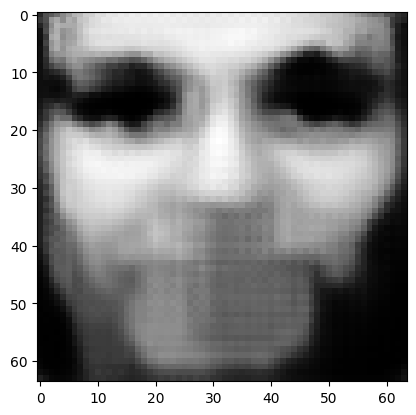

tensor([[1.2983e-05, 1.2745e-06, 2.4601e-03, 2.9744e-05, 6.7595e-05, 5.9257e-07,
         5.4820e-05, 2.4831e-04, 1.0653e-02, 9.5358e-01, 7.4624e-04, 1.0925e-04,
         1.9879e-04, 4.0193e-07, 7.1110e-04, 3.2247e-04, 1.2844e-04, 4.7701e-07,
         3.4732e-04, 4.6329e-04, 3.3985e-04, 2.1734e-03, 3.7052e-03, 6.5063e-04,
         1.3539e-03, 1.5977e-06, 1.2350e-04, 1.7502e-03, 4.7109e-03, 5.0913e-03,
         3.9142e-05, 1.2744e-07, 2.7583e-04, 4.3125e-05, 5.3288e-03, 2.2645e-04,
         1.5855e-04, 9.9224e-05, 4.9915e-04, 3.2958e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04753502085804939
tensor([[1.2945e-05, 1.2678e-06, 2.4513e-03, 2.9600e-05, 6.7348e-05, 5.9042e-07,
         5.4557e-05, 2.4771e-04, 1.0613e-02, 9.5374e-01, 7.4314e-04, 1.0879e-04,
         1.9794e-04, 3.9899e-07, 7.0821e-04, 3.2164e-04, 1.2787e-04, 4.7404e-07,
         3.4611e-04, 4.6178e-04, 3.3806e-04, 2.1658e-03, 3.6937e-03, 6.4840e-04,
         1.3477e-03, 1.5895e-06, 1.2294e-0

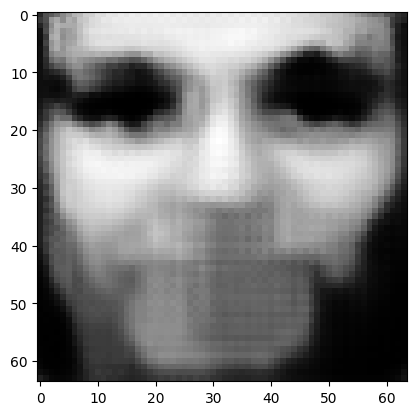

tensor([[1.2796e-05, 1.2423e-06, 2.4178e-03, 2.9058e-05, 6.6399e-05, 5.8225e-07,
         5.3564e-05, 2.4544e-04, 1.0462e-02, 9.5438e-01, 7.3134e-04, 1.0698e-04,
         1.9476e-04, 3.8787e-07, 6.9728e-04, 3.1844e-04, 1.2571e-04, 4.6271e-07,
         3.4145e-04, 4.5602e-04, 3.3122e-04, 2.1367e-03, 3.6503e-03, 6.3995e-04,
         1.3248e-03, 1.5583e-06, 1.2084e-04, 1.7192e-03, 4.6300e-03, 5.0144e-03,
         3.8138e-05, 1.2371e-07, 2.6998e-04, 4.2059e-05, 5.2405e-03, 2.2311e-04,
         1.5485e-04, 9.6264e-05, 4.8737e-04, 3.2365e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04669324308633804
tensor([[1.2761e-05, 1.2363e-06, 2.4098e-03, 2.8929e-05, 6.6170e-05, 5.8029e-07,
         5.3326e-05, 2.4490e-04, 1.0426e-02, 9.5453e-01, 7.2852e-04, 1.0656e-04,
         1.9398e-04, 3.8524e-07, 6.9463e-04, 3.1769e-04, 1.2519e-04, 4.6006e-07,
         3.4036e-04, 4.5465e-04, 3.2961e-04, 2.1297e-03, 3.6395e-03, 6.3794e-04,
         1.3192e-03, 1.5508e-06, 1.2034e-0

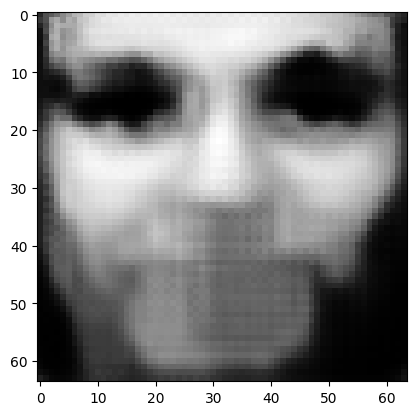

tensor([[1.2619e-05, 1.2127e-06, 2.3788e-03, 2.8425e-05, 6.5268e-05, 5.7256e-07,
         5.2411e-05, 2.4274e-04, 1.0287e-02, 9.5512e-01, 7.1771e-04, 1.0487e-04,
         1.9097e-04, 3.7503e-07, 6.8446e-04, 3.1476e-04, 1.2317e-04, 4.4965e-07,
         3.3609e-04, 4.4941e-04, 3.2328e-04, 2.1027e-03, 3.5977e-03, 6.3012e-04,
         1.2976e-03, 1.5214e-06, 1.1839e-04, 1.6904e-03, 4.5561e-03, 4.9440e-03,
         3.7207e-05, 1.2027e-07, 2.6460e-04, 4.1079e-05, 5.1585e-03, 2.2002e-04,
         1.5140e-04, 9.3553e-05, 4.7650e-04, 3.1824e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045916229486465454
tensor([[1.2584e-05, 1.2070e-06, 2.3712e-03, 2.8305e-05, 6.5047e-05, 5.7068e-07,
         5.2190e-05, 2.4221e-04, 1.0253e-02, 9.5526e-01, 7.1514e-04, 1.0446e-04,
         1.9025e-04, 3.7258e-07, 6.8203e-04, 3.1406e-04, 1.2268e-04, 4.4716e-07,
         3.3507e-04, 4.4816e-04, 3.2177e-04, 2.0961e-03, 3.5877e-03, 6.2825e-04,
         1.2924e-03, 1.5143e-06, 1.1792e-

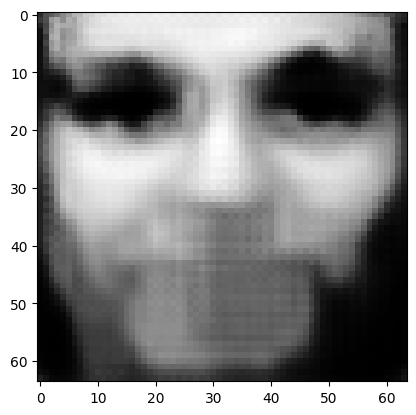

tensor([[1.2451e-05, 1.1854e-06, 2.3425e-03, 2.7843e-05, 6.4212e-05, 5.6352e-07,
         5.1351e-05, 2.4020e-04, 1.0124e-02, 9.5581e-01, 7.0519e-04, 1.0290e-04,
         1.8747e-04, 3.6328e-07, 6.7267e-04, 3.1135e-04, 1.2082e-04, 4.3765e-07,
         3.3114e-04, 4.4334e-04, 3.1596e-04, 2.0711e-03, 3.5490e-03, 6.2103e-04,
         1.2726e-03, 1.4873e-06, 1.1612e-04, 1.6639e-03, 4.4878e-03, 4.8785e-03,
         3.6350e-05, 1.1710e-07, 2.5962e-04, 4.0177e-05, 5.0822e-03, 2.1715e-04,
         1.4821e-04, 9.1056e-05, 4.6648e-04, 3.1325e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045197971165180206
tensor([[1.2419e-05, 1.1802e-06, 2.3356e-03, 2.7732e-05, 6.4011e-05, 5.6179e-07,
         5.1149e-05, 2.3971e-04, 1.0094e-02, 9.5594e-01, 7.0281e-04, 1.0253e-04,
         1.8679e-04, 3.6108e-07, 6.7039e-04, 3.1070e-04, 1.2038e-04, 4.3540e-07,
         3.3020e-04, 4.4218e-04, 3.1458e-04, 2.0651e-03, 3.5394e-03, 6.1930e-04,
         1.2677e-03, 1.4807e-06, 1.1569e-

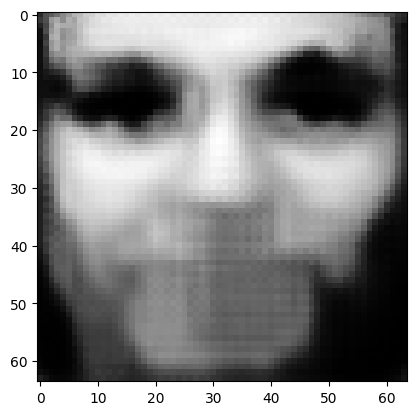

tensor([[1.2297e-05, 1.1604e-06, 2.3092e-03, 2.7307e-05, 6.3241e-05, 5.5519e-07,
         5.0380e-05, 2.3785e-04, 9.9748e-03, 9.5644e-01, 6.9364e-04, 1.0111e-04,
         1.8424e-04, 3.5266e-07, 6.6173e-04, 3.0819e-04, 1.1867e-04, 4.2673e-07,
         3.2657e-04, 4.3770e-04, 3.0927e-04, 2.0421e-03, 3.5035e-03, 6.1265e-04,
         1.2496e-03, 1.4560e-06, 1.1404e-04, 1.6394e-03, 4.4248e-03, 4.8180e-03,
         3.5567e-05, 1.1422e-07, 2.5506e-04, 3.9350e-05, 5.0121e-03, 2.1449e-04,
         1.4529e-04, 8.8787e-05, 4.5729e-04, 3.0867e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044535983353853226
tensor([[1.2267e-05, 1.1557e-06, 2.3029e-03, 2.7207e-05, 6.3056e-05, 5.5361e-07,
         5.0195e-05, 2.3741e-04, 9.9462e-03, 9.5656e-01, 6.9145e-04, 1.0077e-04,
         1.8363e-04, 3.5066e-07, 6.5967e-04, 3.0759e-04, 1.1826e-04, 4.2467e-07,
         3.2571e-04, 4.3664e-04, 3.0801e-04, 2.0366e-03, 3.4949e-03, 6.1106e-04,
         1.2452e-03, 1.4502e-06, 1.1365e-

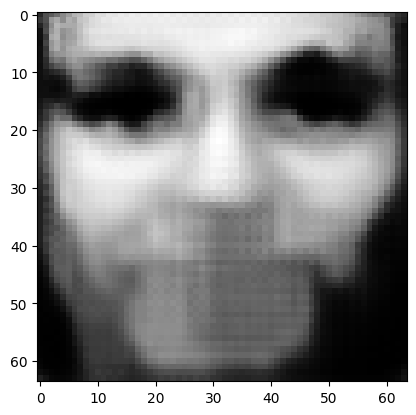

tensor([[1.2155e-05, 1.1375e-06, 2.2785e-03, 2.6816e-05, 6.2349e-05, 5.4753e-07,
         4.9491e-05, 2.3569e-04, 9.8360e-03, 9.5703e-01, 6.8295e-04, 9.9457e-05,
         1.8128e-04, 3.4300e-07, 6.5164e-04, 3.0525e-04, 1.1669e-04, 4.1674e-07,
         3.2236e-04, 4.3247e-04, 3.0314e-04, 2.0153e-03, 3.4616e-03, 6.0492e-04,
         1.2285e-03, 1.4276e-06, 1.1213e-04, 1.6168e-03, 4.3664e-03, 4.7618e-03,
         3.4851e-05, 1.1159e-07, 2.5086e-04, 3.8593e-05, 4.9474e-03, 2.1204e-04,
         1.4262e-04, 8.6712e-05, 4.4886e-04, 3.0444e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04392489418387413
tensor([[1.2128e-05, 1.1332e-06, 2.2726e-03, 2.6722e-05, 6.2182e-05, 5.4608e-07,
         4.9324e-05, 2.3527e-04, 9.8096e-03, 9.5714e-01, 6.8090e-04, 9.9141e-05,
         1.8072e-04, 3.4117e-07, 6.4972e-04, 3.0468e-04, 1.1631e-04, 4.1482e-07,
         3.2155e-04, 4.3145e-04, 3.0196e-04, 2.0103e-03, 3.4537e-03, 6.0343e-04,
         1.2246e-03, 1.4222e-06, 1.1177e-0

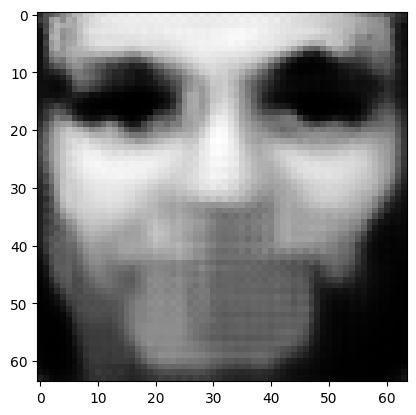

tensor([[1.2023e-05, 1.1164e-06, 2.2500e-03, 2.6361e-05, 6.1524e-05, 5.4043e-07,
         4.8670e-05, 2.3366e-04, 9.7077e-03, 9.5757e-01, 6.7305e-04, 9.7933e-05,
         1.7854e-04, 3.3417e-07, 6.4229e-04, 3.0251e-04, 1.1486e-04, 4.0756e-07,
         3.1844e-04, 4.2760e-04, 2.9749e-04, 1.9905e-03, 3.4228e-03, 5.9772e-04,
         1.2091e-03, 1.4014e-06, 1.1036e-04, 1.5959e-03, 4.3121e-03, 4.7097e-03,
         3.4194e-05, 1.0917e-07, 2.4698e-04, 3.7894e-05, 4.8873e-03, 2.0976e-04,
         1.4015e-04, 8.4806e-05, 4.4107e-04, 3.0053e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.043358638882637024
tensor([[1.1998e-05, 1.1125e-06, 2.2446e-03, 2.6276e-05, 6.1363e-05, 5.3906e-07,
         4.8512e-05, 2.3327e-04, 9.6832e-03, 9.5767e-01, 6.7118e-04, 9.7645e-05,
         1.7802e-04, 3.3251e-07, 6.4052e-04, 3.0199e-04, 1.1451e-04, 4.0584e-07,
         3.1770e-04, 4.2669e-04, 2.9643e-04, 1.9857e-03, 3.4153e-03, 5.9637e-04,
         1.2053e-03, 1.3964e-06, 1.1003e-

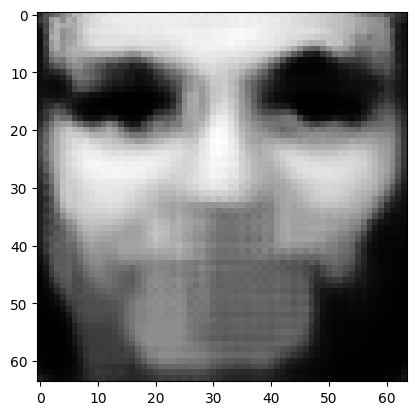

tensor([[1.1901e-05, 1.0970e-06, 2.2236e-03, 2.5943e-05, 6.0759e-05, 5.3385e-07,
         4.7912e-05, 2.3177e-04, 9.5887e-03, 9.5807e-01, 6.6389e-04, 9.6527e-05,
         1.7601e-04, 3.2610e-07, 6.3364e-04, 2.9997e-04, 1.1317e-04, 3.9915e-07,
         3.1482e-04, 4.2308e-04, 2.9228e-04, 1.9674e-03, 3.3867e-03, 5.9106e-04,
         1.1911e-03, 1.3772e-06, 1.0873e-04, 1.5765e-03, 4.2619e-03, 4.6612e-03,
         3.3587e-05, 1.0695e-07, 2.4339e-04, 3.7250e-05, 4.8317e-03, 2.0764e-04,
         1.3787e-04, 8.3057e-05, 4.3389e-04, 2.9691e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0428340919315815
tensor([[1.1878e-05, 1.0933e-06, 2.2186e-03, 2.5862e-05, 6.0613e-05, 5.3259e-07,
         4.7768e-05, 2.3141e-04, 9.5660e-03, 9.5817e-01, 6.6214e-04, 9.6259e-05,
         1.7553e-04, 3.2457e-07, 6.3197e-04, 2.9948e-04, 1.1285e-04, 3.9755e-07,
         3.1412e-04, 4.2221e-04, 2.9129e-04, 1.9630e-03, 3.3797e-03, 5.8979e-04,
         1.1876e-03, 1.3726e-06, 1.0842e-04

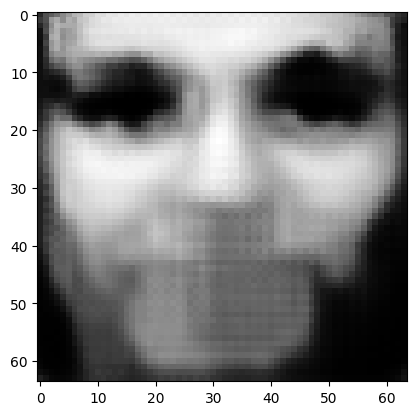

tensor([[1.1788e-05, 1.0791e-06, 2.1990e-03, 2.5555e-05, 6.0050e-05, 5.2774e-07,
         4.7210e-05, 2.3002e-04, 9.4783e-03, 9.5854e-01, 6.5539e-04, 9.5228e-05,
         1.7367e-04, 3.1870e-07, 6.2561e-04, 2.9759e-04, 1.1160e-04, 3.9142e-07,
         3.1144e-04, 4.1886e-04, 2.8748e-04, 1.9460e-03, 3.3532e-03, 5.8487e-04,
         1.1744e-03, 1.3549e-06, 1.0722e-04, 1.5584e-03, 4.2151e-03, 4.6161e-03,
         3.3027e-05, 1.0491e-07, 2.4006e-04, 3.6654e-05, 4.7799e-03, 2.0566e-04,
         1.3576e-04, 8.1448e-05, 4.2724e-04, 2.9354e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04234720394015312
tensor([[1.1766e-05, 1.0757e-06, 2.1943e-03, 2.5481e-05, 5.9915e-05, 5.2658e-07,
         4.7076e-05, 2.2968e-04, 9.4570e-03, 9.5863e-01, 6.5376e-04, 9.4979e-05,
         1.7322e-04, 3.1730e-07, 6.2408e-04, 2.9713e-04, 1.1131e-04, 3.8994e-07,
         3.1080e-04, 4.1804e-04, 2.8656e-04, 1.9419e-03, 3.3468e-03, 5.8368e-04,
         1.1713e-03, 1.3507e-06, 1.0693e-0

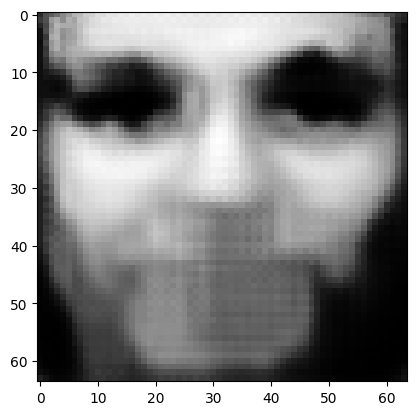

tensor([[1.1683e-05, 1.0625e-06, 2.1761e-03, 2.5195e-05, 5.9395e-05, 5.2208e-07,
         4.6561e-05, 2.2838e-04, 9.3754e-03, 9.5897e-01, 6.4749e-04, 9.4023e-05,
         1.7150e-04, 3.1191e-07, 6.1816e-04, 2.9537e-04, 1.1016e-04, 3.8428e-07,
         3.0830e-04, 4.1491e-04, 2.8302e-04, 1.9261e-03, 3.3221e-03, 5.7911e-04,
         1.1591e-03, 1.3344e-06, 1.0582e-04, 1.5416e-03, 4.1715e-03, 4.5740e-03,
         3.2511e-05, 1.0304e-07, 2.3698e-04, 3.6103e-05, 4.7319e-03, 2.0383e-04,
         1.3382e-04, 7.9964e-05, 4.2109e-04, 2.9041e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041894491761922836
tensor([[1.1663e-05, 1.0593e-06, 2.1718e-03, 2.5126e-05, 5.9269e-05, 5.2100e-07,
         4.6436e-05, 2.2807e-04, 9.3557e-03, 9.5905e-01, 6.4597e-04, 9.3796e-05,
         1.7108e-04, 3.1062e-07, 6.1672e-04, 2.9494e-04, 1.0988e-04, 3.8293e-07,
         3.0770e-04, 4.1415e-04, 2.8218e-04, 1.9223e-03, 3.3161e-03, 5.7800e-04,
         1.1561e-03, 1.3304e-06, 1.0555e-

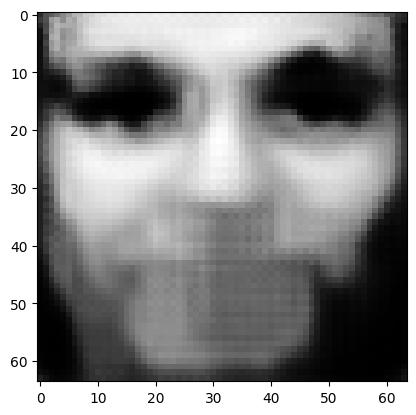

tensor([[1.1585e-05, 1.0471e-06, 2.1549e-03, 2.4861e-05, 5.8782e-05, 5.1681e-07,
         4.5957e-05, 2.2685e-04, 9.2796e-03, 9.5938e-01, 6.4014e-04, 9.2905e-05,
         1.6948e-04, 3.0566e-07, 6.1121e-04, 2.9329e-04, 1.0881e-04, 3.7770e-07,
         3.0537e-04, 4.1124e-04, 2.7890e-04, 1.9075e-03, 3.2930e-03, 5.7374e-04,
         1.1447e-03, 1.3152e-06, 1.0452e-04, 1.5260e-03, 4.1310e-03, 4.5348e-03,
         3.2032e-05, 1.0130e-07, 2.3411e-04, 3.5592e-05, 4.6871e-03, 2.0211e-04,
         1.3201e-04, 7.8595e-05, 4.1539e-04, 2.8749e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0414731428027153
tensor([[1.1566e-05, 1.0442e-06, 2.1508e-03, 2.4798e-05, 5.8663e-05, 5.1579e-07,
         4.5841e-05, 2.2657e-04, 9.2613e-03, 9.5945e-01, 6.3875e-04, 9.2690e-05,
         1.6910e-04, 3.0446e-07, 6.0990e-04, 2.9289e-04, 1.0855e-04, 3.7645e-07,
         3.0481e-04, 4.1054e-04, 2.7812e-04, 1.9039e-03, 3.2875e-03, 5.7272e-04,
         1.1420e-03, 1.3116e-06, 1.0427e-04

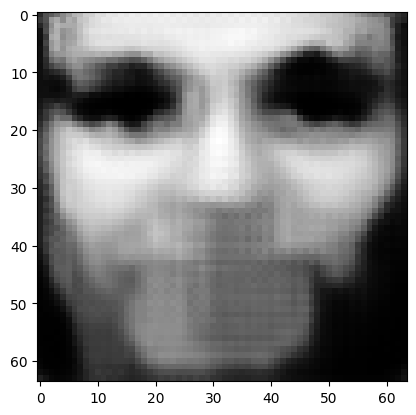

tensor([[1.1493e-05, 1.0328e-06, 2.1350e-03, 2.4552e-05, 5.8209e-05, 5.1189e-07,
         4.5397e-05, 2.2544e-04, 9.1905e-03, 9.5975e-01, 6.3333e-04, 9.1859e-05,
         1.6761e-04, 2.9988e-07, 6.0478e-04, 2.9134e-04, 1.0756e-04, 3.7159e-07,
         3.0263e-04, 4.0781e-04, 2.7507e-04, 1.8902e-03, 3.2660e-03, 5.6874e-04,
         1.1315e-03, 1.2976e-06, 1.0331e-04, 1.5115e-03, 4.0933e-03, 4.4979e-03,
         3.1587e-05, 9.9691e-08, 2.3144e-04, 3.5118e-05, 4.6454e-03, 2.0051e-04,
         1.3034e-04, 7.7324e-05, 4.1011e-04, 2.8475e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04108021780848503
tensor([[1.1476e-05, 1.0301e-06, 2.1312e-03, 2.4493e-05, 5.8098e-05, 5.1094e-07,
         4.5288e-05, 2.2517e-04, 9.1733e-03, 9.5982e-01, 6.3201e-04, 9.1661e-05,
         1.6724e-04, 2.9878e-07, 6.0352e-04, 2.9097e-04, 1.0732e-04, 3.7044e-07,
         3.0212e-04, 4.0716e-04, 2.7435e-04, 1.8869e-03, 3.2607e-03, 5.6778e-04,
         1.1289e-03, 1.2941e-06, 1.0308e-0

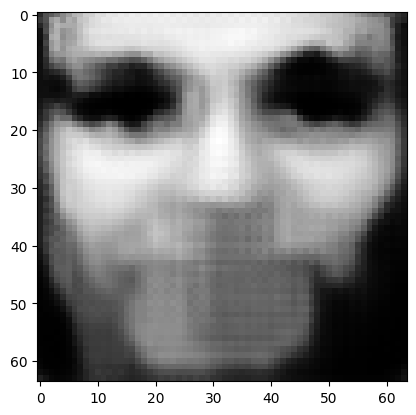

tensor([[1.1408e-05, 1.0196e-06, 2.1165e-03, 2.4264e-05, 5.7674e-05, 5.0730e-07,
         4.4875e-05, 2.2411e-04, 9.1072e-03, 9.6010e-01, 6.2695e-04, 9.0890e-05,
         1.6586e-04, 2.9454e-07, 5.9874e-04, 2.8953e-04, 1.0640e-04, 3.6596e-07,
         3.0009e-04, 4.0462e-04, 2.7152e-04, 1.8740e-03, 3.2406e-03, 5.6407e-04,
         1.1190e-03, 1.2811e-06, 1.0218e-04, 1.4979e-03, 4.0581e-03, 4.4637e-03,
         3.1172e-05, 9.8199e-08, 2.2897e-04, 3.4676e-05, 4.6064e-03, 1.9900e-04,
         1.2877e-04, 7.6151e-05, 4.0519e-04, 2.8220e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04071369022130966
tensor([[1.1392e-05, 1.0170e-06, 2.1130e-03, 2.4209e-05, 5.7573e-05, 5.0643e-07,
         4.4776e-05, 2.2385e-04, 9.0913e-03, 9.6017e-01, 6.2573e-04, 9.0703e-05,
         1.6553e-04, 2.9352e-07, 5.9758e-04, 2.8918e-04, 1.0618e-04, 3.6487e-07,
         2.9960e-04, 4.0399e-04, 2.7084e-04, 1.8710e-03, 3.2357e-03, 5.6317e-04,
         1.1167e-03, 1.2780e-06, 1.0197e-0

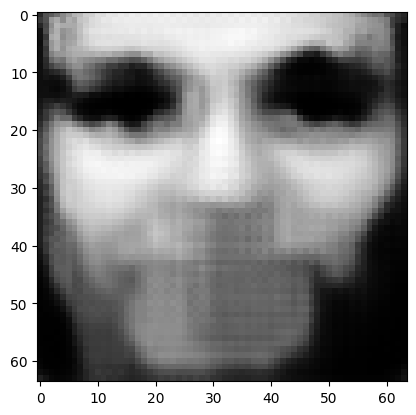

tensor([[1.1327e-05, 1.0072e-06, 2.0991e-03, 2.3995e-05, 5.7168e-05, 5.0296e-07,
         4.4387e-05, 2.2285e-04, 9.0292e-03, 9.6043e-01, 6.2101e-04, 8.9972e-05,
         1.6421e-04, 2.8955e-07, 5.9309e-04, 2.8783e-04, 1.0530e-04, 3.6066e-07,
         2.9771e-04, 4.0164e-04, 2.6819e-04, 1.8589e-03, 3.2164e-03, 5.5970e-04,
         1.1074e-03, 1.2656e-06, 1.0113e-04, 1.4852e-03, 4.0252e-03, 4.4314e-03,
         3.0784e-05, 9.6798e-08, 2.2664e-04, 3.4263e-05, 4.5697e-03, 1.9760e-04,
         1.2731e-04, 7.5049e-05, 4.0058e-04, 2.7982e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04036992788314819
tensor([[1.1311e-05, 1.0048e-06, 2.0958e-03, 2.3943e-05, 5.7070e-05, 5.0211e-07,
         4.4294e-05, 2.2261e-04, 9.0141e-03, 9.6050e-01, 6.1987e-04, 8.9794e-05,
         1.6389e-04, 2.8859e-07, 5.9200e-04, 2.8750e-04, 1.0509e-04, 3.5965e-07,
         2.9726e-04, 4.0108e-04, 2.6755e-04, 1.8560e-03, 3.2117e-03, 5.5886e-04,
         1.1051e-03, 1.2626e-06, 1.0092e-0

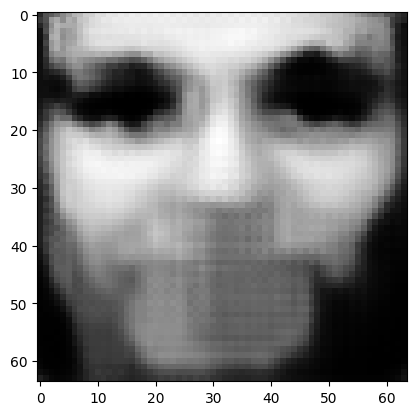

tensor([[1.1248e-05, 9.9553e-07, 2.0828e-03, 2.3743e-05, 5.6689e-05, 4.9884e-07,
         4.3932e-05, 2.2165e-04, 8.9558e-03, 9.6074e-01, 6.1546e-04, 8.9104e-05,
         1.6265e-04, 2.8488e-07, 5.8779e-04, 2.8625e-04, 1.0427e-04, 3.5571e-07,
         2.9549e-04, 3.9889e-04, 2.6506e-04, 1.8446e-03, 3.1934e-03, 5.5562e-04,
         1.0963e-03, 1.2509e-06, 1.0013e-04, 1.4732e-03, 3.9943e-03, 4.4013e-03,
         3.0419e-05, 9.5483e-08, 2.2446e-04, 3.3876e-05, 4.5350e-03, 1.9628e-04,
         1.2592e-04, 7.4013e-05, 3.9625e-04, 2.7761e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040046777576208115
tensor([[1.1233e-05, 9.9331e-07, 2.0797e-03, 2.3695e-05, 5.6597e-05, 4.9805e-07,
         4.3844e-05, 2.2142e-04, 8.9417e-03, 9.6080e-01, 6.1440e-04, 8.8939e-05,
         1.6235e-04, 2.8399e-07, 5.8677e-04, 2.8595e-04, 1.0407e-04, 3.5477e-07,
         2.9507e-04, 3.9837e-04, 2.6447e-04, 1.8419e-03, 3.1889e-03, 5.5483e-04,
         1.0942e-03, 1.2481e-06, 9.9941e-

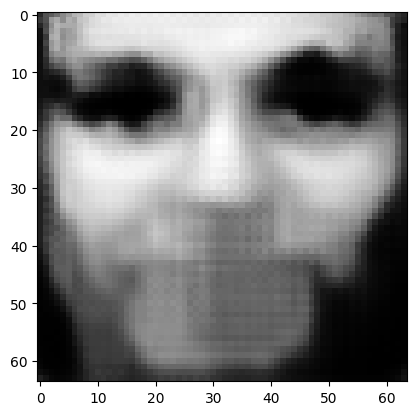

tensor([[1.1175e-05, 9.8470e-07, 2.0675e-03, 2.3508e-05, 5.6241e-05, 4.9499e-07,
         4.3507e-05, 2.2053e-04, 8.8871e-03, 9.6103e-01, 6.1028e-04, 8.8296e-05,
         1.6119e-04, 2.8055e-07, 5.8283e-04, 2.8477e-04, 1.0330e-04, 3.5111e-07,
         2.9342e-04, 3.9631e-04, 2.6215e-04, 1.8313e-03, 3.1717e-03, 5.5179e-04,
         1.0860e-03, 1.2372e-06, 9.9205e-05, 1.4621e-03, 3.9654e-03, 4.3730e-03,
         3.0079e-05, 9.4260e-08, 2.2242e-04, 3.3515e-05, 4.5026e-03, 1.9504e-04,
         1.2462e-04, 7.3052e-05, 3.9221e-04, 2.7554e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03974471613764763
tensor([[1.1161e-05, 9.8262e-07, 2.0646e-03, 2.3463e-05, 5.6154e-05, 4.9425e-07,
         4.3424e-05, 2.2032e-04, 8.8739e-03, 9.6109e-01, 6.0928e-04, 8.8141e-05,
         1.6091e-04, 2.7972e-07, 5.8188e-04, 2.8449e-04, 1.0312e-04, 3.5023e-07,
         2.9302e-04, 3.9582e-04, 2.6160e-04, 1.8288e-03, 3.1675e-03, 5.5106e-04,
         1.0840e-03, 1.2346e-06, 9.9027e-0

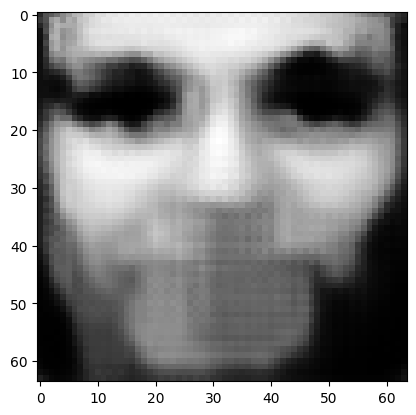

tensor([[1.1107e-05, 9.7458e-07, 2.0532e-03, 2.3288e-05, 5.5820e-05, 4.9138e-07,
         4.3108e-05, 2.1948e-04, 8.8227e-03, 9.6131e-01, 6.0542e-04, 8.7539e-05,
         1.5983e-04, 2.7652e-07, 5.7819e-04, 2.8338e-04, 1.0240e-04, 3.4682e-07,
         2.9148e-04, 3.9390e-04, 2.5944e-04, 1.8188e-03, 3.1514e-03, 5.4820e-04,
         1.0764e-03, 1.2244e-06, 9.8337e-05, 1.4516e-03, 3.9384e-03, 4.3465e-03,
         2.9761e-05, 9.3118e-08, 2.2051e-04, 3.3178e-05, 4.4721e-03, 1.9388e-04,
         1.2341e-04, 7.2155e-05, 3.8843e-04, 2.7361e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03946124389767647
tensor([[1.1093e-05, 9.7264e-07, 2.0504e-03, 2.3246e-05, 5.5741e-05, 4.9068e-07,
         4.3032e-05, 2.1927e-04, 8.8102e-03, 9.6136e-01, 6.0449e-04, 8.7392e-05,
         1.5956e-04, 2.7574e-07, 5.7729e-04, 2.8312e-04, 1.0222e-04, 3.4599e-07,
         2.9110e-04, 3.9344e-04, 2.5892e-04, 1.8165e-03, 3.1474e-03, 5.4751e-04,
         1.0745e-03, 1.2220e-06, 9.8169e-0

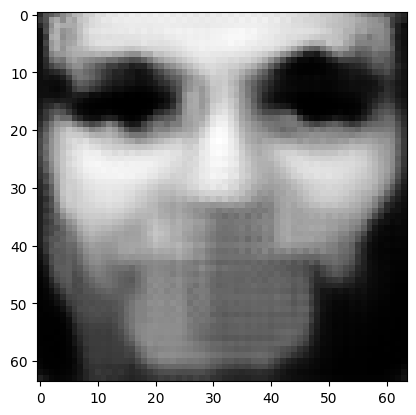

tensor([[1.1042e-05, 9.6513e-07, 2.0398e-03, 2.3083e-05, 5.5428e-05, 4.8799e-07,
         4.2736e-05, 2.1849e-04, 8.7623e-03, 9.6156e-01, 6.0088e-04, 8.6829e-05,
         1.5855e-04, 2.7277e-07, 5.7384e-04, 2.8208e-04, 1.0155e-04, 3.4281e-07,
         2.8965e-04, 3.9164e-04, 2.5690e-04, 1.8072e-03, 3.1323e-03, 5.4484e-04,
         1.0673e-03, 1.2125e-06, 9.7524e-05, 1.4418e-03, 3.9130e-03, 4.3217e-03,
         2.9464e-05, 9.2055e-08, 2.1873e-04, 3.2863e-05, 4.4435e-03, 1.9280e-04,
         1.2228e-04, 7.1317e-05, 3.8489e-04, 2.7179e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03919580206274986
tensor([[1.1029e-05, 9.6332e-07, 2.0372e-03, 2.3044e-05, 5.5350e-05, 4.8734e-07,
         4.2663e-05, 2.1830e-04, 8.7507e-03, 9.6161e-01, 6.0000e-04, 8.6693e-05,
         1.5830e-04, 2.7205e-07, 5.7300e-04, 2.8183e-04, 1.0139e-04, 3.4204e-07,
         2.8930e-04, 3.9121e-04, 2.5641e-04, 1.8049e-03, 3.1286e-03, 5.4419e-04,
         1.0656e-03, 1.2101e-06, 9.7368e-0

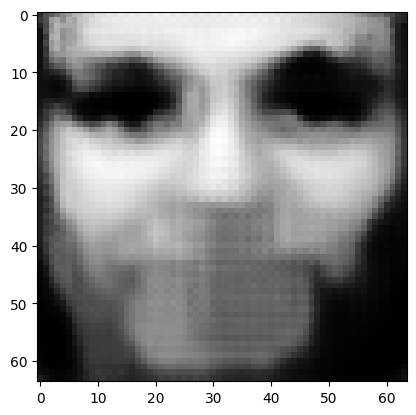

tensor([[1.0981e-05, 9.5627e-07, 2.0272e-03, 2.2891e-05, 5.5058e-05, 4.8481e-07,
         4.2387e-05, 2.1755e-04, 8.7056e-03, 9.6180e-01, 5.9661e-04, 8.6163e-05,
         1.5735e-04, 2.6926e-07, 5.6975e-04, 2.8086e-04, 1.0076e-04, 3.3906e-07,
         2.8794e-04, 3.8951e-04, 2.5452e-04, 1.7962e-03, 3.1143e-03, 5.4168e-04,
         1.0588e-03, 1.2013e-06, 9.6762e-05, 1.4326e-03, 3.8892e-03, 4.2983e-03,
         2.9186e-05, 9.1059e-08, 2.1706e-04, 3.2568e-05, 4.4166e-03, 1.9178e-04,
         1.2121e-04, 7.0535e-05, 3.8158e-04, 2.7009e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03894622623920441
tensor([[1.0969e-05, 9.5458e-07, 2.0247e-03, 2.2854e-05, 5.4985e-05, 4.8420e-07,
         4.2319e-05, 2.1737e-04, 8.6947e-03, 9.6185e-01, 5.9579e-04, 8.6035e-05,
         1.5712e-04, 2.6859e-07, 5.6897e-04, 2.8062e-04, 1.0060e-04, 3.3835e-07,
         2.8761e-04, 3.8911e-04, 2.5407e-04, 1.7940e-03, 3.1109e-03, 5.4108e-04,
         1.0572e-03, 1.1991e-06, 9.6616e-0

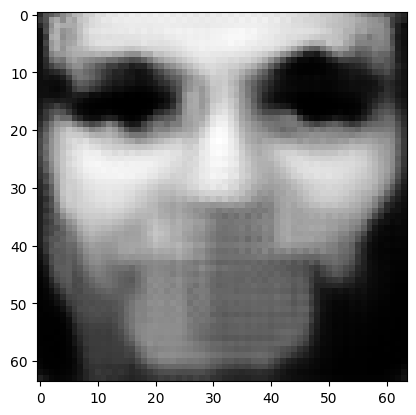

tensor([[1.0924e-05, 9.4799e-07, 2.0153e-03, 2.2711e-05, 5.4710e-05, 4.8182e-07,
         4.2059e-05, 2.1667e-04, 8.6523e-03, 9.6203e-01, 5.9261e-04, 8.5540e-05,
         1.5622e-04, 2.6600e-07, 5.6592e-04, 2.7971e-04, 1.0001e-04, 3.3557e-07,
         2.8634e-04, 3.8752e-04, 2.5230e-04, 1.7858e-03, 3.0974e-03, 5.3872e-04,
         1.0509e-03, 1.1908e-06, 9.6048e-05, 1.4239e-03, 3.8669e-03, 4.2763e-03,
         2.8925e-05, 9.0128e-08, 2.1549e-04, 3.2292e-05, 4.3913e-03, 1.9081e-04,
         1.2022e-04, 6.9804e-05, 3.7847e-04, 2.6849e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03871207311749458
tensor([[1.0913e-05, 9.4639e-07, 2.0130e-03, 2.2676e-05, 5.4644e-05, 4.8125e-07,
         4.1997e-05, 2.1650e-04, 8.6421e-03, 9.6207e-01, 5.9184e-04, 8.5419e-05,
         1.5600e-04, 2.6537e-07, 5.6519e-04, 2.7949e-04, 9.9868e-05, 3.3489e-07,
         2.8603e-04, 3.8714e-04, 2.5187e-04, 1.7839e-03, 3.0942e-03, 5.3814e-04,
         1.0494e-03, 1.1888e-06, 9.5910e-0

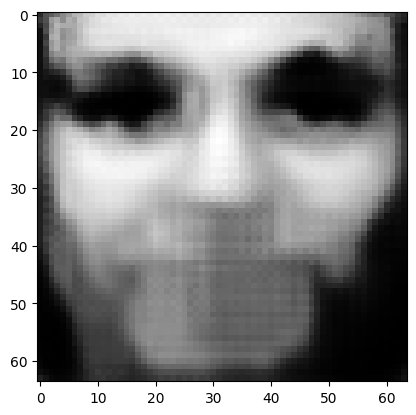

tensor([[1.0870e-05, 9.4021e-07, 2.0042e-03, 2.2542e-05, 5.4385e-05, 4.7902e-07,
         4.1753e-05, 2.1585e-04, 8.6024e-03, 9.6224e-01, 5.8885e-04, 8.4954e-05,
         1.5517e-04, 2.6295e-07, 5.6232e-04, 2.7862e-04, 9.9314e-05, 3.3229e-07,
         2.8482e-04, 3.8564e-04, 2.5021e-04, 1.7761e-03, 3.0816e-03, 5.3592e-04,
         1.0434e-03, 1.1810e-06, 9.5378e-05, 1.4158e-03, 3.8458e-03, 4.2556e-03,
         2.8681e-05, 8.9258e-08, 2.1402e-04, 3.2033e-05, 4.3676e-03, 1.8991e-04,
         1.1928e-04, 6.9118e-05, 3.7556e-04, 2.6699e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03849208727478981
tensor([[1.0860e-05, 9.3872e-07, 2.0020e-03, 2.2509e-05, 5.4321e-05, 4.7848e-07,
         4.1694e-05, 2.1569e-04, 8.5927e-03, 9.6228e-01, 5.8813e-04, 8.4842e-05,
         1.5496e-04, 2.6237e-07, 5.6162e-04, 2.7842e-04, 9.9178e-05, 3.3166e-07,
         2.8453e-04, 3.8528e-04, 2.4981e-04, 1.7742e-03, 3.0785e-03, 5.3539e-04,
         1.0420e-03, 1.1791e-06, 9.5249e-0

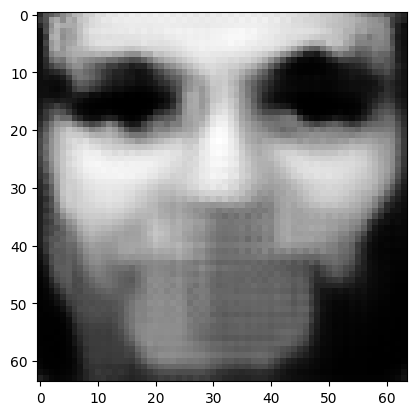

tensor([[1.0820e-05, 9.3293e-07, 1.9937e-03, 2.2383e-05, 5.4078e-05, 4.7639e-07,
         4.1465e-05, 2.1507e-04, 8.5553e-03, 9.6244e-01, 5.8531e-04, 8.4405e-05,
         1.5417e-04, 2.6010e-07, 5.5894e-04, 2.7760e-04, 9.8657e-05, 3.2923e-07,
         2.8340e-04, 3.8387e-04, 2.4825e-04, 1.7670e-03, 3.0667e-03, 5.3330e-04,
         1.0364e-03, 1.1718e-06, 9.4749e-05, 1.4081e-03, 3.8260e-03, 4.2361e-03,
         2.8452e-05, 8.8443e-08, 2.1263e-04, 3.1789e-05, 4.3452e-03, 1.8906e-04,
         1.1841e-04, 6.8479e-05, 3.7283e-04, 2.6557e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03828513249754906
tensor([[1.0810e-05, 9.3152e-07, 1.9917e-03, 2.2353e-05, 5.4020e-05, 4.7588e-07,
         4.1410e-05, 2.1492e-04, 8.5462e-03, 9.6248e-01, 5.8463e-04, 8.4299e-05,
         1.5399e-04, 2.5956e-07, 5.5829e-04, 2.7741e-04, 9.8532e-05, 3.2864e-07,
         2.8313e-04, 3.8352e-04, 2.4787e-04, 1.7652e-03, 3.0638e-03, 5.3280e-04,
         1.0351e-03, 1.1700e-06, 9.4628e-0

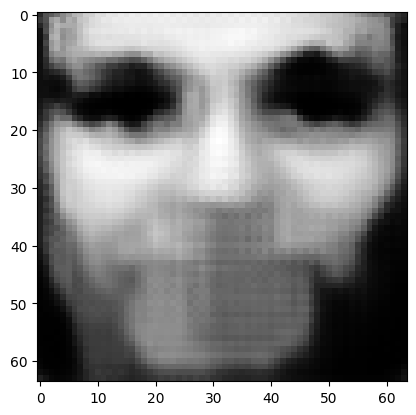

tensor([[1.0772e-05, 9.2609e-07, 1.9839e-03, 2.2234e-05, 5.3791e-05, 4.7392e-07,
         4.1196e-05, 2.1434e-04, 8.5110e-03, 9.6263e-01, 5.8199e-04, 8.3890e-05,
         1.5325e-04, 2.5744e-07, 5.5575e-04, 2.7664e-04, 9.8043e-05, 3.2635e-07,
         2.8206e-04, 3.8219e-04, 2.4641e-04, 1.7584e-03, 3.0526e-03, 5.3083e-04,
         1.0299e-03, 1.1632e-06, 9.4159e-05, 1.4010e-03, 3.8073e-03, 4.2177e-03,
         2.8238e-05, 8.7682e-08, 2.1133e-04, 3.1561e-05, 4.3242e-03, 1.8826e-04,
         1.1759e-04, 6.7878e-05, 3.7026e-04, 2.6424e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.038090530782938004
tensor([[1.0763e-05, 9.2478e-07, 1.9820e-03, 2.2206e-05, 5.3736e-05, 4.7344e-07,
         4.1143e-05, 2.1420e-04, 8.5025e-03, 9.6266e-01, 5.8134e-04, 8.3791e-05,
         1.5306e-04, 2.5693e-07, 5.5513e-04, 2.7646e-04, 9.7924e-05, 3.2580e-07,
         2.8181e-04, 3.8187e-04, 2.4606e-04, 1.7568e-03, 3.0499e-03, 5.3035e-04,
         1.0286e-03, 1.1615e-06, 9.4044e-

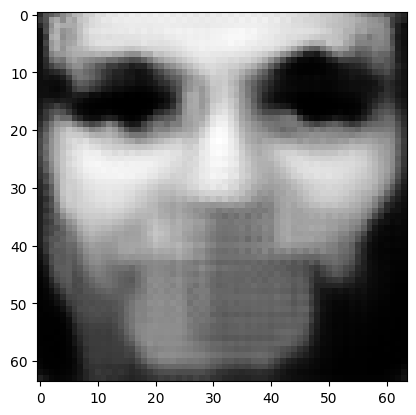

tensor([[1.0728e-05, 9.1968e-07, 1.9746e-03, 2.2095e-05, 5.3521e-05, 4.7159e-07,
         4.0942e-05, 2.1365e-04, 8.4693e-03, 9.6280e-01, 5.7886e-04, 8.3406e-05,
         1.5237e-04, 2.5494e-07, 5.5275e-04, 2.7573e-04, 9.7464e-05, 3.2366e-07,
         2.8081e-04, 3.8062e-04, 2.4469e-04, 1.7503e-03, 3.0394e-03, 5.2850e-04,
         1.0237e-03, 1.1551e-06, 9.3603e-05, 1.3942e-03, 3.7897e-03, 4.2003e-03,
         2.8037e-05, 8.6967e-08, 2.1011e-04, 3.1347e-05, 4.3045e-03, 1.8750e-04,
         1.1682e-04, 6.7316e-05, 3.6785e-04, 2.6299e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03790736570954323
tensor([[1.0719e-05, 9.1843e-07, 1.9728e-03, 2.2068e-05, 5.3469e-05, 4.7115e-07,
         4.0893e-05, 2.1352e-04, 8.4613e-03, 9.6284e-01, 5.7825e-04, 8.3312e-05,
         1.5220e-04, 2.5446e-07, 5.5218e-04, 2.7556e-04, 9.7354e-05, 3.2314e-07,
         2.8056e-04, 3.8031e-04, 2.4436e-04, 1.7488e-03, 3.0369e-03, 5.2805e-04,
         1.0225e-03, 1.1535e-06, 9.3496e-0

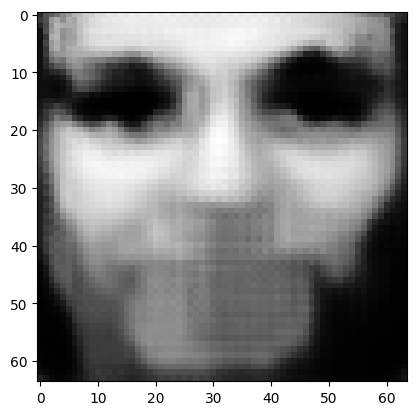

tensor([[1.0686e-05, 9.1364e-07, 1.9659e-03, 2.1963e-05, 5.3267e-05, 4.6941e-07,
         4.0704e-05, 2.1300e-04, 8.4301e-03, 9.6297e-01, 5.7591e-04, 8.2949e-05,
         1.5155e-04, 2.5261e-07, 5.4993e-04, 2.7488e-04, 9.6921e-05, 3.2113e-07,
         2.7962e-04, 3.7913e-04, 2.4307e-04, 1.7427e-03, 3.0270e-03, 5.2631e-04,
         1.0179e-03, 1.1475e-06, 9.3081e-05, 1.3878e-03, 3.7731e-03, 4.1839e-03,
         2.7848e-05, 8.6298e-08, 2.0896e-04, 3.1145e-05, 4.2858e-03, 1.8679e-04,
         1.1609e-04, 6.6787e-05, 3.6558e-04, 2.6181e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03773484379053116
tensor([[1.0678e-05, 9.1247e-07, 1.9642e-03, 2.1938e-05, 5.3218e-05, 4.6898e-07,
         4.0657e-05, 2.1287e-04, 8.4225e-03, 9.6300e-01, 5.7534e-04, 8.2862e-05,
         1.5139e-04, 2.5216e-07, 5.4938e-04, 2.7471e-04, 9.6816e-05, 3.2064e-07,
         2.7939e-04, 3.7884e-04, 2.4276e-04, 1.7413e-03, 3.0246e-03, 5.2589e-04,
         1.0168e-03, 1.1460e-06, 9.2980e-0

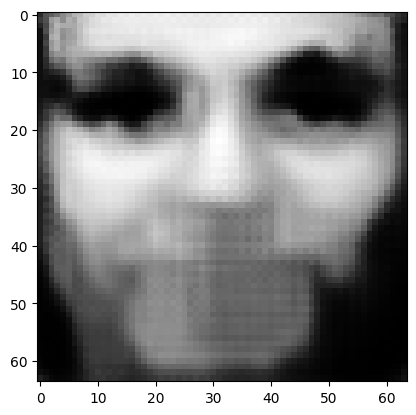

tensor([[1.0646e-05, 9.0795e-07, 1.9576e-03, 2.1839e-05, 5.3026e-05, 4.6734e-07,
         4.0478e-05, 2.1238e-04, 8.3930e-03, 9.6313e-01, 5.7313e-04, 8.2520e-05,
         1.5077e-04, 2.5041e-07, 5.4727e-04, 2.7407e-04, 9.6407e-05, 3.1875e-07,
         2.7850e-04, 3.7773e-04, 2.4154e-04, 1.7355e-03, 3.0152e-03, 5.2424e-04,
         1.0124e-03, 1.1403e-06, 9.2588e-05, 1.3818e-03, 3.7575e-03, 4.1685e-03,
         2.7669e-05, 8.5666e-08, 2.0788e-04, 3.0955e-05, 4.2682e-03, 1.8611e-04,
         1.1541e-04, 6.6290e-05, 3.6344e-04, 2.6069e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03757193684577942
tensor([[1.0638e-05, 9.0685e-07, 1.9560e-03, 2.1815e-05, 5.2981e-05, 4.6694e-07,
         4.0435e-05, 2.1226e-04, 8.3859e-03, 9.6316e-01, 5.7259e-04, 8.2437e-05,
         1.5062e-04, 2.4999e-07, 5.4675e-04, 2.7391e-04, 9.6309e-05, 3.1829e-07,
         2.7828e-04, 3.7745e-04, 2.4124e-04, 1.7342e-03, 3.0130e-03, 5.2384e-04,
         1.0114e-03, 1.1390e-06, 9.2493e-0

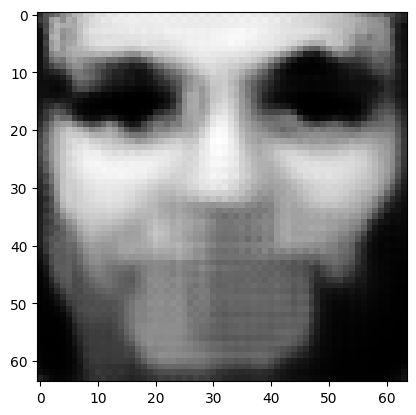

tensor([[1.0608e-05, 9.0260e-07, 1.9499e-03, 2.1722e-05, 5.2800e-05, 4.6539e-07,
         4.0267e-05, 2.1180e-04, 8.3581e-03, 9.6327e-01, 5.7051e-04, 8.2114e-05,
         1.5004e-04, 2.4835e-07, 5.4476e-04, 2.7330e-04, 9.5925e-05, 3.1651e-07,
         2.7744e-04, 3.7640e-04, 2.4010e-04, 1.7288e-03, 3.0042e-03, 5.2229e-04,
         1.0073e-03, 1.1336e-06, 9.2124e-05, 1.3762e-03, 3.7427e-03, 4.1539e-03,
         2.7502e-05, 8.5073e-08, 2.0685e-04, 3.0776e-05, 4.2516e-03, 1.8548e-04,
         1.1477e-04, 6.5822e-05, 3.6143e-04, 2.5964e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0374184213578701
tensor([[1.0601e-05, 9.0157e-07, 1.9484e-03, 2.1700e-05, 5.2756e-05, 4.6501e-07,
         4.0225e-05, 2.1169e-04, 8.3514e-03, 9.6330e-01, 5.7001e-04, 8.2037e-05,
         1.4989e-04, 2.4795e-07, 5.4427e-04, 2.7316e-04, 9.5831e-05, 3.1608e-07,
         2.7724e-04, 3.7615e-04, 2.3983e-04, 1.7274e-03, 3.0020e-03, 5.2191e-04,
         1.0063e-03, 1.1323e-06, 9.2035e-05

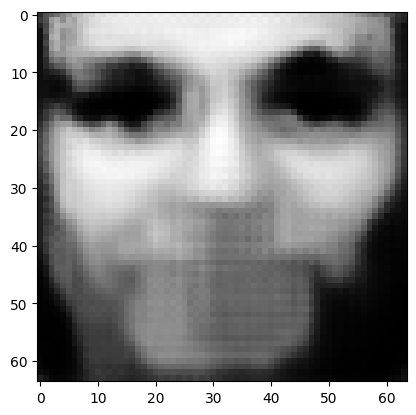

tensor([[1.0573e-05, 8.9756e-07, 1.9425e-03, 2.1612e-05, 5.2586e-05, 4.6355e-07,
         4.0067e-05, 2.1125e-04, 8.3251e-03, 9.6341e-01, 5.6804e-04, 8.1733e-05,
         1.4934e-04, 2.4641e-07, 5.4239e-04, 2.7258e-04, 9.5469e-05, 3.1441e-07,
         2.7644e-04, 3.7515e-04, 2.3875e-04, 1.7223e-03, 2.9937e-03, 5.2044e-04,
         1.0024e-03, 1.1272e-06, 9.1687e-05, 1.3708e-03, 3.7288e-03, 4.1402e-03,
         2.7344e-05, 8.4515e-08, 2.0589e-04, 3.0608e-05, 4.2359e-03, 1.8488e-04,
         1.1416e-04, 6.5382e-05, 3.5953e-04, 2.5865e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03727337718009949
tensor([[1.0566e-05, 8.9658e-07, 1.9411e-03, 2.1591e-05, 5.2545e-05, 4.6319e-07,
         4.0028e-05, 2.1115e-04, 8.3188e-03, 9.6344e-01, 5.6756e-04, 8.1659e-05,
         1.4921e-04, 2.4603e-07, 5.4193e-04, 2.7244e-04, 9.5381e-05, 3.1400e-07,
         2.7625e-04, 3.7491e-04, 2.3849e-04, 1.7211e-03, 2.9917e-03, 5.2008e-04,
         1.0015e-03, 1.1260e-06, 9.1603e-0

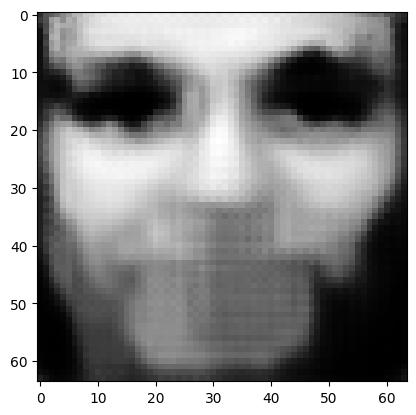

tensor([[1.0540e-05, 8.9281e-07, 1.9356e-03, 2.1509e-05, 5.2385e-05, 4.6181e-07,
         3.9879e-05, 2.1073e-04, 8.2941e-03, 9.6354e-01, 5.6571e-04, 8.1372e-05,
         1.4869e-04, 2.4458e-07, 5.4015e-04, 2.7190e-04, 9.5040e-05, 3.1242e-07,
         2.7550e-04, 3.7397e-04, 2.3747e-04, 1.7163e-03, 2.9838e-03, 5.1870e-04,
         9.9783e-04, 1.1213e-06, 9.1275e-05, 1.3658e-03, 3.7156e-03, 4.1271e-03,
         2.7195e-05, 8.3989e-08, 2.0498e-04, 3.0449e-05, 4.2210e-03, 1.8431e-04,
         1.1359e-04, 6.4968e-05, 3.5774e-04, 2.5771e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037136584520339966
tensor([[1.0533e-05, 8.9190e-07, 1.9343e-03, 2.1489e-05, 5.2346e-05, 4.6148e-07,
         3.9842e-05, 2.1064e-04, 8.2880e-03, 9.6357e-01, 5.6526e-04, 8.1303e-05,
         1.4857e-04, 2.4423e-07, 5.3972e-04, 2.7177e-04, 9.4956e-05, 3.1204e-07,
         2.7532e-04, 3.7374e-04, 2.3722e-04, 1.7151e-03, 2.9819e-03, 5.1837e-04,
         9.9694e-04, 1.1201e-06, 9.1195e-

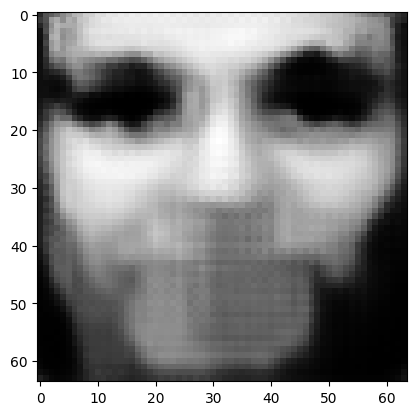

tensor([[1.0508e-05, 8.8834e-07, 1.9291e-03, 2.1411e-05, 5.2194e-05, 4.6018e-07,
         3.9701e-05, 2.1025e-04, 8.2647e-03, 9.6367e-01, 5.6351e-04, 8.1033e-05,
         1.4808e-04, 2.4287e-07, 5.3804e-04, 2.7126e-04, 9.4635e-05, 3.1056e-07,
         2.7461e-04, 3.7285e-04, 2.3627e-04, 1.7106e-03, 2.9744e-03, 5.1706e-04,
         9.9350e-04, 1.1156e-06, 9.0886e-05, 1.3610e-03, 3.7032e-03, 4.1148e-03,
         2.7054e-05, 8.3495e-08, 2.0412e-04, 3.0299e-05, 4.2070e-03, 1.8378e-04,
         1.1305e-04, 6.4578e-05, 3.5606e-04, 2.5683e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03700735419988632
tensor([[1.0502e-05, 8.8747e-07, 1.9278e-03, 2.1392e-05, 5.2158e-05, 4.5986e-07,
         3.9667e-05, 2.1015e-04, 8.2590e-03, 9.6369e-01, 5.6308e-04, 8.0968e-05,
         1.4796e-04, 2.4254e-07, 5.3763e-04, 2.7114e-04, 9.4557e-05, 3.1020e-07,
         2.7444e-04, 3.7263e-04, 2.3603e-04, 1.7095e-03, 2.9726e-03, 5.1674e-04,
         9.9267e-04, 1.1146e-06, 9.0811e-0

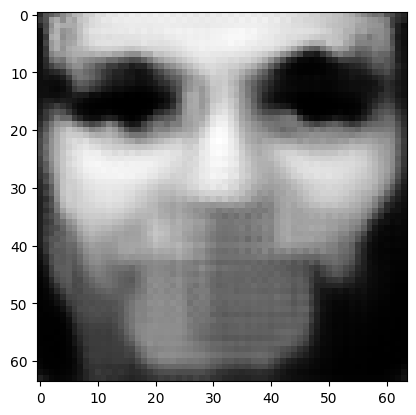

tensor([[1.0478e-05, 8.8412e-07, 1.9229e-03, 2.1319e-05, 5.2015e-05, 4.5863e-07,
         3.9534e-05, 2.0978e-04, 8.2369e-03, 9.6379e-01, 5.6143e-04, 8.0713e-05,
         1.4750e-04, 2.4126e-07, 5.3605e-04, 2.7065e-04, 9.4253e-05, 3.0880e-07,
         2.7377e-04, 3.7179e-04, 2.3513e-04, 1.7052e-03, 2.9656e-03, 5.1551e-04,
         9.8943e-04, 1.1103e-06, 9.0519e-05, 1.3565e-03, 3.6915e-03, 4.1032e-03,
         2.6923e-05, 8.3030e-08, 2.0331e-04, 3.0158e-05, 4.1938e-03, 1.8327e-04,
         1.1254e-04, 6.4211e-05, 3.5447e-04, 2.5599e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03688546270132065
tensor([[1.0473e-05, 8.8331e-07, 1.9217e-03, 2.1301e-05, 5.1980e-05, 4.5833e-07,
         3.9501e-05, 2.0969e-04, 8.2316e-03, 9.6381e-01, 5.6103e-04, 8.0652e-05,
         1.4739e-04, 2.4095e-07, 5.3567e-04, 2.7053e-04, 9.4179e-05, 3.0846e-07,
         2.7361e-04, 3.7159e-04, 2.3492e-04, 1.7042e-03, 2.9639e-03, 5.1521e-04,
         9.8863e-04, 1.1093e-06, 9.0449e-0

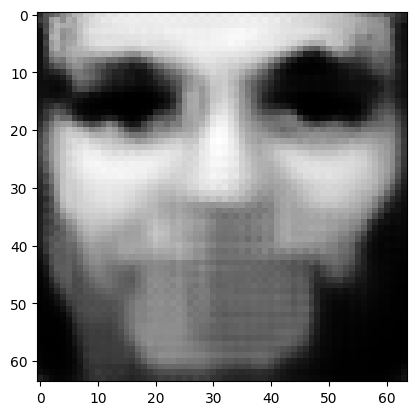

tensor([[1.0450e-05, 8.8014e-07, 1.9171e-03, 2.1232e-05, 5.1846e-05, 4.5717e-07,
         3.9376e-05, 2.0935e-04, 8.2108e-03, 9.6390e-01, 5.5947e-04, 8.0411e-05,
         1.4695e-04, 2.3974e-07, 5.3417e-04, 2.7008e-04, 9.3892e-05, 3.0715e-07,
         2.7298e-04, 3.7080e-04, 2.3406e-04, 1.7001e-03, 2.9573e-03, 5.1404e-04,
         9.8558e-04, 1.1053e-06, 9.0173e-05, 1.3522e-03, 3.6804e-03, 4.0922e-03,
         2.6798e-05, 8.2592e-08, 2.0255e-04, 3.0025e-05, 4.1813e-03, 1.8279e-04,
         1.1206e-04, 6.3866e-05, 3.5297e-04, 2.5520e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03677033260464668
tensor([[1.0445e-05, 8.7937e-07, 1.9160e-03, 2.1215e-05, 5.1813e-05, 4.5689e-07,
         3.9346e-05, 2.0926e-04, 8.2057e-03, 9.6392e-01, 5.5909e-04, 8.0352e-05,
         1.4685e-04, 2.3945e-07, 5.3380e-04, 2.6997e-04, 9.3823e-05, 3.0682e-07,
         2.7282e-04, 3.7060e-04, 2.3386e-04, 1.6991e-03, 2.9557e-03, 5.1376e-04,
         9.8485e-04, 1.1044e-06, 9.0106e-0

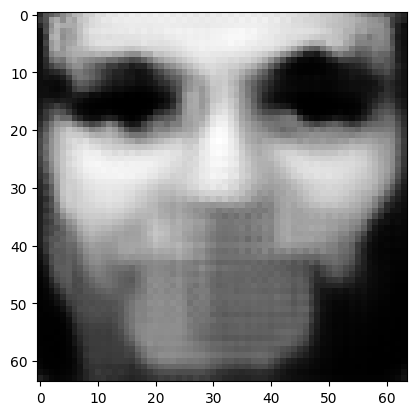

tensor([[1.0424e-05, 8.7639e-07, 1.9116e-03, 2.1150e-05, 5.1686e-05, 4.5580e-07,
         3.9227e-05, 2.0893e-04, 8.1860e-03, 9.6400e-01, 5.5762e-04, 8.0126e-05,
         1.4644e-04, 2.3831e-07, 5.3239e-04, 2.6953e-04, 9.3552e-05, 3.0558e-07,
         2.7223e-04, 3.6985e-04, 2.3305e-04, 1.6953e-03, 2.9494e-03, 5.1265e-04,
         9.8195e-04, 1.1006e-06, 8.9847e-05, 1.3482e-03, 3.6699e-03, 4.0818e-03,
         2.6680e-05, 8.2178e-08, 2.0183e-04, 2.9899e-05, 4.1695e-03, 1.8234e-04,
         1.1161e-04, 6.3539e-05, 3.5155e-04, 2.5446e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03666128218173981
tensor([[1.0418e-05, 8.7566e-07, 1.9105e-03, 2.1134e-05, 5.1654e-05, 4.5553e-07,
         3.9198e-05, 2.0885e-04, 8.1812e-03, 9.6402e-01, 5.5726e-04, 8.0071e-05,
         1.4634e-04, 2.3804e-07, 5.3205e-04, 2.6943e-04, 9.3486e-05, 3.0528e-07,
         2.7208e-04, 3.6967e-04, 2.3286e-04, 1.6944e-03, 2.9479e-03, 5.1238e-04,
         9.8124e-04, 1.0997e-06, 8.9783e-0

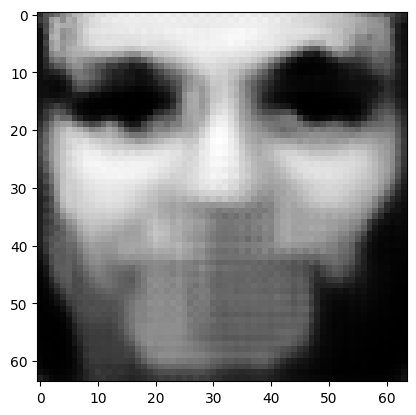

tensor([[1.0398e-05, 8.7284e-07, 1.9064e-03, 2.1072e-05, 5.1533e-05, 4.5449e-07,
         3.9086e-05, 2.0854e-04, 8.1626e-03, 9.6410e-01, 5.5587e-04, 7.9856e-05,
         1.4595e-04, 2.3696e-07, 5.3071e-04, 2.6902e-04, 9.3230e-05, 3.0411e-07,
         2.7152e-04, 3.6896e-04, 2.3210e-04, 1.6908e-03, 2.9419e-03, 5.1134e-04,
         9.7851e-04, 1.0962e-06, 8.9537e-05, 1.3444e-03, 3.6600e-03, 4.0720e-03,
         2.6569e-05, 8.1787e-08, 2.0114e-04, 2.9780e-05, 4.1583e-03, 1.8191e-04,
         1.1118e-04, 6.3230e-05, 3.5021e-04, 2.5375e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03655819594860077
tensor([[1.0394e-05, 8.7216e-07, 1.9054e-03, 2.1057e-05, 5.1504e-05, 4.5424e-07,
         3.9058e-05, 2.0846e-04, 8.1581e-03, 9.6412e-01, 5.5553e-04, 7.9804e-05,
         1.4585e-04, 2.3670e-07, 5.3038e-04, 2.6892e-04, 9.3167e-05, 3.0383e-07,
         2.7138e-04, 3.6879e-04, 2.3192e-04, 1.6899e-03, 2.9405e-03, 5.1109e-04,
         9.7783e-04, 1.0953e-06, 8.9478e-0

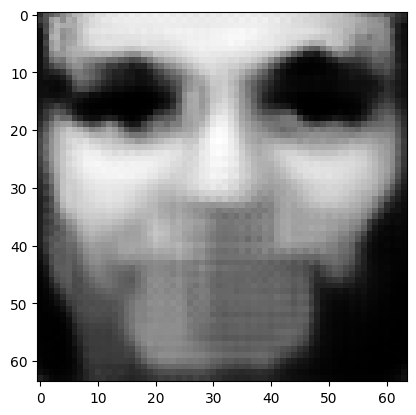

tensor([[1.0375e-05, 8.6948e-07, 1.9014e-03, 2.0999e-05, 5.1390e-05, 4.5325e-07,
         3.8952e-05, 2.0817e-04, 8.1404e-03, 9.6420e-01, 5.5421e-04, 7.9601e-05,
         1.4548e-04, 2.3569e-07, 5.2912e-04, 2.6853e-04, 9.2926e-05, 3.0272e-07,
         2.7085e-04, 3.6812e-04, 2.3120e-04, 1.6864e-03, 2.9348e-03, 5.1010e-04,
         9.7525e-04, 1.0919e-06, 8.9246e-05, 1.3408e-03, 3.6506e-03, 4.0627e-03,
         2.6464e-05, 8.1418e-08, 2.0050e-04, 2.9668e-05, 4.1477e-03, 1.8150e-04,
         1.1077e-04, 6.2940e-05, 3.4894e-04, 2.5308e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03646061569452286
tensor([[1.0370e-05, 8.6883e-07, 1.9005e-03, 2.0985e-05, 5.1362e-05, 4.5302e-07,
         3.8927e-05, 2.0809e-04, 8.1362e-03, 9.6421e-01, 5.5389e-04, 7.9552e-05,
         1.4539e-04, 2.3545e-07, 5.2881e-04, 2.6844e-04, 9.2867e-05, 3.0245e-07,
         2.7072e-04, 3.6795e-04, 2.3102e-04, 1.6856e-03, 2.9335e-03, 5.0986e-04,
         9.7463e-04, 1.0911e-06, 8.9189e-0

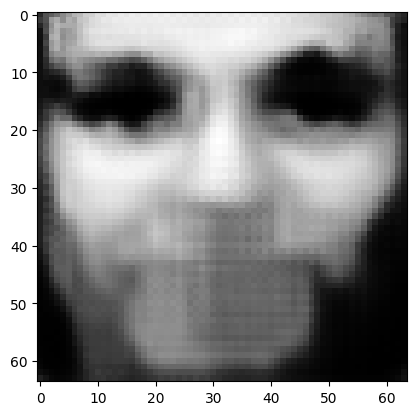

tensor([[1.0352e-05, 8.6631e-07, 1.8968e-03, 2.0929e-05, 5.1255e-05, 4.5209e-07,
         3.8827e-05, 2.0781e-04, 8.1195e-03, 9.6428e-01, 5.5264e-04, 7.9359e-05,
         1.4505e-04, 2.3449e-07, 5.2761e-04, 2.6807e-04, 9.2638e-05, 3.0140e-07,
         2.7021e-04, 3.6732e-04, 2.3035e-04, 1.6824e-03, 2.9282e-03, 5.0892e-04,
         9.7219e-04, 1.0879e-06, 8.8969e-05, 1.3374e-03, 3.6417e-03, 4.0538e-03,
         2.6365e-05, 8.1070e-08, 1.9989e-04, 2.9561e-05, 4.1377e-03, 1.8112e-04,
         1.1039e-04, 6.2665e-05, 3.4775e-04, 2.5245e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03636854141950607
tensor([[1.0348e-05, 8.6570e-07, 1.8959e-03, 2.0916e-05, 5.1228e-05, 4.5186e-07,
         3.8802e-05, 2.0775e-04, 8.1155e-03, 9.6430e-01, 5.5234e-04, 7.9313e-05,
         1.4496e-04, 2.3426e-07, 5.2732e-04, 2.6798e-04, 9.2583e-05, 3.0115e-07,
         2.7009e-04, 3.6716e-04, 2.3018e-04, 1.6816e-03, 2.9269e-03, 5.0870e-04,
         9.7159e-04, 1.0872e-06, 8.8916e-0

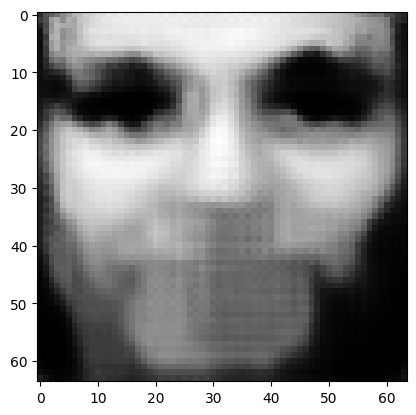

tensor([[1.0331e-05, 8.6332e-07, 1.8923e-03, 2.0864e-05, 5.1126e-05, 4.5098e-07,
         3.8708e-05, 2.0748e-04, 8.0997e-03, 9.6437e-01, 5.5116e-04, 7.9132e-05,
         1.4463e-04, 2.3336e-07, 5.2618e-04, 2.6763e-04, 9.2366e-05, 3.0016e-07,
         2.6961e-04, 3.6656e-04, 2.2954e-04, 1.6785e-03, 2.9218e-03, 5.0781e-04,
         9.6927e-04, 1.0842e-06, 8.8708e-05, 1.3342e-03, 3.6333e-03, 4.0455e-03,
         2.6271e-05, 8.0740e-08, 1.9931e-04, 2.9461e-05, 4.1282e-03, 1.8076e-04,
         1.1003e-04, 6.2406e-05, 3.4661e-04, 2.5186e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036281291395425797
tensor([[1.0326e-05, 8.6274e-07, 1.8915e-03, 2.0851e-05, 5.1102e-05, 4.5077e-07,
         3.8685e-05, 2.0742e-04, 8.0958e-03, 9.6439e-01, 5.5087e-04, 7.9087e-05,
         1.4455e-04, 2.3314e-07, 5.2591e-04, 2.6755e-04, 9.2314e-05, 2.9992e-07,
         2.6949e-04, 3.6641e-04, 2.2938e-04, 1.6778e-03, 2.9206e-03, 5.0760e-04,
         9.6873e-04, 1.0835e-06, 8.8657e-

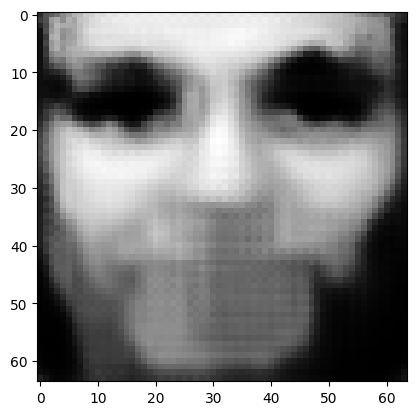

tensor([[1.0310e-05, 8.6049e-07, 1.8882e-03, 2.0802e-05, 5.1005e-05, 4.4994e-07,
         3.8595e-05, 2.0717e-04, 8.0809e-03, 9.6445e-01, 5.4975e-04, 7.8916e-05,
         1.4424e-04, 2.3229e-07, 5.2484e-04, 2.6722e-04, 9.2109e-05, 2.9899e-07,
         2.6904e-04, 3.6584e-04, 2.2878e-04, 1.6749e-03, 2.9158e-03, 5.0676e-04,
         9.6652e-04, 1.0806e-06, 8.8461e-05, 1.3311e-03, 3.6253e-03, 4.0376e-03,
         2.6182e-05, 8.0430e-08, 1.9877e-04, 2.9366e-05, 4.1193e-03, 1.8041e-04,
         1.0969e-04, 6.2161e-05, 3.4555e-04, 2.5129e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03619885817170143
tensor([[1.0306e-05, 8.5993e-07, 1.8874e-03, 2.0790e-05, 5.0982e-05, 4.4974e-07,
         3.8574e-05, 2.0710e-04, 8.0773e-03, 9.6446e-01, 5.4948e-04, 7.8874e-05,
         1.4417e-04, 2.3208e-07, 5.2457e-04, 2.6714e-04, 9.2059e-05, 2.9876e-07,
         2.6893e-04, 3.6570e-04, 2.2863e-04, 1.6742e-03, 2.9147e-03, 5.0656e-04,
         9.6600e-04, 1.0799e-06, 8.8413e-0

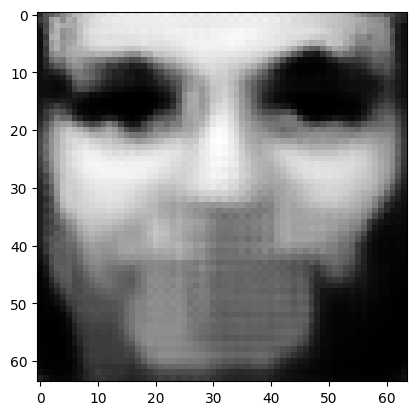

tensor([[1.0291e-05, 8.5780e-07, 1.8842e-03, 2.0743e-05, 5.0890e-05, 4.4895e-07,
         3.8489e-05, 2.0687e-04, 8.0632e-03, 9.6452e-01, 5.4842e-04, 7.8712e-05,
         1.4387e-04, 2.3128e-07, 5.2356e-04, 2.6683e-04, 9.1866e-05, 2.9788e-07,
         2.6850e-04, 3.6516e-04, 2.2806e-04, 1.6714e-03, 2.9102e-03, 5.0576e-04,
         9.6394e-04, 1.0773e-06, 8.8227e-05, 1.3283e-03, 3.6178e-03, 4.0301e-03,
         2.6099e-05, 8.0136e-08, 1.9825e-04, 2.9276e-05, 4.1108e-03, 1.8009e-04,
         1.0937e-04, 6.1929e-05, 3.4453e-04, 2.5076e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03612067550420761
tensor([[1.0288e-05, 8.5729e-07, 1.8835e-03, 2.0732e-05, 5.0868e-05, 4.4876e-07,
         3.8468e-05, 2.0681e-04, 8.0597e-03, 9.6454e-01, 5.4817e-04, 7.8673e-05,
         1.4380e-04, 2.3109e-07, 5.2331e-04, 2.6675e-04, 9.1819e-05, 2.9766e-07,
         2.6840e-04, 3.6503e-04, 2.2792e-04, 1.6707e-03, 2.9091e-03, 5.0557e-04,
         9.6343e-04, 1.0766e-06, 8.8182e-0

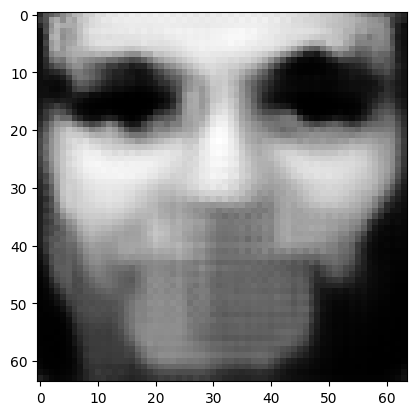

tensor([[1.0273e-05, 8.5527e-07, 1.8805e-03, 2.0688e-05, 5.0782e-05, 4.4801e-07,
         3.8388e-05, 2.0658e-04, 8.0463e-03, 9.6460e-01, 5.4716e-04, 7.8520e-05,
         1.4352e-04, 2.3033e-07, 5.2235e-04, 2.6645e-04, 9.1636e-05, 2.9683e-07,
         2.6799e-04, 3.6452e-04, 2.2738e-04, 1.6681e-03, 2.9048e-03, 5.0482e-04,
         9.6148e-04, 1.0741e-06, 8.8006e-05, 1.3255e-03, 3.6106e-03, 4.0230e-03,
         2.6019e-05, 7.9859e-08, 1.9776e-04, 2.9192e-05, 4.1027e-03, 1.7978e-04,
         1.0906e-04, 6.1710e-05, 3.4357e-04, 2.5025e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036046624183654785
tensor([[1.0270e-05, 8.5478e-07, 1.8798e-03, 2.0677e-05, 5.0761e-05, 4.4783e-07,
         3.8369e-05, 2.0653e-04, 8.0431e-03, 9.6461e-01, 5.4692e-04, 7.8482e-05,
         1.4346e-04, 2.3014e-07, 5.2212e-04, 2.6638e-04, 9.1592e-05, 2.9663e-07,
         2.6789e-04, 3.6439e-04, 2.2725e-04, 1.6675e-03, 2.9038e-03, 5.0464e-04,
         9.6101e-04, 1.0735e-06, 8.7964e-

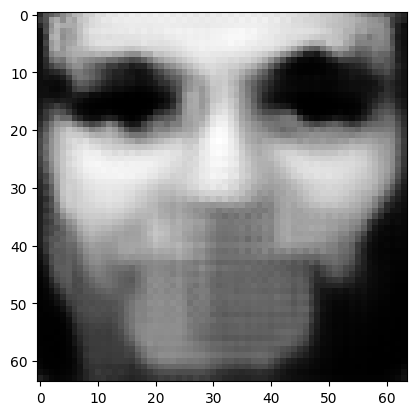

tensor([[1.0256e-05, 8.5288e-07, 1.8769e-03, 2.0635e-05, 5.0679e-05, 4.4713e-07,
         3.8293e-05, 2.0632e-04, 8.0304e-03, 9.6466e-01, 5.4597e-04, 7.8337e-05,
         1.4319e-04, 2.2943e-07, 5.2121e-04, 2.6610e-04, 9.1419e-05, 2.9584e-07,
         2.6751e-04, 3.6390e-04, 2.2674e-04, 1.6650e-03, 2.8998e-03, 5.0392e-04,
         9.5916e-04, 1.0711e-06, 8.7797e-05, 1.3230e-03, 3.6039e-03, 4.0162e-03,
         2.5944e-05, 7.9597e-08, 1.9730e-04, 2.9111e-05, 4.0951e-03, 1.7949e-04,
         1.0877e-04, 6.1503e-05, 3.4267e-04, 2.4977e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03597671166062355
tensor([[1.0253e-05, 8.5242e-07, 1.8762e-03, 2.0625e-05, 5.0659e-05, 4.4696e-07,
         3.8274e-05, 2.0626e-04, 8.0273e-03, 9.6468e-01, 5.4574e-04, 7.8302e-05,
         1.4313e-04, 2.2925e-07, 5.2098e-04, 2.6603e-04, 9.1376e-05, 2.9565e-07,
         2.6742e-04, 3.6379e-04, 2.2661e-04, 1.6644e-03, 2.8988e-03, 5.0375e-04,
         9.5870e-04, 1.0705e-06, 8.7756e-0

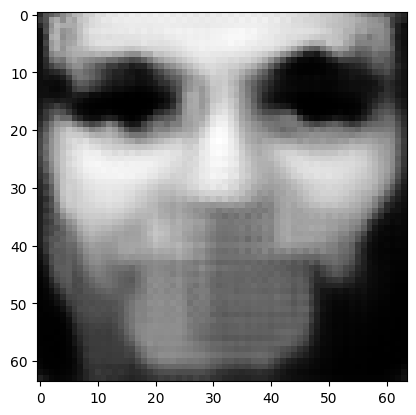

tensor([[1.0240e-05, 8.5061e-07, 1.8736e-03, 2.0585e-05, 5.0581e-05, 4.4629e-07,
         3.8203e-05, 2.0606e-04, 8.0153e-03, 9.6473e-01, 5.4485e-04, 7.8165e-05,
         1.4288e-04, 2.2857e-07, 5.2012e-04, 2.6577e-04, 9.1212e-05, 2.9491e-07,
         2.6705e-04, 3.6333e-04, 2.2613e-04, 1.6621e-03, 2.8949e-03, 5.0308e-04,
         9.5695e-04, 1.0682e-06, 8.7599e-05, 1.3205e-03, 3.5974e-03, 4.0099e-03,
         2.5873e-05, 7.9349e-08, 1.9686e-04, 2.9035e-05, 4.0879e-03, 1.7921e-04,
         1.0850e-04, 6.1308e-05, 3.4181e-04, 2.4932e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03591012582182884
tensor([[1.0237e-05, 8.5017e-07, 1.8729e-03, 2.0576e-05, 5.0562e-05, 4.4613e-07,
         3.8185e-05, 2.0601e-04, 8.0124e-03, 9.6474e-01, 5.4463e-04, 7.8131e-05,
         1.4282e-04, 2.2841e-07, 5.1991e-04, 2.6570e-04, 9.1172e-05, 2.9472e-07,
         2.6696e-04, 3.6321e-04, 2.2601e-04, 1.6615e-03, 2.8940e-03, 5.0291e-04,
         9.5653e-04, 1.0677e-06, 8.7560e-0

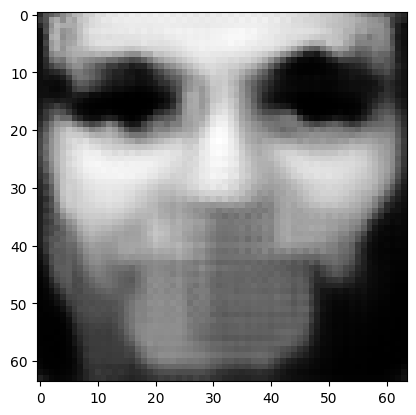

tensor([[1.0224e-05, 8.4847e-07, 1.8704e-03, 2.0538e-05, 5.0489e-05, 4.4550e-07,
         3.8117e-05, 2.0582e-04, 8.0011e-03, 9.6479e-01, 5.4378e-04, 7.8001e-05,
         1.4258e-04, 2.2777e-07, 5.1909e-04, 2.6545e-04, 9.1017e-05, 2.9402e-07,
         2.6662e-04, 3.6278e-04, 2.2555e-04, 1.6593e-03, 2.8904e-03, 5.0227e-04,
         9.5487e-04, 1.0656e-06, 8.7411e-05, 1.3182e-03, 3.5914e-03, 4.0038e-03,
         2.5806e-05, 7.9114e-08, 1.9645e-04, 2.8963e-05, 4.0811e-03, 1.7895e-04,
         1.0824e-04, 6.1123e-05, 3.4100e-04, 2.4888e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03584744408726692
tensor([[1.0221e-05, 8.4805e-07, 1.8698e-03, 2.0529e-05, 5.0471e-05, 4.4534e-07,
         3.8101e-05, 2.0577e-04, 7.9983e-03, 9.6480e-01, 5.4357e-04, 7.7969e-05,
         1.4252e-04, 2.2761e-07, 5.1890e-04, 2.6539e-04, 9.0979e-05, 2.9385e-07,
         2.6653e-04, 3.6267e-04, 2.2544e-04, 1.6588e-03, 2.8895e-03, 5.0212e-04,
         9.5446e-04, 1.0650e-06, 8.7375e-0

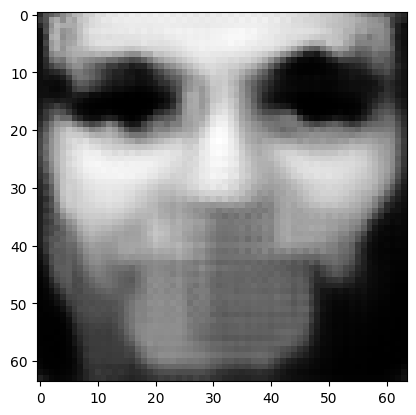

tensor([[1.0210e-05, 8.4644e-07, 1.8674e-03, 2.0494e-05, 5.0402e-05, 4.4474e-07,
         3.8036e-05, 2.0559e-04, 7.9875e-03, 9.6484e-01, 5.4276e-04, 7.7846e-05,
         1.4230e-04, 2.2701e-07, 5.1812e-04, 2.6515e-04, 9.0832e-05, 2.9318e-07,
         2.6621e-04, 3.6226e-04, 2.2500e-04, 1.6567e-03, 2.8861e-03, 5.0151e-04,
         9.5289e-04, 1.0630e-06, 8.7234e-05, 1.3160e-03, 3.5856e-03, 3.9981e-03,
         2.5743e-05, 7.8892e-08, 1.9605e-04, 2.8895e-05, 4.0746e-03, 1.7870e-04,
         1.0799e-04, 6.0948e-05, 3.4023e-04, 2.4848e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03578798100352287
tensor([[1.0207e-05, 8.4604e-07, 1.8668e-03, 2.0485e-05, 5.0385e-05, 4.4460e-07,
         3.8021e-05, 2.0555e-04, 7.9849e-03, 9.6486e-01, 5.4257e-04, 7.7816e-05,
         1.4224e-04, 2.2686e-07, 5.1794e-04, 2.6509e-04, 9.0796e-05, 2.9302e-07,
         2.6613e-04, 3.6216e-04, 2.2490e-04, 1.6562e-03, 2.8853e-03, 5.0137e-04,
         9.5251e-04, 1.0625e-06, 8.7199e-0

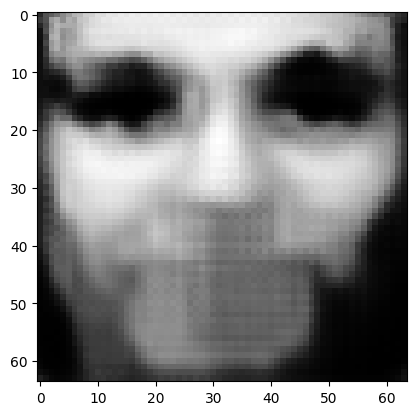

tensor([[1.0196e-05, 8.4451e-07, 1.8645e-03, 2.0452e-05, 5.0319e-05, 4.4403e-07,
         3.7960e-05, 2.0538e-04, 7.9747e-03, 9.6490e-01, 5.4180e-04, 7.7699e-05,
         1.4203e-04, 2.2629e-07, 5.1720e-04, 2.6486e-04, 9.0657e-05, 2.9239e-07,
         2.6582e-04, 3.6176e-04, 2.2449e-04, 1.6542e-03, 2.8820e-03, 5.0079e-04,
         9.5102e-04, 1.0606e-06, 8.7065e-05, 1.3139e-03, 3.5801e-03, 3.9926e-03,
         2.5683e-05, 7.8682e-08, 1.9568e-04, 2.8830e-05, 4.0685e-03, 1.7846e-04,
         1.0776e-04, 6.0781e-05, 3.3950e-04, 2.4809e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035731278359889984
tensor([[1.0193e-05, 8.4414e-07, 1.8640e-03, 2.0444e-05, 5.0303e-05, 4.4389e-07,
         3.7945e-05, 2.0533e-04, 7.9722e-03, 9.6491e-01, 5.4161e-04, 7.7671e-05,
         1.4198e-04, 2.2615e-07, 5.1702e-04, 2.6481e-04, 9.0623e-05, 2.9223e-07,
         2.6574e-04, 3.6167e-04, 2.2439e-04, 1.6537e-03, 2.8812e-03, 5.0065e-04,
         9.5065e-04, 1.0601e-06, 8.7032e-

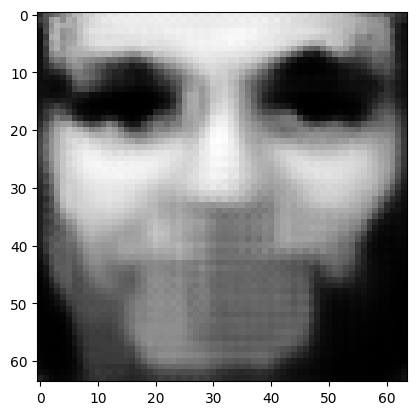

tensor([[1.0183e-05, 8.4268e-07, 1.8618e-03, 2.0412e-05, 5.0241e-05, 4.4335e-07,
         3.7887e-05, 2.0517e-04, 7.9624e-03, 9.6495e-01, 5.4088e-04, 7.7560e-05,
         1.4178e-04, 2.2560e-07, 5.1632e-04, 2.6459e-04, 9.0490e-05, 2.9163e-07,
         2.6545e-04, 3.6129e-04, 2.2400e-04, 1.6518e-03, 2.8781e-03, 5.0010e-04,
         9.4924e-04, 1.0583e-06, 8.6905e-05, 1.3119e-03, 3.5749e-03, 3.9874e-03,
         2.5625e-05, 7.8482e-08, 1.9533e-04, 2.8769e-05, 4.0626e-03, 1.7824e-04,
         1.0754e-04, 6.0624e-05, 3.3881e-04, 2.4772e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03567755967378616
tensor([[1.0181e-05, 8.4233e-07, 1.8613e-03, 2.0404e-05, 5.0226e-05, 4.4322e-07,
         3.7873e-05, 2.0513e-04, 7.9600e-03, 9.6496e-01, 5.4071e-04, 7.7534e-05,
         1.4173e-04, 2.2547e-07, 5.1615e-04, 2.6454e-04, 9.0458e-05, 2.9149e-07,
         2.6538e-04, 3.6120e-04, 2.2390e-04, 1.6514e-03, 2.8773e-03, 4.9997e-04,
         9.4889e-04, 1.0579e-06, 8.6874e-0

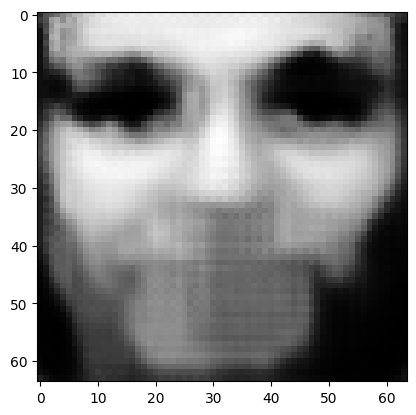

tensor([[1.0171e-05, 8.4095e-07, 1.8593e-03, 2.0374e-05, 5.0167e-05, 4.4271e-07,
         3.7818e-05, 2.0498e-04, 7.9508e-03, 9.6500e-01, 5.4002e-04, 7.7429e-05,
         1.4154e-04, 2.2496e-07, 5.1549e-04, 2.6433e-04, 9.0333e-05, 2.9092e-07,
         2.6510e-04, 3.6085e-04, 2.2353e-04, 1.6496e-03, 2.8744e-03, 4.9945e-04,
         9.4755e-04, 1.0562e-06, 8.6753e-05, 1.3100e-03, 3.5700e-03, 3.9826e-03,
         2.5571e-05, 7.8294e-08, 1.9499e-04, 2.8711e-05, 4.0571e-03, 1.7802e-04,
         1.0733e-04, 6.0476e-05, 3.3815e-04, 2.4737e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035626597702503204
tensor([[1.0168e-05, 8.4062e-07, 1.8588e-03, 2.0367e-05, 5.0153e-05, 4.4259e-07,
         3.7805e-05, 2.0494e-04, 7.9486e-03, 9.6501e-01, 5.3985e-04, 7.7403e-05,
         1.4149e-04, 2.2483e-07, 5.1533e-04, 2.6428e-04, 9.0303e-05, 2.9078e-07,
         2.6503e-04, 3.6076e-04, 2.2345e-04, 1.6491e-03, 2.8737e-03, 4.9933e-04,
         9.4724e-04, 1.0558e-06, 8.6724e-

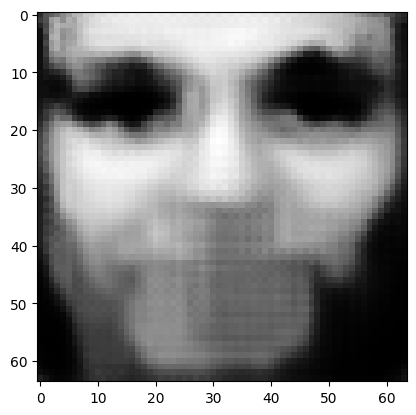

tensor([[1.0159e-05, 8.3932e-07, 1.8568e-03, 2.0338e-05, 5.0096e-05, 4.4211e-07,
         3.7753e-05, 2.0479e-04, 7.9397e-03, 9.6505e-01, 5.3919e-04, 7.7304e-05,
         1.4131e-04, 2.2435e-07, 5.1470e-04, 2.6409e-04, 9.0184e-05, 2.9024e-07,
         2.6476e-04, 3.6043e-04, 2.2310e-04, 1.6474e-03, 2.8709e-03, 4.9884e-04,
         9.4596e-04, 1.0541e-06, 8.6609e-05, 1.3083e-03, 3.5653e-03, 3.9779e-03,
         2.5520e-05, 7.8115e-08, 1.9468e-04, 2.8656e-05, 4.0519e-03, 1.7782e-04,
         1.0714e-04, 6.0335e-05, 3.3753e-04, 2.4704e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035578396171331406
tensor([[1.0157e-05, 8.3900e-07, 1.8564e-03, 2.0331e-05, 5.0083e-05, 4.4199e-07,
         3.7740e-05, 2.0476e-04, 7.9376e-03, 9.6506e-01, 5.3904e-04, 7.7280e-05,
         1.4127e-04, 2.2423e-07, 5.1455e-04, 2.6404e-04, 9.0155e-05, 2.9011e-07,
         2.6470e-04, 3.6035e-04, 2.2301e-04, 1.6470e-03, 2.8702e-03, 4.9872e-04,
         9.4565e-04, 1.0537e-06, 8.6581e-

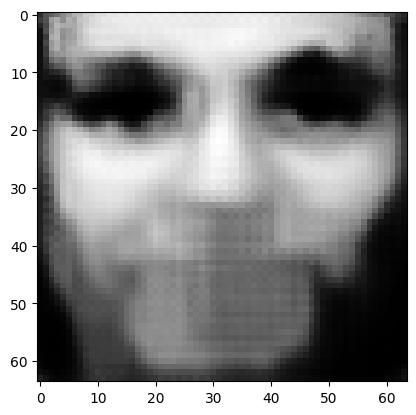

tensor([[1.0148e-05, 8.3776e-07, 1.8545e-03, 2.0304e-05, 5.0030e-05, 4.4153e-07,
         3.7691e-05, 2.0462e-04, 7.9293e-03, 9.6509e-01, 5.3841e-04, 7.7185e-05,
         1.4110e-04, 2.2377e-07, 5.1395e-04, 2.6386e-04, 9.0043e-05, 2.8960e-07,
         2.6445e-04, 3.6003e-04, 2.2268e-04, 1.6454e-03, 2.8676e-03, 4.9825e-04,
         9.4445e-04, 1.0522e-06, 8.6473e-05, 1.3066e-03, 3.5609e-03, 3.9735e-03,
         2.5472e-05, 7.7946e-08, 1.9438e-04, 2.8604e-05, 4.0470e-03, 1.7763e-04,
         1.0695e-04, 6.0201e-05, 3.3694e-04, 2.4673e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03553272411227226
tensor([[1.0146e-05, 8.3747e-07, 1.8541e-03, 2.0297e-05, 5.0017e-05, 4.4142e-07,
         3.7679e-05, 2.0459e-04, 7.9273e-03, 9.6510e-01, 5.3826e-04, 7.7163e-05,
         1.4105e-04, 2.2365e-07, 5.1381e-04, 2.6381e-04, 9.0015e-05, 2.8948e-07,
         2.6439e-04, 3.5995e-04, 2.2260e-04, 1.6450e-03, 2.8669e-03, 4.9814e-04,
         9.4415e-04, 1.0518e-06, 8.6446e-0

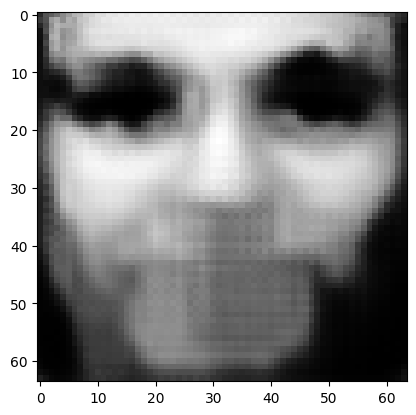

tensor([[1.0137e-05, 8.3630e-07, 1.8523e-03, 2.0272e-05, 4.9966e-05, 4.4099e-07,
         3.7632e-05, 2.0445e-04, 7.9194e-03, 9.6513e-01, 5.3767e-04, 7.7073e-05,
         1.4089e-04, 2.2322e-07, 5.1325e-04, 2.6364e-04, 8.9909e-05, 2.8899e-07,
         2.6415e-04, 3.5965e-04, 2.2229e-04, 1.6435e-03, 2.8644e-03, 4.9770e-04,
         9.4301e-04, 1.0504e-06, 8.6344e-05, 1.3050e-03, 3.5567e-03, 3.9694e-03,
         2.5426e-05, 7.7786e-08, 1.9409e-04, 2.8555e-05, 4.0423e-03, 1.7745e-04,
         1.0677e-04, 6.0075e-05, 3.3639e-04, 2.4643e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03548946604132652
tensor([[1.0135e-05, 8.3601e-07, 1.8519e-03, 2.0266e-05, 4.9954e-05, 4.4088e-07,
         3.7621e-05, 2.0442e-04, 7.9175e-03, 9.6514e-01, 5.3753e-04, 7.7052e-05,
         1.4085e-04, 2.2311e-07, 5.1311e-04, 2.6360e-04, 8.9883e-05, 2.8888e-07,
         2.6409e-04, 3.5958e-04, 2.2221e-04, 1.6432e-03, 2.8638e-03, 4.9760e-04,
         9.4273e-04, 1.0500e-06, 8.6319e-0

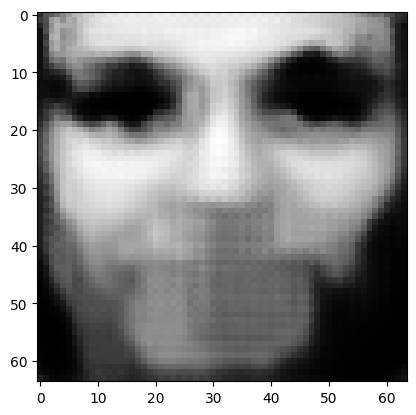

tensor([[1.0128e-05, 8.3490e-07, 1.8503e-03, 2.0241e-05, 4.9906e-05, 4.4047e-07,
         3.7577e-05, 2.0430e-04, 7.9100e-03, 9.6517e-01, 5.3697e-04, 7.6967e-05,
         1.4070e-04, 2.2270e-07, 5.1257e-04, 2.6343e-04, 8.9781e-05, 2.8842e-07,
         2.6387e-04, 3.5929e-04, 2.2192e-04, 1.6417e-03, 2.8614e-03, 4.9718e-04,
         9.4165e-04, 1.0486e-06, 8.6221e-05, 1.3034e-03, 3.5527e-03, 3.9654e-03,
         2.5383e-05, 7.7634e-08, 1.9382e-04, 2.8508e-05, 4.0378e-03, 1.7727e-04,
         1.0660e-04, 5.9955e-05, 3.3586e-04, 2.4615e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03544827550649643
tensor([[1.0126e-05, 8.3464e-07, 1.8499e-03, 2.0236e-05, 4.9895e-05, 4.4037e-07,
         3.7566e-05, 2.0427e-04, 7.9082e-03, 9.6518e-01, 5.3684e-04, 7.6947e-05,
         1.4066e-04, 2.2260e-07, 5.1245e-04, 2.6339e-04, 8.9757e-05, 2.8831e-07,
         2.6381e-04, 3.5922e-04, 2.2184e-04, 1.6414e-03, 2.8609e-03, 4.9708e-04,
         9.4139e-04, 1.0483e-06, 8.6198e-0

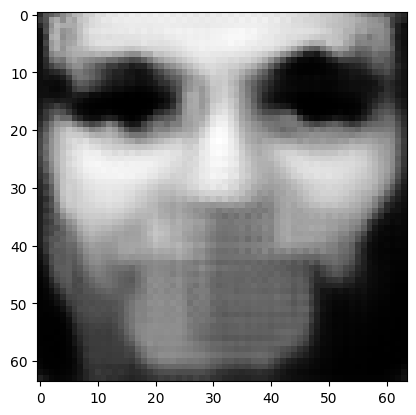

tensor([[1.0118e-05, 8.3359e-07, 1.8483e-03, 2.0212e-05, 4.9850e-05, 4.3998e-07,
         3.7524e-05, 2.0415e-04, 7.9012e-03, 9.6521e-01, 5.3631e-04, 7.6867e-05,
         1.4052e-04, 2.2221e-07, 5.1194e-04, 2.6323e-04, 8.9661e-05, 2.8788e-07,
         2.6360e-04, 3.5895e-04, 2.2156e-04, 1.6400e-03, 2.8586e-03, 4.9668e-04,
         9.4036e-04, 1.0470e-06, 8.6106e-05, 1.3020e-03, 3.5490e-03, 3.9617e-03,
         2.5341e-05, 7.7490e-08, 1.9357e-04, 2.8464e-05, 4.0336e-03, 1.7711e-04,
         1.0644e-04, 5.9842e-05, 3.3536e-04, 2.4588e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035409387201070786
tensor([[1.0116e-05, 8.3333e-07, 1.8479e-03, 2.0207e-05, 4.9839e-05, 4.3988e-07,
         3.7514e-05, 2.0412e-04, 7.8994e-03, 9.6522e-01, 5.3618e-04, 7.6847e-05,
         1.4048e-04, 2.2211e-07, 5.1182e-04, 2.6320e-04, 8.9637e-05, 2.8777e-07,
         2.6355e-04, 3.5889e-04, 2.2150e-04, 1.6397e-03, 2.8580e-03, 4.9659e-04,
         9.4010e-04, 1.0467e-06, 8.6083e-

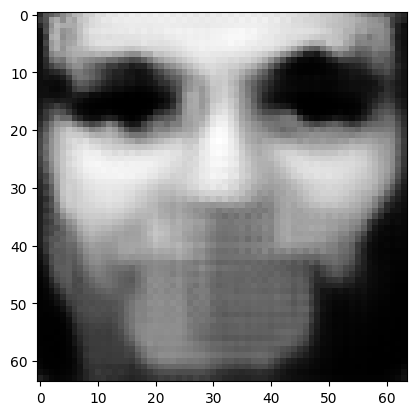

tensor([[1.0109e-05, 8.3233e-07, 1.8464e-03, 2.0185e-05, 4.9796e-05, 4.3951e-07,
         3.7474e-05, 2.0401e-04, 7.8927e-03, 9.6525e-01, 5.3567e-04, 7.6771e-05,
         1.4035e-04, 2.2174e-07, 5.1134e-04, 2.6305e-04, 8.9546e-05, 2.8736e-07,
         2.6334e-04, 3.5863e-04, 2.2123e-04, 1.6384e-03, 2.8559e-03, 4.9621e-04,
         9.3913e-04, 1.0454e-06, 8.5996e-05, 1.3006e-03, 3.5454e-03, 3.9581e-03,
         2.5302e-05, 7.7353e-08, 1.9332e-04, 2.8422e-05, 4.0296e-03, 1.7696e-04,
         1.0629e-04, 5.9734e-05, 3.3488e-04, 2.4563e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035372450947761536
tensor([[1.0107e-05, 8.3209e-07, 1.8461e-03, 2.0180e-05, 4.9785e-05, 4.3942e-07,
         3.7464e-05, 2.0398e-04, 7.8911e-03, 9.6525e-01, 5.3555e-04, 7.6753e-05,
         1.4031e-04, 2.2165e-07, 5.1122e-04, 2.6301e-04, 8.9524e-05, 2.8726e-07,
         2.6329e-04, 3.5857e-04, 2.2116e-04, 1.6380e-03, 2.8554e-03, 4.9612e-04,
         9.3889e-04, 1.0451e-06, 8.5974e-

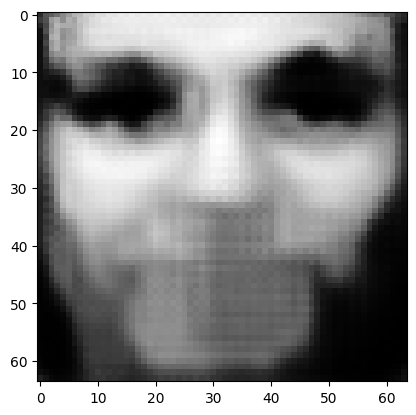

tensor([[1.0101e-05, 8.3115e-07, 1.8447e-03, 2.0159e-05, 4.9744e-05, 4.3907e-07,
         3.7427e-05, 2.0387e-04, 7.8847e-03, 9.6528e-01, 5.3507e-04, 7.6681e-05,
         1.4018e-04, 2.2130e-07, 5.1076e-04, 2.6287e-04, 8.9438e-05, 2.8687e-07,
         2.6310e-04, 3.5832e-04, 2.2091e-04, 1.6368e-03, 2.8533e-03, 4.9577e-04,
         9.3797e-04, 1.0439e-06, 8.5891e-05, 1.2993e-03, 3.5420e-03, 3.9547e-03,
         2.5265e-05, 7.7224e-08, 1.9309e-04, 2.8382e-05, 4.0258e-03, 1.7681e-04,
         1.0615e-04, 5.9632e-05, 3.3443e-04, 2.4539e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035337354987859726
tensor([[1.0099e-05, 8.3092e-07, 1.8443e-03, 2.0154e-05, 4.9735e-05, 4.3899e-07,
         3.7418e-05, 2.0385e-04, 7.8832e-03, 9.6529e-01, 5.3496e-04, 7.6664e-05,
         1.4015e-04, 2.2121e-07, 5.1065e-04, 2.6284e-04, 8.9417e-05, 2.8678e-07,
         2.6305e-04, 3.5827e-04, 2.2085e-04, 1.6365e-03, 2.8529e-03, 4.9568e-04,
         9.3775e-04, 1.0436e-06, 8.5871e-

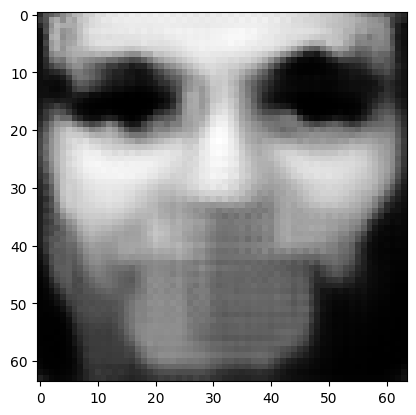

tensor([[1.0093e-05, 8.3004e-07, 1.8430e-03, 2.0135e-05, 4.9697e-05, 4.3867e-07,
         3.7383e-05, 2.0375e-04, 7.8772e-03, 9.6531e-01, 5.3450e-04, 7.6597e-05,
         1.4003e-04, 2.2088e-07, 5.1022e-04, 2.6271e-04, 8.9336e-05, 2.8642e-07,
         2.6287e-04, 3.5803e-04, 2.2061e-04, 1.6354e-03, 2.8510e-03, 4.9535e-04,
         9.3689e-04, 1.0426e-06, 8.5794e-05, 1.2981e-03, 3.5388e-03, 3.9515e-03,
         2.5231e-05, 7.7103e-08, 1.9288e-04, 2.8345e-05, 4.0222e-03, 1.7667e-04,
         1.0602e-04, 5.9537e-05, 3.3401e-04, 2.4516e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03530432656407356
tensor([[1.0091e-05, 8.2983e-07, 1.8427e-03, 2.0131e-05, 4.9688e-05, 4.3859e-07,
         3.7374e-05, 2.0372e-04, 7.8757e-03, 9.6532e-01, 5.3440e-04, 7.6581e-05,
         1.4000e-04, 2.2080e-07, 5.1011e-04, 2.6268e-04, 8.9317e-05, 2.8633e-07,
         2.6283e-04, 3.5798e-04, 2.2056e-04, 1.6351e-03, 2.8505e-03, 4.9527e-04,
         9.3668e-04, 1.0423e-06, 8.5775e-0

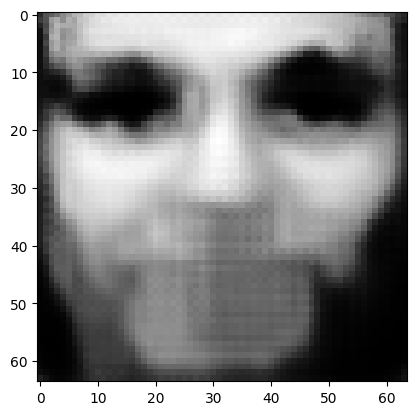

tensor([[1.0086e-05, 8.2900e-07, 1.8415e-03, 2.0113e-05, 4.9652e-05, 4.3829e-07,
         3.7341e-05, 2.0363e-04, 7.8701e-03, 9.6534e-01, 5.3397e-04, 7.6518e-05,
         1.3988e-04, 2.2049e-07, 5.0970e-04, 2.6256e-04, 8.9240e-05, 2.8599e-07,
         2.6266e-04, 3.5776e-04, 2.2033e-04, 1.6340e-03, 2.8487e-03, 4.9495e-04,
         9.3587e-04, 1.0413e-06, 8.5701e-05, 1.2969e-03, 3.5358e-03, 3.9485e-03,
         2.5197e-05, 7.6989e-08, 1.9268e-04, 2.8309e-05, 4.0188e-03, 1.7654e-04,
         1.0589e-04, 5.9448e-05, 3.3360e-04, 2.4495e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03527314215898514
tensor([[1.0084e-05, 8.2879e-07, 1.8412e-03, 2.0108e-05, 4.9643e-05, 4.3822e-07,
         3.7334e-05, 2.0361e-04, 7.8687e-03, 9.6535e-01, 5.3386e-04, 7.6502e-05,
         1.3986e-04, 2.2041e-07, 5.0960e-04, 2.6253e-04, 8.9222e-05, 2.8590e-07,
         2.6262e-04, 3.5771e-04, 2.2028e-04, 1.6337e-03, 2.8482e-03, 4.9487e-04,
         9.3567e-04, 1.0410e-06, 8.5683e-0

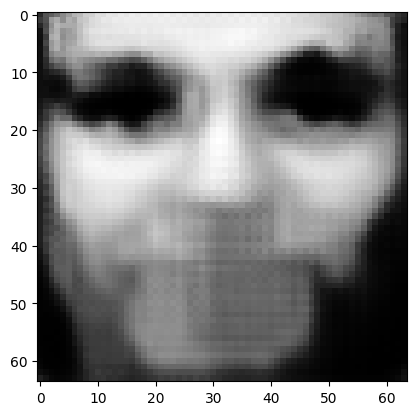

tensor([[1.0079e-05, 8.2800e-07, 1.8400e-03, 2.0091e-05, 4.9609e-05, 4.3793e-07,
         3.7302e-05, 2.0352e-04, 7.8633e-03, 9.6537e-01, 5.3345e-04, 7.6443e-05,
         1.3975e-04, 2.2012e-07, 5.0921e-04, 2.6241e-04, 8.9149e-05, 2.8558e-07,
         2.6246e-04, 3.5750e-04, 2.2007e-04, 1.6327e-03, 2.8465e-03, 4.9457e-04,
         9.3490e-04, 1.0400e-06, 8.5614e-05, 1.2959e-03, 3.5330e-03, 3.9456e-03,
         2.5166e-05, 7.6881e-08, 1.9249e-04, 2.8276e-05, 4.0155e-03, 1.7642e-04,
         1.0577e-04, 5.9362e-05, 3.3322e-04, 2.4475e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035243451595306396
tensor([[1.0077e-05, 8.2781e-07, 1.8397e-03, 2.0087e-05, 4.9601e-05, 4.3786e-07,
         3.7295e-05, 2.0350e-04, 7.8620e-03, 9.6538e-01, 5.3335e-04, 7.6428e-05,
         1.3972e-04, 2.2004e-07, 5.0912e-04, 2.6238e-04, 8.9132e-05, 2.8550e-07,
         2.6242e-04, 3.5745e-04, 2.2002e-04, 1.6325e-03, 2.8461e-03, 4.9450e-04,
         9.3471e-04, 1.0398e-06, 8.5597e-

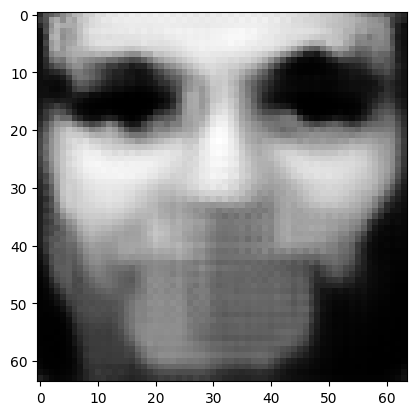

tensor([[1.0072e-05, 8.2706e-07, 1.8386e-03, 2.0071e-05, 4.9569e-05, 4.3759e-07,
         3.7265e-05, 2.0341e-04, 7.8569e-03, 9.6540e-01, 5.3297e-04, 7.6371e-05,
         1.3962e-04, 2.1976e-07, 5.0875e-04, 2.6227e-04, 8.9063e-05, 2.8519e-07,
         2.6227e-04, 3.5725e-04, 2.1981e-04, 1.6315e-03, 2.8445e-03, 4.9421e-04,
         9.3398e-04, 1.0388e-06, 8.5531e-05, 1.2948e-03, 3.5303e-03, 3.9428e-03,
         2.5136e-05, 7.6779e-08, 1.9230e-04, 2.8244e-05, 4.0125e-03, 1.7630e-04,
         1.0566e-04, 5.9281e-05, 3.3286e-04, 2.4456e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03521537035703659
tensor([[1.0071e-05, 8.2688e-07, 1.8383e-03, 2.0067e-05, 4.9561e-05, 4.3753e-07,
         3.7258e-05, 2.0339e-04, 7.8557e-03, 9.6540e-01, 5.3287e-04, 7.6358e-05,
         1.3959e-04, 2.1970e-07, 5.0865e-04, 2.6225e-04, 8.9046e-05, 2.8511e-07,
         2.6223e-04, 3.5721e-04, 2.1977e-04, 1.6312e-03, 2.8441e-03, 4.9414e-04,
         9.3380e-04, 1.0386e-06, 8.5515e-0

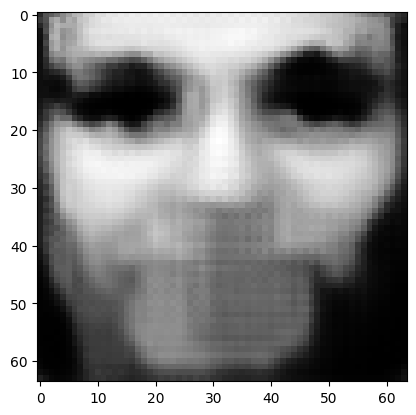

tensor([[1.0066e-05, 8.2616e-07, 1.8372e-03, 2.0052e-05, 4.9531e-05, 4.3727e-07,
         3.7230e-05, 2.0331e-04, 7.8508e-03, 9.6542e-01, 5.3251e-04, 7.6303e-05,
         1.3949e-04, 2.1943e-07, 5.0830e-04, 2.6214e-04, 8.8981e-05, 2.8482e-07,
         2.6208e-04, 3.5702e-04, 2.1957e-04, 1.6303e-03, 2.8425e-03, 4.9387e-04,
         9.3311e-04, 1.0377e-06, 8.5452e-05, 1.2938e-03, 3.5277e-03, 3.9402e-03,
         2.5108e-05, 7.6682e-08, 1.9213e-04, 2.8214e-05, 4.0096e-03, 1.7618e-04,
         1.0555e-04, 5.9205e-05, 3.3251e-04, 2.4437e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035188671201467514
tensor([[1.0065e-05, 8.2599e-07, 1.8370e-03, 2.0048e-05, 4.9523e-05, 4.3721e-07,
         3.7223e-05, 2.0329e-04, 7.8496e-03, 9.6543e-01, 5.3242e-04, 7.6291e-05,
         1.3947e-04, 2.1937e-07, 5.0822e-04, 2.6212e-04, 8.8965e-05, 2.8475e-07,
         2.6205e-04, 3.5697e-04, 2.1953e-04, 1.6301e-03, 2.8422e-03, 4.9381e-04,
         9.3294e-04, 1.0375e-06, 8.5436e-

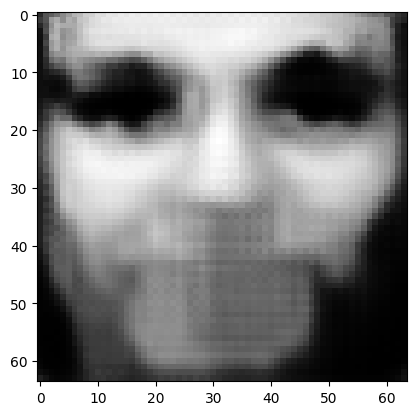

tensor([[1.0060e-05, 8.2531e-07, 1.8360e-03, 2.0033e-05, 4.9494e-05, 4.3696e-07,
         3.7196e-05, 2.0322e-04, 7.8450e-03, 9.6545e-01, 5.3207e-04, 7.6239e-05,
         1.3938e-04, 2.1911e-07, 5.0788e-04, 2.6202e-04, 8.8903e-05, 2.8447e-07,
         2.6191e-04, 3.5680e-04, 2.1935e-04, 1.6292e-03, 2.8407e-03, 4.9355e-04,
         9.3228e-04, 1.0367e-06, 8.5377e-05, 1.2929e-03, 3.5252e-03, 3.9377e-03,
         2.5081e-05, 7.6590e-08, 1.9197e-04, 2.8185e-05, 4.0068e-03, 1.7608e-04,
         1.0544e-04, 5.9132e-05, 3.3219e-04, 2.4420e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03516335412859917
tensor([[1.0059e-05, 8.2515e-07, 1.8357e-03, 2.0030e-05, 4.9487e-05, 4.3690e-07,
         3.7189e-05, 2.0320e-04, 7.8439e-03, 9.6545e-01, 5.3198e-04, 7.6227e-05,
         1.3935e-04, 2.1905e-07, 5.0780e-04, 2.6199e-04, 8.8888e-05, 2.8440e-07,
         2.6188e-04, 3.5675e-04, 2.1930e-04, 1.6290e-03, 2.8403e-03, 4.9349e-04,
         9.3212e-04, 1.0365e-06, 8.5362e-0

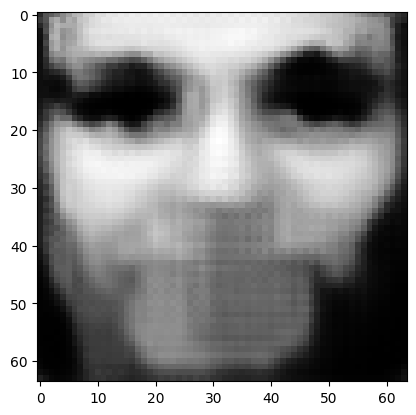

tensor([[1.0054e-05, 8.2450e-07, 1.8348e-03, 2.0016e-05, 4.9459e-05, 4.3667e-07,
         3.7164e-05, 2.0312e-04, 7.8395e-03, 9.6547e-01, 5.3165e-04, 7.6178e-05,
         1.3927e-04, 2.1881e-07, 5.0748e-04, 2.6190e-04, 8.8829e-05, 2.8414e-07,
         2.6174e-04, 3.5658e-04, 2.1913e-04, 1.6281e-03, 2.8389e-03, 4.9324e-04,
         9.3149e-04, 1.0357e-06, 8.5305e-05, 1.2920e-03, 3.5229e-03, 3.9353e-03,
         2.5056e-05, 7.6502e-08, 1.9181e-04, 2.8157e-05, 4.0042e-03, 1.7598e-04,
         1.0535e-04, 5.9063e-05, 3.3188e-04, 2.4404e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035139184445142746
tensor([[1.0053e-05, 8.2435e-07, 1.8345e-03, 2.0012e-05, 4.9453e-05, 4.3661e-07,
         3.7158e-05, 2.0311e-04, 7.8385e-03, 9.6548e-01, 5.3157e-04, 7.6166e-05,
         1.3924e-04, 2.1875e-07, 5.0741e-04, 2.6188e-04, 8.8815e-05, 2.8408e-07,
         2.6171e-04, 3.5654e-04, 2.1909e-04, 1.6279e-03, 2.8386e-03, 4.9318e-04,
         9.3134e-04, 1.0355e-06, 8.5292e-

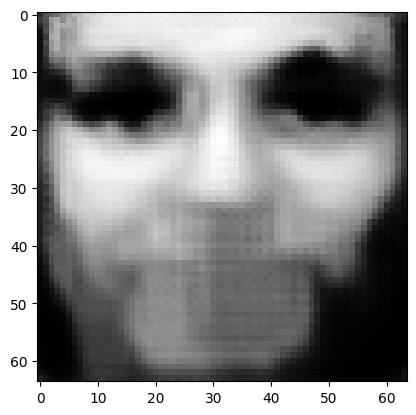

tensor([[1.0049e-05, 8.2374e-07, 1.8336e-03, 1.9999e-05, 4.9427e-05, 4.3639e-07,
         3.7134e-05, 2.0304e-04, 7.8343e-03, 9.6549e-01, 5.3126e-04, 7.6120e-05,
         1.3916e-04, 2.1853e-07, 5.0710e-04, 2.6179e-04, 8.8760e-05, 2.8383e-07,
         2.6159e-04, 3.5638e-04, 2.1893e-04, 1.6271e-03, 2.8373e-03, 4.9295e-04,
         9.3075e-04, 1.0347e-06, 8.5238e-05, 1.2912e-03, 3.5207e-03, 3.9331e-03,
         2.5032e-05, 7.6419e-08, 1.9166e-04, 2.8132e-05, 4.0017e-03, 1.7588e-04,
         1.0525e-04, 5.8997e-05, 3.3158e-04, 2.4388e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035116277635097504
tensor([[1.0048e-05, 8.2359e-07, 1.8334e-03, 1.9996e-05, 4.9420e-05, 4.3634e-07,
         3.7128e-05, 2.0302e-04, 7.8333e-03, 9.6550e-01, 5.3118e-04, 7.6109e-05,
         1.3914e-04, 2.1847e-07, 5.0703e-04, 2.6177e-04, 8.8746e-05, 2.8376e-07,
         2.6156e-04, 3.5634e-04, 2.1889e-04, 1.6269e-03, 2.8369e-03, 4.9290e-04,
         9.3060e-04, 1.0345e-06, 8.5225e-

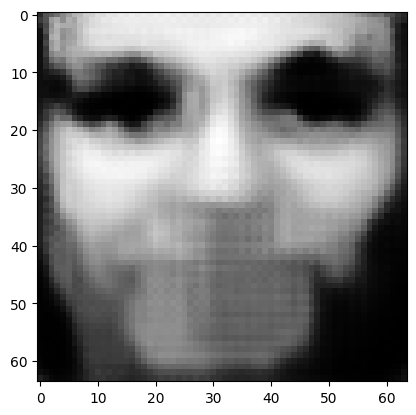

tensor([[1.0044e-05, 8.2301e-07, 1.8326e-03, 1.9984e-05, 4.9395e-05, 4.3613e-07,
         3.7105e-05, 2.0296e-04, 7.8294e-03, 9.6551e-01, 5.3088e-04, 7.6065e-05,
         1.3906e-04, 2.1826e-07, 5.0674e-04, 2.6168e-04, 8.8693e-05, 2.8353e-07,
         2.6144e-04, 3.5619e-04, 2.1873e-04, 1.6262e-03, 2.8357e-03, 4.9268e-04,
         9.3004e-04, 1.0338e-06, 8.5174e-05, 1.2903e-03, 3.5186e-03, 3.9310e-03,
         2.5009e-05, 7.6340e-08, 1.9152e-04, 2.8107e-05, 3.9993e-03, 1.7579e-04,
         1.0517e-04, 5.8935e-05, 3.3130e-04, 2.4373e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035094525665044785
tensor([[1.0043e-05, 8.2287e-07, 1.8323e-03, 1.9980e-05, 4.9389e-05, 4.3608e-07,
         3.7100e-05, 2.0294e-04, 7.8284e-03, 9.6552e-01, 5.3081e-04, 7.6055e-05,
         1.3904e-04, 2.1820e-07, 5.0667e-04, 2.6166e-04, 8.8680e-05, 2.8347e-07,
         2.6141e-04, 3.5615e-04, 2.1869e-04, 1.6260e-03, 2.8354e-03, 4.9262e-04,
         9.2990e-04, 1.0337e-06, 8.5161e-

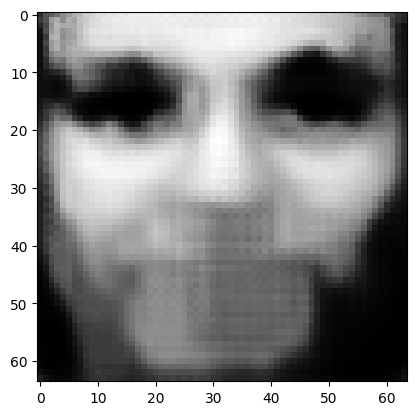

tensor([[1.0039e-05, 8.2232e-07, 1.8315e-03, 1.9969e-05, 4.9366e-05, 4.3588e-07,
         3.7078e-05, 2.0288e-04, 7.8246e-03, 9.6553e-01, 5.3052e-04, 7.6013e-05,
         1.3897e-04, 2.1800e-07, 5.0640e-04, 2.6158e-04, 8.8630e-05, 2.8324e-07,
         2.6130e-04, 3.5601e-04, 2.1854e-04, 1.6253e-03, 2.8342e-03, 4.9241e-04,
         9.2937e-04, 1.0330e-06, 8.5113e-05, 1.2896e-03, 3.5166e-03, 3.9289e-03,
         2.4987e-05, 7.6265e-08, 1.9139e-04, 2.8084e-05, 3.9971e-03, 1.7570e-04,
         1.0508e-04, 5.8876e-05, 3.3104e-04, 2.4359e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03507392480969429
tensor([[1.0038e-05, 8.2218e-07, 1.8313e-03, 1.9966e-05, 4.9360e-05, 4.3583e-07,
         3.7072e-05, 2.0286e-04, 7.8237e-03, 9.6554e-01, 5.3045e-04, 7.6003e-05,
         1.3895e-04, 2.1795e-07, 5.0633e-04, 2.6156e-04, 8.8617e-05, 2.8319e-07,
         2.6127e-04, 3.5597e-04, 2.1851e-04, 1.6251e-03, 2.8339e-03, 4.9236e-04,
         9.2924e-04, 1.0328e-06, 8.5101e-0

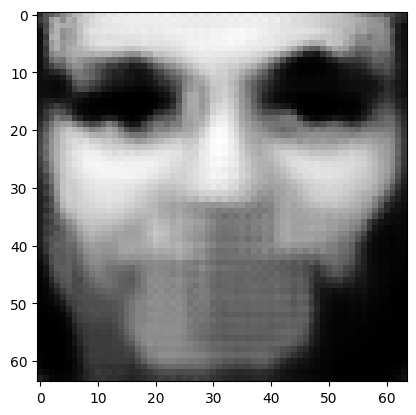

tensor([[1.0035e-05, 8.2166e-07, 1.8306e-03, 1.9954e-05, 4.9338e-05, 4.3564e-07,
         3.7052e-05, 2.0281e-04, 7.8202e-03, 9.6555e-01, 5.3019e-04, 7.5963e-05,
         1.3887e-04, 2.1775e-07, 5.0608e-04, 2.6148e-04, 8.8570e-05, 2.8297e-07,
         2.6116e-04, 3.5584e-04, 2.1837e-04, 1.6244e-03, 2.8328e-03, 4.9216e-04,
         9.2873e-04, 1.0322e-06, 8.5055e-05, 1.2889e-03, 3.5147e-03, 3.9270e-03,
         2.4966e-05, 7.6194e-08, 1.9126e-04, 2.8061e-05, 3.9949e-03, 1.7562e-04,
         1.0500e-04, 5.8820e-05, 3.3078e-04, 2.4346e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03505424037575722
tensor([[1.0034e-05, 8.2154e-07, 1.8304e-03, 1.9952e-05, 4.9332e-05, 4.3560e-07,
         3.7047e-05, 2.0279e-04, 7.8193e-03, 9.6556e-01, 5.3012e-04, 7.5954e-05,
         1.3886e-04, 2.1771e-07, 5.0601e-04, 2.6147e-04, 8.8558e-05, 2.8292e-07,
         2.6114e-04, 3.5580e-04, 2.1834e-04, 1.6242e-03, 2.8325e-03, 4.9211e-04,
         9.2861e-04, 1.0320e-06, 8.5044e-0

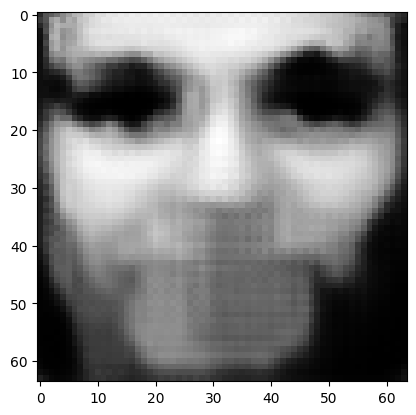

tensor([[1.0030e-05, 8.2104e-07, 1.8296e-03, 1.9941e-05, 4.9311e-05, 4.3542e-07,
         3.7027e-05, 2.0273e-04, 7.8159e-03, 9.6557e-01, 5.2986e-04, 7.5916e-05,
         1.3879e-04, 2.1752e-07, 5.0577e-04, 2.6139e-04, 8.8513e-05, 2.8272e-07,
         2.6103e-04, 3.5567e-04, 2.1820e-04, 1.6236e-03, 2.8314e-03, 4.9192e-04,
         9.2812e-04, 1.0314e-06, 8.5000e-05, 1.2882e-03, 3.5129e-03, 3.9252e-03,
         2.4947e-05, 7.6127e-08, 1.9114e-04, 2.8040e-05, 3.9929e-03, 1.7554e-04,
         1.0493e-04, 5.8766e-05, 3.3055e-04, 2.4333e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035035595297813416
tensor([[1.0029e-05, 8.2092e-07, 1.8294e-03, 1.9938e-05, 4.9306e-05, 4.3538e-07,
         3.7023e-05, 2.0272e-04, 7.8151e-03, 9.6557e-01, 5.2980e-04, 7.5907e-05,
         1.3877e-04, 2.1748e-07, 5.0571e-04, 2.6138e-04, 8.8502e-05, 2.8267e-07,
         2.6101e-04, 3.5564e-04, 2.1817e-04, 1.6234e-03, 2.8312e-03, 4.9188e-04,
         9.2801e-04, 1.0312e-06, 8.4989e-

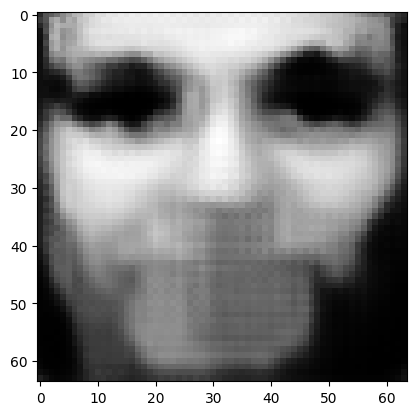

tensor([[1.0026e-05, 8.2045e-07, 1.8287e-03, 1.9928e-05, 4.9285e-05, 4.3521e-07,
         3.7004e-05, 2.0267e-04, 7.8119e-03, 9.6559e-01, 5.2956e-04, 7.5871e-05,
         1.3871e-04, 2.1730e-07, 5.0547e-04, 2.6131e-04, 8.8459e-05, 2.8248e-07,
         2.6091e-04, 3.5552e-04, 2.1804e-04, 1.6228e-03, 2.8301e-03, 4.9170e-04,
         9.2754e-04, 1.0306e-06, 8.4948e-05, 1.2875e-03, 3.5112e-03, 3.9235e-03,
         2.4928e-05, 7.6062e-08, 1.9103e-04, 2.8020e-05, 3.9910e-03, 1.7547e-04,
         1.0486e-04, 5.8716e-05, 3.3032e-04, 2.4321e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03501798212528229
tensor([[1.0025e-05, 8.2033e-07, 1.8286e-03, 1.9926e-05, 4.9280e-05, 4.3516e-07,
         3.6999e-05, 2.0266e-04, 7.8111e-03, 9.6559e-01, 5.2950e-04, 7.5863e-05,
         1.3869e-04, 2.1726e-07, 5.0542e-04, 2.6129e-04, 8.8448e-05, 2.8243e-07,
         2.6089e-04, 3.5549e-04, 2.1801e-04, 1.6227e-03, 2.8299e-03, 4.9165e-04,
         9.2743e-04, 1.0305e-06, 8.4937e-0

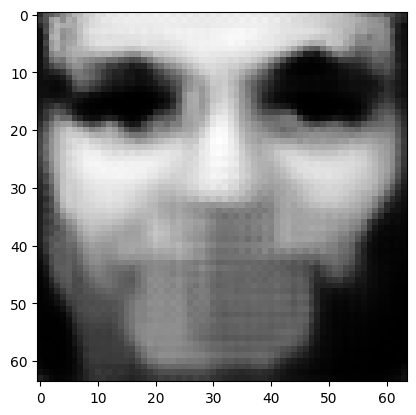

tensor([[1.0022e-05, 8.1989e-07, 1.8279e-03, 1.9916e-05, 4.9261e-05, 4.3500e-07,
         3.6982e-05, 2.0260e-04, 7.8081e-03, 9.6560e-01, 5.2927e-04, 7.5829e-05,
         1.3863e-04, 2.1709e-07, 5.0520e-04, 2.6122e-04, 8.8407e-05, 2.8224e-07,
         2.6080e-04, 3.5537e-04, 2.1789e-04, 1.6221e-03, 2.8289e-03, 4.9148e-04,
         9.2700e-04, 1.0300e-06, 8.4898e-05, 1.2869e-03, 3.5096e-03, 3.9218e-03,
         2.4911e-05, 7.6002e-08, 1.9092e-04, 2.8001e-05, 3.9892e-03, 1.7539e-04,
         1.0479e-04, 5.8668e-05, 3.3010e-04, 2.4310e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035001177340745926
tensor([[1.0022e-05, 8.1978e-07, 1.8277e-03, 1.9914e-05, 4.9257e-05, 4.3496e-07,
         3.6977e-05, 2.0259e-04, 7.8074e-03, 9.6561e-01, 5.2921e-04, 7.5821e-05,
         1.3861e-04, 2.1705e-07, 5.0514e-04, 2.6121e-04, 8.8398e-05, 2.8220e-07,
         2.6078e-04, 3.5534e-04, 2.1786e-04, 1.6219e-03, 2.8287e-03, 4.9144e-04,
         9.2689e-04, 1.0298e-06, 8.4888e-

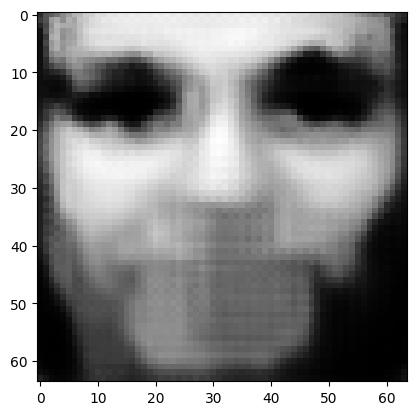

tensor([[1.0019e-05, 8.1935e-07, 1.8271e-03, 1.9905e-05, 4.9238e-05, 4.3481e-07,
         3.6961e-05, 2.0254e-04, 7.8044e-03, 9.6562e-01, 5.2899e-04, 7.5788e-05,
         1.3856e-04, 2.1689e-07, 5.0493e-04, 2.6115e-04, 8.8359e-05, 2.8202e-07,
         2.6069e-04, 3.5523e-04, 2.1775e-04, 1.6214e-03, 2.8277e-03, 4.9128e-04,
         9.2648e-04, 1.0293e-06, 8.4851e-05, 1.2863e-03, 3.5080e-03, 3.9202e-03,
         2.4894e-05, 7.5944e-08, 1.9082e-04, 2.7983e-05, 3.9874e-03, 1.7533e-04,
         1.0472e-04, 5.8622e-05, 3.2990e-04, 2.4299e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03498517721891403
tensor([[1.0018e-05, 8.1925e-07, 1.8270e-03, 1.9902e-05, 4.9234e-05, 4.3477e-07,
         3.6957e-05, 2.0253e-04, 7.8037e-03, 9.6562e-01, 5.2894e-04, 7.5781e-05,
         1.3854e-04, 2.1686e-07, 5.0488e-04, 2.6113e-04, 8.8349e-05, 2.8198e-07,
         2.6067e-04, 3.5520e-04, 2.1772e-04, 1.6212e-03, 2.8275e-03, 4.9124e-04,
         9.2638e-04, 1.0292e-06, 8.4842e-0

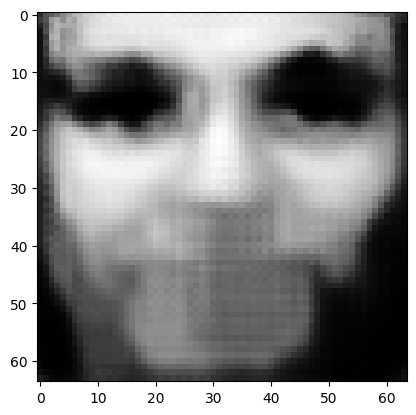

tensor([[1.0015e-05, 8.1884e-07, 1.8264e-03, 1.9894e-05, 4.9217e-05, 4.3463e-07,
         3.6941e-05, 2.0249e-04, 7.8010e-03, 9.6563e-01, 5.2873e-04, 7.5750e-05,
         1.3849e-04, 2.1670e-07, 5.0468e-04, 2.6107e-04, 8.8312e-05, 2.8182e-07,
         2.6058e-04, 3.5509e-04, 2.1761e-04, 1.6207e-03, 2.8266e-03, 4.9109e-04,
         9.2598e-04, 1.0287e-06, 8.4806e-05, 1.2857e-03, 3.5065e-03, 3.9187e-03,
         2.4878e-05, 7.5889e-08, 1.9072e-04, 2.7966e-05, 3.9858e-03, 1.7526e-04,
         1.0466e-04, 5.8579e-05, 3.2970e-04, 2.4288e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03497009724378586
tensor([[1.0014e-05, 8.1875e-07, 1.8262e-03, 1.9891e-05, 4.9213e-05, 4.3459e-07,
         3.6937e-05, 2.0248e-04, 7.8003e-03, 9.6564e-01, 5.2868e-04, 7.5743e-05,
         1.3847e-04, 2.1667e-07, 5.0463e-04, 2.6106e-04, 8.8303e-05, 2.8178e-07,
         2.6057e-04, 3.5507e-04, 2.1759e-04, 1.6206e-03, 2.8264e-03, 4.9105e-04,
         9.2589e-04, 1.0285e-06, 8.4797e-0

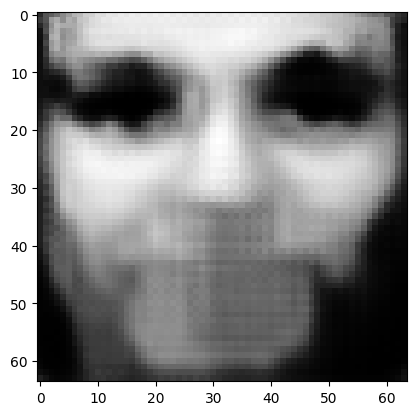

tensor([[1.0012e-05, 8.1836e-07, 1.8256e-03, 1.9883e-05, 4.9196e-05, 4.3445e-07,
         3.6922e-05, 2.0243e-04, 7.7977e-03, 9.6565e-01, 5.2848e-04, 7.5714e-05,
         1.3842e-04, 2.1653e-07, 5.0444e-04, 2.6100e-04, 8.8268e-05, 2.8162e-07,
         2.6049e-04, 3.5497e-04, 2.1748e-04, 1.6201e-03, 2.8256e-03, 4.9090e-04,
         9.2552e-04, 1.0281e-06, 8.4764e-05, 1.2852e-03, 3.5052e-03, 3.9173e-03,
         2.4863e-05, 7.5837e-08, 1.9063e-04, 2.7950e-05, 3.9842e-03, 1.7520e-04,
         1.0461e-04, 5.8538e-05, 3.2952e-04, 2.4278e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03495559096336365
tensor([[1.0011e-05, 8.1827e-07, 1.8255e-03, 1.9881e-05, 4.9192e-05, 4.3442e-07,
         3.6918e-05, 2.0242e-04, 7.7971e-03, 9.6565e-01, 5.2843e-04, 7.5706e-05,
         1.3841e-04, 2.1649e-07, 5.0440e-04, 2.6099e-04, 8.8259e-05, 2.8158e-07,
         2.6047e-04, 3.5494e-04, 2.1746e-04, 1.6200e-03, 2.8254e-03, 4.9087e-04,
         9.2542e-04, 1.0279e-06, 8.4755e-0

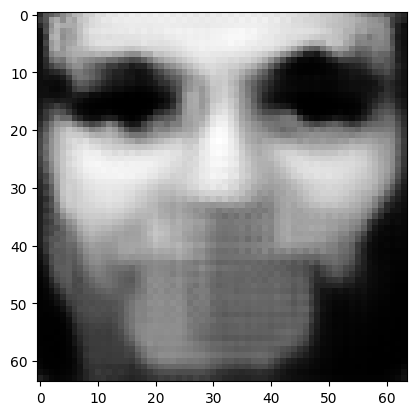

tensor([[1.0009e-05, 8.1791e-07, 1.8250e-03, 1.9873e-05, 4.9176e-05, 4.3429e-07,
         3.6903e-05, 2.0238e-04, 7.7946e-03, 9.6566e-01, 5.2825e-04, 7.5679e-05,
         1.3836e-04, 2.1636e-07, 5.0421e-04, 2.6093e-04, 8.8226e-05, 2.8143e-07,
         2.6039e-04, 3.5485e-04, 2.1736e-04, 1.6195e-03, 2.8246e-03, 4.9073e-04,
         9.2507e-04, 1.0275e-06, 8.4723e-05, 1.2847e-03, 3.5038e-03, 3.9160e-03,
         2.4848e-05, 7.5788e-08, 1.9054e-04, 2.7934e-05, 3.9827e-03, 1.7514e-04,
         1.0455e-04, 5.8498e-05, 3.2934e-04, 2.4269e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034942008554935455
tensor([[1.0008e-05, 8.1782e-07, 1.8248e-03, 1.9871e-05, 4.9172e-05, 4.3425e-07,
         3.6900e-05, 2.0237e-04, 7.7940e-03, 9.6566e-01, 5.2820e-04, 7.5672e-05,
         1.3834e-04, 2.1632e-07, 5.0417e-04, 2.6092e-04, 8.8218e-05, 2.8139e-07,
         2.6037e-04, 3.5482e-04, 2.1734e-04, 1.6194e-03, 2.8244e-03, 4.9070e-04,
         9.2498e-04, 1.0274e-06, 8.4715e-

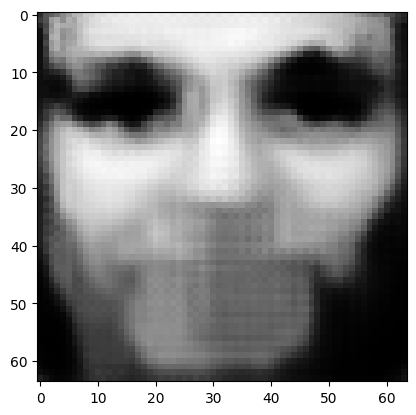

tensor([[1.0005e-05, 8.1747e-07, 1.8243e-03, 1.9864e-05, 4.9158e-05, 4.3413e-07,
         3.6886e-05, 2.0233e-04, 7.7916e-03, 9.6567e-01, 5.2802e-04, 7.5646e-05,
         1.3830e-04, 2.1619e-07, 5.0400e-04, 2.6087e-04, 8.8186e-05, 2.8125e-07,
         2.6030e-04, 3.5473e-04, 2.1724e-04, 1.6189e-03, 2.8236e-03, 4.9056e-04,
         9.2465e-04, 1.0270e-06, 8.4684e-05, 1.2842e-03, 3.5026e-03, 3.9147e-03,
         2.4835e-05, 7.5740e-08, 1.9045e-04, 2.7919e-05, 3.9813e-03, 1.7509e-04,
         1.0450e-04, 5.8461e-05, 3.2917e-04, 2.4260e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034928999841213226
tensor([[1.0005e-05, 8.1739e-07, 1.8242e-03, 1.9862e-05, 4.9154e-05, 4.3410e-07,
         3.6883e-05, 2.0232e-04, 7.7910e-03, 9.6568e-01, 5.2798e-04, 7.5640e-05,
         1.3828e-04, 2.1616e-07, 5.0396e-04, 2.6086e-04, 8.8179e-05, 2.8122e-07,
         2.6029e-04, 3.5471e-04, 2.1722e-04, 1.6188e-03, 2.8235e-03, 4.9053e-04,
         9.2457e-04, 1.0269e-06, 8.4677e-

In [146]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=9)

tensor([[2.2327e-03, 7.0929e-04, 5.1814e-04, 1.5254e-03, 2.6051e-03, 9.6716e-01,
         2.0159e-03, 1.7361e-03, 6.1246e-04, 6.0098e-04, 5.8059e-04, 3.5174e-04,
         1.0860e-03, 3.1469e-04, 3.1694e-04, 3.0247e-03, 9.9352e-04, 1.6269e-03,
         2.5475e-04, 3.9890e-04, 6.6221e-05, 2.2501e-04, 1.2870e-03, 1.3556e-04,
         1.1345e-03, 1.1432e-03, 3.1432e-04, 3.1176e-04, 1.4194e-04, 1.7292e-04,
         3.4288e-04, 1.5516e-03, 4.4490e-04, 2.7654e-04, 3.5433e-04, 1.1046e-03,
         2.5361e-04, 8.3939e-04, 1.6483e-04, 1.0671e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.416952133178711


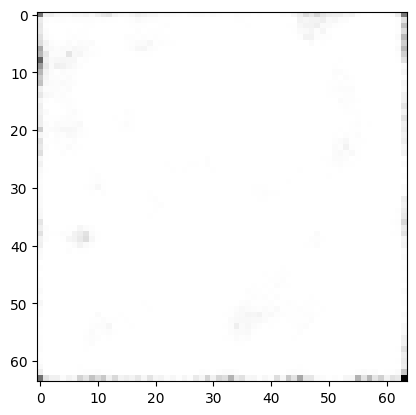

tensor([[2.2332e-03, 7.0947e-04, 5.1828e-04, 1.5257e-03, 2.6057e-03, 9.6716e-01,
         2.0163e-03, 1.7365e-03, 6.1262e-04, 6.0113e-04, 5.8073e-04, 3.5184e-04,
         1.0863e-03, 3.1477e-04, 3.1703e-04, 3.0253e-03, 9.9375e-04, 1.6272e-03,
         2.5482e-04, 3.9901e-04, 6.6243e-05, 2.2507e-04, 1.2873e-03, 1.3560e-04,
         1.1348e-03, 1.1434e-03, 3.1440e-04, 3.1185e-04, 1.4198e-04, 1.7297e-04,
         3.4298e-04, 1.5519e-03, 4.4501e-04, 2.7662e-04, 3.5443e-04, 1.1049e-03,
         2.5368e-04, 8.3960e-04, 1.6488e-04, 1.0673e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.4167046546936035
tensor([[2.2339e-03, 7.0969e-04, 5.1844e-04, 1.5261e-03, 2.6063e-03, 9.6715e-01,
         2.0169e-03, 1.7370e-03, 6.1282e-04, 6.0132e-04, 5.8092e-04, 3.5196e-04,
         1.0866e-03, 3.1489e-04, 3.1714e-04, 3.0261e-03, 9.9405e-04, 1.6277e-03,
         2.5491e-04, 3.9914e-04, 6.6271e-05, 2.2515e-04, 1.2876e-03, 1.3565e-04,
         1.1351e-03, 1.1437e-03, 3.1451e-04

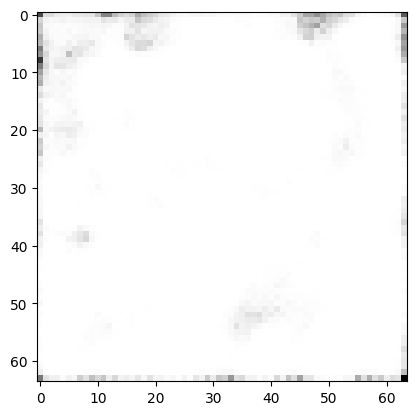

tensor([[2.2421e-03, 7.1259e-04, 5.2055e-04, 1.5311e-03, 2.6147e-03, 9.6702e-01,
         2.0237e-03, 1.7432e-03, 6.1539e-04, 6.0383e-04, 5.8331e-04, 3.5355e-04,
         1.0905e-03, 3.1632e-04, 3.1852e-04, 3.0364e-03, 9.9788e-04, 1.6337e-03,
         2.5602e-04, 4.0084e-04, 6.6626e-05, 2.2617e-04, 1.2921e-03, 1.3634e-04,
         1.1393e-03, 1.1477e-03, 3.1590e-04, 3.1333e-04, 1.4275e-04, 1.7389e-04,
         3.4461e-04, 1.5579e-03, 4.4710e-04, 2.7798e-04, 3.5617e-04, 1.1093e-03,
         2.5492e-04, 8.4320e-04, 1.6574e-04, 1.0717e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.41222620010376
tensor([[2.2493e-03, 7.1507e-04, 5.2234e-04, 1.5354e-03, 2.6219e-03, 9.6692e-01,
         2.0294e-03, 1.7486e-03, 6.1758e-04, 6.0598e-04, 5.8536e-04, 3.5491e-04,
         1.0939e-03, 3.1753e-04, 3.1970e-04, 3.0454e-03, 1.0012e-03, 1.6388e-03,
         2.5696e-04, 4.0231e-04, 6.6929e-05, 2.2705e-04, 1.2958e-03, 1.3693e-04,
         1.1428e-03, 1.1510e-03, 3.1710e-04, 

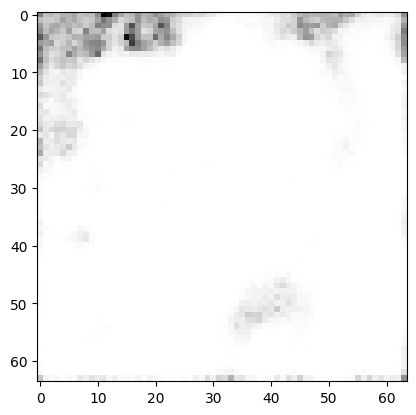

tensor([[2.3522e-03, 7.5091e-04, 5.4792e-04, 1.5955e-03, 2.7244e-03, 9.6541e-01,
         2.1113e-03, 1.8250e-03, 6.4915e-04, 6.3662e-04, 6.1455e-04, 3.7437e-04,
         1.1435e-03, 3.3513e-04, 3.3642e-04, 3.1777e-03, 1.0488e-03, 1.7140e-03,
         2.7014e-04, 4.2345e-04, 7.1366e-05, 2.3968e-04, 1.3472e-03, 1.4550e-04,
         1.1922e-03, 1.1967e-03, 3.3400e-04, 3.3129e-04, 1.5225e-04, 1.8527e-04,
         3.6450e-04, 1.6296e-03, 4.7309e-04, 2.9469e-04, 3.7751e-04, 1.1630e-03,
         2.6984e-04, 8.8685e-04, 1.7635e-04, 1.1255e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.35933256149292
tensor([[2.4093e-03, 7.7105e-04, 5.6251e-04, 1.6296e-03, 2.7816e-03, 9.6457e-01,
         2.1567e-03, 1.8689e-03, 6.6648e-04, 6.5401e-04, 6.3112e-04, 3.8544e-04,
         1.1711e-03, 3.4507e-04, 3.4590e-04, 3.2499e-03, 1.0754e-03, 1.7552e-03,
         2.7779e-04, 4.3515e-04, 7.3891e-05, 2.4685e-04, 1.3766e-03, 1.5036e-04,
         1.2203e-03, 1.2236e-03, 3.4362e-04, 

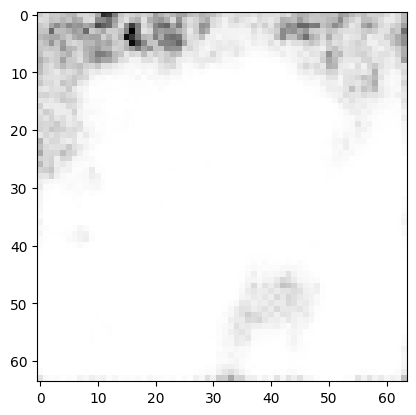

tensor([[2.8260e-03, 9.2283e-04, 6.7279e-04, 1.8860e-03, 3.1965e-03, 9.5829e-01,
         2.4856e-03, 2.1974e-03, 7.9461e-04, 7.8442e-04, 7.5615e-04, 4.6831e-04,
         1.3767e-03, 4.2017e-04, 4.1773e-04, 3.7828e-03, 1.2723e-03, 2.0597e-03,
         3.3650e-04, 5.2380e-04, 9.3485e-05, 3.0134e-04, 1.5922e-03, 1.8791e-04,
         1.4277e-03, 1.4224e-03, 4.1673e-04, 4.1297e-04, 1.9546e-04, 2.3660e-04,
         4.5348e-04, 1.9537e-03, 5.8860e-04, 3.6979e-04, 4.7217e-04, 1.3991e-03,
         3.3778e-04, 1.0774e-03, 2.2457e-04, 1.3637e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.150561332702637
tensor([[2.9984e-03, 9.8712e-04, 7.2015e-04, 1.9938e-03, 3.3654e-03, 9.5565e-01,
         2.6229e-03, 2.3357e-03, 8.4879e-04, 8.4013e-04, 8.0988e-04, 5.0393e-04,
         1.4627e-03, 4.5250e-04, 4.4874e-04, 3.9997e-03, 1.3552e-03, 2.1858e-03,
         3.6224e-04, 5.6163e-04, 1.0213e-04, 3.2490e-04, 1.6844e-03, 2.0432e-04,
         1.5156e-03, 1.5077e-03, 4.4846e-04,

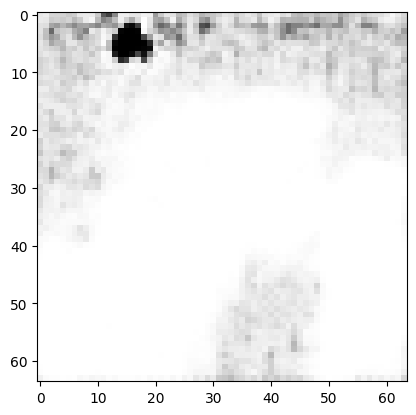

tensor([[3.9147e-03, 2.7132e-03, 2.1228e-03, 5.5706e-03, 5.0961e-03, 8.8010e-01,
         7.3232e-03, 5.2943e-03, 2.1882e-03, 3.3006e-03, 3.4018e-03, 8.0644e-04,
         2.4429e-03, 6.7377e-04, 1.0871e-03, 2.8281e-02, 2.7202e-03, 3.1980e-03,
         1.6298e-03, 3.1319e-03, 2.4854e-04, 1.2624e-03, 1.6745e-03, 8.4648e-04,
         2.1732e-03, 1.1819e-03, 1.1030e-03, 1.4805e-03, 9.8458e-04, 1.0395e-03,
         8.5205e-04, 3.0309e-03, 2.4109e-03, 9.6427e-04, 1.0708e-03, 5.0572e-03,
         4.9737e-04, 1.5613e-03, 4.5579e-04, 7.1099e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.7136406898498535
tensor([[3.8670e-03, 4.5307e-03, 4.1744e-03, 9.3606e-03, 6.0271e-03, 7.4493e-01,
         1.3914e-02, 8.4899e-03, 4.5772e-03, 8.1671e-03, 9.2320e-03, 1.0686e-03,
         3.2428e-03, 7.7114e-04, 2.1576e-03, 8.1893e-02, 4.2043e-03, 4.4306e-03,
         4.0774e-03, 1.0947e-02, 4.5414e-04, 2.9303e-03, 1.9379e-03, 2.1777e-03,
         2.7236e-03, 9.8367e-04, 1.8684e-03

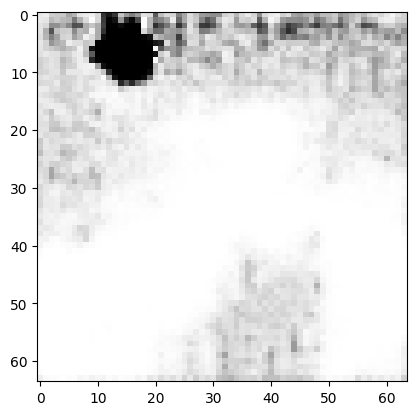

tensor([[0.0019, 0.0050, 0.0065, 0.0133, 0.0060, 0.3495, 0.0206, 0.0088, 0.0130,
         0.0292, 0.0283, 0.0011, 0.0030, 0.0004, 0.0057, 0.2574, 0.0051, 0.0058,
         0.0113, 0.0659, 0.0008, 0.0063, 0.0023, 0.0071, 0.0023, 0.0004, 0.0025,
         0.0055, 0.0089, 0.0102, 0.0012, 0.0017, 0.0113, 0.0025, 0.0041, 0.0296,
         0.0004, 0.0014, 0.0014, 0.0625]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.5320229530334473
tensor([[1.6199e-03, 4.4021e-03, 6.2944e-03, 1.2218e-02, 5.7614e-03, 3.1959e-01,
         1.9610e-02, 7.9925e-03, 1.5111e-02, 3.3648e-02, 2.9726e-02, 9.9061e-04,
         2.8834e-03, 3.5683e-04, 5.9190e-03, 2.7319e-01, 5.1000e-03, 5.7226e-03,
         1.0730e-02, 7.1160e-02, 7.1753e-04, 6.1870e-03, 2.3910e-03, 7.2542e-03,
         2.2532e-03, 2.9486e-04, 2.3600e-03, 5.4386e-03, 9.7835e-03, 1.1343e-02,
         1.1114e-03, 1.4609e-03, 1.1416e-02, 2.3268e-03, 4.2993e-03, 2.9787e-02,
         3.8288e-04, 1.3524e-03, 1.2929e-03, 6.6523e-02]], 

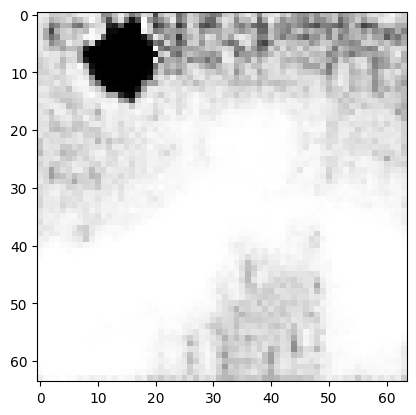

tensor([[1.2403e-03, 2.9248e-03, 4.1480e-03, 1.0664e-02, 8.6222e-03, 2.8775e-01,
         1.4373e-02, 5.4465e-03, 2.1349e-02, 5.2102e-02, 2.6742e-02, 9.0751e-04,
         2.7743e-03, 2.0327e-04, 8.2873e-03, 2.8228e-01, 4.8533e-03, 6.8509e-03,
         8.0866e-03, 7.7069e-02, 6.7521e-04, 5.4247e-03, 3.9158e-03, 8.5790e-03,
         2.1859e-03, 1.8866e-04, 1.7756e-03, 4.3502e-03, 8.7222e-03, 1.4511e-02,
         9.8188e-04, 1.0901e-03, 1.1030e-02, 1.8696e-03, 5.5201e-03, 3.6996e-02,
         2.5904e-04, 9.6298e-04, 1.1751e-03, 6.3118e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.9545435905456543
tensor([[1.1568e-03, 2.4632e-03, 3.3905e-03, 1.0215e-02, 1.0236e-02, 2.9088e-01,
         1.2480e-02, 4.7274e-03, 2.2948e-02, 5.8499e-02, 2.4045e-02, 8.6064e-04,
         2.8118e-03, 1.6213e-04, 9.1575e-03, 2.8557e-01, 4.7020e-03, 7.1724e-03,
         6.7373e-03, 7.4110e-02, 6.4255e-04, 4.9872e-03, 4.6505e-03, 8.8239e-03,
         2.0974e-03, 1.5839e-04, 1.5289e-03

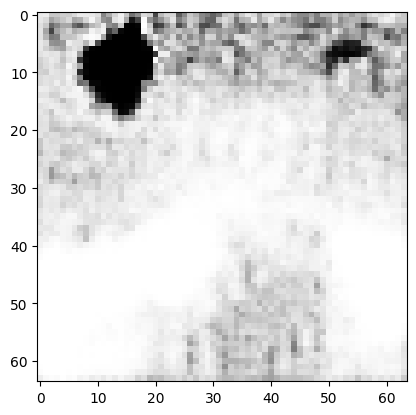

tensor([[3.8095e-04, 1.1746e-03, 2.6102e-03, 6.7118e-03, 7.5599e-03, 1.6909e-01,
         5.7271e-03, 4.6009e-03, 2.7557e-02, 9.3668e-02, 3.1294e-02, 3.7011e-04,
         2.2687e-03, 5.5177e-05, 1.5073e-02, 3.4487e-01, 3.4441e-03, 4.8637e-03,
         3.6925e-03, 1.3343e-01, 4.8011e-04, 4.2784e-03, 4.4643e-03, 9.4254e-03,
         1.0126e-03, 5.0649e-05, 9.0998e-04, 3.2127e-03, 8.2243e-03, 2.0689e-02,
         5.1444e-04, 3.8316e-04, 9.3865e-03, 1.2603e-03, 5.7902e-03, 4.1550e-02,
         1.0413e-04, 3.5194e-04, 1.4293e-03, 2.8039e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.3680014610290527
tensor([[5.8925e-04, 1.1790e-03, 2.4240e-03, 6.9145e-03, 1.0978e-02, 2.1052e-01,
         6.7564e-03, 4.5203e-03, 3.6804e-02, 1.0876e-01, 2.7047e-02, 4.9567e-04,
         3.0545e-03, 6.2142e-05, 1.8185e-02, 2.7457e-01, 4.2454e-03, 7.9382e-03,
         3.4839e-03, 1.0921e-01, 5.6869e-04, 4.4356e-03, 8.0378e-03, 1.0685e-02,
         1.4728e-03, 6.3583e-05, 9.1140e-04

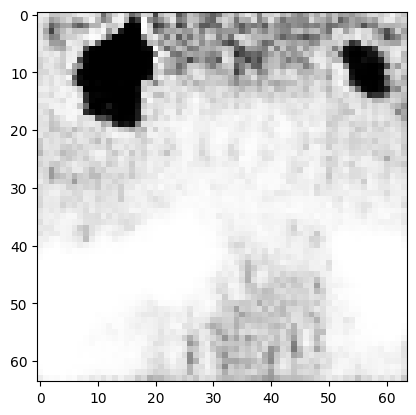

tensor([[2.1276e-04, 4.9161e-04, 1.8451e-03, 1.8526e-03, 6.5728e-03, 9.8200e-02,
         2.0795e-03, 4.0823e-03, 6.5906e-02, 1.9534e-01, 3.8915e-02, 2.0567e-04,
         1.6467e-03, 1.8289e-05, 4.8404e-02, 1.7901e-01, 2.3438e-03, 6.7719e-03,
         1.9997e-03, 1.3129e-01, 3.9162e-04, 3.7410e-03, 1.0042e-02, 9.3545e-03,
         1.5783e-03, 1.3860e-05, 5.1659e-04, 2.0941e-03, 1.4397e-02, 7.4089e-02,
         4.2306e-04, 1.0435e-04, 1.1736e-02, 1.1145e-03, 1.7336e-02, 4.8129e-02,
         7.3740e-05, 3.3676e-04, 2.0003e-03, 1.5342e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.6330140829086304
tensor([[2.1942e-04, 4.4016e-04, 1.6057e-03, 1.4517e-03, 7.3127e-03, 9.5174e-02,
         1.6726e-03, 3.8914e-03, 7.0759e-02, 2.1050e-01, 3.7646e-02, 2.1845e-04,
         1.5784e-03, 1.7031e-05, 5.9586e-02, 1.4807e-01, 2.1859e-03, 7.9055e-03,
         1.7568e-03, 1.1399e-01, 4.0312e-04, 3.5027e-03, 1.3136e-02, 9.1097e-03,
         1.8889e-03, 1.3129e-05, 4.6479e-04

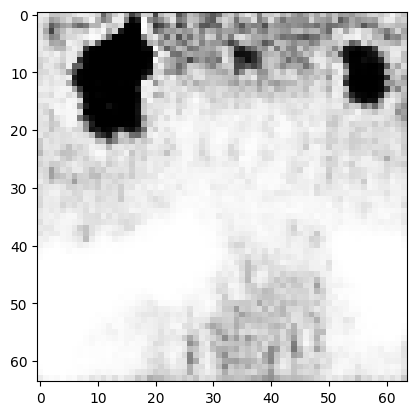

tensor([[1.7353e-04, 3.5417e-04, 1.1423e-03, 7.6545e-04, 8.0220e-03, 6.3174e-02,
         1.0658e-03, 3.3644e-03, 6.3376e-02, 2.5593e-01, 3.3258e-02, 2.1957e-04,
         1.1148e-03, 1.0951e-05, 7.5612e-02, 1.2083e-01, 1.6830e-03, 6.4799e-03,
         1.4995e-03, 8.9183e-02, 3.5187e-04, 3.4235e-03, 1.4901e-02, 9.1274e-03,
         2.1082e-03, 9.2917e-06, 3.5328e-04, 1.5126e-03, 1.2442e-02, 1.1793e-01,
         4.6703e-04, 6.7601e-05, 1.0545e-02, 9.6647e-04, 2.6717e-02, 5.6094e-02,
         5.6602e-05, 2.4412e-04, 1.9145e-03, 1.3510e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.362869381904602
tensor([[1.6496e-04, 3.4993e-04, 1.0715e-03, 6.9738e-04, 8.0070e-03, 5.6956e-02,
         1.0168e-03, 3.2345e-03, 5.9544e-02, 2.6473e-01, 3.2228e-02, 2.1539e-04,
         1.0408e-03, 9.8117e-06, 7.4211e-02, 1.2590e-01, 1.6303e-03, 5.7652e-03,
         1.4908e-03, 8.7806e-02, 3.3056e-04, 3.5199e-03, 1.3777e-02, 9.3537e-03,
         1.9868e-03, 8.3477e-06, 3.3972e-04,

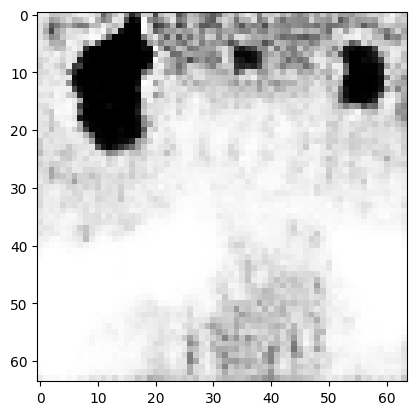

tensor([[1.5485e-04, 2.8103e-04, 7.1906e-04, 4.5874e-04, 1.0208e-02, 4.2045e-02,
         7.8052e-04, 2.9131e-03, 5.4467e-02, 3.0367e-01, 2.5296e-02, 2.6134e-04,
         7.7696e-04, 6.8563e-06, 7.7278e-02, 1.2300e-01, 1.5806e-03, 5.4953e-03,
         1.2846e-03, 6.0007e-02, 2.9771e-04, 3.4381e-03, 1.4218e-02, 1.0710e-02,
         2.0103e-03, 6.9036e-06, 2.5690e-04, 1.1215e-03, 9.7413e-03, 1.3331e-01,
         5.1620e-04, 6.0033e-05, 9.5658e-03, 7.5394e-04, 3.0418e-02, 6.0513e-02,
         4.0211e-05, 1.5357e-04, 1.6850e-03, 1.0506e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.191820502281189
tensor([[1.4292e-04, 2.7148e-04, 7.0172e-04, 4.2897e-04, 9.9512e-03, 3.9605e-02,
         7.4088e-04, 2.9214e-03, 5.2254e-02, 3.0932e-01, 2.5218e-02, 2.5109e-04,
         7.2247e-04, 6.3476e-06, 7.7494e-02, 1.2386e-01, 1.5060e-03, 5.0920e-03,
         1.2595e-03, 5.9312e-02, 2.8499e-04, 3.4309e-03, 1.3717e-02, 1.0598e-02,
         1.9562e-03, 6.4471e-06, 2.4632e-04,

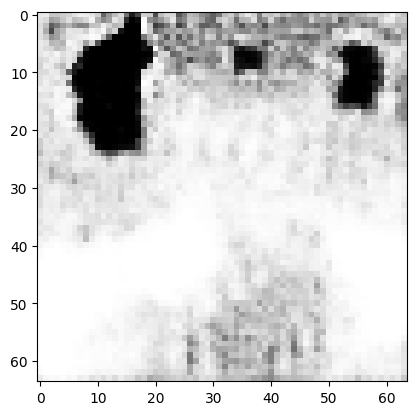

tensor([[1.3027e-04, 2.5026e-04, 6.3597e-04, 3.8528e-04, 1.0684e-02, 3.7440e-02,
         6.7587e-04, 2.8618e-03, 4.7977e-02, 3.2506e-01, 2.3704e-02, 2.5812e-04,
         6.4226e-04, 5.6015e-06, 7.6983e-02, 1.2784e-01, 1.4267e-03, 4.7728e-03,
         1.1883e-03, 5.2490e-02, 2.6946e-04, 3.3058e-03, 1.3934e-02, 1.0438e-02,
         1.9328e-03, 6.1734e-06, 2.2275e-04, 9.8611e-04, 8.4483e-03, 1.3328e-01,
         4.9056e-04, 5.6088e-05, 8.6590e-03, 6.7167e-04, 2.9930e-02, 6.0497e-02,
         3.3310e-05, 1.2313e-04, 1.5182e-03, 9.7799e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.123740792274475
tensor([[1.3231e-04, 2.4628e-04, 5.8904e-04, 3.8750e-04, 1.1798e-02, 3.7560e-02,
         6.7106e-04, 2.7649e-03, 4.6515e-02, 3.2886e-01, 2.2198e-02, 2.7465e-04,
         6.4284e-04, 5.3980e-06, 7.5061e-02, 1.3446e-01, 1.4504e-03, 4.8718e-03,
         1.1655e-03, 4.9423e-02, 2.6744e-04, 3.2498e-03, 1.4006e-02, 1.0785e-02,
         1.8847e-03, 6.2551e-06, 2.1361e-04,

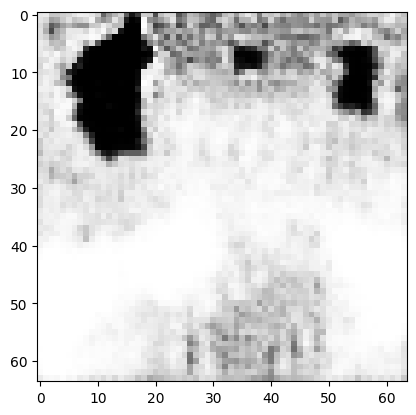

tensor([[1.2091e-04, 2.2731e-04, 5.3836e-04, 3.4890e-04, 1.2201e-02, 3.6842e-02,
         5.9141e-04, 2.6180e-03, 4.4033e-02, 3.4302e-01, 2.0597e-02, 2.7356e-04,
         6.2439e-04, 4.8170e-06, 7.4157e-02, 1.3746e-01, 1.3457e-03, 4.4904e-03,
         1.0363e-03, 4.5227e-02, 2.5122e-04, 3.0917e-03, 1.4887e-02, 1.0045e-02,
         1.7743e-03, 5.8307e-06, 1.9311e-04, 8.8641e-04, 7.1187e-03, 1.2676e-01,
         4.8725e-04, 5.7306e-05, 8.0535e-03, 5.9686e-04, 2.7511e-02, 6.1812e-02,
         2.8092e-05, 1.0262e-04, 1.3181e-03, 9.2565e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0699646472930908
tensor([[1.1451e-04, 2.1828e-04, 5.2960e-04, 3.3113e-04, 1.1672e-02, 3.6375e-02,
         5.6762e-04, 2.5008e-03, 4.3703e-02, 3.4674e-01, 2.0179e-02, 2.5575e-04,
         6.2743e-04, 4.4975e-06, 7.1669e-02, 1.4240e-01, 1.3025e-03, 4.2263e-03,
         9.7554e-04, 4.4799e-02, 2.3637e-04, 3.0255e-03, 1.4530e-02, 9.5247e-03,
         1.6780e-03, 5.2392e-06, 1.8640e-04

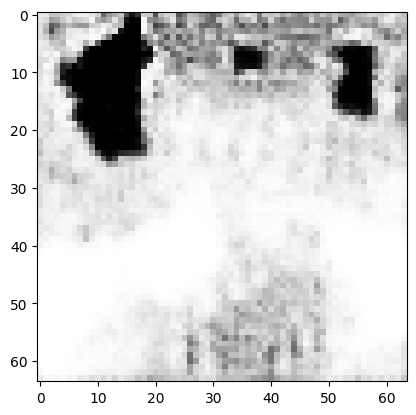

tensor([[1.0729e-04, 1.9563e-04, 4.9167e-04, 2.8817e-04, 1.1181e-02, 3.7377e-02,
         5.0589e-04, 2.3283e-03, 4.4489e-02, 3.5808e-01, 1.8871e-02, 2.3457e-04,
         6.4396e-04, 4.0144e-06, 6.8872e-02, 1.4388e-01, 1.2335e-03, 4.0430e-03,
         8.1800e-04, 3.9602e-02, 2.1172e-04, 2.8079e-03, 1.5619e-02, 8.3229e-03,
         1.6538e-03, 4.5078e-06, 1.6785e-04, 8.0188e-04, 7.0044e-03, 1.2829e-01,
         4.3369e-04, 4.9492e-05, 7.6805e-03, 5.3269e-04, 2.4712e-02, 5.8827e-02,
         2.3844e-05, 9.7064e-05, 1.1076e-03, 8.4076e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0270054340362549
tensor([[1.0633e-04, 1.9134e-04, 4.8119e-04, 2.7869e-04, 1.1226e-02, 3.7652e-02,
         4.9082e-04, 2.3046e-03, 4.4498e-02, 3.6067e-01, 1.8640e-02, 2.3459e-04,
         6.3764e-04, 3.9584e-06, 6.9581e-02, 1.4180e-01, 1.2084e-03, 4.0544e-03,
         7.9504e-04, 3.8034e-02, 2.0925e-04, 2.7487e-03, 1.6251e-02, 8.0999e-03,
         1.6969e-03, 4.4719e-06, 1.6381e-04

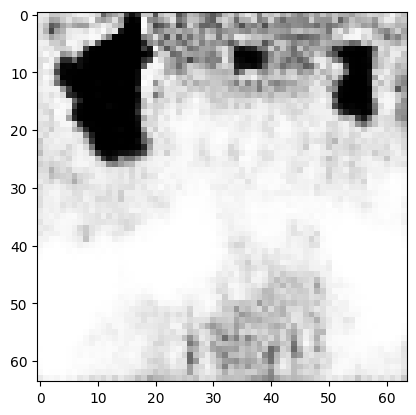

tensor([[1.0198e-04, 1.7537e-04, 4.2805e-04, 2.3249e-04, 1.1321e-02, 3.7379e-02,
         4.2024e-04, 2.2966e-03, 4.3399e-02, 3.7182e-01, 1.7409e-02, 2.2857e-04,
         6.0697e-04, 3.6285e-06, 7.3092e-02, 1.2871e-01, 1.0821e-03, 3.9467e-03,
         6.8741e-04, 3.2286e-02, 1.9861e-04, 2.5768e-03, 1.8453e-02, 7.4179e-03,
         1.8566e-03, 4.2466e-06, 1.4283e-04, 7.1620e-04, 6.5762e-03, 1.3398e-01,
         4.1864e-04, 4.5702e-05, 7.4790e-03, 5.0207e-04, 2.6452e-02, 5.8324e-02,
         2.2055e-05, 9.7271e-05, 1.0185e-03, 8.0907e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9893569350242615
tensor([[9.7152e-05, 1.7195e-04, 4.2806e-04, 2.2500e-04, 1.0699e-02, 3.6376e-02,
         4.0938e-04, 2.3008e-03, 4.2791e-02, 3.7398e-01, 1.7601e-02, 2.1641e-04,
         5.9145e-04, 3.4831e-06, 7.2659e-02, 1.3027e-01, 1.0486e-03, 3.7571e-03,
         6.7400e-04, 3.2766e-02, 1.9199e-04, 2.5645e-03, 1.7927e-02, 7.2759e-03,
         1.8036e-03, 3.9708e-06, 1.3953e-04

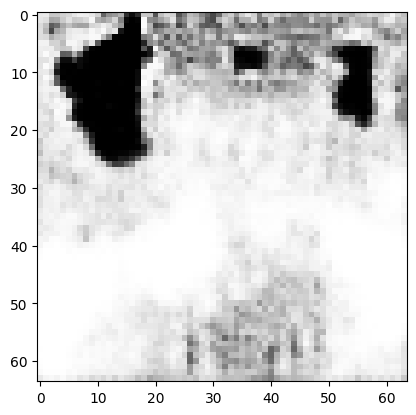

tensor([[9.5069e-05, 1.6513e-04, 4.0934e-04, 2.0444e-04, 1.0040e-02, 3.5332e-02,
         3.8947e-04, 2.3073e-03, 4.2394e-02, 3.8252e-01, 1.7225e-02, 2.0585e-04,
         5.6984e-04, 3.2786e-06, 7.1599e-02, 1.2740e-01, 9.9954e-04, 3.5486e-03,
         6.2921e-04, 3.0599e-02, 1.7974e-04, 2.5370e-03, 1.8195e-02, 7.0309e-03,
         1.8426e-03, 3.6382e-06, 1.3092e-04, 6.7844e-04, 6.7952e-03, 1.3572e-01,
         3.8958e-04, 4.0136e-05, 7.4252e-03, 4.8728e-04, 2.6377e-02, 5.6772e-02,
         2.0670e-05, 9.3784e-05, 9.7150e-04, 7.6754e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9609658718109131
tensor([[9.4883e-05, 1.6233e-04, 3.9763e-04, 1.9826e-04, 1.0033e-02, 3.4864e-02,
         3.8181e-04, 2.3257e-03, 4.2312e-02, 3.8466e-01, 1.6911e-02, 2.0506e-04,
         5.6519e-04, 3.1987e-06, 7.1240e-02, 1.2717e-01, 9.9531e-04, 3.5236e-03,
         6.1128e-04, 2.9653e-02, 1.7675e-04, 2.5241e-03, 1.8124e-02, 7.0674e-03,
         1.8433e-03, 3.5527e-06, 1.2707e-04

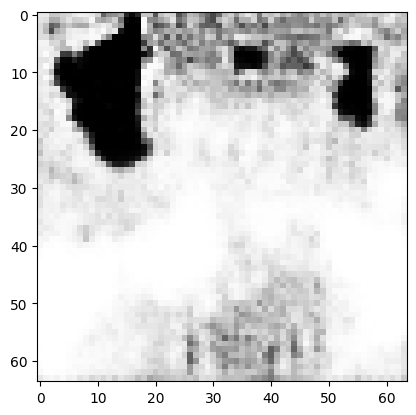

tensor([[9.3175e-05, 1.5585e-04, 3.7658e-04, 1.7730e-04, 9.5794e-03, 3.3559e-02,
         3.6350e-04, 2.2950e-03, 4.1804e-02, 3.9281e-01, 1.6341e-02, 1.9775e-04,
         5.3862e-04, 2.9908e-06, 6.9273e-02, 1.2639e-01, 9.5434e-04, 3.3213e-03,
         5.7326e-04, 2.7523e-02, 1.6401e-04, 2.4752e-03, 1.7878e-02, 6.8927e-03,
         1.8515e-03, 3.2042e-06, 1.1909e-04, 6.3071e-04, 6.7202e-03, 1.3736e-01,
         3.8070e-04, 3.6466e-05, 7.2664e-03, 4.6888e-04, 2.7043e-02, 5.6186e-02,
         1.9389e-05, 9.0487e-05, 9.3579e-04, 7.1427e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9344226121902466
tensor([[9.4693e-05, 1.5526e-04, 3.7362e-04, 1.7430e-04, 9.6090e-03, 3.3865e-02,
         3.6360e-04, 2.3112e-03, 4.2112e-02, 3.9432e-01, 1.6183e-02, 1.9835e-04,
         5.4251e-04, 3.0008e-06, 6.9150e-02, 1.2352e-01, 9.5573e-04, 3.3410e-03,
         5.6421e-04, 2.6916e-02, 1.6344e-04, 2.4760e-03, 1.8259e-02, 6.8477e-03,
         1.8933e-03, 3.2299e-06, 1.1819e-04

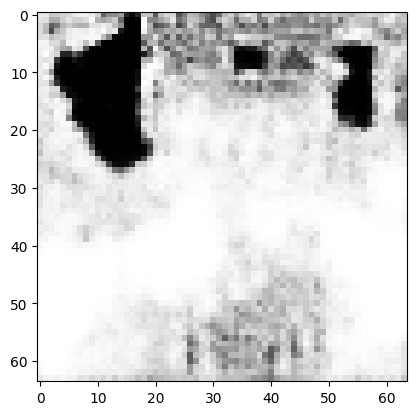

tensor([[9.6686e-05, 1.5185e-04, 3.6107e-04, 1.6193e-04, 9.5423e-03, 3.3841e-02,
         3.5596e-04, 2.3063e-03, 4.2068e-02, 4.0013e-01, 1.5712e-02, 1.9759e-04,
         5.3479e-04, 2.9463e-06, 6.7725e-02, 1.2139e-01, 9.4711e-04, 3.2834e-03,
         5.3589e-04, 2.5014e-02, 1.5697e-04, 2.4410e-03, 1.8633e-02, 6.6909e-03,
         1.9526e-03, 3.1117e-06, 1.1389e-04, 6.0838e-04, 6.7140e-03, 1.3814e-01,
         3.8551e-04, 3.5294e-05, 7.2248e-03, 4.6340e-04, 2.8364e-02, 5.5800e-02,
         1.9450e-05, 9.3180e-05, 9.2386e-04, 6.8789e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9159739017486572
tensor([[9.0899e-05, 1.5059e-04, 3.6710e-04, 1.6085e-04, 8.9641e-03, 3.2746e-02,
         3.5105e-04, 2.3025e-03, 4.1031e-02, 4.0176e-01, 1.6106e-02, 1.8611e-04,
         5.1599e-04, 2.8369e-06, 6.6727e-02, 1.2667e-01, 9.1769e-04, 3.0614e-03,
         5.3799e-04, 2.6130e-02, 1.5137e-04, 2.4393e-03, 1.7562e-02, 6.6074e-03,
         1.8492e-03, 2.8891e-06, 1.1301e-04

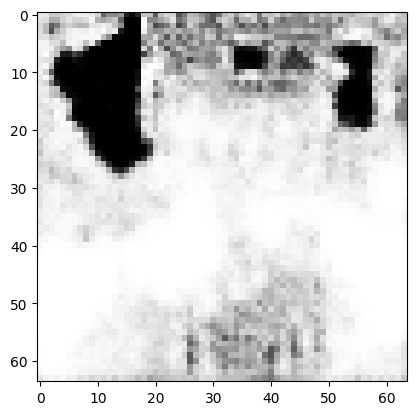

tensor([[9.2606e-05, 1.4870e-04, 3.6576e-04, 1.5194e-04, 8.7386e-03, 3.3348e-02,
         3.4546e-04, 2.3066e-03, 4.1218e-02, 4.0693e-01, 1.6010e-02, 1.8208e-04,
         5.1691e-04, 2.8387e-06, 6.5473e-02, 1.2429e-01, 9.1138e-04, 2.9912e-03,
         5.1193e-04, 2.5021e-02, 1.4583e-04, 2.4110e-03, 1.8096e-02, 6.2994e-03,
         1.8886e-03, 2.8092e-06, 1.1115e-04, 6.0050e-04, 6.7686e-03, 1.3686e-01,
         3.6567e-04, 3.2490e-05, 6.8332e-03, 4.6137e-04, 2.7320e-02, 5.4616e-02,
         1.8993e-05, 9.1177e-05, 8.9607e-04, 6.6219e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8991157412528992
tensor([[1.0040e-04, 1.4972e-04, 3.5840e-04, 1.4936e-04, 9.2305e-03, 3.4958e-02,
         3.4643e-04, 2.3504e-03, 4.2418e-02, 4.0744e-01, 1.5568e-02, 1.9330e-04,
         5.4182e-04, 2.9681e-06, 6.5912e-02, 1.1814e-01, 9.5287e-04, 3.1945e-03,
         4.9433e-04, 2.3405e-02, 1.4980e-04, 2.4165e-03, 1.9475e-02, 6.2928e-03,
         2.0042e-03, 3.0298e-06, 1.1112e-04

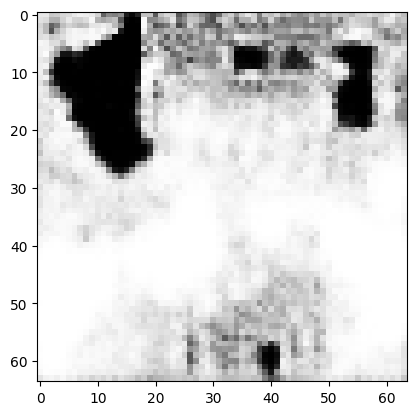

tensor([[7.5317e-05, 1.2847e-04, 3.0416e-04, 1.5095e-04, 7.5871e-03, 3.4775e-02,
         3.8971e-04, 2.0595e-03, 4.3237e-02, 4.5833e-01, 1.8935e-02, 1.2734e-04,
         3.7636e-04, 2.0602e-06, 6.0116e-02, 9.0189e-02, 1.0684e-03, 1.8609e-03,
         4.6721e-04, 2.2455e-02, 9.4984e-05, 3.4119e-03, 2.5387e-02, 4.5594e-03,
         1.7134e-03, 2.9793e-06, 9.8554e-05, 6.7300e-04, 6.9815e-03, 1.1581e-01,
         3.4768e-04, 3.5066e-05, 7.2274e-03, 4.4369e-04, 2.6278e-02, 5.8930e-02,
         2.1721e-05, 9.8541e-05, 8.5116e-04, 4.4029e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7801757454872131
tensor([[6.9015e-05, 1.2600e-04, 3.0050e-04, 1.5362e-04, 7.0024e-03, 3.3617e-02,
         3.9571e-04, 2.0092e-03, 4.3045e-02, 4.6533e-01, 1.9844e-02, 1.1580e-04,
         3.5288e-04, 1.9059e-06, 5.9454e-02, 8.9562e-02, 1.0553e-03, 1.6627e-03,
         4.7089e-04, 2.3032e-02, 8.7416e-05, 3.6016e-03, 2.5301e-02, 4.3988e-03,
         1.6290e-03, 2.8116e-06, 9.7397e-05

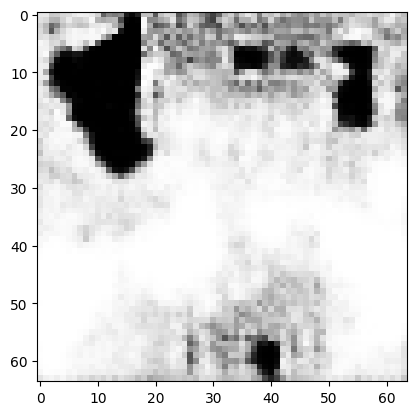

tensor([[5.7809e-05, 1.2303e-04, 2.9991e-04, 1.5978e-04, 5.4040e-03, 3.1039e-02,
         4.1062e-04, 1.8873e-03, 4.3209e-02, 4.8646e-01, 2.3745e-02, 9.3194e-05,
         3.1134e-04, 1.6452e-06, 5.8282e-02, 8.6666e-02, 1.1622e-03, 1.2524e-03,
         4.7017e-04, 2.3609e-02, 7.1828e-05, 4.4022e-03, 2.7655e-02, 3.9455e-03,
         1.4298e-03, 2.4607e-06, 9.9785e-05, 7.7490e-04, 8.1953e-03, 9.6797e-02,
         2.9501e-04, 3.4054e-05, 6.9989e-03, 4.4479e-04, 2.2077e-02, 5.7970e-02,
         2.2984e-05, 8.9849e-05, 8.0322e-04, 3.2430e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7205926775932312
tensor([[5.6830e-05, 1.2268e-04, 2.9739e-04, 1.6019e-04, 5.2629e-03, 3.0703e-02,
         4.1455e-04, 1.8573e-03, 4.3319e-02, 4.8917e-01, 2.4150e-02, 9.1105e-05,
         3.0722e-04, 1.6131e-06, 5.7975e-02, 8.5997e-02, 1.1818e-03, 1.2090e-03,
         4.7018e-04, 2.3427e-02, 6.9751e-05, 4.5326e-03, 2.8152e-02, 3.9000e-03,
         1.4163e-03, 2.4220e-06, 1.0016e-04

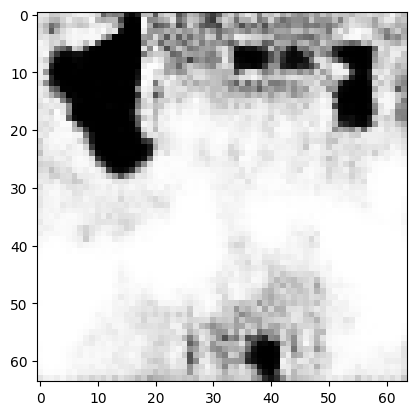

tensor([[5.4183e-05, 1.2157e-04, 2.9500e-04, 1.6300e-04, 4.8510e-03, 3.0063e-02,
         4.2039e-04, 1.8092e-03, 4.3783e-02, 4.9594e-01, 2.5361e-02, 8.6822e-05,
         2.9484e-04, 1.5553e-06, 5.7878e-02, 8.4388e-02, 1.2203e-03, 1.1180e-03,
         4.7085e-04, 2.2942e-02, 6.5654e-05, 4.8319e-03, 2.9695e-02, 3.7813e-03,
         1.3921e-03, 2.3596e-06, 1.0128e-04, 8.1847e-04, 8.7966e-03, 8.9684e-02,
         2.8472e-04, 3.4759e-05, 7.0112e-03, 4.4440e-04, 2.0909e-02, 5.7074e-02,
         2.3827e-05, 8.8665e-05, 7.7430e-04, 2.9212e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7012956142425537
tensor([[5.3248e-05, 1.2165e-04, 2.9466e-04, 1.6331e-04, 4.7530e-03, 2.9711e-02,
         4.2246e-04, 1.7917e-03, 4.3769e-02, 4.9730e-01, 2.5678e-02, 8.5627e-05,
         2.9066e-04, 1.5370e-06, 5.7796e-02, 8.4257e-02, 1.2223e-03, 1.0902e-03,
         4.7381e-04, 2.2926e-02, 6.4571e-05, 4.9139e-03, 2.9814e-02, 3.7643e-03,
         1.3863e-03, 2.3289e-06, 1.0178e-04

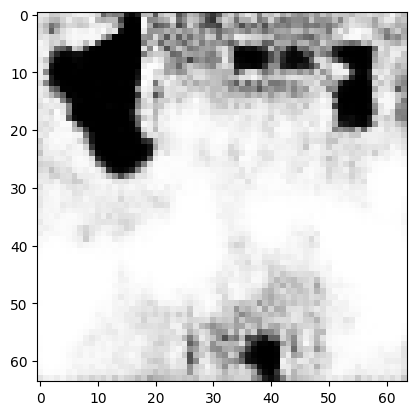

tensor([[4.9492e-05, 1.2050e-04, 2.9341e-04, 1.6224e-04, 4.3975e-03, 2.8159e-02,
         4.2471e-04, 1.7587e-03, 4.3462e-02, 5.0188e-01, 2.7118e-02, 8.1138e-05,
         2.7363e-04, 1.4617e-06, 5.7512e-02, 8.4899e-02, 1.2514e-03, 9.9822e-04,
         4.7845e-04, 2.2976e-02, 6.0862e-05, 5.2079e-03, 2.9807e-02, 3.7289e-03,
         1.3330e-03, 2.1844e-06, 1.0207e-04, 8.4472e-04, 9.2575e-03, 8.5492e-02,
         2.7378e-04, 3.4553e-05, 6.9336e-03, 4.4415e-04, 1.9912e-02, 5.6701e-02,
         2.3835e-05, 8.4404e-05, 7.5373e-04, 2.7056e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6893953084945679
tensor([[4.8755e-05, 1.1995e-04, 2.9287e-04, 1.6201e-04, 4.3319e-03, 2.7894e-02,
         4.2484e-04, 1.7620e-03, 4.3430e-02, 5.0274e-01, 2.7408e-02, 8.0342e-05,
         2.7013e-04, 1.4467e-06, 5.7589e-02, 8.4782e-02, 1.2587e-03, 9.8505e-04,
         4.7847e-04, 2.2991e-02, 6.0278e-05, 5.2591e-03, 2.9871e-02, 3.7268e-03,
         1.3218e-03, 2.1637e-06, 1.0171e-04

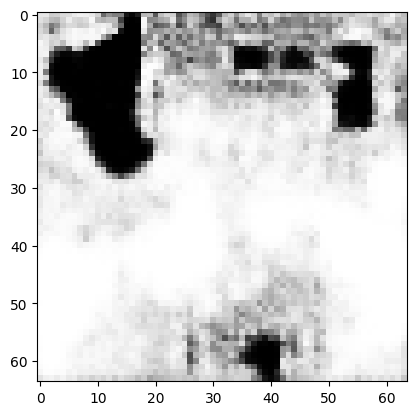

tensor([[4.6478e-05, 1.1785e-04, 2.8582e-04, 1.6334e-04, 4.1240e-03, 2.7139e-02,
         4.2656e-04, 1.7185e-03, 4.4336e-02, 5.1072e-01, 2.8408e-02, 7.6191e-05,
         2.5599e-04, 1.3979e-06, 5.7589e-02, 7.9145e-02, 1.2919e-03, 8.9981e-04,
         4.7450e-04, 2.2257e-02, 5.6926e-05, 5.5928e-03, 3.1796e-02, 3.5849e-03,
         1.3248e-03, 2.1955e-06, 1.0072e-04, 8.7908e-04, 9.5367e-03, 8.1308e-02,
         2.7176e-04, 3.4713e-05, 6.9169e-03, 4.4507e-04, 1.9528e-02, 5.5798e-02,
         2.4634e-05, 8.4414e-05, 7.4537e-04, 2.4966e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.671941876411438
tensor([[4.4987e-05, 1.1632e-04, 2.8181e-04, 1.6700e-04, 4.0323e-03, 2.6906e-02,
         4.2615e-04, 1.7018e-03, 4.5169e-02, 5.1600e-01, 2.8972e-02, 7.2925e-05,
         2.4920e-04, 1.3751e-06, 5.7394e-02, 7.5374e-02, 1.3031e-03, 8.4027e-04,
         4.6790e-04, 2.1981e-02, 5.5143e-05, 5.7836e-03, 3.2933e-02, 3.4746e-03,
         1.3240e-03, 2.2590e-06, 9.9630e-05,

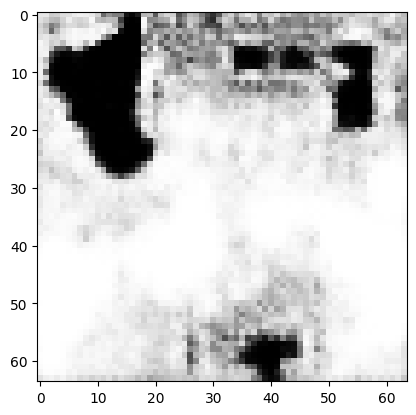

tensor([[3.6738e-05, 1.0606e-04, 2.5503e-04, 1.7558e-04, 3.5707e-03, 2.5042e-02,
         4.0188e-04, 1.5460e-03, 4.8983e-02, 5.4526e-01, 3.1311e-02, 5.5401e-05,
         2.1370e-04, 1.2085e-06, 5.2998e-02, 6.1474e-02, 1.3323e-03, 5.5423e-04,
         4.1475e-04, 2.0548e-02, 4.4929e-05, 6.6131e-03, 3.5991e-02, 2.8356e-03,
         1.2521e-03, 2.4067e-06, 9.2343e-05, 1.0128e-03, 9.1722e-03, 7.0409e-02,
         2.6692e-04, 3.2525e-05, 6.6964e-03, 4.4493e-04, 1.6834e-02, 5.1083e-02,
         2.5648e-05, 8.7210e-05, 7.0452e-04, 2.1190e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6064922213554382
tensor([[3.4736e-05, 1.0398e-04, 2.5164e-04, 1.7487e-04, 3.4626e-03, 2.4421e-02,
         3.9653e-04, 1.5197e-03, 4.9014e-02, 5.4906e-01, 3.1766e-02, 5.2396e-05,
         2.0576e-04, 1.1607e-06, 5.2202e-02, 6.1128e-02, 1.3163e-03, 5.1619e-04,
         4.0997e-04, 2.0714e-02, 4.3170e-05, 6.6932e-03, 3.5290e-02, 2.7629e-03,
         1.2158e-03, 2.3359e-06, 9.0683e-05

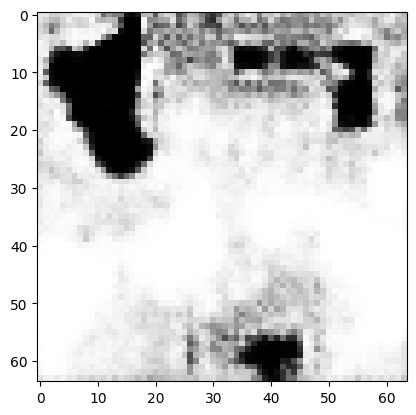

tensor([[2.8186e-05, 9.4755e-05, 2.3356e-04, 1.7563e-04, 3.1871e-03, 2.2394e-02,
         3.7047e-04, 1.3822e-03, 5.2014e-02, 5.6900e-01, 3.3037e-02, 4.1642e-05,
         1.7914e-04, 1.0178e-06, 4.7909e-02, 5.4621e-02, 1.3091e-03, 3.6873e-04,
         3.6963e-04, 2.0097e-02, 3.6923e-05, 7.1775e-03, 3.5000e-02, 2.3589e-03,
         1.1344e-03, 2.2798e-06, 8.3910e-05, 1.0638e-03, 8.6275e-03, 6.5782e-02,
         2.5437e-04, 2.8720e-05, 6.3828e-03, 4.3049e-04, 1.4539e-02, 4.7575e-02,
         2.3864e-05, 8.3332e-05, 6.5125e-04, 1.9537e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5638822317123413
tensor([[2.6939e-05, 9.3076e-05, 2.3029e-04, 1.7559e-04, 3.1397e-03, 2.1942e-02,
         3.6518e-04, 1.3547e-03, 5.2384e-02, 5.7254e-01, 3.3268e-02, 3.9793e-05,
         1.7386e-04, 9.8913e-07, 4.7085e-02, 5.3970e-02, 1.3000e-03, 3.4506e-04,
         3.6313e-04, 2.0047e-02, 3.5805e-05, 7.2532e-03, 3.4614e-02, 2.2938e-03,
         1.1155e-03, 2.2474e-06, 8.2543e-05

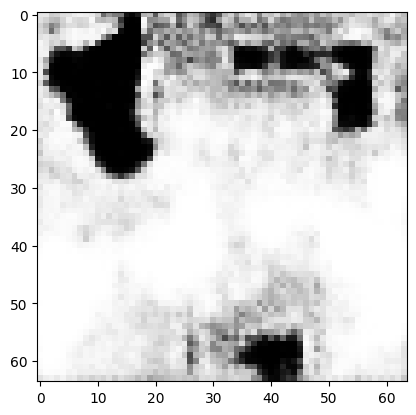

tensor([[2.3877e-05, 8.9037e-05, 2.2308e-04, 1.7254e-04, 2.9366e-03, 2.0449e-02,
         3.4748e-04, 1.3176e-03, 5.2147e-02, 5.7993e-01, 3.4178e-02, 3.5377e-05,
         1.6039e-04, 9.0835e-07, 4.5797e-02, 5.3822e-02, 1.2564e-03, 2.9766e-04,
         3.4891e-04, 2.0283e-02, 3.3276e-05, 7.3949e-03, 3.2533e-02, 2.1986e-03,
         1.0457e-03, 2.0799e-06, 7.8418e-05, 1.0688e-03, 8.4155e-03, 6.4481e-02,
         2.4134e-04, 2.6074e-05, 6.2003e-03, 4.1968e-04, 1.3382e-02, 4.6063e-02,
         2.2034e-05, 7.7878e-05, 6.2287e-04, 1.8777e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5448473691940308
tensor([[2.3529e-05, 8.8511e-05, 2.2143e-04, 1.7153e-04, 2.9001e-03, 2.0191e-02,
         3.4365e-04, 1.3113e-03, 5.2030e-02, 5.8112e-01, 3.4318e-02, 3.4792e-05,
         1.5844e-04, 8.9728e-07, 4.5726e-02, 5.3665e-02, 1.2494e-03, 2.9146e-04,
         3.4596e-04, 2.0215e-02, 3.2900e-05, 7.4266e-03, 3.2347e-02, 2.1849e-03,
         1.0369e-03, 2.0542e-06, 7.7706e-05

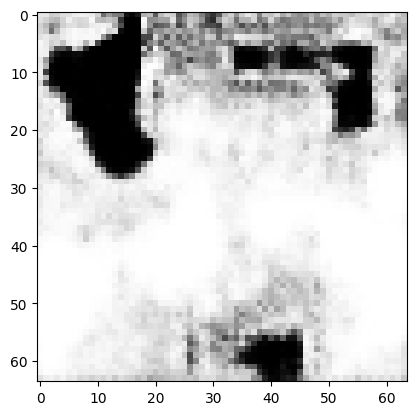

tensor([[2.2252e-05, 8.6559e-05, 2.1673e-04, 1.6848e-04, 2.7981e-03, 1.9339e-02,
         3.3633e-04, 1.3005e-03, 5.1587e-02, 5.8469e-01, 3.4702e-02, 3.3203e-05,
         1.5075e-04, 8.5947e-07, 4.5337e-02, 5.3573e-02, 1.2247e-03, 2.7374e-04,
         3.4116e-04, 2.0115e-02, 3.1793e-05, 7.5080e-03, 3.1348e-02, 2.1673e-03,
         1.0123e-03, 1.9706e-06, 7.5307e-05, 1.0618e-03, 8.4205e-03, 6.4117e-02,
         2.3553e-04, 2.4859e-05, 6.1437e-03, 4.1419e-04, 1.3089e-02, 4.5515e-02,
         2.1189e-05, 7.4809e-05, 6.1176e-04, 1.8291e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5366731882095337
tensor([[2.1942e-05, 8.6036e-05, 2.1563e-04, 1.6761e-04, 2.7704e-03, 1.9119e-02,
         3.3502e-04, 1.3030e-03, 5.1457e-02, 5.8536e-01, 3.4780e-02, 3.2878e-05,
         1.4889e-04, 8.5031e-07, 4.5333e-02, 5.3516e-02, 1.2174e-03, 2.7064e-04,
         3.4044e-04, 2.0127e-02, 3.1596e-05, 7.5238e-03, 3.1094e-02, 2.1703e-03,
         1.0056e-03, 1.9502e-06, 7.4586e-05

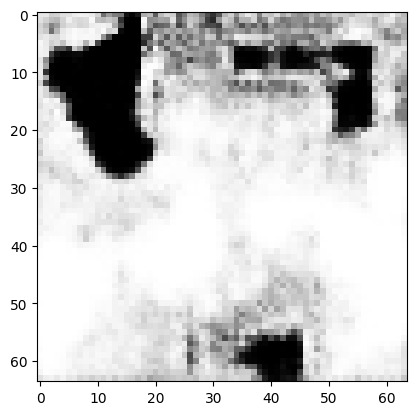

tensor([[2.1710e-05, 8.4822e-05, 2.1126e-04, 1.6395e-04, 2.7244e-03, 1.8800e-02,
         3.3018e-04, 1.2845e-03, 5.1279e-02, 5.8778e-01, 3.4678e-02, 3.2166e-05,
         1.4671e-04, 8.3389e-07, 4.4977e-02, 5.3035e-02, 1.2093e-03, 2.6440e-04,
         3.3314e-04, 1.9659e-02, 3.0843e-05, 7.5528e-03, 3.1135e-02, 2.1390e-03,
         9.9810e-04, 1.9011e-06, 7.3020e-05, 1.0531e-03, 8.4811e-03, 6.3909e-02,
         2.3304e-04, 2.4194e-05, 6.1498e-03, 4.0964e-04, 1.3030e-02, 4.5282e-02,
         2.0801e-05, 7.3547e-05, 6.0191e-04, 1.7880e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5314056873321533
tensor([[2.1433e-05, 8.4344e-05, 2.1070e-04, 1.6289e-04, 2.6926e-03, 1.8622e-02,
         3.2855e-04, 1.2836e-03, 5.1109e-02, 5.8831e-01, 3.4777e-02, 3.1737e-05,
         1.4556e-04, 8.2449e-07, 4.4876e-02, 5.3227e-02, 1.2027e-03, 2.6140e-04,
         3.3165e-04, 1.9713e-02, 3.0575e-05, 7.5604e-03, 3.0836e-02, 2.1346e-03,
         9.8751e-04, 1.8689e-06, 7.2467e-05

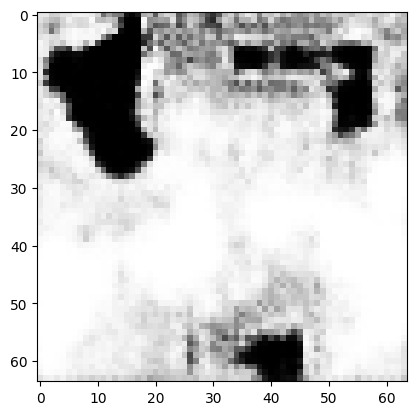

tensor([[2.0942e-05, 8.3216e-05, 2.0821e-04, 1.6004e-04, 2.6255e-03, 1.8218e-02,
         3.2539e-04, 1.2746e-03, 5.0825e-02, 5.9026e-01, 3.4914e-02, 3.0898e-05,
         1.4292e-04, 8.0515e-07, 4.4498e-02, 5.3328e-02, 1.1980e-03, 2.5391e-04,
         3.2711e-04, 1.9536e-02, 2.9866e-05, 7.6186e-03, 3.0480e-02, 2.1186e-03,
         9.7109e-04, 1.8057e-06, 7.1217e-05, 1.0455e-03, 8.5750e-03, 6.3664e-02,
         2.2782e-04, 2.3444e-05, 6.1382e-03, 4.0528e-04, 1.2870e-02, 4.5105e-02,
         2.0341e-05, 7.1776e-05, 5.9416e-04, 1.7358e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.527190625667572
tensor([[2.0895e-05, 8.3015e-05, 2.0748e-04, 1.5924e-04, 2.6104e-03, 1.8155e-02,
         3.2492e-04, 1.2687e-03, 5.0839e-02, 5.9077e-01, 3.4954e-02, 3.0776e-05,
         1.4252e-04, 8.0240e-07, 4.4429e-02, 5.3210e-02, 1.2022e-03, 2.5267e-04,
         3.2595e-04, 1.9424e-02, 2.9692e-05, 7.6395e-03, 3.0601e-02, 2.1108e-03,
         9.6924e-04, 1.7940e-06, 7.1068e-05,

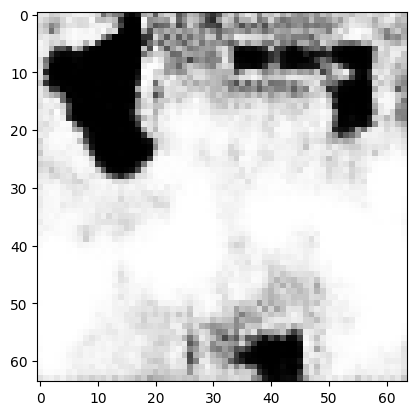

tensor([[2.0460e-05, 8.2194e-05, 2.0565e-04, 1.5665e-04, 2.5412e-03, 1.7822e-02,
         3.2363e-04, 1.2600e-03, 5.0649e-02, 5.9246e-01, 3.5376e-02, 3.0106e-05,
         1.4029e-04, 7.8773e-07, 4.4012e-02, 5.3358e-02, 1.2231e-03, 2.4563e-04,
         3.2221e-04, 1.9208e-02, 2.8983e-05, 7.7672e-03, 3.0581e-02, 2.0940e-03,
         9.5120e-04, 1.7380e-06, 7.0402e-05, 1.0490e-03, 8.7282e-03, 6.2562e-02,
         2.2389e-04, 2.3247e-05, 6.1205e-03, 4.0202e-04, 1.2735e-02, 4.4880e-02,
         2.0297e-05, 7.0592e-05, 5.8678e-04, 1.6657e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5234690308570862
tensor([[2.0259e-05, 8.2091e-05, 2.0541e-04, 1.5587e-04, 2.5207e-03, 1.7674e-02,
         3.2324e-04, 1.2557e-03, 5.0444e-02, 5.9285e-01, 3.5500e-02, 2.9816e-05,
         1.3925e-04, 7.8121e-07, 4.3836e-02, 5.3622e-02, 1.2197e-03, 2.4245e-04,
         3.2233e-04, 1.9254e-02, 2.8738e-05, 7.7961e-03, 3.0297e-02, 2.0915e-03,
         9.4488e-04, 1.7133e-06, 7.0273e-05

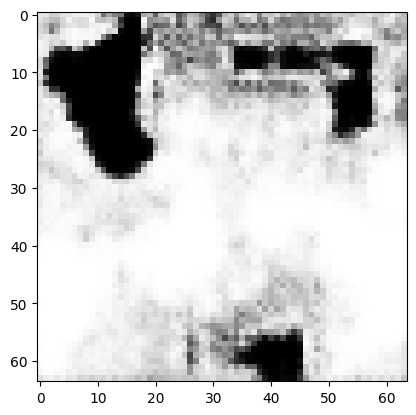

tensor([[1.9992e-05, 8.1197e-05, 2.0359e-04, 1.5374e-04, 2.4707e-03, 1.7460e-02,
         3.2188e-04, 1.2481e-03, 5.0358e-02, 5.9455e-01, 3.5631e-02, 2.9286e-05,
         1.3758e-04, 7.6947e-07, 4.3449e-02, 5.3609e-02, 1.2307e-03, 2.3775e-04,
         3.1858e-04, 1.8997e-02, 2.8185e-05, 7.8566e-03, 3.0330e-02, 2.0733e-03,
         9.3459e-04, 1.6725e-06, 6.9446e-05, 1.0457e-03, 8.8260e-03, 6.1939e-02,
         2.1973e-04, 2.2865e-05, 6.0990e-03, 3.9822e-04, 1.2608e-02, 4.4748e-02,
         2.0083e-05, 6.9541e-05, 5.7825e-04, 1.6224e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5199477672576904
tensor([[1.9859e-05, 8.1007e-05, 2.0340e-04, 1.5355e-04, 2.4559e-03, 1.7379e-02,
         3.2159e-04, 1.2501e-03, 5.0287e-02, 5.9495e-01, 3.5708e-02, 2.9124e-05,
         1.3690e-04, 7.6589e-07, 4.3367e-02, 5.3702e-02, 1.2320e-03, 2.3601e-04,
         3.1813e-04, 1.9002e-02, 2.8074e-05, 7.8795e-03, 3.0214e-02, 2.0739e-03,
         9.3033e-04, 1.6627e-06, 6.9223e-05

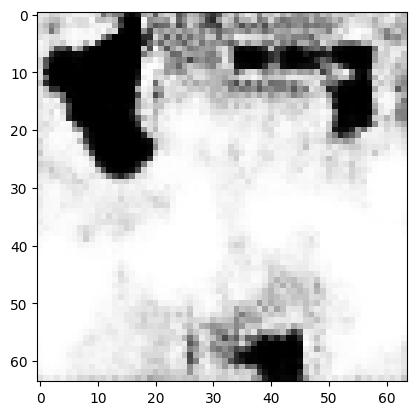

tensor([[1.9718e-05, 8.0407e-05, 2.0176e-04, 1.5157e-04, 2.4228e-03, 1.7210e-02,
         3.1982e-04, 1.2444e-03, 5.0114e-02, 5.9641e-01, 3.5769e-02, 2.8756e-05,
         1.3583e-04, 7.5775e-07, 4.3018e-02, 5.3733e-02, 1.2411e-03, 2.3234e-04,
         3.1443e-04, 1.8758e-02, 2.7652e-05, 7.9316e-03, 3.0220e-02, 2.0600e-03,
         9.2273e-04, 1.6314e-06, 6.8559e-05, 1.0441e-03, 8.9025e-03, 6.1330e-02,
         2.1698e-04, 2.2632e-05, 6.0957e-03, 3.9526e-04, 1.2545e-02, 4.4566e-02,
         1.9961e-05, 6.8808e-05, 5.7373e-04, 1.5839e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5168325304985046
tensor([[1.9616e-05, 8.0241e-05, 2.0161e-04, 1.5118e-04, 2.4120e-03, 1.7149e-02,
         3.1971e-04, 1.2429e-03, 5.0043e-02, 5.9672e-01, 3.5841e-02, 2.8623e-05,
         1.3521e-04, 7.5482e-07, 4.2920e-02, 5.3853e-02, 1.2426e-03, 2.3096e-04,
         3.1415e-04, 1.8734e-02, 2.7526e-05, 7.9477e-03, 3.0156e-02, 2.0568e-03,
         9.1995e-04, 1.6205e-06, 6.8420e-05

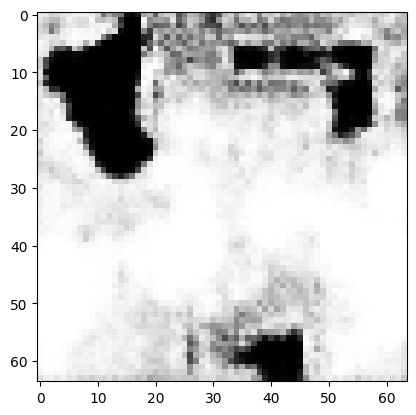

tensor([[1.9475e-05, 7.9687e-05, 1.9991e-04, 1.4950e-04, 2.3863e-03, 1.6990e-02,
         3.1878e-04, 1.2376e-03, 4.9923e-02, 5.9794e-01, 3.5906e-02, 2.8310e-05,
         1.3430e-04, 7.4694e-07, 4.2585e-02, 5.3872e-02, 1.2559e-03, 2.2763e-04,
         3.1070e-04, 1.8502e-02, 2.7131e-05, 8.0199e-03, 3.0189e-02, 2.0468e-03,
         9.1134e-04, 1.5933e-06, 6.7811e-05, 1.0431e-03, 8.9774e-03, 6.0751e-02,
         2.1478e-04, 2.2526e-05, 6.1073e-03, 3.9240e-04, 1.2480e-02, 4.4479e-02,
         1.9862e-05, 6.8131e-05, 5.6836e-04, 1.5441e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5142624378204346
tensor([[1.9350e-05, 7.9456e-05, 1.9980e-04, 1.4926e-04, 2.3744e-03, 1.6930e-02,
         3.1861e-04, 1.2399e-03, 4.9849e-02, 5.9824e-01, 3.6005e-02, 2.8171e-05,
         1.3366e-04, 7.4384e-07, 4.2517e-02, 5.3977e-02, 1.2580e-03, 2.2639e-04,
         3.1025e-04, 1.8504e-02, 2.7036e-05, 8.0352e-03, 3.0108e-02, 2.0459e-03,
         9.0762e-04, 1.5849e-06, 6.7600e-05

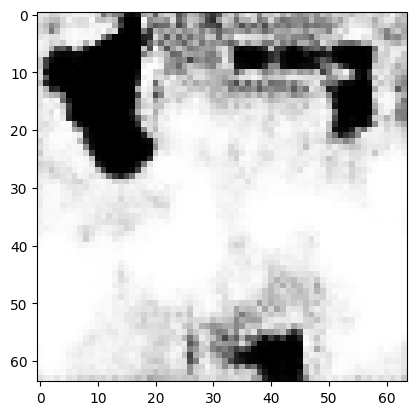

tensor([[1.9159e-05, 7.8879e-05, 1.9830e-04, 1.4733e-04, 2.3455e-03, 1.6741e-02,
         3.1804e-04, 1.2343e-03, 4.9687e-02, 5.9938e-01, 3.6126e-02, 2.7865e-05,
         1.3229e-04, 7.3557e-07, 4.2200e-02, 5.4052e-02, 1.2693e-03, 2.2285e-04,
         3.0772e-04, 1.8298e-02, 2.6632e-05, 8.1031e-03, 3.0097e-02, 2.0364e-03,
         8.9937e-04, 1.5552e-06, 6.7002e-05, 1.0413e-03, 9.0428e-03, 6.0181e-02,
         2.1220e-04, 2.2391e-05, 6.1092e-03, 3.8952e-04, 1.2431e-02, 4.4392e-02,
         1.9740e-05, 6.7359e-05, 5.6406e-04, 1.5068e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5118526816368103
tensor([[1.9127e-05, 7.8672e-05, 1.9787e-04, 1.4658e-04, 2.3390e-03, 1.6703e-02,
         3.1803e-04, 1.2317e-03, 4.9687e-02, 5.9972e-01, 3.6157e-02, 2.7818e-05,
         1.3192e-04, 7.3420e-07, 4.2111e-02, 5.3994e-02, 1.2740e-03, 2.2239e-04,
         3.0695e-04, 1.8204e-02, 2.6527e-05, 8.1149e-03, 3.0172e-02, 2.0316e-03,
         8.9877e-04, 1.5483e-06, 6.6857e-05

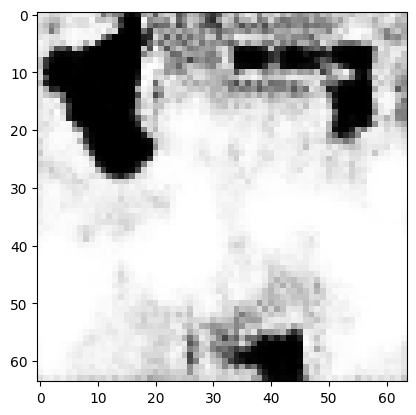

tensor([[1.8818e-05, 7.8000e-05, 1.9648e-04, 1.4380e-04, 2.2893e-03, 1.6403e-02,
         3.1769e-04, 1.2266e-03, 4.9573e-02, 6.0101e-01, 3.6446e-02, 2.7445e-05,
         1.2990e-04, 7.2414e-07, 4.1731e-02, 5.4034e-02, 1.2950e-03, 2.1796e-04,
         3.0495e-04, 1.8006e-02, 2.6056e-05, 8.2223e-03, 3.0117e-02, 2.0242e-03,
         8.8601e-04, 1.5081e-06, 6.6294e-05, 1.0400e-03, 9.1677e-03, 5.9494e-02,
         2.0966e-04, 2.2217e-05, 6.1046e-03, 3.8649e-04, 1.2420e-02, 4.4253e-02,
         1.9700e-05, 6.6475e-05, 5.6027e-04, 1.4592e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5091387033462524
tensor([[1.8773e-05, 7.7836e-05, 1.9607e-04, 1.4297e-04, 2.2819e-03, 1.6349e-02,
         3.1748e-04, 1.2245e-03, 4.9550e-02, 6.0134e-01, 3.6481e-02, 2.7409e-05,
         1.2937e-04, 7.2271e-07, 4.1651e-02, 5.4001e-02, 1.2991e-03, 2.1731e-04,
         3.0448e-04, 1.7924e-02, 2.5963e-05, 8.2363e-03, 3.0150e-02, 2.0208e-03,
         8.8526e-04, 1.5010e-06, 6.6150e-05

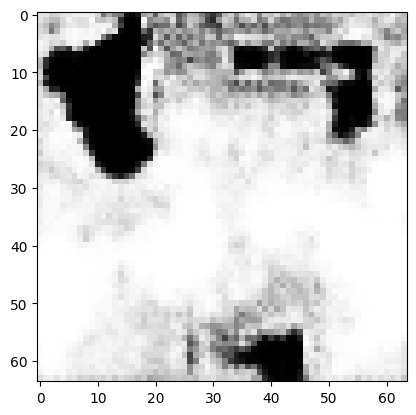

tensor([[1.8613e-05, 7.7252e-05, 1.9425e-04, 1.4012e-04, 2.2588e-03, 1.6136e-02,
         3.1658e-04, 1.2190e-03, 4.9395e-02, 6.0252e-01, 3.6517e-02, 2.7281e-05,
         1.2756e-04, 7.1599e-07, 4.1353e-02, 5.3989e-02, 1.3093e-03, 2.1474e-04,
         3.0250e-04, 1.7661e-02, 2.5632e-05, 8.2874e-03, 3.0127e-02, 2.0154e-03,
         8.8007e-04, 1.4739e-06, 6.5471e-05, 1.0340e-03, 9.2206e-03, 5.9127e-02,
         2.0854e-04, 2.2085e-05, 6.0988e-03, 3.8350e-04, 1.2458e-02, 4.4198e-02,
         1.9595e-05, 6.5754e-05, 5.5519e-04, 1.4316e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5066385269165039
tensor([[1.8562e-05, 7.7043e-05, 1.9382e-04, 1.3944e-04, 2.2506e-03, 1.6087e-02,
         3.1615e-04, 1.2207e-03, 4.9371e-02, 6.0282e-01, 3.6542e-02, 2.7231e-05,
         1.2715e-04, 7.1464e-07, 4.1321e-02, 5.3873e-02, 1.3117e-03, 2.1426e-04,
         3.0166e-04, 1.7601e-02, 2.5574e-05, 8.2989e-03, 3.0154e-02, 2.0137e-03,
         8.7901e-04, 1.4699e-06, 6.5228e-05

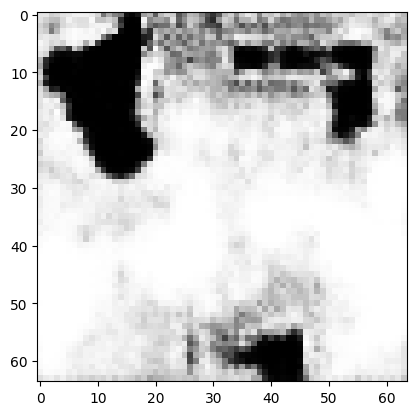

tensor([[1.8421e-05, 7.6448e-05, 1.9221e-04, 1.3641e-04, 2.2233e-03, 1.5900e-02,
         3.1427e-04, 1.2169e-03, 4.9207e-02, 6.0396e-01, 3.6541e-02, 2.7042e-05,
         1.2564e-04, 7.0884e-07, 4.1027e-02, 5.3807e-02, 1.3150e-03, 2.1150e-04,
         2.9864e-04, 1.7359e-02, 2.5242e-05, 8.3384e-03, 3.0075e-02, 2.0034e-03,
         8.7407e-04, 1.4435e-06, 6.4479e-05, 1.0266e-03, 9.2779e-03, 5.8987e-02,
         2.0751e-04, 2.1819e-05, 6.1059e-03, 3.8149e-04, 1.2514e-02, 4.4094e-02,
         1.9480e-05, 6.5261e-05, 5.5228e-04, 1.4046e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.504243791103363
tensor([[1.8393e-05, 7.6292e-05, 1.9181e-04, 1.3565e-04, 2.2176e-03, 1.5866e-02,
         3.1380e-04, 1.2152e-03, 4.9187e-02, 6.0422e-01, 3.6532e-02, 2.7000e-05,
         1.2528e-04, 7.0749e-07, 4.0952e-02, 5.3789e-02, 1.3156e-03, 2.1091e-04,
         2.9785e-04, 1.7293e-02, 2.5155e-05, 8.3440e-03, 3.0066e-02, 1.9998e-03,
         8.7331e-04, 1.4372e-06, 6.4305e-05,

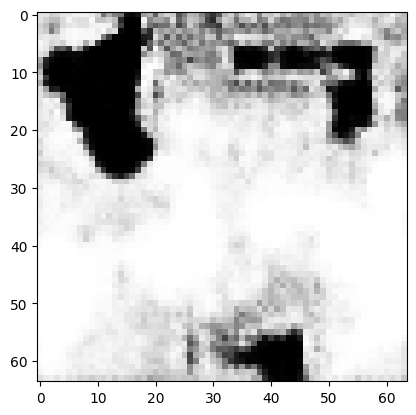

tensor([[1.8239e-05, 7.5605e-05, 1.9052e-04, 1.3310e-04, 2.1916e-03, 1.5718e-02,
         3.1182e-04, 1.2106e-03, 4.9123e-02, 6.0550e-01, 3.6486e-02, 2.6696e-05,
         1.2435e-04, 7.0137e-07, 4.0587e-02, 5.3634e-02, 1.3181e-03, 2.0773e-04,
         2.9378e-04, 1.7076e-02, 2.4812e-05, 8.3817e-03, 3.0015e-02, 1.9826e-03,
         8.6815e-04, 1.4124e-06, 6.3611e-05, 1.0203e-03, 9.3240e-03, 5.8876e-02,
         2.0643e-04, 2.1520e-05, 6.1117e-03, 3.7943e-04, 1.2521e-02, 4.3967e-02,
         1.9350e-05, 6.4909e-05, 5.4815e-04, 1.3795e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5017048716545105
tensor([[1.8160e-05, 7.5288e-05, 1.9017e-04, 1.3240e-04, 2.1854e-03, 1.5668e-02,
         3.1081e-04, 1.2060e-03, 4.9172e-02, 6.0613e-01, 3.6449e-02, 2.6577e-05,
         1.2398e-04, 6.9936e-07, 4.0454e-02, 5.3494e-02, 1.3173e-03, 2.0618e-04,
         2.9217e-04, 1.6993e-02, 2.4699e-05, 8.3867e-03, 3.0042e-02, 1.9721e-03,
         8.6718e-04, 1.4066e-06, 6.3393e-05

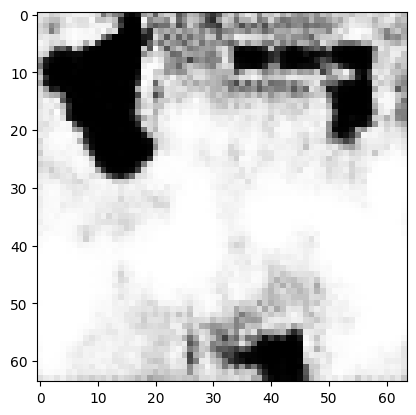

tensor([[1.7556e-05, 7.2894e-05, 1.8876e-04, 1.3082e-04, 2.1771e-03, 1.5392e-02,
         3.0461e-04, 1.1666e-03, 5.0134e-02, 6.1123e-01, 3.5935e-02, 2.5675e-05,
         1.2324e-04, 6.8943e-07, 3.9439e-02, 5.1745e-02, 1.3114e-03, 1.9402e-04,
         2.7956e-04, 1.6479e-02, 2.4145e-05, 8.4276e-03, 3.0597e-02, 1.8871e-03,
         8.6466e-04, 1.4011e-06, 6.2304e-05, 1.0259e-03, 9.1782e-03, 5.7855e-02,
         2.0648e-04, 2.0914e-05, 6.0675e-03, 3.7557e-04, 1.2273e-02, 4.2821e-02,
         1.9128e-05, 6.4573e-05, 5.3415e-04, 1.3464e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4922802746295929
tensor([[1.7324e-05, 7.2051e-05, 1.8848e-04, 1.3066e-04, 2.1777e-03, 1.5294e-02,
         3.0251e-04, 1.1551e-03, 5.0488e-02, 6.1307e-01, 3.5729e-02, 2.5388e-05,
         1.2300e-04, 6.8617e-07, 3.9103e-02, 5.1104e-02, 1.3071e-03, 1.8975e-04,
         2.7548e-04, 1.6337e-02, 2.4009e-05, 8.4398e-03, 3.0754e-02, 1.8609e-03,
         8.6372e-04, 1.4041e-06, 6.1944e-05

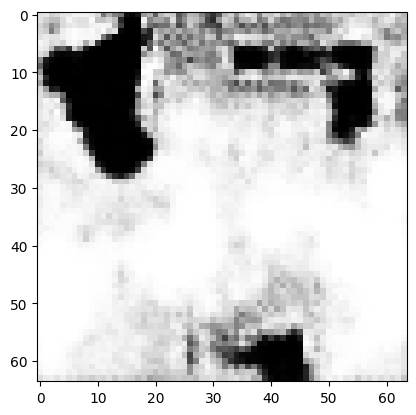

tensor([[1.6315e-05, 6.8529e-05, 1.8764e-04, 1.2957e-04, 2.1809e-03, 1.4857e-02,
         2.9288e-04, 1.0977e-03, 5.1894e-02, 6.2098e-01, 3.4813e-02, 2.4141e-05,
         1.2161e-04, 6.7017e-07, 3.7565e-02, 4.8797e-02, 1.2788e-03, 1.7169e-04,
         2.5905e-04, 1.5760e-02, 2.3343e-05, 8.4598e-03, 3.1195e-02, 1.7465e-03,
         8.5760e-04, 1.4034e-06, 6.0544e-05, 1.0386e-03, 8.8088e-03, 5.6213e-02,
         2.0725e-04, 1.9847e-05, 5.9770e-03, 3.6973e-04, 1.1798e-02, 4.0815e-02,
         1.8619e-05, 6.3471e-05, 5.1276e-04, 1.3172e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4764578342437744
tensor([[1.6071e-05, 6.7622e-05, 1.8747e-04, 1.2935e-04, 2.1843e-03, 1.4748e-02,
         2.9010e-04, 1.0822e-03, 5.2294e-02, 6.2316e-01, 3.4549e-02, 2.3826e-05,
         1.2140e-04, 6.6657e-07, 3.7135e-02, 4.8173e-02, 1.2720e-03, 1.6701e-04,
         2.5447e-04, 1.5593e-02, 2.3176e-05, 8.4674e-03, 3.1336e-02, 1.7154e-03,
         8.5611e-04, 1.4054e-06, 6.0207e-05

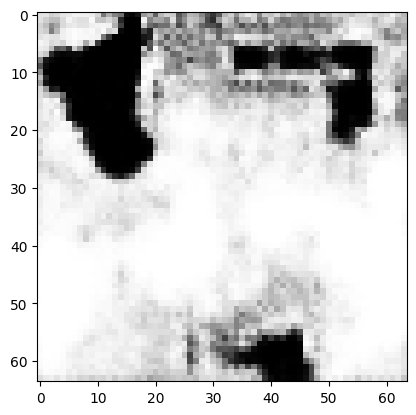

tensor([[1.4988e-05, 6.4503e-05, 1.8761e-04, 1.2868e-04, 2.1561e-03, 1.4233e-02,
         2.8120e-04, 1.0346e-03, 5.3492e-02, 6.3061e-01, 3.3992e-02, 2.2424e-05,
         1.1941e-04, 6.4702e-07, 3.5582e-02, 4.6541e-02, 1.2456e-03, 1.4965e-04,
         2.4028e-04, 1.5228e-02, 2.2408e-05, 8.5496e-03, 3.1271e-02, 1.6155e-03,
         8.3621e-04, 1.3872e-06, 5.8868e-05, 1.0558e-03, 8.4751e-03, 5.4410e-02,
         2.0629e-04, 1.8718e-05, 5.8696e-03, 3.6409e-04, 1.1226e-02, 3.8841e-02,
         1.8042e-05, 6.1681e-05, 4.9270e-04, 1.2823e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.46106642484664917
tensor([[1.4803e-05, 6.3694e-05, 1.8743e-04, 1.2864e-04, 2.1586e-03, 1.4156e-02,
         2.7876e-04, 1.0219e-03, 5.3920e-02, 6.3262e-01, 3.3751e-02, 2.2164e-05,
         1.1931e-04, 6.4423e-07, 3.5184e-02, 4.5934e-02, 1.2418e-03, 1.4595e-04,
         2.3603e-04, 1.5060e-02, 2.2260e-05, 8.5648e-03, 3.1443e-02, 1.5879e-03,
         8.3394e-04, 1.3926e-06, 5.8535e-0

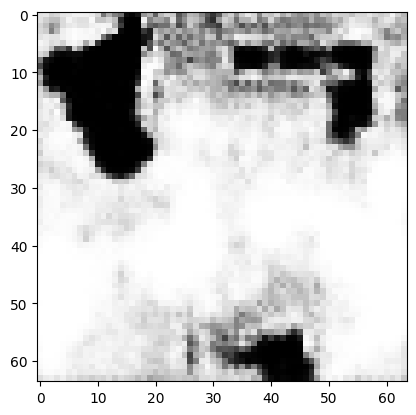

tensor([[1.3902e-05, 6.0963e-05, 1.8759e-04, 1.2797e-04, 2.1337e-03, 1.3692e-02,
         2.7033e-04, 9.8011e-04, 5.4863e-02, 6.3946e-01, 3.3126e-02, 2.0936e-05,
         1.1773e-04, 6.2526e-07, 3.3797e-02, 4.4584e-02, 1.2075e-03, 1.3193e-04,
         2.2379e-04, 1.4763e-02, 2.1580e-05, 8.6116e-03, 3.1187e-02, 1.5032e-03,
         8.1424e-04, 1.3725e-06, 5.7260e-05, 1.0710e-03, 8.1593e-03, 5.2843e-02,
         2.0525e-04, 1.7688e-05, 5.7738e-03, 3.5858e-04, 1.0706e-02, 3.7108e-02,
         1.7481e-05, 5.9978e-05, 4.7443e-04, 1.2526e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.44713887572288513
tensor([[1.3730e-05, 6.0360e-05, 1.8754e-04, 1.2783e-04, 2.1309e-03, 1.3608e-02,
         2.6834e-04, 9.7124e-04, 5.5090e-02, 6.4100e-01, 3.2963e-02, 2.0694e-05,
         1.1749e-04, 6.2166e-07, 3.3490e-02, 4.4247e-02, 1.2007e-03, 1.2915e-04,
         2.2091e-04, 1.4676e-02, 2.1442e-05, 8.6183e-03, 3.1175e-02, 1.4838e-03,
         8.1072e-04, 1.3707e-06, 5.6973e-0

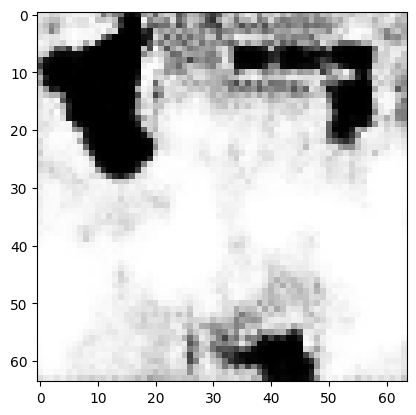

tensor([[1.3175e-05, 5.8723e-05, 1.8729e-04, 1.2645e-04, 2.1139e-03, 1.3268e-02,
         2.6213e-04, 9.4816e-04, 5.5418e-02, 6.4572e-01, 3.2534e-02, 2.0001e-05,
         1.1591e-04, 6.0959e-07, 3.2564e-02, 4.3592e-02, 1.1749e-03, 1.2054e-04,
         2.1326e-04, 1.4462e-02, 2.0989e-05, 8.6471e-03, 3.0754e-02, 1.4351e-03,
         7.9684e-04, 1.3532e-06, 5.5956e-05, 1.0767e-03, 7.9170e-03, 5.1934e-02,
         2.0438e-04, 1.6934e-05, 5.6896e-03, 3.5460e-04, 1.0365e-02, 3.6045e-02,
         1.6988e-05, 5.8390e-05, 4.6233e-04, 1.2380e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.43739446997642517
tensor([[1.3034e-05, 5.8403e-05, 1.8742e-04, 1.2613e-04, 2.1052e-03, 1.3176e-02,
         2.6085e-04, 9.4608e-04, 5.5409e-02, 6.4671e-01, 3.2493e-02, 1.9827e-05,
         1.1545e-04, 6.0650e-07, 3.2387e-02, 4.3513e-02, 1.1691e-03, 1.1864e-04,
         2.1187e-04, 1.4458e-02, 2.0894e-05, 8.6580e-03, 3.0569e-02, 1.4273e-03,
         7.9241e-04, 1.3473e-06, 5.5706e-0

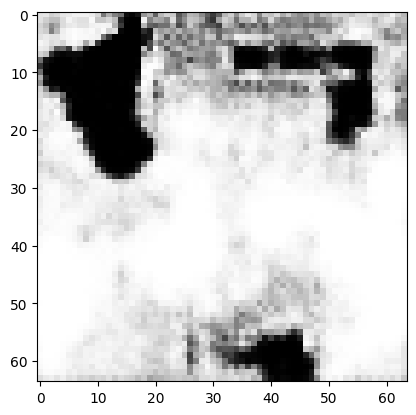

tensor([[1.2673e-05, 5.7500e-05, 1.8733e-04, 1.2455e-04, 2.0882e-03, 1.2909e-02,
         2.5662e-04, 9.3619e-04, 5.5329e-02, 6.5003e-01, 3.2240e-02, 1.9405e-05,
         1.1393e-04, 5.9870e-07, 3.1793e-02, 4.3218e-02, 1.1491e-03, 1.1289e-04,
         2.0738e-04, 1.4350e-02, 2.0587e-05, 8.6859e-03, 3.0048e-02, 1.4015e-03,
         7.8215e-04, 1.3324e-06, 5.4878e-05, 1.0778e-03, 7.7449e-03, 5.1448e-02,
         2.0343e-04, 1.6318e-05, 5.5958e-03, 3.5292e-04, 1.0181e-02, 3.5487e-02,
         1.6615e-05, 5.6882e-05, 4.5774e-04, 1.2313e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.43073558807373047
tensor([[1.2585e-05, 5.7289e-05, 1.8736e-04, 1.2416e-04, 2.0832e-03, 1.2844e-02,
         2.5562e-04, 9.3414e-04, 5.5295e-02, 6.5076e-01, 3.2192e-02, 1.9303e-05,
         1.1355e-04, 5.9670e-07, 3.1669e-02, 4.3173e-02, 1.1441e-03, 1.1165e-04,
         2.0645e-04, 1.4332e-02, 2.0520e-05, 8.6891e-03, 2.9914e-02, 1.3960e-03,
         7.7974e-04, 1.3279e-06, 5.4692e-0

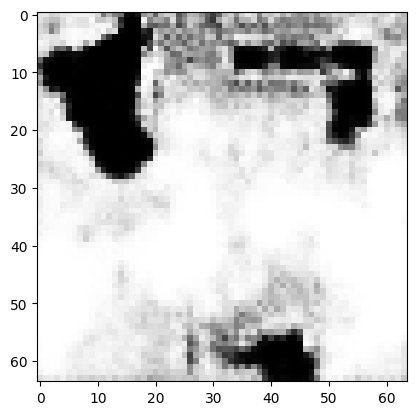

tensor([[1.2134e-05, 5.5777e-05, 1.8805e-04, 1.2291e-04, 2.0705e-03, 1.2549e-02,
         2.4974e-04, 9.1436e-04, 5.5520e-02, 6.5524e-01, 3.1712e-02, 1.8784e-05,
         1.1269e-04, 5.8749e-07, 3.0989e-02, 4.2467e-02, 1.1207e-03, 1.0536e-04,
         1.9970e-04, 1.4127e-02, 2.0225e-05, 8.6847e-03, 2.9689e-02, 1.3551e-03,
         7.6914e-04, 1.3156e-06, 5.3863e-05, 1.0812e-03, 7.5420e-03, 5.0653e-02,
         2.0234e-04, 1.5694e-05, 5.4820e-03, 3.4984e-04, 9.9521e-03, 3.4638e-02,
         1.6241e-05, 5.5291e-05, 4.4989e-04, 1.2167e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4227583706378937
tensor([[1.2024e-05, 5.5409e-05, 1.8835e-04, 1.2272e-04, 2.0678e-03, 1.2473e-02,
         2.4833e-04, 9.0838e-04, 5.5592e-02, 6.5650e-01, 3.1566e-02, 1.8651e-05,
         1.1264e-04, 5.8548e-07, 3.0791e-02, 4.2255e-02, 1.1149e-03, 1.0363e-04,
         1.9793e-04, 1.4069e-02, 2.0150e-05, 8.6897e-03, 2.9654e-02, 1.3440e-03,
         7.6662e-04, 1.3135e-06, 5.3705e-05

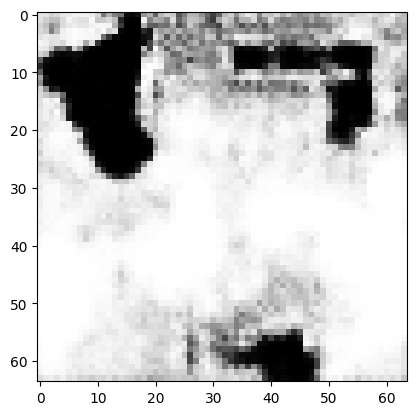

tensor([[1.1450e-05, 5.3310e-05, 1.9004e-04, 1.2200e-04, 2.0554e-03, 1.2121e-02,
         2.4099e-04, 8.7673e-04, 5.6172e-02, 6.6256e-01, 3.0832e-02, 1.7969e-05,
         1.1245e-04, 5.7413e-07, 2.9887e-02, 4.1072e-02, 1.0860e-03, 9.5835e-05,
         1.8908e-04, 1.3791e-02, 1.9804e-05, 8.6763e-03, 2.9625e-02, 1.2853e-03,
         7.5451e-04, 1.3035e-06, 5.2948e-05, 1.0934e-03, 7.2798e-03, 4.9210e-02,
         2.0112e-04, 1.4930e-05, 5.3319e-03, 3.4543e-04, 9.5938e-03, 3.3329e-02,
         1.5858e-05, 5.3372e-05, 4.3773e-04, 1.1908e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.41164153814315796
tensor([[1.1213e-05, 5.2357e-05, 1.9098e-04, 1.2198e-04, 2.0515e-03, 1.1984e-02,
         2.3794e-04, 8.6120e-04, 5.6557e-02, 6.6518e-01, 3.0486e-02, 1.7682e-05,
         1.1264e-04, 5.6951e-07, 2.9498e-02, 4.0445e-02, 1.0745e-03, 9.2652e-05,
         1.8527e-04, 1.3660e-02, 1.9670e-05, 8.6674e-03, 2.9718e-02, 1.2582e-03,
         7.5028e-04, 1.3024e-06, 5.2739e-0

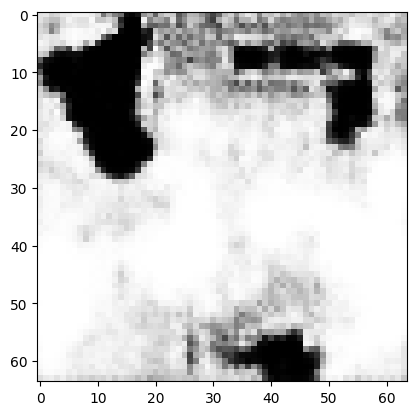

tensor([[1.0427e-05, 4.9136e-05, 1.9396e-04, 1.2167e-04, 2.0407e-03, 1.1522e-02,
         2.2725e-04, 8.1017e-04, 5.7789e-02, 6.7407e-01, 2.9261e-02, 1.6727e-05,
         1.1318e-04, 5.5304e-07, 2.8193e-02, 3.8404e-02, 1.0312e-03, 8.2612e-05,
         1.7249e-04, 1.3218e-02, 1.9215e-05, 8.6100e-03, 2.9948e-02, 1.1695e-03,
         7.3523e-04, 1.2958e-06, 5.1860e-05, 1.1177e-03, 6.8765e-03, 4.6774e-02,
         1.9934e-04, 1.3802e-05, 5.1076e-03, 3.3705e-04, 9.0059e-03, 3.1077e-02,
         1.5336e-05, 5.0756e-05, 4.1662e-04, 1.1462e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3944210410118103
tensor([[1.0238e-05, 4.8354e-05, 1.9477e-04, 1.2168e-04, 2.0383e-03, 1.1407e-02,
         2.2460e-04, 7.9736e-04, 5.8097e-02, 6.7634e-01, 2.8945e-02, 1.6487e-05,
         1.1340e-04, 5.4906e-07, 2.7857e-02, 3.7889e-02, 1.0199e-03, 8.0155e-05,
         1.6934e-04, 1.3107e-02, 1.9099e-05, 8.5959e-03, 3.0007e-02, 1.1474e-03,
         7.3152e-04, 1.2948e-06, 5.1658e-05

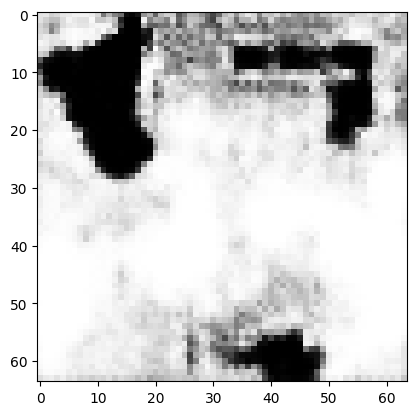

tensor([[9.6745e-06, 4.6001e-05, 1.9676e-04, 1.2128e-04, 2.0323e-03, 1.1049e-02,
         2.1571e-04, 7.6135e-04, 5.8859e-02, 6.8320e-01, 2.7947e-02, 1.5759e-05,
         1.1384e-04, 5.3556e-07, 2.6884e-02, 3.6482e-02, 9.7944e-04, 7.3221e-05,
         1.5970e-04, 1.2794e-02, 1.8750e-05, 8.5234e-03, 2.9974e-02, 1.0844e-03,
         7.1786e-04, 1.2864e-06, 5.0775e-05, 1.1345e-03, 6.5423e-03, 4.5022e-02,
         1.9771e-04, 1.2890e-05, 4.9293e-03, 3.3013e-04, 8.5469e-03, 2.9394e-02,
         1.4835e-05, 4.8556e-05, 3.9985e-04, 1.1161e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3809673488140106
tensor([[9.5768e-06, 4.5598e-05, 1.9705e-04, 1.2119e-04, 2.0323e-03, 1.0976e-02,
         2.1396e-04, 7.5535e-04, 5.8934e-02, 6.8449e-01, 2.7744e-02, 1.5622e-05,
         1.1389e-04, 5.3295e-07, 2.6705e-02, 3.6270e-02, 9.6923e-04, 7.1958e-05,
         1.5796e-04, 1.2744e-02, 1.8684e-05, 8.5054e-03, 2.9891e-02, 1.0739e-03,
         7.1518e-04, 1.2838e-06, 5.0563e-05

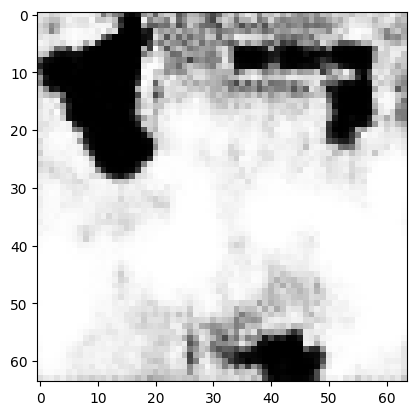

tensor([[9.2725e-06, 4.4197e-05, 1.9770e-04, 1.2068e-04, 2.0402e-03, 1.0744e-02,
         2.0743e-04, 7.3623e-04, 5.9153e-02, 6.8902e-01, 2.6988e-02, 1.5202e-05,
         1.1423e-04, 5.2494e-07, 2.6102e-02, 3.5469e-02, 9.3298e-04, 6.8054e-05,
         1.5163e-04, 1.2539e-02, 1.8495e-05, 8.4187e-03, 2.9663e-02, 1.0378e-03,
         7.0738e-04, 1.2800e-06, 4.9707e-05, 1.1382e-03, 6.3003e-03, 4.4328e-02,
         1.9706e-04, 1.2275e-05, 4.8283e-03, 3.2592e-04, 8.2940e-03, 2.8469e-02,
         1.4392e-05, 4.7155e-05, 3.8969e-04, 1.1095e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.37249183654785156
tensor([[9.2079e-06, 4.3910e-05, 1.9778e-04, 1.2053e-04, 2.0421e-03, 1.0696e-02,
         2.0596e-04, 7.3298e-04, 5.9163e-02, 6.8994e-01, 2.6839e-02, 1.5118e-05,
         1.1424e-04, 5.2323e-07, 2.5989e-02, 3.5327e-02, 9.2506e-04, 6.7300e-05,
         1.5031e-04, 1.2500e-02, 1.8461e-05, 8.3976e-03, 2.9590e-02, 1.0310e-03,
         7.0554e-04, 1.2791e-06, 4.9495e-0

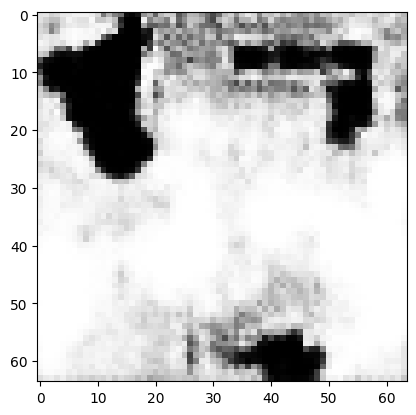

tensor([[8.9898e-06, 4.3012e-05, 1.9809e-04, 1.2002e-04, 2.0480e-03, 1.0520e-02,
         2.0134e-04, 7.2126e-04, 5.9118e-02, 6.9312e-01, 2.6320e-02, 1.4818e-05,
         1.1430e-04, 5.1688e-07, 2.5572e-02, 3.4930e-02, 8.9683e-04, 6.4608e-05,
         1.4619e-04, 1.2393e-02, 1.8318e-05, 8.3345e-03, 2.9241e-02, 1.0087e-03,
         6.9853e-04, 1.2721e-06, 4.8804e-05, 1.1370e-03, 6.1202e-03, 4.3980e-02,
         1.9649e-04, 1.1824e-05, 4.7568e-03, 3.2304e-04, 8.1248e-03, 2.7893e-02,
         1.4020e-05, 4.6022e-05, 3.8290e-04, 1.1094e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.36654603481292725
tensor([[8.9473e-06, 4.2833e-05, 1.9810e-04, 1.1984e-04, 2.0496e-03, 1.0483e-02,
         2.0032e-04, 7.1890e-04, 5.9097e-02, 6.9377e-01, 2.6220e-02, 1.4764e-05,
         1.1427e-04, 5.1563e-07, 2.5489e-02, 3.4865e-02, 8.9189e-04, 6.4081e-05,
         1.4532e-04, 1.2366e-02, 1.8289e-05, 8.3233e-03, 2.9172e-02, 1.0043e-03,
         6.9678e-04, 1.2703e-06, 4.8656e-0

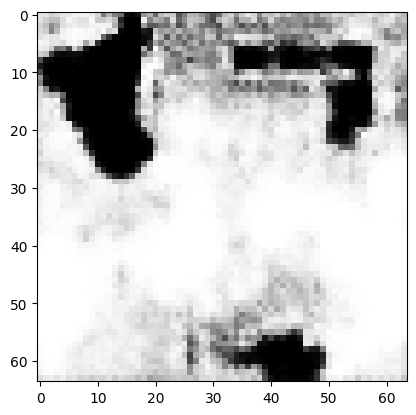

tensor([[8.7851e-06, 4.2249e-05, 1.9813e-04, 1.1930e-04, 2.0508e-03, 1.0341e-02,
         1.9713e-04, 7.1178e-04, 5.8945e-02, 6.9601e-01, 2.5892e-02, 1.4552e-05,
         1.1408e-04, 5.1057e-07, 2.5211e-02, 3.4664e-02, 8.7243e-04, 6.2173e-05,
         1.4266e-04, 1.2307e-02, 1.8171e-05, 8.2884e-03, 2.8844e-02, 9.9068e-04,
         6.9048e-04, 1.2622e-06, 4.8124e-05, 1.1350e-03, 5.9968e-03, 4.3752e-02,
         1.9591e-04, 1.1509e-05, 4.7028e-03, 3.2120e-04, 8.0073e-03, 2.7548e-02,
         1.3744e-05, 4.5094e-05, 3.7842e-04, 1.1084e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3623923659324646
tensor([[8.7702e-06, 4.2133e-05, 1.9806e-04, 1.1913e-04, 2.0539e-03, 1.0324e-02,
         1.9638e-04, 7.1046e-04, 5.8920e-02, 6.9650e-01, 2.5807e-02, 1.4534e-05,
         1.1412e-04, 5.1021e-07, 2.5153e-02, 3.4587e-02, 8.6932e-04, 6.1884e-05,
         1.4200e-04, 1.2274e-02, 1.8161e-05, 8.2782e-03, 2.8823e-02, 9.8758e-04,
         6.8992e-04, 1.2632e-06, 4.8012e-05

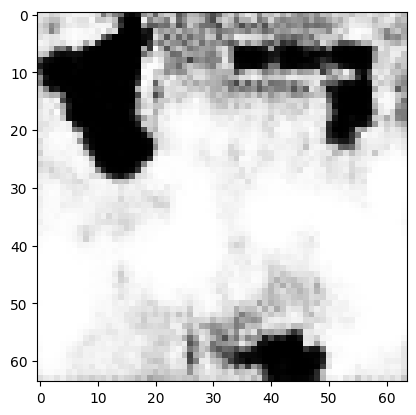

tensor([[8.6633e-06, 4.1739e-05, 1.9788e-04, 1.1849e-04, 2.0567e-03, 1.0215e-02,
         1.9380e-04, 7.0574e-04, 5.8706e-02, 6.9826e-01, 2.5549e-02, 1.4393e-05,
         1.1393e-04, 5.0667e-07, 2.4944e-02, 3.4449e-02, 8.5405e-04, 6.0496e-05,
         1.3998e-04, 1.2223e-02, 1.8073e-05, 8.2510e-03, 2.8538e-02, 9.7815e-04,
         6.8521e-04, 1.2576e-06, 4.7577e-05, 1.1325e-03, 5.8999e-03, 4.3616e-02,
         1.9585e-04, 1.1285e-05, 4.6632e-03, 3.2000e-04, 7.9336e-03, 2.7310e-02,
         1.3543e-05, 4.4419e-05, 3.7532e-04, 1.1096e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3591597378253937
tensor([[8.6470e-06, 4.1653e-05, 1.9780e-04, 1.1833e-04, 2.0587e-03, 1.0196e-02,
         1.9317e-04, 7.0494e-04, 5.8663e-02, 6.9864e-01, 2.5488e-02, 1.4373e-05,
         1.1393e-04, 5.0618e-07, 2.4903e-02, 3.4411e-02, 8.5129e-04, 6.0252e-05,
         1.3947e-04, 1.2203e-02, 1.8063e-05, 8.2438e-03, 2.8497e-02, 9.7609e-04,
         6.8436e-04, 1.2575e-06, 4.7474e-05

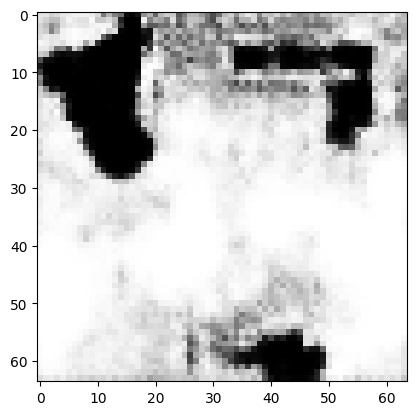

tensor([[8.5548e-06, 4.1376e-05, 1.9762e-04, 1.1773e-04, 2.0590e-03, 1.0102e-02,
         1.9109e-04, 7.0173e-04, 5.8411e-02, 7.0003e-01, 2.5309e-02, 1.4253e-05,
         1.1364e-04, 5.0300e-07, 2.4744e-02, 3.4366e-02, 8.3871e-04, 5.9113e-05,
         1.3801e-04, 1.2180e-02, 1.7980e-05, 8.2245e-03, 2.8208e-02, 9.6944e-04,
         6.7970e-04, 1.2504e-06, 4.7108e-05, 1.1296e-03, 5.8231e-03, 4.3549e-02,
         1.9560e-04, 1.1094e-05, 4.6281e-03, 3.1919e-04, 7.8716e-03, 2.7163e-02,
         1.3365e-05, 4.3792e-05, 3.7307e-04, 1.1110e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.35663482546806335
tensor([[8.5482e-06, 4.1321e-05, 1.9749e-04, 1.1755e-04, 2.0612e-03, 1.0091e-02,
         1.9056e-04, 7.0128e-04, 5.8367e-02, 7.0033e-01, 2.5260e-02, 1.4247e-05,
         1.1364e-04, 5.0288e-07, 2.4714e-02, 3.4324e-02, 8.3678e-04, 5.8947e-05,
         1.3759e-04, 1.2159e-02, 1.7976e-05, 8.2190e-03, 2.8187e-02, 9.6787e-04,
         6.7932e-04, 1.2512e-06, 4.7024e-0

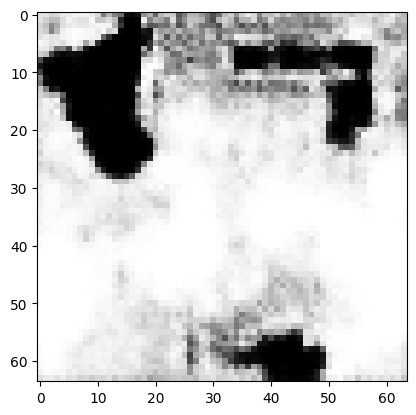

tensor([[8.4922e-06, 4.1141e-05, 1.9722e-04, 1.1703e-04, 2.0635e-03, 1.0023e-02,
         1.8893e-04, 6.9915e-04, 5.8134e-02, 7.0144e-01, 2.5109e-02, 1.4171e-05,
         1.1349e-04, 5.0089e-07, 2.4587e-02, 3.4287e-02, 8.2773e-04, 5.8097e-05,
         1.3642e-04, 1.2127e-02, 1.7918e-05, 8.2072e-03, 2.7975e-02, 9.6309e-04,
         6.7603e-04, 1.2471e-06, 4.6736e-05, 1.1273e-03, 5.7625e-03, 4.3490e-02,
         1.9570e-04, 1.0961e-05, 4.6024e-03, 3.1874e-04, 7.8320e-03, 2.7058e-02,
         1.3241e-05, 4.3328e-05, 3.7150e-04, 1.1124e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3546178936958313
tensor([[8.4649e-06, 4.1079e-05, 1.9716e-04, 1.1690e-04, 2.0621e-03, 9.9991e-03,
         1.8855e-04, 6.9856e-04, 5.8073e-02, 7.0169e-01, 2.5085e-02, 1.4137e-05,
         1.1336e-04, 4.9983e-07, 2.4562e-02, 3.4296e-02, 8.2491e-04, 5.7862e-05,
         1.3619e-04, 1.2132e-02, 1.7893e-05, 8.2030e-03, 2.7899e-02, 9.6203e-04,
         6.7470e-04, 1.2442e-06, 4.6651e-05

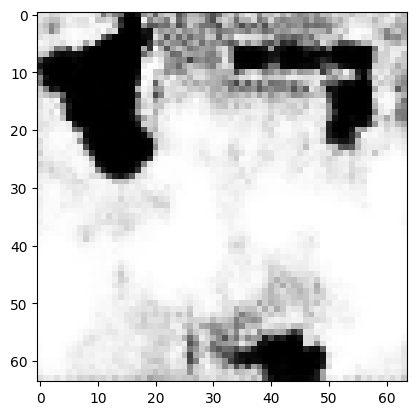

tensor([[8.4250e-06, 4.0935e-05, 1.9683e-04, 1.1644e-04, 2.0639e-03, 9.9412e-03,
         1.8699e-04, 6.9730e-04, 5.7854e-02, 7.0271e-01, 2.4961e-02, 1.4085e-05,
         1.1320e-04, 4.9850e-07, 2.4461e-02, 3.4234e-02, 8.1765e-04, 5.7130e-05,
         1.3512e-04, 1.2093e-02, 1.7850e-05, 8.1958e-03, 2.7738e-02, 9.5789e-04,
         6.7201e-04, 1.2429e-06, 4.6400e-05, 1.1256e-03, 5.7119e-03, 4.3431e-02,
         1.9559e-04, 1.0838e-05, 4.5782e-03, 3.1837e-04, 7.7913e-03, 2.6969e-02,
         1.3127e-05, 4.2874e-05, 3.7029e-04, 1.1130e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.35281696915626526
tensor([[8.4161e-06, 4.0893e-05, 1.9670e-04, 1.1632e-04, 2.0646e-03, 9.9285e-03,
         1.8666e-04, 6.9665e-04, 5.7816e-02, 7.0294e-01, 2.4925e-02, 1.4073e-05,
         1.1317e-04, 4.9811e-07, 2.4436e-02, 3.4202e-02, 8.1587e-04, 5.6978e-05,
         1.3487e-04, 1.2080e-02, 1.7838e-05, 8.1922e-03, 2.7714e-02, 9.5671e-04,
         6.7160e-04, 1.2427e-06, 4.6340e-0

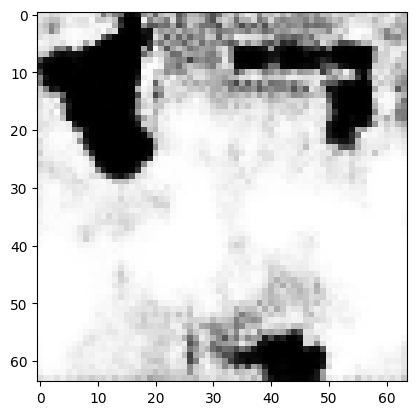

tensor([[8.3712e-06, 4.0747e-05, 1.9632e-04, 1.1586e-04, 2.0648e-03, 9.8727e-03,
         1.8529e-04, 6.9550e-04, 5.7616e-02, 7.0381e-01, 2.4825e-02, 1.4017e-05,
         1.1293e-04, 4.9639e-07, 2.4358e-02, 3.4155e-02, 8.0901e-04, 5.6351e-05,
         1.3397e-04, 1.2055e-02, 1.7792e-05, 8.1828e-03, 2.7559e-02, 9.5331e-04,
         6.6880e-04, 1.2400e-06, 4.6090e-05, 1.1237e-03, 5.6685e-03, 4.3387e-02,
         1.9556e-04, 1.0732e-05, 4.5582e-03, 3.1798e-04, 7.7606e-03, 2.6890e-02,
         1.3031e-05, 4.2502e-05, 3.6913e-04, 1.1137e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.35125312209129333
tensor([[8.3635e-06, 4.0728e-05, 1.9630e-04, 1.1579e-04, 2.0649e-03, 9.8604e-03,
         1.8504e-04, 6.9525e-04, 5.7559e-02, 7.0401e-01, 2.4802e-02, 1.4002e-05,
         1.1291e-04, 4.9608e-07, 2.4330e-02, 3.4164e-02, 8.0751e-04, 5.6184e-05,
         1.3379e-04, 1.2051e-02, 1.7779e-05, 8.1829e-03, 2.7511e-02, 9.5256e-04,
         6.6810e-04, 1.2391e-06, 4.6050e-0

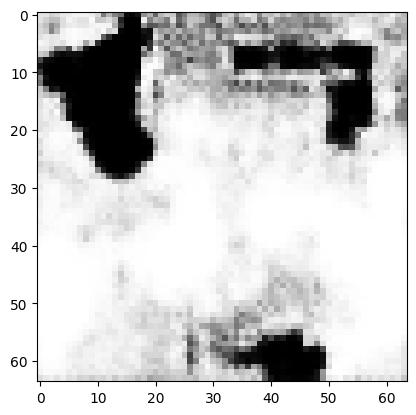

tensor([[8.3196e-06, 4.0607e-05, 1.9600e-04, 1.1542e-04, 2.0636e-03, 9.8057e-03,
         1.8390e-04, 6.9456e-04, 5.7359e-02, 7.0478e-01, 2.4723e-02, 1.3942e-05,
         1.1269e-04, 4.9436e-07, 2.4258e-02, 3.4139e-02, 8.0123e-04, 5.5589e-05,
         1.3304e-04, 1.2038e-02, 1.7733e-05, 8.1780e-03, 2.7348e-02, 9.4989e-04,
         6.6518e-04, 1.2358e-06, 4.5828e-05, 1.1225e-03, 5.6328e-03, 4.3345e-02,
         1.9537e-04, 1.0634e-05, 4.5405e-03, 3.1777e-04, 7.7287e-03, 2.6837e-02,
         1.2944e-05, 4.2138e-05, 3.6837e-04, 1.1142e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3498633801937103
tensor([[8.3180e-06, 4.0578e-05, 1.9589e-04, 1.1532e-04, 2.0648e-03, 9.7991e-03,
         1.8358e-04, 6.9454e-04, 5.7323e-02, 7.0497e-01, 2.4697e-02, 1.3942e-05,
         1.1268e-04, 4.9435e-07, 2.4243e-02, 3.4114e-02, 8.0031e-04, 5.5499e-05,
         1.3279e-04, 1.2023e-02, 1.7731e-05, 8.1756e-03, 2.7340e-02, 9.4909e-04,
         6.6492e-04, 1.2366e-06, 4.5774e-05

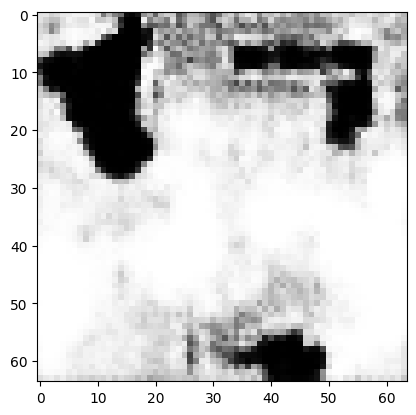

tensor([[8.2841e-06, 4.0457e-05, 1.9553e-04, 1.1503e-04, 2.0642e-03, 9.7525e-03,
         1.8253e-04, 6.9317e-04, 5.7170e-02, 7.0577e-01, 2.4611e-02, 1.3890e-05,
         1.1248e-04, 4.9305e-07, 2.4168e-02, 3.4023e-02, 7.9455e-04, 5.4909e-05,
         1.3204e-04, 1.1992e-02, 1.7682e-05, 8.1713e-03, 2.7240e-02, 9.4552e-04,
         6.6302e-04, 1.2359e-06, 4.5585e-05, 1.1223e-03, 5.5968e-03, 4.3257e-02,
         1.9542e-04, 1.0556e-05, 4.5234e-03, 3.1753e-04, 7.7032e-03, 2.6758e-02,
         1.2882e-05, 4.1870e-05, 3.6750e-04, 1.1141e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3484652638435364
tensor([[8.2684e-06, 4.0424e-05, 1.9545e-04, 1.1496e-04, 2.0632e-03, 9.7364e-03,
         1.8231e-04, 6.9274e-04, 5.7127e-02, 7.0595e-01, 2.4597e-02, 1.3870e-05,
         1.1237e-04, 4.9244e-07, 2.4151e-02, 3.4021e-02, 7.9278e-04, 5.4738e-05,
         1.3191e-04, 1.1991e-02, 1.7663e-05, 8.1708e-03, 2.7196e-02, 9.4484e-04,
         6.6228e-04, 1.2346e-06, 4.5534e-05

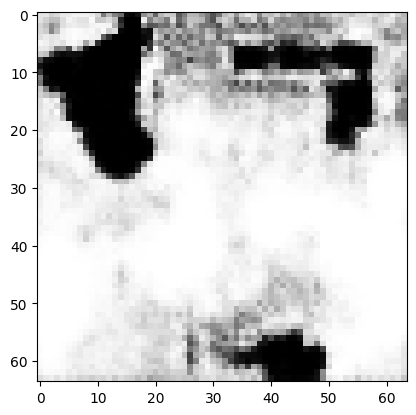

tensor([[8.2483e-06, 4.0321e-05, 1.9510e-04, 1.1467e-04, 2.0635e-03, 9.7019e-03,
         1.8125e-04, 6.9222e-04, 5.6983e-02, 7.0668e-01, 2.4524e-02, 1.3839e-05,
         1.1223e-04, 4.9177e-07, 2.4088e-02, 3.3934e-02, 7.8860e-04, 5.4266e-05,
         1.3114e-04, 1.1952e-02, 1.7632e-05, 8.1673e-03, 2.7131e-02, 9.4164e-04,
         6.6070e-04, 1.2358e-06, 4.5359e-05, 1.1223e-03, 5.5639e-03, 4.3163e-02,
         1.9540e-04, 1.0487e-05, 4.5067e-03, 3.1732e-04, 7.6776e-03, 2.6685e-02,
         1.2825e-05, 4.1609e-05, 3.6680e-04, 1.1136e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34717777371406555
tensor([[8.2337e-06, 4.0289e-05, 1.9503e-04, 1.1460e-04, 2.0622e-03, 9.6866e-03,
         1.8102e-04, 6.9186e-04, 5.6940e-02, 7.0686e-01, 2.4511e-02, 1.3818e-05,
         1.1213e-04, 4.9116e-07, 2.4073e-02, 3.3925e-02, 7.8690e-04, 5.4105e-05,
         1.3101e-04, 1.1953e-02, 1.7614e-05, 8.1662e-03, 2.7088e-02, 9.4094e-04,
         6.5992e-04, 1.2346e-06, 4.5312e-0

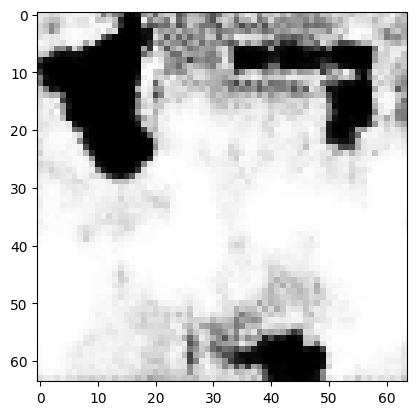

tensor([[8.2060e-06, 4.0183e-05, 1.9469e-04, 1.1437e-04, 2.0616e-03, 9.6491e-03,
         1.8014e-04, 6.9100e-04, 5.6805e-02, 7.0754e-01, 2.4442e-02, 1.3776e-05,
         1.1194e-04, 4.9009e-07, 2.4013e-02, 3.3846e-02, 7.8214e-04, 5.3621e-05,
         1.3037e-04, 1.1924e-02, 1.7573e-05, 8.1624e-03, 2.7011e-02, 9.3794e-04,
         6.5833e-04, 1.2346e-06, 4.5143e-05, 1.1221e-03, 5.5336e-03, 4.3087e-02,
         1.9524e-04, 1.0411e-05, 4.4903e-03, 3.1708e-04, 7.6502e-03, 2.6623e-02,
         1.2764e-05, 4.1353e-05, 3.6599e-04, 1.1136e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34595856070518494
tensor([[8.2066e-06, 4.0164e-05, 1.9459e-04, 1.1432e-04, 2.0624e-03, 9.6449e-03,
         1.7987e-04, 6.9104e-04, 5.6777e-02, 7.0771e-01, 2.4423e-02, 1.3776e-05,
         1.1193e-04, 4.9016e-07, 2.4000e-02, 3.3815e-02, 7.8154e-04, 5.3531e-05,
         1.3016e-04, 1.1910e-02, 1.7571e-05, 8.1621e-03, 2.7010e-02, 9.3719e-04,
         6.5812e-04, 1.2359e-06, 4.5105e-0

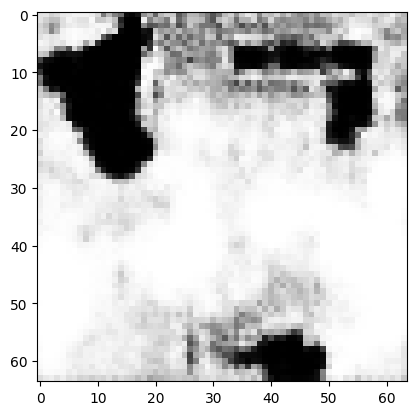

tensor([[8.1770e-06, 4.0070e-05, 1.9430e-04, 1.1412e-04, 2.0596e-03, 9.6063e-03,
         1.7904e-04, 6.9030e-04, 5.6653e-02, 7.0838e-01, 2.4379e-02, 1.3730e-05,
         1.1172e-04, 4.8914e-07, 2.3941e-02, 3.3727e-02, 7.7783e-04, 5.3025e-05,
         1.2957e-04, 1.1885e-02, 1.7525e-05, 8.1647e-03, 2.6945e-02, 9.3411e-04,
         6.5636e-04, 1.2360e-06, 4.4973e-05, 1.1234e-03, 5.5078e-03, 4.2962e-02,
         1.9522e-04, 1.0356e-05, 4.4757e-03, 3.1697e-04, 7.6263e-03, 2.6543e-02,
         1.2730e-05, 4.1148e-05, 3.6555e-04, 1.1119e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34477508068084717
tensor([[8.1609e-06, 4.0029e-05, 1.9424e-04, 1.1410e-04, 2.0574e-03, 9.5901e-03,
         1.7880e-04, 6.8990e-04, 5.6623e-02, 7.0861e-01, 2.4369e-02, 1.3707e-05,
         1.1161e-04, 4.8856e-07, 2.3919e-02, 3.3694e-02, 7.7636e-04, 5.2820e-05,
         1.2941e-04, 1.1881e-02, 1.7503e-05, 8.1665e-03, 2.6917e-02, 9.3299e-04,
         6.5564e-04, 1.2356e-06, 4.4936e-0

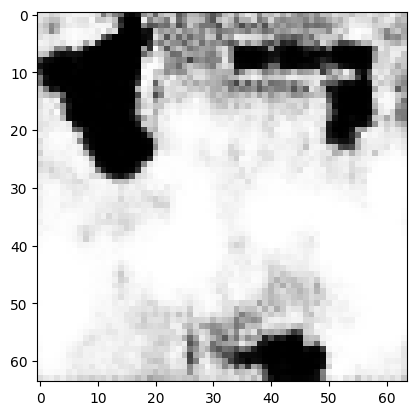

tensor([[8.1261e-06, 3.9871e-05, 1.9395e-04, 1.1402e-04, 2.0528e-03, 9.5448e-03,
         1.7777e-04, 6.8823e-04, 5.6550e-02, 7.0957e-01, 2.4303e-02, 1.3648e-05,
         1.1140e-04, 4.8751e-07, 2.3831e-02, 3.3484e-02, 7.7221e-04, 5.2110e-05,
         1.2857e-04, 1.1828e-02, 1.7442e-05, 8.1731e-03, 2.6906e-02, 9.2750e-04,
         6.5426e-04, 1.2392e-06, 4.4824e-05, 1.1271e-03, 5.4782e-03, 4.2722e-02,
         1.9504e-04, 1.0282e-05, 4.4547e-03, 3.1671e-04, 7.5830e-03, 2.6394e-02,
         1.2701e-05, 4.0925e-05, 3.6471e-04, 1.1082e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34309083223342896
tensor([[8.1076e-06, 3.9796e-05, 1.9386e-04, 1.1403e-04, 2.0501e-03, 9.5275e-03,
         1.7747e-04, 6.8728e-04, 5.6550e-02, 7.0990e-01, 2.4281e-02, 1.3621e-05,
         1.1128e-04, 4.8688e-07, 2.3803e-02, 3.3394e-02, 7.7041e-04, 5.1859e-05,
         1.2832e-04, 1.1812e-02, 1.7416e-05, 8.1732e-03, 2.6910e-02, 9.2532e-04,
         6.5387e-04, 1.2401e-06, 4.4788e-0

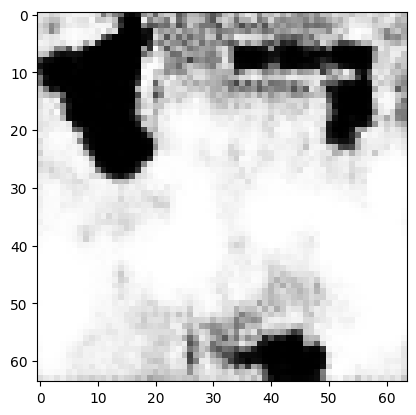

tensor([[8.0606e-06, 3.9540e-05, 1.9352e-04, 1.1405e-04, 2.0436e-03, 9.4733e-03,
         1.7619e-04, 6.8446e-04, 5.6536e-02, 7.1118e-01, 2.4181e-02, 1.3547e-05,
         1.1097e-04, 4.8538e-07, 2.3690e-02, 3.3056e-02, 7.6487e-04, 5.0970e-05,
         1.2723e-04, 1.1733e-02, 1.7336e-05, 8.1755e-03, 2.6944e-02, 9.1724e-04,
         6.5276e-04, 1.2467e-06, 4.4662e-05, 1.1330e-03, 5.4395e-03, 4.2361e-02,
         1.9483e-04, 1.0193e-05, 4.4272e-03, 3.1604e-04, 7.5250e-03, 2.6146e-02,
         1.2679e-05, 4.0721e-05, 3.6322e-04, 1.1027e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34082892537117004
tensor([[8.0511e-06, 3.9488e-05, 1.9347e-04, 1.1407e-04, 2.0420e-03, 9.4602e-03,
         1.7591e-04, 6.8383e-04, 5.6525e-02, 7.1150e-01, 2.4157e-02, 1.3529e-05,
         1.1092e-04, 4.8510e-07, 2.3657e-02, 3.2979e-02, 7.6347e-04, 5.0737e-05,
         1.2698e-04, 1.1714e-02, 1.7316e-05, 8.1779e-03, 2.6947e-02, 9.1528e-04,
         6.5256e-04, 1.2485e-06, 4.4641e-0

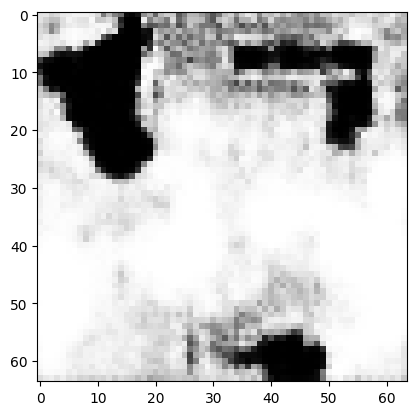

tensor([[7.9861e-06, 3.9234e-05, 1.9320e-04, 1.1404e-04, 2.0320e-03, 9.3951e-03,
         1.7467e-04, 6.8091e-04, 5.6483e-02, 7.1272e-01, 2.4082e-02, 1.3429e-05,
         1.1046e-04, 4.8273e-07, 2.3550e-02, 3.2696e-02, 7.5672e-04, 4.9819e-05,
         1.2606e-04, 1.1665e-02, 1.7222e-05, 8.1782e-03, 2.6907e-02, 9.0771e-04,
         6.5046e-04, 1.2511e-06, 4.4506e-05, 1.1383e-03, 5.4025e-03, 4.2047e-02,
         1.9440e-04, 1.0090e-05, 4.3976e-03, 3.1542e-04, 7.4631e-03, 2.5924e-02,
         1.2641e-05, 4.0476e-05, 3.6178e-04, 1.0984e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.33866894245147705
tensor([[7.9718e-06, 3.9177e-05, 1.9311e-04, 1.1404e-04, 2.0297e-03, 9.3795e-03,
         1.7437e-04, 6.8011e-04, 5.6474e-02, 7.1302e-01, 2.4061e-02, 1.3407e-05,
         1.1036e-04, 4.8220e-07, 2.3523e-02, 3.2620e-02, 7.5507e-04, 4.9597e-05,
         1.2585e-04, 1.1651e-02, 1.7199e-05, 8.1787e-03, 2.6901e-02, 9.0589e-04,
         6.5006e-04, 1.2521e-06, 4.4477e-0

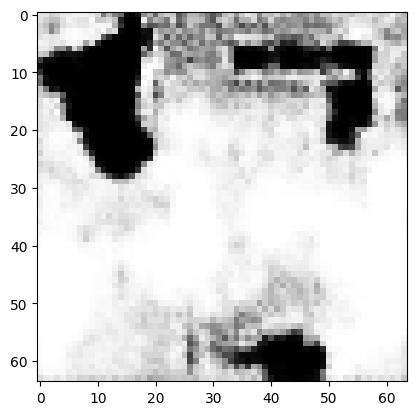

tensor([[7.9240e-06, 3.8950e-05, 1.9284e-04, 1.1403e-04, 2.0222e-03, 9.3264e-03,
         1.7316e-04, 6.7761e-04, 5.6442e-02, 7.1416e-01, 2.3979e-02, 1.3329e-05,
         1.1002e-04, 4.8048e-07, 2.3422e-02, 3.2338e-02, 7.4938e-04, 4.8799e-05,
         1.2493e-04, 1.1595e-02, 1.7123e-05, 8.1785e-03, 2.6890e-02, 8.9876e-04,
         6.4850e-04, 1.2567e-06, 4.4356e-05, 1.1435e-03, 5.3672e-03, 4.1755e-02,
         1.9412e-04, 9.9960e-06, 4.3702e-03, 3.1483e-04, 7.4085e-03, 2.5711e-02,
         1.2612e-05, 4.0267e-05, 3.6051e-04, 1.0946e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3366435170173645
tensor([[7.9054e-06, 3.8888e-05, 1.9277e-04, 1.1400e-04, 2.0194e-03, 9.3095e-03,
         1.7290e-04, 6.7689e-04, 5.6424e-02, 7.1444e-01, 2.3963e-02, 1.3302e-05,
         1.0989e-04, 4.7972e-07, 2.3397e-02, 3.2285e-02, 7.4753e-04, 4.8592e-05,
         1.2475e-04, 1.1589e-02, 1.7098e-05, 8.1768e-03, 2.6866e-02, 8.9713e-04,
         6.4785e-04, 1.2564e-06, 4.4317e-05

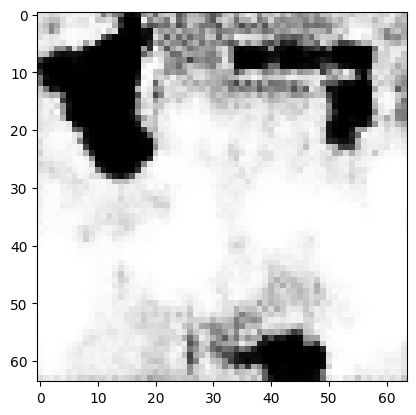

tensor([[7.8630e-06, 3.8680e-05, 1.9247e-04, 1.1398e-04, 2.0128e-03, 9.2620e-03,
         1.7177e-04, 6.7454e-04, 5.6393e-02, 7.1549e-01, 2.3885e-02, 1.3231e-05,
         1.0958e-04, 4.7813e-07, 2.3305e-02, 3.2020e-02, 7.4215e-04, 4.7875e-05,
         1.2390e-04, 1.1536e-02, 1.7028e-05, 8.1756e-03, 2.6859e-02, 8.9058e-04,
         6.4653e-04, 1.2610e-06, 4.4200e-05, 1.1477e-03, 5.3340e-03, 4.1499e-02,
         1.9377e-04, 9.9042e-06, 4.3445e-03, 3.1421e-04, 7.3578e-03, 2.5518e-02,
         1.2576e-05, 4.0061e-05, 3.5923e-04, 1.0914e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.33478158712387085
tensor([[7.8444e-06, 3.8629e-05, 1.9243e-04, 1.1397e-04, 2.0099e-03, 9.2450e-03,
         1.7152e-04, 6.7402e-04, 5.6368e-02, 7.1574e-01, 2.3874e-02, 1.3204e-05,
         1.0945e-04, 4.7737e-07, 2.3282e-02, 3.1984e-02, 7.4045e-04, 4.7672e-05,
         1.2374e-04, 1.1534e-02, 1.7004e-05, 8.1756e-03, 2.6825e-02, 8.8928e-04,
         6.4571e-04, 1.2603e-06, 4.4165e-0

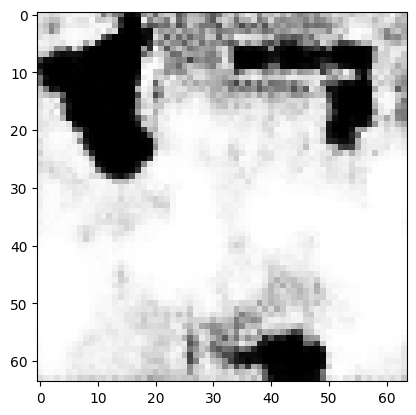

tensor([[7.8060e-06, 3.8457e-05, 1.9219e-04, 1.1395e-04, 2.0037e-03, 9.2013e-03,
         1.7056e-04, 6.7198e-04, 5.6319e-02, 7.1667e-01, 2.3805e-02, 1.3137e-05,
         1.0917e-04, 4.7586e-07, 2.3199e-02, 3.1768e-02, 7.3527e-04, 4.7034e-05,
         1.2304e-04, 1.1494e-02, 1.6939e-05, 8.1745e-03, 2.6795e-02, 8.8372e-04,
         6.4438e-04, 1.2634e-06, 4.4062e-05, 1.1514e-03, 5.3048e-03, 4.1289e-02,
         1.9339e-04, 9.8161e-06, 4.3212e-03, 3.1372e-04, 7.3103e-03, 2.5362e-02,
         1.2537e-05, 3.9854e-05, 3.5813e-04, 1.0891e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3331373929977417
tensor([[7.7996e-06, 3.8414e-05, 1.9212e-04, 1.1393e-04, 2.0028e-03, 9.1937e-03,
         1.7030e-04, 6.7166e-04, 5.6309e-02, 7.1689e-01, 2.3787e-02, 1.3126e-05,
         1.0911e-04, 4.7563e-07, 2.3181e-02, 3.1715e-02, 7.3423e-04, 4.6908e-05,
         1.2284e-04, 1.1481e-02, 1.6928e-05, 8.1729e-03, 2.6796e-02, 8.8240e-04,
         6.4413e-04, 1.2647e-06, 4.4031e-05

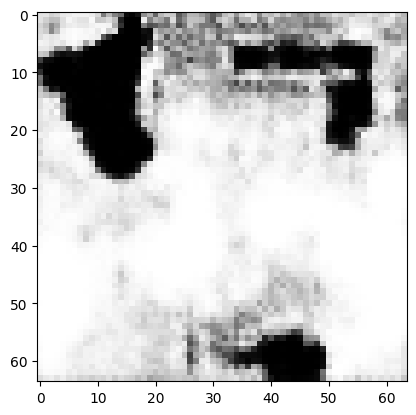

tensor([[7.7613e-06, 3.8266e-05, 1.9192e-04, 1.1389e-04, 1.9969e-03, 9.1518e-03,
         1.6944e-04, 6.7002e-04, 5.6238e-02, 7.1771e-01, 2.3728e-02, 1.3061e-05,
         1.0885e-04, 4.7403e-07, 2.3105e-02, 3.1554e-02, 7.2910e-04, 4.6334e-05,
         1.2224e-04, 1.1455e-02, 1.6867e-05, 8.1708e-03, 2.6734e-02, 8.7782e-04,
         6.4253e-04, 1.2660e-06, 4.3927e-05, 1.1543e-03, 5.2775e-03, 4.1116e-02,
         1.9311e-04, 9.7400e-06, 4.3017e-03, 3.1329e-04, 7.2710e-03, 2.5227e-02,
         1.2501e-05, 3.9672e-05, 3.5724e-04, 1.0876e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.33168551325798035
tensor([[7.7557e-06, 3.8231e-05, 1.9185e-04, 1.1387e-04, 1.9964e-03, 9.1443e-03,
         1.6921e-04, 6.6970e-04, 5.6227e-02, 7.1789e-01, 2.3710e-02, 1.3052e-05,
         1.0880e-04, 4.7380e-07, 2.3091e-02, 3.1510e-02, 7.2814e-04, 4.6228e-05,
         1.2208e-04, 1.1445e-02, 1.6858e-05, 8.1696e-03, 2.6731e-02, 8.7679e-04,
         6.4229e-04, 1.2669e-06, 4.3899e-0

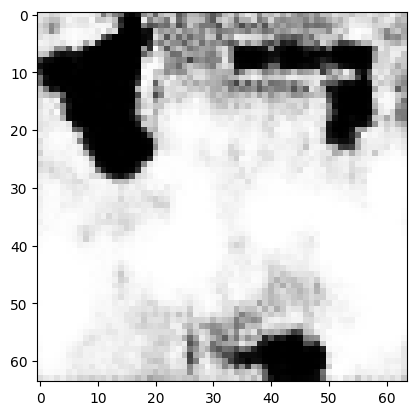

tensor([[7.7231e-06, 3.8113e-05, 1.9169e-04, 1.1382e-04, 1.9916e-03, 9.1081e-03,
         1.6844e-04, 6.6852e-04, 5.6146e-02, 7.1859e-01, 2.3660e-02, 1.2996e-05,
         1.0858e-04, 4.7241e-07, 2.3027e-02, 3.1392e-02, 7.2356e-04, 4.5742e-05,
         1.2157e-04, 1.1428e-02, 1.6807e-05, 8.1676e-03, 2.6658e-02, 8.7315e-04,
         6.4070e-04, 1.2675e-06, 4.3803e-05, 1.1564e-03, 5.2537e-03, 4.0987e-02,
         1.9288e-04, 9.6718e-06, 4.2854e-03, 3.1297e-04, 7.2376e-03, 2.5123e-02,
         1.2465e-05, 3.9499e-05, 3.5655e-04, 1.0866e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.33046281337738037
tensor([[7.7147e-06, 3.8081e-05, 1.9164e-04, 1.1380e-04, 1.9904e-03, 9.0996e-03,
         1.6826e-04, 6.6815e-04, 5.6129e-02, 7.1875e-01, 2.3647e-02, 1.2982e-05,
         1.0852e-04, 4.7202e-07, 2.3012e-02, 3.1362e-02, 7.2241e-04, 4.5636e-05,
         1.2145e-04, 1.1424e-02, 1.6794e-05, 8.1659e-03, 2.6642e-02, 8.7226e-04,
         6.4034e-04, 1.2675e-06, 4.3776e-0

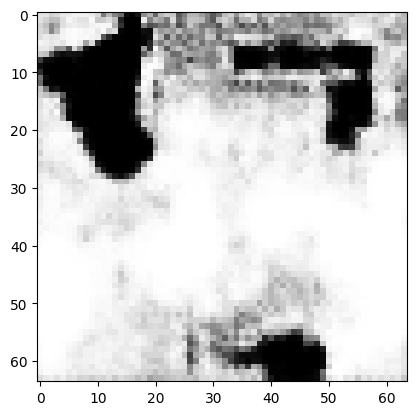

tensor([[7.6870e-06, 3.7974e-05, 1.9147e-04, 1.1373e-04, 1.9867e-03, 9.0682e-03,
         1.6752e-04, 6.6716e-04, 5.6051e-02, 7.1938e-01, 2.3601e-02, 1.2936e-05,
         1.0832e-04, 4.7085e-07, 2.2957e-02, 3.1257e-02, 7.1839e-04, 4.5220e-05,
         1.2097e-04, 1.1406e-02, 1.6752e-05, 8.1626e-03, 2.6580e-02, 8.6901e-04,
         6.3892e-04, 1.2684e-06, 4.3683e-05, 1.1580e-03, 5.2317e-03, 4.0880e-02,
         1.9265e-04, 9.6088e-06, 4.2704e-03, 3.1264e-04, 7.2070e-03, 2.5032e-02,
         1.2428e-05, 3.9331e-05, 3.5586e-04, 1.0861e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3293641209602356
tensor([[7.6803e-06, 3.7950e-05, 1.9143e-04, 1.1372e-04, 1.9858e-03, 9.0607e-03,
         1.6738e-04, 6.6688e-04, 5.6034e-02, 7.1952e-01, 2.3588e-02, 1.2924e-05,
         1.0828e-04, 4.7054e-07, 2.2944e-02, 3.1233e-02, 7.1740e-04, 4.5122e-05,
         1.2087e-04, 1.1403e-02, 1.6741e-05, 8.1621e-03, 2.6564e-02, 8.6829e-04,
         6.3860e-04, 1.2684e-06, 4.3663e-05

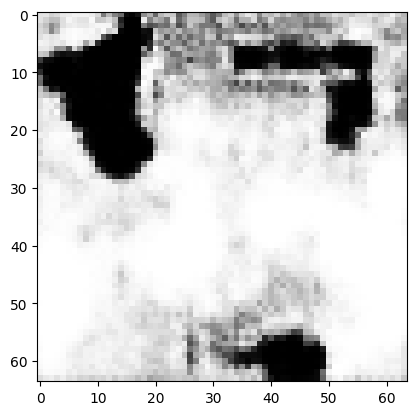

tensor([[7.6512e-06, 3.7857e-05, 1.9130e-04, 1.1367e-04, 1.9810e-03, 9.0295e-03,
         1.6672e-04, 6.6606e-04, 5.5964e-02, 7.2009e-01, 2.3560e-02, 1.2879e-05,
         1.0806e-04, 4.6941e-07, 2.2895e-02, 3.1145e-02, 7.1436e-04, 4.4724e-05,
         1.2047e-04, 1.1389e-02, 1.6700e-05, 8.1636e-03, 2.6509e-02, 8.6545e-04,
         6.3699e-04, 1.2687e-06, 4.3591e-05, 1.1600e-03, 5.2143e-03, 4.0762e-02,
         1.9237e-04, 9.5541e-06, 4.2562e-03, 3.1239e-04, 7.1770e-03, 2.4949e-02,
         1.2398e-05, 3.9165e-05, 3.5537e-04, 1.0846e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32837629318237305
tensor([[7.6436e-06, 3.7835e-05, 1.9126e-04, 1.1365e-04, 1.9799e-03, 9.0217e-03,
         1.6655e-04, 6.6586e-04, 5.5943e-02, 7.2023e-01, 2.3551e-02, 1.2867e-05,
         1.0801e-04, 4.6907e-07, 2.2883e-02, 3.1127e-02, 7.1344e-04, 4.4628e-05,
         1.2037e-04, 1.1388e-02, 1.6689e-05, 8.1632e-03, 2.6489e-02, 8.6480e-04,
         6.3656e-04, 1.2686e-06, 4.3570e-0

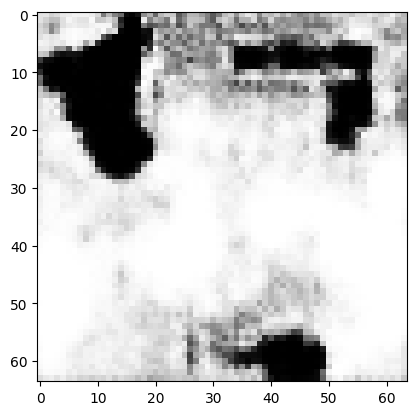

tensor([[7.6180e-06, 3.7753e-05, 1.9113e-04, 1.1360e-04, 1.9757e-03, 8.9935e-03,
         1.6596e-04, 6.6506e-04, 5.5879e-02, 7.2073e-01, 2.3524e-02, 1.2828e-05,
         1.0782e-04, 4.6804e-07, 2.2841e-02, 3.1049e-02, 7.1073e-04, 4.4282e-05,
         1.2001e-04, 1.1375e-02, 1.6653e-05, 8.1643e-03, 2.6440e-02, 8.6233e-04,
         6.3512e-04, 1.2687e-06, 4.3503e-05, 1.1615e-03, 5.1985e-03, 4.0661e-02,
         1.9213e-04, 9.5038e-06, 4.2432e-03, 3.1217e-04, 7.1501e-03, 2.4876e-02,
         1.2370e-05, 3.9007e-05, 3.5493e-04, 1.0832e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.327491819858551
tensor([[7.6094e-06, 3.7739e-05, 1.9114e-04, 1.1361e-04, 1.9737e-03, 8.9846e-03,
         1.6585e-04, 6.6487e-04, 5.5862e-02, 7.2085e-01, 2.3526e-02, 1.2815e-05,
         1.0776e-04, 4.6775e-07, 2.2829e-02, 3.1038e-02, 7.1040e-04, 4.4176e-05,
         1.1996e-04, 1.1375e-02, 1.6641e-05, 8.1679e-03, 2.6424e-02, 8.6180e-04,
         6.3459e-04, 1.2683e-06, 4.3500e-05,

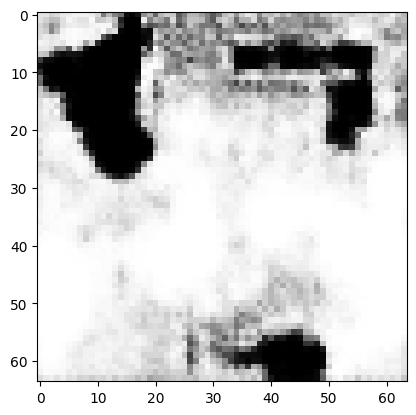

tensor([[7.5868e-06, 3.7666e-05, 1.9101e-04, 1.1355e-04, 1.9702e-03, 8.9597e-03,
         1.6531e-04, 6.6418e-04, 5.5799e-02, 7.2131e-01, 2.3499e-02, 1.2780e-05,
         1.0759e-04, 4.6680e-07, 2.2789e-02, 3.0972e-02, 7.0788e-04, 4.3868e-05,
         1.1963e-04, 1.1364e-02, 1.6608e-05, 8.1681e-03, 2.6375e-02, 8.5959e-04,
         6.3324e-04, 1.2683e-06, 4.3435e-05, 1.1633e-03, 5.1857e-03, 4.0554e-02,
         1.9186e-04, 9.4601e-06, 4.2307e-03, 3.1199e-04, 7.1241e-03, 2.4810e-02,
         1.2346e-05, 3.8854e-05, 3.5455e-04, 1.0815e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3266874849796295
tensor([[7.5820e-06, 3.7651e-05, 1.9098e-04, 1.1354e-04, 1.9695e-03, 8.9535e-03,
         1.6518e-04, 6.6397e-04, 5.5780e-02, 7.2143e-01, 2.3490e-02, 1.2771e-05,
         1.0756e-04, 4.6658e-07, 2.2778e-02, 3.0956e-02, 7.0707e-04, 4.3785e-05,
         1.1955e-04, 1.1362e-02, 1.6599e-05, 8.1682e-03, 2.6360e-02, 8.5904e-04,
         6.3297e-04, 1.2684e-06, 4.3421e-05

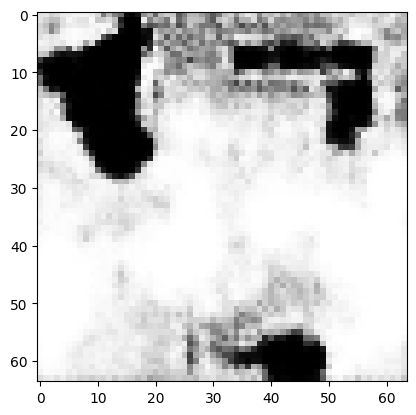

tensor([[7.5563e-06, 3.7575e-05, 1.9086e-04, 1.1351e-04, 1.9653e-03, 8.9265e-03,
         1.6466e-04, 6.6316e-04, 5.5721e-02, 7.2190e-01, 2.3466e-02, 1.2731e-05,
         1.0737e-04, 4.6554e-07, 2.2739e-02, 3.0883e-02, 7.0433e-04, 4.3456e-05,
         1.1925e-04, 1.1353e-02, 1.6563e-05, 8.1691e-03, 2.6310e-02, 8.5674e-04,
         6.3165e-04, 1.2684e-06, 4.3362e-05, 1.1649e-03, 5.1713e-03, 4.0460e-02,
         1.9162e-04, 9.4135e-06, 4.2186e-03, 3.1181e-04, 7.0984e-03, 2.4746e-02,
         1.2320e-05, 3.8712e-05, 3.5409e-04, 1.0805e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3258751928806305
tensor([[7.5516e-06, 3.7559e-05, 1.9082e-04, 1.1350e-04, 1.9641e-03, 8.9207e-03,
         1.6453e-04, 6.6300e-04, 5.5713e-02, 7.2200e-01, 2.3464e-02, 1.2724e-05,
         1.0733e-04, 4.6540e-07, 2.2730e-02, 3.0859e-02, 7.0422e-04, 4.3384e-05,
         1.1917e-04, 1.1348e-02, 1.6556e-05, 8.1712e-03, 2.6312e-02, 8.5617e-04,
         6.3134e-04, 1.2687e-06, 4.3355e-05

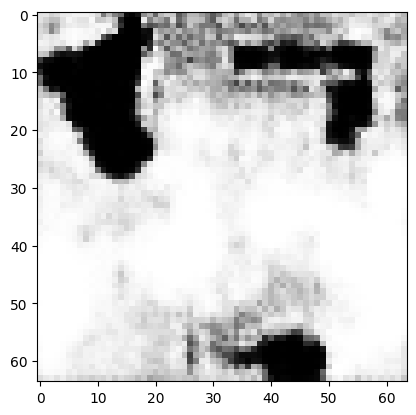

tensor([[7.5270e-06, 3.7489e-05, 1.9072e-04, 1.1348e-04, 1.9602e-03, 8.8948e-03,
         1.6404e-04, 6.6227e-04, 5.5653e-02, 7.2245e-01, 2.3441e-02, 1.2686e-05,
         1.0715e-04, 4.6441e-07, 2.2693e-02, 3.0795e-02, 7.0155e-04, 4.3072e-05,
         1.1888e-04, 1.1340e-02, 1.6521e-05, 8.1722e-03, 2.6259e-02, 8.5405e-04,
         6.3005e-04, 1.2685e-06, 4.3299e-05, 1.1666e-03, 5.1593e-03, 4.0358e-02,
         1.9138e-04, 9.3723e-06, 4.2071e-03, 3.1165e-04, 7.0745e-03, 2.4679e-02,
         1.2300e-05, 3.8577e-05, 3.5373e-04, 1.0790e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32511088252067566
tensor([[7.5245e-06, 3.7473e-05, 1.9068e-04, 1.1346e-04, 1.9599e-03, 8.8907e-03,
         1.6390e-04, 6.6213e-04, 5.5640e-02, 7.2255e-01, 2.3432e-02, 1.2681e-05,
         1.0712e-04, 4.6431e-07, 2.2684e-02, 3.0775e-02, 7.0098e-04, 4.3014e-05,
         1.1878e-04, 1.1335e-02, 1.6516e-05, 8.1716e-03, 2.6254e-02, 8.5353e-04,
         6.2987e-04, 1.2690e-06, 4.3283e-0

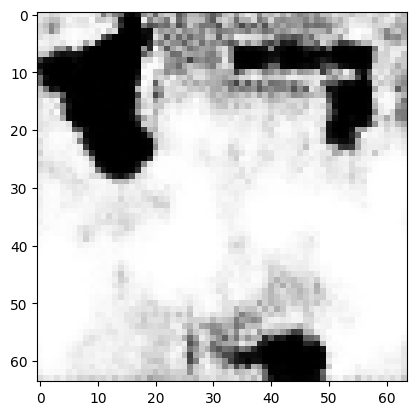

tensor([[7.5058e-06, 3.7418e-05, 1.9059e-04, 1.1344e-04, 1.9569e-03, 8.8684e-03,
         1.6345e-04, 6.6157e-04, 5.5582e-02, 7.2296e-01, 2.3408e-02, 1.2652e-05,
         1.0699e-04, 4.6358e-07, 2.2648e-02, 3.0716e-02, 6.9870e-04, 4.2738e-05,
         1.1852e-04, 1.1326e-02, 1.6489e-05, 8.1733e-03, 2.6208e-02, 8.5168e-04,
         6.2882e-04, 1.2693e-06, 4.3237e-05, 1.1681e-03, 5.1463e-03, 4.0277e-02,
         1.9127e-04, 9.3357e-06, 4.1973e-03, 3.1154e-04, 7.0544e-03, 2.4623e-02,
         1.2281e-05, 3.8461e-05, 3.5344e-04, 1.0783e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3244049549102783
tensor([[7.4987e-06, 3.7403e-05, 1.9057e-04, 1.1343e-04, 1.9554e-03, 8.8613e-03,
         1.6336e-04, 6.6133e-04, 5.5573e-02, 7.2305e-01, 2.3407e-02, 1.2641e-05,
         1.0694e-04, 4.6332e-07, 2.2640e-02, 3.0700e-02, 6.9836e-04, 4.2661e-05,
         1.1847e-04, 1.1325e-02, 1.6479e-05, 8.1753e-03, 2.6200e-02, 8.5121e-04,
         6.2846e-04, 1.2691e-06, 4.3232e-05

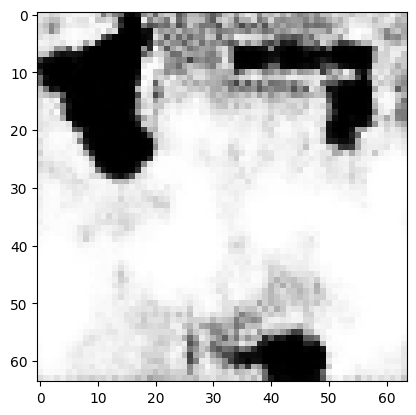

tensor([[7.4818e-06, 3.7348e-05, 1.9047e-04, 1.1341e-04, 1.9528e-03, 8.8415e-03,
         1.6293e-04, 6.6086e-04, 5.5518e-02, 7.2343e-01, 2.3384e-02, 1.2615e-05,
         1.0681e-04, 4.6264e-07, 2.2608e-02, 3.0642e-02, 6.9621e-04, 4.2414e-05,
         1.1820e-04, 1.1316e-02, 1.6454e-05, 8.1758e-03, 2.6160e-02, 8.4951e-04,
         6.2748e-04, 1.2696e-06, 4.3182e-05, 1.1695e-03, 5.1356e-03, 4.0193e-02,
         1.9109e-04, 9.3000e-06, 4.1877e-03, 3.1141e-04, 7.0345e-03, 2.4569e-02,
         1.2263e-05, 3.8344e-05, 3.5315e-04, 1.0772e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3237474858760834
tensor([[7.4777e-06, 3.7334e-05, 1.9043e-04, 1.1341e-04, 1.9521e-03, 8.8362e-03,
         1.6282e-04, 6.6066e-04, 5.5506e-02, 7.2354e-01, 2.3377e-02, 1.2608e-05,
         1.0677e-04, 4.6248e-07, 2.2601e-02, 3.0620e-02, 6.9551e-04, 4.2347e-05,
         1.1814e-04, 1.1312e-02, 1.6447e-05, 8.1757e-03, 2.6153e-02, 8.4901e-04,
         6.2734e-04, 1.2699e-06, 4.3169e-05

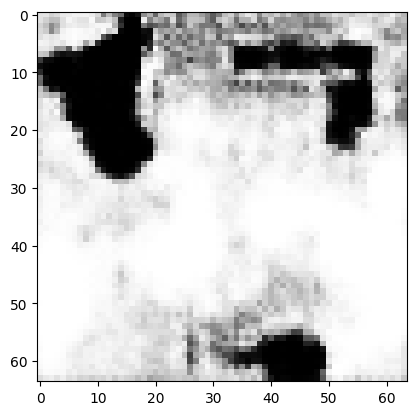

tensor([[7.4598e-06, 3.7278e-05, 1.9030e-04, 1.1341e-04, 1.9483e-03, 8.8155e-03,
         1.6239e-04, 6.6012e-04, 5.5462e-02, 7.2392e-01, 2.3363e-02, 1.2579e-05,
         1.0661e-04, 4.6184e-07, 2.2575e-02, 3.0544e-02, 6.9369e-04, 4.2088e-05,
         1.1788e-04, 1.1300e-02, 1.6419e-05, 8.1787e-03, 2.6134e-02, 8.4711e-04,
         6.2643e-04, 1.2709e-06, 4.3128e-05, 1.1715e-03, 5.1252e-03, 4.0092e-02,
         1.9093e-04, 9.2669e-06, 4.1776e-03, 3.1131e-04, 7.0146e-03, 2.4508e-02,
         1.2252e-05, 3.8242e-05, 3.5288e-04, 1.0759e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32307279109954834
tensor([[7.4534e-06, 3.7260e-05, 1.9026e-04, 1.1341e-04, 1.9473e-03, 8.8089e-03,
         1.6229e-04, 6.5987e-04, 5.5447e-02, 7.2402e-01, 2.3357e-02, 1.2570e-05,
         1.0655e-04, 4.6156e-07, 2.2569e-02, 3.0524e-02, 6.9281e-04, 4.2016e-05,
         1.1783e-04, 1.1299e-02, 1.6410e-05, 8.1779e-03, 2.6122e-02, 8.4663e-04,
         6.2622e-04, 1.2708e-06, 4.3111e-0

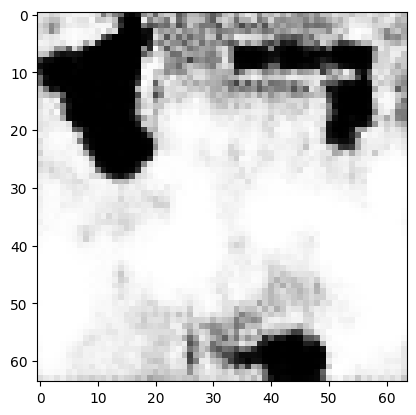

tensor([[7.4412e-06, 3.7213e-05, 1.9011e-04, 1.1341e-04, 1.9448e-03, 8.7921e-03,
         1.6187e-04, 6.5950e-04, 5.5398e-02, 7.2438e-01, 2.3338e-02, 1.2547e-05,
         1.0643e-04, 4.6110e-07, 2.2546e-02, 3.0450e-02, 6.9085e-04, 4.1791e-05,
         1.1757e-04, 1.1285e-02, 1.6388e-05, 8.1790e-03, 2.6104e-02, 8.4494e-04,
         6.2557e-04, 1.2724e-06, 4.3067e-05, 1.1731e-03, 5.1138e-03, 4.0011e-02,
         1.9082e-04, 9.2343e-06, 4.1684e-03, 3.1124e-04, 6.9971e-03, 2.4455e-02,
         1.2238e-05, 3.8149e-05, 3.5262e-04, 1.0753e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3224326968193054
tensor([[7.4372e-06, 3.7206e-05, 1.9009e-04, 1.1341e-04, 1.9436e-03, 8.7868e-03,
         1.6179e-04, 6.5935e-04, 5.5387e-02, 7.2447e-01, 2.3338e-02, 1.2541e-05,
         1.0639e-04, 4.6097e-07, 2.2539e-02, 3.0435e-02, 6.9059e-04, 4.1725e-05,
         1.1753e-04, 1.1283e-02, 1.6380e-05, 8.1813e-03, 2.6099e-02, 8.4454e-04,
         6.2535e-04, 1.2725e-06, 4.3065e-05

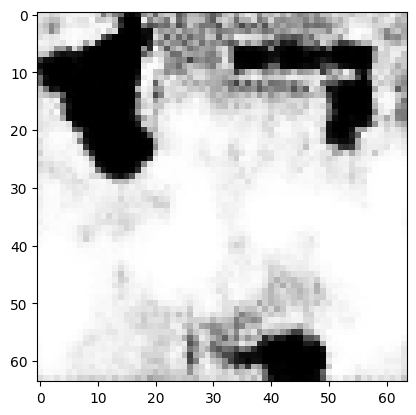

tensor([[7.4249e-06, 3.7162e-05, 1.8995e-04, 1.1340e-04, 1.9412e-03, 8.7703e-03,
         1.6141e-04, 6.5897e-04, 5.5337e-02, 7.2481e-01, 2.3320e-02, 1.2519e-05,
         1.0627e-04, 4.6049e-07, 2.2519e-02, 3.0367e-02, 6.8860e-04, 4.1516e-05,
         1.1730e-04, 1.1271e-02, 1.6359e-05, 8.1817e-03, 2.6079e-02, 8.4302e-04,
         6.2474e-04, 1.2738e-06, 4.3020e-05, 1.1748e-03, 5.1047e-03, 3.9929e-02,
         1.9071e-04, 9.2065e-06, 4.1600e-03, 3.1120e-04, 6.9809e-03, 2.4407e-02,
         1.2229e-05, 3.8062e-05, 3.5241e-04, 1.0745e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32185134291648865
tensor([[7.4206e-06, 3.7154e-05, 1.8992e-04, 1.1342e-04, 1.9400e-03, 8.7652e-03,
         1.6133e-04, 6.5890e-04, 5.5326e-02, 7.2489e-01, 2.3321e-02, 1.2513e-05,
         1.0623e-04, 4.6035e-07, 2.2513e-02, 3.0352e-02, 6.8836e-04, 4.1450e-05,
         1.1726e-04, 1.1270e-02, 1.6351e-05, 8.1842e-03, 2.6074e-02, 8.4267e-04,
         6.2449e-04, 1.2740e-06, 4.3016e-0

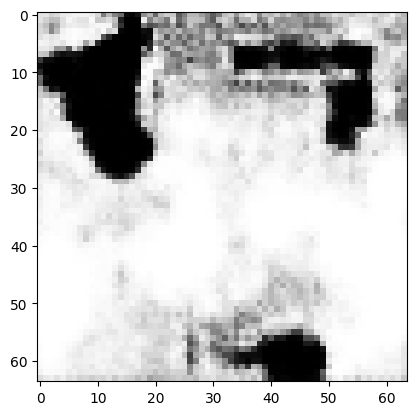

tensor([[7.4066e-06, 3.7107e-05, 1.8976e-04, 1.1341e-04, 1.9372e-03, 8.7476e-03,
         1.6095e-04, 6.5843e-04, 5.5277e-02, 7.2523e-01, 2.3303e-02, 1.2488e-05,
         1.0608e-04, 4.5977e-07, 2.2495e-02, 3.0280e-02, 6.8612e-04, 4.1235e-05,
         1.1704e-04, 1.1259e-02, 1.6327e-05, 8.1837e-03, 2.6052e-02, 8.4108e-04,
         6.2391e-04, 1.2751e-06, 4.2969e-05, 1.1764e-03, 5.0956e-03, 3.9848e-02,
         1.9058e-04, 9.1765e-06, 4.1512e-03, 3.1116e-04, 6.9643e-03, 2.4359e-02,
         1.2219e-05, 3.7975e-05, 3.5220e-04, 1.0737e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32126951217651367
tensor([[7.4062e-06, 3.7099e-05, 1.8973e-04, 1.1342e-04, 1.9370e-03, 8.7454e-03,
         1.6086e-04, 6.5842e-04, 5.5266e-02, 7.2531e-01, 2.3297e-02, 1.2486e-05,
         1.0607e-04, 4.5977e-07, 2.2490e-02, 3.0261e-02, 6.8571e-04, 4.1194e-05,
         1.1697e-04, 1.1254e-02, 1.6324e-05, 8.1835e-03, 2.6052e-02, 8.4072e-04,
         6.2388e-04, 1.2758e-06, 4.2959e-0

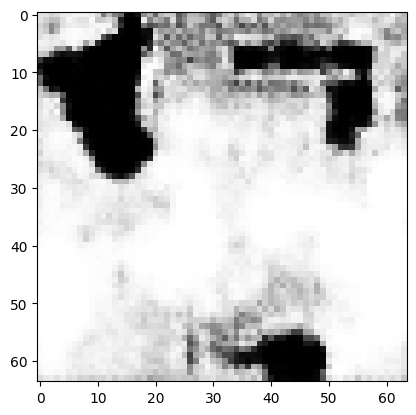

tensor([[7.3928e-06, 3.7059e-05, 1.8959e-04, 1.1342e-04, 1.9340e-03, 8.7285e-03,
         1.6053e-04, 6.5799e-04, 5.5222e-02, 7.2562e-01, 2.3286e-02, 1.2463e-05,
         1.0593e-04, 4.5925e-07, 2.2473e-02, 3.0197e-02, 6.8396e-04, 4.0991e-05,
         1.1679e-04, 1.1245e-02, 1.6301e-05, 8.1852e-03, 2.6034e-02, 8.3931e-04,
         6.2326e-04, 1.2767e-06, 4.2922e-05, 1.1780e-03, 5.0869e-03, 3.9773e-02,
         1.9049e-04, 9.1516e-06, 4.1435e-03, 3.1112e-04, 6.9501e-03, 2.4313e-02,
         1.2211e-05, 3.7902e-05, 3.5202e-04, 1.0730e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3207351863384247
tensor([[7.3919e-06, 3.7051e-05, 1.8955e-04, 1.1342e-04, 1.9338e-03, 8.7261e-03,
         1.6043e-04, 6.5797e-04, 5.5210e-02, 7.2569e-01, 2.3279e-02, 1.2461e-05,
         1.0591e-04, 4.5921e-07, 2.2469e-02, 3.0182e-02, 6.8352e-04, 4.0954e-05,
         1.1673e-04, 1.1241e-02, 1.6298e-05, 8.1846e-03, 2.6031e-02, 8.3901e-04,
         6.2319e-04, 1.2773e-06, 4.2910e-05

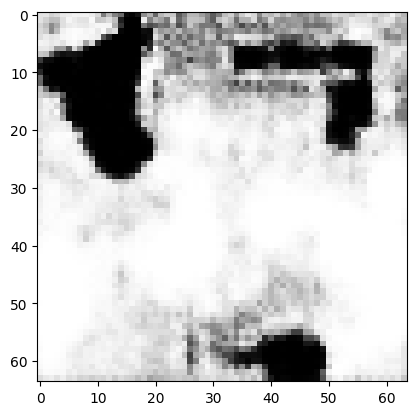

tensor([[7.3789e-06, 3.7015e-05, 1.8943e-04, 1.1342e-04, 1.9310e-03, 8.7102e-03,
         1.6013e-04, 6.5765e-04, 5.5164e-02, 7.2597e-01, 2.3270e-02, 1.2440e-05,
         1.0578e-04, 4.5870e-07, 2.2453e-02, 3.0130e-02, 6.8185e-04, 4.0765e-05,
         1.1656e-04, 1.1235e-02, 1.6277e-05, 8.1860e-03, 2.6008e-02, 8.3776e-04,
         6.2255e-04, 1.2779e-06, 4.2875e-05, 1.1794e-03, 5.0785e-03, 3.9709e-02,
         1.9039e-04, 9.1272e-06, 4.1362e-03, 3.1108e-04, 6.9366e-03, 2.4274e-02,
         1.2201e-05, 3.7827e-05, 3.5187e-04, 1.0725e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32024452090263367
tensor([[7.3763e-06, 3.7010e-05, 1.8941e-04, 1.1342e-04, 1.9302e-03, 8.7062e-03,
         1.6007e-04, 6.5753e-04, 5.5156e-02, 7.2604e-01, 2.3268e-02, 1.2435e-05,
         1.0575e-04, 4.5861e-07, 2.2448e-02, 3.0118e-02, 6.8162e-04, 4.0717e-05,
         1.1653e-04, 1.1233e-02, 1.6272e-05, 8.1876e-03, 2.6004e-02, 8.3750e-04,
         6.2240e-04, 1.2780e-06, 4.2873e-0

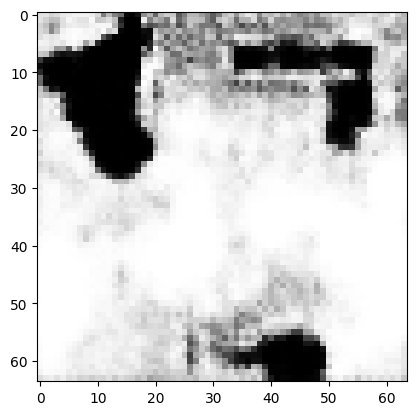

tensor([[7.3699e-06, 3.6981e-05, 1.8927e-04, 1.1341e-04, 1.9289e-03, 8.6953e-03,
         1.5976e-04, 6.5735e-04, 5.5112e-02, 7.2630e-01, 2.3251e-02, 1.2422e-05,
         1.0567e-04, 4.5833e-07, 2.2434e-02, 3.0064e-02, 6.8005e-04, 4.0571e-05,
         1.1635e-04, 1.1222e-02, 1.6258e-05, 8.1867e-03, 2.5990e-02, 8.3637e-04,
         6.2204e-04, 1.2795e-06, 4.2835e-05, 1.1806e-03, 5.0708e-03, 3.9651e-02,
         1.9036e-04, 9.1071e-06, 4.1300e-03, 3.1107e-04, 6.9255e-03, 2.4238e-02,
         1.2195e-05, 3.7766e-05, 3.5174e-04, 1.0722e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3197985589504242
tensor([[7.3644e-06, 3.6972e-05, 1.8926e-04, 1.1341e-04, 1.9277e-03, 8.6900e-03,
         1.5969e-04, 6.5723e-04, 5.5101e-02, 7.2636e-01, 2.3253e-02, 1.2414e-05,
         1.0562e-04, 4.5812e-07, 2.2431e-02, 3.0057e-02, 6.7968e-04, 4.0518e-05,
         1.1633e-04, 1.1223e-02, 1.6250e-05, 8.1878e-03, 2.5981e-02, 8.3611e-04,
         6.2177e-04, 1.2792e-06, 4.2829e-05

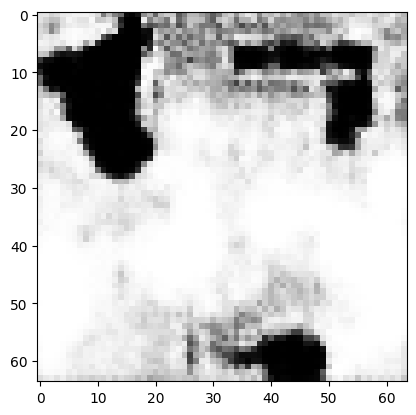

tensor([[7.3589e-06, 3.6948e-05, 1.8914e-04, 1.1341e-04, 1.9266e-03, 8.6803e-03,
         1.5942e-04, 6.5710e-04, 5.5059e-02, 7.2659e-01, 2.3237e-02, 1.2403e-05,
         1.0555e-04, 4.5788e-07, 2.2418e-02, 3.0012e-02, 6.7825e-04, 4.0386e-05,
         1.1617e-04, 1.1214e-02, 1.6238e-05, 8.1871e-03, 2.5965e-02, 8.3515e-04,
         6.2142e-04, 1.2804e-06, 4.2796e-05, 1.1816e-03, 5.0636e-03, 3.9601e-02,
         1.9028e-04, 9.0864e-06, 4.1240e-03, 3.1104e-04, 6.9144e-03, 2.4208e-02,
         1.2186e-05, 3.7701e-05, 3.5162e-04, 1.0719e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31939083337783813
tensor([[7.3541e-06, 3.6940e-05, 1.8911e-04, 1.1340e-04, 1.9256e-03, 8.6754e-03,
         1.5936e-04, 6.5696e-04, 5.5049e-02, 7.2665e-01, 2.3237e-02, 1.2396e-05,
         1.0550e-04, 4.5769e-07, 2.2414e-02, 3.0003e-02, 6.7791e-04, 4.0339e-05,
         1.1615e-04, 1.1215e-02, 1.6232e-05, 8.1880e-03, 2.5957e-02, 8.3491e-04,
         6.2119e-04, 1.2801e-06, 4.2789e-0

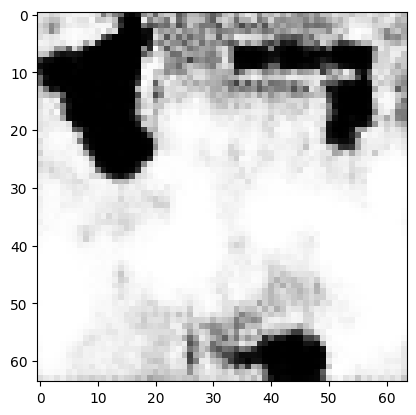

tensor([[7.3495e-06, 3.6919e-05, 1.8900e-04, 1.1339e-04, 1.9246e-03, 8.6667e-03,
         1.5910e-04, 6.5684e-04, 5.5009e-02, 7.2686e-01, 2.3221e-02, 1.2386e-05,
         1.0544e-04, 4.5747e-07, 2.2403e-02, 2.9962e-02, 6.7656e-04, 4.0220e-05,
         1.1600e-04, 1.1206e-02, 1.6221e-05, 8.1871e-03, 2.5941e-02, 8.3404e-04,
         6.2088e-04, 1.2813e-06, 4.2757e-05, 1.1825e-03, 5.0569e-03, 3.9558e-02,
         1.9022e-04, 9.0671e-06, 4.1186e-03, 3.1102e-04, 6.9046e-03, 2.4180e-02,
         1.2177e-05, 3.7642e-05, 3.5150e-04, 1.0717e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31901493668556213
tensor([[7.3449e-06, 3.6912e-05, 1.8899e-04, 1.1339e-04, 1.9237e-03, 8.6621e-03,
         1.5905e-04, 6.5675e-04, 5.4998e-02, 7.2692e-01, 2.3223e-02, 1.2380e-05,
         1.0540e-04, 4.5729e-07, 2.2399e-02, 2.9958e-02, 6.7626e-04, 4.0177e-05,
         1.1598e-04, 1.1207e-02, 1.6215e-05, 8.1880e-03, 2.5932e-02, 8.3385e-04,
         6.2064e-04, 1.2809e-06, 4.2752e-0

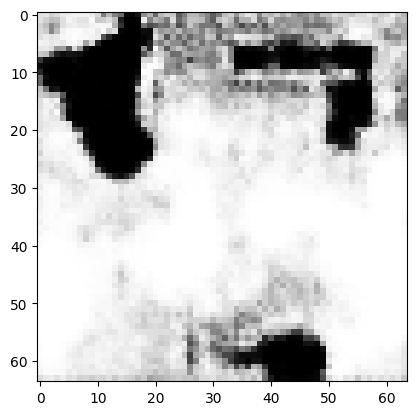

tensor([[7.3379e-06, 3.6893e-05, 1.8889e-04, 1.1339e-04, 1.9221e-03, 8.6518e-03,
         1.5882e-04, 6.5660e-04, 5.4960e-02, 7.2711e-01, 2.3214e-02, 1.2367e-05,
         1.0533e-04, 4.5700e-07, 2.2388e-02, 2.9925e-02, 6.7513e-04, 4.0052e-05,
         1.1586e-04, 1.1202e-02, 1.6202e-05, 8.1890e-03, 2.5914e-02, 8.3308e-04,
         6.2021e-04, 1.2815e-06, 4.2727e-05, 1.1834e-03, 5.0518e-03, 3.9513e-02,
         1.9012e-04, 9.0484e-06, 4.1131e-03, 3.1101e-04, 6.8942e-03, 2.4156e-02,
         1.2169e-05, 3.7578e-05, 3.5139e-04, 1.0713e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3186711370944977
tensor([[7.3381e-06, 3.6889e-05, 1.8886e-04, 1.1338e-04, 1.9222e-03, 8.6507e-03,
         1.5876e-04, 6.5659e-04, 5.4951e-02, 7.2716e-01, 2.3209e-02, 1.2367e-05,
         1.0532e-04, 4.5700e-07, 2.2386e-02, 2.9915e-02, 6.7482e-04, 4.0032e-05,
         1.1582e-04, 1.1199e-02, 1.6201e-05, 8.1883e-03, 2.5911e-02, 8.3289e-04,
         6.2018e-04, 1.2819e-06, 4.2718e-05

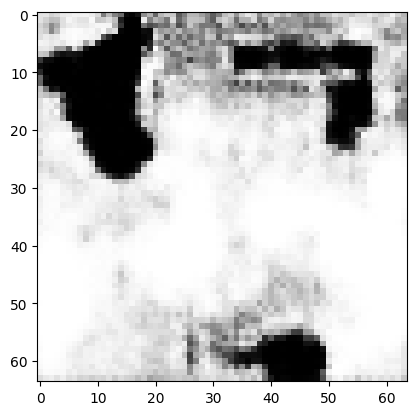

tensor([[7.3300e-06, 3.6871e-05, 1.8878e-04, 1.1337e-04, 1.9204e-03, 8.6399e-03,
         1.5855e-04, 6.5642e-04, 5.4913e-02, 7.2735e-01, 2.3202e-02, 1.2353e-05,
         1.0523e-04, 4.5665e-07, 2.2375e-02, 2.9887e-02, 6.7370e-04, 3.9910e-05,
         1.1572e-04, 1.1196e-02, 1.6187e-05, 8.1894e-03, 2.5890e-02, 8.3221e-04,
         6.1969e-04, 1.2821e-06, 4.2695e-05, 1.1841e-03, 5.0461e-03, 3.9478e-02,
         1.9007e-04, 9.0319e-06, 4.1085e-03, 3.1100e-04, 6.8858e-03, 2.4135e-02,
         1.2161e-05, 3.7525e-05, 3.5130e-04, 1.0712e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3183533251285553
tensor([[7.3296e-06, 3.6866e-05, 1.8875e-04, 1.1337e-04, 1.9204e-03, 8.6387e-03,
         1.5849e-04, 6.5641e-04, 5.4905e-02, 7.2739e-01, 2.3198e-02, 1.2352e-05,
         1.0522e-04, 4.5663e-07, 2.2374e-02, 2.9877e-02, 6.7340e-04, 3.9891e-05,
         1.1568e-04, 1.1194e-02, 1.6186e-05, 8.1885e-03, 2.5889e-02, 8.3200e-04,
         6.1967e-04, 1.2825e-06, 4.2686e-05

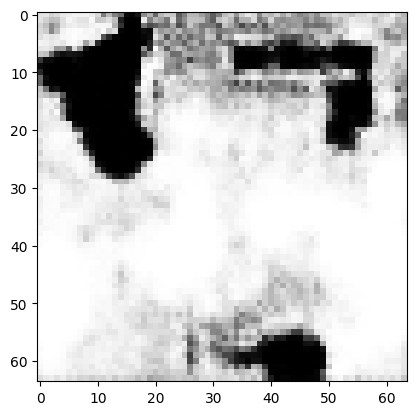

tensor([[7.3222e-06, 3.6849e-05, 1.8867e-04, 1.1336e-04, 1.9188e-03, 8.6288e-03,
         1.5830e-04, 6.5627e-04, 5.4869e-02, 7.2756e-01, 2.3191e-02, 1.2340e-05,
         1.0515e-04, 4.5631e-07, 2.2364e-02, 2.9852e-02, 6.7236e-04, 3.9780e-05,
         1.1559e-04, 1.1191e-02, 1.6173e-05, 8.1894e-03, 2.5869e-02, 8.3139e-04,
         6.1921e-04, 1.2827e-06, 4.2663e-05, 1.1847e-03, 5.0407e-03, 3.9445e-02,
         1.9001e-04, 9.0165e-06, 4.1040e-03, 3.1099e-04, 6.8780e-03, 2.4115e-02,
         1.2153e-05, 3.7474e-05, 3.5122e-04, 1.0711e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31805840134620667
tensor([[7.3223e-06, 3.6845e-05, 1.8864e-04, 1.1335e-04, 1.9190e-03, 8.6278e-03,
         1.5824e-04, 6.5626e-04, 5.4862e-02, 7.2760e-01, 2.3186e-02, 1.2339e-05,
         1.0514e-04, 4.5630e-07, 2.2362e-02, 2.9843e-02, 6.7211e-04, 3.9764e-05,
         1.1555e-04, 1.1189e-02, 1.6172e-05, 8.1887e-03, 2.5867e-02, 8.3123e-04,
         6.1918e-04, 1.2830e-06, 4.2655e-0

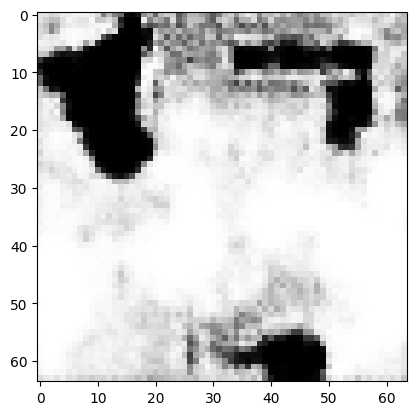

tensor([[7.3147e-06, 3.6830e-05, 1.8857e-04, 1.1334e-04, 1.9173e-03, 8.6179e-03,
         1.5805e-04, 6.5613e-04, 5.4825e-02, 7.2776e-01, 2.3181e-02, 1.2327e-05,
         1.0506e-04, 4.5598e-07, 2.2354e-02, 2.9822e-02, 6.7109e-04, 3.9658e-05,
         1.1547e-04, 1.1187e-02, 1.6160e-05, 8.1896e-03, 2.5845e-02, 8.3067e-04,
         6.1871e-04, 1.2830e-06, 4.2633e-05, 1.1853e-03, 5.0358e-03, 3.9417e-02,
         1.8996e-04, 9.0016e-06, 4.1000e-03, 3.1098e-04, 6.8707e-03, 2.4097e-02,
         1.2146e-05, 3.7424e-05, 3.5115e-04, 1.0710e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3177851438522339
tensor([[7.3143e-06, 3.6825e-05, 1.8854e-04, 1.1334e-04, 1.9174e-03, 8.6170e-03,
         1.5800e-04, 6.5615e-04, 5.4819e-02, 7.2779e-01, 2.3178e-02, 1.2326e-05,
         1.0505e-04, 4.5596e-07, 2.2353e-02, 2.9814e-02, 6.7084e-04, 3.9643e-05,
         1.1544e-04, 1.1185e-02, 1.6159e-05, 8.1888e-03, 2.5844e-02, 8.3052e-04,
         6.1868e-04, 1.2834e-06, 4.2624e-05

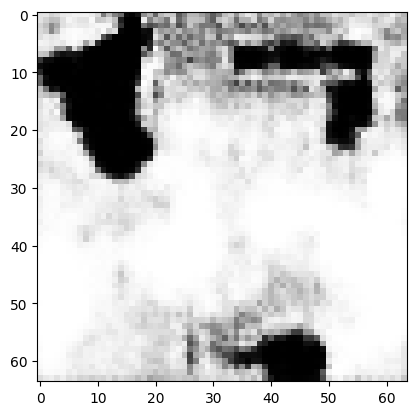

tensor([[7.3078e-06, 3.6812e-05, 1.8847e-04, 1.1332e-04, 1.9160e-03, 8.6080e-03,
         1.5783e-04, 6.5600e-04, 5.4784e-02, 7.2794e-01, 2.3172e-02, 1.2315e-05,
         1.0499e-04, 4.5566e-07, 2.2344e-02, 2.9796e-02, 6.6990e-04, 3.9547e-05,
         1.1536e-04, 1.1183e-02, 1.6148e-05, 8.1894e-03, 2.5823e-02, 8.3001e-04,
         6.1825e-04, 1.2833e-06, 4.2604e-05, 1.1858e-03, 5.0312e-03, 3.9393e-02,
         1.8991e-04, 8.9877e-06, 4.0962e-03, 3.1097e-04, 6.8640e-03, 2.4081e-02,
         1.2138e-05, 3.7377e-05, 3.5108e-04, 1.0710e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3175341486930847
tensor([[7.3061e-06, 3.6809e-05, 1.8846e-04, 1.1332e-04, 1.9155e-03, 8.6059e-03,
         1.5780e-04, 6.5596e-04, 5.4778e-02, 7.2798e-01, 2.3172e-02, 1.2313e-05,
         1.0497e-04, 4.5561e-07, 2.2342e-02, 2.9790e-02, 6.6979e-04, 3.9522e-05,
         1.1534e-04, 1.1183e-02, 1.6145e-05, 8.1903e-03, 2.5821e-02, 8.2988e-04,
         6.1815e-04, 1.2834e-06, 4.2602e-05

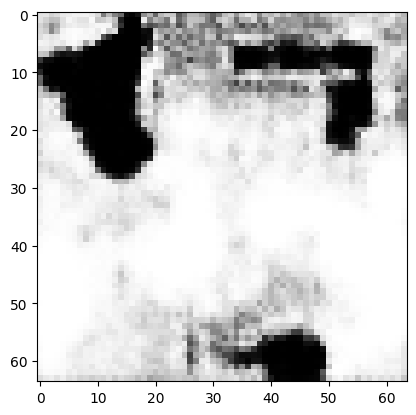

tensor([[7.3026e-06, 3.6797e-05, 1.8838e-04, 1.1331e-04, 1.9149e-03, 8.5996e-03,
         1.5762e-04, 6.5597e-04, 5.4746e-02, 7.2811e-01, 2.3163e-02, 1.2306e-05,
         1.0493e-04, 4.5543e-07, 2.2335e-02, 2.9770e-02, 6.6889e-04, 3.9447e-05,
         1.1525e-04, 1.1179e-02, 1.6139e-05, 8.1896e-03, 2.5804e-02, 8.2942e-04,
         6.1784e-04, 1.2839e-06, 4.2578e-05, 1.1863e-03, 5.0270e-03, 3.9367e-02,
         1.8988e-04, 8.9757e-06, 4.0929e-03, 3.1097e-04, 6.8583e-03, 2.4066e-02,
         1.2132e-05, 3.7336e-05, 3.5105e-04, 1.0709e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3173004984855652
tensor([[7.2992e-06, 3.6794e-05, 1.8838e-04, 1.1331e-04, 1.9142e-03, 8.5962e-03,
         1.5759e-04, 6.5593e-04, 5.4737e-02, 7.2814e-01, 2.3165e-02, 1.2301e-05,
         1.0490e-04, 4.5530e-07, 2.2333e-02, 2.9769e-02, 6.6869e-04, 3.9417e-05,
         1.1524e-04, 1.1181e-02, 1.6134e-05, 8.1905e-03, 2.5796e-02, 8.2934e-04,
         6.1764e-04, 1.2835e-06, 4.2574e-05

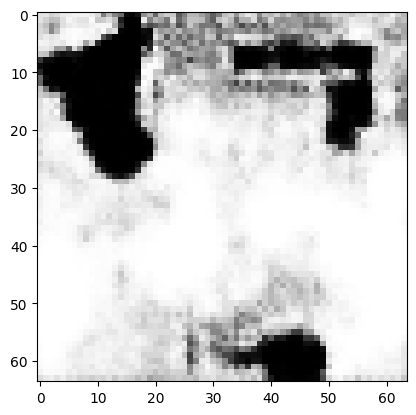

tensor([[7.2967e-06, 3.6784e-05, 1.8830e-04, 1.1330e-04, 1.9137e-03, 8.5909e-03,
         1.5743e-04, 6.5592e-04, 5.4707e-02, 7.2827e-01, 2.3155e-02, 1.2295e-05,
         1.0486e-04, 4.5516e-07, 2.2327e-02, 2.9749e-02, 6.6786e-04, 3.9350e-05,
         1.1515e-04, 1.1177e-02, 1.6129e-05, 8.1899e-03, 2.5782e-02, 8.2891e-04,
         6.1740e-04, 1.2841e-06, 4.2552e-05, 1.1867e-03, 5.0230e-03, 3.9346e-02,
         1.8984e-04, 8.9633e-06, 4.0897e-03, 3.1098e-04, 6.8525e-03, 2.4053e-02,
         1.2126e-05, 3.7294e-05, 3.5102e-04, 1.0709e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3170829713344574
tensor([[7.2935e-06, 3.6780e-05, 1.8829e-04, 1.1329e-04, 1.9131e-03, 8.5877e-03,
         1.5739e-04, 6.5587e-04, 5.4698e-02, 7.2830e-01, 2.3157e-02, 1.2291e-05,
         1.0484e-04, 4.5503e-07, 2.2325e-02, 2.9748e-02, 6.6766e-04, 3.9322e-05,
         1.1515e-04, 1.1178e-02, 1.6125e-05, 8.1906e-03, 2.5774e-02, 8.2882e-04,
         6.1722e-04, 1.2838e-06, 4.2549e-05

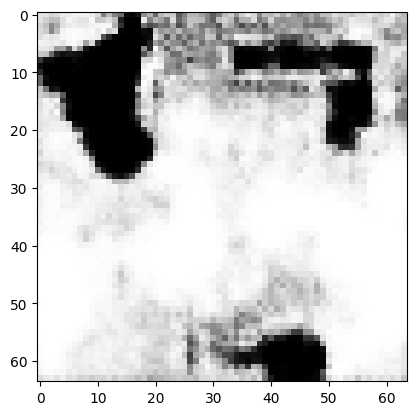

tensor([[7.2904e-06, 3.6772e-05, 1.8823e-04, 1.1329e-04, 1.9123e-03, 8.5820e-03,
         1.5725e-04, 6.5587e-04, 5.4672e-02, 7.2842e-01, 2.3151e-02, 1.2285e-05,
         1.0480e-04, 4.5489e-07, 2.2319e-02, 2.9730e-02, 6.6706e-04, 3.9255e-05,
         1.1507e-04, 1.1175e-02, 1.6119e-05, 8.1913e-03, 2.5763e-02, 8.2845e-04,
         6.1693e-04, 1.2842e-06, 4.2532e-05, 1.1872e-03, 5.0200e-03, 3.9322e-02,
         1.8978e-04, 8.9521e-06, 4.0865e-03, 3.1098e-04, 6.8468e-03, 2.4041e-02,
         1.2121e-05, 3.7252e-05, 3.5101e-04, 1.0706e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3168804943561554
tensor([[7.2884e-06, 3.6769e-05, 1.8822e-04, 1.1328e-04, 1.9121e-03, 8.5798e-03,
         1.5722e-04, 6.5581e-04, 5.4662e-02, 7.2845e-01, 2.3148e-02, 1.2282e-05,
         1.0478e-04, 4.5478e-07, 2.2317e-02, 2.9729e-02, 6.6671e-04, 3.9234e-05,
         1.1506e-04, 1.1176e-02, 1.6116e-05, 8.1907e-03, 2.5754e-02, 8.2836e-04,
         6.1682e-04, 1.2840e-06, 4.2525e-05

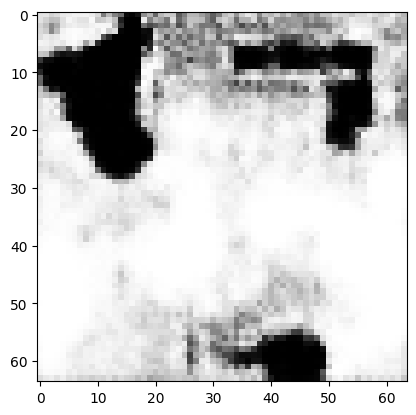

tensor([[7.2855e-06, 3.6761e-05, 1.8816e-04, 1.1327e-04, 1.9114e-03, 8.5746e-03,
         1.5708e-04, 6.5582e-04, 5.4638e-02, 7.2856e-01, 2.3143e-02, 1.2276e-05,
         1.0475e-04, 4.5466e-07, 2.2311e-02, 2.9712e-02, 6.6614e-04, 3.9171e-05,
         1.1499e-04, 1.1173e-02, 1.6110e-05, 8.1913e-03, 2.5743e-02, 8.2801e-04,
         6.1655e-04, 1.2844e-06, 4.2510e-05, 1.1875e-03, 5.0165e-03, 3.9305e-02,
         1.8975e-04, 8.9412e-06, 4.0838e-03, 3.1099e-04, 6.8419e-03, 2.4030e-02,
         1.2115e-05, 3.7215e-05, 3.5098e-04, 1.0706e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3166896104812622
tensor([[7.2834e-06, 3.6757e-05, 1.8815e-04, 1.1327e-04, 1.9111e-03, 8.5724e-03,
         1.5705e-04, 6.5578e-04, 5.4628e-02, 7.2858e-01, 2.3141e-02, 1.2273e-05,
         1.0473e-04, 4.5455e-07, 2.2309e-02, 2.9711e-02, 6.6581e-04, 3.9151e-05,
         1.1498e-04, 1.1174e-02, 1.6107e-05, 8.1907e-03, 2.5734e-02, 8.2792e-04,
         6.1644e-04, 1.2841e-06, 4.2503e-05

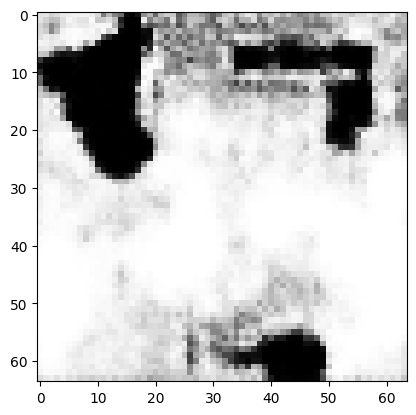

tensor([[7.2803e-06, 3.6751e-05, 1.8809e-04, 1.1327e-04, 1.9103e-03, 8.5670e-03,
         1.5693e-04, 6.5579e-04, 5.4605e-02, 7.2869e-01, 2.3137e-02, 1.2267e-05,
         1.0469e-04, 4.5442e-07, 2.2305e-02, 2.9696e-02, 6.6528e-04, 3.9090e-05,
         1.1491e-04, 1.1172e-02, 1.6102e-05, 8.1918e-03, 2.5725e-02, 8.2763e-04,
         6.1619e-04, 1.2845e-06, 4.2490e-05, 1.1879e-03, 5.0134e-03, 3.9288e-02,
         1.8971e-04, 8.9311e-06, 4.0811e-03, 3.1100e-04, 6.8371e-03, 2.4020e-02,
         1.2109e-05, 3.7179e-05, 3.5096e-04, 1.0706e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31651344895362854
tensor([[7.2781e-06, 3.6748e-05, 1.8808e-04, 1.1326e-04, 1.9099e-03, 8.5646e-03,
         1.5690e-04, 6.5575e-04, 5.4598e-02, 7.2871e-01, 2.3137e-02, 1.2264e-05,
         1.0467e-04, 4.5433e-07, 2.2304e-02, 2.9694e-02, 6.6506e-04, 3.9070e-05,
         1.1491e-04, 1.1173e-02, 1.6099e-05, 8.1921e-03, 2.5719e-02, 8.2756e-04,
         6.1606e-04, 1.2843e-06, 4.2485e-0

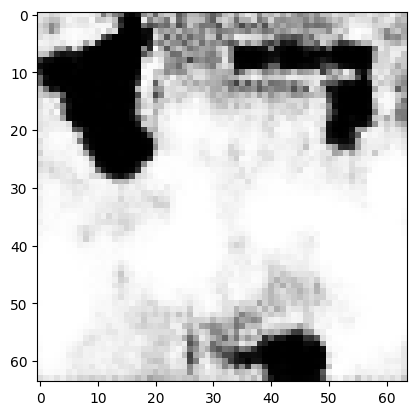

tensor([[7.2743e-06, 3.6742e-05, 1.8804e-04, 1.1327e-04, 1.9089e-03, 8.5587e-03,
         1.5679e-04, 6.5568e-04, 5.4576e-02, 7.2881e-01, 2.3135e-02, 1.2258e-05,
         1.0464e-04, 4.5417e-07, 2.2300e-02, 2.9680e-02, 6.6456e-04, 3.9008e-05,
         1.1486e-04, 1.1171e-02, 1.6092e-05, 8.1936e-03, 2.5709e-02, 8.2727e-04,
         6.1580e-04, 1.2845e-06, 4.2475e-05, 1.1883e-03, 5.0113e-03, 3.9266e-02,
         1.8966e-04, 8.9217e-06, 4.0784e-03, 3.1102e-04, 6.8319e-03, 2.4010e-02,
         1.2105e-05, 3.7142e-05, 3.5094e-04, 1.0703e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3163489103317261
tensor([[7.2739e-06, 3.6740e-05, 1.8802e-04, 1.1326e-04, 1.9089e-03, 8.5577e-03,
         1.5676e-04, 6.5567e-04, 5.4571e-02, 7.2883e-01, 2.3133e-02, 1.2257e-05,
         1.0463e-04, 4.5415e-07, 2.2299e-02, 2.9675e-02, 6.6446e-04, 3.8997e-05,
         1.1484e-04, 1.1170e-02, 1.6092e-05, 8.1937e-03, 2.5709e-02, 8.2719e-04,
         6.1576e-04, 1.2846e-06, 4.2472e-05

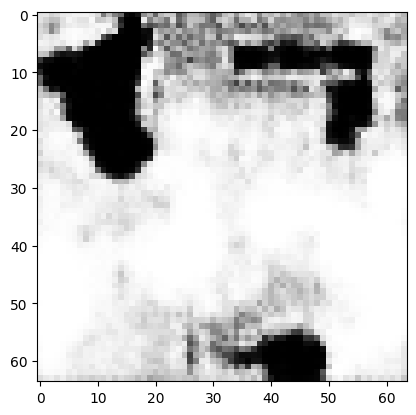

tensor([[7.2693e-06, 3.6732e-05, 1.8797e-04, 1.1326e-04, 1.9079e-03, 8.5514e-03,
         1.5665e-04, 6.5560e-04, 5.4548e-02, 7.2892e-01, 2.3131e-02, 1.2250e-05,
         1.0459e-04, 4.5394e-07, 2.2296e-02, 2.9663e-02, 6.6385e-04, 3.8935e-05,
         1.1479e-04, 1.1169e-02, 1.6085e-05, 8.1947e-03, 2.5696e-02, 8.2693e-04,
         6.1545e-04, 1.2846e-06, 4.2459e-05, 1.1887e-03, 5.0089e-03, 3.9248e-02,
         1.8962e-04, 8.9131e-06, 4.0760e-03, 3.1104e-04, 6.8276e-03, 2.4001e-02,
         1.2101e-05, 3.7108e-05, 3.5092e-04, 1.0702e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31619322299957275
tensor([[7.2674e-06, 3.6729e-05, 1.8797e-04, 1.1326e-04, 1.9074e-03, 8.5497e-03,
         1.5661e-04, 6.5566e-04, 5.4541e-02, 7.2894e-01, 2.3133e-02, 1.2247e-05,
         1.0457e-04, 4.5389e-07, 2.2295e-02, 2.9662e-02, 6.6379e-04, 3.8918e-05,
         1.1478e-04, 1.1170e-02, 1.6083e-05, 8.1953e-03, 2.5692e-02, 8.2686e-04,
         6.1530e-04, 1.2845e-06, 4.2455e-0

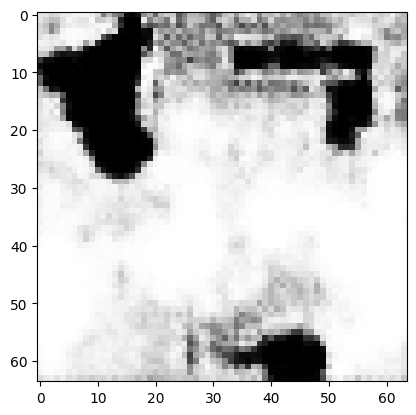

tensor([[7.2598e-06, 3.6720e-05, 1.8794e-04, 1.1326e-04, 1.9059e-03, 8.5425e-03,
         1.5648e-04, 6.5584e-04, 5.4510e-02, 7.2904e-01, 2.3137e-02, 1.2236e-05,
         1.0451e-04, 4.5360e-07, 2.2293e-02, 2.9657e-02, 6.6316e-04, 3.8847e-05,
         1.1473e-04, 1.1174e-02, 1.6076e-05, 8.1966e-03, 2.5670e-02, 8.2666e-04,
         6.1475e-04, 1.2843e-06, 4.2439e-05, 1.1891e-03, 5.0067e-03, 3.9226e-02,
         1.8951e-04, 8.9020e-06, 4.0730e-03, 3.1106e-04, 6.8216e-03, 2.3989e-02,
         1.2094e-05, 3.7059e-05, 3.5104e-04, 1.0696e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.31603139638900757
tensor([[7.2589e-06, 3.6718e-05, 1.8793e-04, 1.1326e-04, 1.9057e-03, 8.5415e-03,
         1.5644e-04, 6.5587e-04, 5.4505e-02, 7.2906e-01, 2.3136e-02, 1.2235e-05,
         1.0450e-04, 4.5357e-07, 2.2293e-02, 2.9654e-02, 6.6306e-04, 3.8834e-05,
         1.1471e-04, 1.1174e-02, 1.6075e-05, 8.1968e-03, 2.5668e-02, 8.2661e-04,
         6.1466e-04, 1.2844e-06, 4.2435e-0

In [150]:
z = torch.randn(1, 16, 32, 32).to(device)
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 1000, 0.00, 0.99, target=9)